In [1]:
import numpy as np
import matplotlib.pyplot as plt
import math
import pandas as pd
#import uproot
import uproot3
from scipy import optimize as op

*Bin Conversions*
Available Functions:
Note: All functions return new arrays rather than altering the previous array
	New_Merged_Size(array_,merge_size_) returns what the size of the new merged array will be
	Merge_Bin_Edges(edges_,merge_size) merges the bin edges 
	Merge_Bins(array_,merge_size_) adds together every <merge_size_> values in an array
	Merge_Vals(yarray_,merge_size_) adds together every <merge_size_> ybin together in an array
	Merge_Bins(xarray_,merge_size_) averages every <merge_size_> xbins together in an array
	Count_Non_Zero(array_) counts the number of nonzero values in an array
	Count_Zero(array_) counts the number of zeros in an array
	Remove_Zeros(array_) remove zeros from an array
	Remove_Zeros_Y(yarray_) removes zero values from yarray
	Remove_Zeros_X(xarray_,yarray_) removes xbins where the corresponding y value was zero
	Count_InBounds(yarray_,low_,high_) counts the number of values that fall between bounds (or equal to)
	Count_OutBounds(yarray_,low_,high_) co

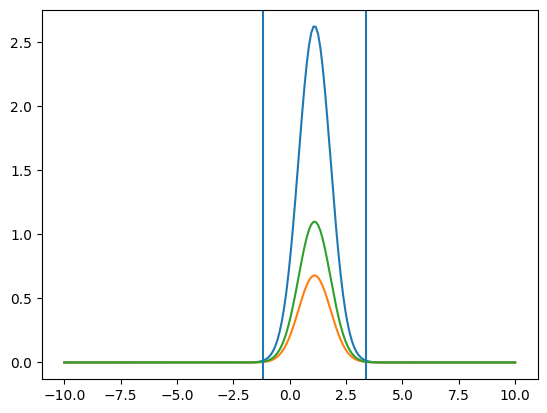

*Extracting Pieces for TH2*
Available Functions:
	Num_Xbins(TH2_) returns number of X bins for a TH2
	Num_Ybins(TH2_) returns number of Y bins for a TH2
	XEdges_2d(TH2_) returns edges of x bins for a TH2
	YEdges_2d(TH2_) returns edges of y bins for a TH2
	Center_Xbins(TH2_) returns center values for x bins for a TH2
	Center_Ybins(TH2_) returns center value for y bins for a TH2
	XY_Values(TH2_) returns a 2D np.array for z values arranged [x][y] for a TH2
	YX_Values(TH2_) returns a 2D np.array for z values arranged [y][x] for a TH2
Enjoy using TH2s



In [2]:
#Gain access to functions used to change some of the aspects regarding arrays and the things in them
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Bin\ Conversions.ipynb

#Gain Access to functions used to work with momentum binning
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Momentum\ Bins.ipynb

#Gain Access to functions used to work with Fitting Functions
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Fitting\ Functions.ipynb

#Gain Access to functions used for TH2s 
#uproot or uproo4
#%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH2\ Functions.ipynb
#uproot3
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH2\ Functions-uproot3.ipynb

In [29]:
sim="exp"
run="e16"
cut_perf="delta"
species = "pip"

date = "06-27-2024"
dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_"+run+"/2024/"+date
#dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_e16/06-13-2022"

root_file=dir+"/"+sim+"_"+run+"_clas6_"+cut_perf+"_"+species+"_"+date+".root"
file=uproot3.open(root_file)
#selection 0-> pid in experimental W range, 1->event selection in full W range
selection = 1
# 0 => full range 1=> Experimental W range
W_range = 0

rel_top=['mnone','mall']

W_bits=['all','in_range']

In [20]:
#The Various layers of TDirectories to get to the histograms
layer1='Delta'
layer2=cut_perf+"_"+species
layer3=[layer2+"_pid",layer2+"_event"]
layer4=[[layer3[sel]+"_sec"+str(sec+1) for sel in range(2)] for sec in range(6)]
layer5=[[layer4[sec][sel]+"_cut" for sel in range(2)] for sec in range(6)]
layer6=[[layer5[sec][0]+"_mnone",layer5[sec][1]+"_mall"] for sec in range(6)]
layer7=[[layer6[sec][sel]+"_in_range" for sel in range(2)] for sec in range(6)]
layer8=[[layer3[sel]+"_cut_"+rel_top[sel]+"_sec"+str(sec+1)+"_"+W_bits[W_range] for sel in range(2)] for sec in range(6)]
dir_loc0= [layer1+"/"+layer2+"/"+layer3[selection]+"/"+layer4[sec][selection]+"/"+layer5[sec][selection]+"/"+layer6[sec][selection]+"/"+layer7[sec][selection] for sec in range(6)]
dir_loc = [layer1+"/"+layer2+"/"+layer3[selection]+"/"+layer4[sec][selection]+"/"+layer5[sec][selection]+"/"+layer6[sec][selection]+"/"+layer7[sec][selection]+"/"+layer8[sec][selection] for sec in range(6)]

hist = [file[dir_loc[sec]] for sec in range(6)]

print(layer8[0][selection])

delta_pip_pid_cut_mnone_sec1_all


In [21]:
print(layer8[0])
file[dir_loc0[0]].keys()


['delta_pip_pid_cut_mnone_sec1_all', 'delta_pip_event_cut_mall_sec1_all']


[b'delta_pip_pid_cut_mnone_sec1_in_range;1',
 b'delta_pip_pid_cut_mnone_sec1_all;1']

In [22]:
cut_cols = ['b','g','r']
cut_name= ["tight","mid","loose"]
data_cols = ['m',"c",'y']

In [23]:
#Extracting X and Y bins
#X and Y binning is the same for all sectors
xbins=Center_Xbins(hist[0])
ybins=Center_Ybins(hist[0])

In [24]:
#Extracting Zvals for 2d histograms
zvals_xy=[XY_Values(hist[sec]) for sec in range(6)]
zvals_yx=[YX_Values(hist[sec]) for sec in range(6)]

In [25]:
xmerge=2
ymerge=2
xname="p(GeV)"
yname="\u0394t (ns)"

In [26]:
#Determining Cell Merging 

#Merge -> No Zeros
x = Merge_Bins(xbins,xmerge)
y = Merge_Bins(ybins,ymerge)
xedges = Merge_Bin_Edges(XEdges_2d(hist[0]),xmerge)
yedges = Merge_Bin_Edges(YEdges_2d(hist[0]),ymerge)
z_xy=[Merge_Z(zvals_xy[i],xmerge,ymerge) for i in range(6)]
z_yx=[Merge_Z(zvals_xy[i],ymerge,xmerge) for i in range(6)]
fit_x = [[Remove_Zeros_X(y,z_xy[sec][xbin]) for xbin in range(len(x))] for sec in range(6)]
fit_y = [[Remove_Zeros_Y(z_xy[sec][xbin]) for xbin in range(len(x))] for sec in range(6)]



In [27]:
#dumb_x= np.zeros((6,len(x)*len(y)))
#dumb_y= np.zeros((6,len(x)*len(y)))
#dense2 = np.zeros((6,len(x)*len(y)))
dumb_x= np.zeros((6,len(xbins)*len(ybins)))
dumb_y= np.zeros((6,len(xbins)*len(ybins)))
dense2 = np.zeros((6,len(xbins)*len(ybins)))
for sec in range(6):
    #for i in range(len(x)):
    for i in range(len(xbins)):
        #for j in range(len(y)):
        for j in range(len(ybins)):
            #dumb_x[sec][i+j*len(x)]+=x[i]
            #dumb_y[sec][i+j*len(x)]+=y[j]
            #dense2[sec][i+j*len(x)]+=zvals_xy[sec][i][j]
            dumb_x[sec][i+j*len(xbins)]+=xbins[i]
            dumb_y[sec][i+j*len(xbins)]+=ybins[j]
            dense2[sec][i+j*len(xbins)]+=zvals_xy[sec][i][j]


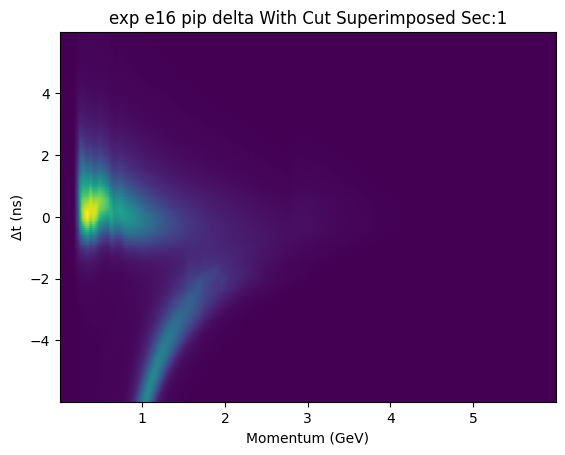

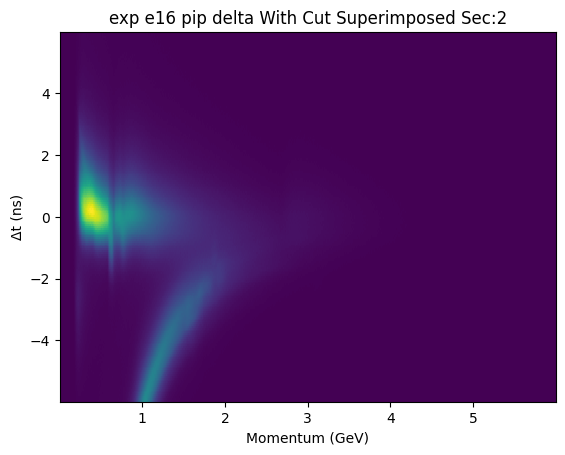

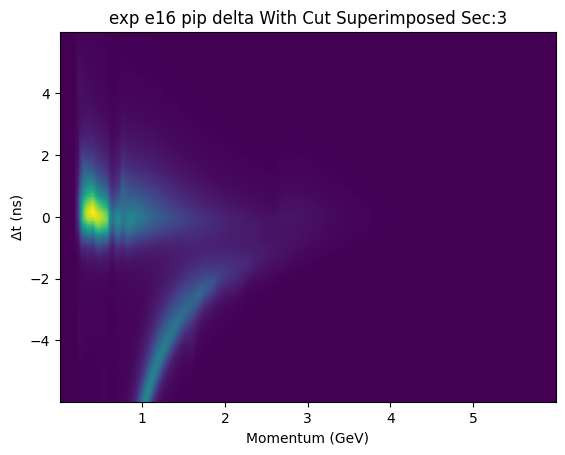

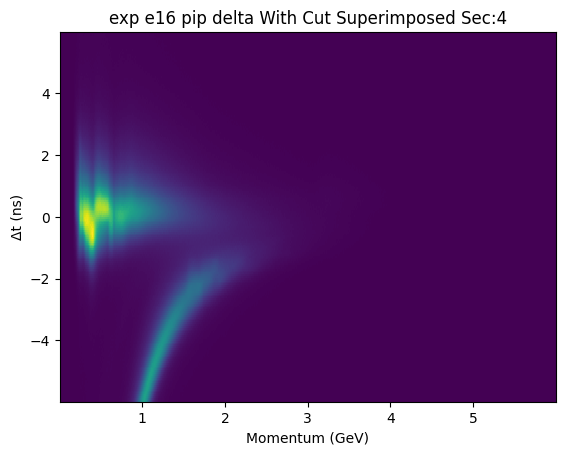

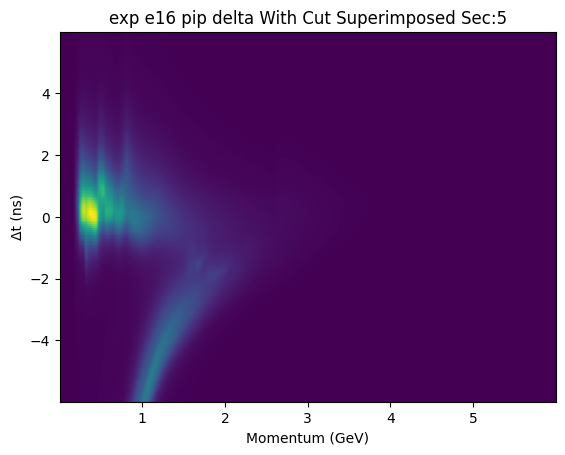

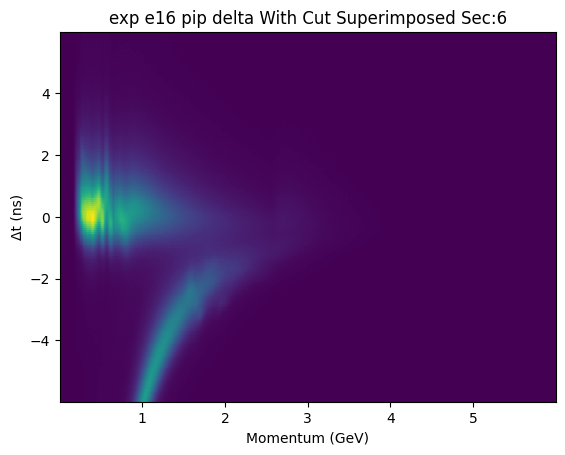

In [28]:
for sec in range(6):
    plt.hist2d(dumb_x[sec], dumb_y[sec], bins=(len(x), len(y)), weights=dense2[sec])
    plt.title("{} {} {} {} With Cut Superimposed Sec:{}".format(sim,run,species,cut_perf,sec+1))
    plt.xlabel("Momentum (GeV)")
    plt.ylabel(yname)
    plt.show()
    
    
    

In [13]:
def Pbin_low(xbin_):
    return round(xedges[xbin_],3)
def Pbin_top(xbin_):
    return round(xedges[xbin_+1],3)

-2.198049661569247 1.967714385435857
-2.6146260662697576 2.3842907901363675
-3.031202470970268 2.800867194836878
[16.65460848 -0.11516764  0.83315281]


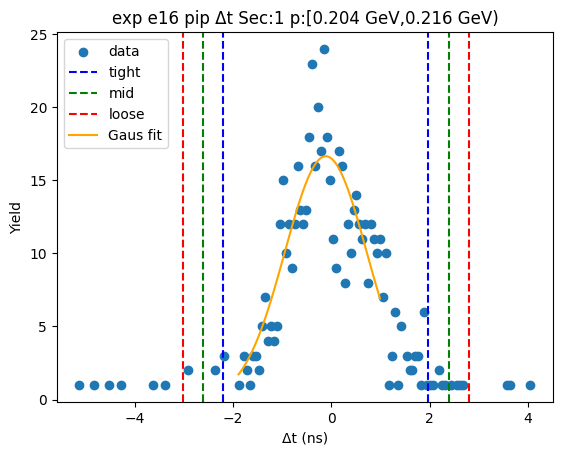

-1.945211619768633 1.9108388672799113
-2.3308166684734877 2.2964439159847663
-2.716421717178342 2.6820489646896206
[ 2.86623246e+01 -1.71863762e-02  7.71210097e-01]


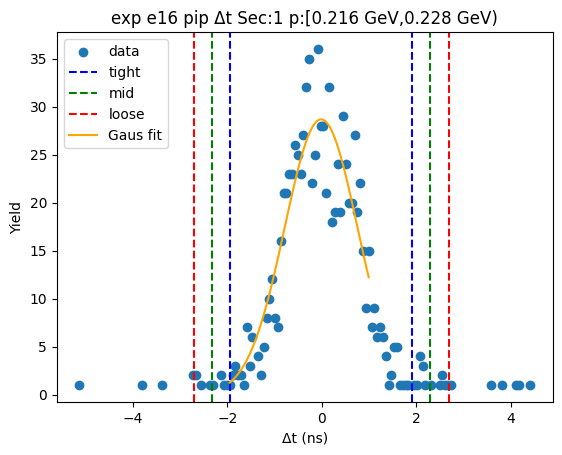

-1.9282615812976667 1.8573067526912868
-2.3068184146965622 2.235863586090182
-2.6853752480954576 2.614420419489077
[ 3.71880427e+01 -3.54774143e-02  7.57113667e-01]


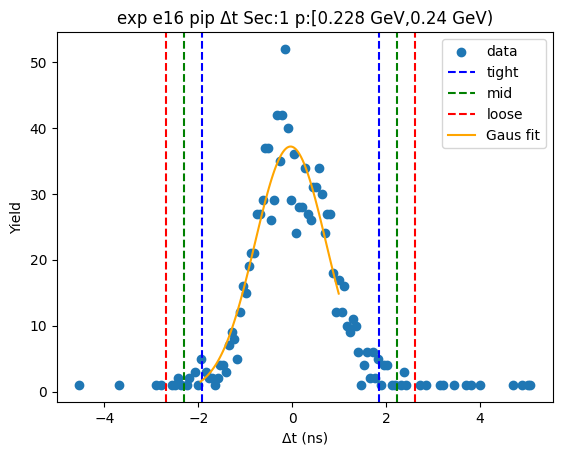

-1.8060716898765785 1.6943043609874324
-2.1561092949629797 2.044341966073833
-2.506146900049381 2.3943795711602345
[47.9795032  -0.05588366  0.70007521]


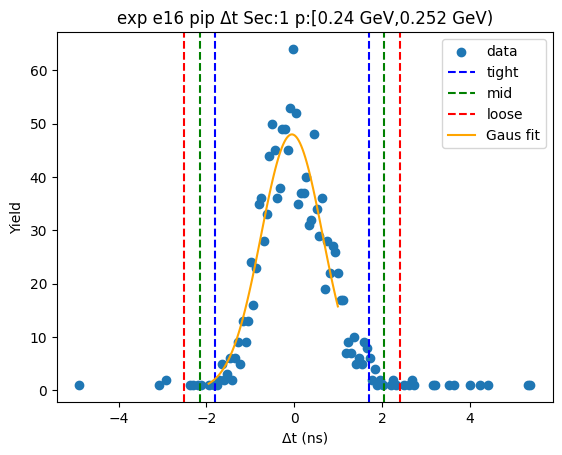

-1.5405919252430074 1.3913531516545696
-1.8337864329327649 1.6845476593443272
-2.1269809406225226 1.9777421670340851
[71.1017237  -0.07461939  0.58638902]


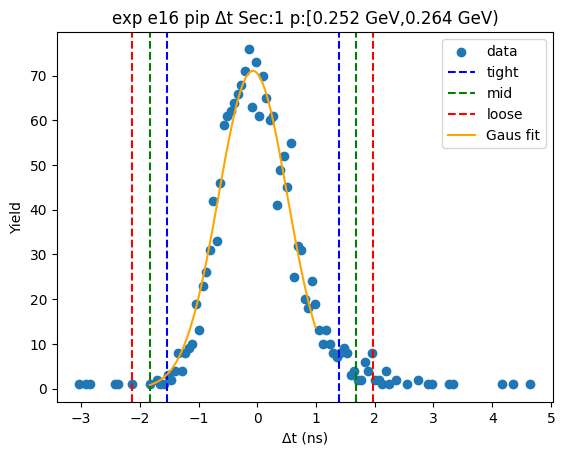

-1.5212424476745787 1.2948816576764437
-1.8028548582096808 1.5764940682115458
-2.084467268744783 1.858106478746648
[81.93447467 -0.11318039  0.56322482]


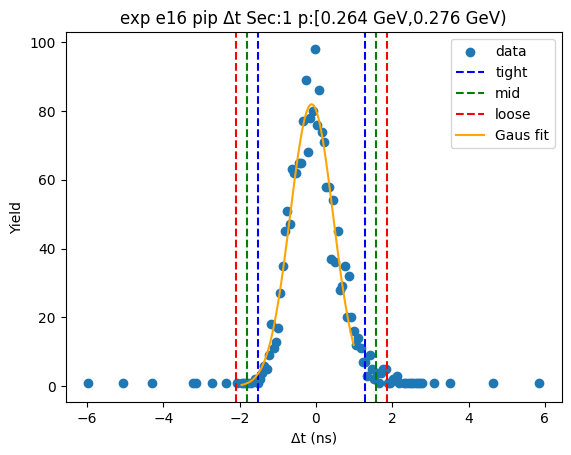

-1.509220820185783 1.1729416826078698
-1.7774370704651485 1.4411579328872353
-2.045653320744514 1.7093741831666005
[95.841878   -0.16813957  0.5364325 ]


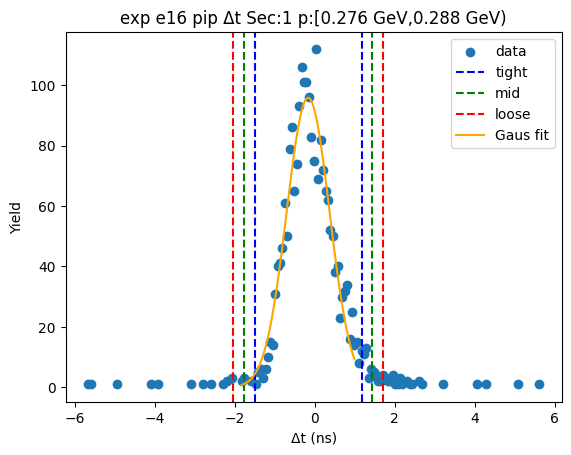

-1.4919108157871037 1.1472564246898205
-1.755827539834796 1.4111731487375128
-2.0197442638824885 1.675089872785205
[98.43794017 -0.1723272   0.52783345]


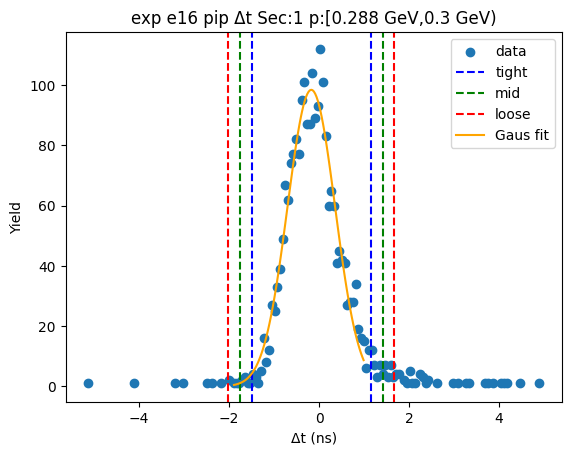

-1.4429680979904616 1.0282094095609797
-1.6900858487456059 1.275327160316124
-1.93720359950075 1.5224449110712681
[110.00073163  -0.20737934   0.4942355 ]


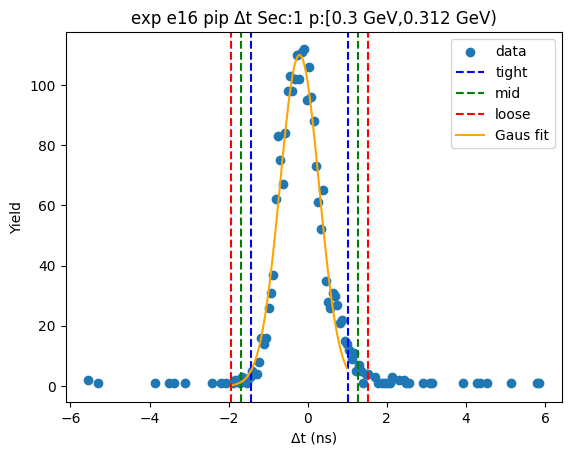

-1.463361062689466 1.043511067926211
-1.7140482757510338 1.2941982809877788
-1.9647354888126016 1.5448854940493466
[116.70813833  -0.209925     0.50137443]


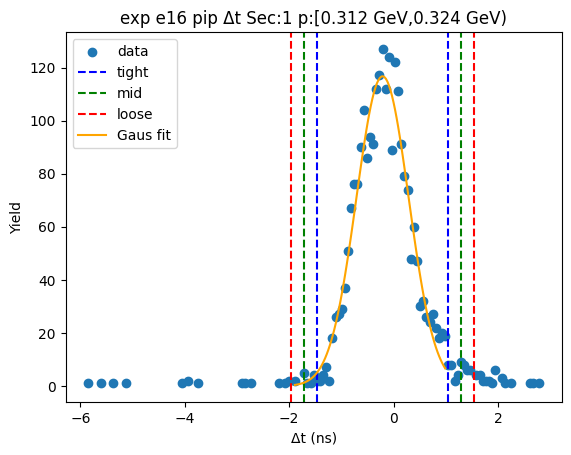

-1.3956167331474538 0.9813333032819648
-1.6333117367903953 1.2190283069249066
-1.8710067404333373 1.456723310567848
[122.26035889  -0.20714171   0.47539001]


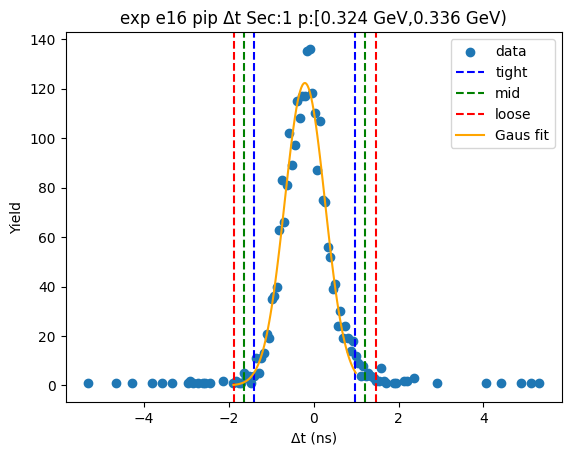

-1.4068350986170937 0.9235518012692926
-1.639873788605732 1.1565904912579312
-1.8729124785943707 1.38962918124657
[127.18072931  -0.24164165   0.46607738]


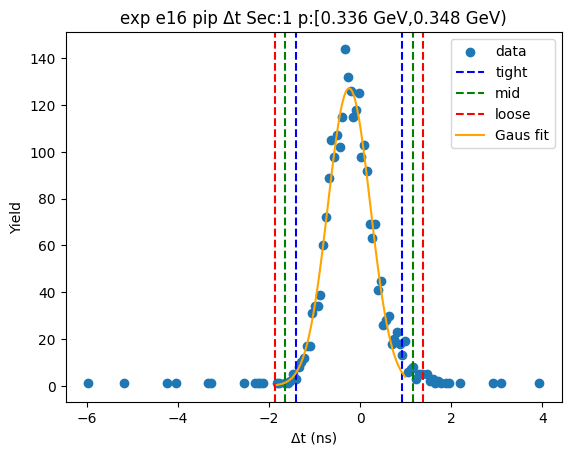

-1.4775325116756612 0.9767311436708359
-1.7229588772103108 1.2221575092054855
-1.9683852427449604 1.467583874740135
[127.02082191  -0.25040068   0.49085273]


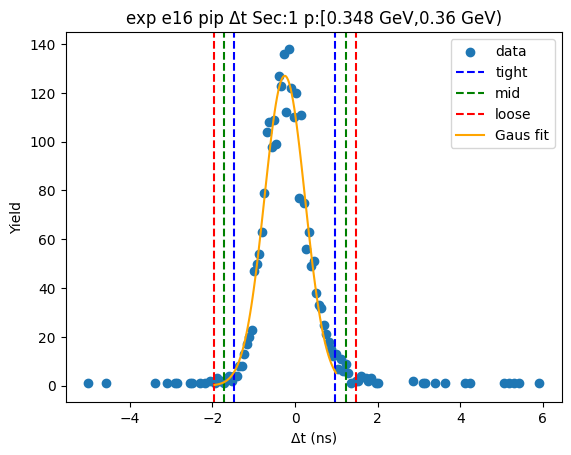

-1.5172414292698888 1.100104600973412
-1.7789760322942187 1.3618392039977418
-2.0407106353185487 1.6235738070220718
[118.79217786  -0.20856841   0.52346921]


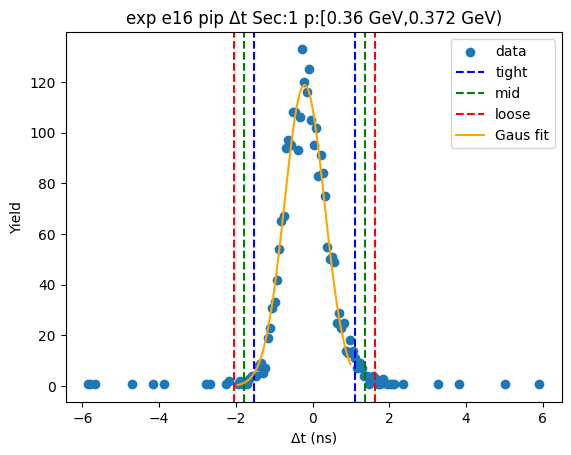

-1.487522564899699 1.120522061856435
-1.7483270275753124 1.3813265245320485
-2.0091314902509256 1.642130987207662
[129.29493474  -0.18350025   0.52160893]


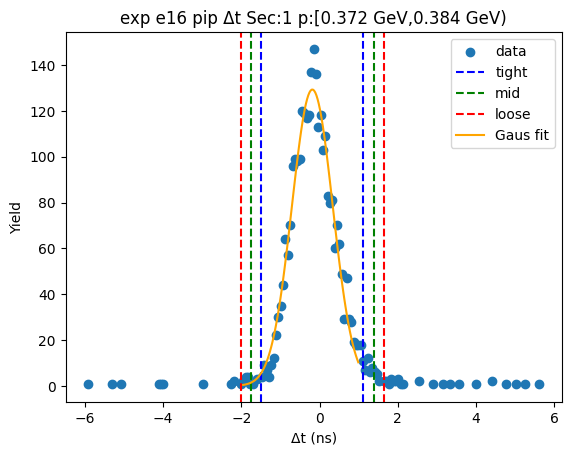

-1.5239845365464602 1.1497472947730878
-1.7913577196784152 1.4171204779050424
-2.0587309028103697 1.6844936610369974
[123.06745004  -0.18711862   0.53474637]


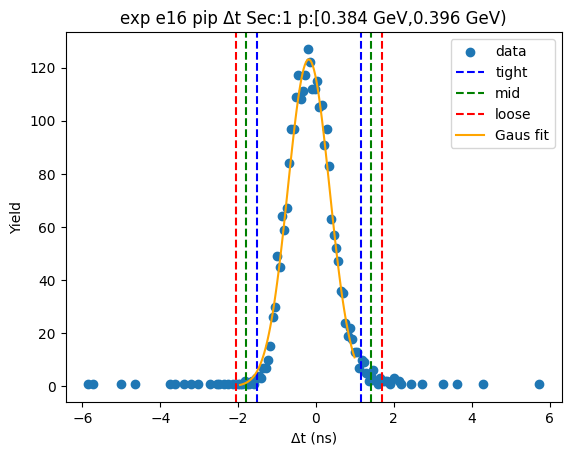

-1.4978241904627896 1.0633060509565664
-1.7539372146047252 1.319419075098502
-2.0100502387466608 1.5755320992404376
[129.50880733  -0.21725907   0.51222605]


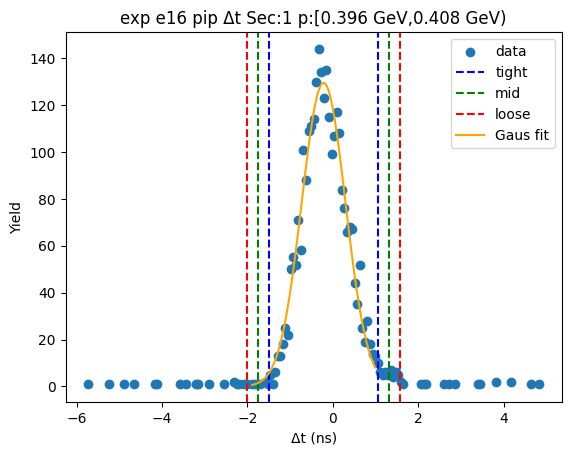

-1.4658567735623669 0.9970094217675223
-1.7121433930953558 1.2432960413005112
-1.9584300126283447 1.4895826608335
[133.9621788   -0.23442368   0.49257324]


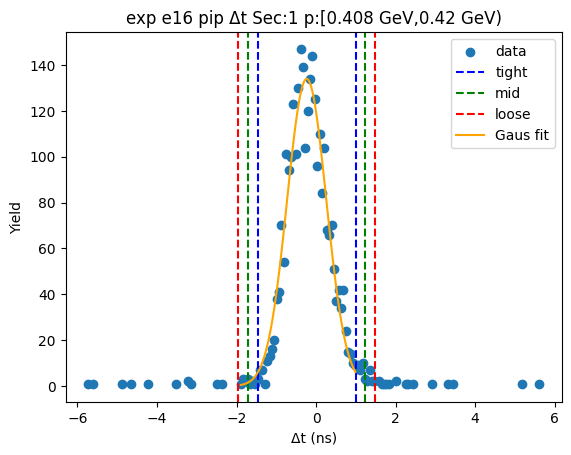

-1.4550321656111402 1.056962105420325
-1.7062315927142866 1.3081615325234714
-1.9574310198174332 1.559360959626618
[135.03897154  -0.19903503   0.50239885]


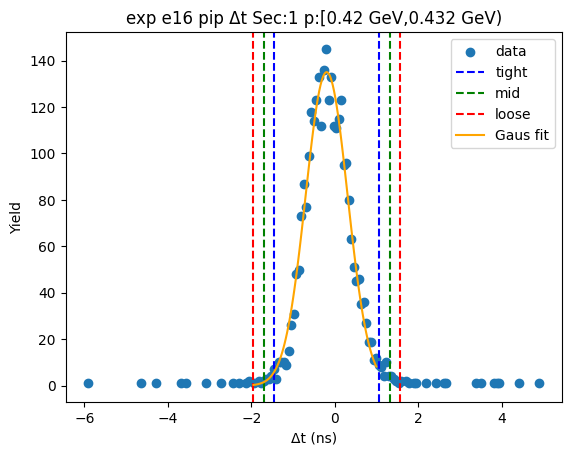

-1.416338382063775 1.044032701975527
-1.6623754904677053 1.2900698103794574
-1.9084125988716356 1.5361069187833878
[140.28141518  -0.18615284   0.49207422]


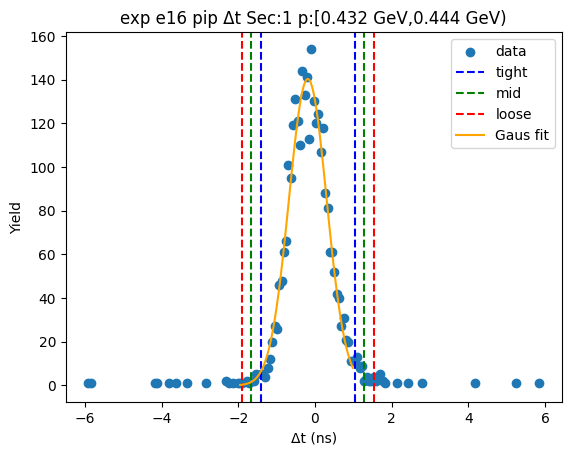

-1.4494573017220271 1.1001960034361278
-1.7044226322378426 1.3551613339519433
-1.9593879627536581 1.6101266644677588
[137.44923227  -0.17463065   0.50993066]


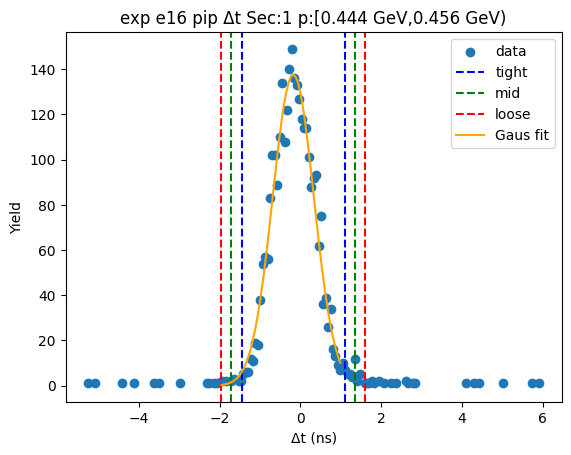

-1.4698054687609448 1.2466915219630188
-1.741455167833341 1.518341221035415
-2.013104866905737 1.7899909201078112
[ 1.27496132e+02 -1.11556973e-01  5.43299398e-01]


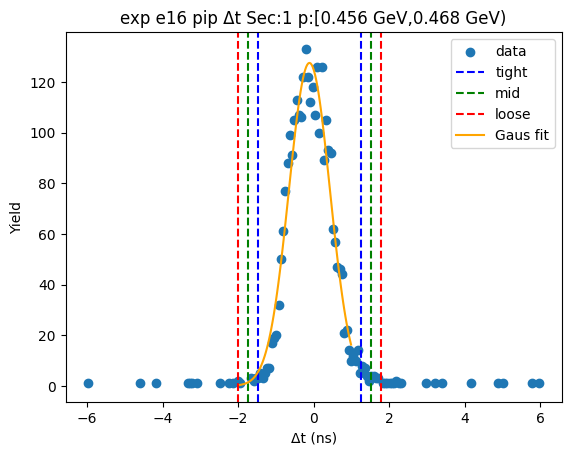

-1.5327308377024376 1.3640983923827705
-1.8224137607109585 1.6537813153912915
-2.1120966837194795 1.9434642383998124
[ 1.15977004e+02 -8.43162227e-02  5.79365846e-01]


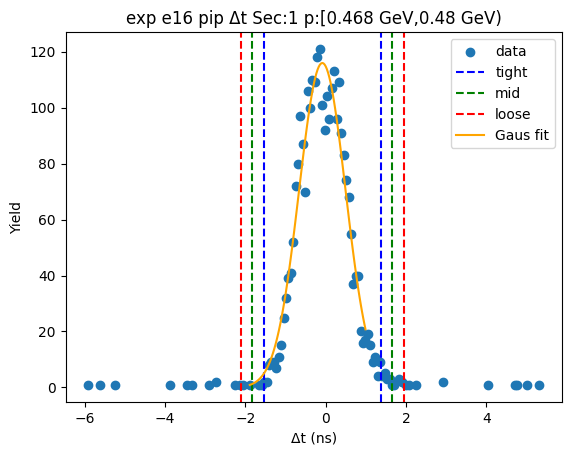

-1.4851168258735836 1.3502348579927432
-1.7686519942602161 1.6337700263793757
-2.052187162646849 1.9173051947660085
[ 1.20941681e+02 -6.74409839e-02  5.67070337e-01]


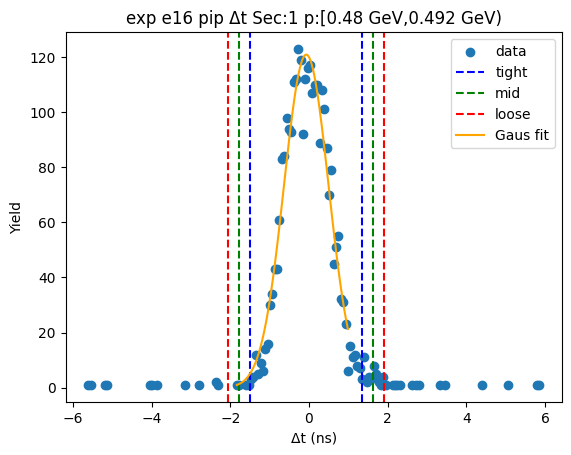

-1.459242278883188 1.4410329181949442
-1.749269798591001 1.7310604379027572
-2.0392973182988143 2.021087957610571
[ 1.18634567e+02 -9.10468034e-03  5.80055039e-01]


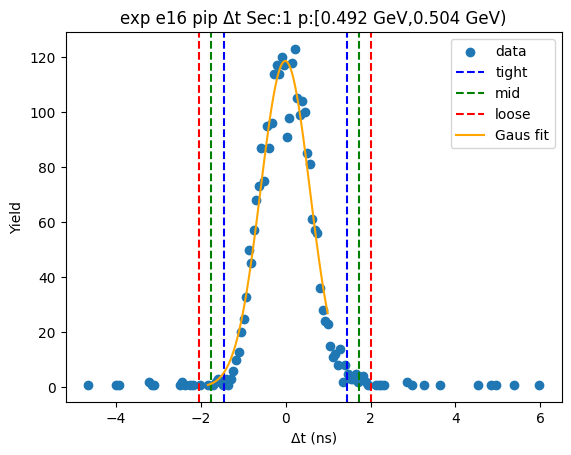

-1.4942163017163195 1.4906395005181323
-1.7927018819397647 1.7891250807415775
-2.0911874621632096 2.087610660965023
[ 1.14249748e+02 -1.78840060e-03  5.96971160e-01]


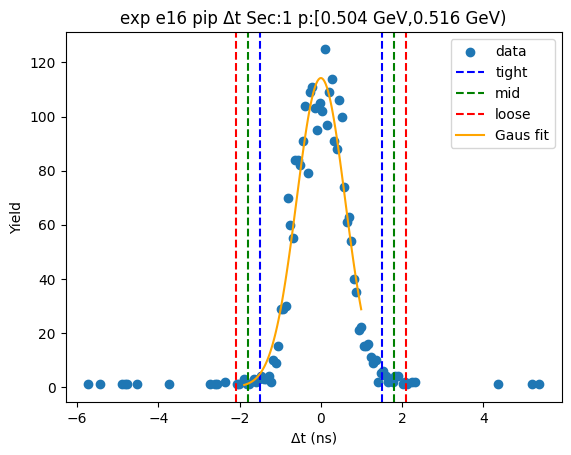

-1.4280644449080144 1.409809167433087
-1.7118518061421244 1.693596528667197
-1.9956391673762346 1.9773838899013072
[ 1.19088578e+02 -9.12763874e-03  5.67574722e-01]


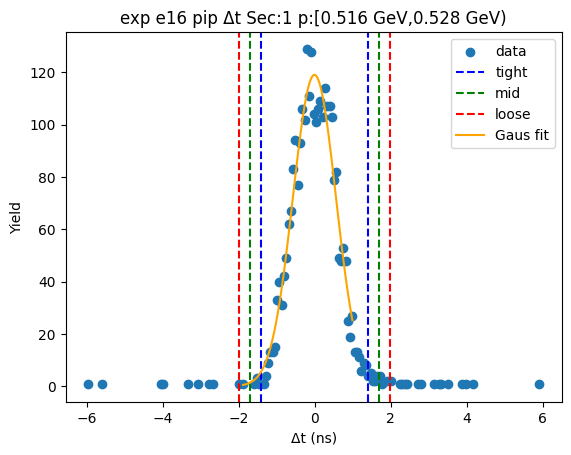

-1.4026895417380378 1.402571312004022
-1.6832156271122438 1.683097397378228
-1.9637417124864498 1.963623482752434
[ 1.19830399e+02 -5.91148670e-05  5.61052171e-01]


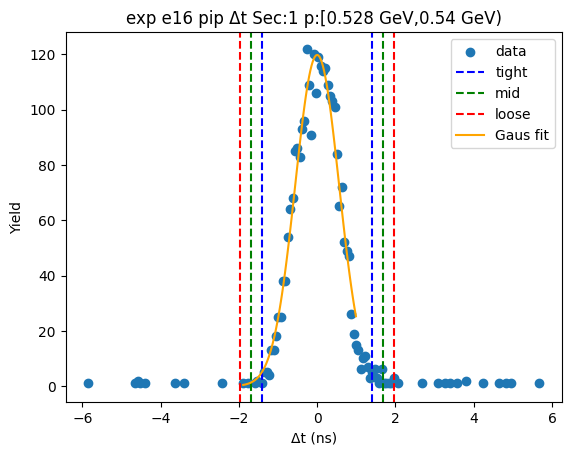

-1.3556820938489609 1.3921239907275162
-1.6304627023066087 1.666904599185164
-1.9052433107642566 1.941685207642812
[1.19067574e+02 1.82209484e-02 5.49561217e-01]


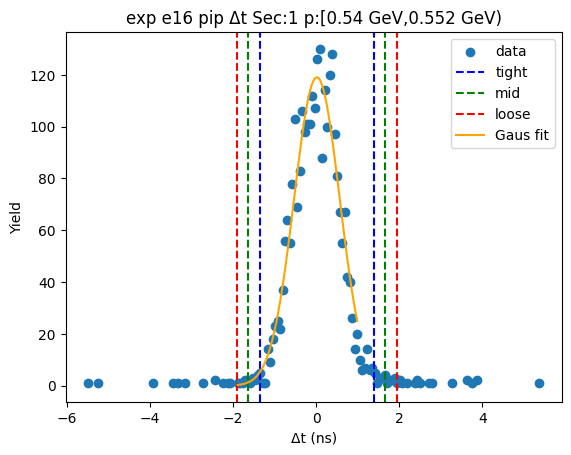

-1.4115954819352314 1.3819327292231471
-1.6909483030510695 1.6612855503389852
-1.9703011241669073 1.940638371454823
[ 1.15006832e+02 -1.48313764e-02  5.58705642e-01]


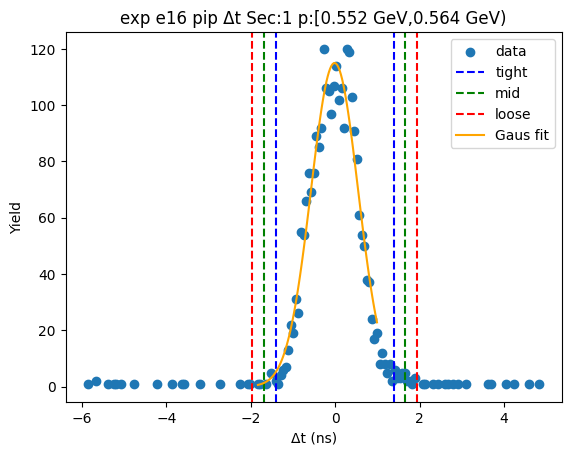

-1.4103820051844425 1.3976741409075188
-1.6911876197936384 1.6784797555167148
-1.9719932344028346 1.959285370125911
[ 1.12870418e+02 -6.35393214e-03  5.61611229e-01]


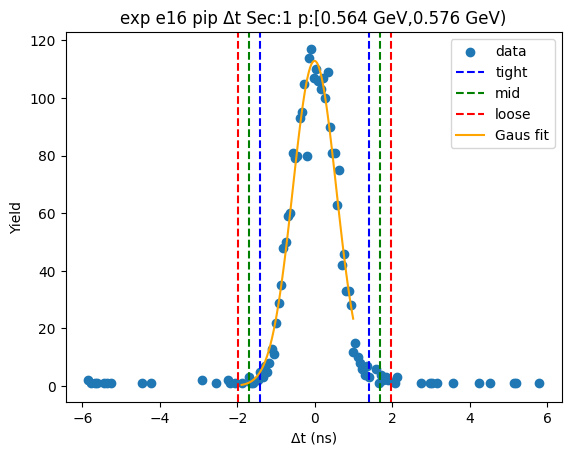

-1.373334454444268 1.3607539403105091
-1.646743293919746 1.634162779785987
-1.9201521333952236 1.9075716192614647
[ 1.14255142e+02 -6.29025707e-03  5.46817679e-01]


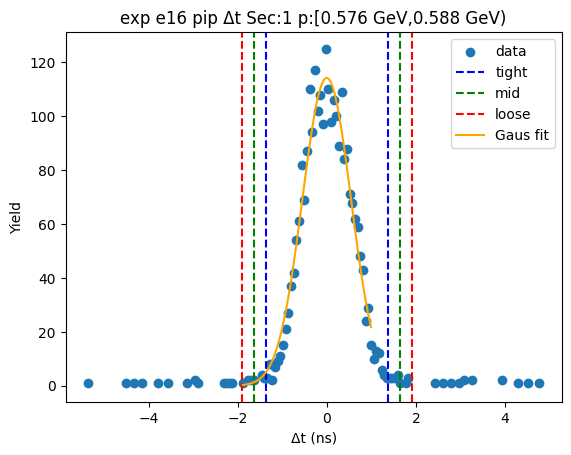

-1.3806727959509388 1.3644612528346733
-1.6551862008295002 1.6389746577132347
-1.9296996057080615 1.913488062591796
[ 1.13264049e+02 -8.10577156e-03  5.49026810e-01]


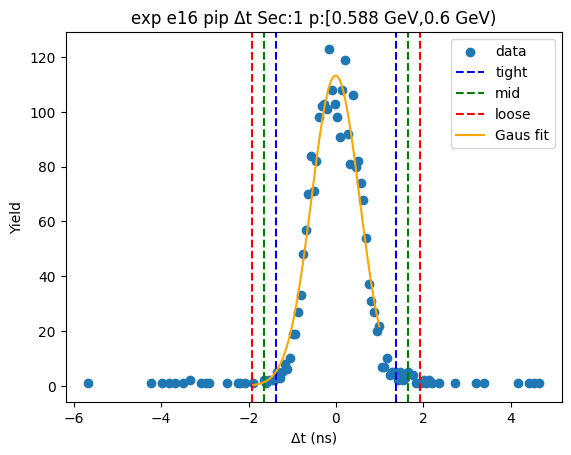

-1.372804049701826 1.2419300172019507
-1.6342774563922036 1.5034034238923284
-1.8957508630825812 1.764876830582706
[ 1.10404293e+02 -6.54370162e-02  5.22946813e-01]


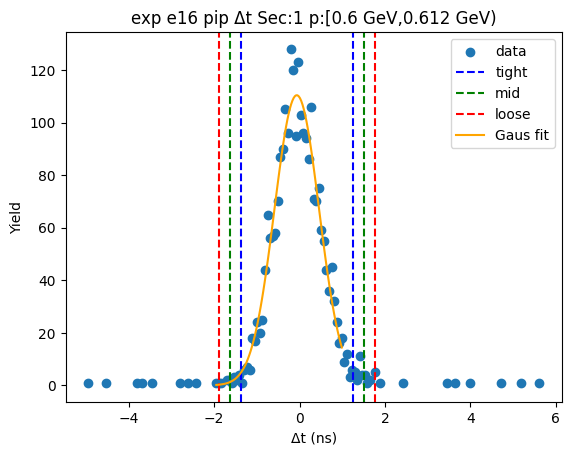

-1.3614879055406999 1.1825668969981133
-1.6158933857945812 1.4369723772519947
-1.8702988660484625 1.691377857505876
[ 1.16077228e+02 -8.94605043e-02  5.08810961e-01]


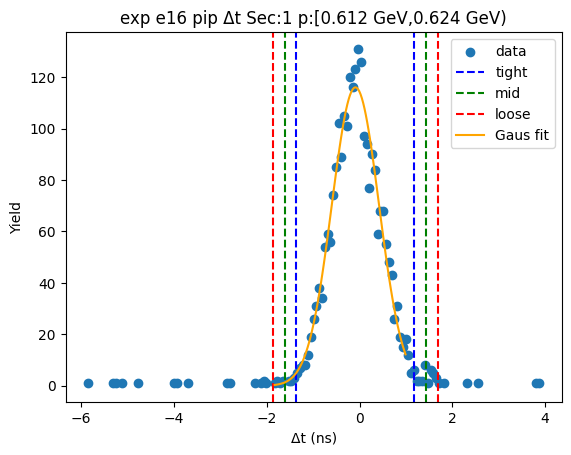

-1.3598984876614746 1.0768914502151667
-1.6035774814491386 1.3205704440028307
-1.8472564752368026 1.5642494377904947
[116.65367146  -0.14150352   0.48735799]


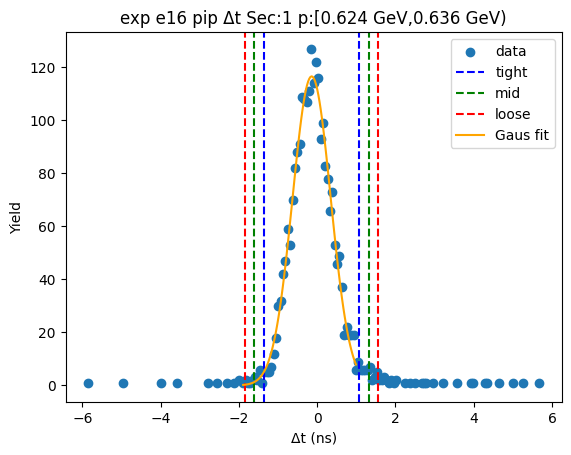

-1.4049370259992164 1.1225467975350876
-1.6576854083526467 1.3752951798885178
-1.910433790706077 1.6280435622419482
[111.36511133  -0.14119511   0.50549676]


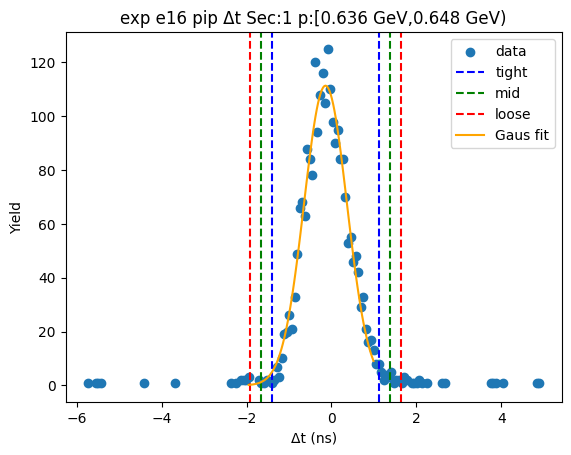

-1.393988044981793 1.1134345112936097
-1.6447303006093332 1.36417676692115
-1.8954725562368735 1.6149190225486902
[105.77088393  -0.14027677   0.50148451]


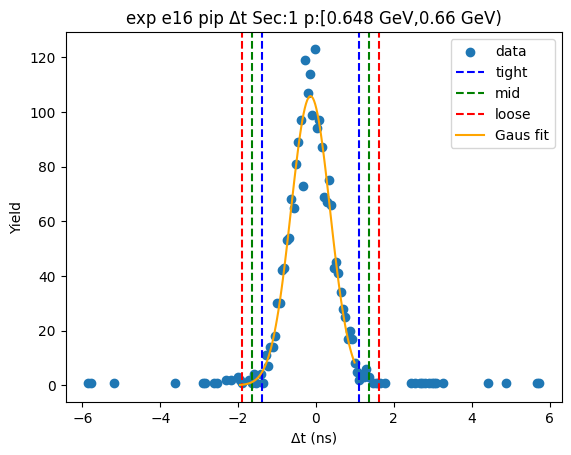

-1.3017504047286004 1.0223335448988677
-1.5341587996913473 1.2547419398616146
-1.766567194654094 1.4871503348243613
[107.50825094  -0.13970843   0.46481679]


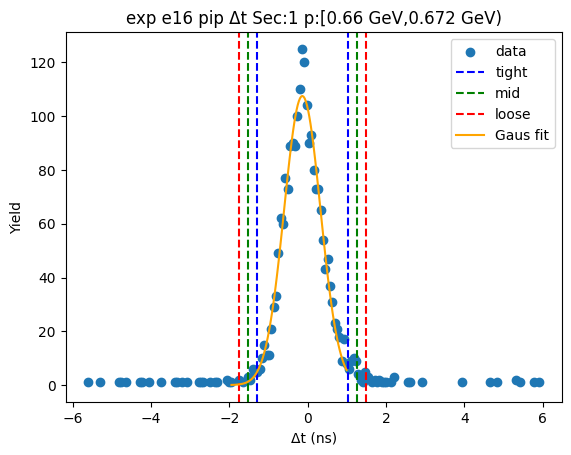

-1.3258081082038229 1.1147794821708243
-1.5698668672412874 1.3588382412082889
-1.8139256262787522 1.6028970002457537
[ 1.06962117e+02 -1.05514313e-01  4.88117518e-01]


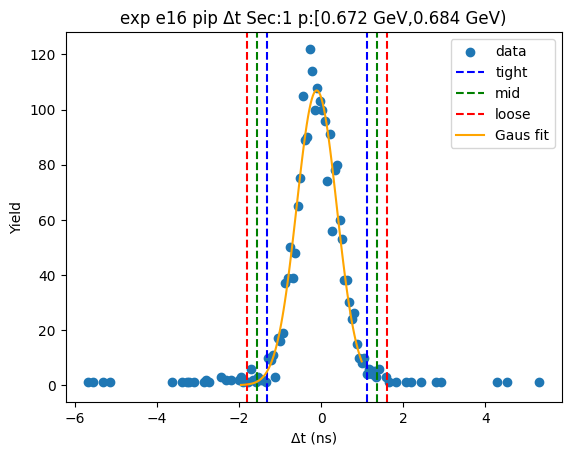

-1.3119122844669027 1.0945808058653779
-1.5525615935001307 1.3352301148986059
-1.7932109025333587 1.575879423931834
[104.7698256   -0.10866574   0.48129862]


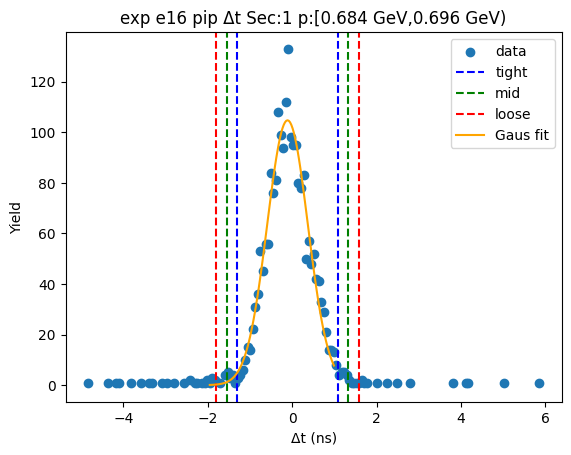

-1.3015805012894162 1.1303759138310503
-1.5447761428014628 1.373571555343097
-1.7879717843135094 1.6167671968551436
[ 1.07849588e+02 -8.56022937e-02  4.86391283e-01]


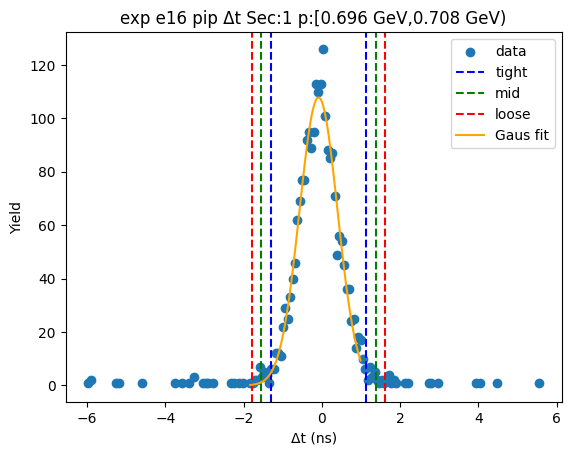

-1.3016599836531109 1.115974344291788
-1.5434234164476008 1.357737777086278
-1.7851868492420906 1.5995012098807677
[ 1.02408850e+02 -9.28428197e-02  4.83526866e-01]


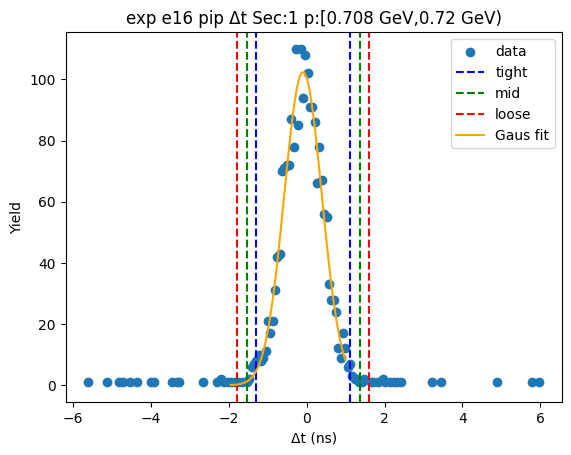

-1.2516616610834201 1.0649986413430559
-1.4833276913260676 1.2966646715857033
-1.7149937215687152 1.528330701828351
[ 1.05881705e+02 -9.33315099e-02  4.63332060e-01]


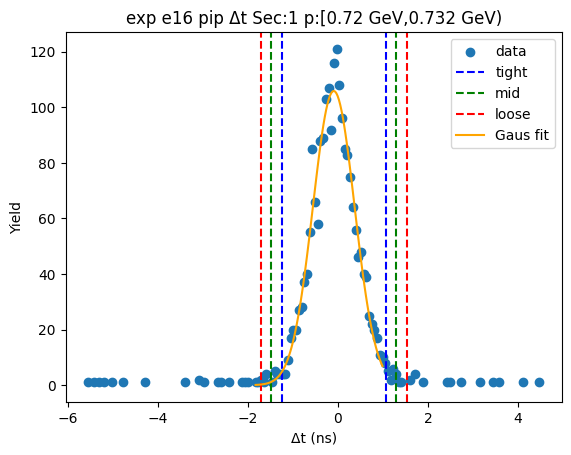

-1.353165388924404 1.0911612174814178
-1.5975980495649862 1.335593878122
-1.8420307102055684 1.5800265387625823
[100.2325863   -0.13100209   0.48886532]


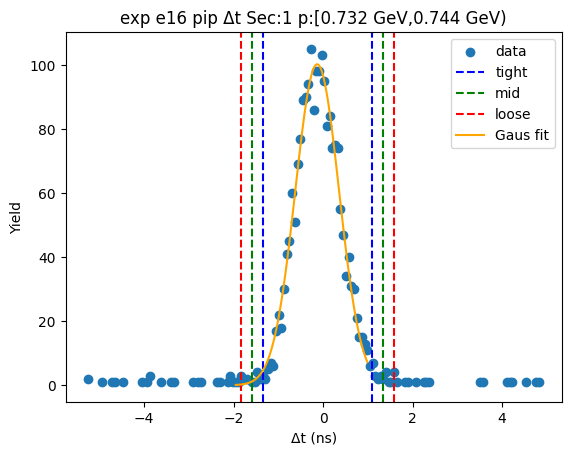

-1.3325249538923218 1.0461734137918621
-1.57039479066074 1.2840432505602803
-1.8082646274291585 1.5219130873286988
[98.4086872  -0.14317577  0.47573967]


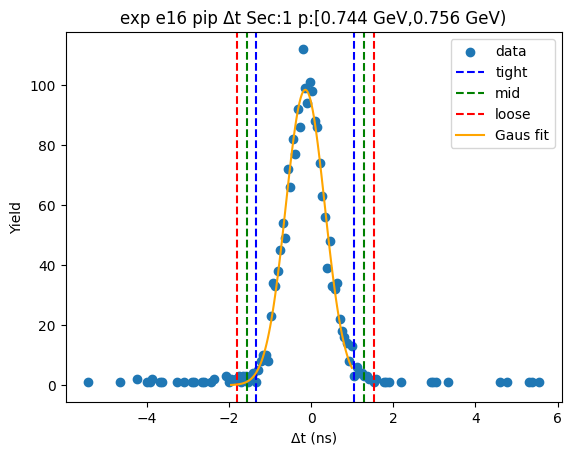

-1.3778520052566867 1.0492026047926435
-1.6205574662616196 1.2919080657975763
-1.8632629272665526 1.5346135268025094
[98.264174   -0.1643247   0.48541092]


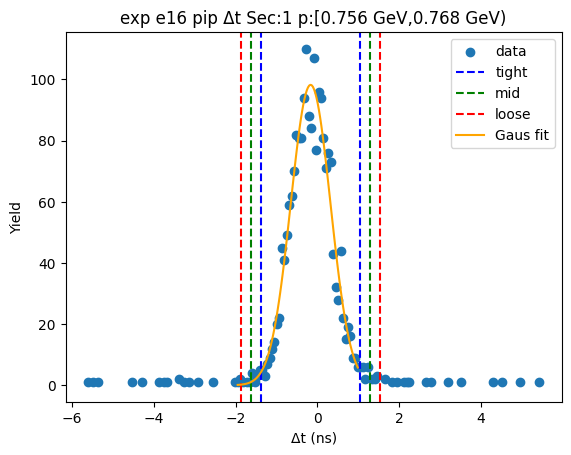

-1.3734437379814661 1.053606070687128
-1.6161487188483254 1.2963110515539873
-1.858853699715185 1.5390160324208468
[93.47648434 -0.15991883  0.48540996]


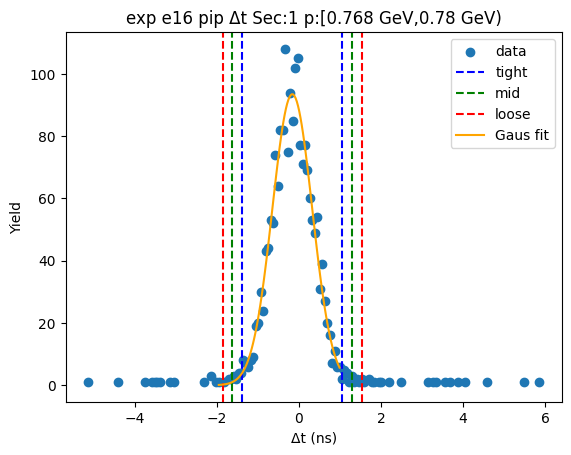

-1.3743815290692396 0.973331067558803
-1.6091527887320436 1.2081023272216074
-1.843924048394848 1.4428735868844114
[91.96494591 -0.20052523  0.46954252]


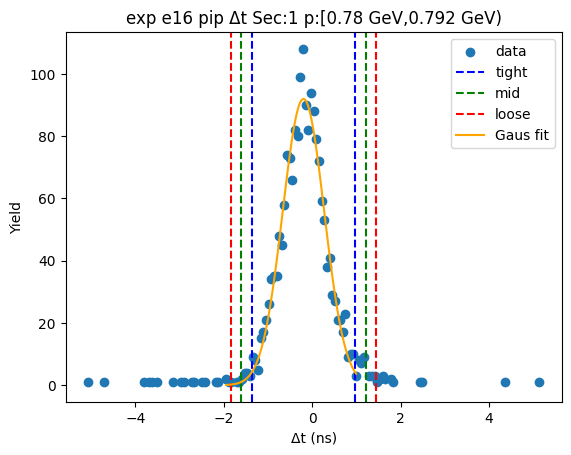

-1.4329434244401817 1.0318019682685329
-1.6794179637110531 1.2782765075394042
-1.9258925029819247 1.5247510468102758
[86.7115808  -0.20057073  0.49294908]


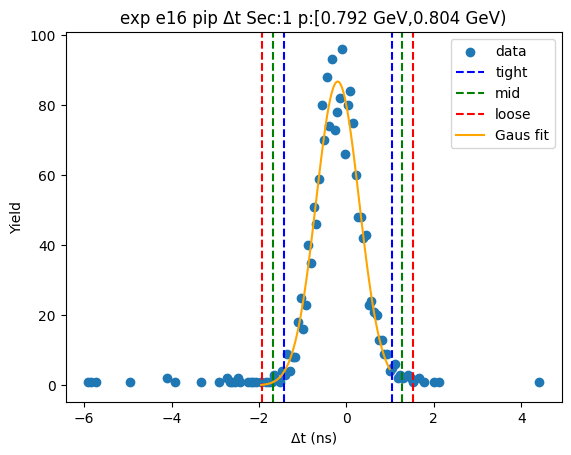

-1.388787055081967 0.9514486606309378
-1.6228106266532576 1.1854722322022284
-1.8568341982245482 1.419495803773519
[88.72336083 -0.2186692   0.46804714]


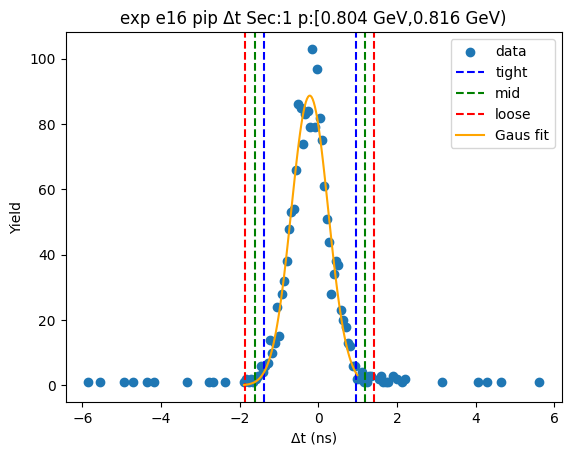

-1.4605271179627595 1.042583742420499
-1.7108382040010854 1.2928948284588249
-1.9611492900394114 1.5432059144971508
[85.30320369 -0.20897169  0.50062217]


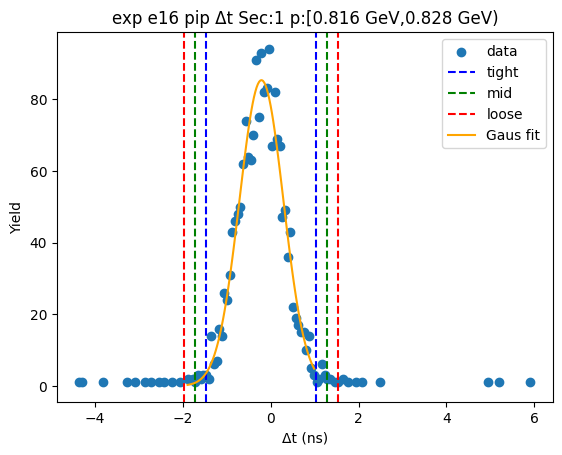

-1.4909740737138206 0.9922564848797142
-1.739297129573174 1.2405795407390676
-1.9876201854325275 1.488902596598421
[83.49248594 -0.24935879  0.49664611]


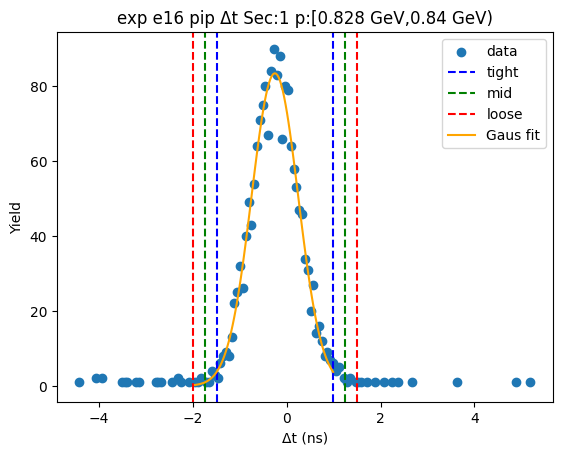

-1.426857268709322 0.8888387147805198
-1.6584268670583064 1.120408313129504
-1.8899964654072905 1.351977911478488
[80.03647775 -0.26900928  0.4631392 ]


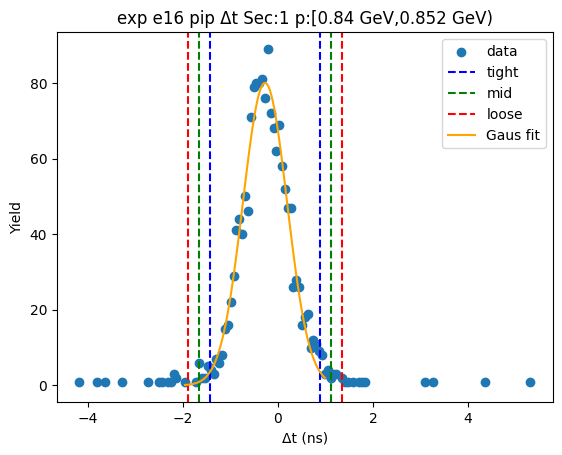

-1.502894017109099 0.946007343797103
-1.7477841531997194 1.1908974798877234
-1.9926742892903395 1.4357876159783436
[77.63774523 -0.27844334  0.48978027]


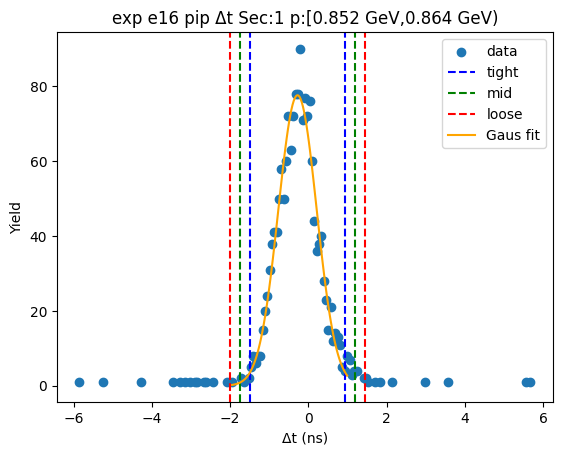

-1.4668828865491264 0.9590810324443242
-1.7094792784484716 1.2016774243436694
-1.9520756703478166 1.4442738162430144
[76.33273393 -0.25390093  0.48519278]


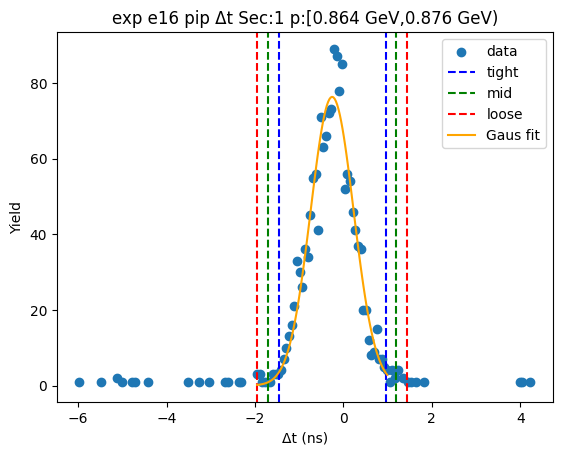

-1.5635005537061102 0.9617091599036649
-1.8160215250670877 1.2142301312646424
-2.068542496428065 1.46675110262562
[71.00116145 -0.3008957   0.50504194]


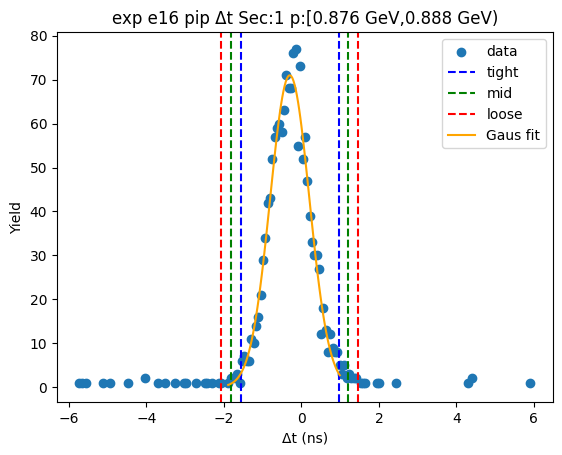

-1.529748604294359 0.9674796161293613
-1.779471426336731 1.2172024381717332
-2.029194248379103 1.4669252602141054
[69.58648145 -0.28113449  0.49944564]


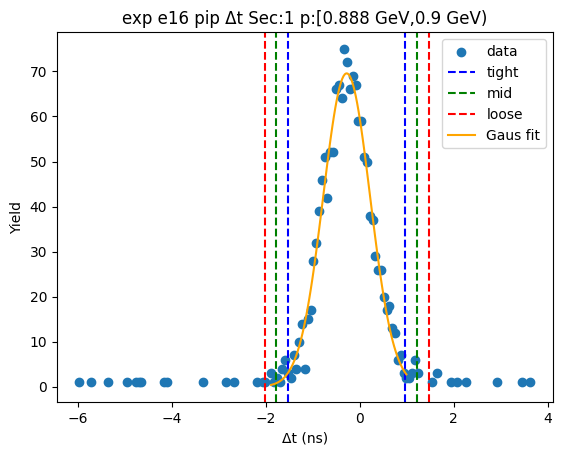

-1.5220512322149538 0.908442085622062
-1.7651005639986552 1.1514914174057638
-2.008149895782357 1.3945407491894652
[71.0366047  -0.30680457  0.48609866]


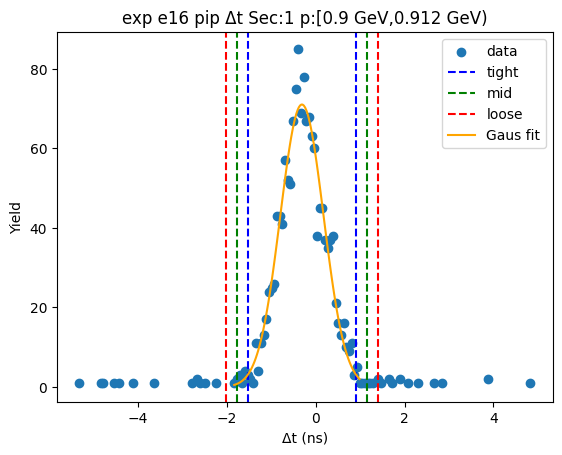

-1.6000697909942114 0.9493071334146569
-1.8550074834350982 1.2042448258555436
-2.109945175875985 1.4591825182964304
[68.52449255 -0.32538133  0.50987538]


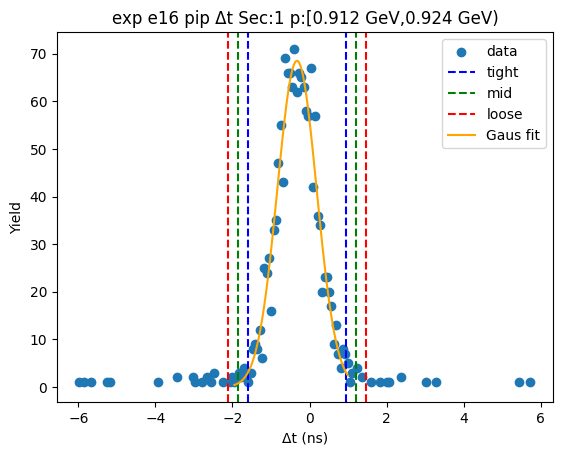

-1.5461236242448635 0.8748733678702556
-1.7882233234563756 1.1169730670817677
-2.0303230226678877 1.3590727662932796
[69.50994551 -0.33562513  0.4841994 ]


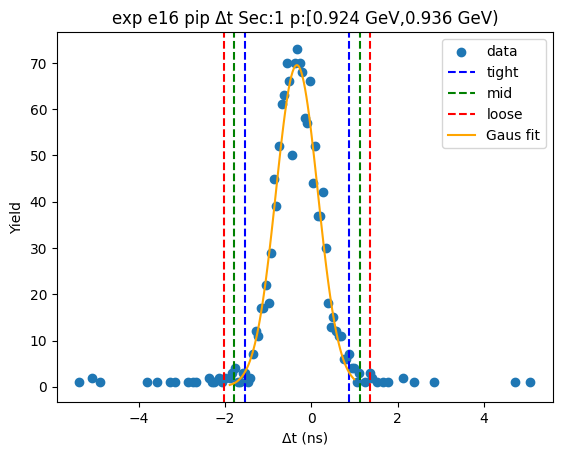

-1.6114234007397874 0.9192133851339491
-1.8644870793271613 1.1722770637213227
-2.1175507579145347 1.4253407423086966
[66.34822781 -0.34610501  0.50612736]


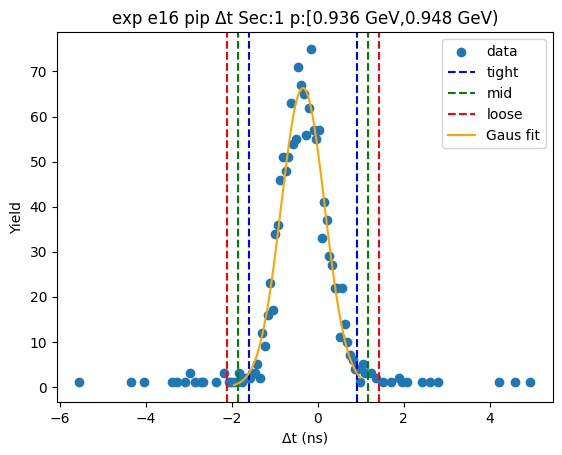

-1.6729761970235157 0.9199530515405911
-1.9322691218799266 1.179245976397002
-2.1915620467363373 1.4385389012534127
[60.94847933 -0.37651157  0.51858585]


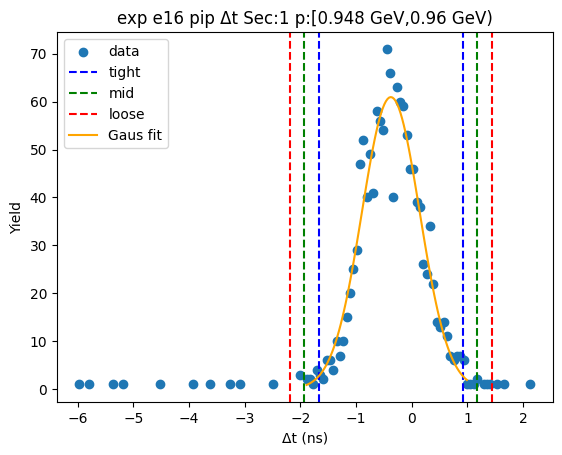

-1.6909247398839689 0.9705620133438437
-1.95707341520675 1.2367106886666248
-2.2232220905295312 1.5028593639894061
[57.23811771 -0.36018136  0.53229735]


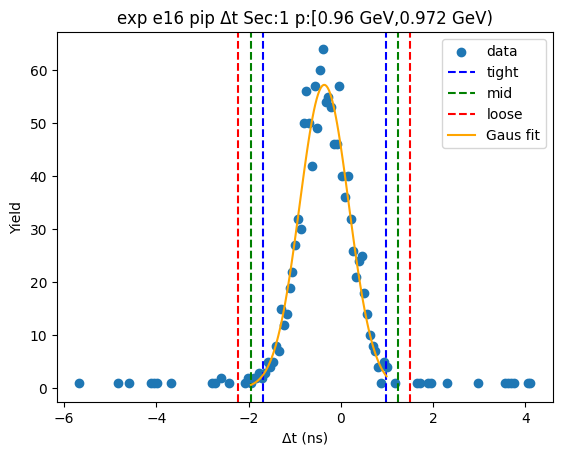

-1.6966579108401698 0.8624370975832674
-1.9525674116825134 1.118346598425611
-2.208476912524857 1.3742560992679547
[56.54113191 -0.41711041  0.511819  ]


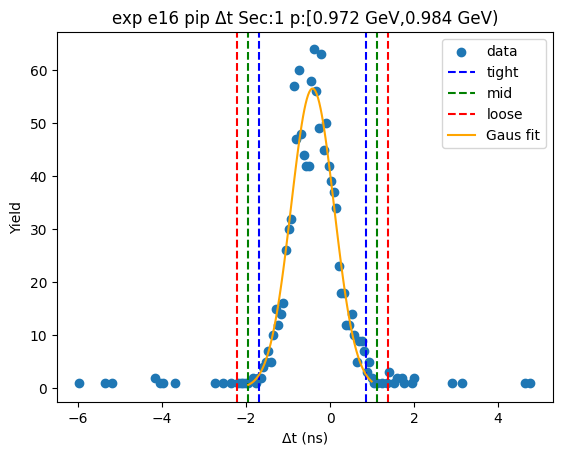

-1.6337823242953424 0.8134931988161591
-1.8785098766064925 1.0582207511273092
-2.1232374289176428 1.3029483034384595
[58.87205011 -0.41014456  0.4894551 ]


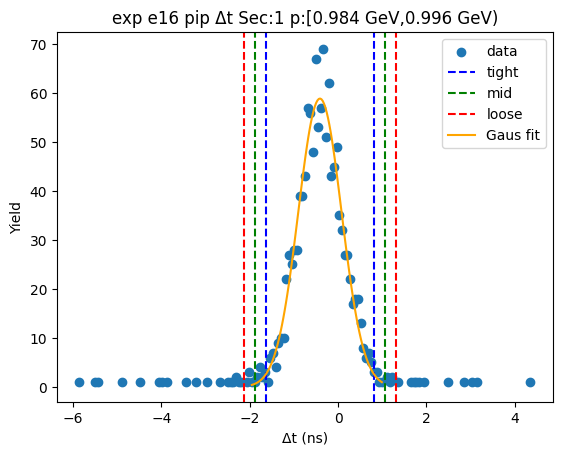

-1.675072482995598 0.829303445882611
-1.9255100758834192 1.079741038770432
-2.17594766877124 1.330178631658253
[56.7587867  -0.42288452  0.50087519]


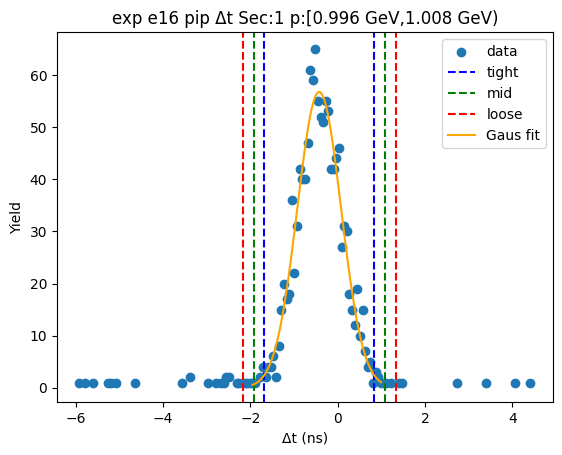

-1.6934802813452912 0.8765486279149131
-1.9504831722713114 1.1335515188409333
-2.2074860631973316 1.3905544097669538
[53.15645552 -0.40846583  0.51400578]


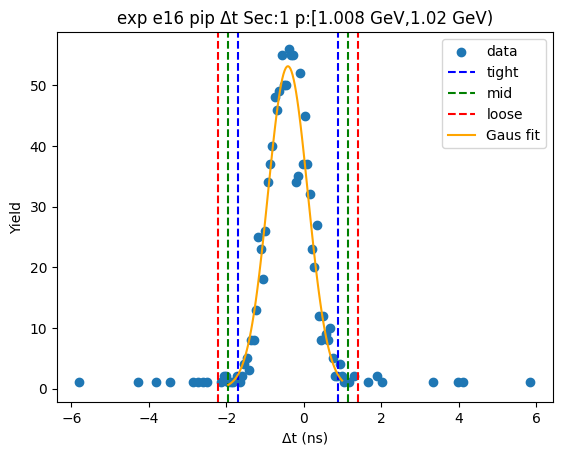

-1.6990182615354004 0.8135523911849176
-1.950275326807432 1.0648094564569492
-2.201532392079464 1.316066521728981
[55.89851468 -0.44273294  0.50251413]


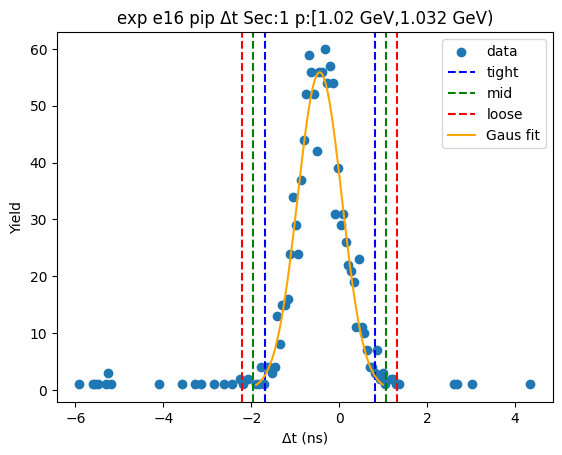

-1.7046439394858002 0.8710474445783086
-1.962213077892211 1.1286165829847192
-2.219782216298622 1.3861857213911302
[54.74881351 -0.41679825  0.51513828]


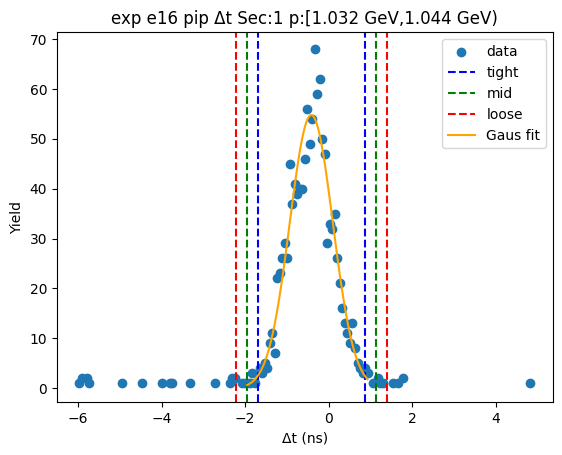

-1.716182659096742 0.8801251871189684
-1.9758134437183128 1.1397559717405392
-2.2354442283398837 1.3993867563621103
[50.4704609  -0.41802874  0.51926157]


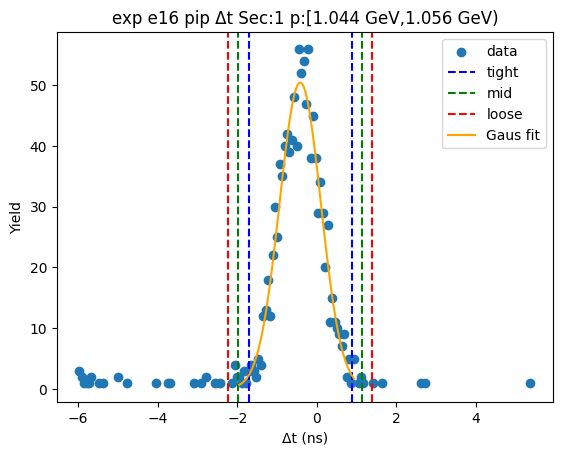

-1.745703806792636 0.8358939507946749
-2.0038635825513675 1.094053726553406
-2.2620233583100986 1.352213502312137
[47.44615734 -0.45490493  0.51631955]


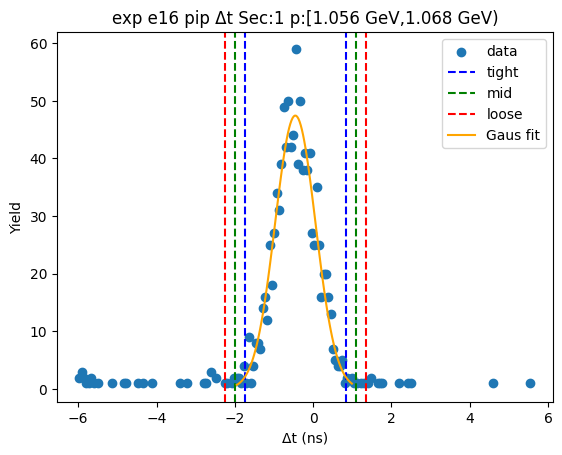

-1.6899748673689792 0.7826091259423977
-1.9372332667001169 1.0298675252735354
-2.1844916660312546 1.2771259246046731
[47.8322702  -0.45368287  0.4945168 ]


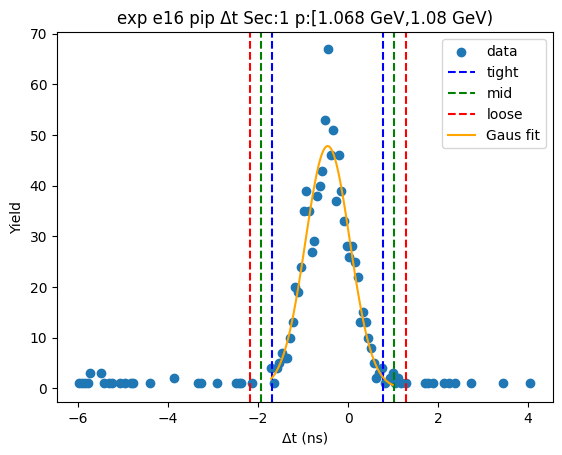

-1.6904439184825892 0.831297337448718
-1.9426180440757201 1.083471463041849
-2.194792169668851 1.3356455886349796
[47.37698046 -0.42957329  0.50434825]


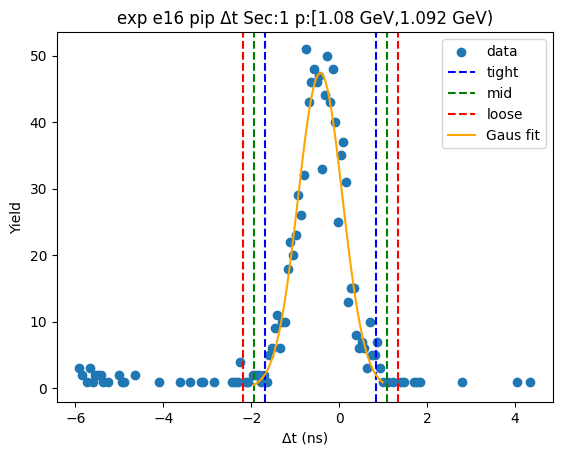

-1.706726382822217 0.7911598240761084
-1.9565150035120495 1.040948444765941
-2.206303624201882 1.2907370654557735
[48.26260365 -0.45778328  0.49957724]


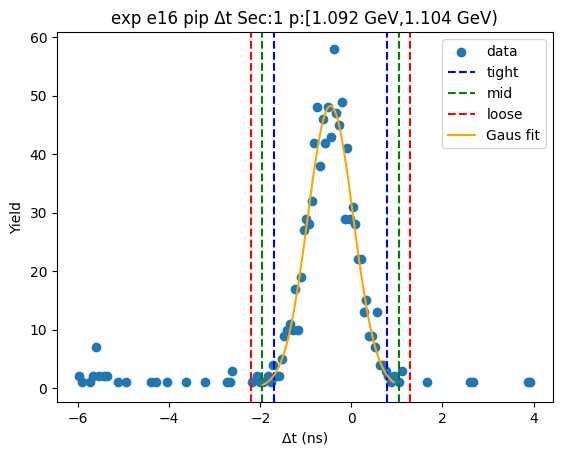

-1.721043442945743 0.7379457134438644
-1.9669423585847037 0.9838446290828252
-2.2128412742236643 1.229743544721786
[48.38554433 -0.49154886  0.49179783]


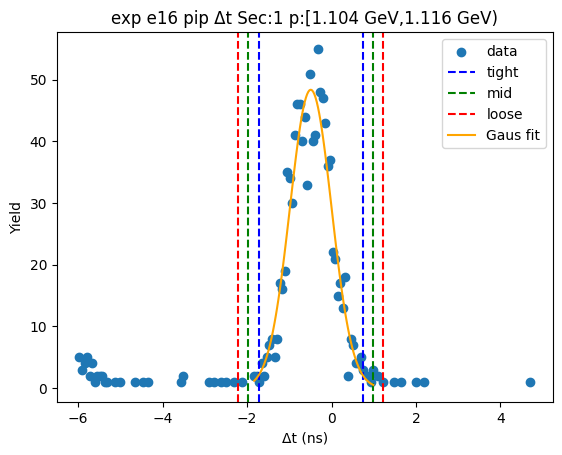

-1.8473358639509145 0.840344100886293
-2.1161038604346354 1.1091120973700135
-2.384871856918356 1.3778800938537343
[40.23620883 -0.50349588  0.53753599]


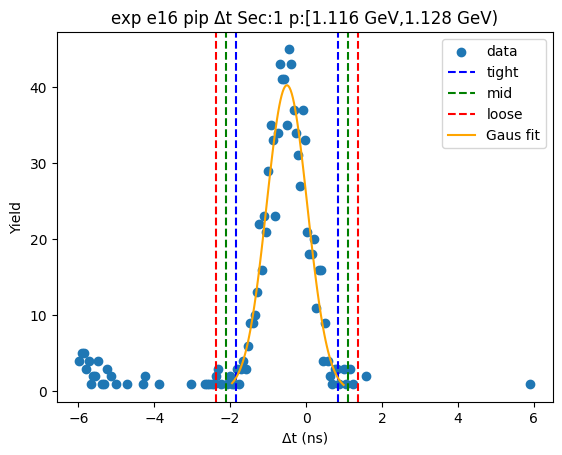

-1.7815543532566003 0.819009229240638
-2.041610711506324 1.079065587490362
-2.301667069756048 1.3391219457400858
[40.24927121 -0.48127256  0.52011272]


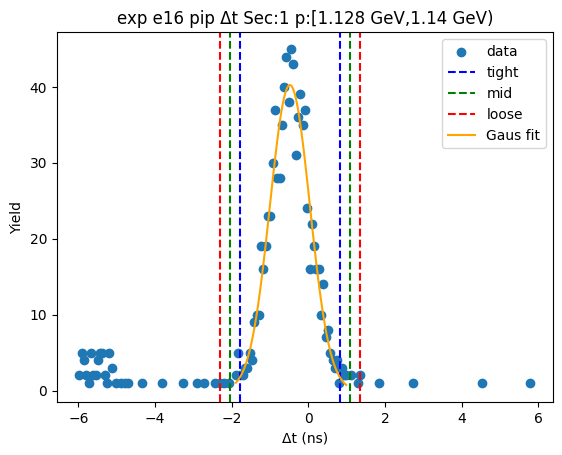

-1.7686633881173432 0.7956971462209115
-2.0250994415511685 1.052133199654737
-2.281535494984994 1.3085692530885624
[42.71465799 -0.48648312  0.51287211]


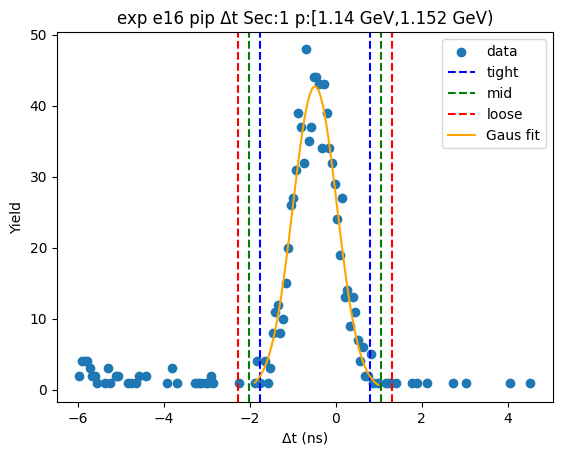

-1.7513068992721674 0.68168077482905
-1.9946056666822893 0.9249795422391719
-2.237904434092411 1.1682783096492937
[43.138906   -0.53481306  0.48659753]


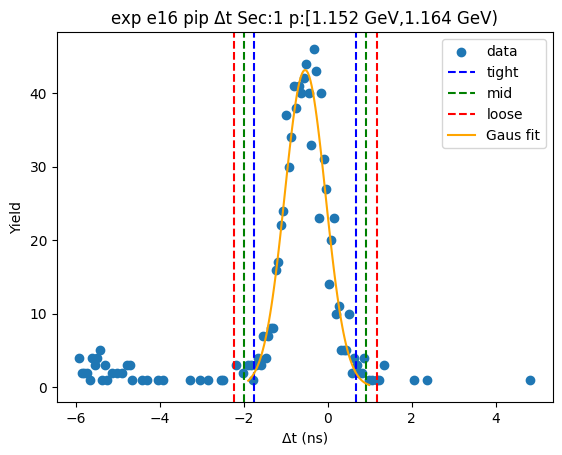

-1.8139894483429049 0.8222596064691037
-2.0776143538241056 1.0858845119503047
-2.341239259305307 1.3495094174315057
[36.94104625 -0.49586492  0.52724981]


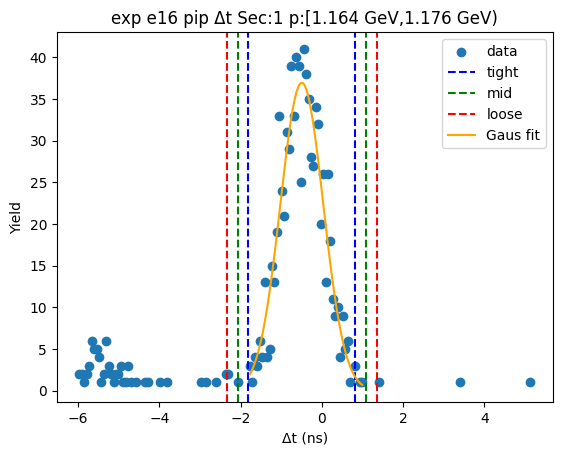

-1.8063796403005088 0.7595659168259324
-2.062974196013153 1.0161604725385764
-2.319568751725797 1.2727550282512206
[38.78104987 -0.52340686  0.51318911]


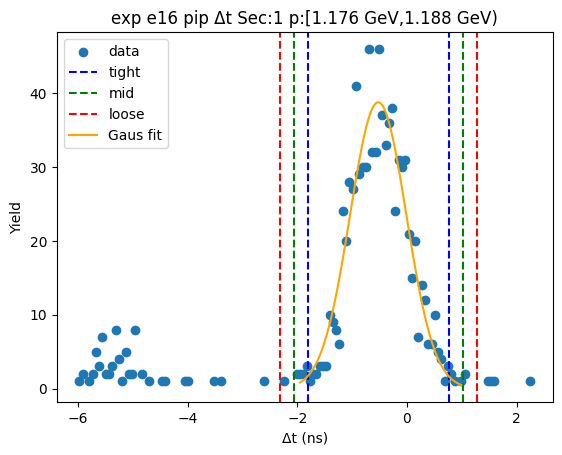

-1.8074011841653976 0.8190147740649453
-2.0700427799884316 1.0816563698879795
-2.332684375811466 1.3442979657110135
[37.26698051 -0.49419321  0.52528319]


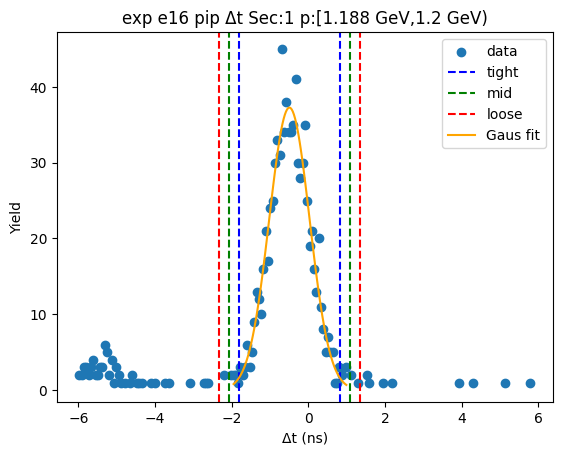

-1.7764683815310485 0.7144717721871348
-2.025562396902867 0.963565787558953
-2.274656412274685 1.2126598029307711
[37.27831626 -0.5309983   0.49818803]


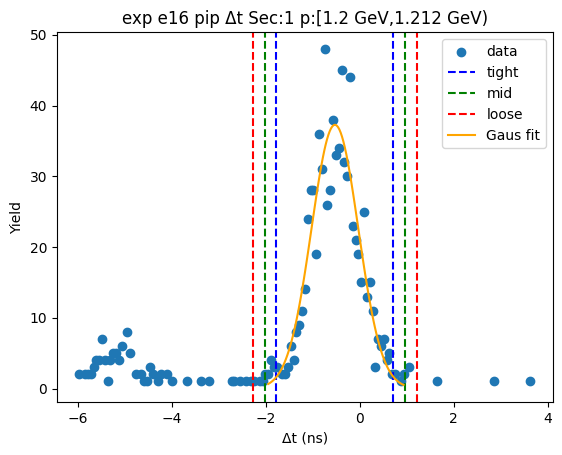

-1.8229646952710574 0.7633726967984376
-2.081598434478007 1.0220064360053869
-2.3402321736849565 1.2806401752123364
[38.55428908 -0.529796    0.51726748]


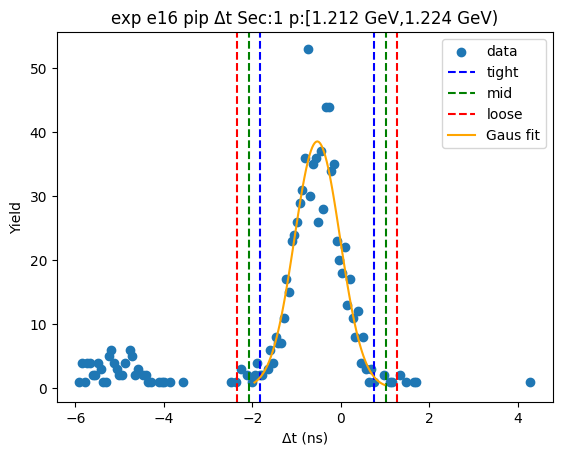

-1.8501960147822878 0.7541589696432728
-2.1106315132248437 1.0145944680858285
-2.3710670116673995 1.2750299665283849
[35.46535578 -0.54801852  0.520871  ]


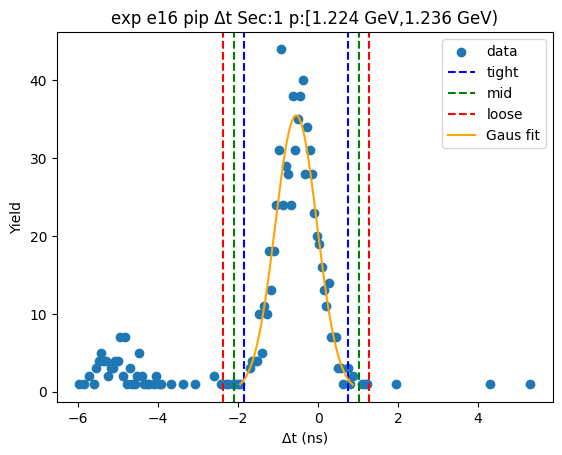

-1.9151378292262804 0.869871683680935
-2.193638780517002 1.1483726349716568
-2.4721397318077236 1.4268735862623783
[32.75820329 -0.52263307  0.5570019 ]


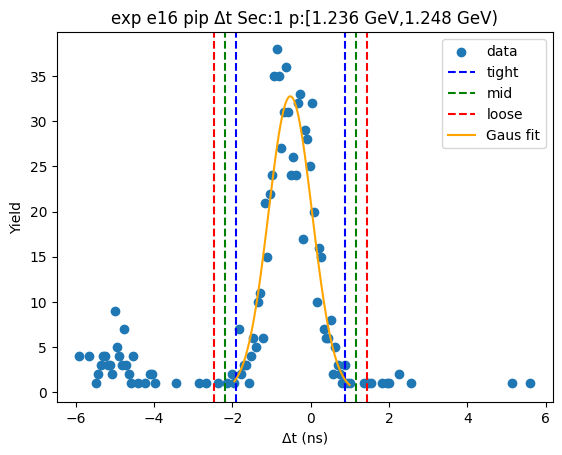

-1.7252389766656837 0.7100039366986806
-1.96876326800212 0.9535282280351169
-2.2122875593385567 1.1970525193715533
[35.00308545 -0.50761752  0.48704858]


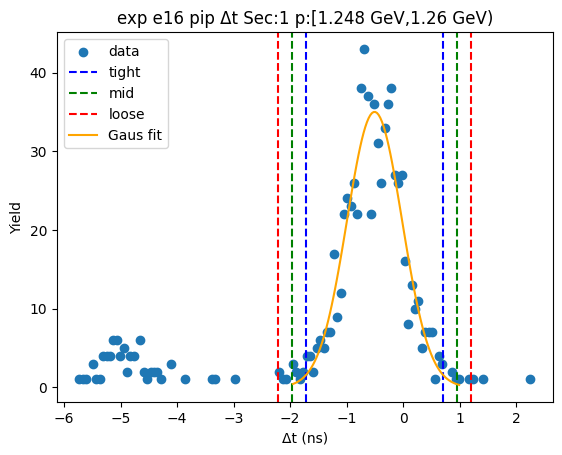

-1.7426737027605137 0.6257914484128314
-1.9795202178778482 0.8626379635301659
-2.2163667329951826 1.0994844786475002
[36.74166295 -0.55844113  0.47369303]


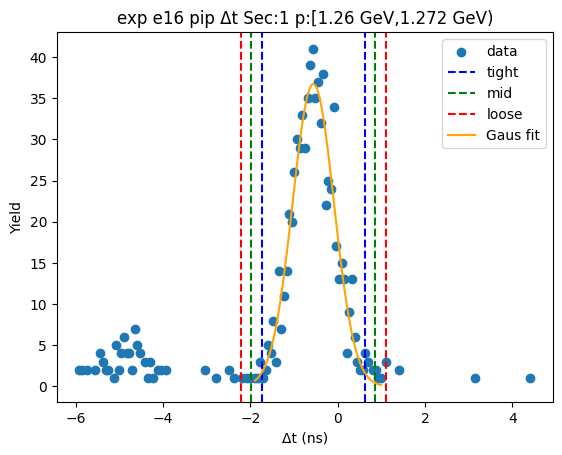

-1.8302985498341533 0.7017820914093398
-2.0835066139585026 0.9549901555336893
-2.336714678082852 1.2081982196580385
[31.21822716 -0.56425823  0.50641613]


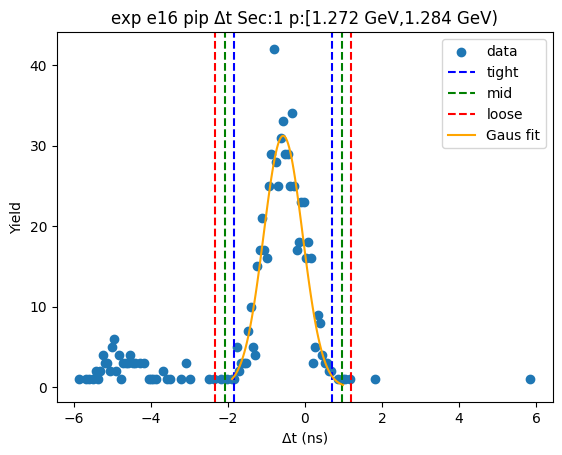

-1.83277532983025 0.7579434416481363
-2.0918472069780885 1.017015318795975
-2.3509190841259273 1.2760871959438136
[31.50590911 -0.53741594  0.51814375]


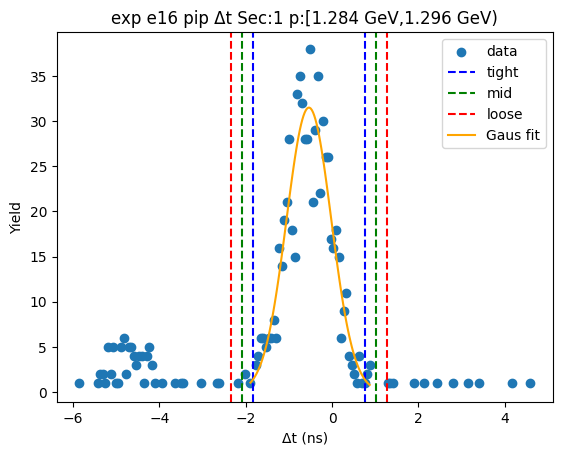

-1.763837941260071 0.7417503865448241
-2.0143967740405606 0.9923092193253136
-2.26495560682105 1.242868052105803
[33.74809683 -0.51104378  0.50111767]


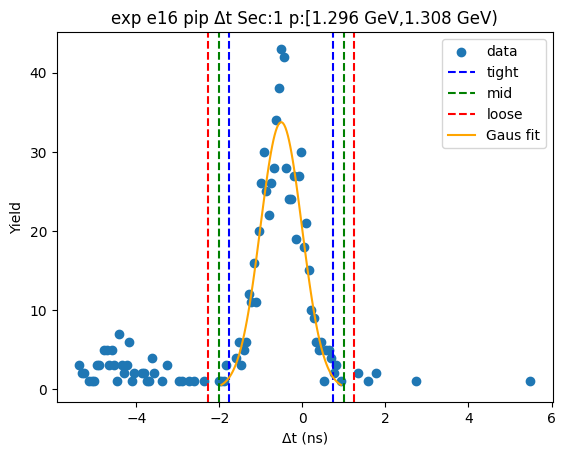

-1.8736910299074294 0.8229150764765015
-2.1433516405458226 1.0925756871148944
-2.4130122511842154 1.3622362977532876
[30.45673166 -0.52538798  0.53932122]


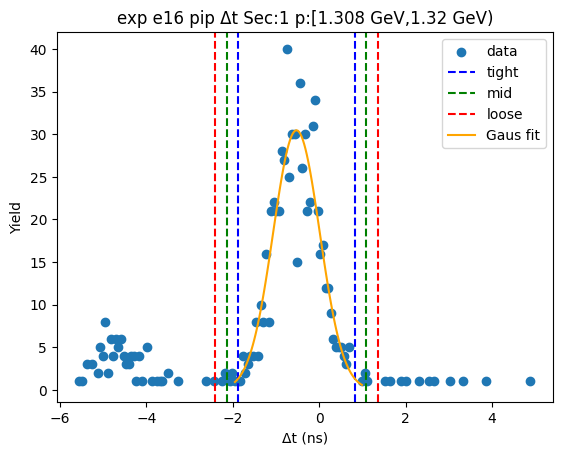

-1.7688735195417284 0.6620374522375395
-2.0119646167196557 0.9051285494154665
-2.2550557138975824 1.1482196465933932
[32.82357771 -0.55341803  0.48618219]


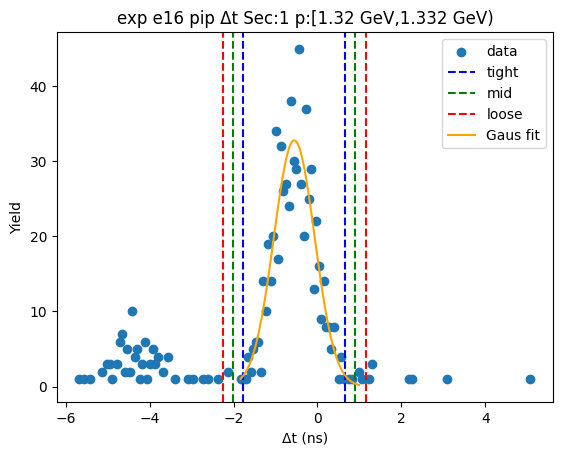

-1.8306512941180646 0.7305853566640529
-2.0867749591962768 0.9867090217422648
-2.3428986242744885 1.2428326868204764
[27.52452231 -0.55003297  0.51224733]


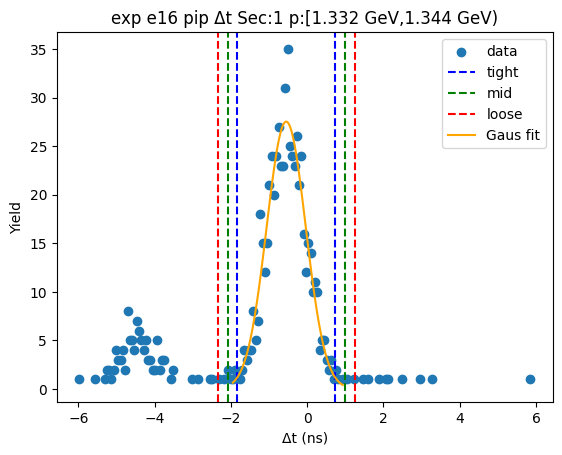

-1.810659820945333 0.7550346800021706
-2.067229271040083 1.0116041300969207
-2.3237987211348337 1.2681735801916711
[29.76959972 -0.52781257  0.5131389 ]


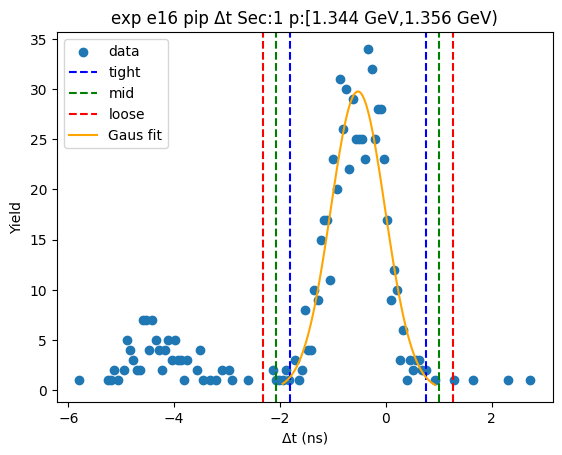

-1.786739922696238 0.655162468620138
-2.0309301618278752 0.8993527077517756
-2.275120400959513 1.1435429468834133
[28.39307407 -0.56578873  0.48838048]


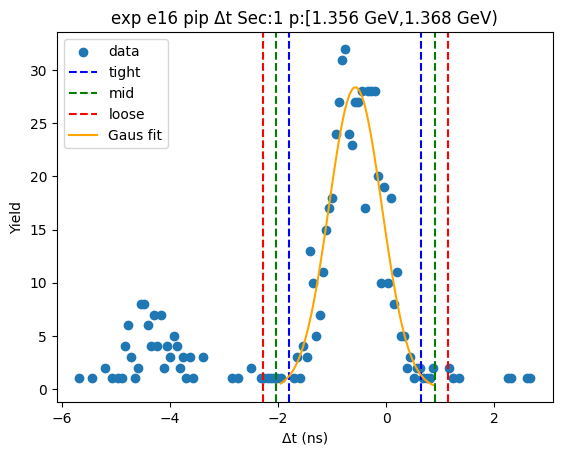

-1.8900693437564082 0.8287221821334878
-2.1619484963453974 1.1006013347224772
-2.433827648934387 1.3724804873114669
[26.63073323 -0.53067358  0.54375831]


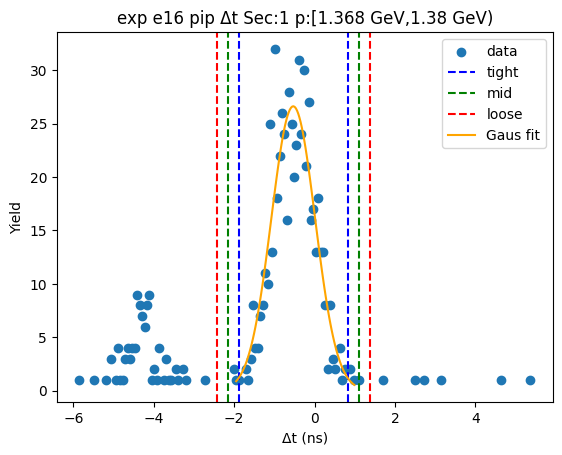

-1.9321782941237922 0.7459713179222398
-2.199993255328395 1.0137862791268428
-2.4678082165329984 1.281601240331446
[25.32571035 -0.59310349  0.53562992]


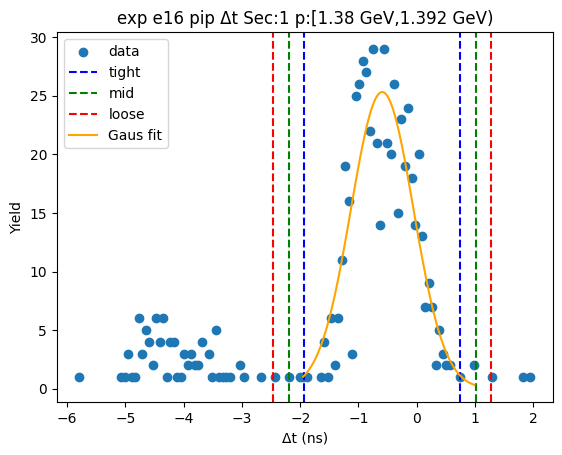

-1.7639994927139777 0.6489458356799793
-2.0052940255533733 0.8902403685193749
-2.2465885583927694 1.1315349013587708
[25.47272184 -0.55752683  0.48258907]


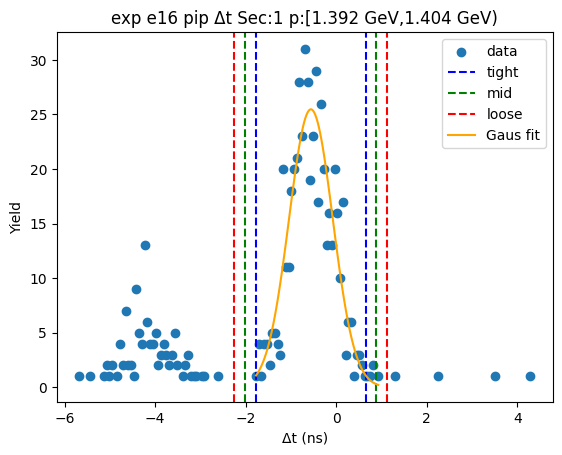

-1.8140311911215334 0.6497805692849441
-2.060412367162181 0.8961617453255917
-2.306793543202829 1.1425429213662395
[26.81873445 -0.58212531  0.49276235]


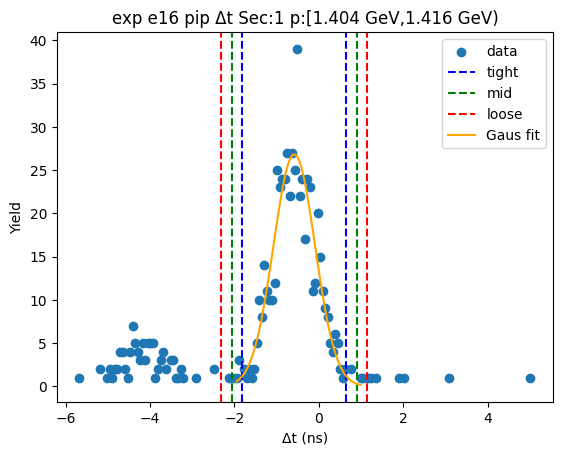

-1.817741224561432 0.6853307525420984
-2.0680484222717848 0.9356379502524514
-2.318355619982138 1.1859451479628045
[21.87445505 -0.56620524  0.5006144 ]


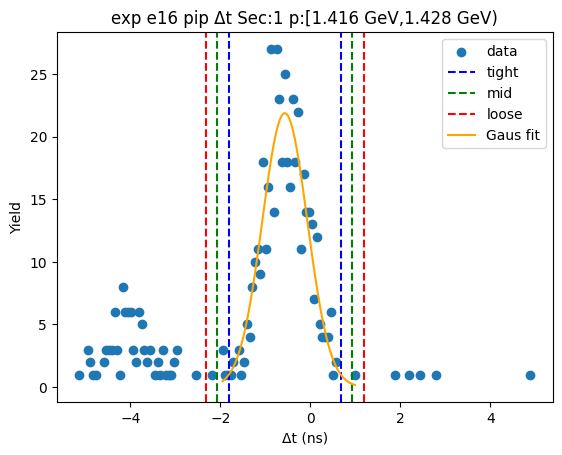

-1.8311416510507377 0.7608359383104941
-2.0903394099868606 1.0200336972466173
-2.349537168922984 1.2792314561827405
[24.87876437 -0.53515286  0.51839552]


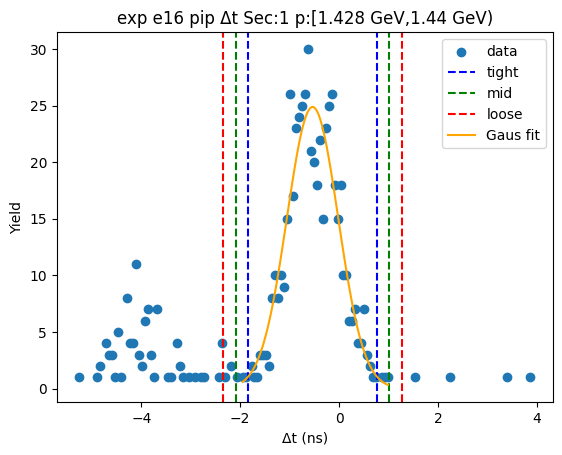

-1.8389628593395266 0.7436494430203419
-2.0972240895755134 1.001910673256329
-2.3554853198115002 1.2601719034923158
[24.02818304 -0.54765671  0.51652246]


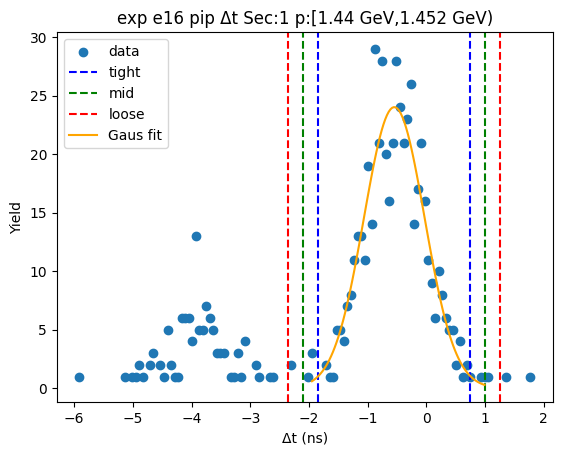

-2.042880387094647 0.9072226606801816
-2.33789069187213 1.2022329654576647
-2.632900996649613 1.4972432702351475
[21.59309537 -0.56782886  0.59002061]


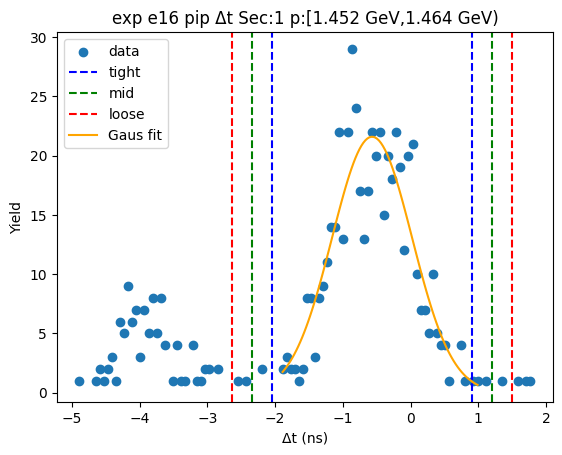

-1.8406596101896384 0.68952649259314
-2.093678220467916 0.9425451028714177
-2.3466968307461937 1.1955637131496957
[24.18538619 -0.57556656  0.50603722]


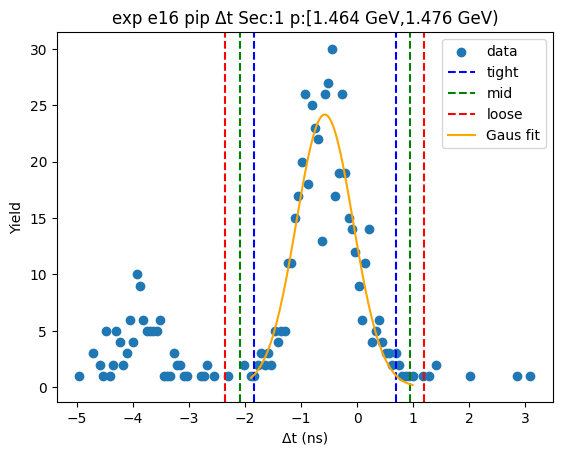

-1.736167369381442 0.5641353441608886
-1.966197640735675 0.7941656155151217
-2.196227912089908 1.0241958868693546
[24.29677661 -0.58601601  0.46006054]


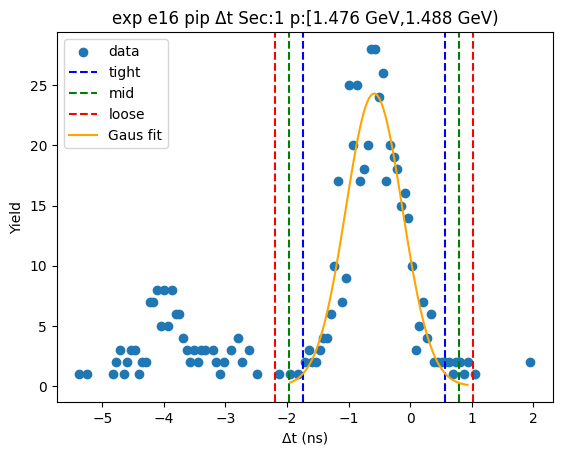

-1.8447086969683495 0.6309890611096262
-2.0922784727761474 0.8785588369174239
-2.339848248583945 1.1261286127252217
[24.89164718 -0.60685982  0.49513955]


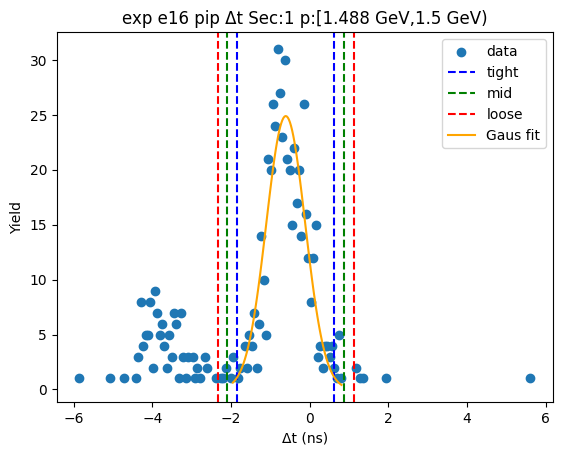

-1.8921530539179574 0.6005635747825242
-2.1414247167880056 0.8498352376525722
-2.3906963796580536 1.0991069005226204
[22.58734945 -0.64579474  0.49854333]


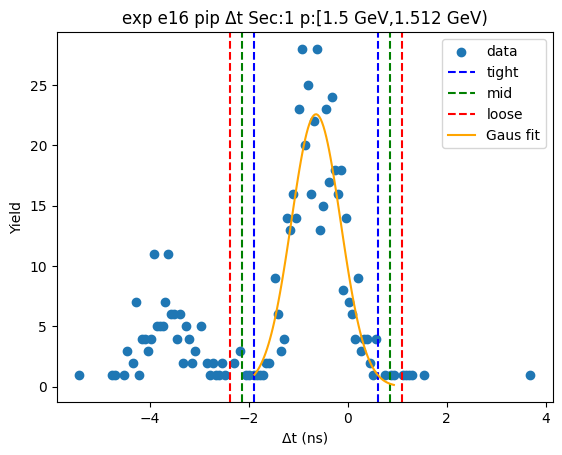

-1.8510683737439844 0.7646950494692955
-2.1126447160653123 1.0262713917906234
-2.3742210583866403 1.2878477341119514
[20.81935907 -0.54318666  0.52315268]


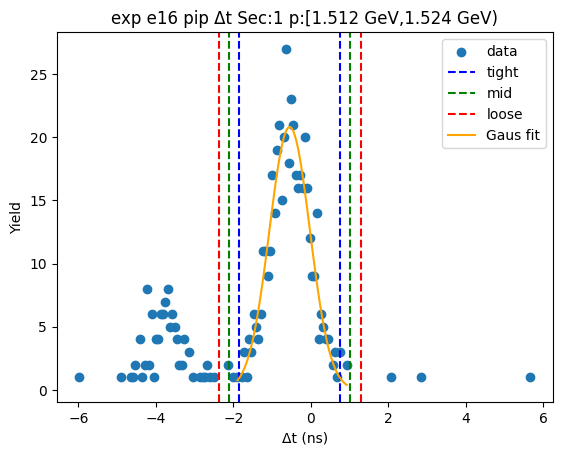

-2.023544000885349 0.9382024501233436
-2.319718645986218 1.2343770952242128
-2.615893291087087 1.5305517403250817
[18.97143063 -0.54267078  0.59234929]


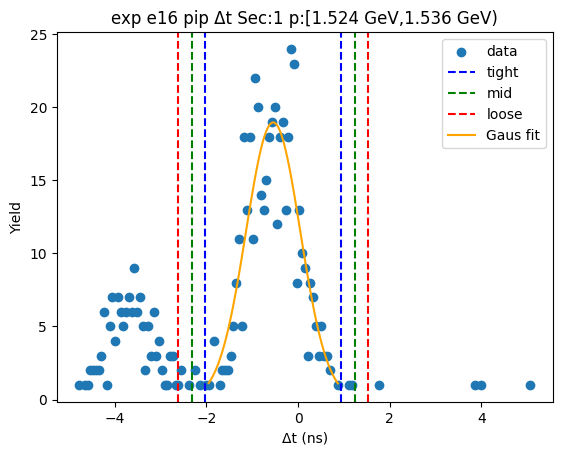

-1.7792051979790369 0.5754384137416793
-2.014669559151108 0.8109027749137507
-2.25013392032318 1.0463671360858222
[22.93677701 -0.60188339  0.47092872]


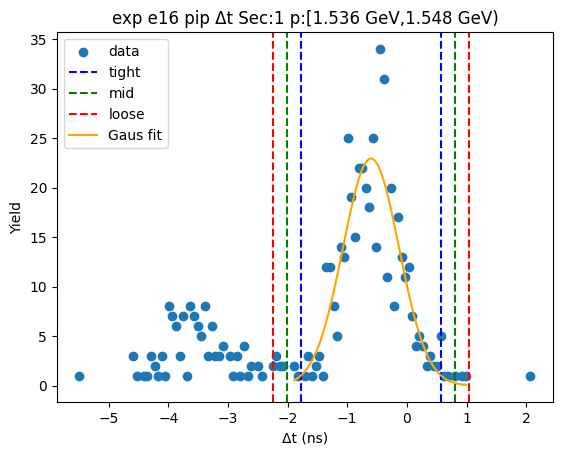

-1.9800459403617645 0.9373034437938247
-2.2717808787773235 1.2290383822093833
-2.5635158171928825 1.5207733206249423
[16.95206447 -0.52137125  0.58346988]


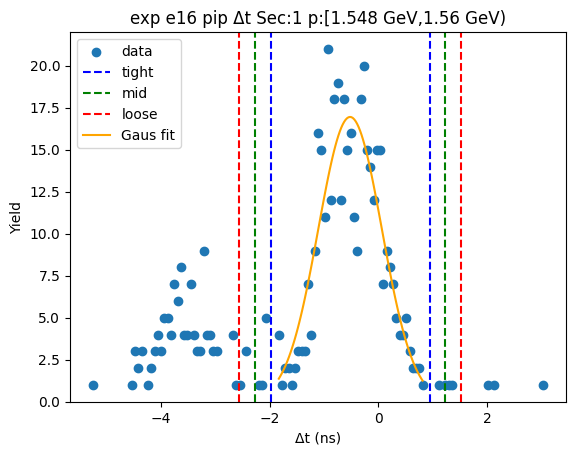

-1.9456589008496938 0.7570553169505758
-2.2159303226297205 1.0273267387306027
-2.4862017444097475 1.2975981605106295
[19.49126566 -0.59430179  0.54054284]


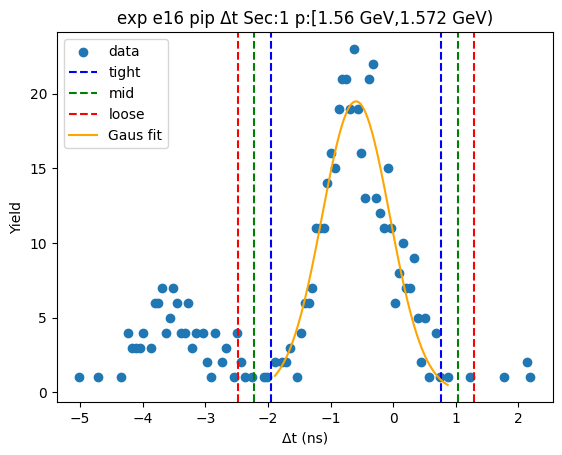

-1.8145425483719329 0.5725782394519332
-2.0532546271543195 0.8112903182343199
-2.291966705936706 1.0500023970167065
[20.41436865 -0.62098215  0.47742416]


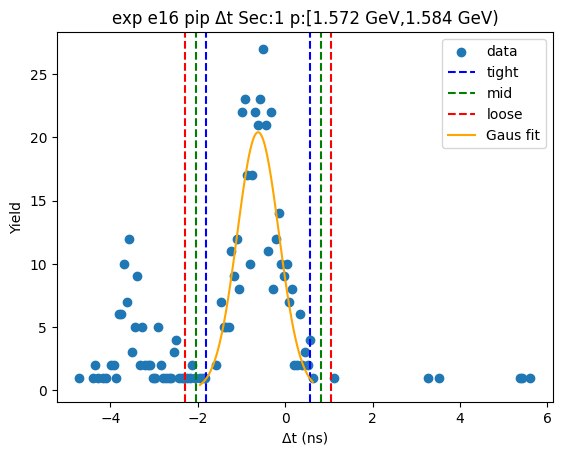

-1.9579945519786883 0.9436542614213935
-2.2481594333186963 1.2338191427614018
-2.5383243146587047 1.5239840241014102
[18.02833626 -0.50717015  0.58032976]


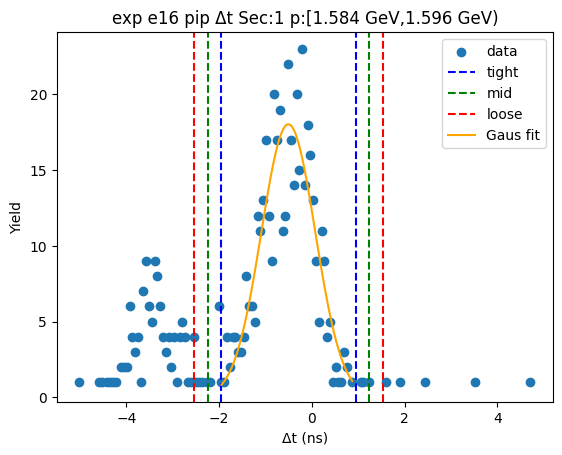

-1.953345989515348 0.7699823158062645
-2.225678820047509 1.0423151463384257
-2.49801165057967 1.314647976870587
[18.79704273 -0.59168184  0.54466566]


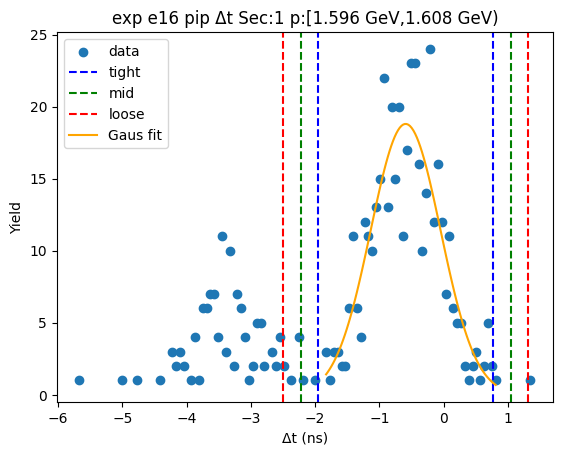

-1.8752922912819283 0.7866191336897491
-2.1414834337790962 1.052810276186917
-2.4076745762762637 1.3190014186840848
[17.72798844 -0.54433658  0.53238228]


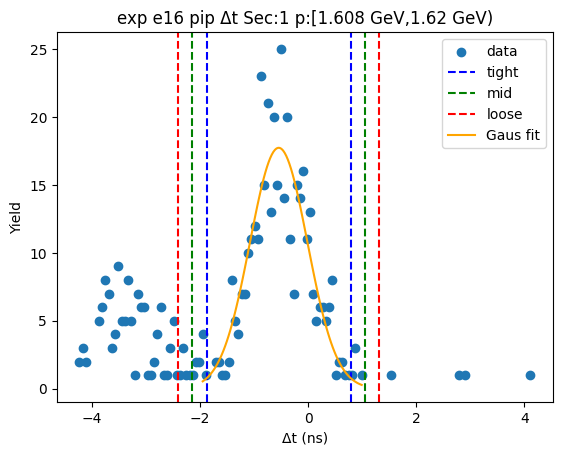

-2.00191800038438 0.7615837325150089
-2.2782681736743187 1.0379339058049477
-2.554618346964258 1.3142840790948864
[15.98321071 -0.62016713  0.55270035]


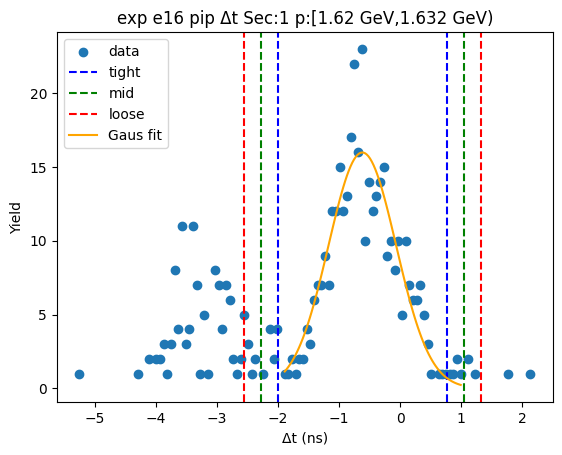

-1.9131014802636548 0.7579446148381218
-2.1802060897738325 1.0250492243482996
-2.44731069928401 1.2921538338584773
[16.90570423 -0.57757843  0.53420922]


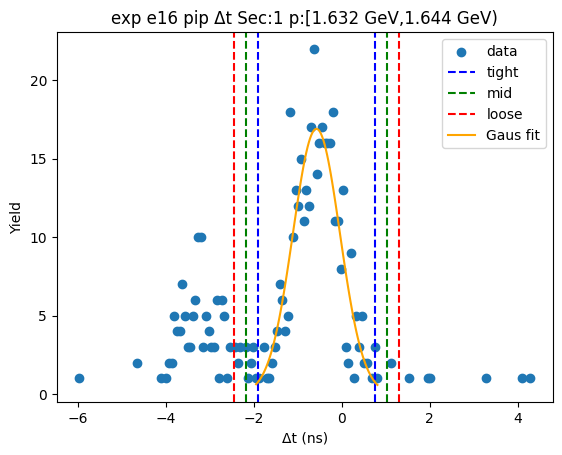

-1.8834904286882912 0.8699081264941358
-2.158830284206534 1.1452479820123784
-2.4341701397247766 1.4205878375306211
[16.64029709 -0.50679115  0.55067971]


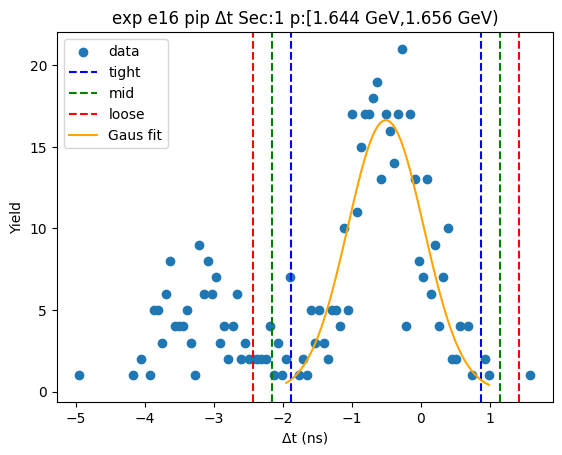

-2.014582338729915 0.7715371457366951
-2.2931942871765765 1.0501490941833562
-2.5718062356232374 1.3287610426300174
[16.941843  -0.6215226  0.5572239]


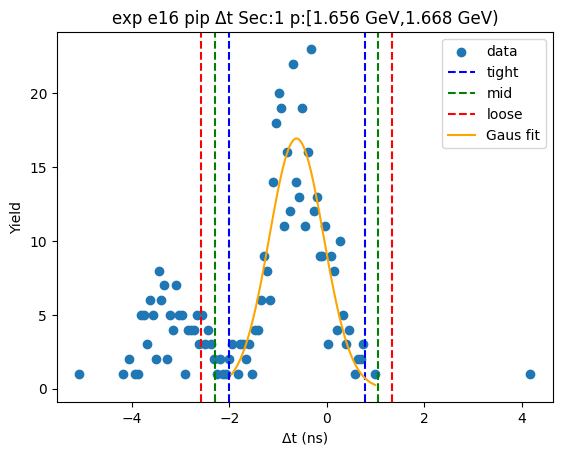

-2.078884749855005 0.8435511894812157
-2.3711283437886275 1.1357947834148376
-2.6633719377222493 1.4280383773484595
[15.85644599 -0.61766678  0.58448719]


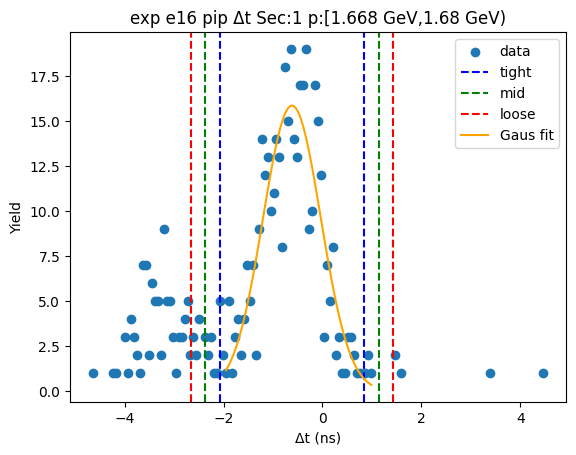

-1.9788150651471406 0.8273221280491553
-2.25942878446677 1.1079358473687848
-2.5400425037864 1.3885495666884142
[16.6981932  -0.57574647  0.56122744]


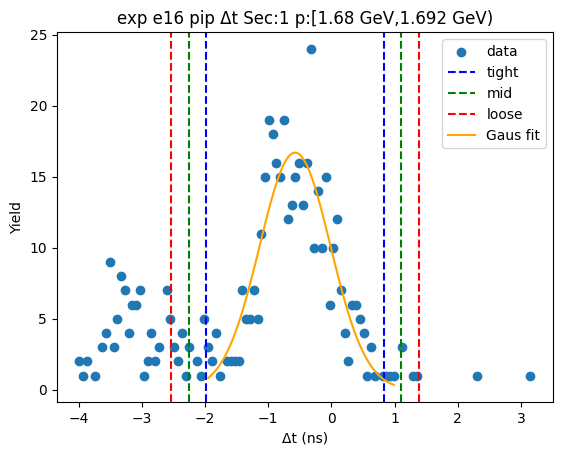

-1.914784766533937 0.6297537411525724
-2.169238617302588 0.8842075919212236
-2.423692468071239 1.1386614426898745
[16.85614252 -0.64251551  0.5089077 ]


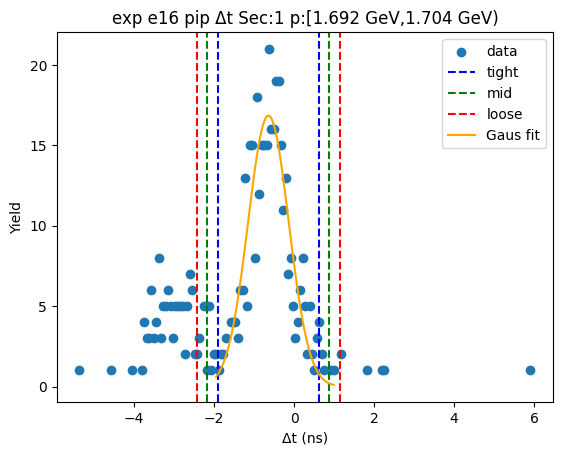

-2.0661848028414926 0.8280137615375052
-2.355604659279392 1.1174336179754047
-2.645024515717292 1.4068534744133045
[13.99633954 -0.61908552  0.57883971]


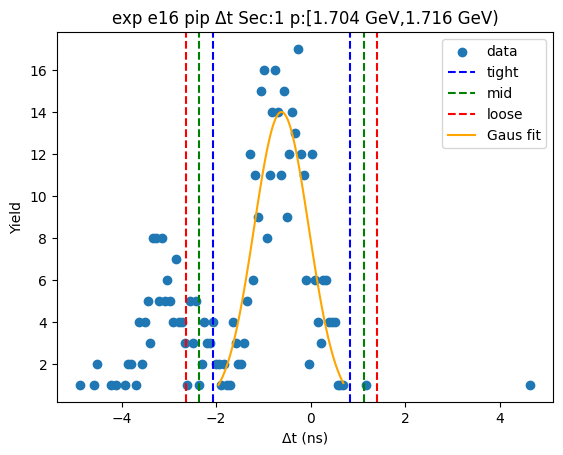

-2.1616598573235772 1.0492940031037445
-2.48275524336631 1.3703893891464767
-2.803850629409042 1.6914847751892088
[13.5173403  -0.55618293  0.64219077]


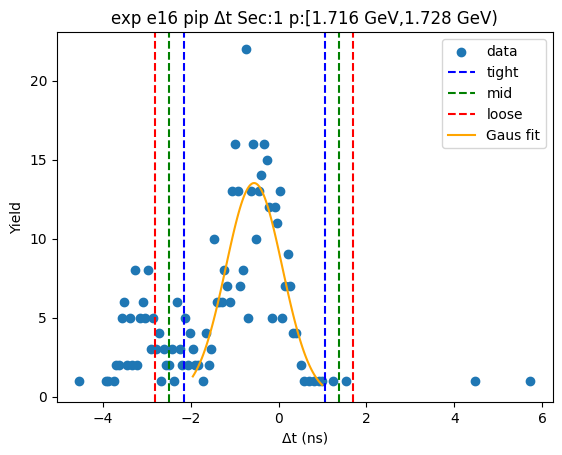

-2.0002246317150707 0.8996899772739825
-2.290216092613976 1.1896814381728875
-2.5802075535128814 1.479672899071793
[15.16547938 -0.55026733  0.57998292]


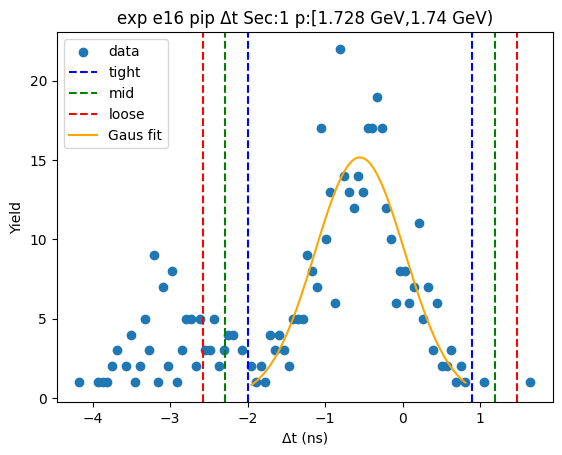

-2.085067066483556 0.915453091658547
-2.385119082297766 1.2155051074727572
-2.685171098111976 1.5155571232869673
[13.54540984 -0.58480699  0.60010403]


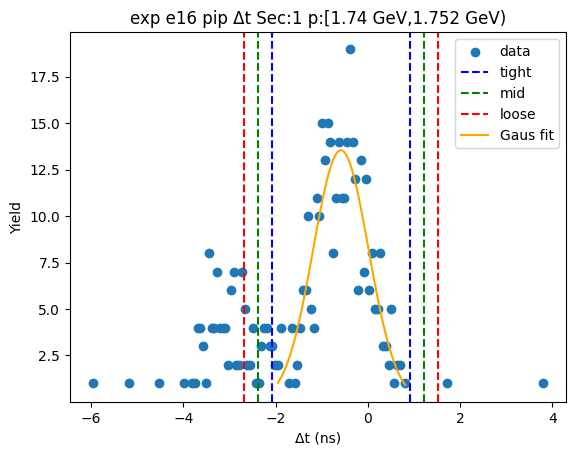

-2.175493924024012 0.8478334905507338
-2.4778266654814867 1.1501662320082082
-2.780159406938961 1.4524989734656826
[13.8647533  -0.66383022  0.60466548]


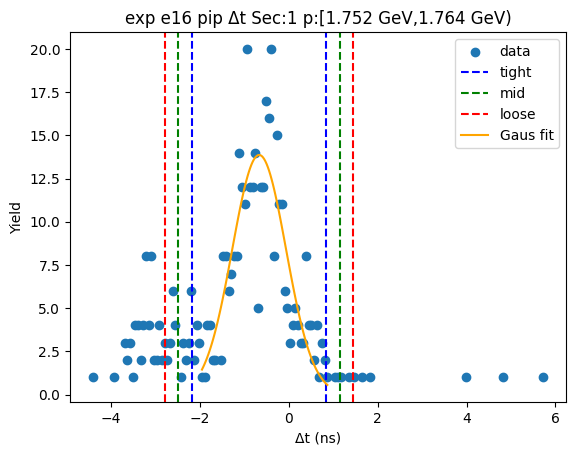

-2.1301498559864083 1.0306740468091582
-2.4462322462659647 1.346756437088715
-2.762314636545521 1.6628388273682715
[12.27263815 -0.5497379   0.63216478]


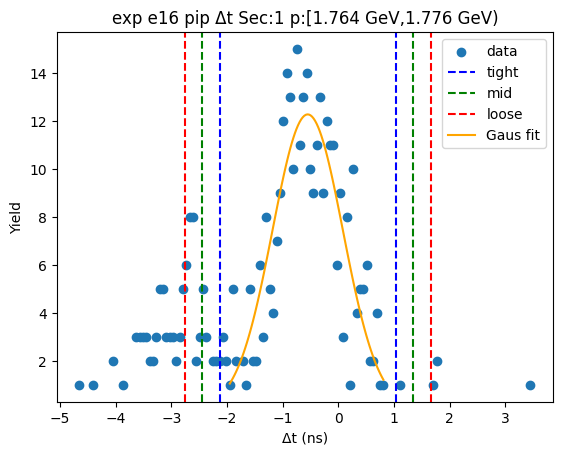

-2.1341520473805473 0.93405565798238
-2.4409728179168404 1.2408764285186729
-2.747793588453133 1.5476971990549657
[13.53830187 -0.60004819  0.61364154]


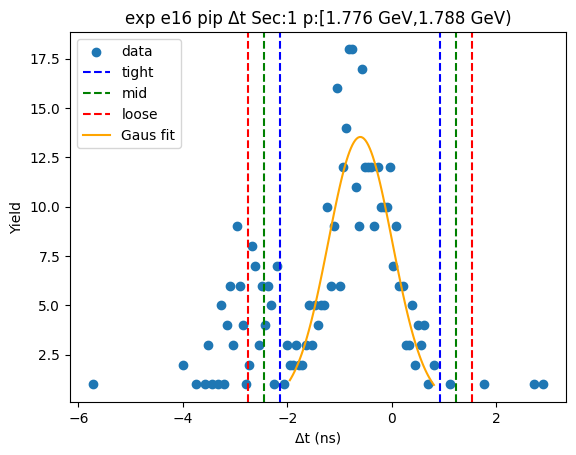

-2.2950038410589153 1.2341220089036158
-2.6479164260551684 1.587034593899869
-3.0008290110514215 1.939947178896122
[10.71348376 -0.53044092  0.70582517]


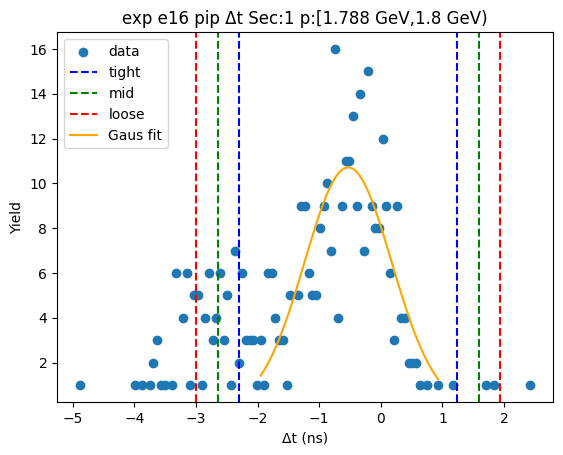

-2.1060571473884773 0.9959318564585088
-2.416256047773176 1.3061307568432077
-2.7264549481578744 1.6163296572279062
[12.72612698 -0.55506265  0.6203978 ]


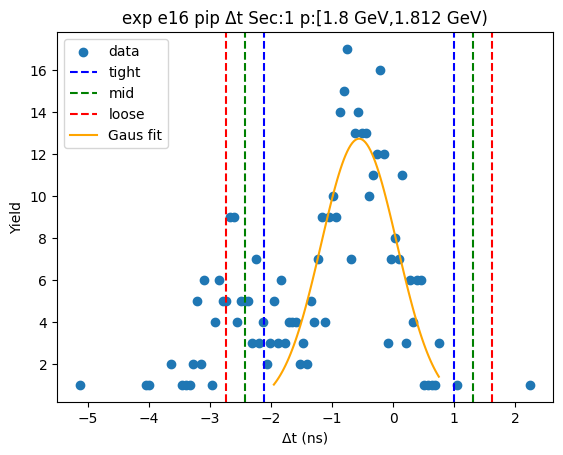

-2.153853905363282 1.0004651890960197
-2.4692858148092123 1.31589709854195
-2.7847177242551426 1.63132900798788
[12.06865501 -0.57669436  0.63086382]


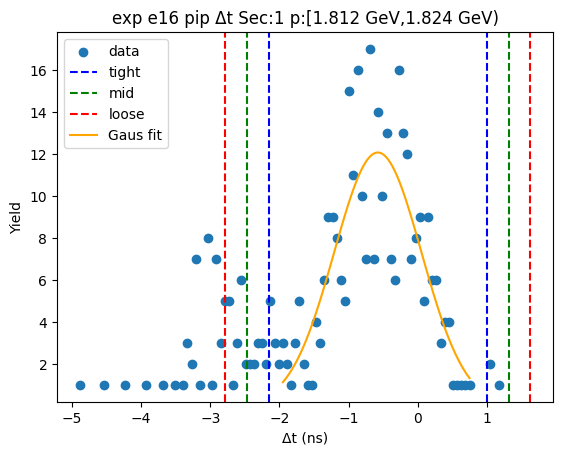

-2.1233841434033547 1.2094930694025365
-2.456671864683944 1.5427807906831257
-2.789959585964533 1.8760685119637146
[10.93672297 -0.45694554  0.66657544]


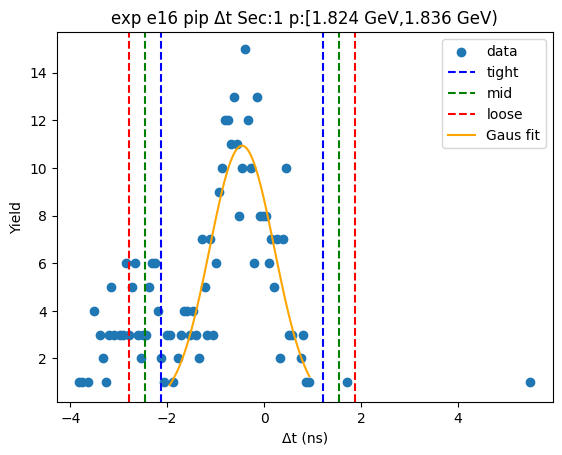

-2.4188990090860565 1.0810071865902229
-2.768889628653685 1.4309978061578508
-3.1188802482213127 1.7809884257254787
[11.34721455 -0.66894591  0.69998124]


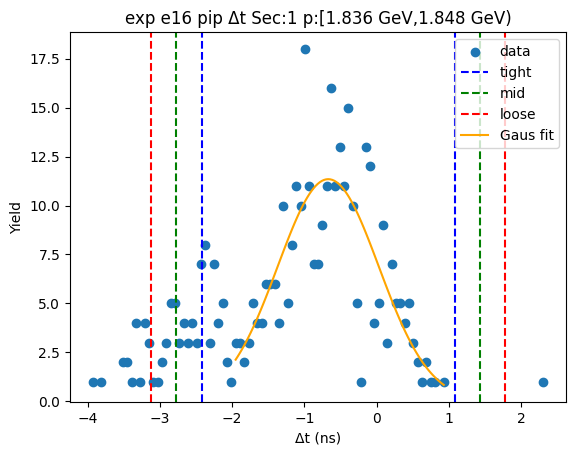

-2.270342913840521 1.1078190144570825
-2.608159106670282 1.4456352072868432
-2.9459752995000423 1.7834514001166035
[10.28008015 -0.58126195  0.67563239]


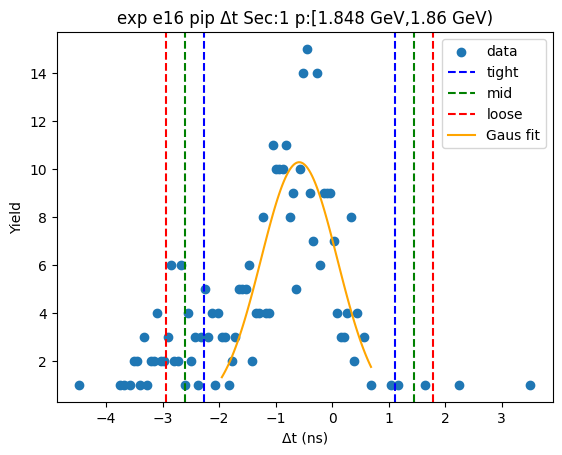

-2.1605628892692854 0.9081491429348403
-2.4674340924896976 1.2150203461552527
-2.7743052957101106 1.5218915493756653
[12.63412185 -0.62620687  0.61374241]


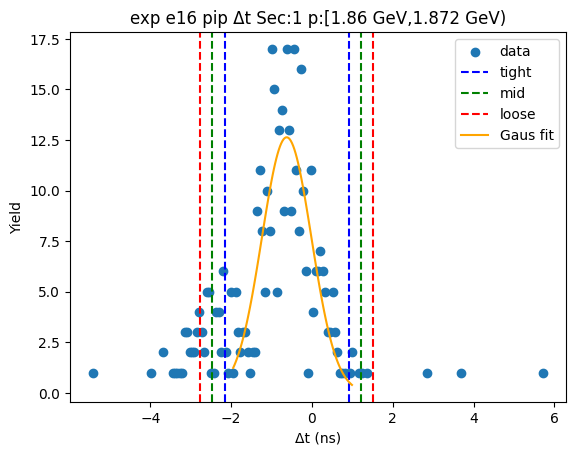

-2.3043437460945437 0.9578852416396895
-2.630566644867967 1.284108140413113
-2.9567895436413902 1.6103310391865362
[10.66044685 -0.67322925  0.6524458 ]


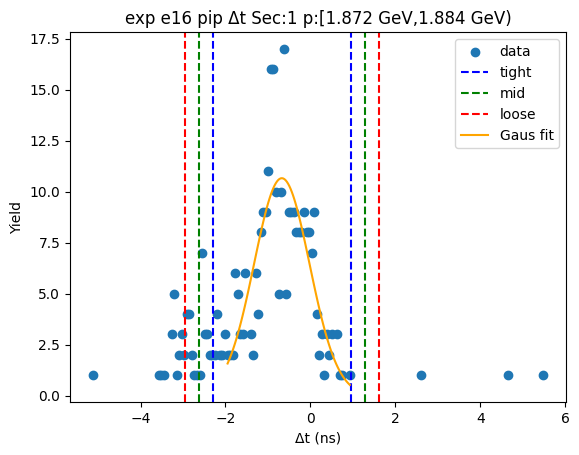

-2.567586418747629 1.2600227131846513
-2.950347331940857 1.6427836263778797
-3.3331082451340848 2.025544539571108
[ 9.67348258 -0.65378185  0.76552183]


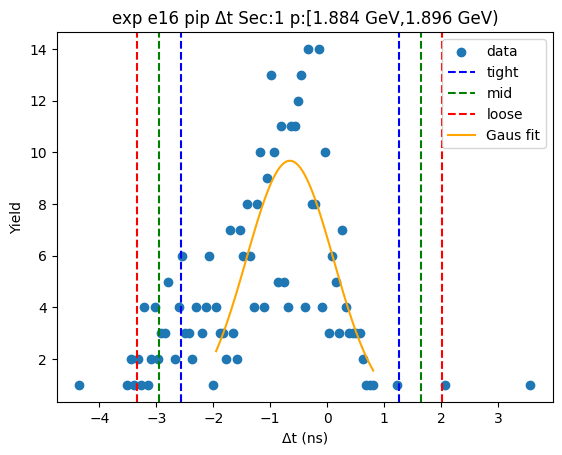

-2.5890416616730954 1.3541976778137443
-2.9833655956217795 1.7485216117624285
-3.377689529570463 2.142845545711112
[ 9.08204649 -0.61742199  0.78864787]


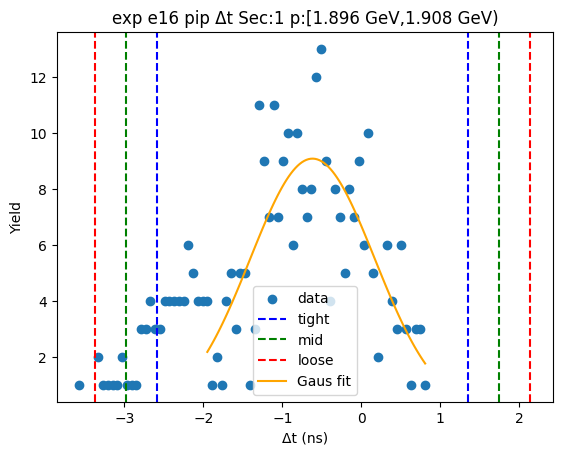

-2.5479274759750385 1.3275335113103217
-2.9354735747035754 1.7150796100388581
-3.3230196734321114 2.102625708767394
[10.4716622  -0.61019698  0.7750922 ]


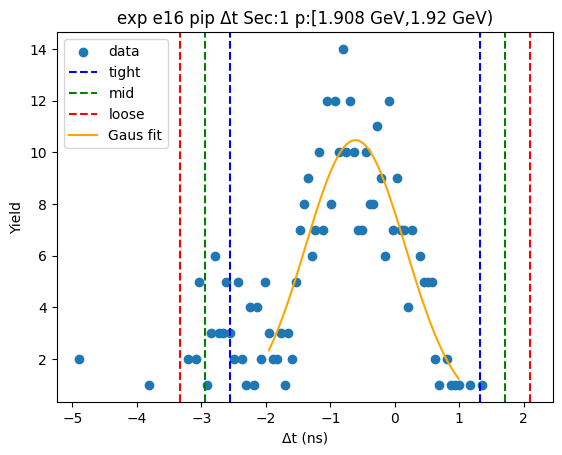

-2.2281606457457177 0.887742630070702
-2.5397509733273598 1.1993329576523437
-2.8513413009090014 1.5109232852339858
[11.02941229 -0.67020901  0.62318066]


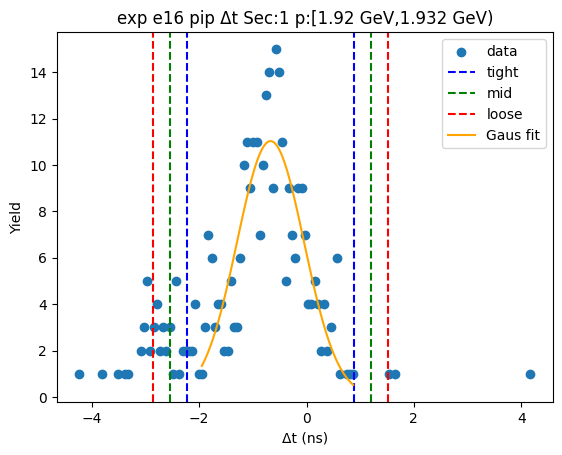

-2.304896779421923 1.1130273391112748
-2.6466891912752426 1.4548197509645946
-2.9884816031285624 1.7966121628179144
[10.45528641 -0.59593472  0.68358482]


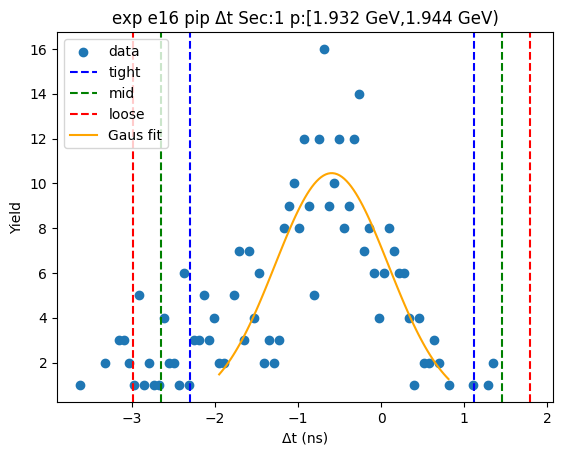

-2.0778783948962576 1.001617275458249
-2.3858279619317084 1.3095668424937
-2.693777528967159 1.6175164095291503
[10.63289864 -0.53813056  0.61589913]


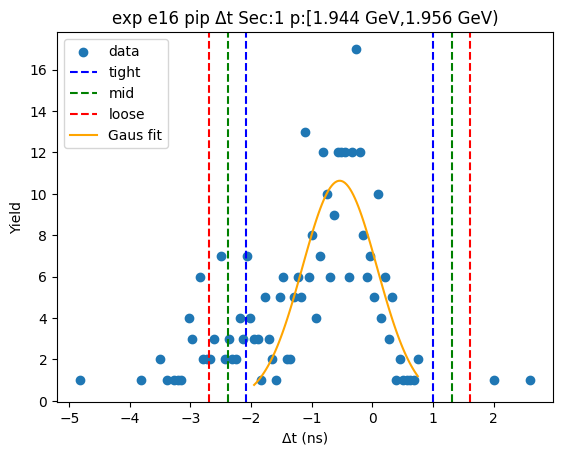

-2.373124106856964 1.1152642927202845
-2.7219629468146884 1.464103132678009
-3.070801786772413 1.8129419726357339
[ 9.0621794  -0.62892991  0.69767768]


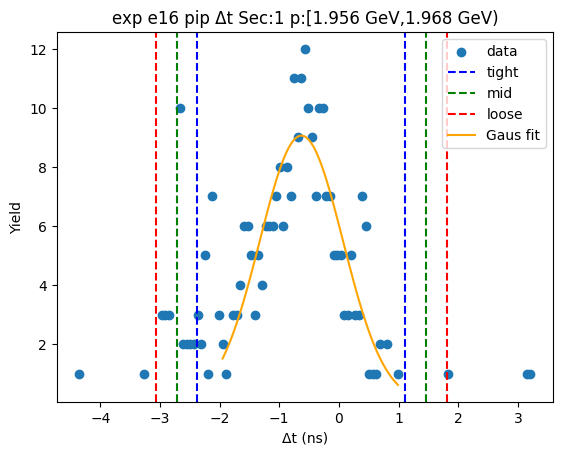

-2.7616770896916916 1.4015959691911912
-3.1780043955799795 1.8179232750794792
-3.594331701468268 2.2342505809677675
[ 8.66470886 -0.68004056  0.83265461]


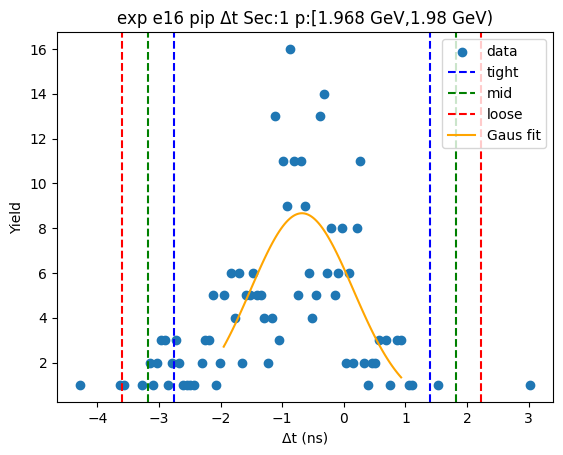

-2.442662465480026 1.324059511592874
-2.8193346631873157 1.7007317093001642
-3.196006860894606 2.0774039070074544
[ 8.58435109 -0.55930148  0.7533444 ]


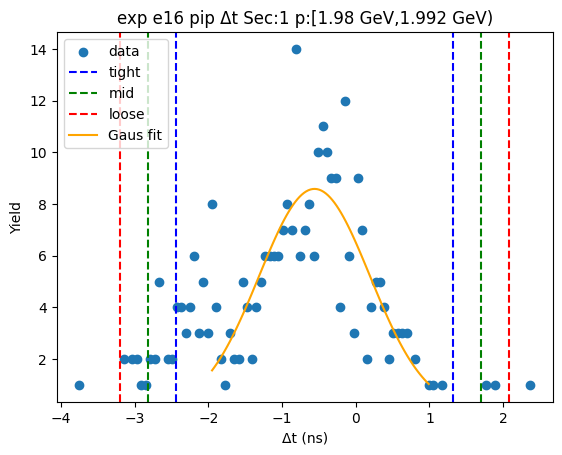

-2.434221840488131 1.1897868486410923
-2.796622709401053 1.5521877175540149
-3.1590235783139757 1.9145885864669374
[ 9.03677351 -0.6222175   0.72480174]


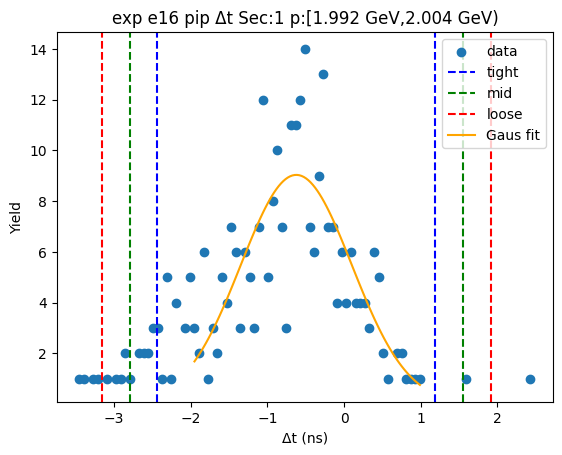

-2.432383900679846 1.258845215104616
-2.8015068122582925 1.6279681266830623
-3.1706297238367385 1.9970910382615084
[ 8.07847684 -0.58676934  0.73824582]


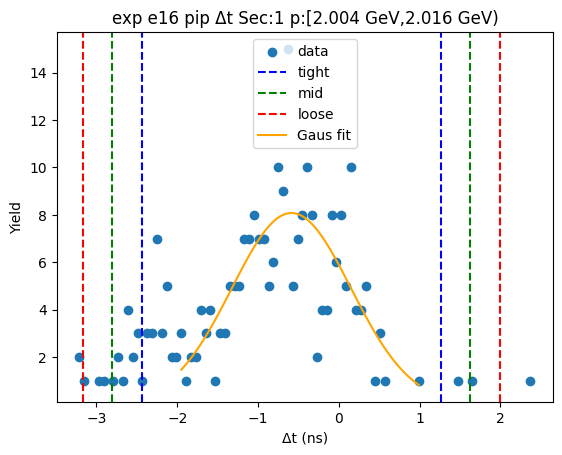

-2.2974237687944874 1.1205063896155805
-2.639216784635494 1.4622994054565877
-2.981009800476501 1.8040924212975944
[ 8.48045845 -0.58845869  0.68358603]


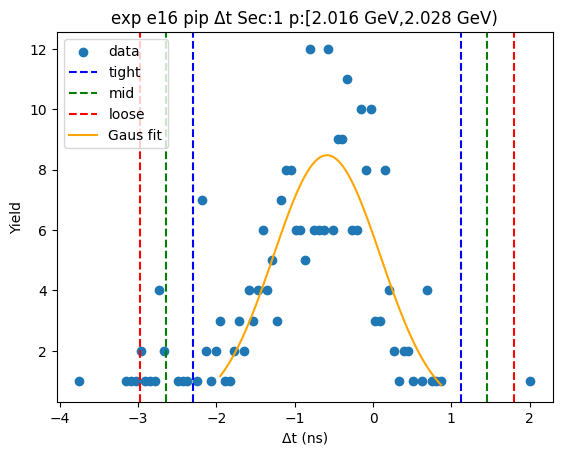

-2.7355586725323953 1.4636387213456725
-3.1554784119202024 1.8835584607334797
-3.575398151308009 2.3034782001212863
[ 8.09835886 -0.63595998  0.83983948]


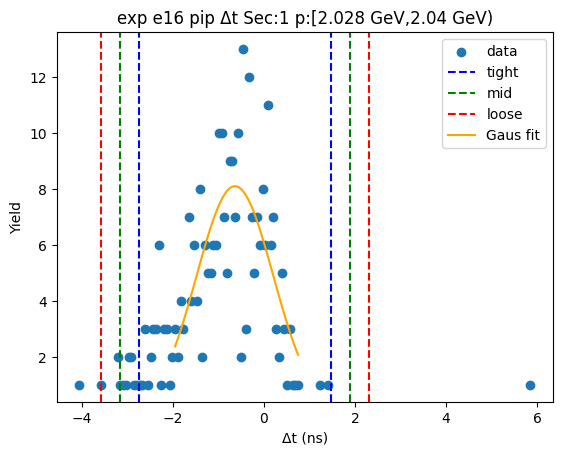

-2.789634685829791 1.359933557811559
-3.204591510193926 1.7748903821756938
-3.6195483345580612 2.189847206539829
[ 7.88883768 -0.71485056  0.82991365]


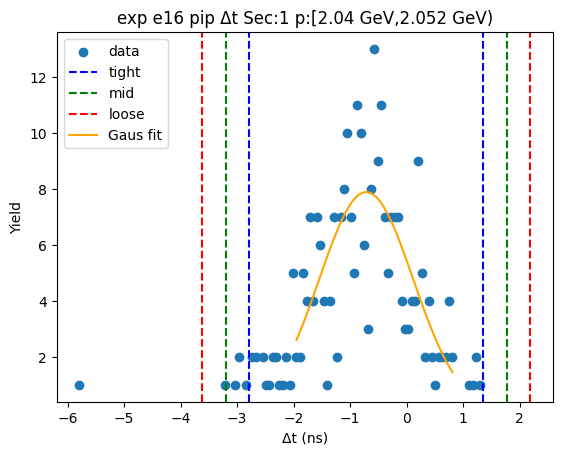

-2.3674560887316667 1.0229360168102377
-2.7064952992858573 1.3619752273644283
-3.0455345098400475 1.7010144379186185
[ 9.05868125 -0.67226004  0.67807842]


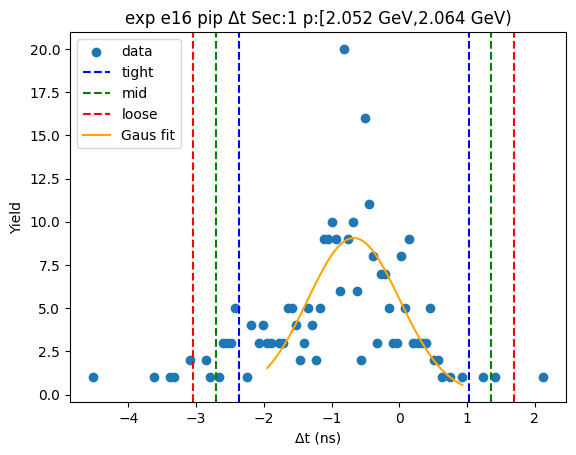

-3.082411761421579 1.6433320789389856
-3.5549861454576357 2.115906462975042
-4.027560529493692 2.5884808470110987
[ 7.0692642  -0.71953984  0.94514877]


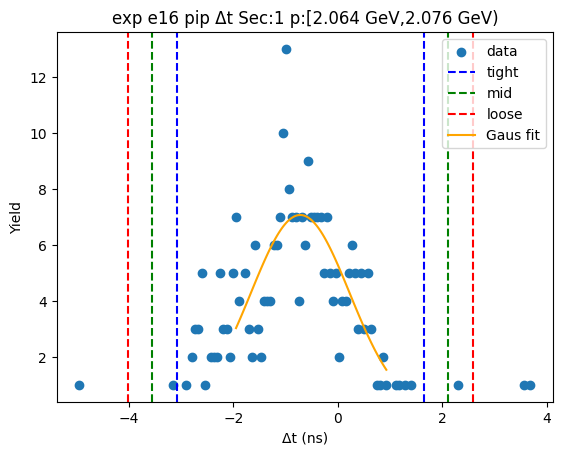

-2.3987875541407258 1.1206164145536925
-2.750727951010168 1.4725568114231342
-3.10266834787961 1.8244972082925763
[ 8.24699121 -0.63908557  0.70388079]


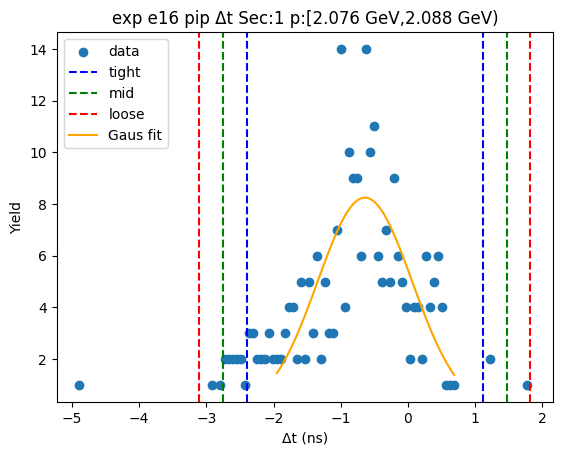

-2.669471784277611 1.8052282619819873
-3.1169417889035707 2.252698266607947
-3.5644117935295307 2.700168271233907
[ 7.17773914 -0.43212176  0.89494001]


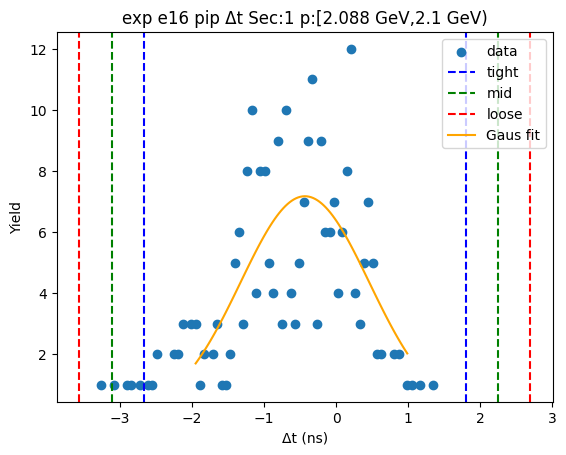

-2.598725979587414 1.4020745559236423
-2.9988060331385196 1.802154609474748
-3.3988860866896244 2.2022346630258536
[ 7.05742508 -0.59832571  0.80016011]


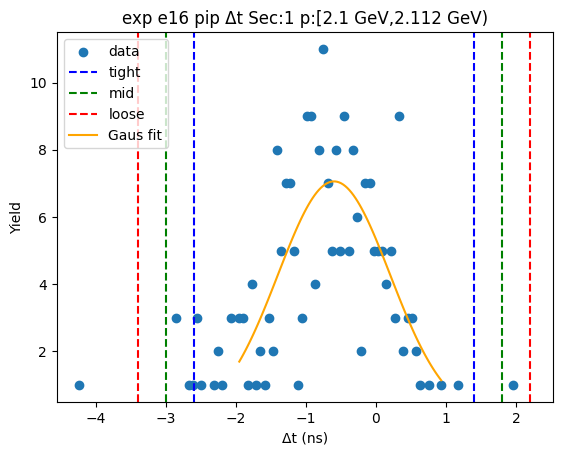

-2.342628133751937 1.3887346400302283
-2.7157644111301535 1.7618709174084448
-3.08890068850837 2.1350071947866613
[ 8.0368434  -0.47694675  0.74627255]


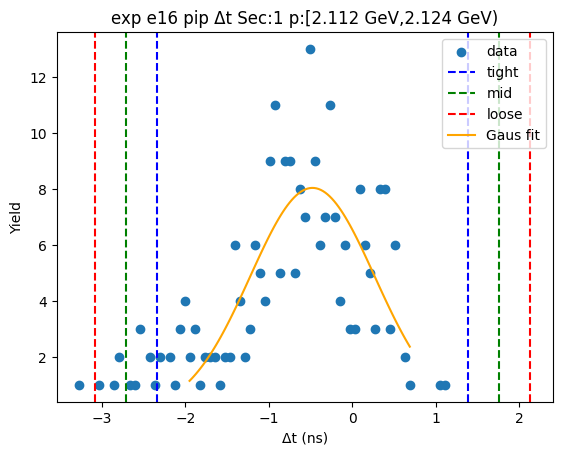

-2.7034744698531235 1.6159902959420114
-3.1354209464326366 2.0479367725215245
-3.56736742301215 2.479883249101038
[ 6.65617484 -0.54374209  0.86389295]


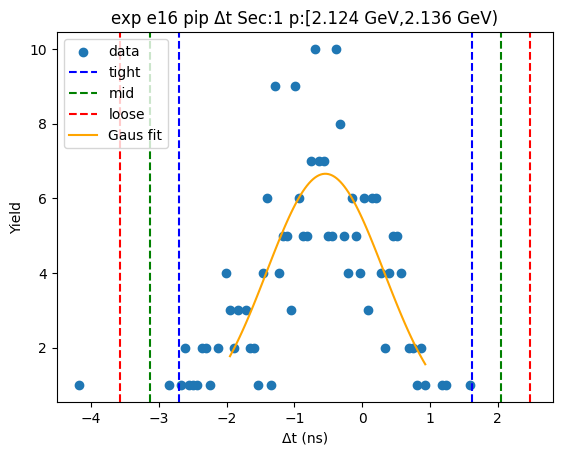

-2.166798723653593 1.1123708856776209
-2.494715684586714 1.4402878466107425
-2.8226326455198354 1.7682048075438637
[ 7.23585792 -0.52721392  0.65583392]


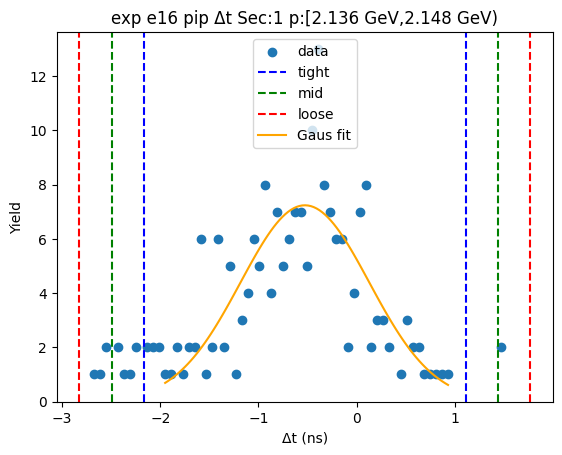

-2.6118509036466806 1.5371081985642876
-3.0267468138677778 1.9520041087853848
-3.4416427240888745 2.3669000190064815
[ 7.0205611  -0.53737135  0.82979182]


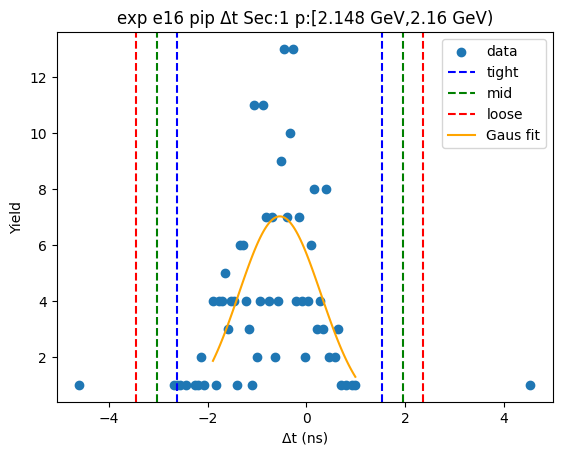

-2.4337525234295567 1.266254206486215
-2.803753196421134 1.636254879477792
-3.173753869412711 2.0062555524693693
[ 7.22693929 -0.58374916  0.74000135]


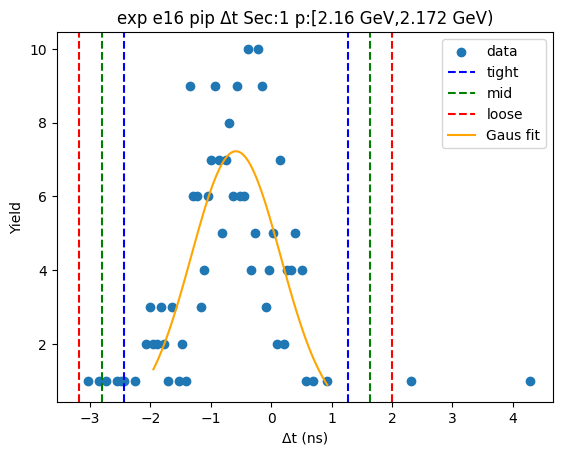

-2.4896048832093096 1.4025649083035794
-2.8788218623605983 1.791781887454868
-3.2680388415118875 2.1809988666061573
[ 7.03501868 -0.54351999  0.77843396]


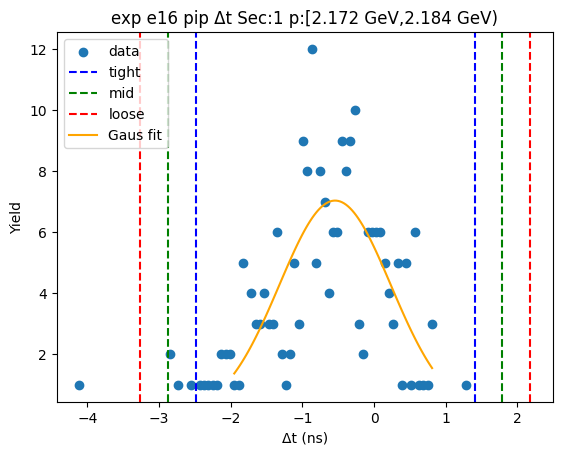

-2.2799783906297852 0.991068827829406
-2.607083112475704 1.318173549675325
-2.934187834321623 1.645278271521244
[ 7.44370397 -0.64445478  0.65420944]


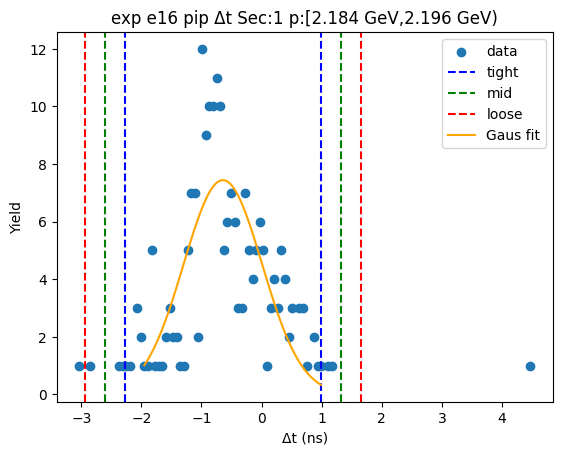

-1.6637256857318152 1.809921619479117
-2.011090416252909 2.15728635000021
-2.358455146774002 2.5046510805213034
[11.43326097  0.07309797  0.69472946]


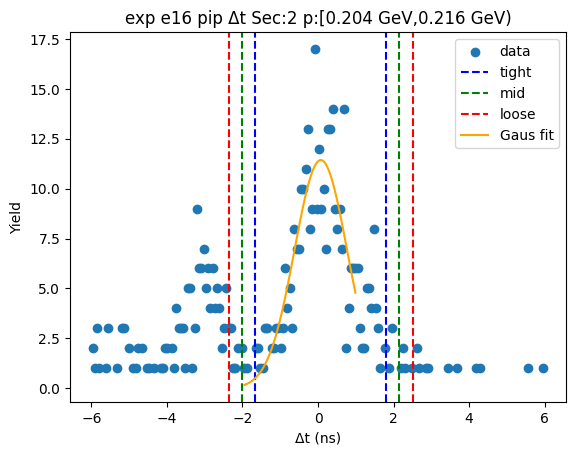

-1.5374815092919216 1.6015164728791125
-1.8513813075090249 1.9154162710962157
-2.1652811057261285 2.2293160693133194
[22.84880023  0.03201748  0.6277996 ]


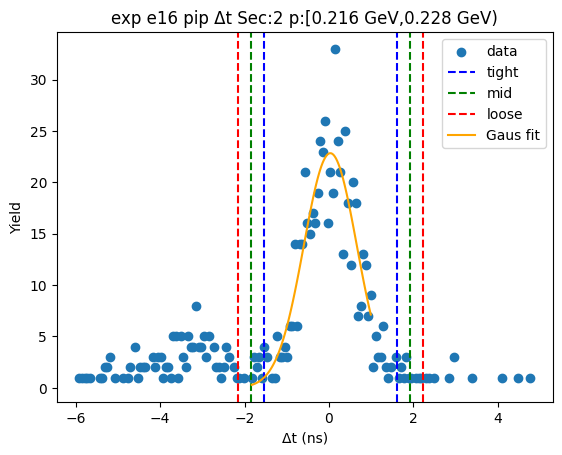

-1.281752177943999 1.4925834471399848
-1.5591857404523977 1.7700170096483834
-1.836619302960796 2.0474505721567815
[37.07994635  0.10541563  0.55486713]


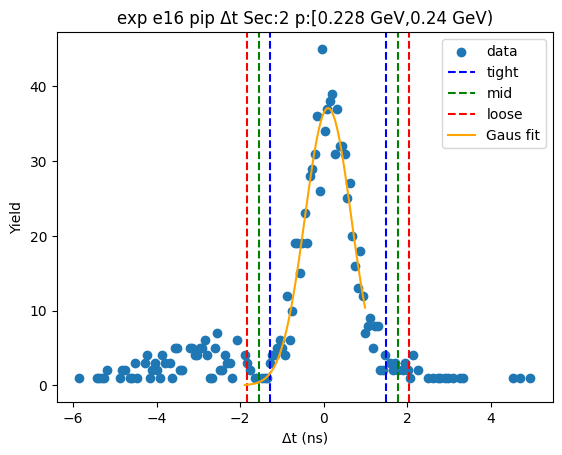

-1.2823390709494986 1.5270019116152111
-1.5632731692059696 1.8079360098716821
-1.8442072674624406 2.088870108128153
[46.60596089  0.12233142  0.5618682 ]


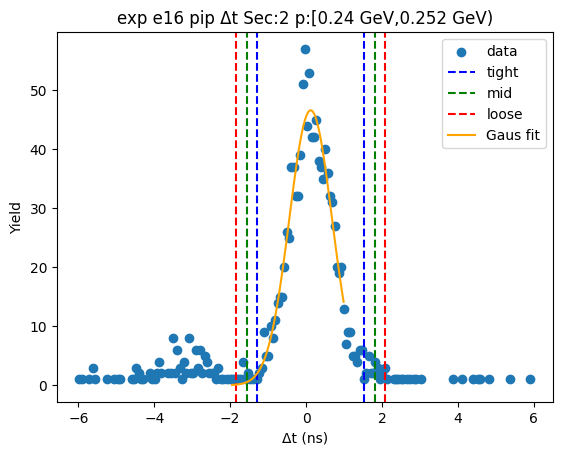

-1.3324677470578985 1.4322084280603984
-1.6089353645697282 1.708676045572228
-1.8854029820815579 1.9851436630840578
[6.33982457e+01 4.98703405e-02 5.52935235e-01]


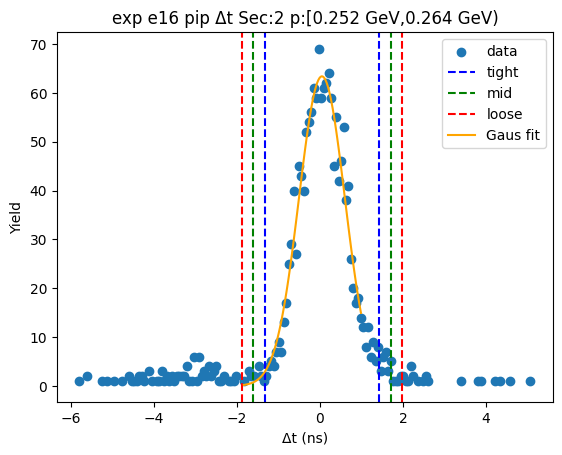

-1.3117706714981185 1.3501212702903418
-1.5779598656769644 1.6163104644691877
-1.8441490598558103 1.8824996586480336
[7.84555780e+01 1.91752994e-02 5.32378388e-01]


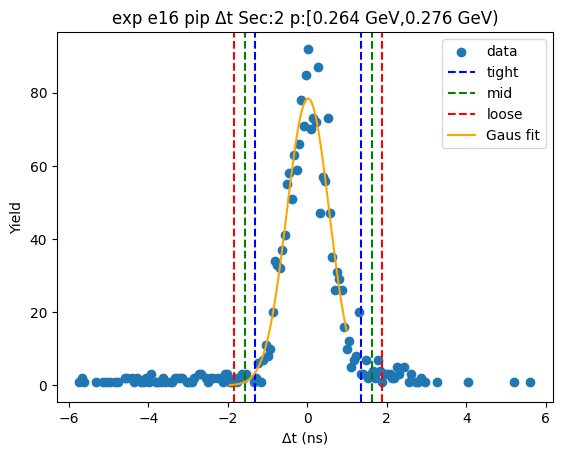

-1.3612617592023062 1.2201330081681538
-1.6194012359393524 1.4782724849052
-1.8775407126763983 1.736411961642246
[ 8.33843656e+01 -7.05643755e-02  5.16278953e-01]


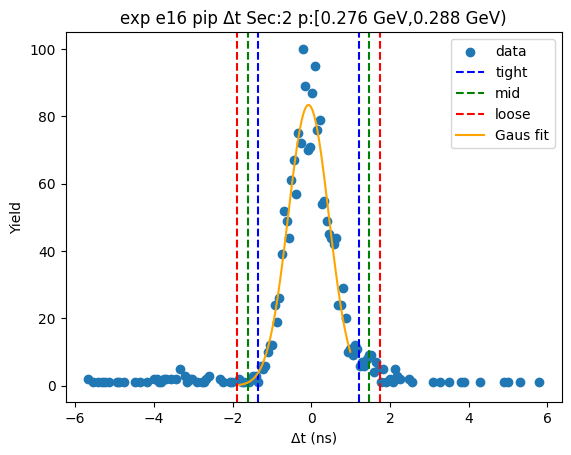

-1.2243513361279192 1.128843063404203
-1.4596707760811316 1.3641625033574154
-1.694990216034344 1.5994819433106278
[ 9.68313000e+01 -4.77541364e-02  4.70638880e-01]


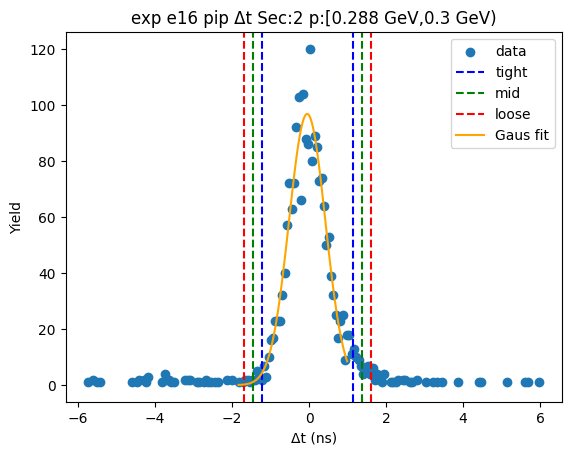

-1.3467324635633287 1.1306027424850107
-1.5944659841681628 1.3783362630898448
-1.8421995047729967 1.6260697836946787
[100.45808261  -0.10806486   0.49546704]


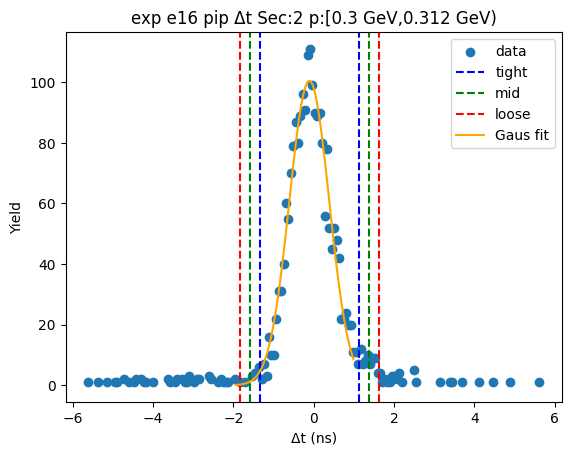

-1.2969882721974992 1.1546773487820097
-1.5421548342954503 1.3998439108799607
-1.7873213963934012 1.6450104729779116
[ 1.05086763e+02 -7.11554617e-02  4.90333124e-01]


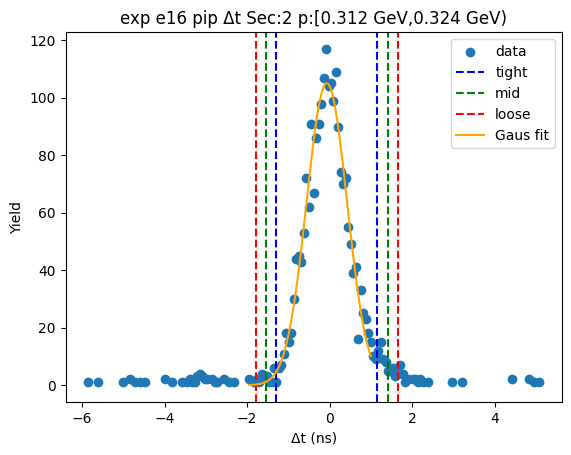

-1.3099393962309078 1.0908533621991705
-1.5500186720739157 1.3309326380421784
-1.7900979479169234 1.5710119138851861
[ 1.14614140e+02 -1.09543017e-01  4.80158552e-01]


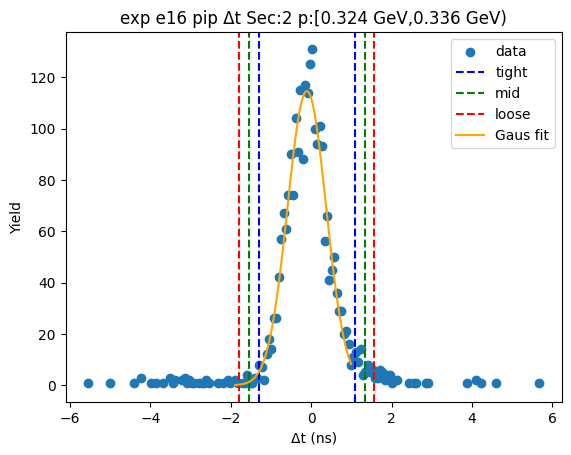

-1.2711176471411219 1.0464986471264712
-1.5028792765678811 1.2782602765532305
-1.7346409059946404 1.5100219059799898
[ 1.17130522e+02 -1.12309500e-01  4.63523259e-01]


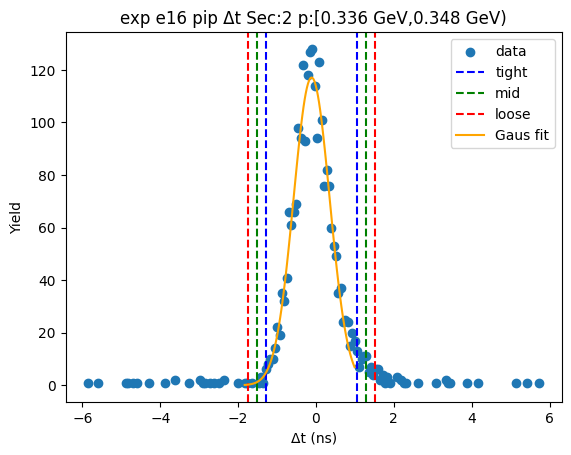

-1.2629157821793435 1.044236614241354
-1.4936310218214133 1.2749518538834237
-1.724346261463483 1.5056670935254934
[ 1.25092468e+02 -1.09339584e-01  4.61430479e-01]


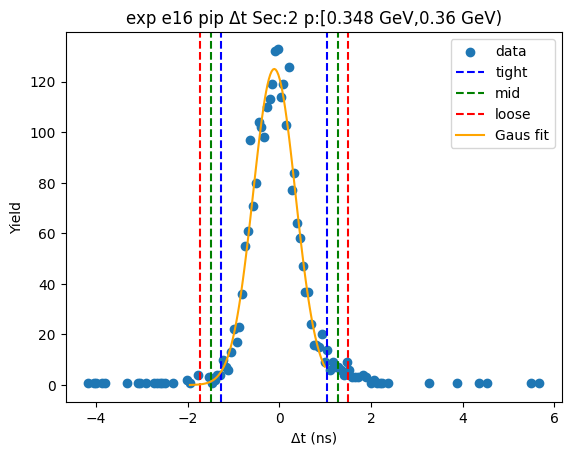

-1.2984364974880442 1.0711748375597616
-1.5353976309928248 1.3081359710645422
-1.7723587644976053 1.5450971045693227
[ 1.22809536e+02 -1.13630830e-01  4.73922267e-01]


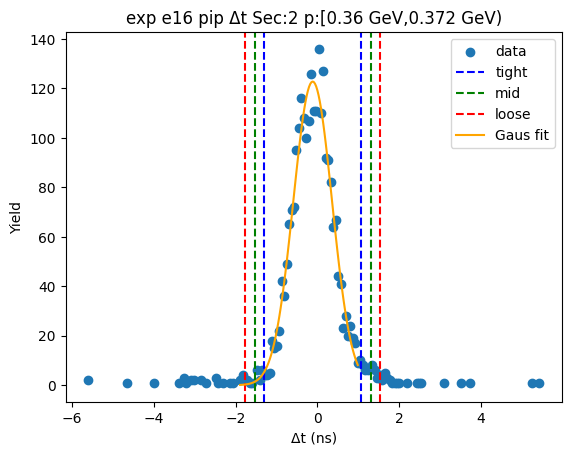

-1.2556815602125393 0.9887679850386533
-1.4801265147376585 1.2132129395637725
-1.7045714692627778 1.4376578940888918
[127.12749144  -0.13345679   0.44888991]


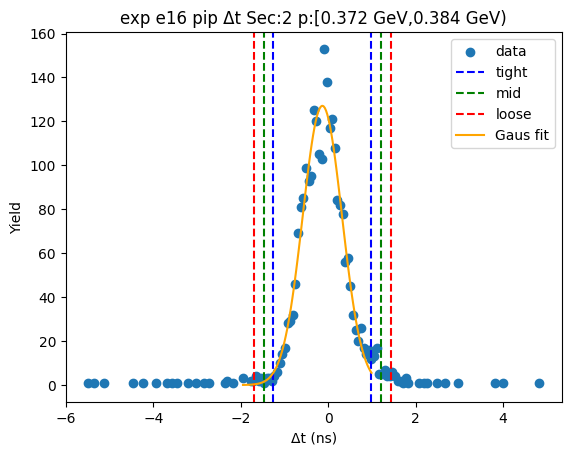

-1.2860130408059933 0.998699153786888
-1.5144842602652813 1.2271703732461758
-1.7429554797245692 1.4556415927054642
[135.49935703  -0.14365694   0.45694244]


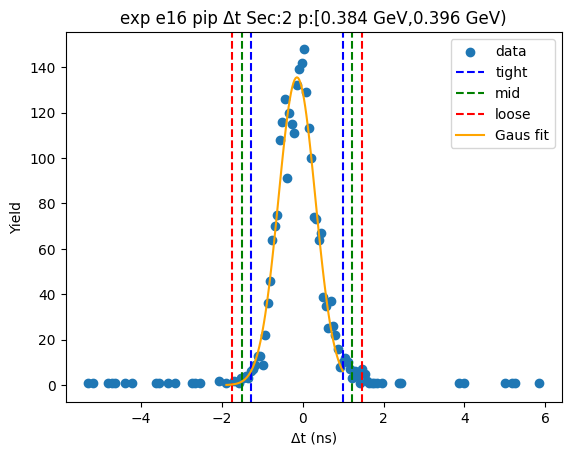

-1.223129803048244 0.9793109338705045
-1.4433738767401187 1.199555007562379
-1.6636179504319935 1.4197990812542538
[ 1.33648569e+02 -1.21909435e-01  4.40488147e-01]


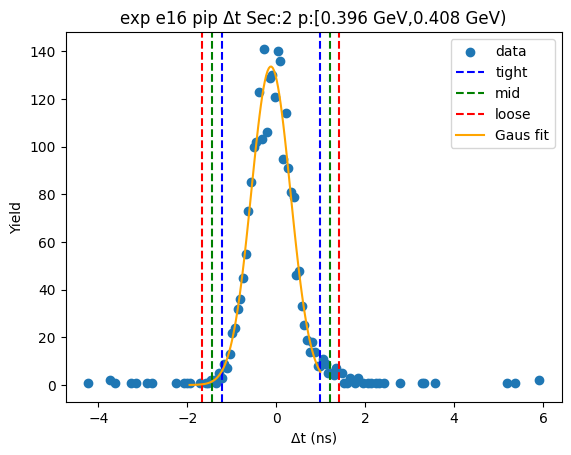

-1.3290577133175032 0.9781102396952852
-1.559774508618782 1.208827034996564
-1.790491303920061 1.439543830297843
[135.02979661  -0.17547374   0.46143359]


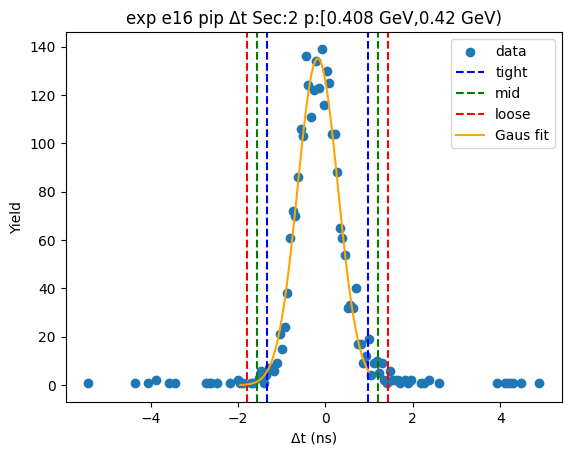

-1.3314407972747062 0.9499918787125627
-1.5595840648734332 1.1781351463112897
-1.78772733247216 1.4062784139100166
[131.75510297  -0.19072446   0.45628654]


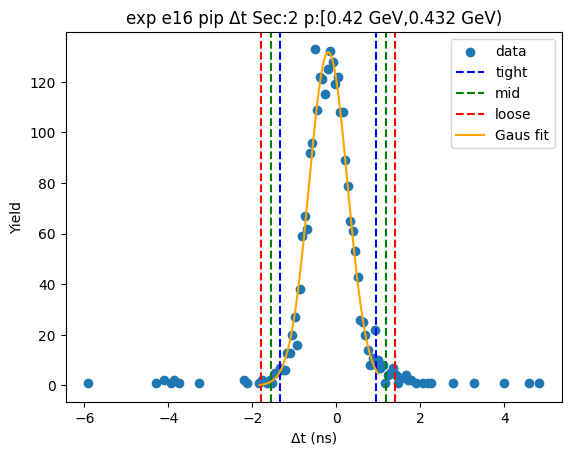

-1.3837271607739652 0.9129847523156438
-1.613398352082926 1.1426559436246047
-1.8430695433918869 1.3723271349335655
[131.85886607  -0.2353712    0.45934238]


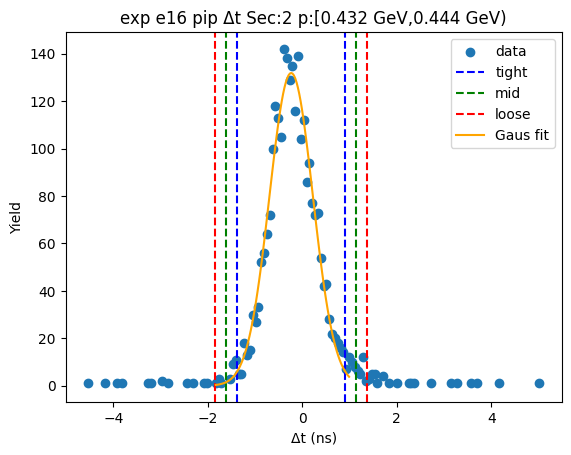

-1.4417214541746657 0.9092736956971855
-1.676820969161851 1.1443732106843707
-1.9119204841490358 1.379472725671556
[137.57649648  -0.26622388   0.47019903]


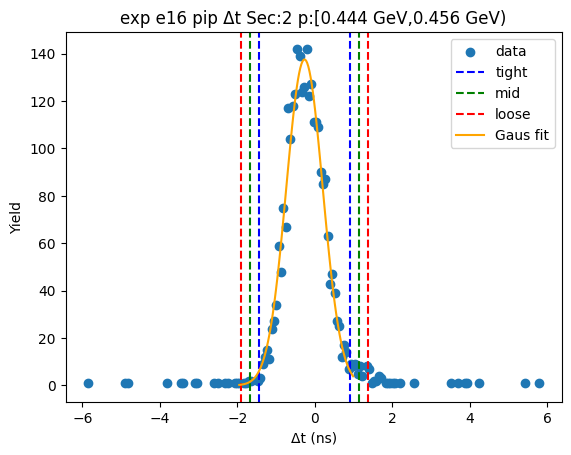

-1.421346225754064 0.9023990038011105
-1.6537207487095817 1.1347735267566281
-1.8860952716650992 1.3671480497121455
[132.59703967  -0.25947361   0.46474905]


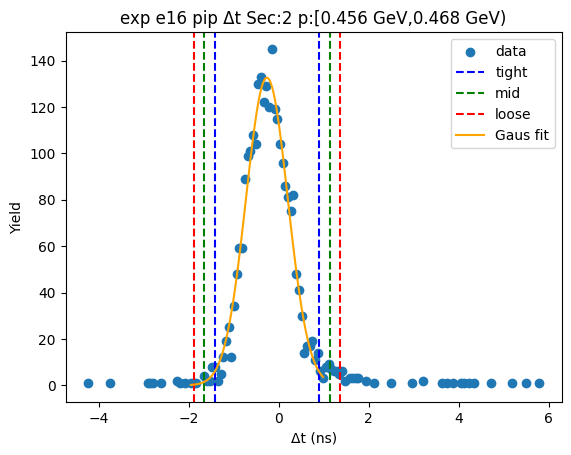

-1.4319906752063574 0.9338642859561409
-1.6685761713226073 1.1704497820723907
-1.905161667438857 1.4070352781886404
[127.98221431  -0.24906319   0.47317099]


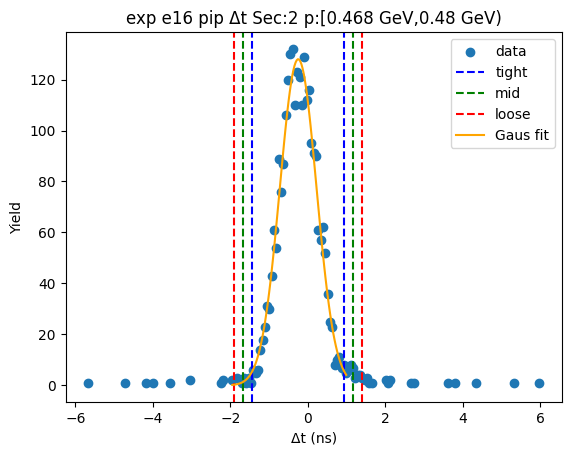

-1.4537939247559066 0.8551278430070122
-1.6846861015321986 1.086020019783304
-1.9155782783084905 1.316912196559596
[130.8847033   -0.29933304   0.46178435]


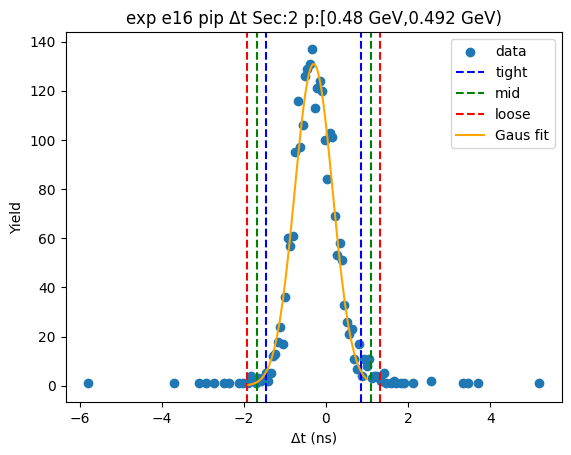

-1.4414436826182757 0.8415396812857243
-1.6697420190086756 1.0698380176761242
-1.8980403553990755 1.298136354066524
[129.51976854  -0.299952     0.45659667]


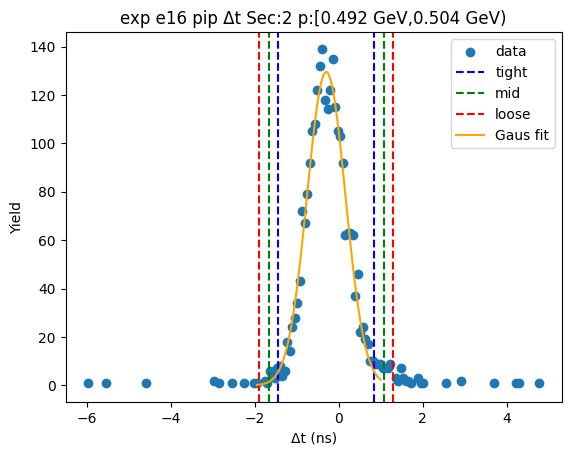

-1.4266412207618524 0.835212904516863
-1.6528266332897241 1.0613983170447348
-1.8790120458175956 1.2875837295726063
[129.12389824  -0.29571416   0.45237083]


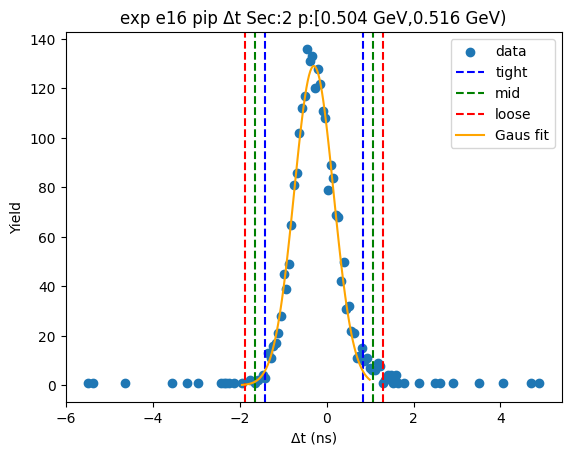

-1.4525131839798966 0.8191464113683764
-1.6796791435147238 1.0463123709032036
-1.9068451030495512 1.273478330438031
[131.6650396   -0.31668339   0.45433192]


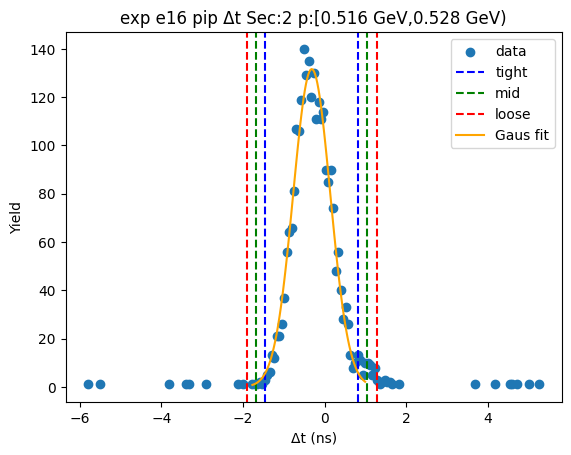

-1.4837524825847548 0.858889905010511
-1.7180167213442812 1.0931541437700374
-1.9522809601038078 1.327418382529564
[120.37693298  -0.31243129   0.46852848]


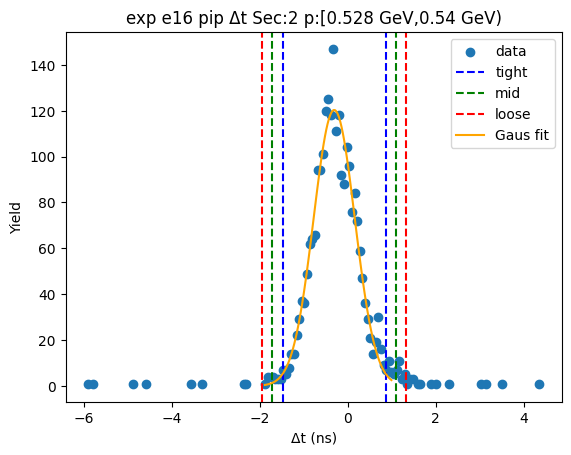

-1.406210962687436 0.8303932525036652
-1.629871384206546 1.0540536740227753
-1.8535318057256562 1.2777140955418855
[125.53904269  -0.28790886   0.44732084]


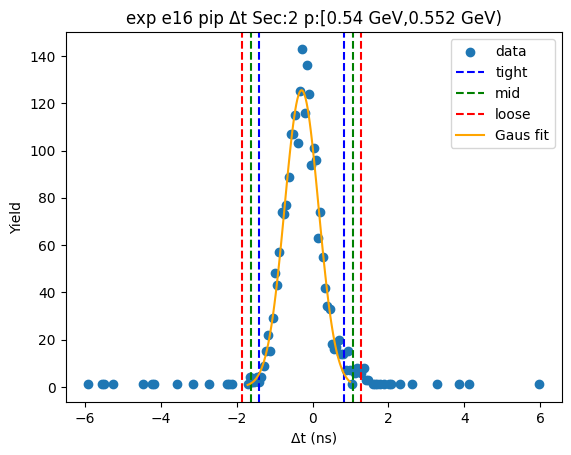

-1.457812003676482 0.8592647536879707
-1.6895196794129272 1.090972429424416
-1.9212273551493724 1.3226801051608612
[121.22065535  -0.29927362   0.46341535]


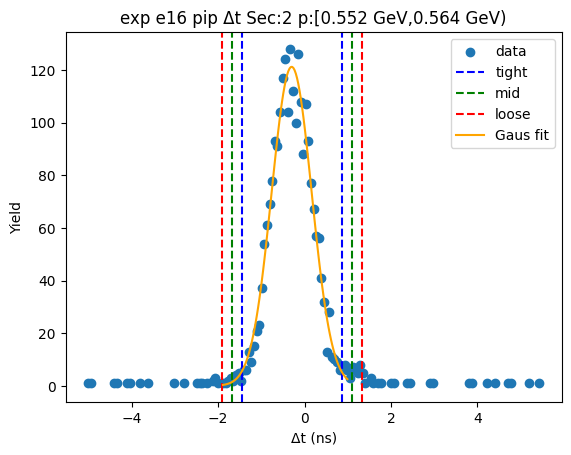

-1.5044455898422013 0.8574490645937187
-1.7406350552857934 1.0936385300373108
-1.9768245207293853 1.3298279954809027
[118.33180728  -0.32349826   0.47237893]


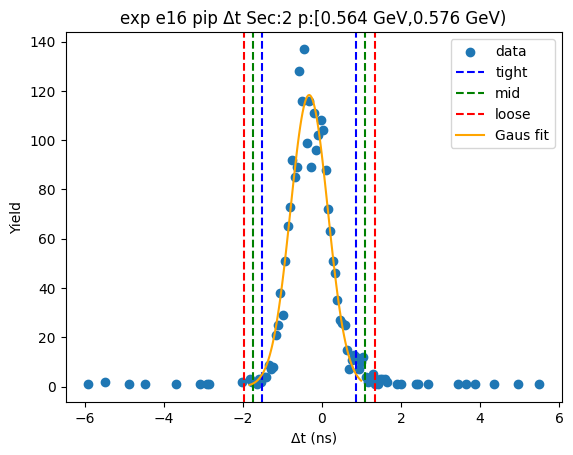

-1.4752047270686526 0.8265769341122341
-1.7053828931867412 1.0567551002303226
-1.9355610593048298 1.2869332663484112
[117.19935361  -0.3243139    0.46035633]


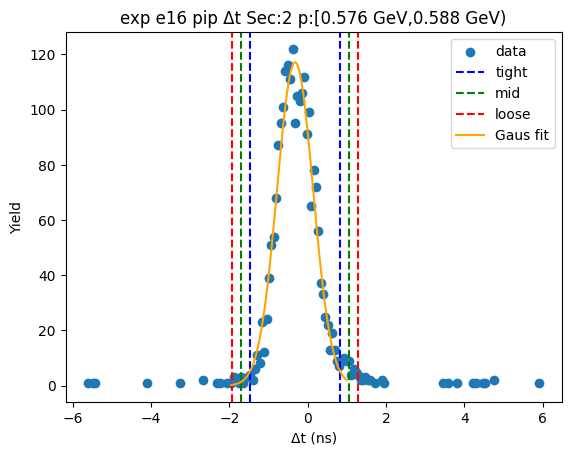

-1.61675262371732 0.9248953022193495
-1.8709174163109865 1.1790600948130163
-2.1250822089046535 1.4332248874066833
[105.60910791  -0.34592866   0.50832959]


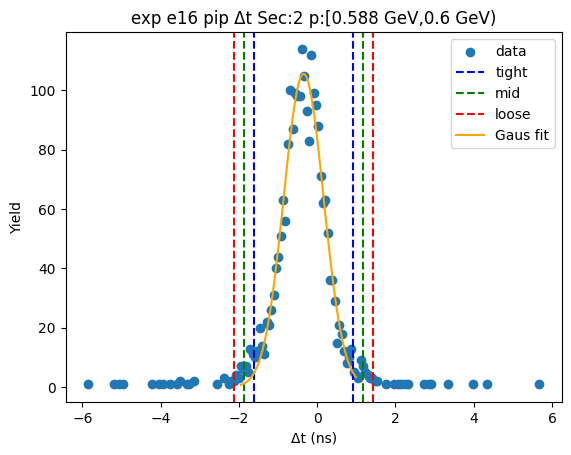

-1.9491613918737598 1.0487493193102666
-2.2489524629921624 1.3485403904286692
-2.548743534110565 1.6483314615470719
[88.08603982 -0.45020604  0.59958214]


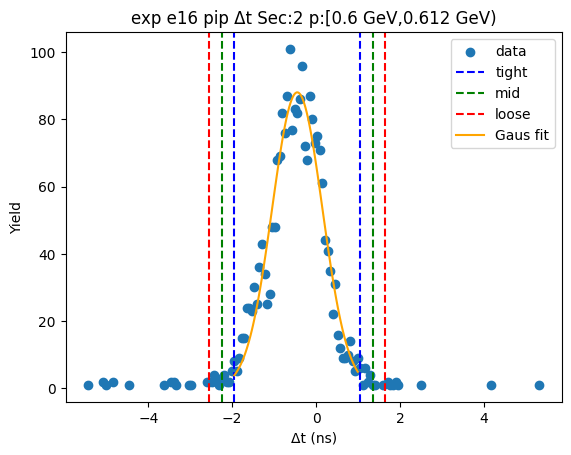

-2.1855704815809474 1.1443460904310347
-2.518562138782146 1.477337747632233
-2.851553795983344 1.810329404833431
[74.49571396 -0.5206122   0.66598331]


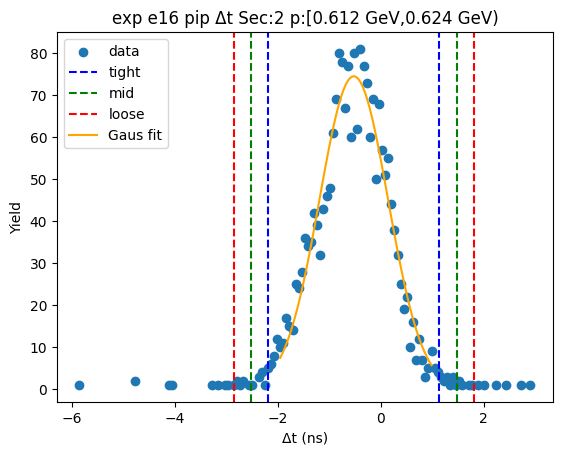

-2.14422259390871 1.0653053972445554
-2.4651753930240363 1.3862581963598823
-2.786128192139363 1.7072109954752088
[79.15915923 -0.5394586   0.6419056 ]


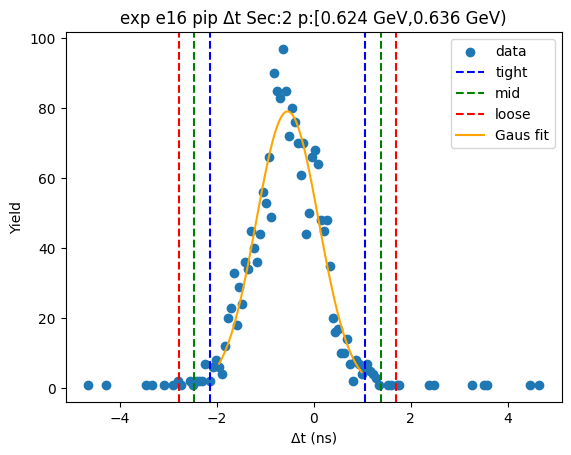

-2.1982048754993917 1.1547755206518349
-2.5335029151145143 1.4900735602669577
-2.868800954729637 1.8253715998820803
[71.13306686 -0.52171468  0.67059608]


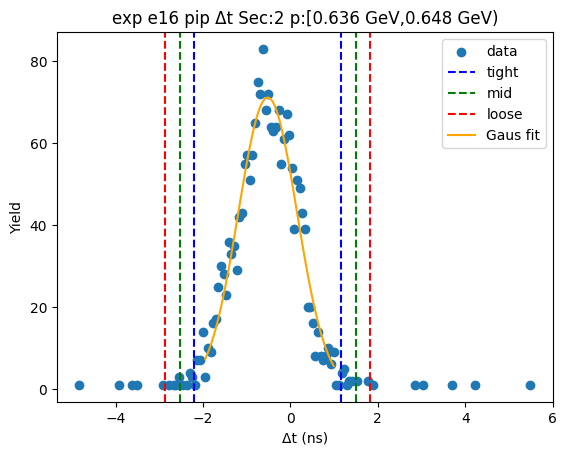

-2.04442972171779 1.0608690243084404
-2.354959596320413 1.3713988989110635
-2.665489470923036 1.6819287735136865
[69.97246516 -0.49178035  0.62105975]


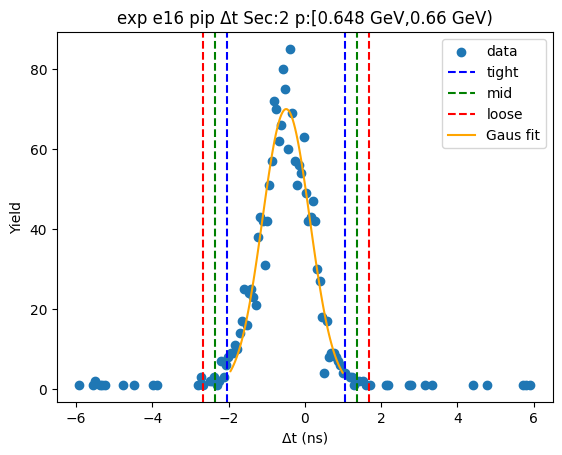

-1.9033933568828425 1.0626167629728889
-2.199994368868416 1.3592177749584622
-2.4965953808539885 1.655818786944035
[67.51635853 -0.4203883   0.59320202]


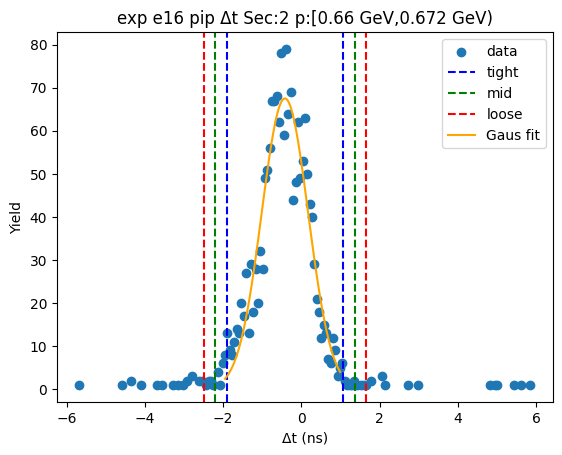

-1.7122517752576565 0.9269534123319051
-1.9761722940166129 1.1908739310908611
-2.240092812775569 1.4547944498498175
[79.98077642 -0.39264918  0.52784104]


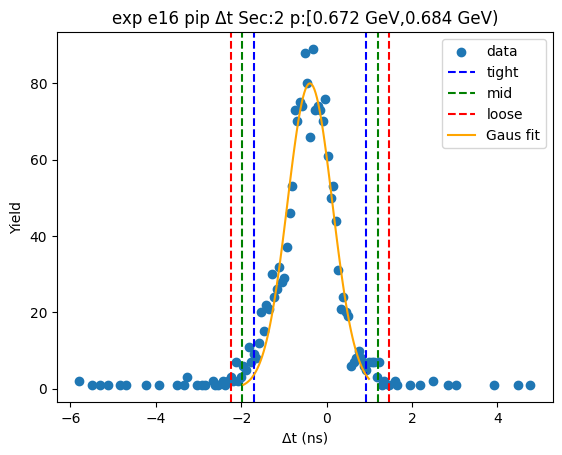

-1.7447929524665065 1.0064626535115737
-2.0199185130643147 1.2815882141093815
-2.2950440736621225 1.5567137747071897
[79.60448398 -0.36916515  0.55025112]


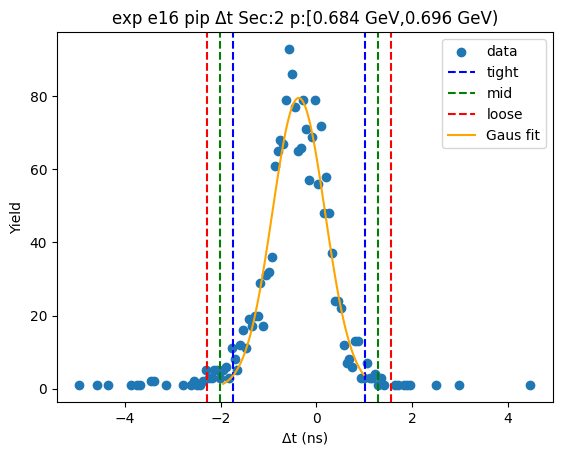

-1.6991812339381371 0.9488645399876967
-1.9639858113307207 1.2136691173802803
-2.2287903887233043 1.4784736947728636
[79.44313108 -0.37515835  0.52960915]


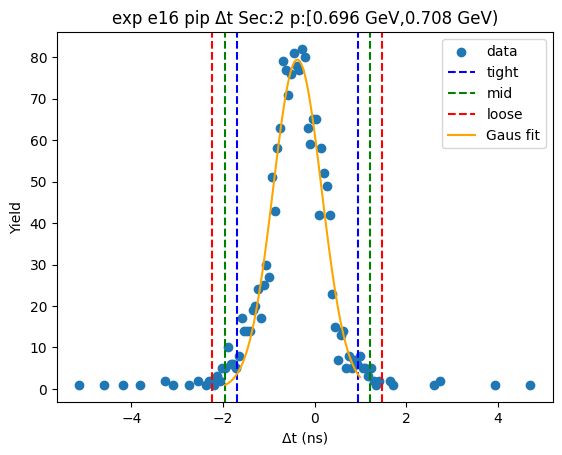

-1.7025364205454072 0.9890721640934363
-1.9716972790092917 1.2582330225573208
-2.240858137473176 1.5273938810212053
[76.43482486 -0.35673213  0.53832172]


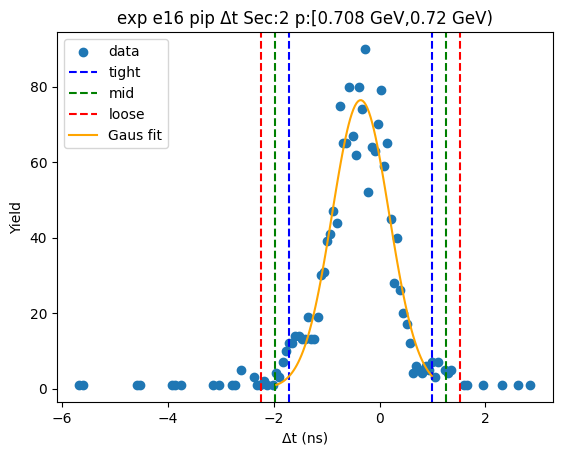

-1.6874734811963354 0.9194798190921555
-1.9481688112251847 1.1801751491210046
-2.2088641412540335 1.4408704791498539
[79.52862607 -0.38399683  0.52139066]


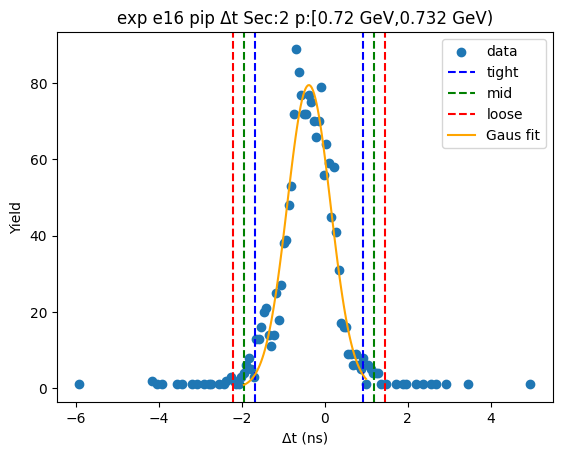

-1.71167607524301 0.9317887135768064
-1.9760225541249918 1.1961351924587882
-2.2403690330069734 1.4604816713407698
[77.62742798 -0.38994368  0.52869296]


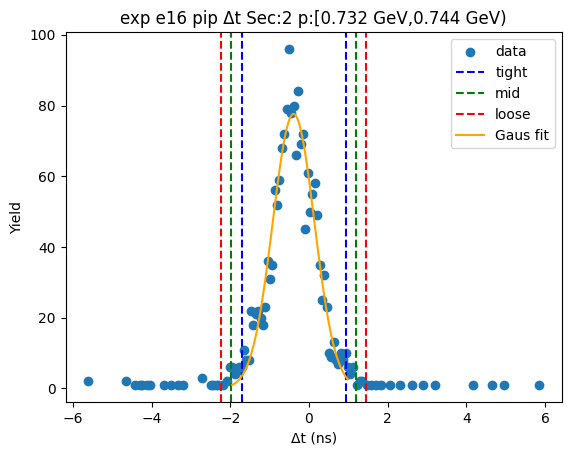

-1.8760051294148665 1.0032385528687424
-2.1639294976432275 1.2911629210971032
-2.451853865871588 1.579087289325464
[71.54308009 -0.43638329  0.57584874]


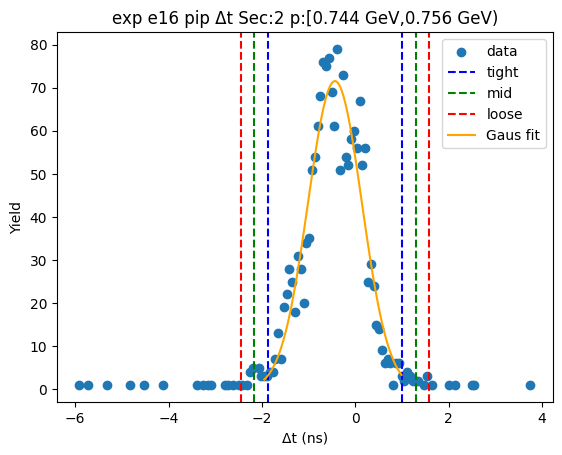

-1.9713451464982774 1.0004338761254403
-2.2685230487606494 1.2976117783878123
-2.565700951023021 1.5947896806501838
[65.66206782 -0.48545564  0.5943558 ]


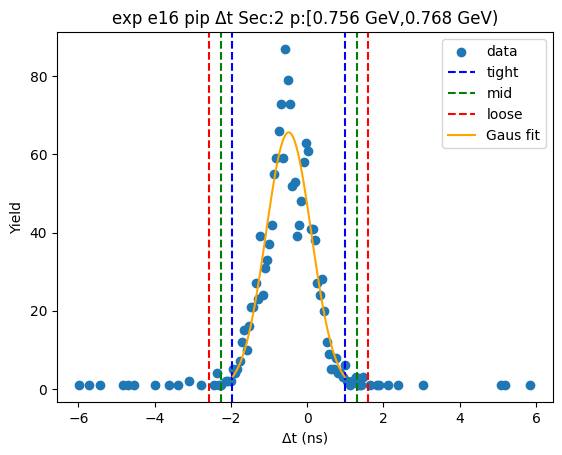

-1.9831230463985472 1.009785240707441
-2.2824138751091456 1.3090760694180397
-2.5817047038197445 1.6083668981286385
[63.85196334 -0.4866689   0.59858166]


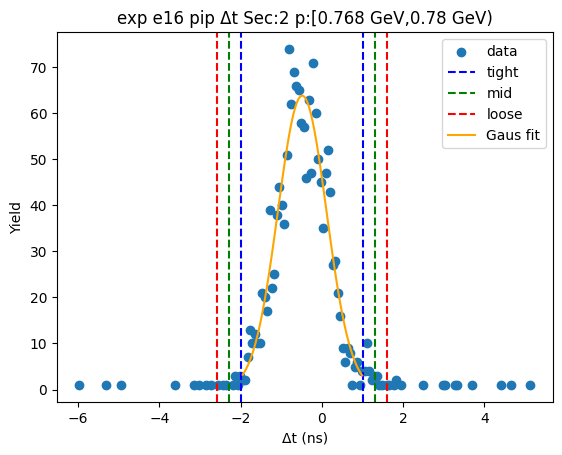

-1.983637018978027 1.0475755018383062
-2.2867582710596603 1.3506967539199395
-2.5898795231412937 1.6538180060015728
[60.50222084 -0.46803076  0.6062425 ]


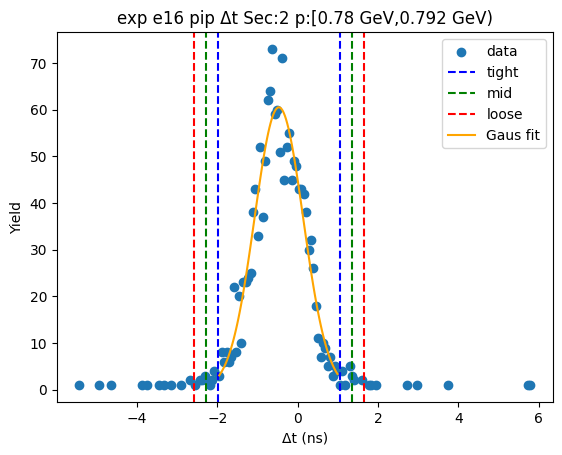

-1.981974054953951 1.0853590222191694
-2.2887073626712633 1.3920923299364816
-2.5954406703885753 1.6988256376537936
[60.59969791 -0.44830752  0.61346662]


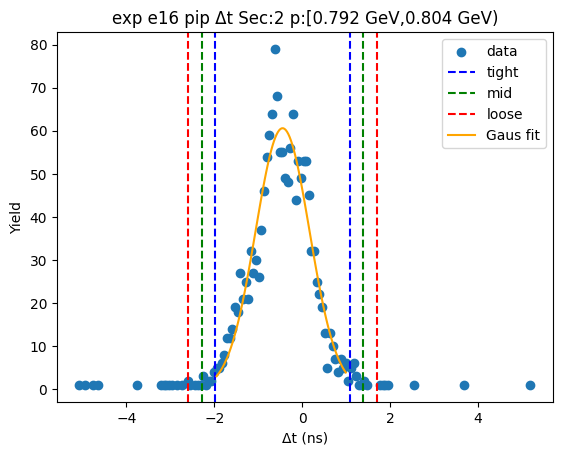

-1.884173062929172 1.0430022933411183
-2.176890598556201 1.3357198289681471
-2.46960813418323 1.6284373645951762
[61.30016895 -0.42058538  0.58543507]


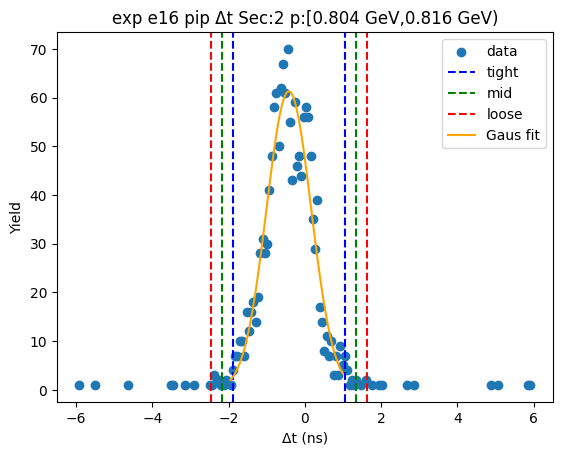

-1.8286298713561657 1.0373094756605798
-2.1152238060578403 1.3239034103622542
-2.401817740759515 1.6104973450639288
[59.39331174 -0.3956602   0.57318787]


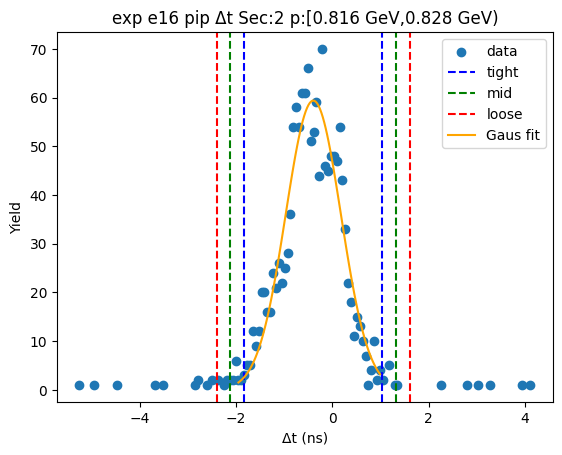

-1.7890772713104166 1.0439601160518004
-2.072381010046638 1.3272638547880222
-2.3556847487828603 1.610567593524244
[60.20992938 -0.37255858  0.56660748]


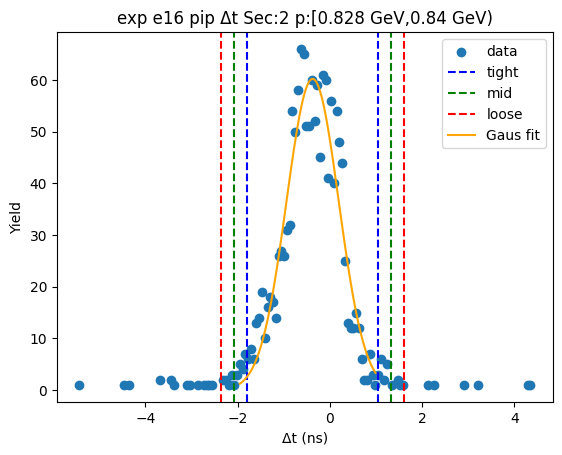

-1.8577912183186944 1.0195897996329633
-2.1455293201138605 1.3073279014281292
-2.4332674219090262 1.595066003223295
[59.63433915 -0.41910071  0.5754762 ]


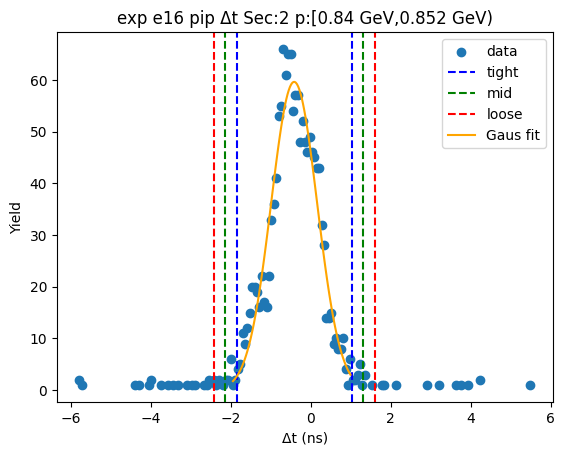

-1.8015533607318042 1.0555538126175326
-2.0872640780667377 1.3412645299524664
-2.3729747954016718 1.6269752472874002
[57.82991328 -0.37299977  0.57142143]


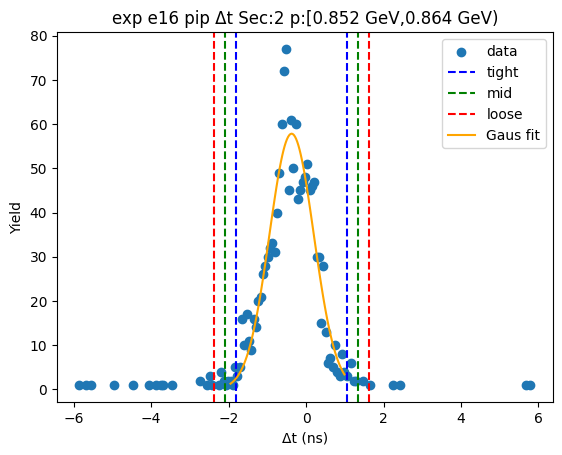

-1.7134781533827705 0.9495148201201717
-1.9797774507330648 1.215814117470466
-2.2460767480833588 1.4821134148207602
[59.3075529  -0.38198167  0.53259859]


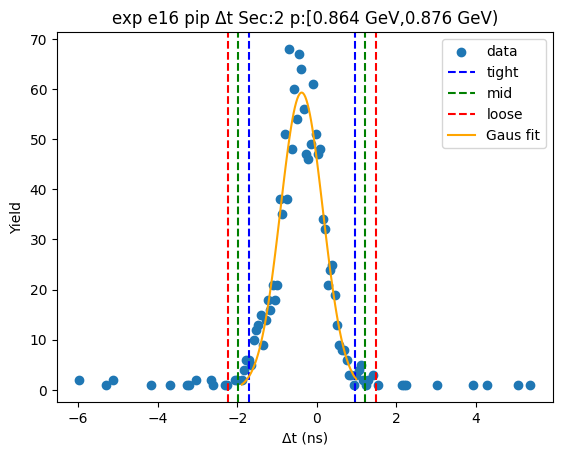

-1.7592300047807319 1.0705937396090217
-2.042212379219707 1.353576114047997
-2.3251947536586823 1.6365584884869722
[53.47149589 -0.34431813  0.56596475]


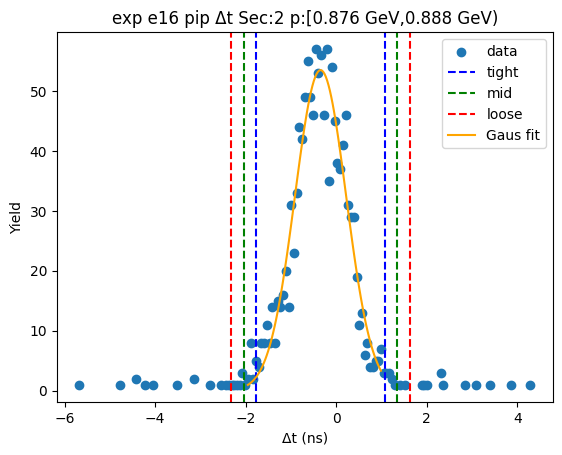

-1.7430313428726063 1.0571832346915897
-2.023052800629026 1.3372046924480094
-2.3030742583854455 1.6172261502044292
[53.70363763 -0.34292405  0.56004292]


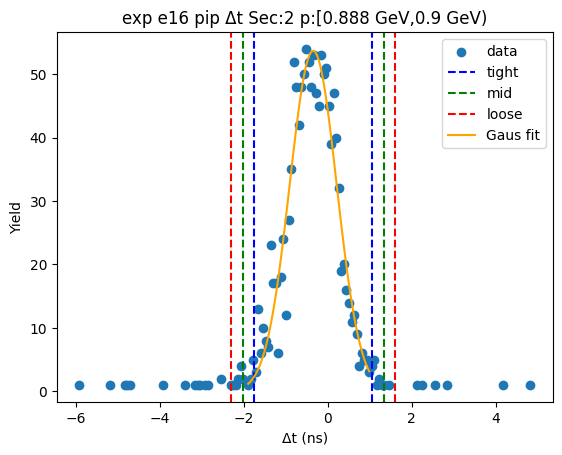

-1.6645885446611888 0.9901639817434861
-1.930063797301656 1.2556392343839535
-2.1955390499421235 1.5211144870244206
[54.25875677 -0.33721228  0.53095051]


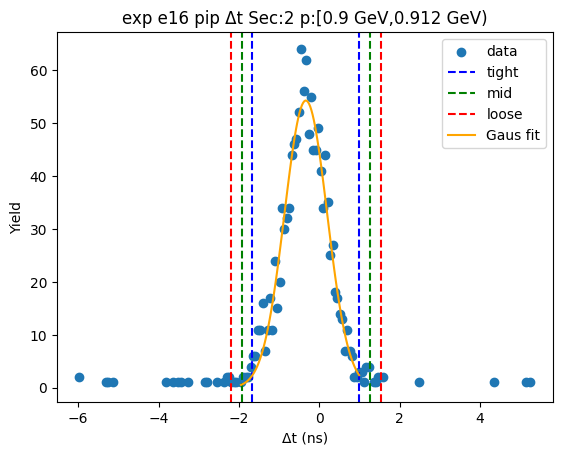

-1.7563545049532479 1.1256340833323064
-2.0445533637818034 1.413832942160862
-2.3327522226103587 1.7020318009894175
[49.53665062 -0.31536021  0.57639772]


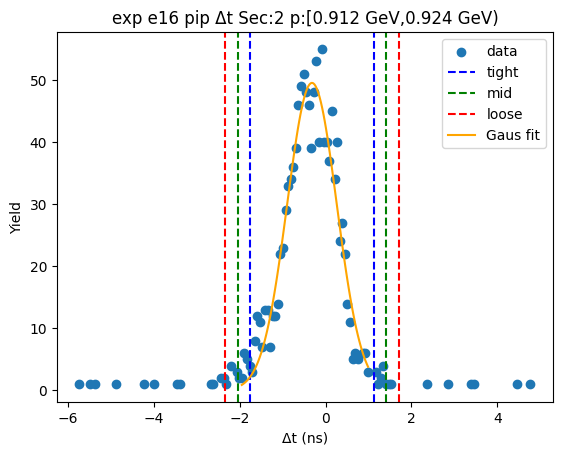

-1.6417407160143502 1.0140571095372855
-1.9073204985695138 1.279636892092449
-2.1729002811246776 1.5452166746476126
[55.04191917 -0.3138418   0.53115957]


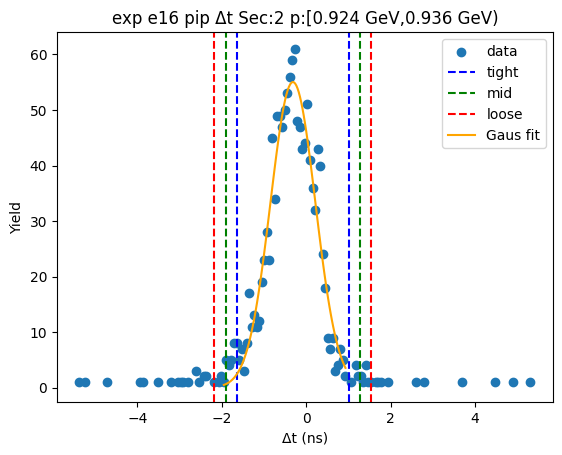

-1.7688898701795979 1.0864817727074816
-2.054427034468306 1.3720189369961897
-2.3399641987570137 1.6575561012848976
[49.00109314 -0.34120405  0.57107433]


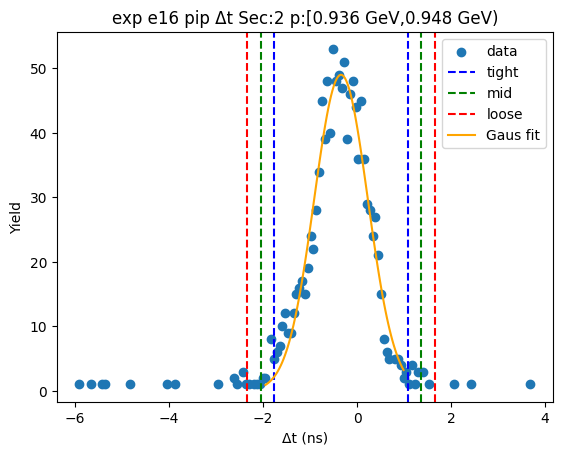

-1.7688858761704482 1.0590136586402101
-2.051675829651514 1.341803612121276
-2.33446578313258 1.6245935656023418
[47.75961698 -0.35493611  0.56557991]


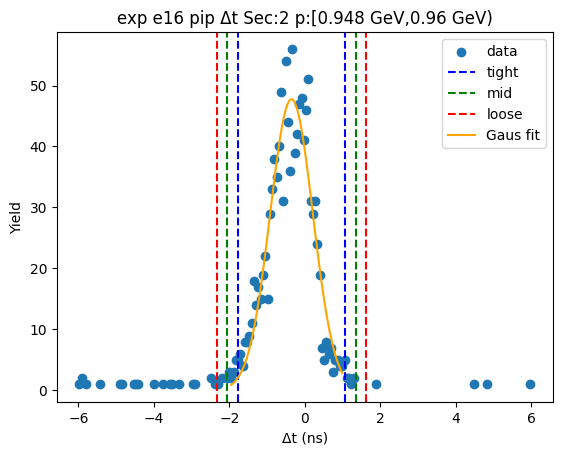

-1.8111009694475952 1.0867060257062726
-2.1008816689629817 1.3764867252216593
-2.3906623684783685 1.666267424737046
[44.84938658 -0.36219747  0.5795614 ]


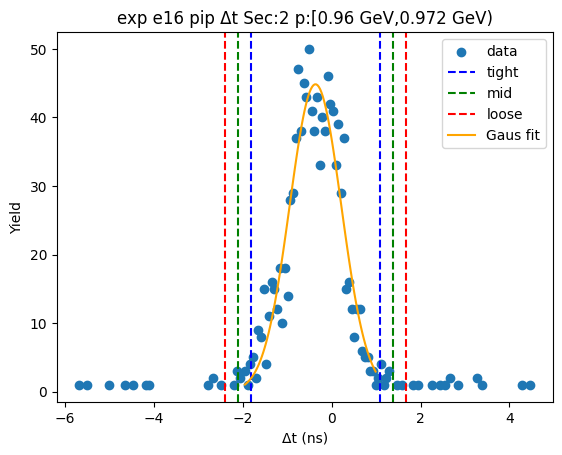

-1.7978443937709947 1.0961070688798047
-2.087239540036075 1.3855022151448848
-2.3766346863011547 1.6748973614099647
[47.21133873 -0.35086866  0.57879029]


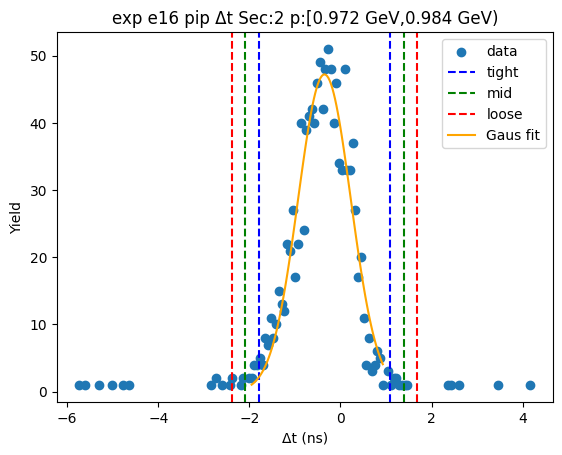

-1.7664578329822755 1.1011726326429199
-2.0532208795447953 1.3879356792054396
-2.3399839261073145 1.6746987257679589
[45.047919   -0.3326426   0.57352609]


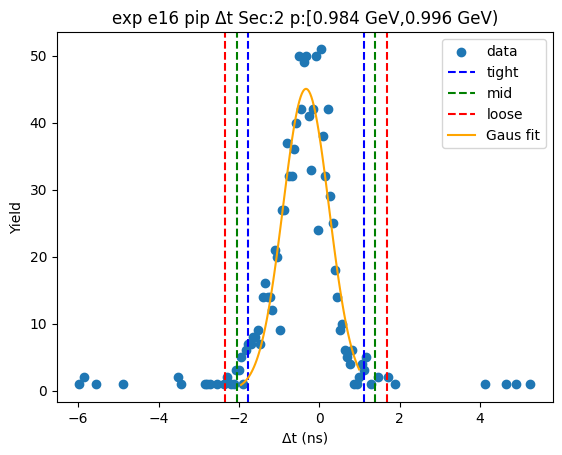

-1.7366139276029302 0.9966277128713169
-2.009938091650355 1.269951876918742
-2.2832622556977795 1.5432760409661666
[45.08493718 -0.36999311  0.54664833]


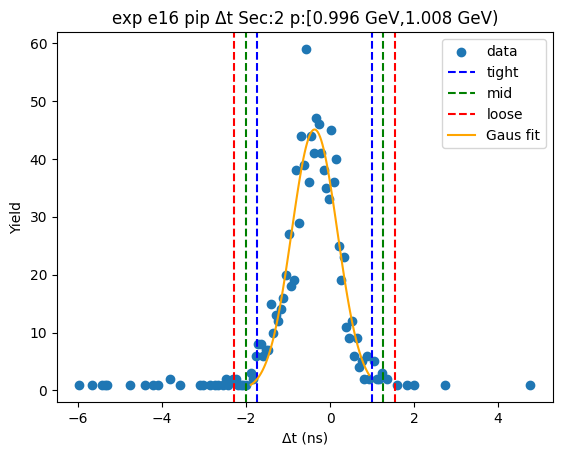

-1.786871674362468 1.0157895641377672
-2.0671377982124914 1.296055687987791
-2.347403922062515 1.5763218118378144
[43.52724975 -0.38554106  0.56053225]


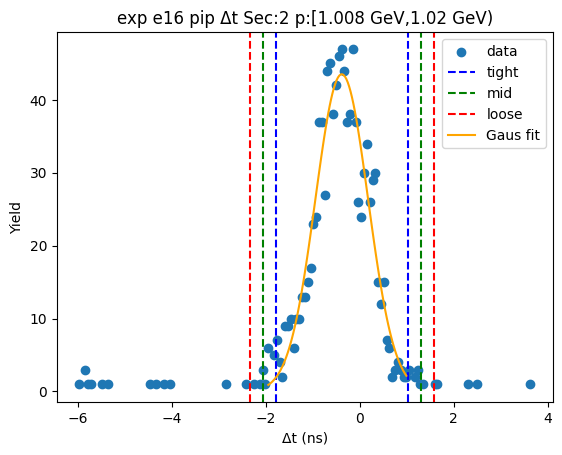

-1.85594614987793 1.0866142730821982
-2.150202192173943 1.380870315378211
-2.444458234469956 1.6751263576742237
[41.78372292 -0.38466594  0.58851208]


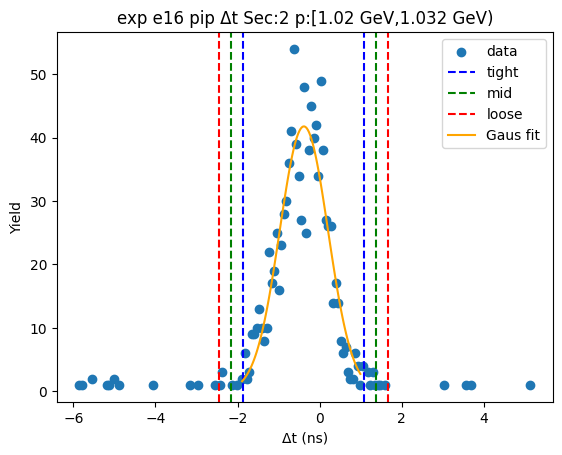

-1.8482154532118962 1.1432467482398212
-2.147361673357068 1.4423929683849928
-2.4465078935022397 1.7415391885301645
[38.7373642  -0.35248435  0.59829244]


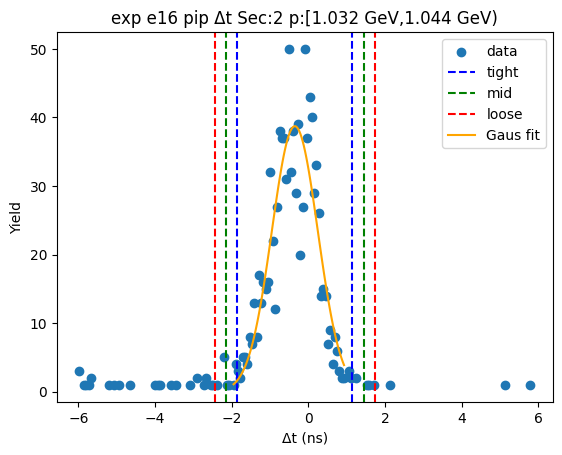

-1.839464704681613 1.0253359598505232
-2.1259447711348263 1.3118160263037368
-2.41242483758804 1.5982960927569505
[38.43209604 -0.40706437  0.57296013]


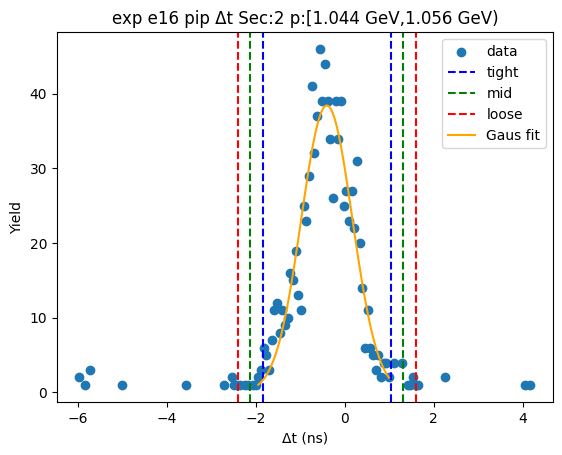

-1.813086391583994 1.0586881266958026
-2.1002638434119736 1.345865578523782
-2.3874412952399533 1.6330430303517618
[39.99502806 -0.37719913  0.5743549 ]


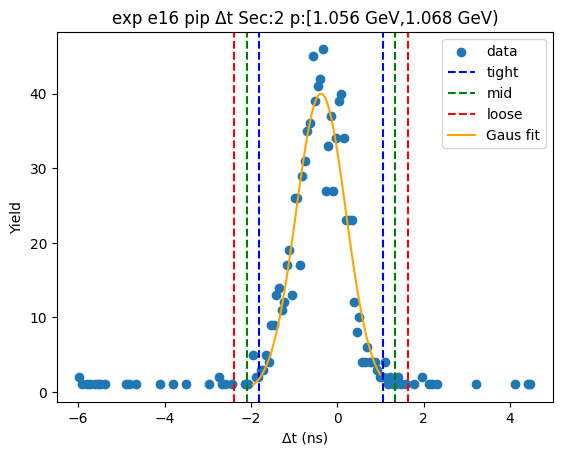

-1.8186837228302424 1.0967391243512181
-2.1102260075483885 1.388281409069364
-2.401768292266534 1.67982369378751
[37.32370203 -0.3609723   0.58308457]


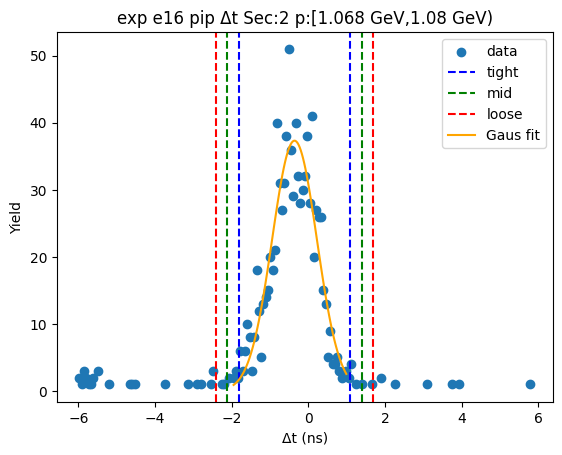

-2.024842967001497 1.203325049389536
-2.3476597686406 1.5261418510286393
-2.670476570279704 1.8489586526677428
[33.30790744 -0.41075896  0.6456336 ]


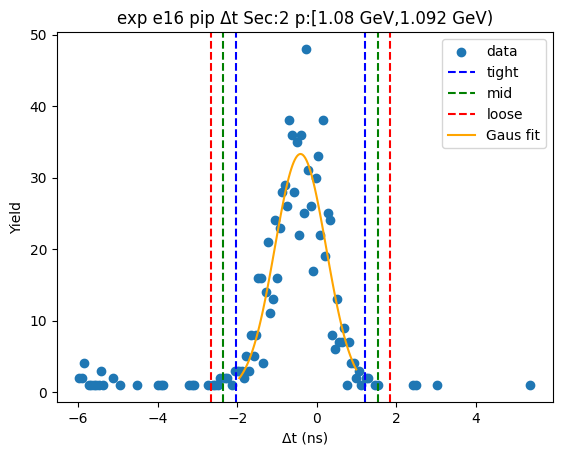

-1.8804421191974598 1.1079945634617485
-2.179285787463381 1.4068382317276695
-2.4781294557293014 1.70568189999359
[34.04399899 -0.38622378  0.59768734]


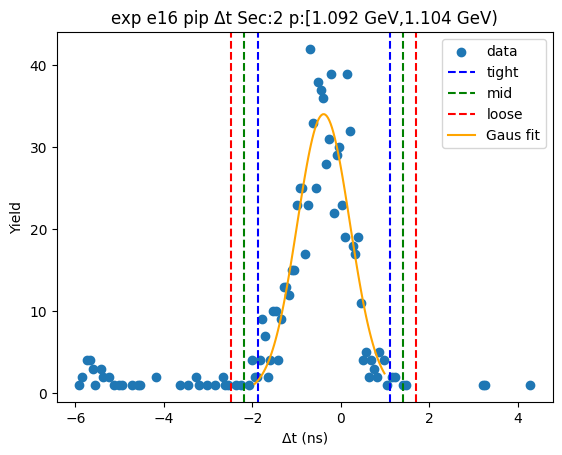

-1.8149562594614854 1.053900625616578
-2.1018419479692914 1.340786314124384
-2.388727636477098 1.6276720026321907
[35.80328592 -0.38052782  0.57377138]


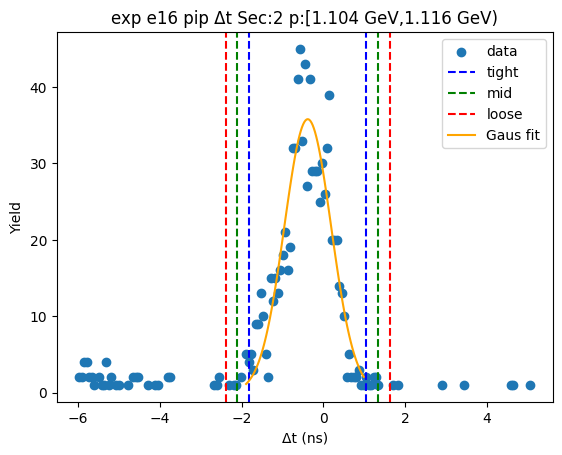

-1.9073053833137976 1.085548201391906
-2.206590741784368 1.3848335598624764
-2.5058761002549383 1.6841189183330467
[32.9289916  -0.41087859  0.59857072]


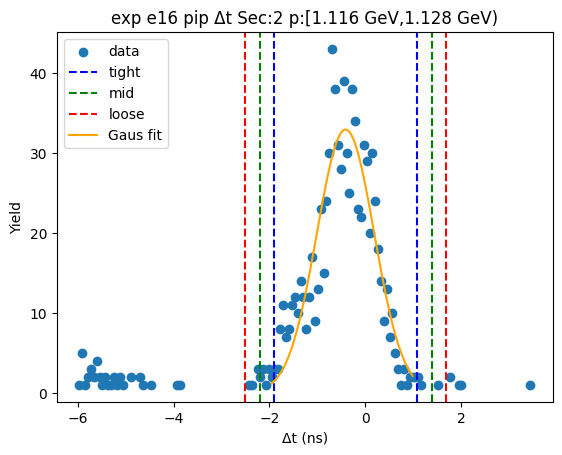

-2.005573363811843 1.097560202269865
-2.3158867204200133 1.4078735588780356
-2.6262000770281846 1.7181869154862064
[30.3175421  -0.45400658  0.62062671]


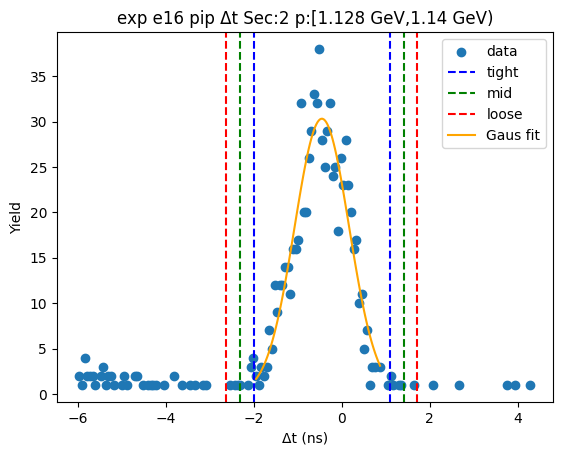

-1.8875459314935372 1.127850982152799
-2.1890856228581708 1.429390673517433
-2.4906253142228048 1.7309303648820666
[31.35737206 -0.37984747  0.60307938]


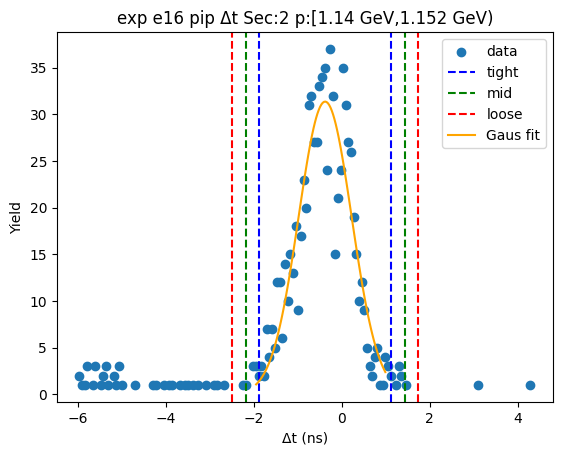

-2.0415820904364486 1.149274971428042
-2.3606677966228977 1.4683606776144909
-2.6797535028093464 1.7874463838009398
[30.07173718 -0.44615356  0.63817141]


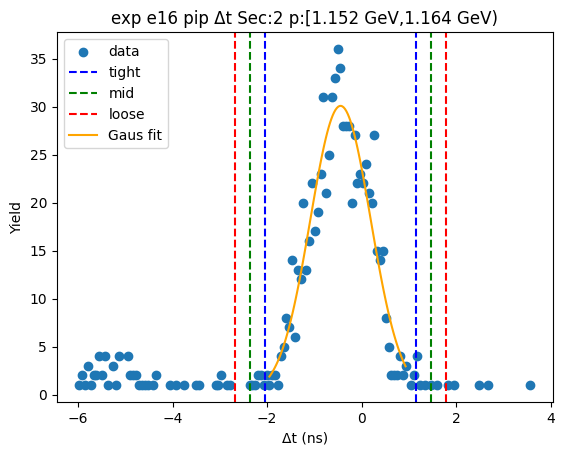

-2.0092353831906644 1.1705961132871348
-2.3272185328384443 1.4885792629349148
-2.645201682486224 1.8065624125826947
[27.96891163 -0.41931963  0.6359663 ]


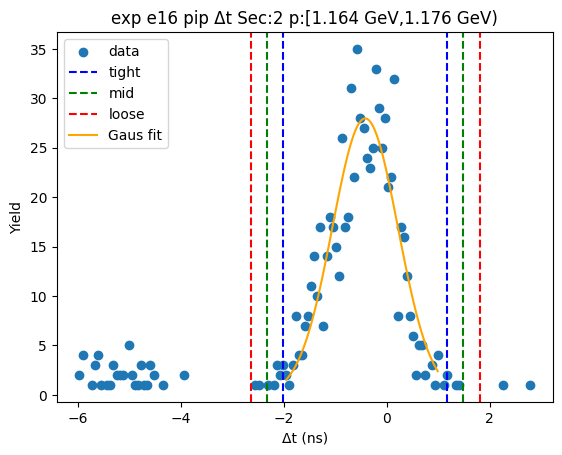

-1.7685172509290794 0.9603958297523234
-2.0414085589972193 1.2332871378204635
-2.3142998670653596 1.5061784458886038
[31.64450218 -0.40406071  0.54578262]


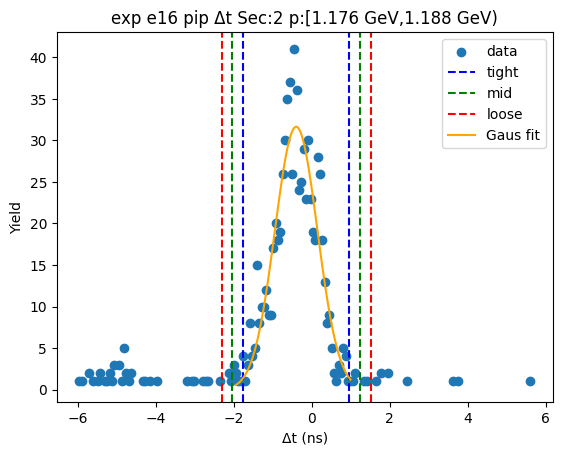

-1.9163977646103085 1.0550521126947225
-2.2135427523408118 1.3521971004252258
-2.5106877400713152 1.649342088155729
[28.12630566 -0.43067283  0.59428998]


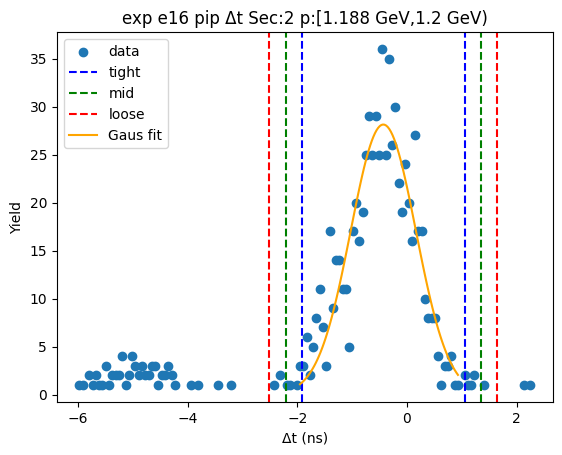

-1.980861075504522 1.119123313184826
-2.290859514373457 1.429121752053761
-2.6008579532423917 1.7391201909226957
[27.55519983 -0.43086888  0.61999688]


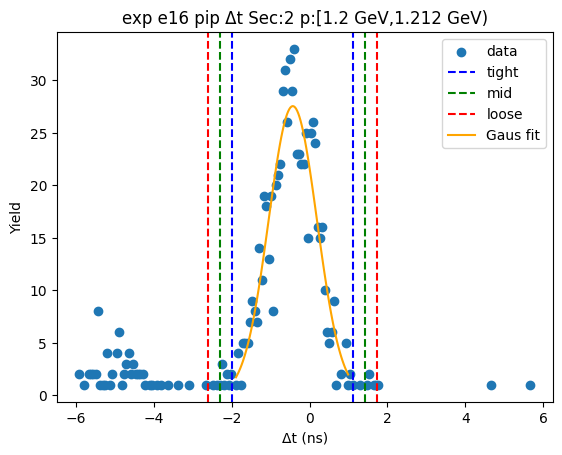

-1.9787623937726582 1.0508551547186502
-2.281724148621789 1.3538169095677812
-2.5846859034709198 1.6567786644169118
[27.85900118 -0.46395362  0.60592351]


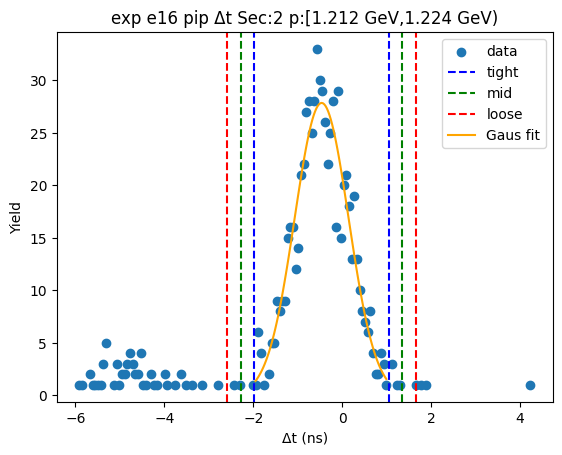

-2.0648577833231325 1.1687517576567943
-2.3882187374211252 1.492112711754787
-2.711579691519118 1.8154736658527797
[24.79922496 -0.44805301  0.64672191]


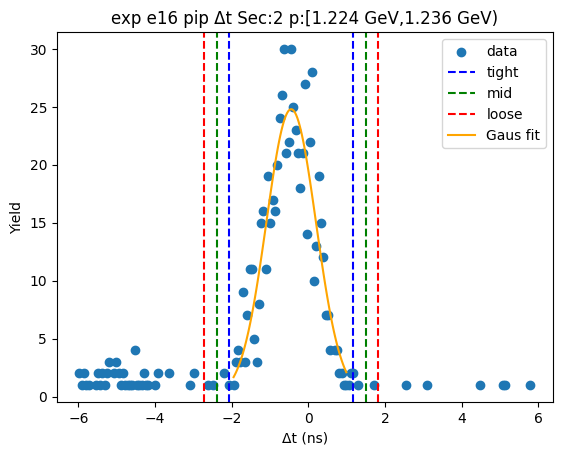

-1.9152346735498962 1.090926997179889
-2.2158508406228745 1.3915431642528673
-2.5164670076958533 1.692159331325846
[25.83618135 -0.41215384  0.60123233]


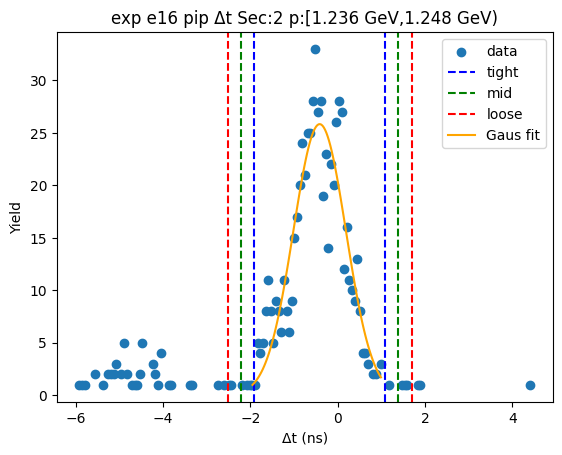

-1.8923982656323284 1.130756131383875
-2.1947137053339487 1.4330715710854953
-2.4970291450355693 1.7353870107871159
[26.41019092 -0.38082107  0.60463088]


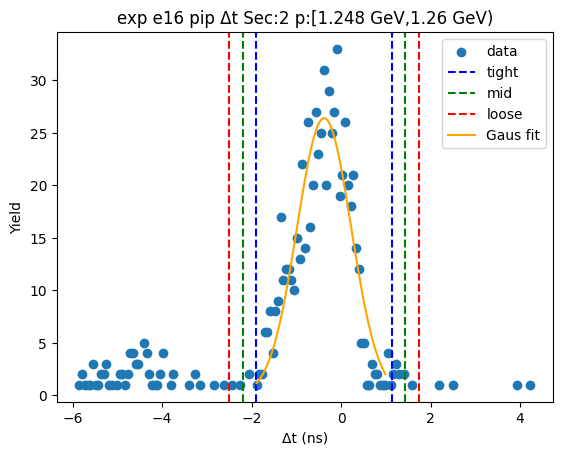

-1.8633916251132445 1.025470995633009
-2.15227788718787 1.3143572577076346
-2.4411641492624954 1.6032435197822599
[24.92256096 -0.41896031  0.57777252]


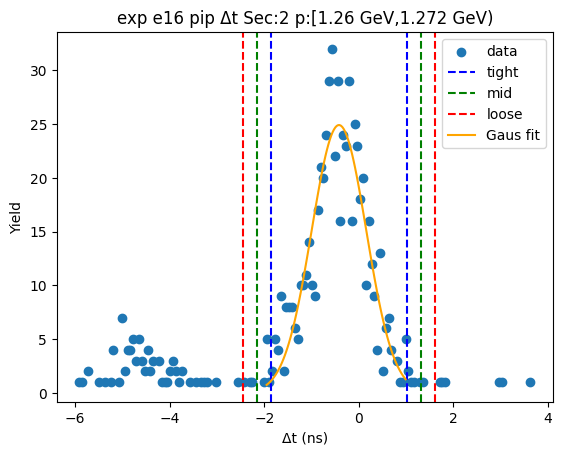

-1.9838103236788496 1.157313400274445
-2.2979226960741794 1.4714257726697746
-2.612035068469509 1.785538145065104
[24.15418025 -0.41324846  0.62822474]


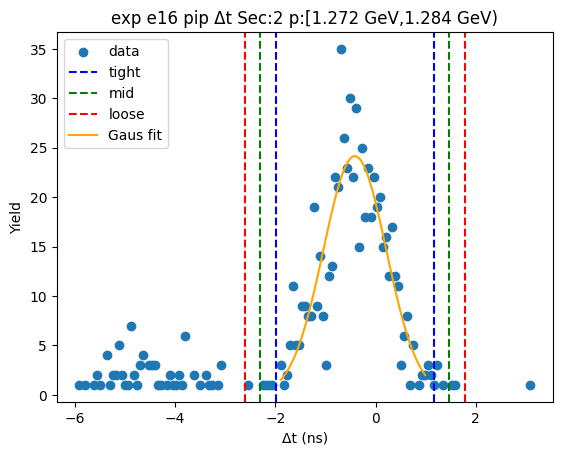

-2.048044681354233 1.1795137162835077
-2.370800521118007 1.502269556047282
-2.6935563608817814 1.825025395811056
[23.41267013 -0.43426548  0.64551168]


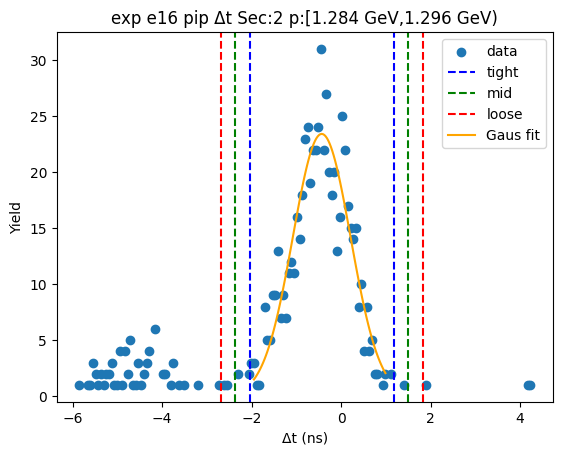

-1.9494918446405691 1.1984971827762294
-2.264290747382249 1.5132960855179094
-2.579089650123929 1.8280949882595894
[22.48832768 -0.37549733  0.62959781]


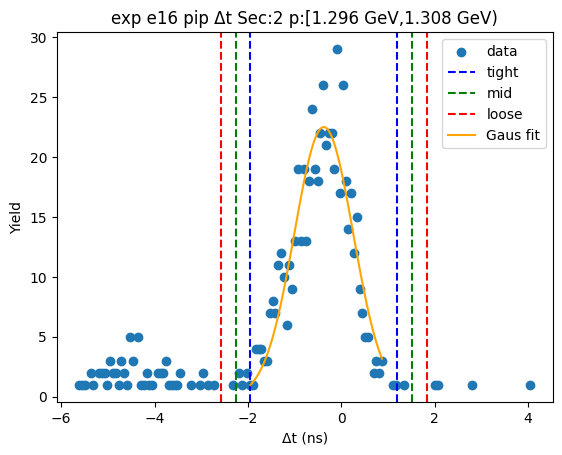

-1.9170584885743511 1.055295689716179
-2.214293906403404 1.3525311075452318
-2.5115293242324572 1.649766525374285
[22.36414351 -0.4308814   0.59447084]


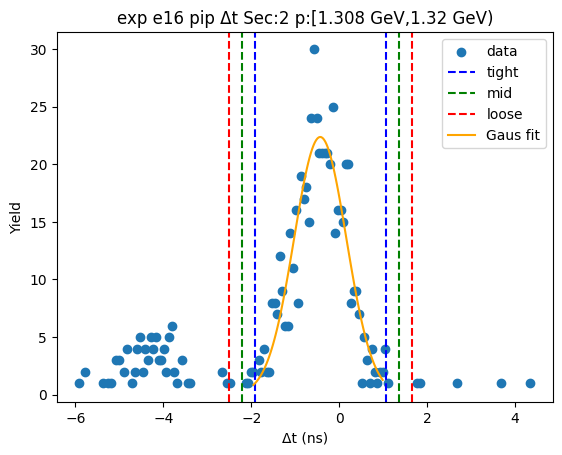

-2.0773041427346666 1.199457099279082
-2.4049802669360414 1.5271332234804573
-2.732656391137416 1.8548093476818321
[21.61291371 -0.43892352  0.65535225]


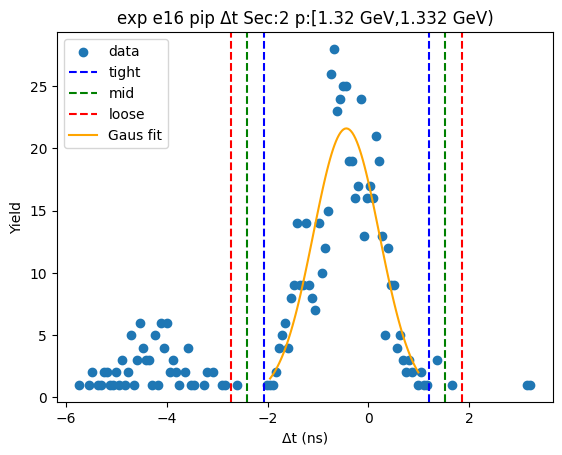

-1.8879529523522245 1.012256596440705
-2.1779739072315176 1.3022775513199982
-2.4679948621108103 1.592298506199291
[21.78536595 -0.43784818  0.58004191]


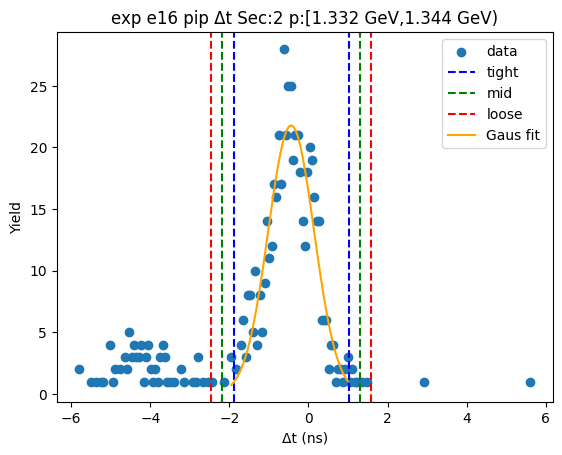

-1.9032179560089026 1.064113903805448
-2.1999511419903377 1.360847089786883
-2.4966843279717725 1.6575802757683178
[21.14613531 -0.41955203  0.59346637]


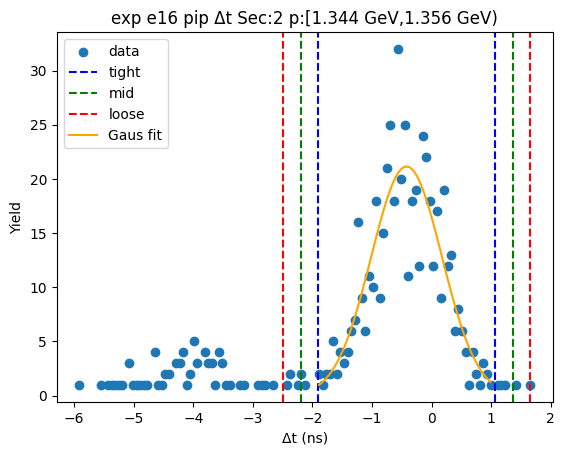

-1.8099343447944436 1.1067059764877791
-2.101598376922666 1.3983700086160016
-2.3932624090508883 1.6900340407442238
[22.89977709 -0.35161418  0.58332806]


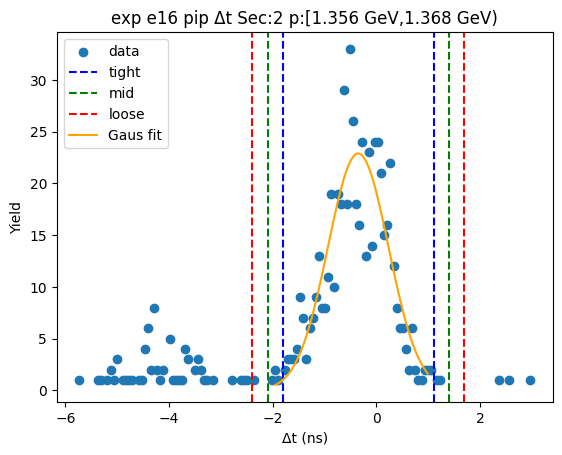

-2.056872108544743 1.1436976752459695
-2.3769290869238144 1.463754653625041
-2.6969860653028856 1.7838116320041122
[19.24067072 -0.45658722  0.64011396]


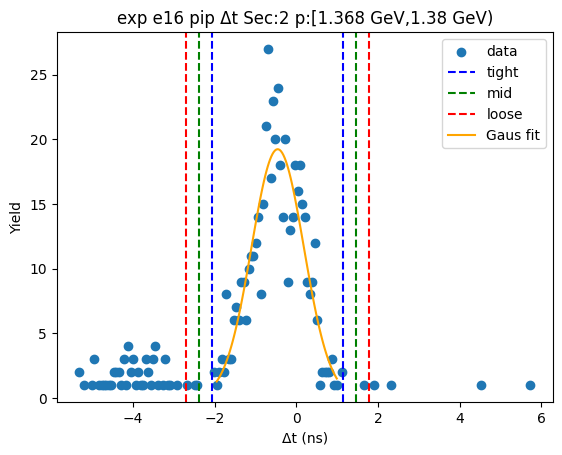

-1.8331789655073587 1.1651805713916321
-2.1330149191972576 1.465016525081531
-2.432850872887157 1.7648524787714304
[20.06993975 -0.3339992   0.59967191]


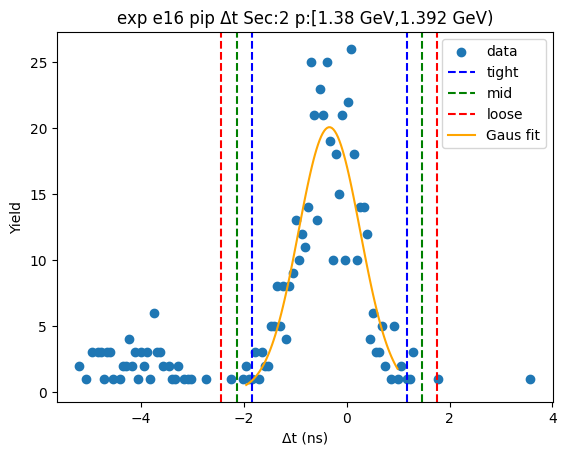

-2.01466122689165 1.0122496602045405
-2.3173523156012696 1.3149407489141596
-2.6200434043108887 1.6176318376237786
[20.23600357 -0.50120578  0.60538218]


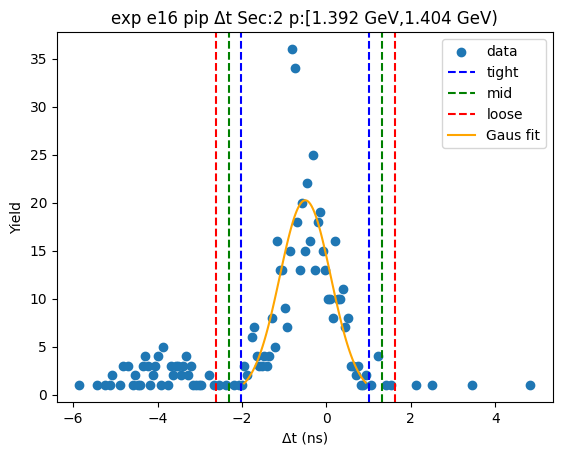

-1.7868903695102814 0.9346991657982751
-2.059049323041137 1.2068581193291306
-2.331208276571992 1.479017072859986
[21.18467042 -0.4260956   0.54431791]


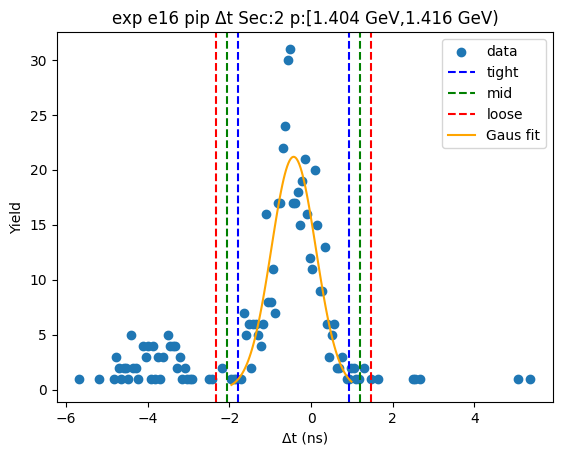

-1.9354452264807587 1.130446127273212
-2.2420343618561556 1.437035262648609
-2.548623497231553 1.7436243980240063
[19.4728373  -0.40249955  0.61317827]


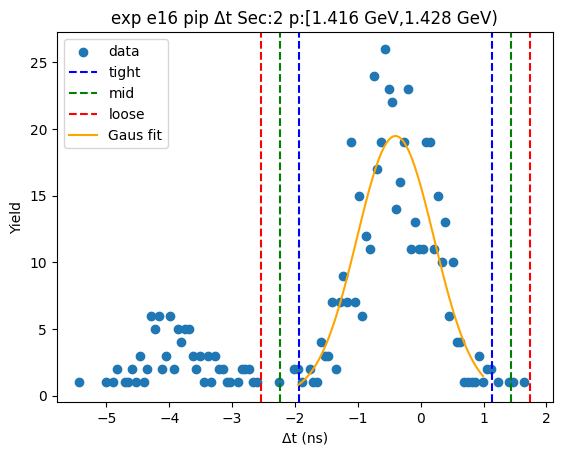

-1.8871899876588882 1.0985069858067193
-2.185759685005449 1.39707668315328
-2.48432938235201 1.695646380499841
[18.60446771 -0.3943415   0.59713939]


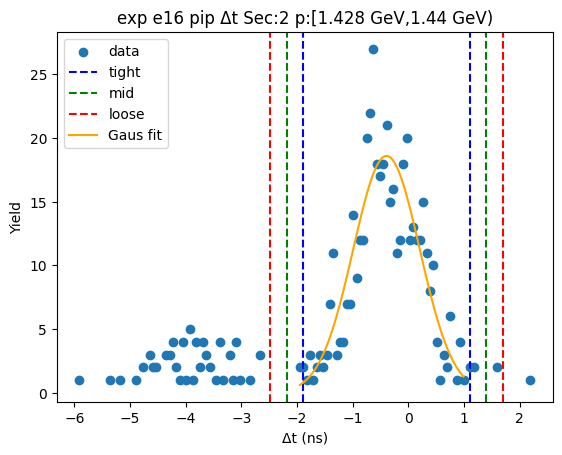

-1.8047964237118834 1.0969883516842307
-2.094974901251495 1.3871668292238417
-2.3851533787911063 1.6773453067634532
[19.03943009 -0.35390404  0.58035696]


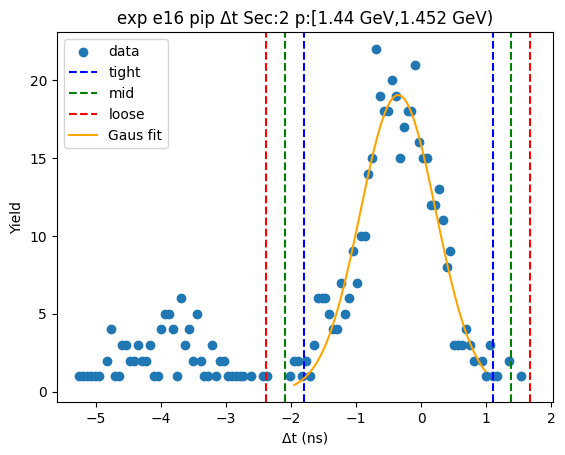

-1.8772666924733188 0.9910770295143551
-2.1641010646720864 1.2779114017131223
-2.4509354368708536 1.5647457739118895
[18.0780643  -0.44309483  0.57366874]


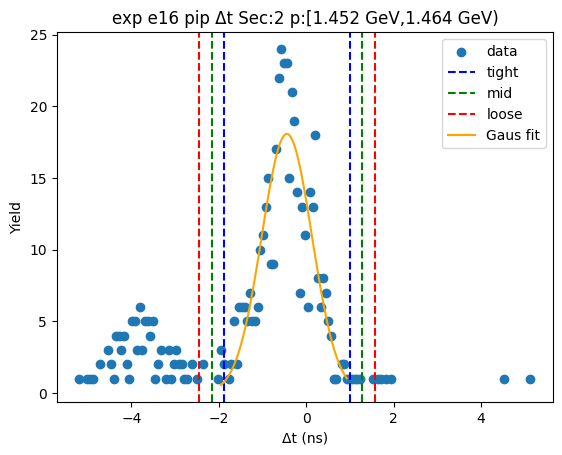

-2.00874916106195 1.3138664906973916
-2.341010726237884 1.6461280558733256
-2.6732722914138183 1.97838962104926
[14.89052088 -0.34744134  0.66452313]


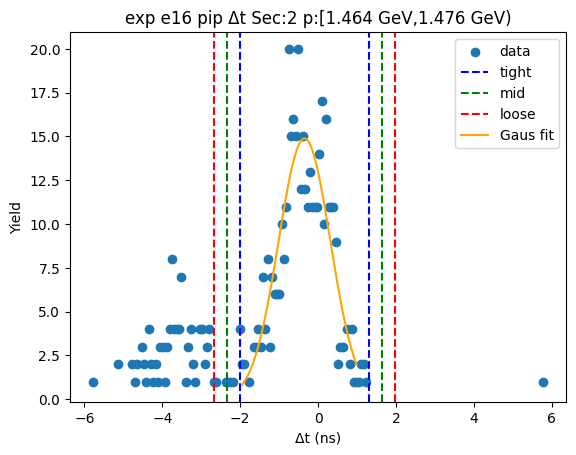

-1.9754316864045578 1.0546262133725308
-2.278437476382267 1.3576320033502398
-2.581443266359976 1.6606377933279488
[17.1033059  -0.46040274  0.60601158]


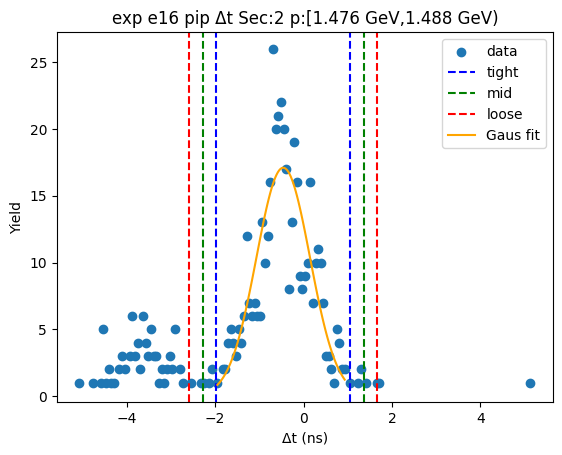

-1.979821442058676 1.2377567962121654
-2.30157926588576 1.5595146200392493
-2.623337089712844 1.8812724438663335
[14.6590176  -0.37103232  0.64351565]


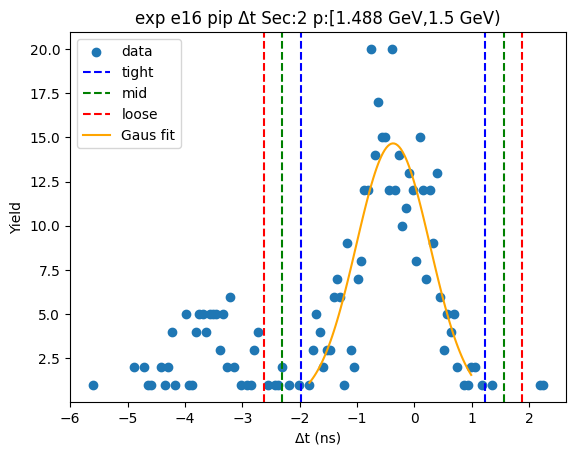

-1.9985162668374798 1.2392821111103667
-2.3222961046322643 1.5630619489051512
-2.646075942427049 1.8868417866999359
[16.25890093 -0.37961708  0.64755968]


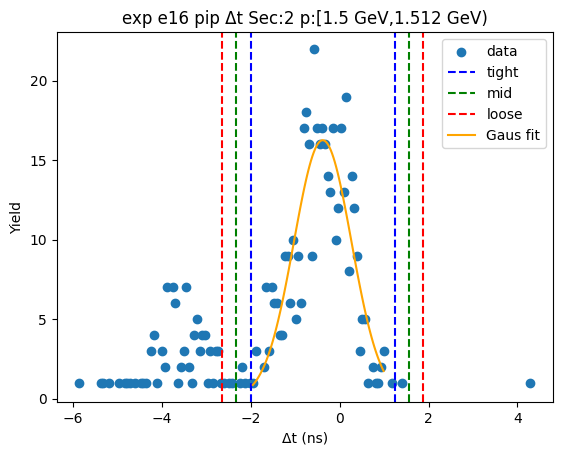

-1.852550902036028 1.049258204564294
-2.1427318126960606 1.3394391152243261
-2.4329127233560928 1.6296200258843583
[18.1065068  -0.40164635  0.58036182]


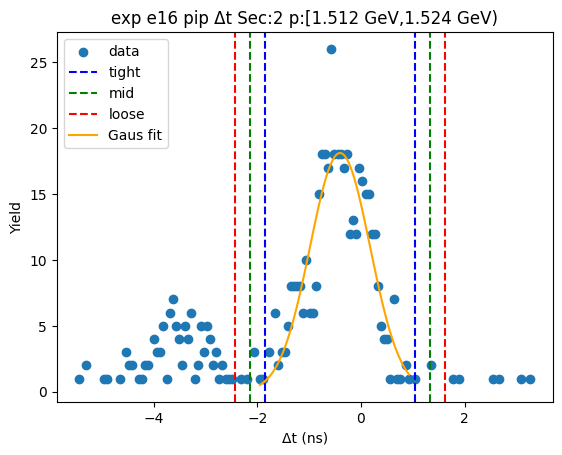

-1.790070307687779 0.933850378332888
-2.062462376289846 1.2062424469349549
-2.3348544448919126 1.4786345155370215
[17.64587599 -0.42810996  0.54478414]


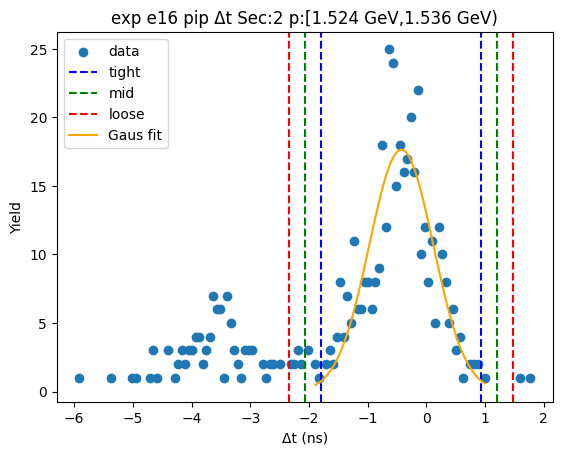

-1.8391207436669732 1.1834268514964355
-2.1413755031833137 1.4856816110127762
-2.4436302626996547 1.787936370529117
[16.39600315 -0.32784695  0.60450952]


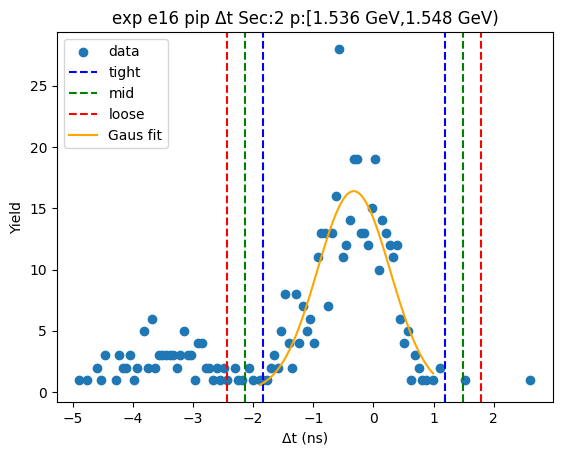

-1.7913003779567978 0.9947021403251031
-2.0699006297849882 1.2733023921532933
-2.348500881613178 1.5519026439814834
[18.12101929 -0.39829912  0.5572005 ]


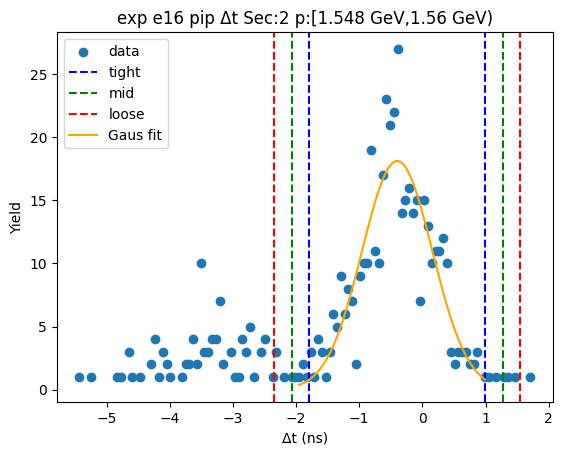

-1.6853920533751807 1.266254822726473
-1.980556740985346 1.5614195103366382
-2.2757214285955114 1.8565841979468034
[14.96034097 -0.20956862  0.59032938]


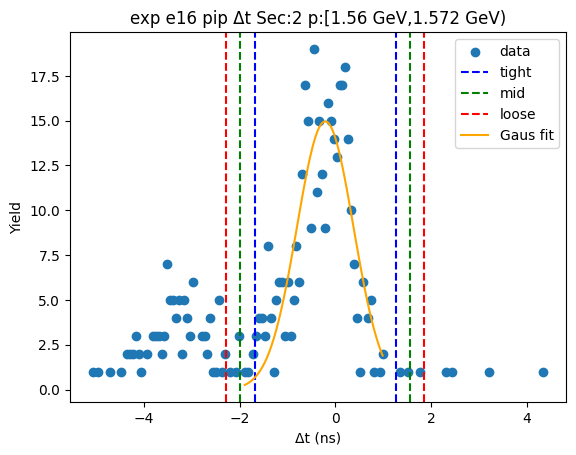

-2.126258965625841 1.3008040269655374
-2.468965264884979 1.6435103262246753
-2.811671564144117 1.986216625483813
[12.65316134 -0.41272747  0.6854126 ]


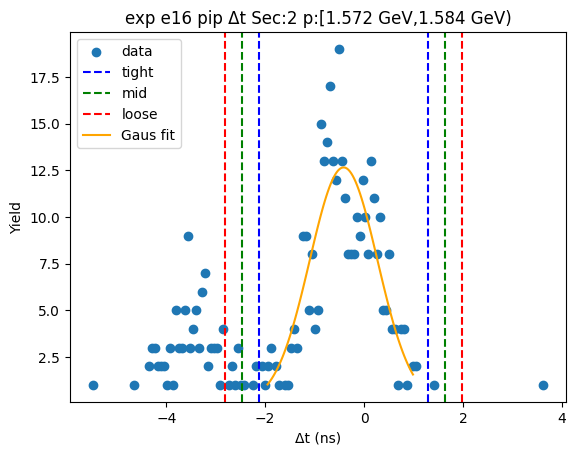

-1.9645775135230625 1.120205870011464
-2.2730558518765154 1.428684208364917
-2.5815341902299678 1.7371625467183693
[13.20711343 -0.42218582  0.61695668]


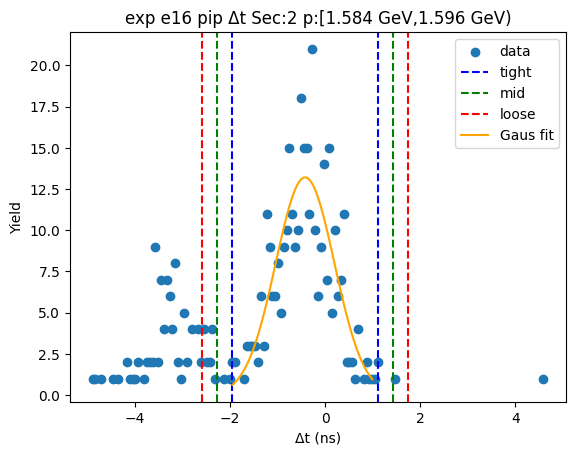

-2.1078830765133376 1.1169873449021492
-2.4303701186548863 1.439474387043698
-2.752857160796435 1.7619614291852466
[14.05445959 -0.49544787  0.64497408]


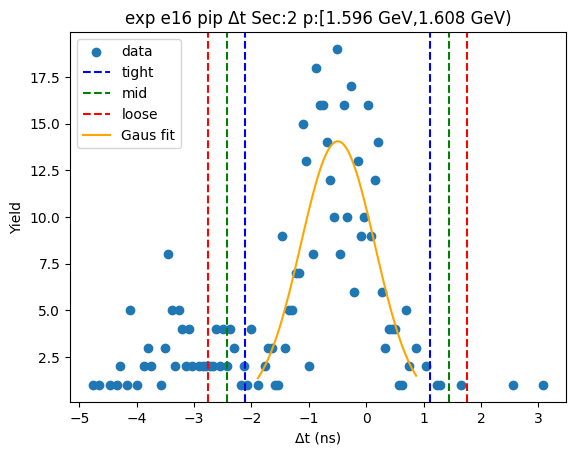

-1.974868240570758 1.1003693283561577
-2.2823919974634497 1.4078930852488492
-2.5899157543561415 1.715416842141541
[13.88295412 -0.43724946  0.61504751]


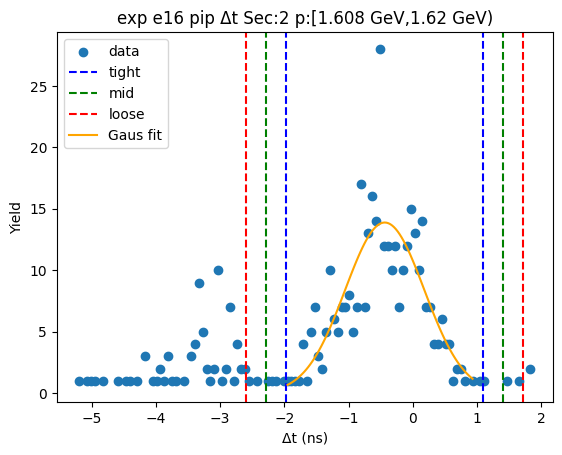

-1.9108759202853207 1.1535115543514918
-2.217314667749002 1.4599503018151734
-2.5237534152126835 1.7663890492788545
[13.75363092 -0.37868218  0.61287749]


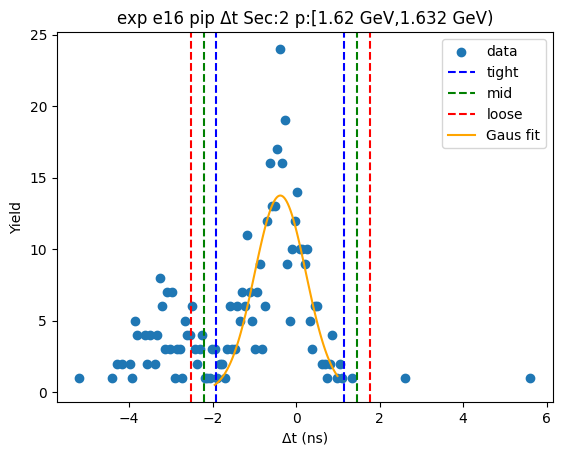

-2.0527572720839418 1.2956679912221771
-2.387599798414554 1.6305105175527892
-2.7224423247451655 1.9653530438834008
[11.47414686 -0.37854464  0.66968505]


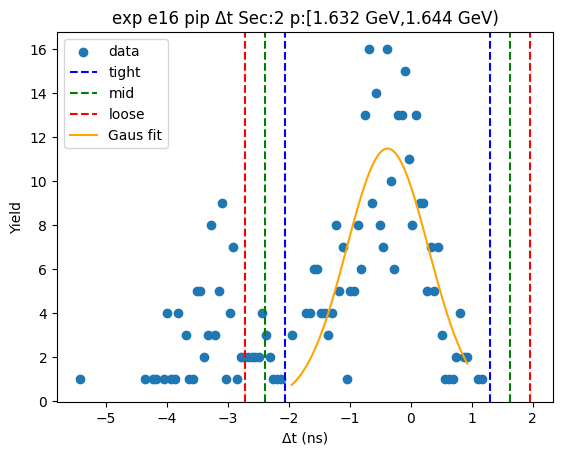

-1.9039863556807124 1.0611160059603082
-2.2004965918448143 1.35762624212441
-2.4970068280089164 1.6541364782885122
[12.96863596 -0.42143517  0.59302047]


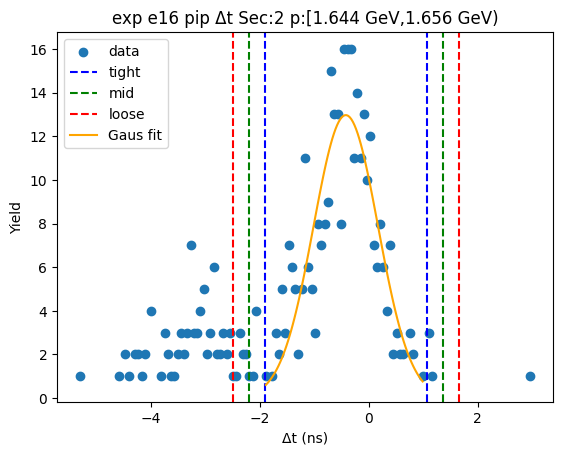

-2.1771244183162337 1.3332894243684312
-2.5281658025847 1.6843308086368975
-2.879207186853167 2.0353721929053643
[11.35712794 -0.4219175   0.70208277]


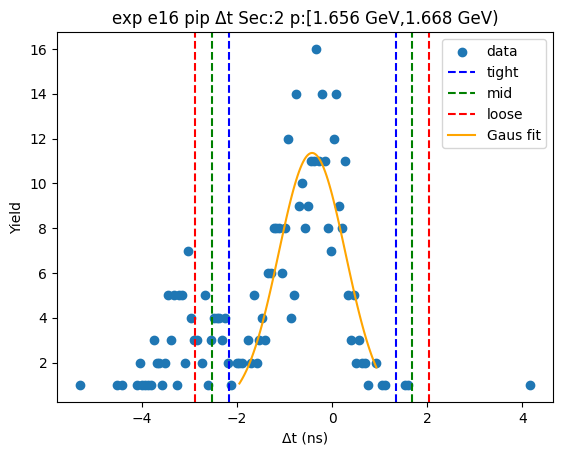

-2.157000506017573 1.3401298168671179
-2.506713538306042 1.6898428491555866
-2.856426570594511 2.0395558814440555
[11.99966734 -0.40843534  0.69942606]


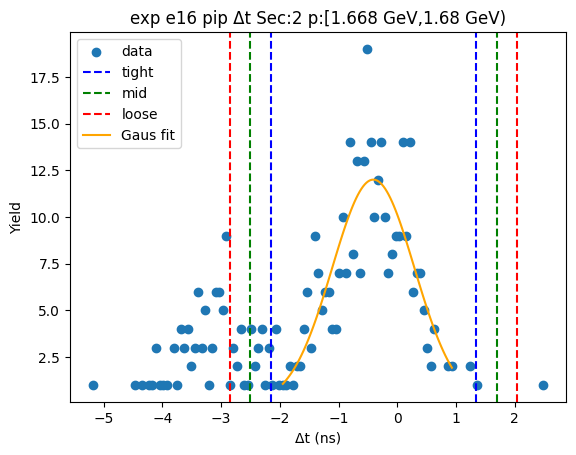

-2.352699548021735 1.4795079852850106
-2.73592030135241 1.862728738615685
-3.1191410546830847 2.2459494919463596
[10.96807959 -0.43659578  0.76644151]


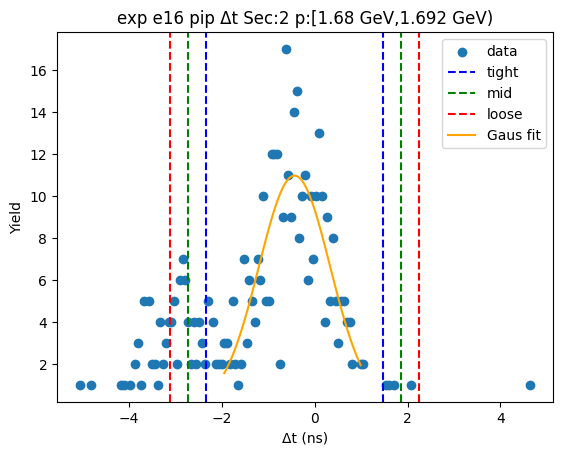

-2.003874785102057 1.338482883891499
-2.338110552001412 1.6727186507908545
-2.6723463189007677 2.0069544176902103
[12.43624752 -0.33269595  0.66847153]


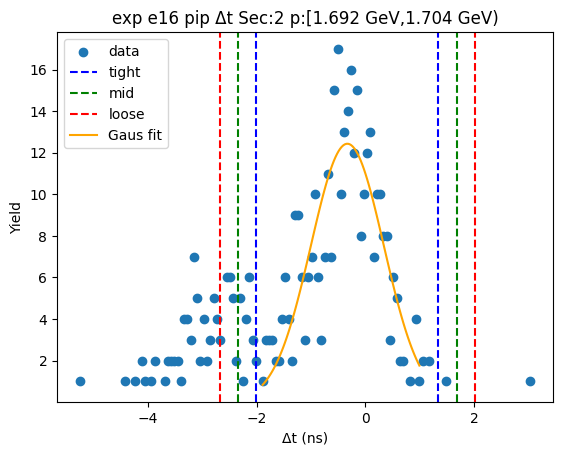

-2.140880371291824 1.2769002498782709
-2.482658433408834 1.6186783119952806
-2.8244364955258434 1.96045637411229
[ 9.47120597 -0.43199006  0.68355612]


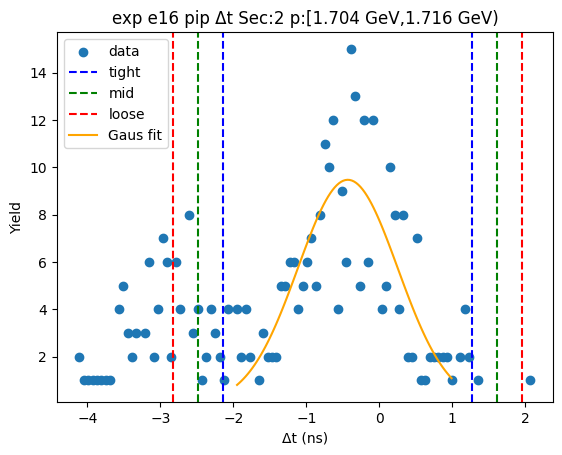

-2.172515240457164 1.441561183231124
-2.533922882825993 1.8029688255999528
-2.895330525194822 2.1643764679687814
[10.22831566 -0.36547703  0.72281528]


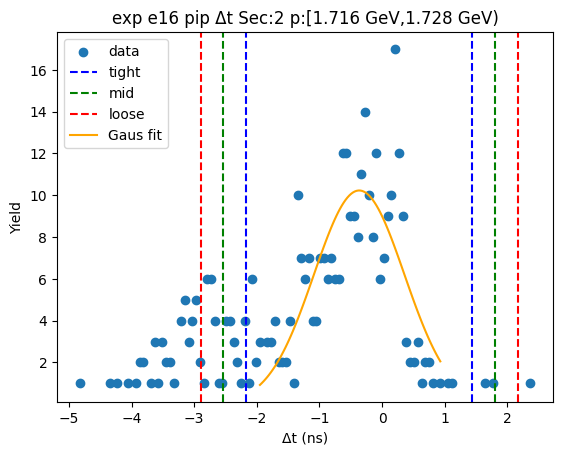

-2.049693251599107 1.3086254462475777
-2.3855251213837754 1.6444573160322458
-2.721356991168444 1.9802891858169143
[11.75614647 -0.3705339   0.67166374]


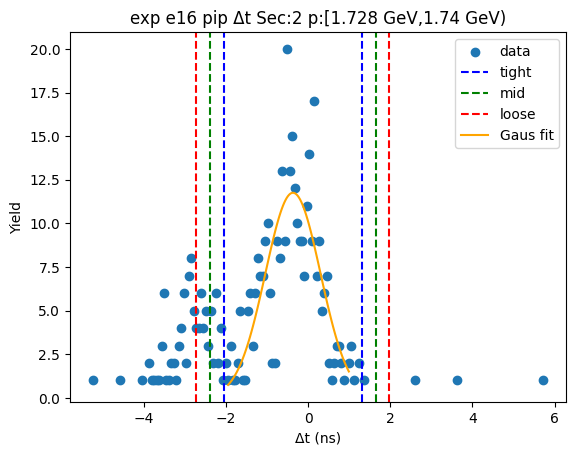

-2.1104671976020715 1.2307484414520113
-2.4445887615074797 1.5648700053574196
-2.778710325412888 1.8989915692628279
[11.16052953 -0.43985938  0.66824313]


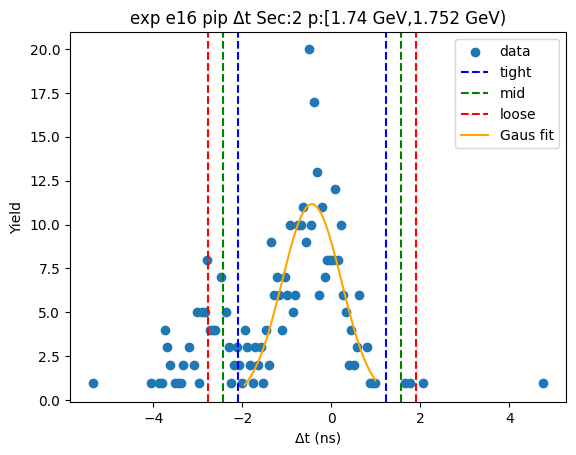

-1.7763739051486784 1.104849118268431
-2.064496207490389 1.3929714206101418
-2.3526185098321 1.681093722951853
[12.40469767 -0.33576239  0.5762446 ]


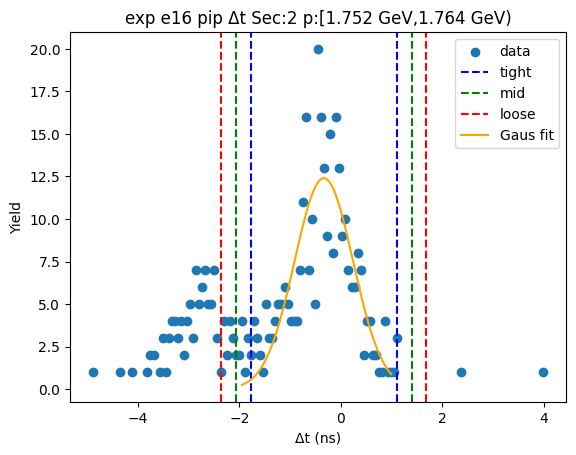

-2.2239006638791197 1.4108463519718477
-2.5873753654642164 1.7743210535569445
-2.950850067049313 2.1377957551420415
[10.88350432 -0.40652716  0.7269494 ]


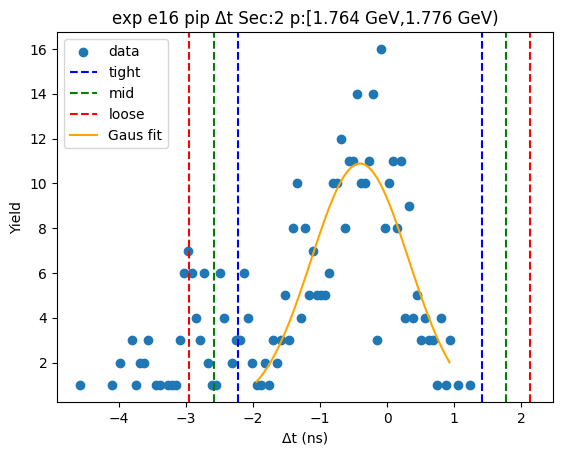

-2.326893288781136 1.5225479311211898
-2.7118374107713685 1.9074920531114226
-3.096781532761601 2.2924361751016553
[ 9.88475534 -0.40217268  0.76988824]


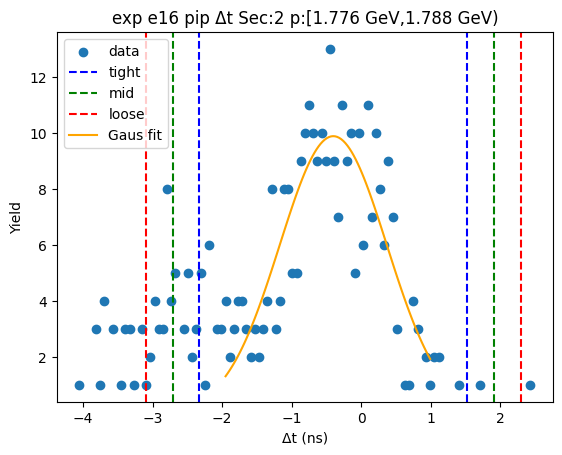

-2.1034252180590514 1.2534111821015501
-2.439108858075112 1.5890948221176102
-2.774792498091172 1.9247784621336703
[ 9.99236287 -0.42500702  0.67136728]


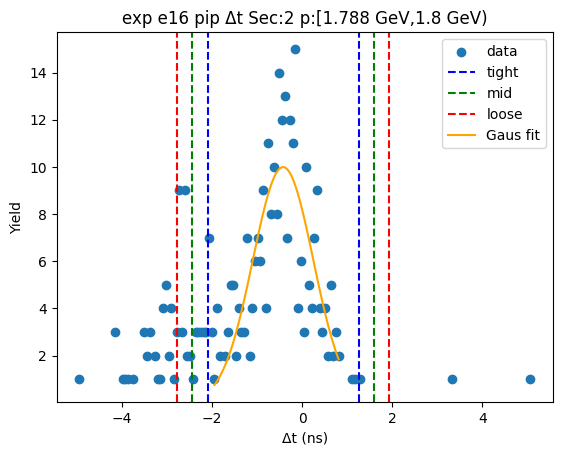

-2.4562982031097693 1.6213149924661947
-2.8640595226673655 2.0290763120237907
-3.271820842224962 2.4368376315813873
[ 8.80461679 -0.41749161  0.81552264]


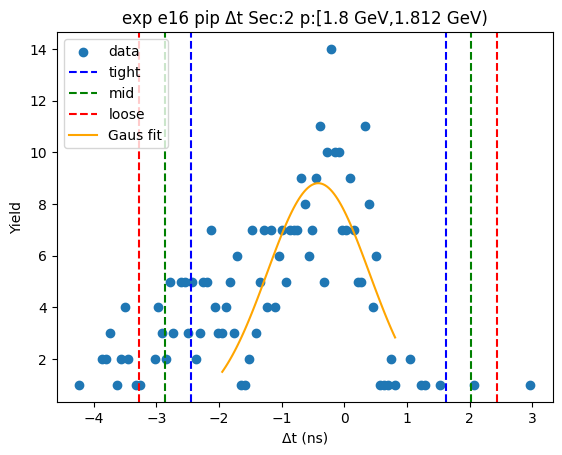

-2.557811162335307 1.662211433812206
-2.9798134219500585 2.0842136934269573
-3.4018156815648095 2.5062159530417083
[ 8.8968527  -0.44779986  0.84400452]


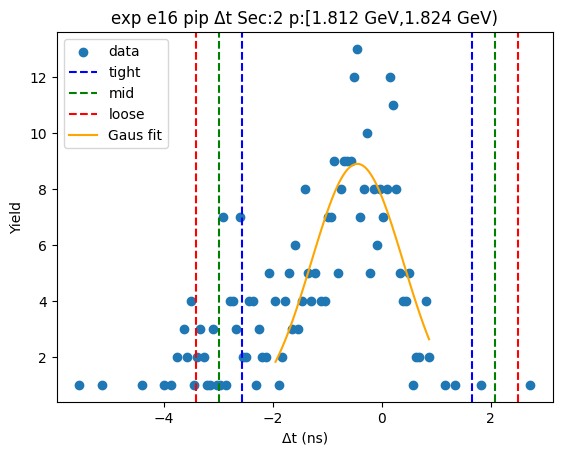

-2.388918471734787 1.5431540408297217
-2.782125722991238 1.9363612920861728
-3.175332974247689 2.3295685433426234
[ 9.46837735 -0.42288222  0.7864145 ]


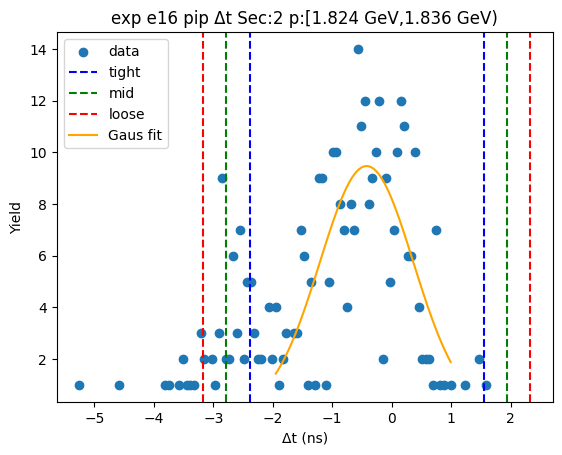

-2.020685080453131 1.2912442239068456
-2.3518780108891284 1.622437154342843
-2.683070941325126 1.9536300847788406
[ 9.9708792  -0.36472043  0.66238586]


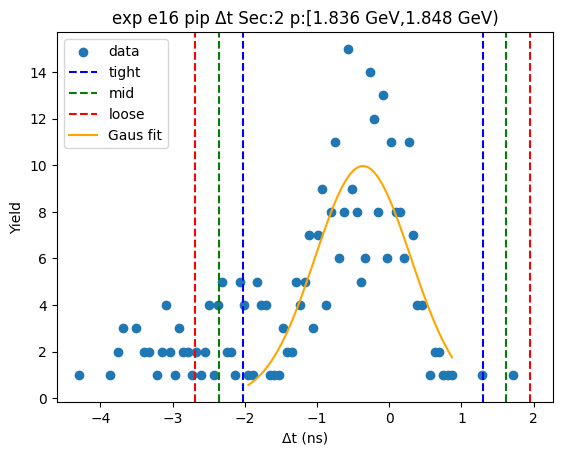

-2.1215436473858156 1.3180077818836575
-2.4654987903127625 1.6619629248106045
-2.80945393323971 2.005918067737552
[10.13234697 -0.40176793  0.68791029]


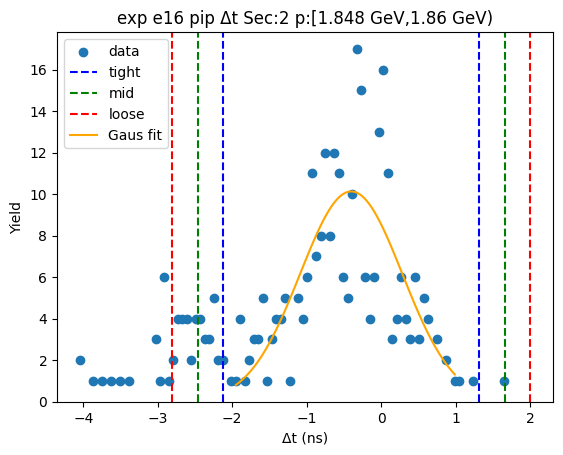

-1.9653662013803772 1.2323237966907916
-2.285135201187494 1.5520927964979083
-2.604904200994611 1.8718617963050252
[ 9.87007497 -0.3665212   0.639538  ]


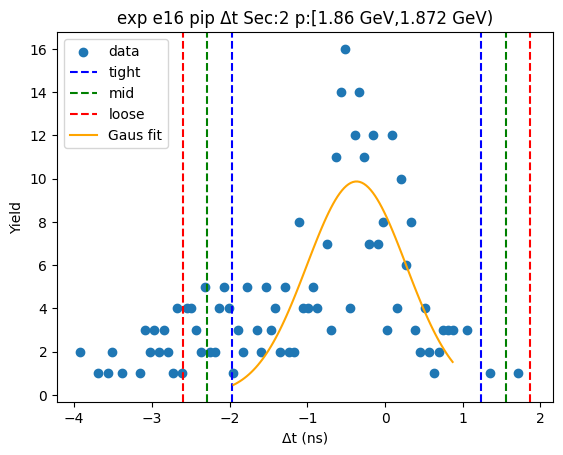

-2.7012876685778693 1.888408690969295
-3.1602573045325864 2.3473783269240114
-3.6192269404873025 2.8063479628787276
[ 7.02817434 -0.40643949  0.91793927]


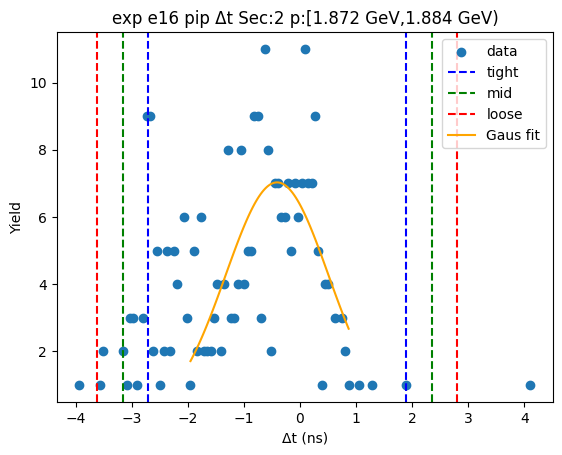

-1.998616461215742 1.3377865388435184
-2.332256761221668 1.6714268388494444
-2.6658970612275943 2.0050671388553707
[10.51885601 -0.33041496  0.6672806 ]


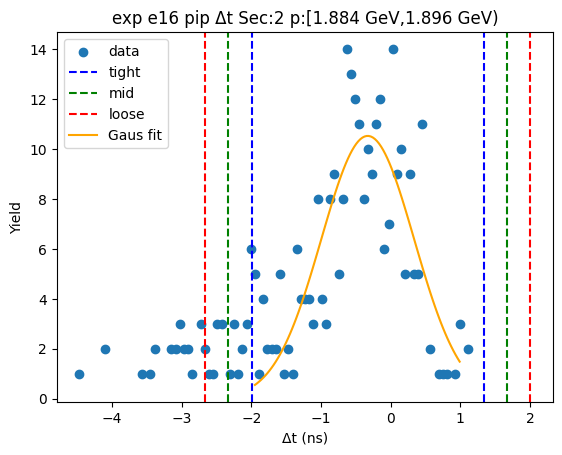

-2.9002070458618396 1.926865738726197
-3.382914324320643 2.4095730171850005
-3.8656216027794468 2.892280295643804
[ 7.20546245 -0.48667065  0.96541456]


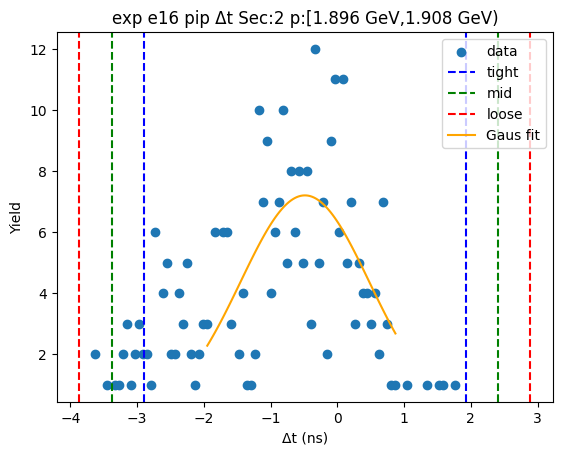

-2.4385367697275746 1.3171137962658168
-2.8141018263269135 1.6926788528651562
-3.1896668829262524 2.068243909464495
[ 8.45606335 -0.56071149  0.75113011]


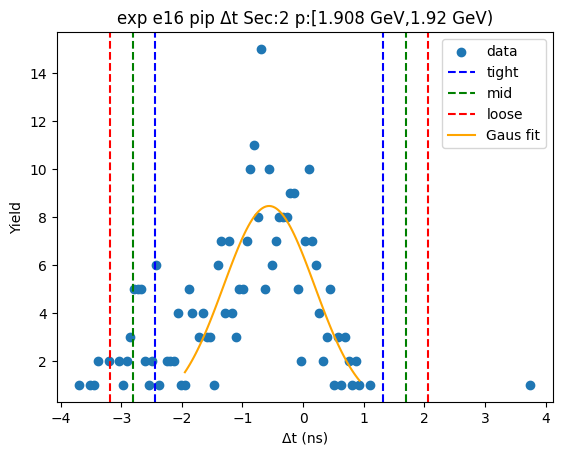

-2.2762087680530825 1.3433954099689247
-2.638169185855283 1.7053558277711258
-3.000129603657484 2.0673162455733265
[ 9.20546501 -0.46640668  0.72392084]


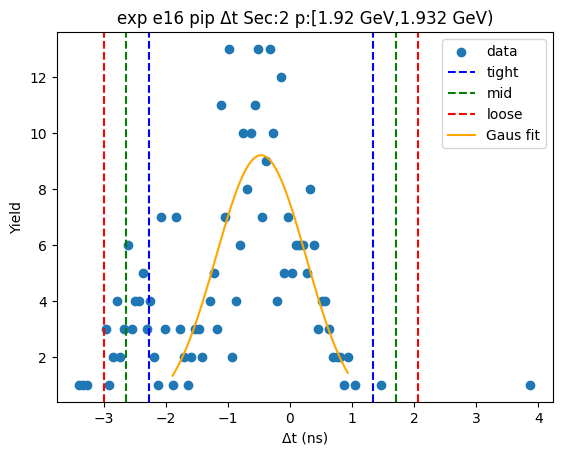

-2.4428089243092512 1.610886985843917
-2.8481785153245682 2.016256576859234
-3.253548106339885 2.4216261678745505
[ 8.35401687 -0.41596097  0.81073918]


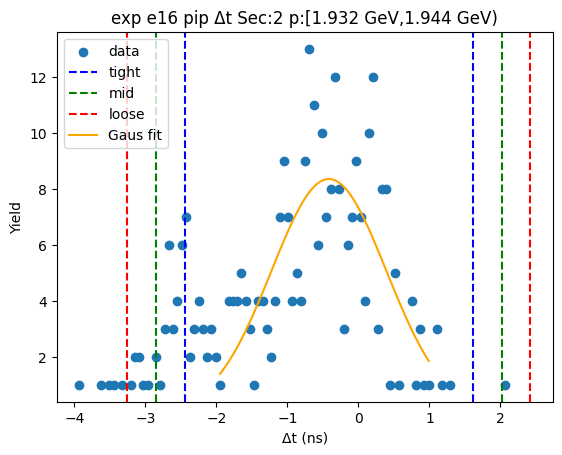

-2.4458965541569517 1.4279861450848172
-2.8332848240811286 1.8153744150089945
-3.2206730940053054 2.2027626849331714
[ 8.01732629 -0.5089552   0.77477654]


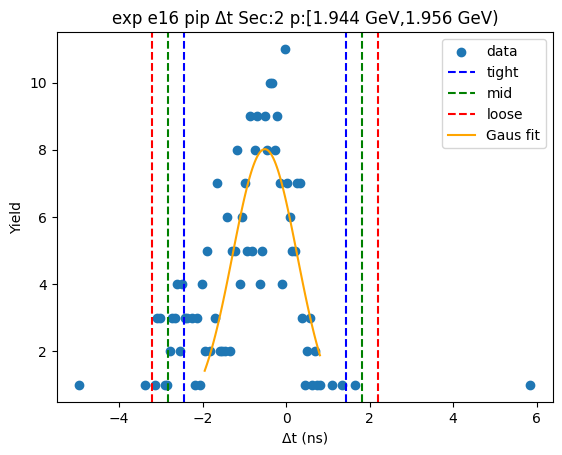

-2.287693311901105 1.4798061069462751
-2.664443253785843 1.856556048831013
-3.041193195670581 2.233305990715751
[ 8.51843698 -0.4039436   0.75349988]


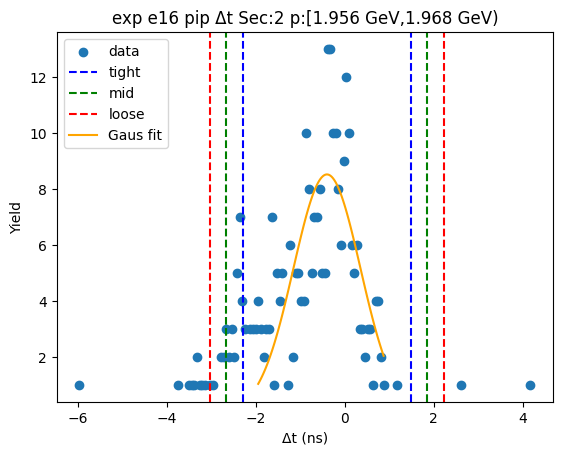

-2.5922366438418356 1.5996351776247026
-3.01142382598849 2.018822359771357
-3.4306110081351435 2.4380095419180106
[ 7.97548308 -0.49630073  0.83837436]


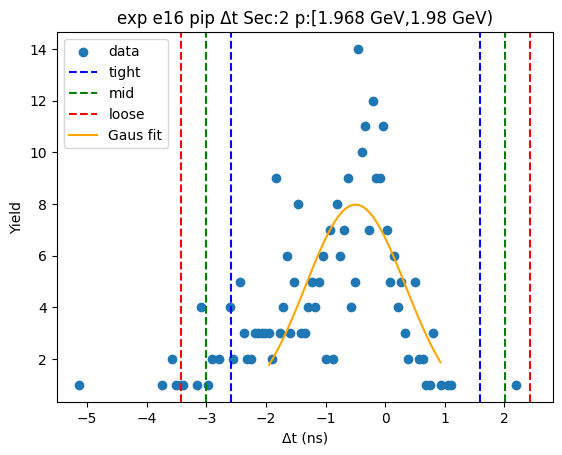

-2.4583346723682897 1.625517295512969
-2.8667198691564155 2.033902492301095
-3.2751050659445413 2.4422876890892207
[ 7.38479178 -0.41640869  0.81677039]


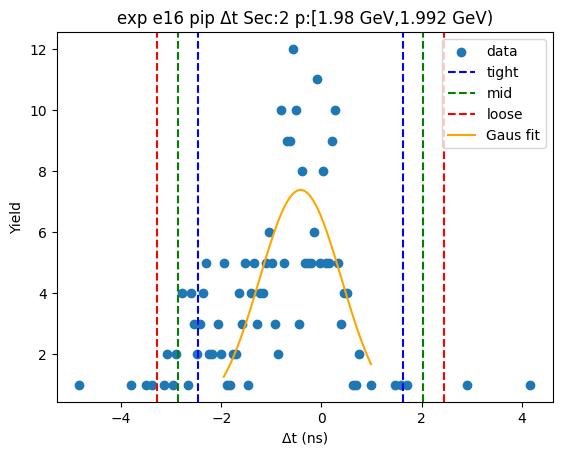

-2.386631225614326 1.5661113262566324
-2.781905480801422 1.9613855814437284
-3.1771797359885174 2.3566598366308242
[ 8.13980224 -0.41025995  0.79054851]


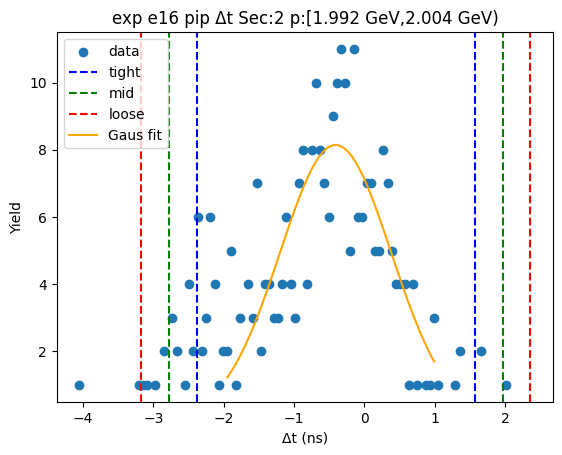

-2.1570028645230748 1.458729957930778
-2.51857614676846 1.8203032401761634
-2.880149429013845 2.1818765224215486
[ 8.61010912 -0.34913645  0.72314656]


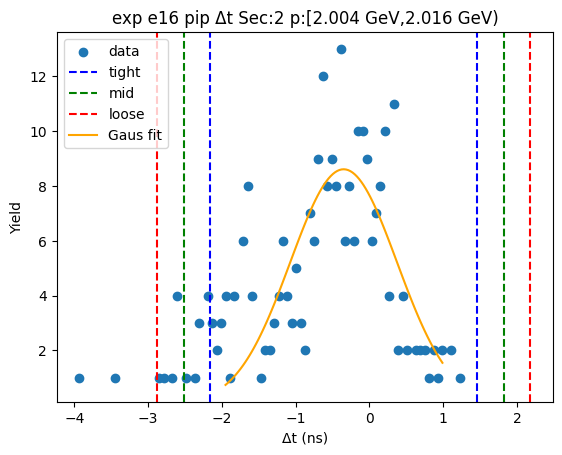

-2.9003035144150484 1.7782943734341605
-3.36816330319997 2.2461541622190815
-3.8360230919848908 2.714013951004003
[ 6.0165275  -0.56100457  0.93571958]


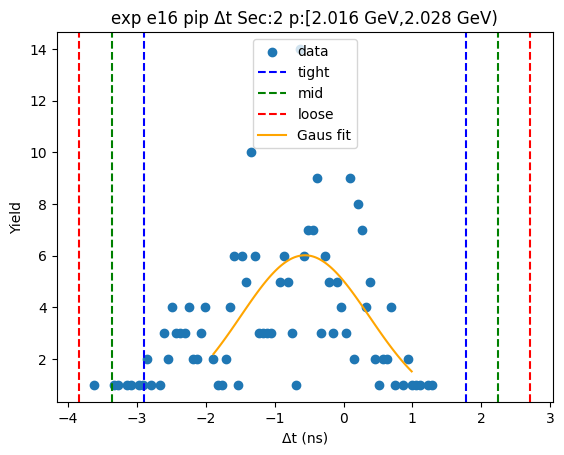

-2.352856550463155 1.2743393536183423
-2.7155761408713053 1.6370589440264922
-3.078295731279455 1.999778534434642
[ 8.29143242 -0.5392586   0.72543918]


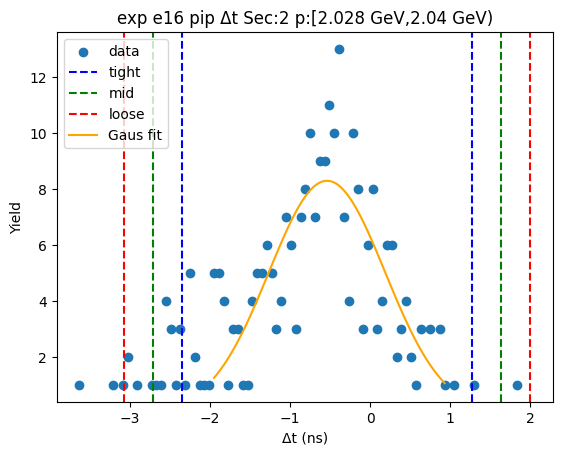

-2.9419237953656068 1.6341026582265479
-3.3995264407248222 2.0917053035857633
-3.8571290860840377 2.549307948944979
[ 6.77352731 -0.65391057  0.91520529]


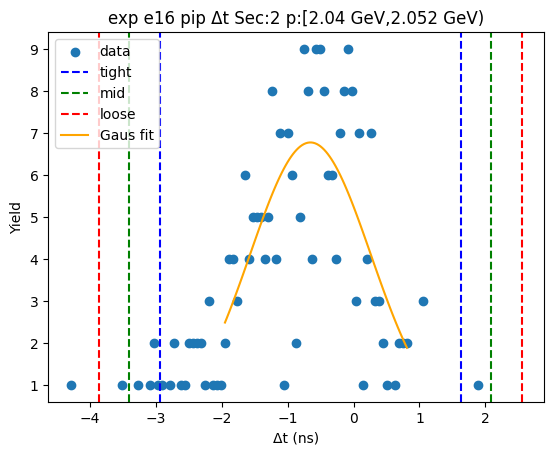

-2.2837402223570904 1.3414959759718417
-2.646263842189984 1.704019595804735
-3.0087874620228767 2.066543215637628
[ 8.15111332 -0.47112212  0.72504724]


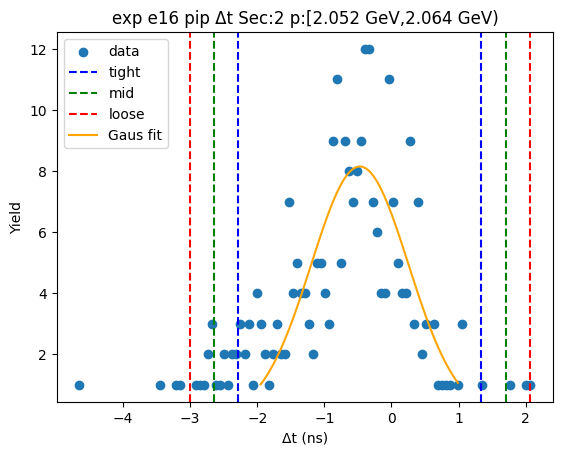

-2.743564589027941 1.712571643644612
-3.189178212295196 2.158185266911867
-3.6347918355624516 2.6037988901791222
[ 6.54146636 -0.51549647  0.89122725]


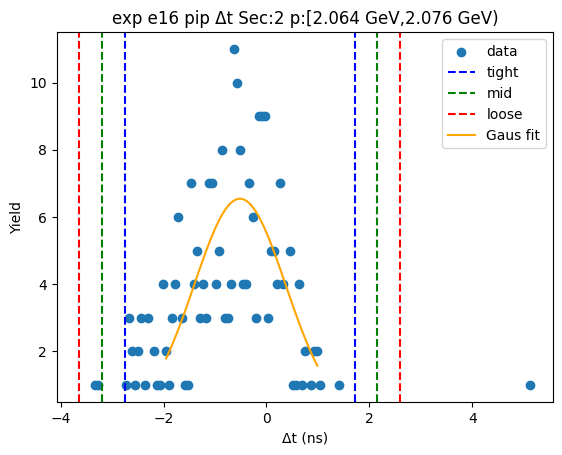

-2.583623047083885 1.6073547259533927
-3.002720824387613 2.026452503257121
-3.4218186016913408 2.4455502805608487
[ 7.26972573 -0.48813416  0.83819555]


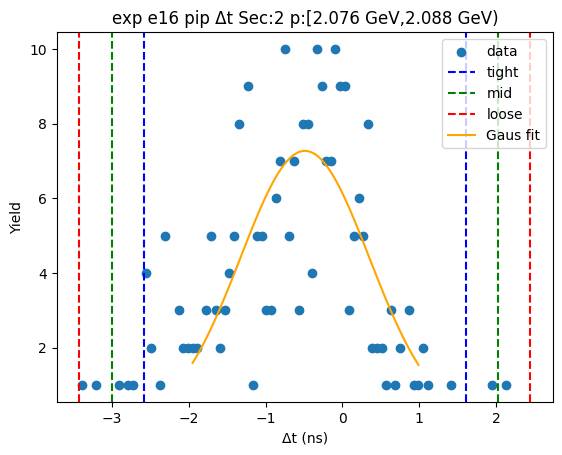

-2.526112496464934 1.5976433335118547
-2.938488079462613 2.0100189165095337
-3.350863662460292 2.4223944995072126
[ 7.15008707 -0.46423458  0.82475117]


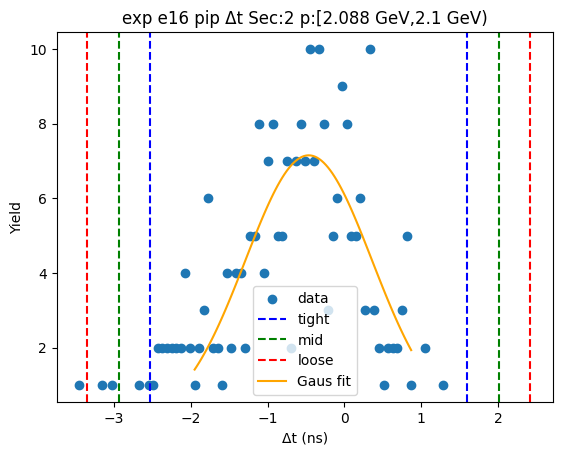

-2.321000044799584 1.3369858487235584
-2.686798634151898 1.7027844380758723
-3.0525972235042125 2.0685830274281867
[ 6.90252404 -0.4920071   0.73159718]


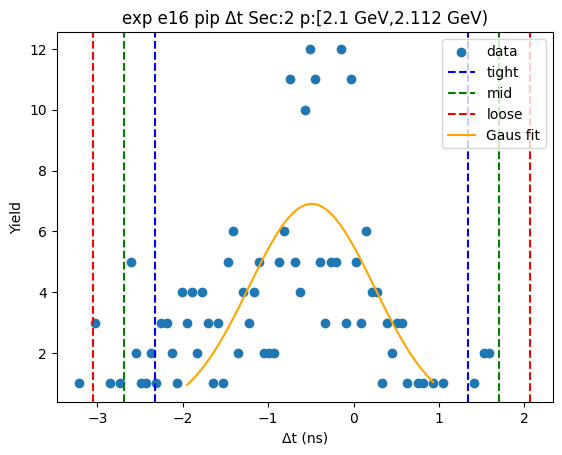

-2.601477066109097 1.840232713803263
-3.045648044100333 2.284403691794499
-3.489819022091569 2.728574669785735
[ 6.42602101 -0.38062218  0.88834196]


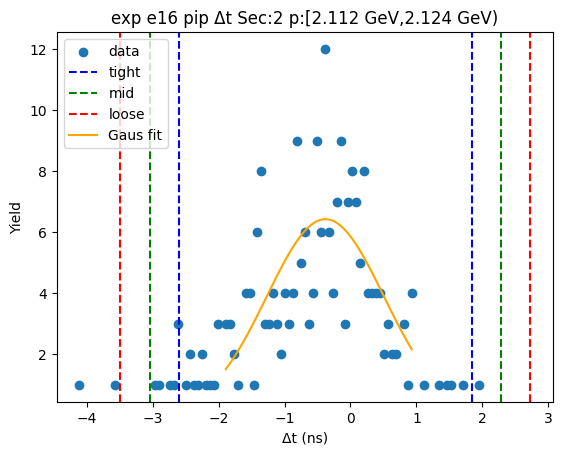

-2.2521272645252397 1.3738215384208845
-2.6147221448198525 1.7364164187154971
-2.977317025114465 2.0990112990101095
[ 6.49338607 -0.43915286  0.72518976]


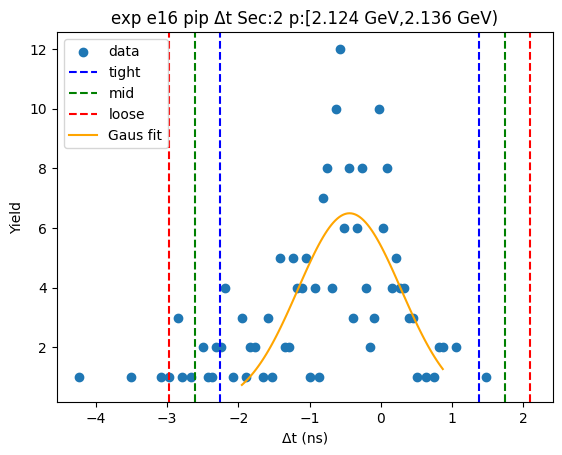

-2.3848249627370977 1.4838079233603456
-2.771688251346842 1.8706712119700901
-3.158551539956586 2.257534500579834
[ 7.0585918  -0.45050852  0.77372658]


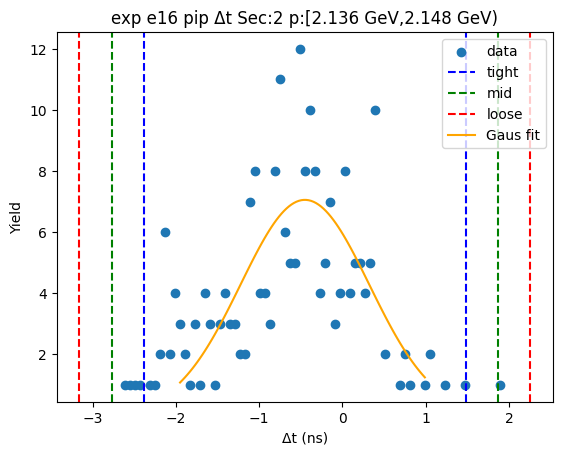

-2.4399457918672356 1.7280103265709361
-2.8567414037110526 2.144805938414753
-3.2735370155548695 2.5616015502585707
[ 6.13905415 -0.35596773  0.83359122]


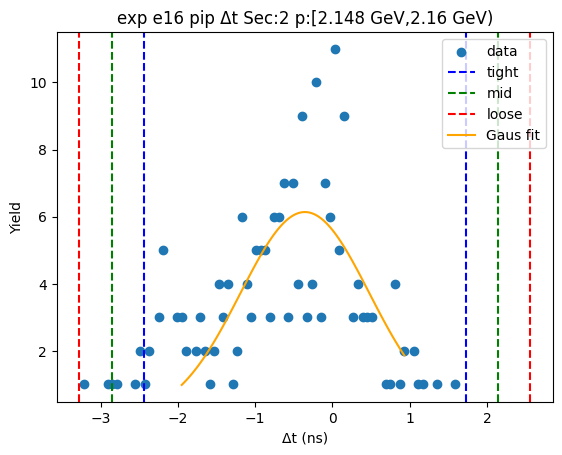

-2.8611204148249056 1.6729795896031856
-3.314530415267715 2.126389590045995
-3.767940415710524 2.579799590488804
[ 5.51073253 -0.59407041  0.90682   ]


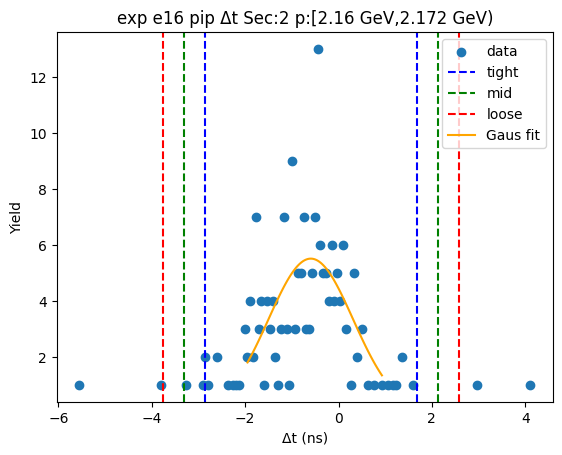

-2.3664403399606933 1.3331874243977044
-2.7364031163965326 1.7031502008335442
-3.1063658928323727 2.0731129772693837
[ 7.00390335 -0.51662646  0.73992555]


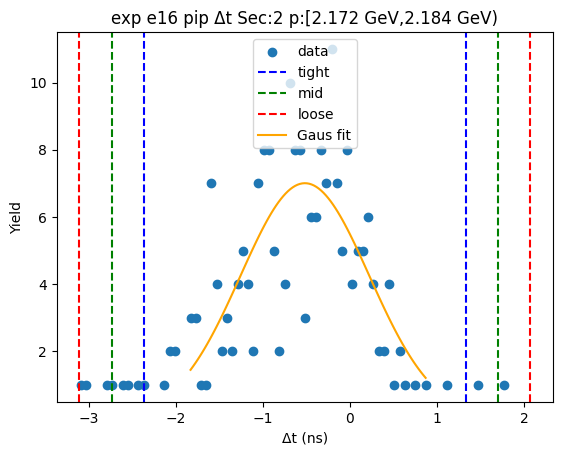

-3.2824662435813483 2.1608899806497055
-3.8268018660044536 2.7052256030728117
-4.371137488427559 3.249561225495917
[ 4.747318   -0.56078813  1.08867124]


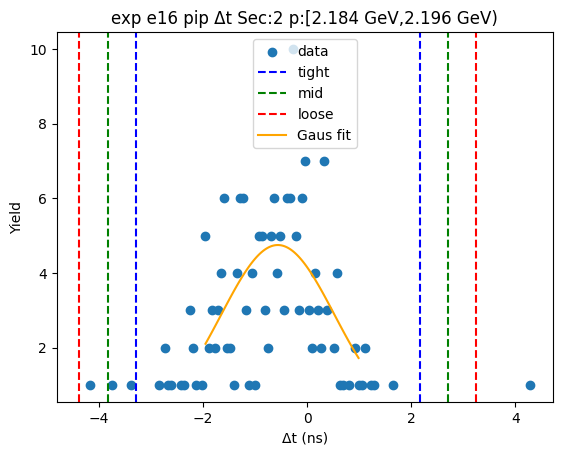

-1.1992101704224796 1.2593933984159733
-1.445070527306325 1.5052537552998186
-1.6909308841901702 1.751114112183664
[12.67148719  0.03009161  0.49172071]


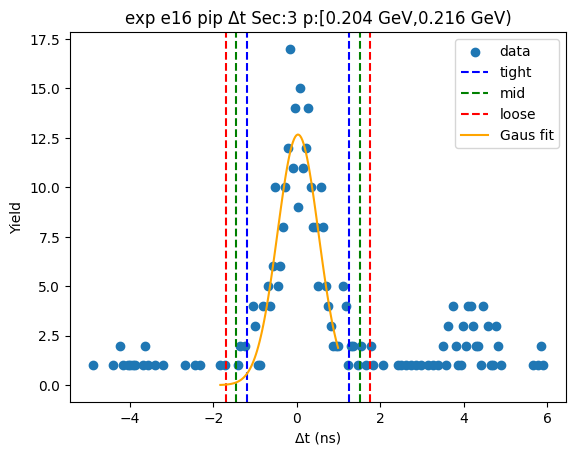

-1.2558361814601833 1.2662379483685497
-1.5080435944430566 1.518445361351423
-1.7602510074259299 1.7706527743342964
[1.82476436e+01 5.20088345e-03 5.04414826e-01]


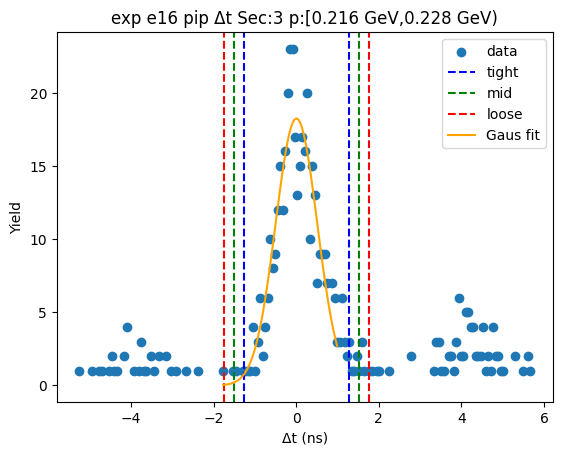

-1.1581835068470754 1.1055317924212573
-1.3845550367739086 1.3319033223480905
-1.610926566700742 1.558274852274924
[24.86433759 -0.02632586  0.45274306]


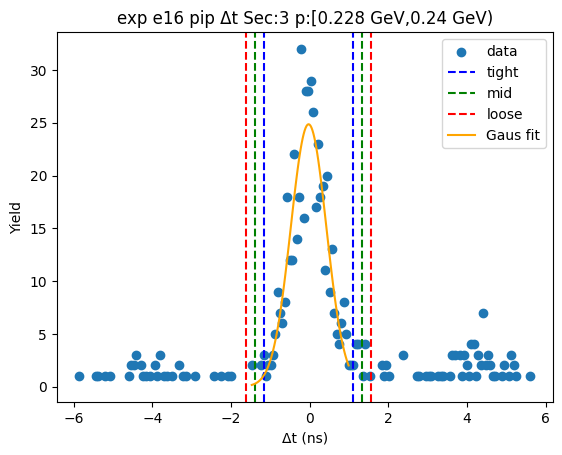

-1.1369066747297685 1.0938091513076678
-1.3599782573335122 1.3168807339114115
-1.5830498399372557 1.539952316515155
[ 3.81188189e+01 -2.15487617e-02  4.46143165e-01]


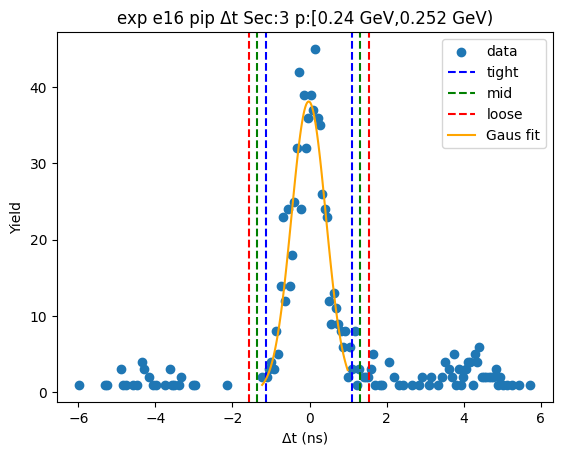

-1.3037988244466605 1.1479447680733117
-1.5489731836986576 1.3931191273253087
-1.7941475429506548 1.638293486577306
[46.60654448 -0.07792703  0.49034872]


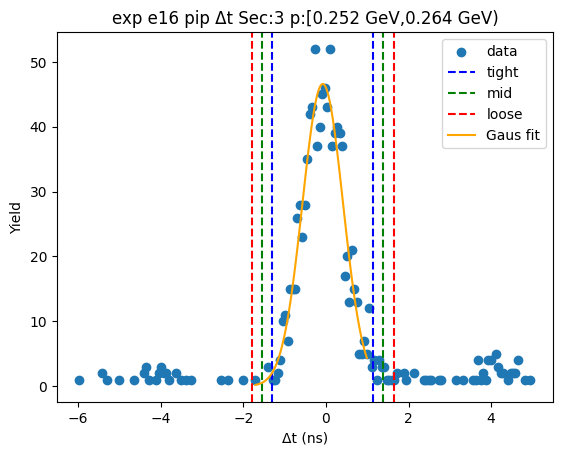

-1.1766356692567943 1.0226490446947725
-1.3965641406519511 1.2425775160899293
-1.616492612047108 1.462505987485086
[71.83677414 -0.07699331  0.43985694]


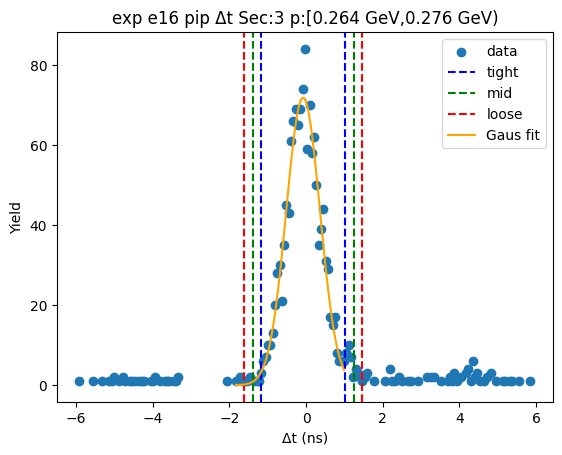

-1.197115360400491 0.9924538135481159
-1.4160722777953516 1.2114107309429765
-1.6350291951902123 1.4303676483378371
[78.84702301 -0.10233077  0.43791383]


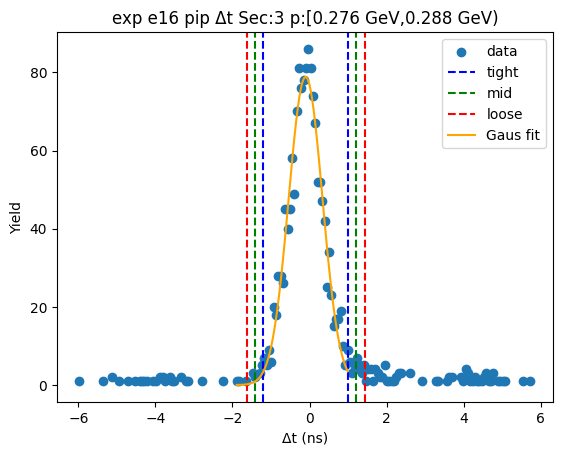

-1.2232223210378028 1.0272053387323465
-1.448265087014818 1.2522481047093617
-1.6733078529918328 1.4772908706863765
[83.67309478 -0.09800849  0.45008553]


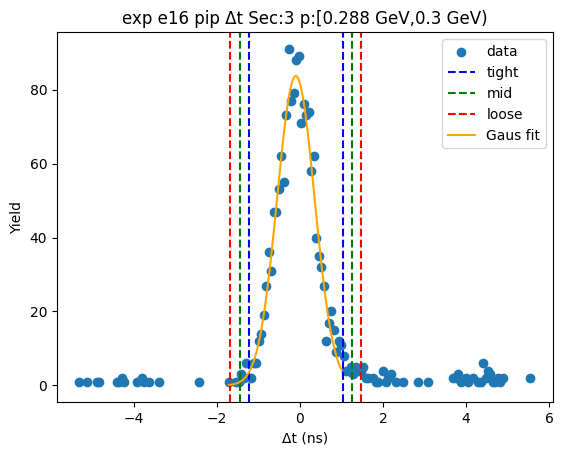

-1.095910087662412 0.9462750746304832
-1.3001286038917015 1.1504935908597727
-1.504347120120991 1.3547121070890622
[ 1.06106728e+02 -7.48175065e-02  4.08437032e-01]


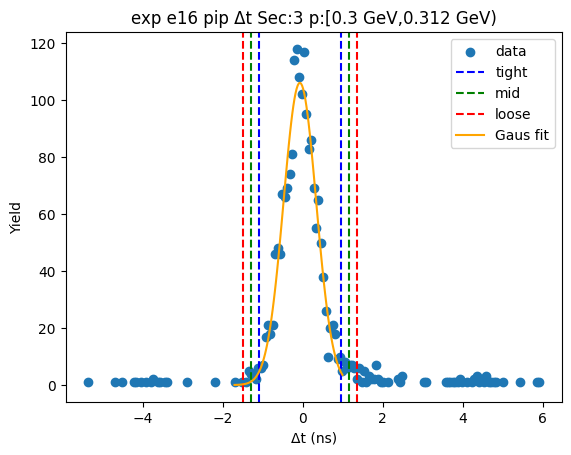

-1.1572285693682467 0.9827310372898386
-1.3712245300340553 1.1967269979556472
-1.5852204906998637 1.4107229586214556
[ 1.04362190e+02 -8.72487660e-02  4.27991921e-01]


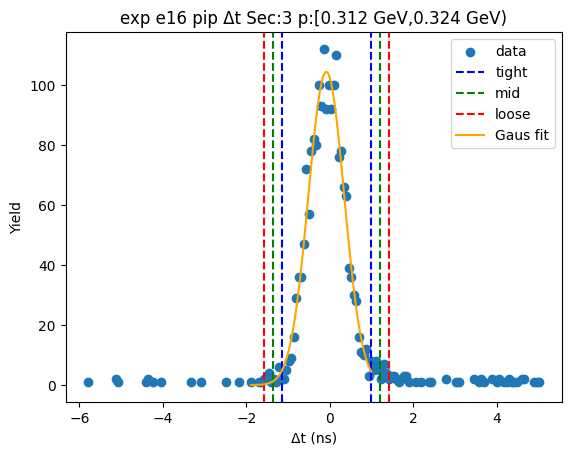

-1.1686608912444003 0.9349546190625823
-1.3790224422750987 1.1453161700932806
-1.589383993305797 1.3556777211239788
[113.88170796  -0.11685314   0.4207231 ]


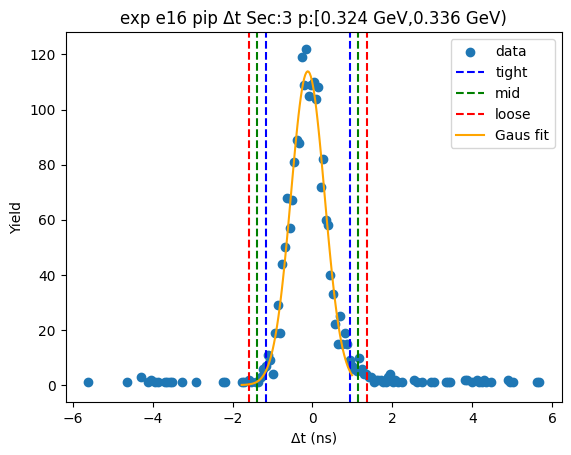

-1.1595332268326581 0.9252510719489782
-1.3680116567108218 1.1337295018271418
-1.5764900865889855 1.3422079317053055
[ 1.22197336e+02 -1.17141077e-01  4.16956860e-01]


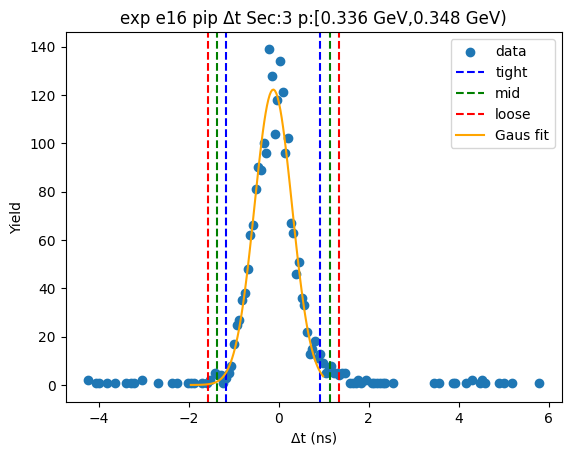

-1.1452835361259246 0.9282049294978685
-1.3526323826883038 1.1355537760602477
-1.559981229250683 1.3429026226226268
[ 1.25578321e+02 -1.08539303e-01  4.14697693e-01]


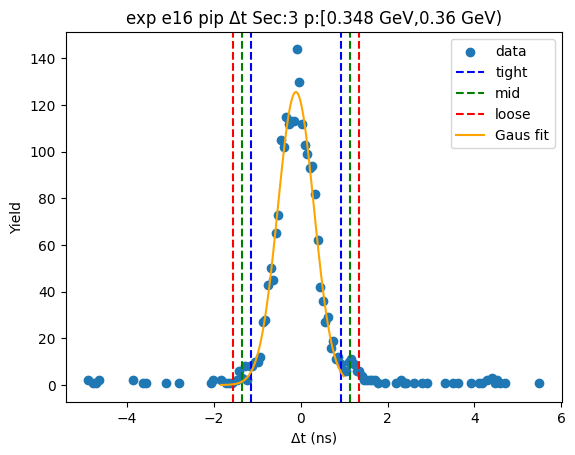

-1.1353256510456915 0.9642281041363616
-1.3452810265638968 1.174183479654567
-1.5552364020821021 1.3841388551727722
[ 1.33249501e+02 -8.55487735e-02  4.19910751e-01]


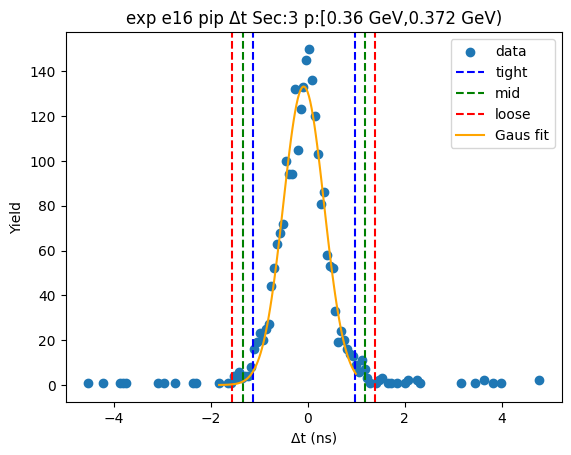

-1.102526919758803 0.9272452974131734
-1.3055041414760007 1.130222519130371
-1.5084813631931984 1.3331997408475686
[ 1.36830950e+02 -8.76408112e-02  4.05954443e-01]


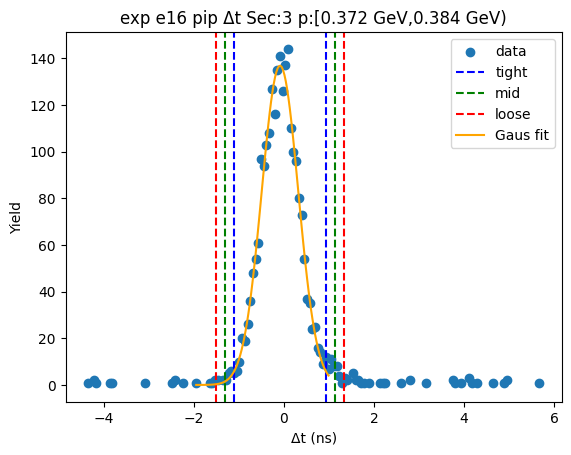

-1.0800870897016082 0.9358337824854651
-1.2816791769203155 1.1374258697041724
-1.4832712641390229 1.3390179569228797
[ 1.45655510e+02 -7.21266536e-02  4.03184174e-01]


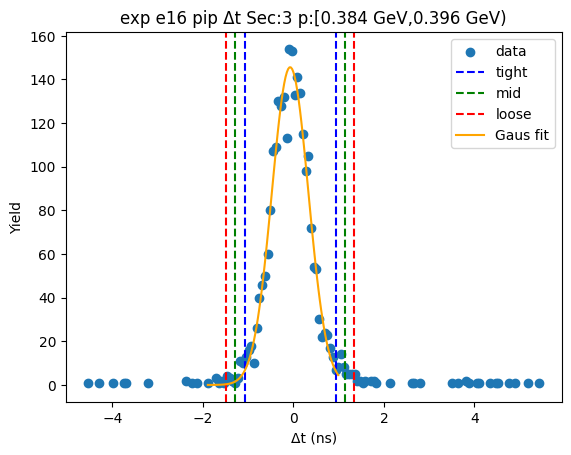

-1.0506123639413092 0.9536524704253649
-1.2510388473779765 1.1540789538620322
-1.451465330814644 1.3545054372986995
[ 1.39985923e+02 -4.84799468e-02  4.00852967e-01]


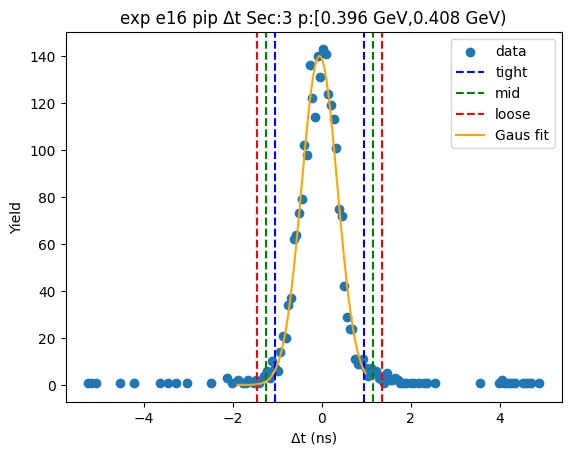

-1.031661872363918 0.9169892573585061
-1.2265269853361604 1.1118543703307484
-1.421392098308403 1.306719483302991
[ 1.51989021e+02 -5.73363075e-02  3.89730226e-01]


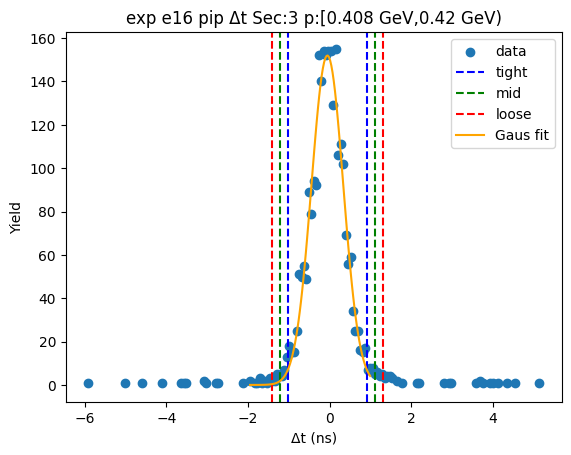

-1.1474848017404595 0.9230990648851958
-1.354543188403025 1.1301574515477613
-1.5616015750655905 1.3372158382103267
[ 1.50252292e+02 -1.12192868e-01  4.14116773e-01]


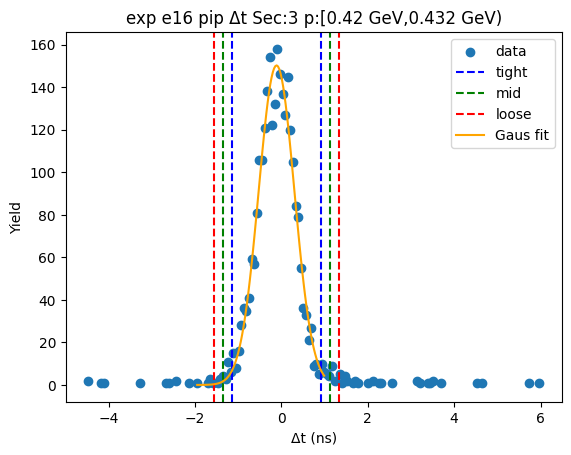

-1.1709084775378946 0.9286924319120129
-1.3808685684828852 1.1386525228570035
-1.590828659427876 1.3486126138019943
[ 1.44375615e+02 -1.21108023e-01  4.19920182e-01]


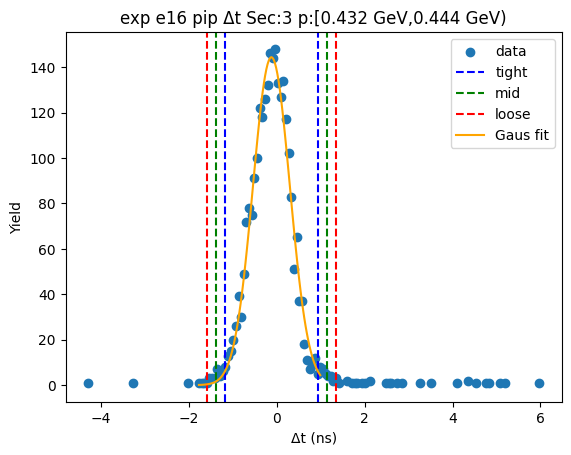

-1.241385287658452 0.9201255512508211
-1.4575363715493792 1.1362766351417484
-1.6736874554403065 1.3524277190326757
[145.50605061  -0.16062987   0.43230217]


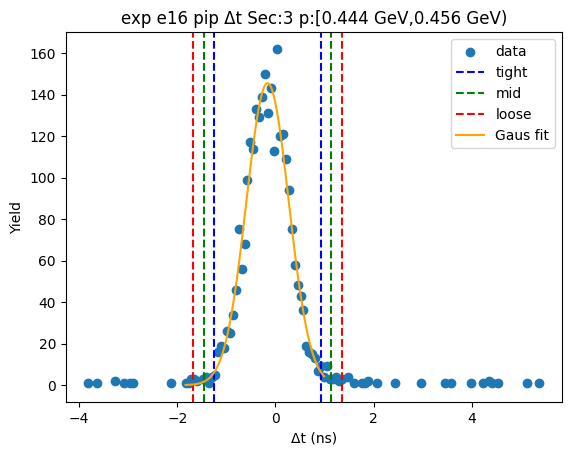

-1.1677330450246557 0.8426948654902637
-1.3687758360761475 1.0437376565417555
-1.5698186271276393 1.2447804475932474
[153.76551074  -0.16251909   0.40208558]


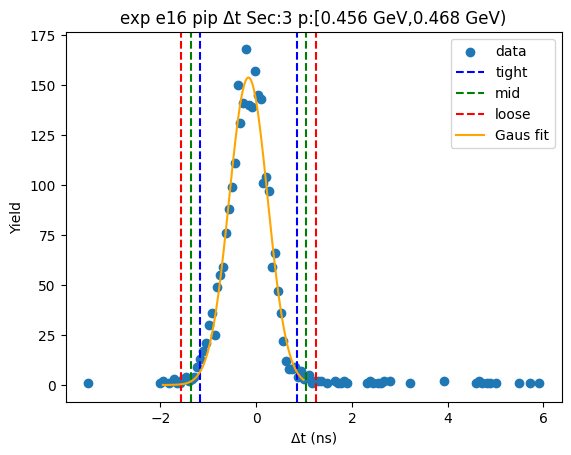

-1.2267517304454212 0.8646900450063079
-1.4358959079905942 1.073834222551481
-1.6450400855357672 1.2829784000966535
[152.42579083  -0.18103084   0.41828836]


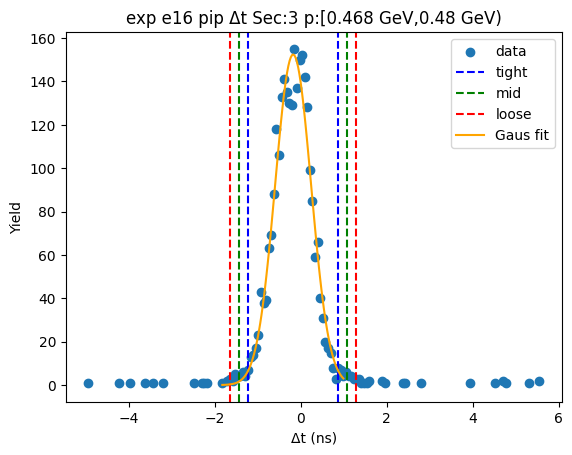

-1.260780200853635 0.8957095340494808
-1.4764291743439466 1.1113585075397923
-1.6920781478342581 1.3270074810301038
[143.93625393  -0.18253533   0.43129795]


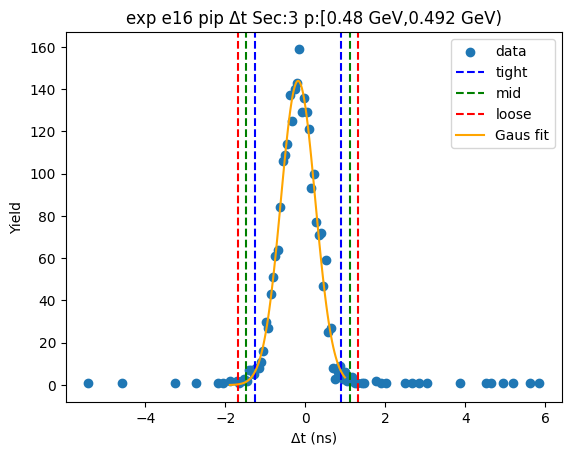

-1.220669580139743 0.8330788467414411
-1.4260444228278613 1.0384536894295593
-1.6314192655159796 1.2438285321176776
[149.16150353  -0.19379537   0.41074969]


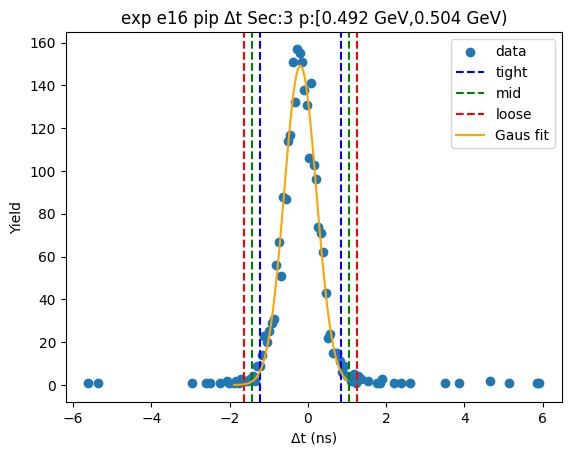

-1.2190900272365692 0.8367738647690051
-1.4246764164371268 1.0423602539695627
-1.6302628056376842 1.24794664317012
[150.14050705  -0.19115808   0.41117278]


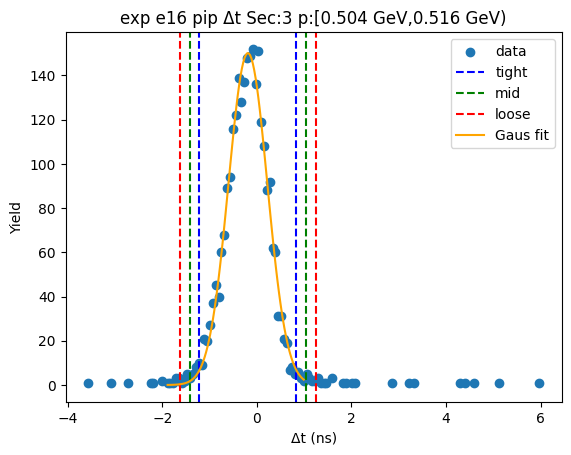

-1.2403194387238772 0.8744594672947299
-1.451797329325738 1.0859373578965907
-1.6632752199275989 1.2974152484984516
[148.14233424  -0.18292999   0.42295578]


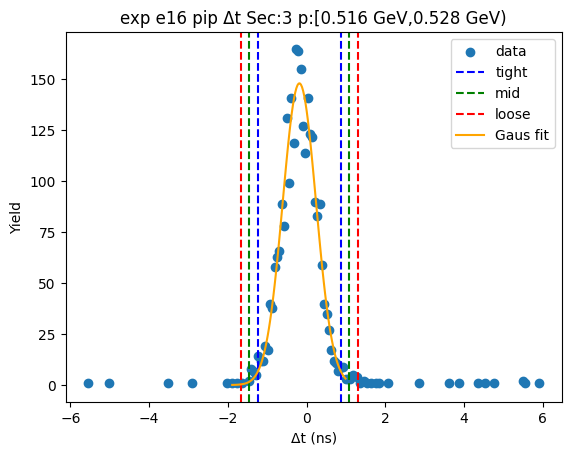

-1.1819376229645222 0.81795506659473
-1.3819268919204473 1.0179443355506552
-1.5819161608763725 1.2179336045065805
[150.83978614  -0.18199128   0.39997854]


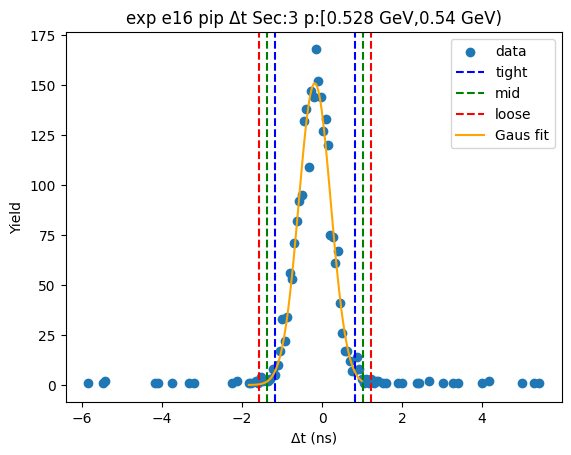

-1.2061837326421534 0.796910774313413
-1.40649318333771 0.9972202250089695
-1.6068026340332664 1.197529675704526
[149.91205486  -0.20463648   0.4006189 ]


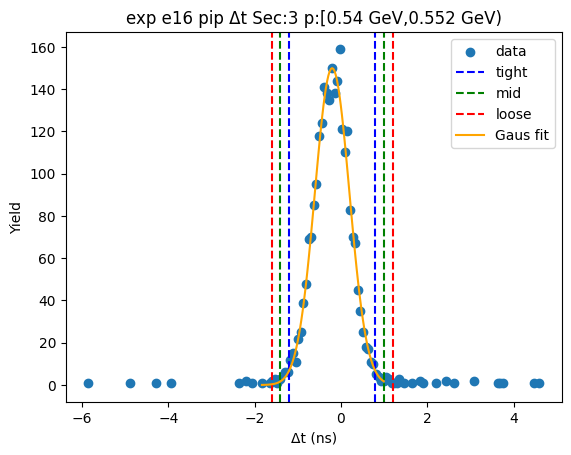

-1.2241732659081739 0.8198355610062633
-1.4285741485996175 1.024236443697707
-1.6329750312910614 1.2286373263891508
[146.61120359  -0.20216885   0.40880177]


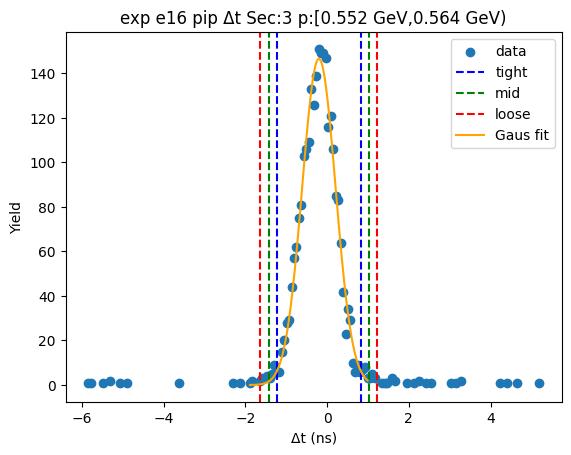

-1.1889968570464498 0.7517811829407332
-1.383074661045168 0.9458589869394514
-1.5771524650438864 1.1399367909381697
[152.87848079  -0.21860784   0.38815561]


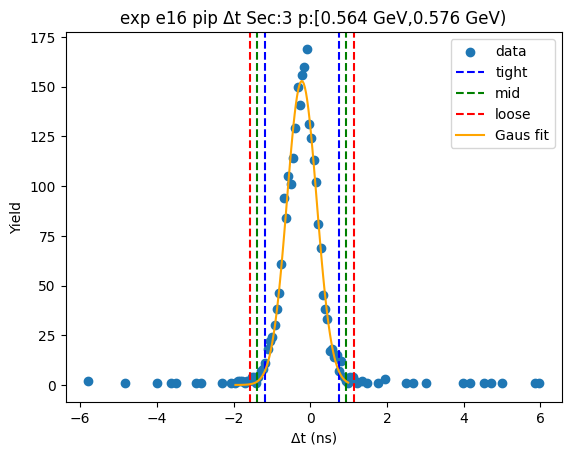

-1.197279334607689 0.7400849288789697
-1.3910157609563552 0.9338213552276358
-1.584752187305021 1.1275577815763016
[150.10389066  -0.2285972    0.38747285]


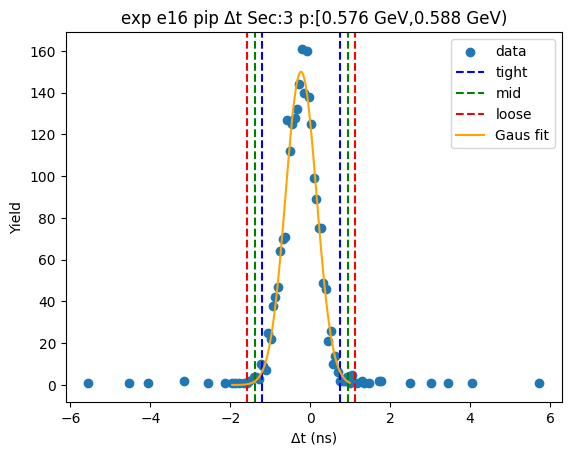

-1.2046889826519223 0.7806489071712466
-1.4032227716342391 0.9791826961535635
-1.601756560616556 1.1777164851358803
[127.55306751  -0.21202004   0.39706758]


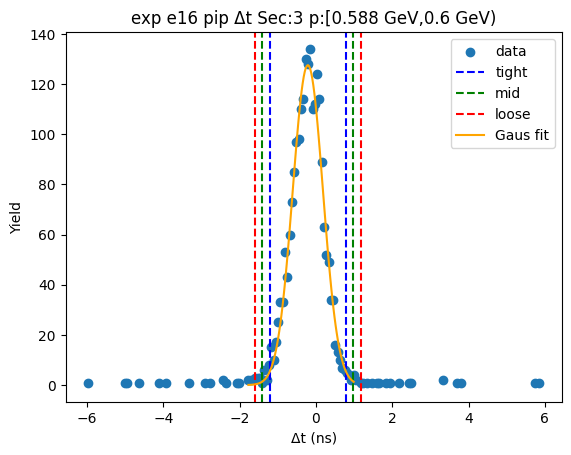

-1.1102054530757732 0.7325000020166691
-1.2944759985850174 0.9167705475259132
-1.4787465440942618 1.1010410930351577
[115.71347524  -0.18885273   0.36854109]


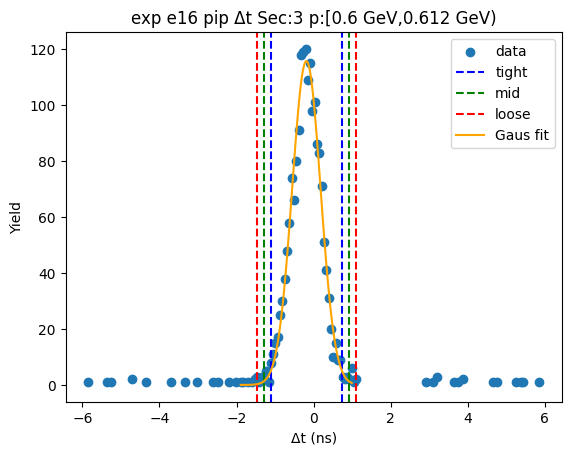

-1.1470359661514404 0.7777668223994753
-1.339516245006532 0.9702471012545669
-1.5319965238616235 1.1627273801096585
[105.49665136  -0.18463457   0.38496056]


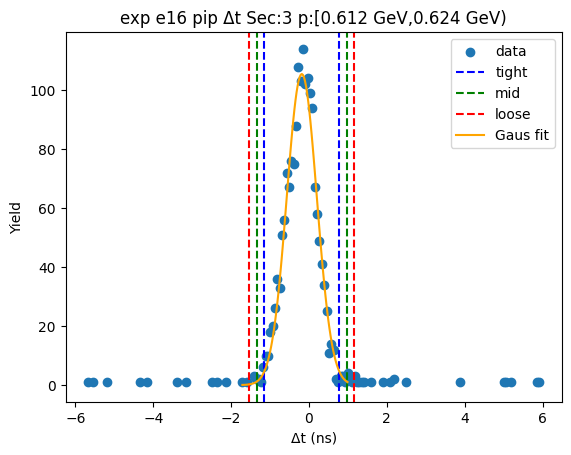

-1.0959658677634234 0.7149592300299927
-1.2770583775427649 0.8960517398093342
-1.4581508873221065 1.0771442495886758
[105.28598103  -0.19050332   0.36218502]


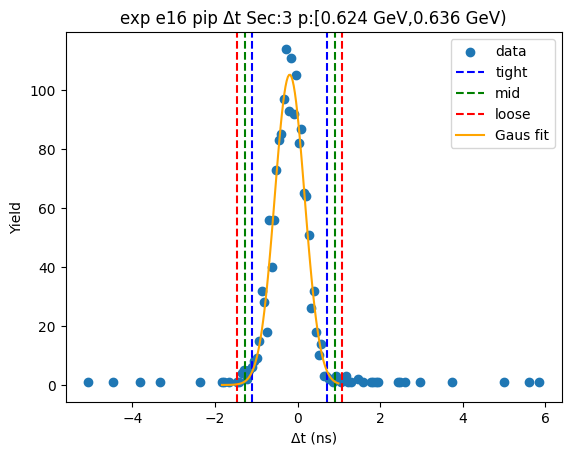

-1.1960204240085726 0.7630901477809103
-1.391931481187521 0.9590012049598586
-1.5878425383664692 1.1549122621388068
[87.541943   -0.21646514  0.39182211]


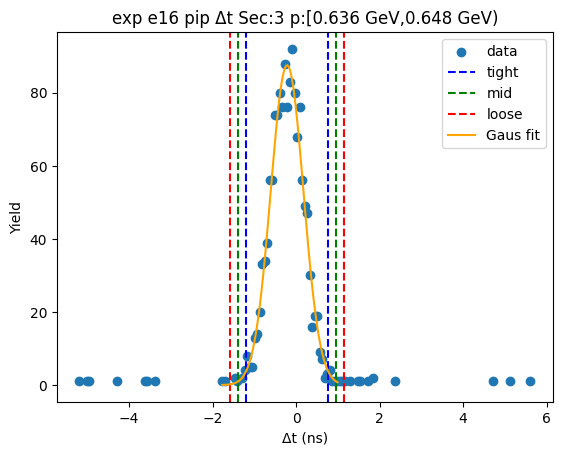

-1.1281129011102755 0.737032871207382
-1.3146274783420413 0.9235474484391477
-1.501142055573807 1.1100620256709135
[91.32492569 -0.19554001  0.37302915]


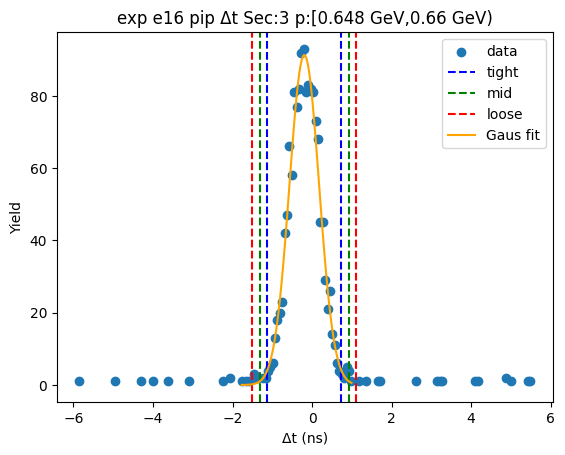

-1.2177995581271626 0.7413102930006611
-1.413710543239945 0.9372212781134435
-1.6096215283527273 1.1331322632262257
[96.50829668 -0.23824463  0.39182197]


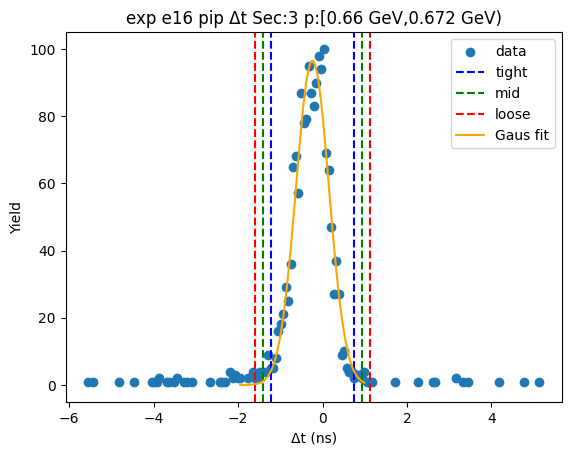

-1.2606788998124492 0.7805936772078647
-1.4648061575144804 0.9847209349098959
-1.6689334152165118 1.1888481926119274
[93.62544053 -0.24004261  0.40825452]


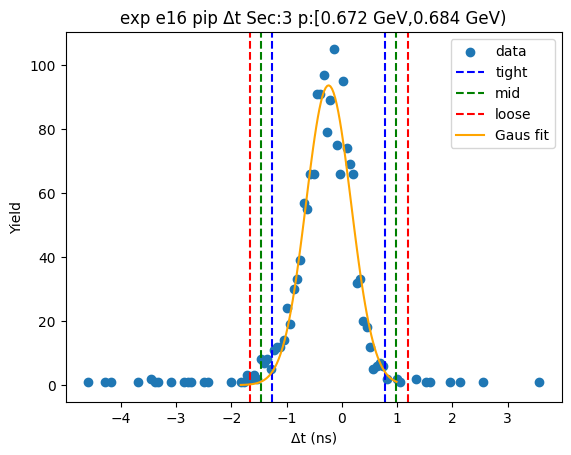

-1.2114420530069718 0.6911811124942895
-1.4017043695570979 0.8814434290444155
-1.5919666861072241 1.0717057455945418
[104.62931232  -0.26013047   0.38052463]


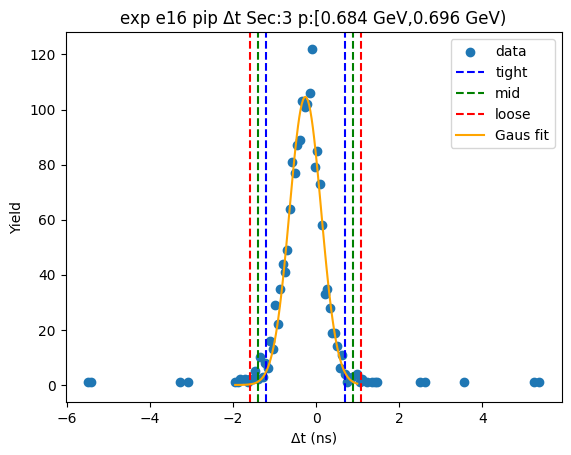

-1.29504273850806 0.7446913637701726
-1.4990161487358833 0.9486647739979959
-1.7029895589637065 1.152638184225819
[97.08675261 -0.27517569  0.40794682]


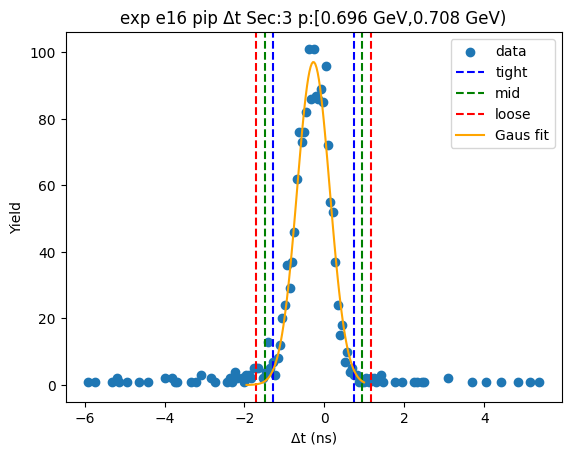

-1.326468540545317 0.7726319598709745
-1.536378590586946 0.9825420099126037
-1.7462886406285751 1.1924520599542328
[93.46541314 -0.27691829  0.4198201 ]


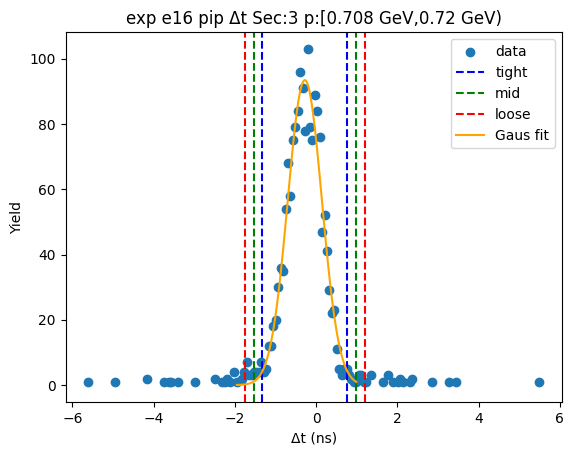

-1.2897559850823161 0.7537366848023291
-1.4941052520707805 0.9580859517907935
-1.6984545190592448 1.1624352187792582
[90.56894535 -0.26800965  0.40869853]


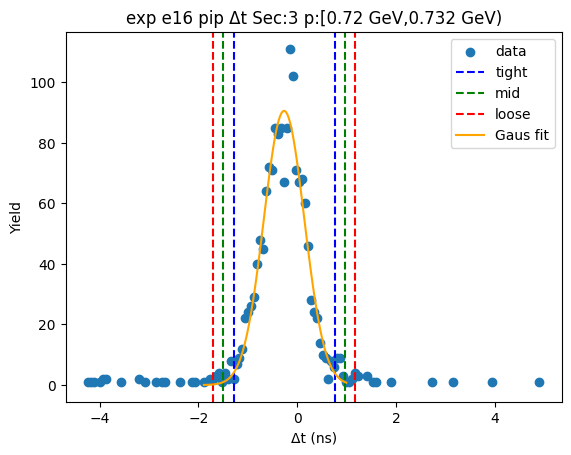

-1.3209497598868247 0.7930250889762598
-1.532347244773133 1.004422573862568
-1.7437447296594415 1.2158200587488766
[87.54018322 -0.26396234  0.42279497]


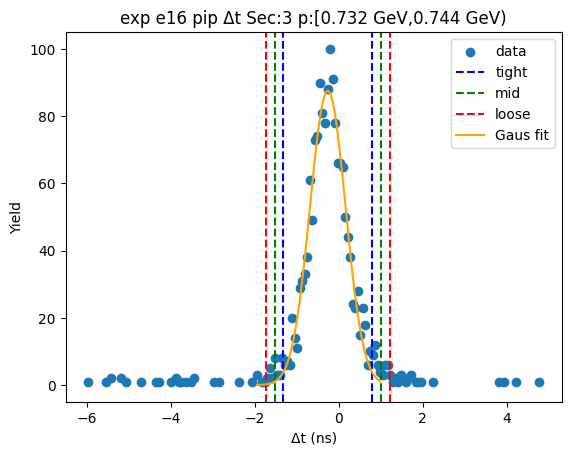

-1.3558315626383597 0.8760443524253078
-1.5790191541447265 1.0992319439316747
-1.8022067456510933 1.3224195354380415
[79.27044004 -0.23989361  0.44637518]


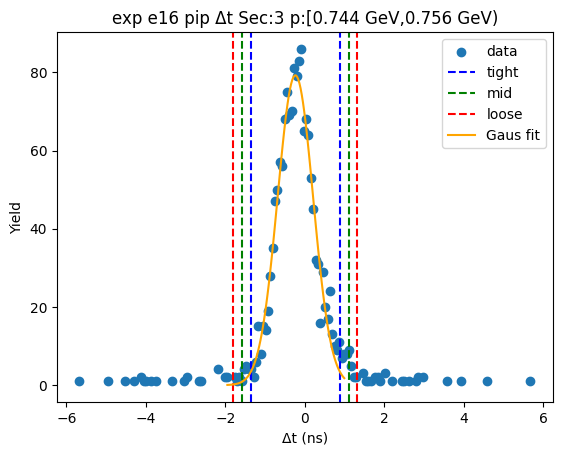

-1.43124636829653 0.953415157399208
-1.6697125208661039 1.191881309968782
-1.9081786734356778 1.4303474625383559
[75.4871115  -0.23891561  0.47693231]


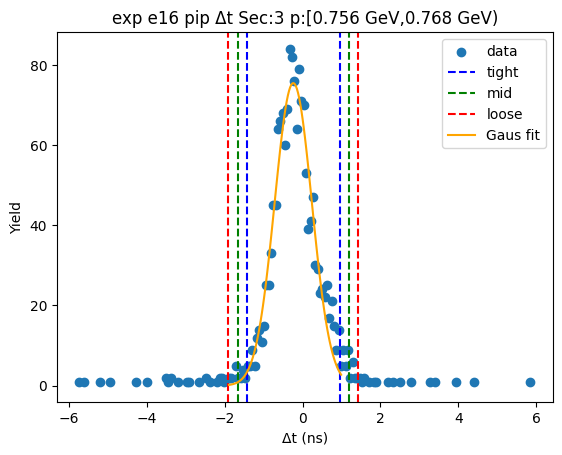

-1.398702933643692 0.9787302560068392
-1.6364462526087453 1.2164735749718925
-1.8741895715737984 1.4542168939369455
[73.55387992 -0.20998634  0.47548664]


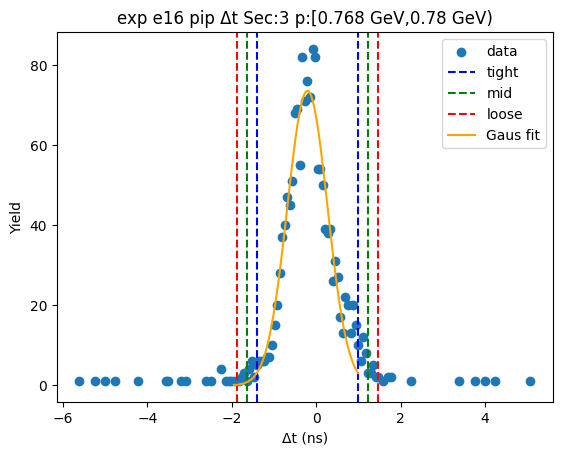

-1.4794213425767615 1.0047762372228228
-1.7278411005567198 1.2531959952027811
-1.976260858536678 1.5016157531827394
[71.75321596 -0.23732255  0.49683952]


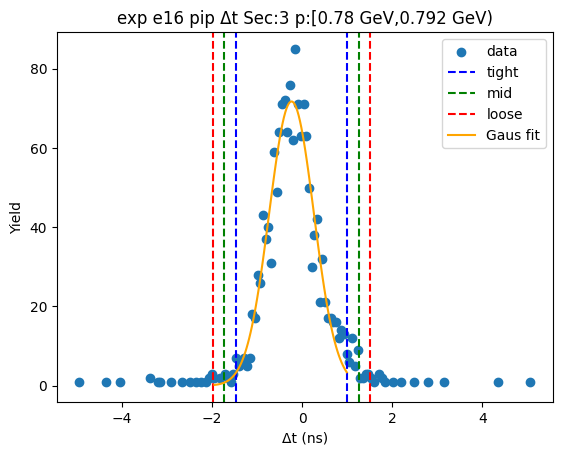

-1.5007009488918164 0.9641501714161733
-1.7471860609226153 1.2106352834469722
-1.9936711729534142 1.4571203954777712
[66.71109766 -0.26827539  0.49297022]


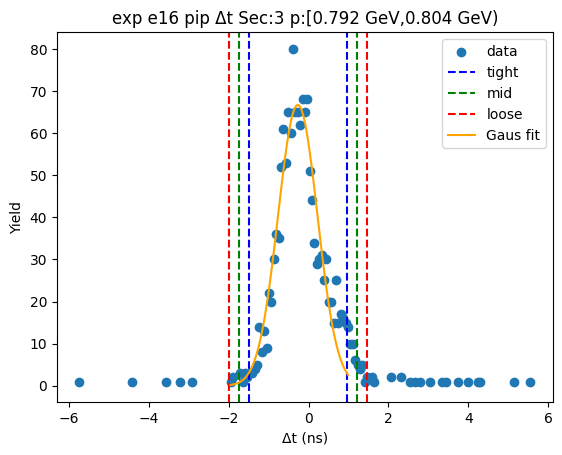

-1.414248205601965 0.8033933153579328
-1.6360123576979548 1.0251574674539223
-1.8577765097939443 1.2469216195499122
[71.7181695  -0.30542745  0.4435283 ]


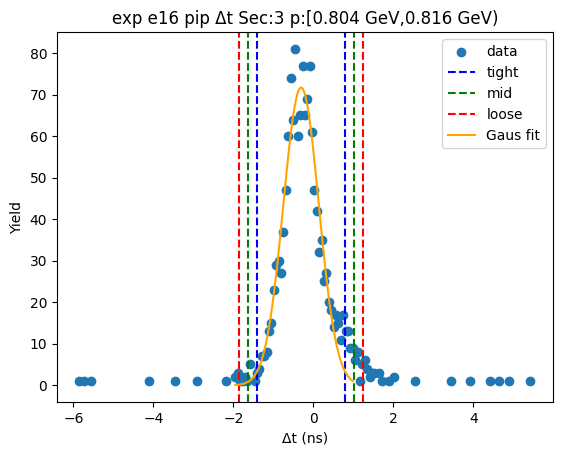

-1.3726895016966014 0.7735449474657581
-1.5873129466128375 0.9881683923819942
-1.8019363915290736 1.2027918372982302
[74.32368648 -0.29957228  0.42924689]


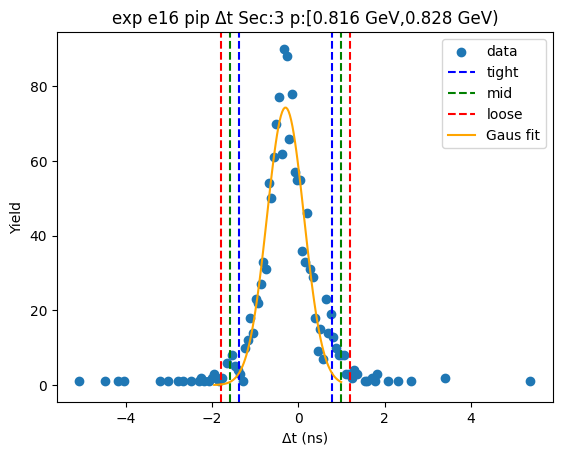

-1.3478367342861644 0.7656120256648363
-1.5591816102812648 0.9769569016599365
-1.7705264862763648 1.1883017776550369
[71.43458307 -0.29111235  0.42268975]


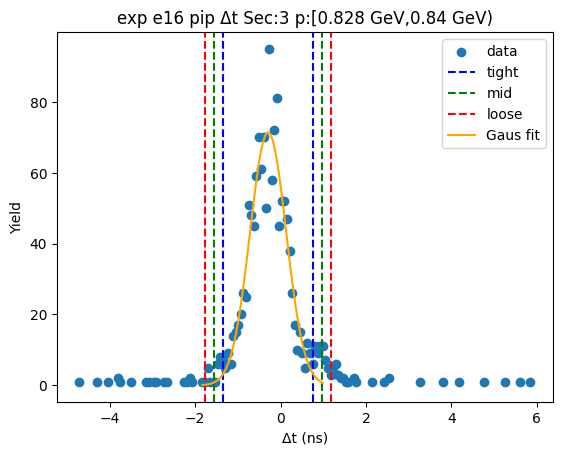

-1.4657073588328224 0.8863960046856743
-1.700917695184672 1.1216063410375239
-1.9361280315365217 1.3568166773893735
[65.08801216 -0.28965568  0.47042067]


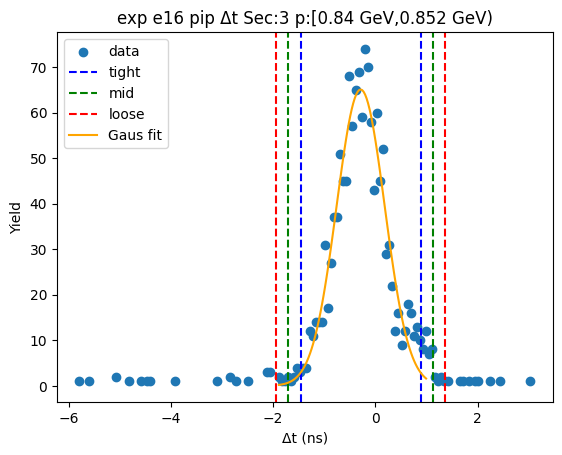

-1.4738985968715632 0.857488767946821
-1.7070373333534017 1.0906275044286595
-1.9401760698352402 1.323766240910498
[67.80423809 -0.30820491  0.46627747]


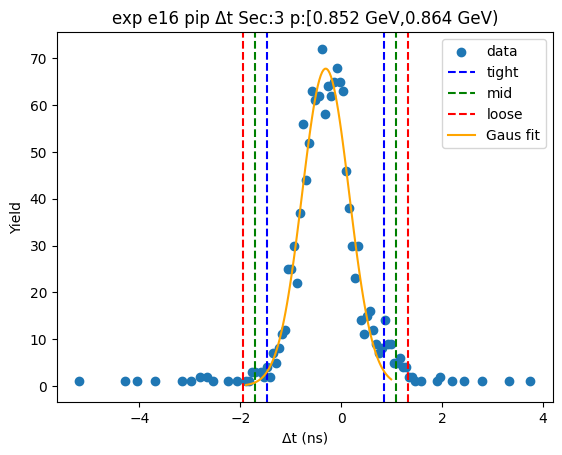

-1.4366920431502228 0.8161754190633626
-1.6619787893715814 1.0414621652847211
-1.88726553559294 1.2667489115060797
[65.09830713 -0.31025831  0.45057349]


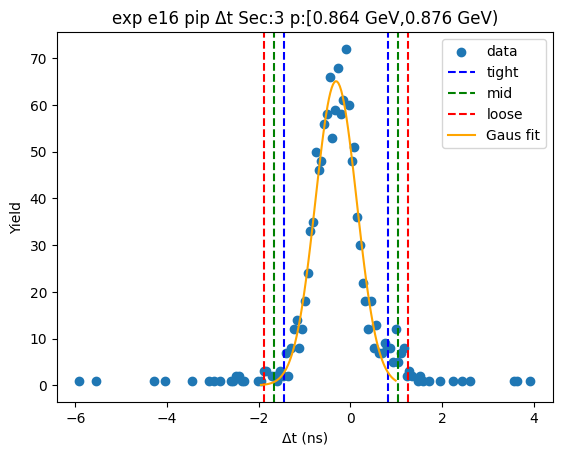

-1.373214682722402 0.7879290109602025
-1.5893290520906627 1.0040433803284632
-1.8054434214589232 1.2201577496967233
[69.42314674 -0.29264284  0.43222874]


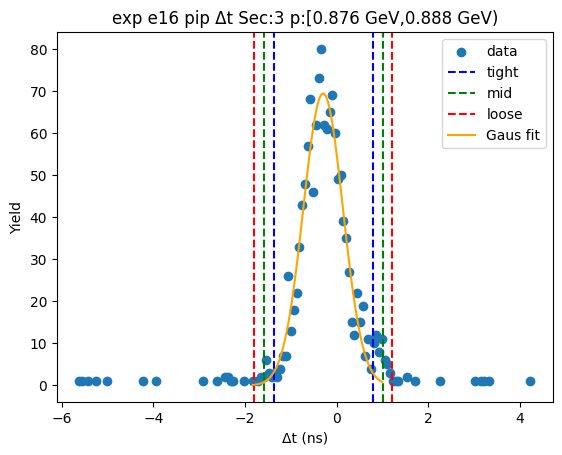

-1.4030599059436777 0.8166467461536642
-1.6250305711534119 1.0386174113633984
-1.847001236363146 1.2605880765731325
[61.72269931 -0.29320658  0.44394133]


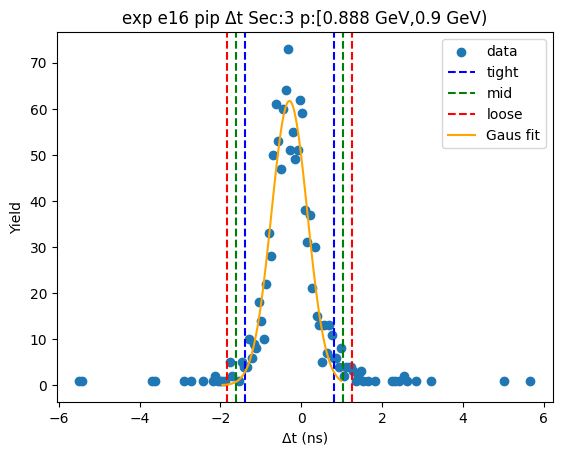

-1.3959361869670428 0.7720191375086658
-1.6127317194146136 0.9888146699562366
-1.8295272518621846 1.2056102024038076
[62.20508085 -0.31195852  0.43359106]


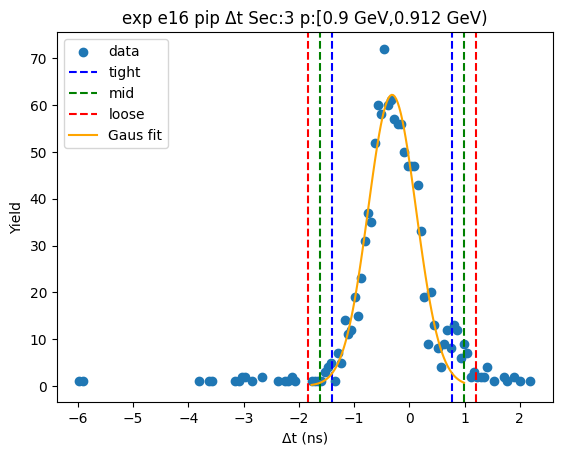

-1.3686460132812466 0.770534095272674
-1.5825640241366385 0.984452106128066
-1.7964820349920307 1.1983701169834582
[62.74356835 -0.29905596  0.42783602]


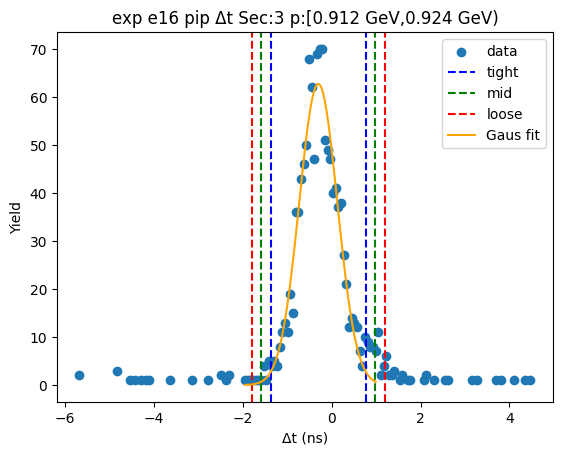

-1.3443155403814717 0.8079968889179885
-1.5595467833114176 1.0232281318479344
-1.7747780262413635 1.2384593747778803
[63.18824812 -0.26815933  0.43046249]


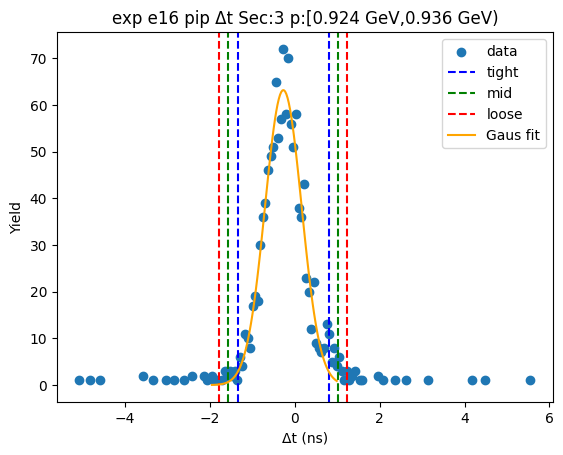

-1.4245341206102555 0.8395232101712441
-1.6509398536884055 1.0659289432493941
-1.8773455867665554 1.292334676327544
[55.96871834 -0.29250546  0.45281147]


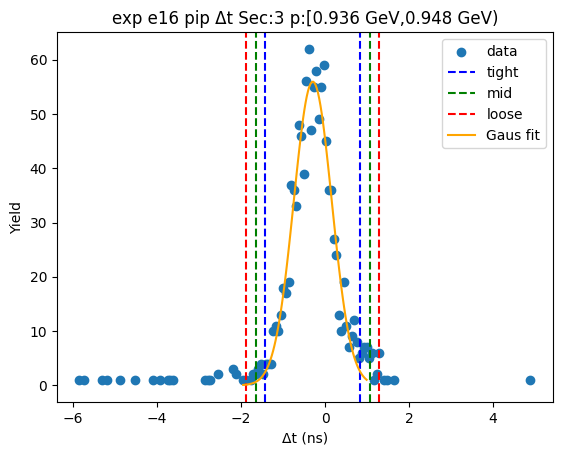

-1.3982440784923946 0.8776471638948562
-1.6258332027311195 1.105236288133581
-1.8534223269698447 1.3328254123723062
[55.39276462 -0.26029846  0.45517825]


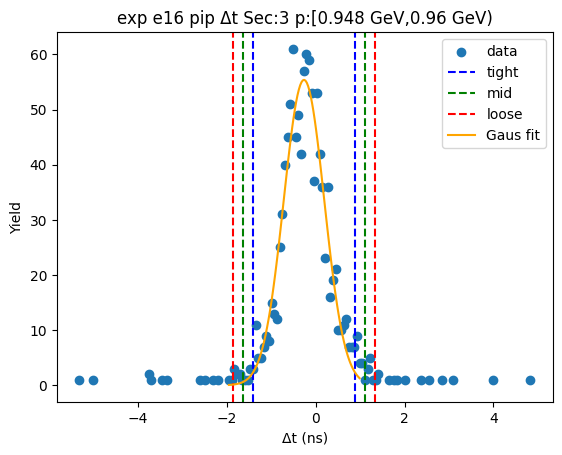

-1.3648875478335833 0.8398612052117631
-1.5853624231381178 1.0603360805162976
-1.8058372984426525 1.2808109558208323
[53.75408672 -0.26251317  0.44094975]


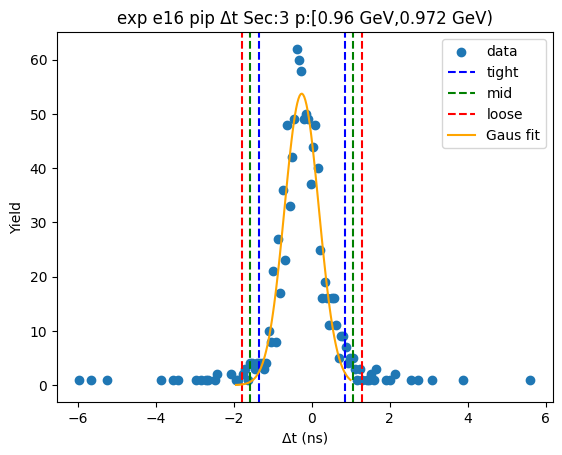

-1.3891148655683148 0.8581074631757744
-1.6138370984427237 1.0828296960501833
-1.8385593313171327 1.3075519289245923
[55.57457888 -0.2655037   0.44944447]


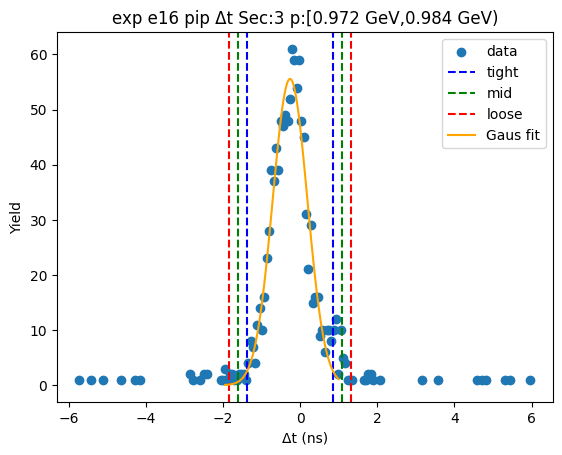

-1.313100774539265 0.7665916284160771
-1.521070014834799 0.9745608687116113
-1.7290392551303335 1.1825301090071454
[57.49219389 -0.27325457  0.41593848]


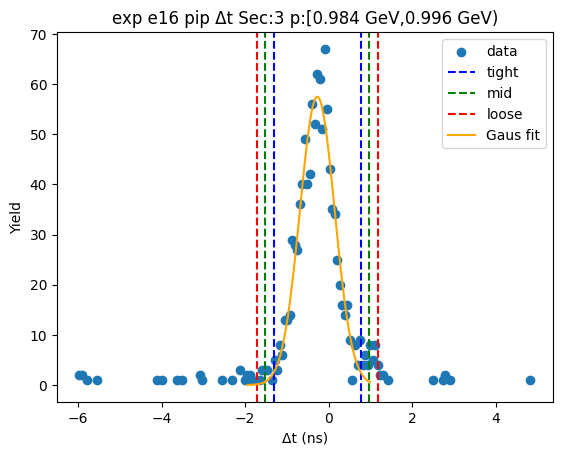

-1.3620556927765362 0.8122190490246533
-1.5794831669566551 1.0296465232047722
-1.7969106411367741 1.2470739973848912
[51.90135544 -0.27491832  0.43485495]


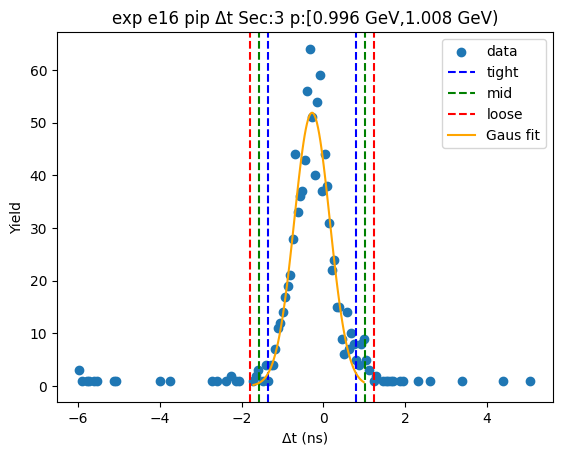

-1.4023019212807262 0.9604340965295817
-1.6385755230617571 1.1967076983106126
-1.8748491248427879 1.4329813000916434
[48.0720193  -0.22093391  0.4725472 ]


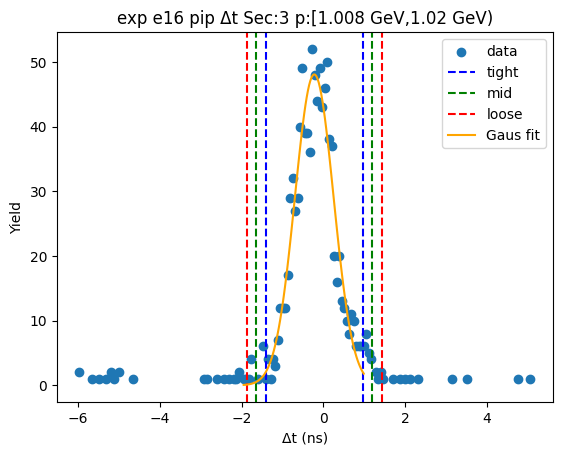

-1.3628776856444083 0.8602112041179122
-1.5851865746206404 1.0825200930941443
-1.8074954635968723 1.3048289820703762
[51.79249307 -0.25133324  0.44461778]


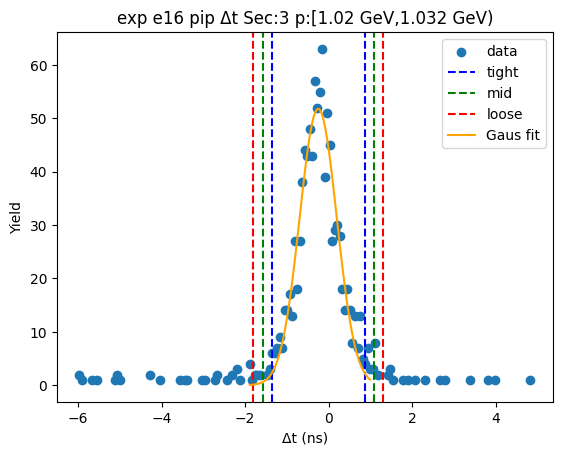

-1.3949941647515671 0.9046507851918055
-1.6249586597459045 1.1346152801861429
-1.8549231547402416 1.36457977518048
[43.96031175 -0.24517169  0.45992899]


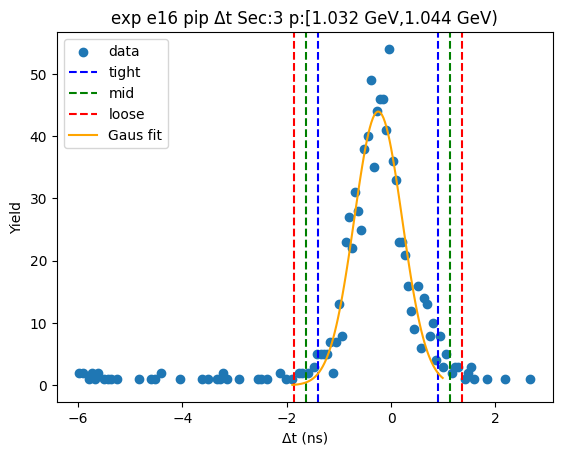

-1.3541221706379032 0.8492348574693827
-1.5744578734486319 1.0695705602801113
-1.7947935762593603 1.2899062630908398
[45.62102464 -0.25244366  0.44067141]


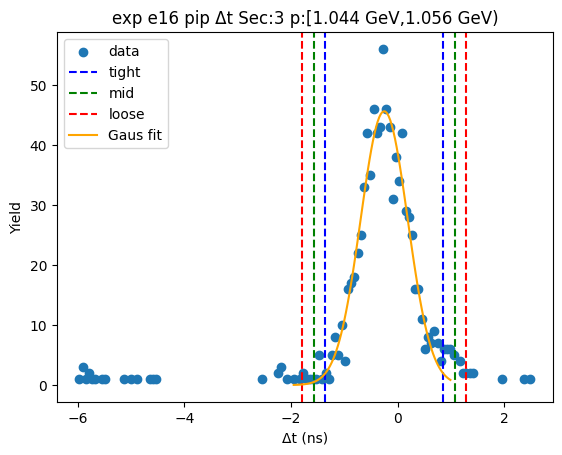

-1.507504799363035 1.082384913422931
-1.7664937706416315 1.3413738847015275
-2.025482741920228 1.6003628559801242
[40.29469275 -0.21255994  0.51797794]


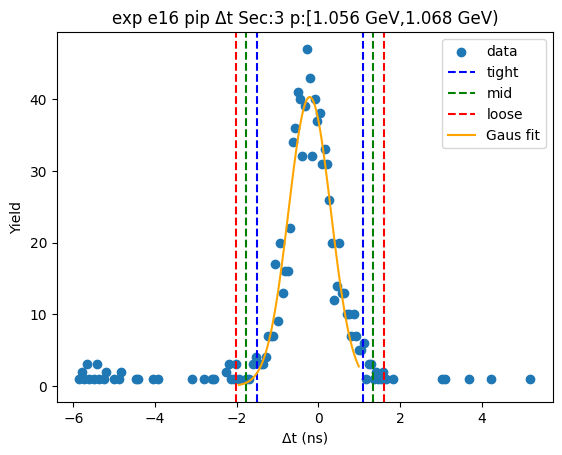

-1.3910764137738698 0.8297750951635967
-1.6131615646676165 1.0518602460573434
-1.8352467155613632 1.27394539695109
[47.96389536 -0.28065066  0.4441703 ]


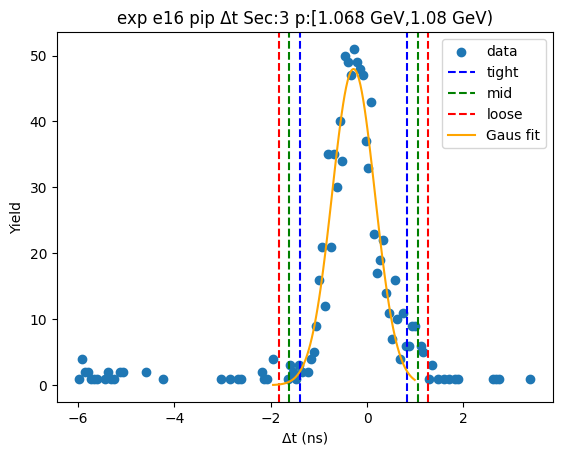

-1.4867510752643613 1.036836196005015
-1.739109802391299 1.2891949231319526
-1.9914685295182366 1.5415536502588902
[42.83457623 -0.22495744  0.50471745]


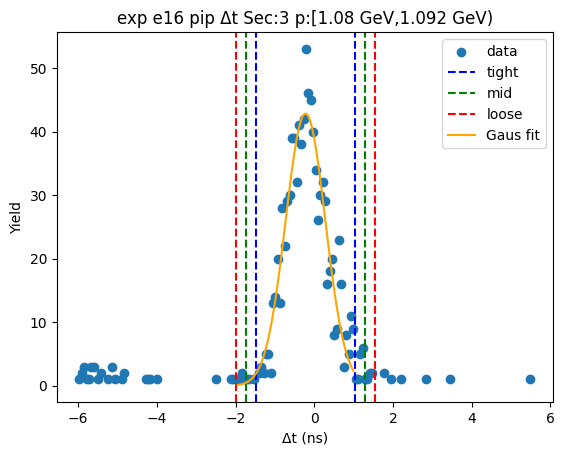

-1.4250581135739482 0.9578090515368027
-1.663344830085023 1.1960957680478776
-1.9016315465960982 1.4343824845589528
[40.36043756 -0.23362453  0.47657343]


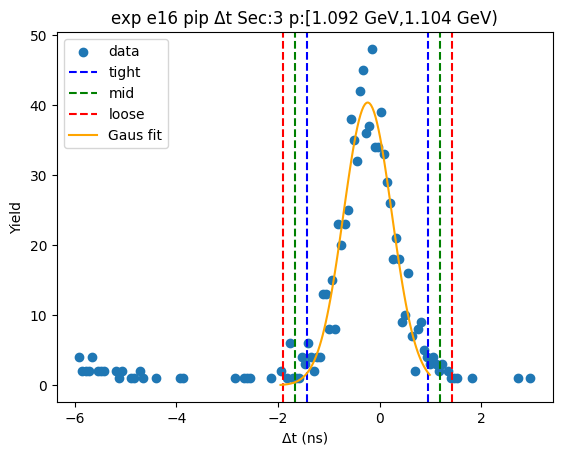

-1.4370251938949352 0.9274430330615997
-1.6734720165905888 1.1638898557572532
-1.9099188392862423 1.4003366784529068
[44.15588541 -0.25479108  0.47289365]


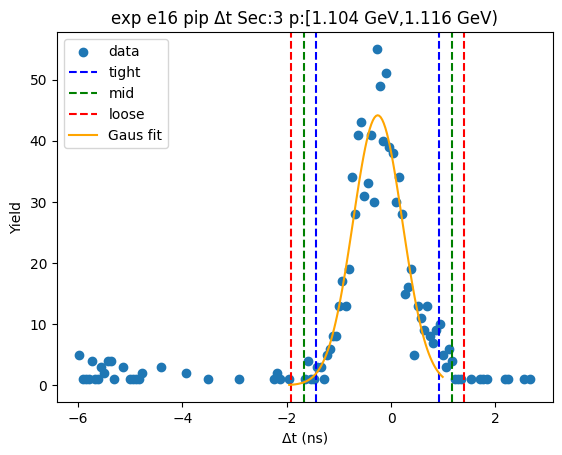

-1.479913312435396 0.9369480889795319
-1.7215994525768887 1.1786342291210246
-1.9632855927183817 1.4203203692625175
[38.51290272 -0.27148261  0.48337228]


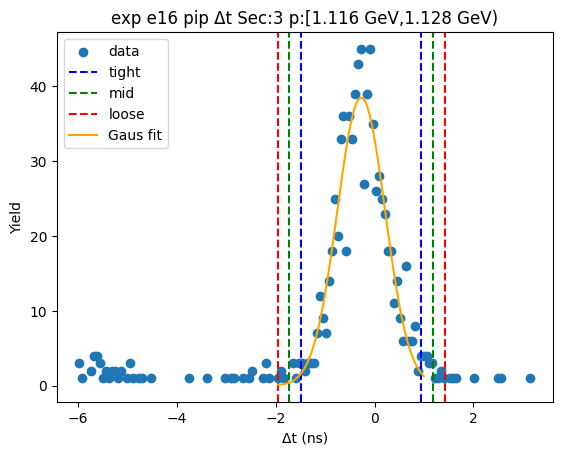

-1.5144094254835156 1.0162649186954908
-1.7674768599014161 1.2693323531133913
-2.0205442943193166 1.522399787531292
[36.01769855 -0.24907225  0.50613487]


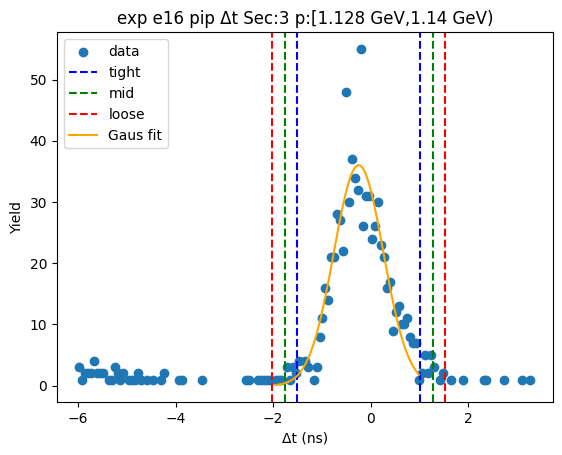

-1.4150558792394294 0.8999131651545742
-1.6465527836788298 1.1314100695939746
-1.8780496881182303 1.362906974033375
[37.58642837 -0.25757136  0.46299381]


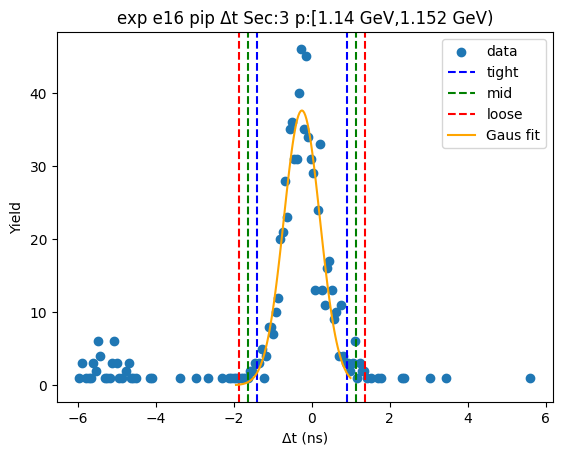

-1.4561998443966404 1.0453258037298325
-1.7063524092092879 1.29547836854248
-1.9565049740219351 1.5456309333551272
[34.35621843 -0.20543702  0.50030513]


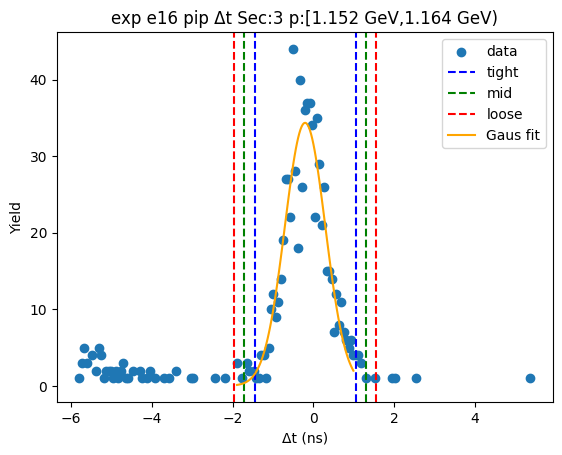

-1.4026503016874716 1.0143143422587497
-1.6443467660820938 1.256010806653372
-1.8860432304767158 1.497707271047994
[38.38215624 -0.19416798  0.48339293]


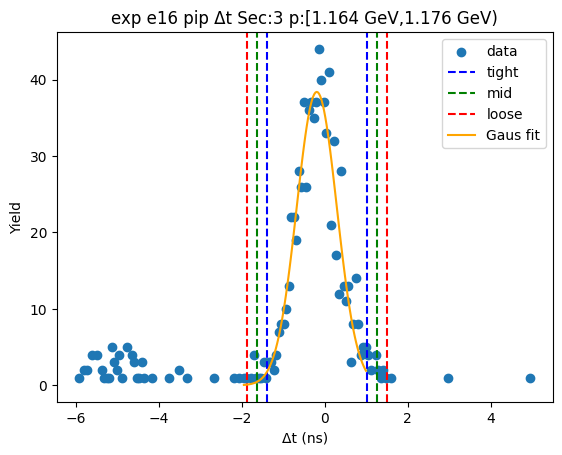

-1.3737638091484035 1.005362009856295
-1.6116763910488734 1.243274591756765
-1.849588972949343 1.4811871736572346
[35.05169816 -0.1842009   0.47582516]


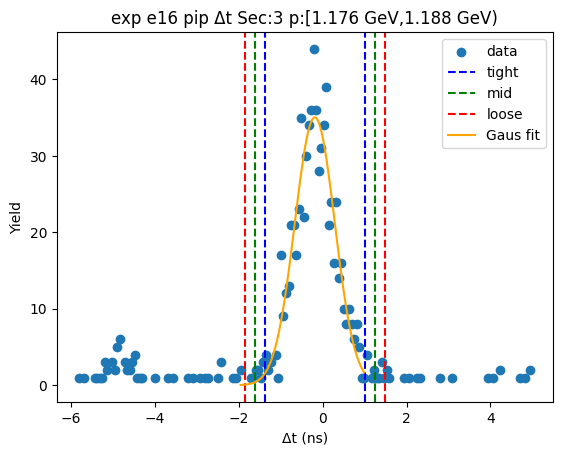

-1.4591390372676407 0.994659015493059
-1.7045188425437106 1.2400388207691289
-1.9498986478197804 1.4854186260451987
[35.13430802 -0.23224001  0.49075961]


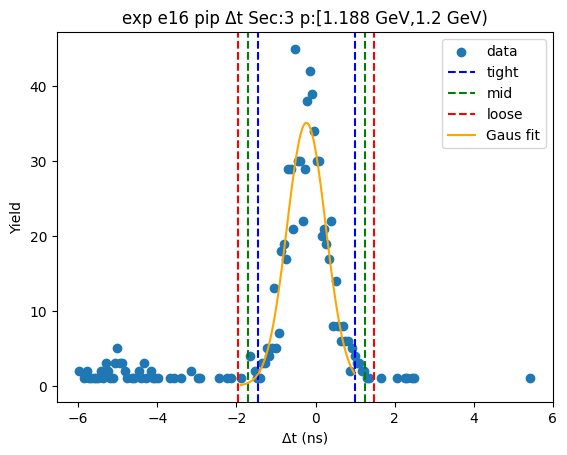

-1.3542947477782863 0.9715489084156479
-1.5868791133976796 1.2041332740350412
-1.8194634790170732 1.4367176396544348
[36.67067784 -0.19137292  0.46516873]


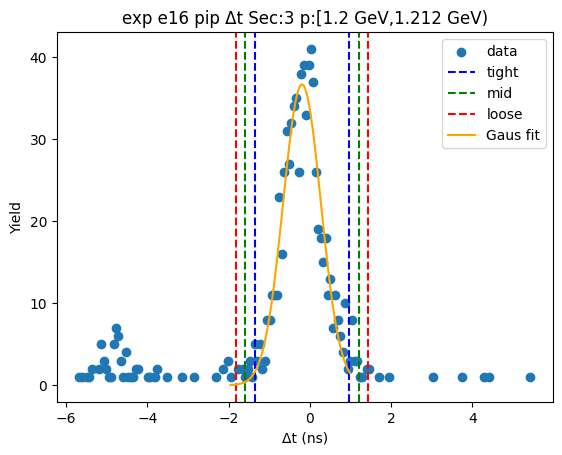

-1.4897313054459096 1.0472184853881663
-1.7434262845293174 1.300913464471574
-1.997121263612725 1.5546084435549816
[32.70065048 -0.22125641  0.50738996]


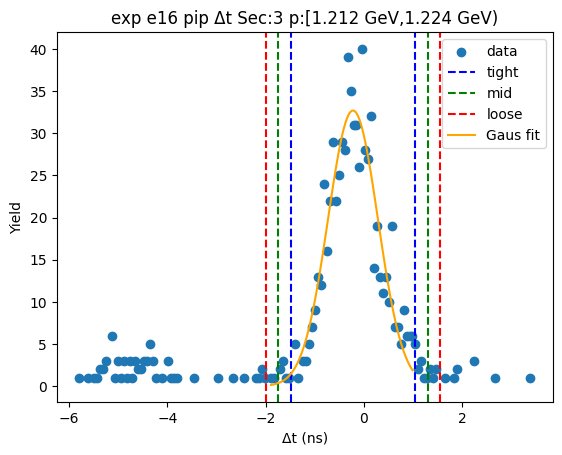

-1.3182474835000473 0.9518438002582237
-1.5452566118758744 1.1788529286340508
-1.7722657402517015 1.4058620570098779
[35.90427536 -0.18320184  0.45401826]


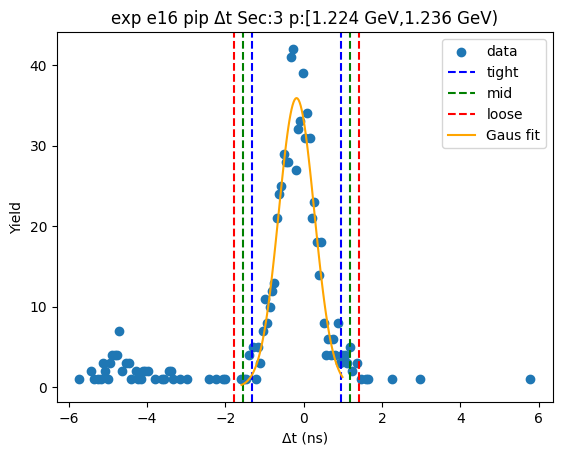

-1.388566606085869 0.956836074254789
-1.6231068741199348 1.1913763422888548
-1.8576471421540006 1.4259166103229206
[34.65901641 -0.21586527  0.46908054]


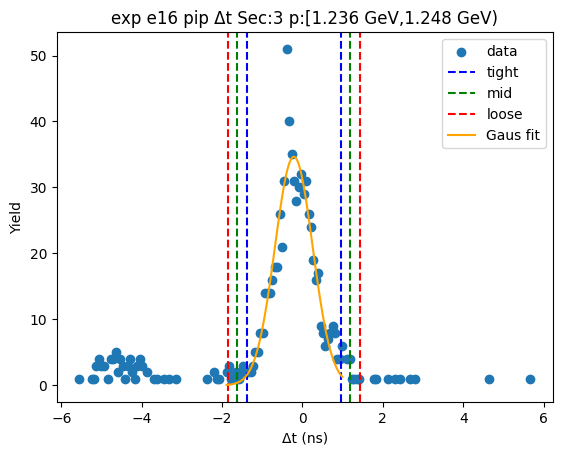

-1.3895187236845716 0.9423987349223943
-1.6227104695452683 1.175590480783091
-1.8559022154059648 1.4087822266437875
[32.24017512 -0.22355999  0.46638349]


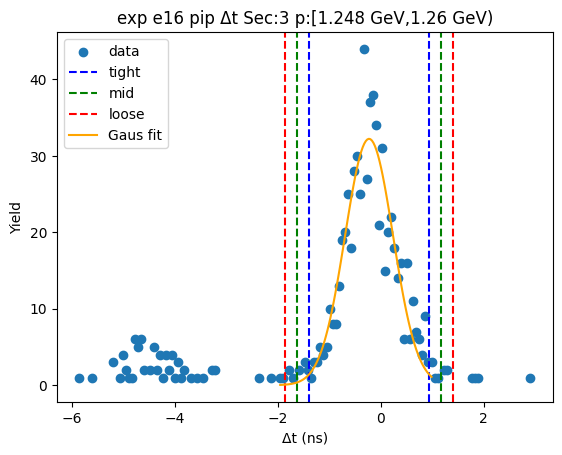

-1.3863572061765213 0.931443942038834
-1.618137320998057 1.1632240568603698
-1.8499174358195924 1.3950041716819053
[31.71294106 -0.22745663  0.46356023]


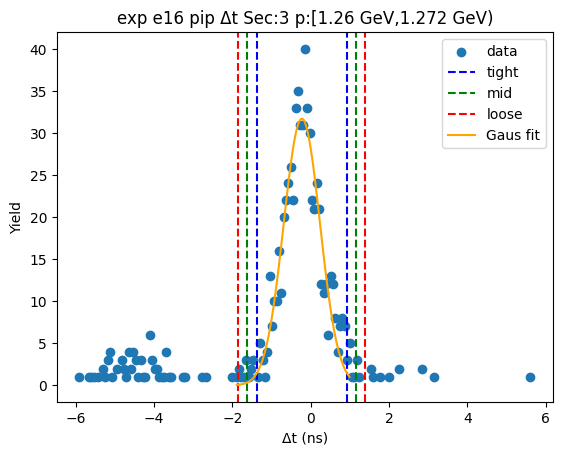

-1.3790370176229083 0.9226516211861182
-1.609205881503811 1.152820485067021
-1.8393747453847136 1.3829893489479235
[31.27746928 -0.2281927   0.46033773]


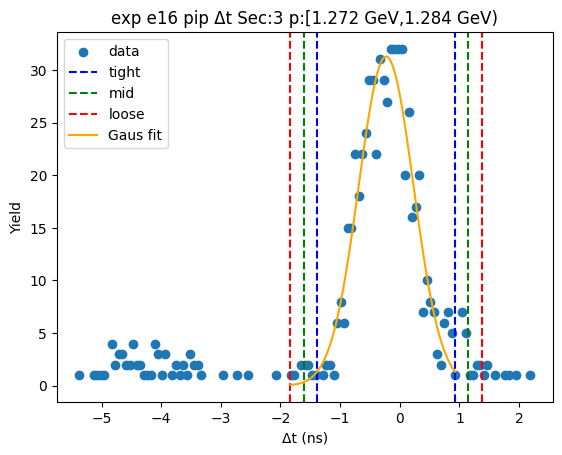

-1.4242132092136937 0.9852490891352617
-1.665159439048589 1.226195318970157
-1.9061056688834848 1.4671415488050528
[29.81376587 -0.21948206  0.48189246]


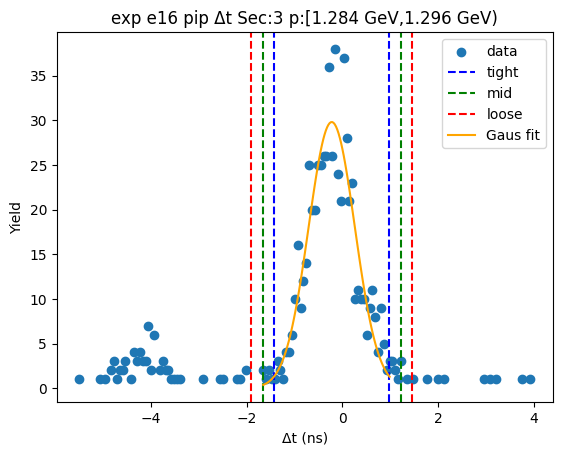

-1.4190558770510489 1.0157401116607847
-1.6625354759222322 1.259219710531968
-1.9060150747934155 1.5026993094031513
[29.363186   -0.20165788  0.4869592 ]


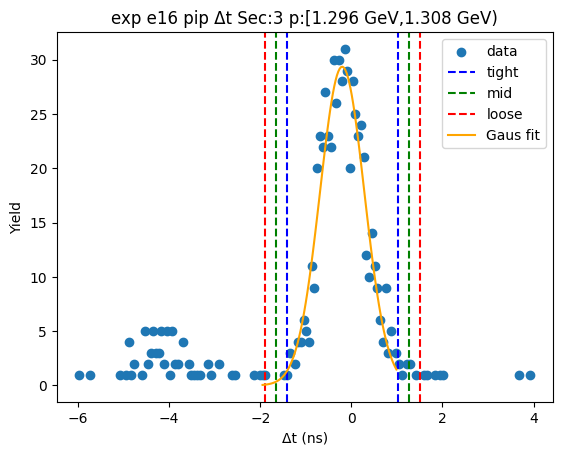

-1.4701778318276009 1.0180875480490046
-1.7190043698152615 1.2669140860366652
-1.967830907802922 1.5157406240243256
[27.33682182 -0.22604514  0.49765308]


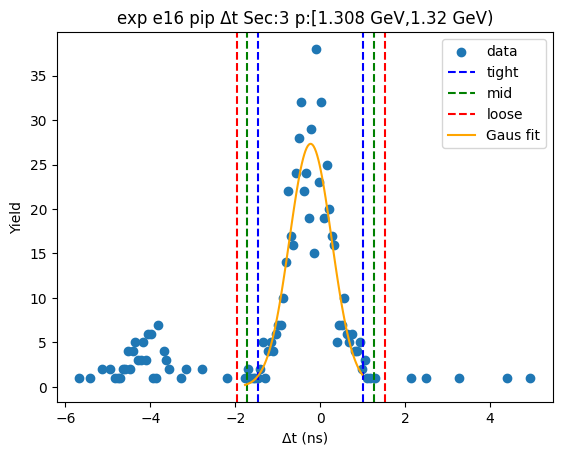

-1.3387217167052932 0.8794885754032904
-1.5605427459161516 1.1013096046141488
-1.7823637751270098 1.323130633825007
[30.39190379 -0.22961657  0.44364206]


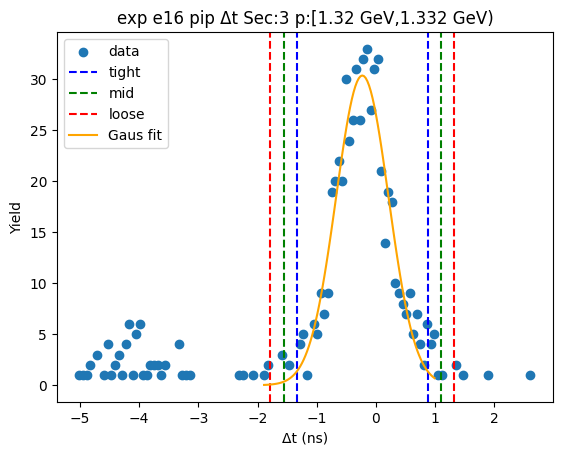

-1.3673885449651548 0.9582196963078164
-1.599949369092452 1.1907805204351136
-1.8325101932197492 1.4233413445624108
[29.00838345 -0.20458442  0.46512165]


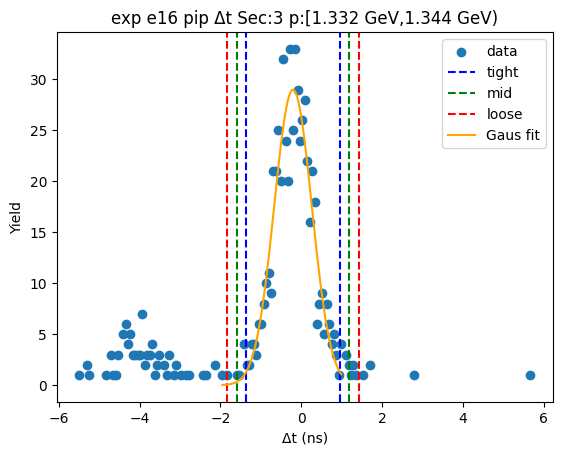

-1.3278464979845337 0.9026005316810246
-1.5508912009510893 1.1256452346475803
-1.7739359039176452 1.3486899376141361
[29.04969486 -0.21262298  0.44608941]


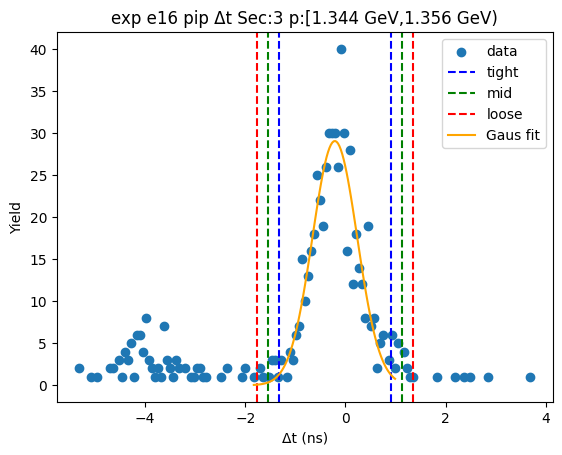

-1.3811890930242658 0.9733672183239104
-1.6166447241590833 1.2088228494587279
-1.8521003552939008 1.4442784805935454
[26.74320453 -0.20391094  0.47091126]


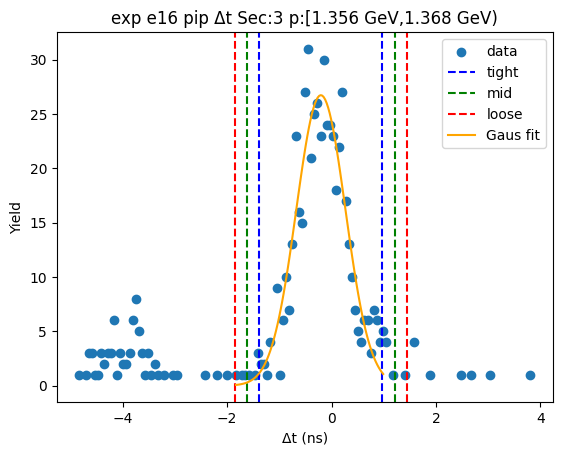

-1.3157274586197023 0.9973348977914165
-1.547033694260814 1.2286411334325282
-1.7783399299019258 1.45994736907364
[27.81572281 -0.15919628  0.46261247]


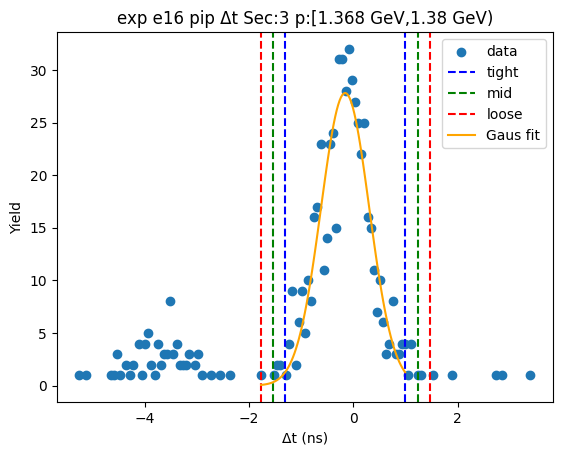

-1.352108971382884 0.9473403053542457
-1.5820538990565969 1.1772852330279586
-1.81199882673031 1.4072301607016717
[26.43665637 -0.20238433  0.45988986]


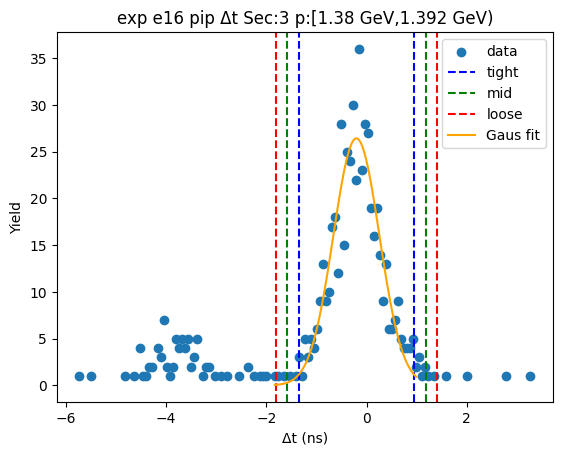

-1.3289461007991659 0.8752673483188459
-1.549367445710967 1.095688693230647
-1.7697887906227683 1.3161100381424484
[28.94344615 -0.22683938  0.44084269]


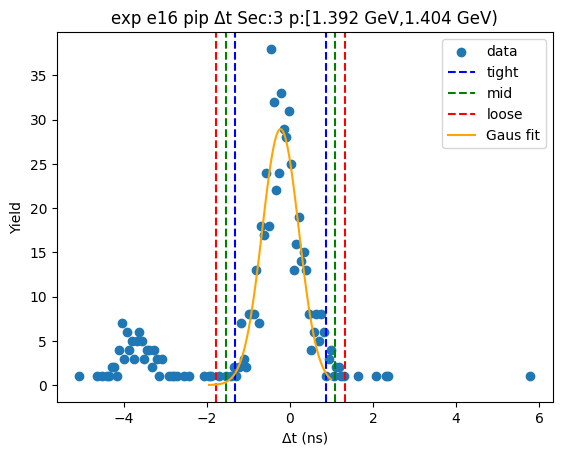

-1.4529570565669303 1.0327154383114352
-1.701524306054767 1.2812826877992718
-1.9500915555426035 1.5298499372871084
[26.46610432 -0.21012081  0.4971345 ]


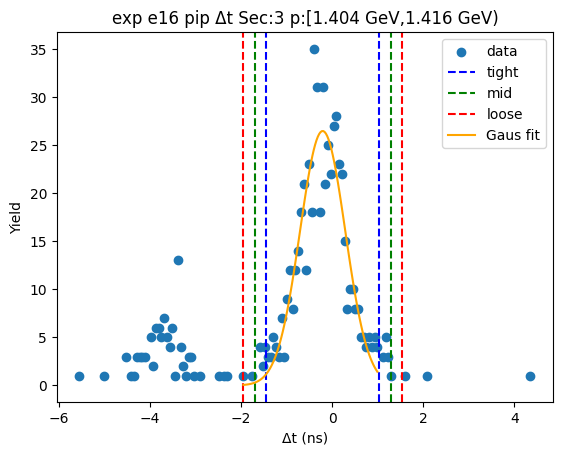

-1.3637078321835527 0.8937417849347503
-1.5894527938953829 1.1194867466465803
-1.8151977556072132 1.3452317083584107
[26.50370951 -0.23498302  0.45148992]


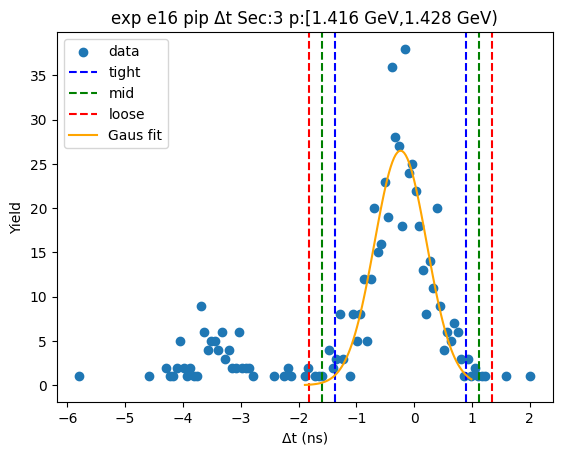

-1.3444246816195031 0.9652191390645419
-1.5753890636879075 1.1961835211329463
-1.8063534457563122 1.427147903201351
[25.29845147 -0.18960277  0.46192876]


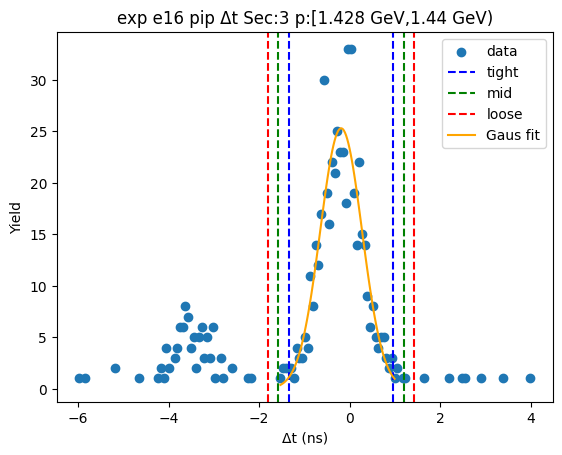

-1.332983719446092 0.8885526872267603
-1.5551373601133773 1.1107063278940454
-1.7772910007806626 1.3328599685613307
[27.42143411 -0.22221552  0.44430728]


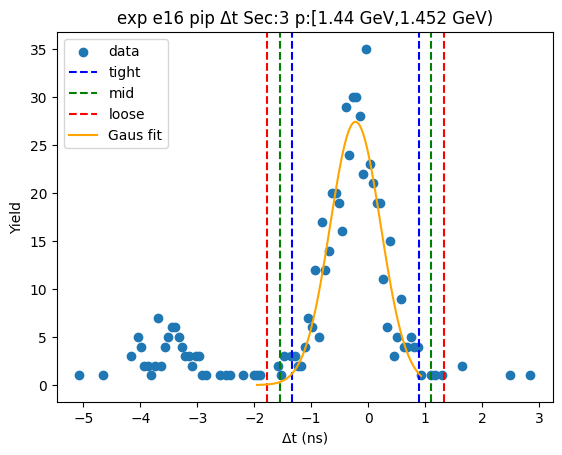

-1.3930817073415052 0.9374038261308033
-1.626130260688736 1.1704523794780342
-1.8591788140359669 1.403500932825265
[25.24464022 -0.22783894  0.46609711]


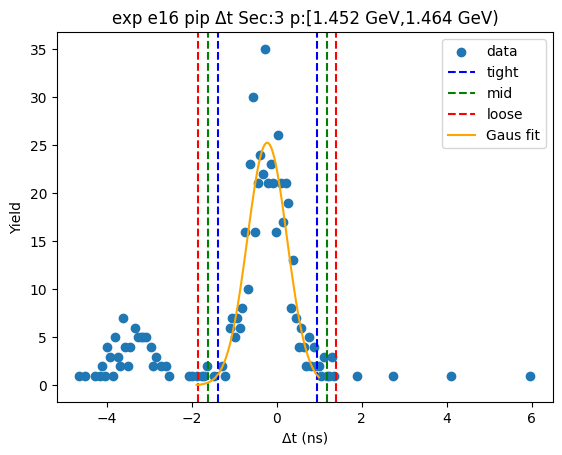

-1.2836980238576017 0.8720796015888557
-1.4992757864022472 1.0876573641335012
-1.714853548946893 1.303235126678147
[25.0789236  -0.20580921  0.43115553]


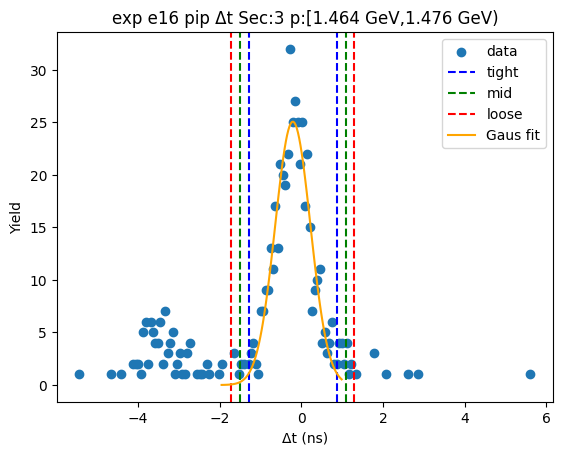

-1.2850857079518097 0.882483116491549
-1.5018425903961454 1.0992399989358848
-1.7185994728404814 1.3159968813802208
[23.36755029 -0.2013013   0.43351376]


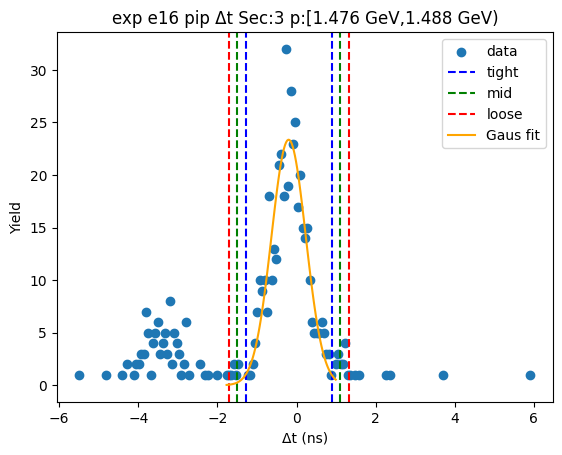

-1.2692537210047696 0.7751752182410033
-1.473696614929347 0.9796181121655806
-1.6781395088539242 1.184061006090158
[25.47477967 -0.24703925  0.40888579]


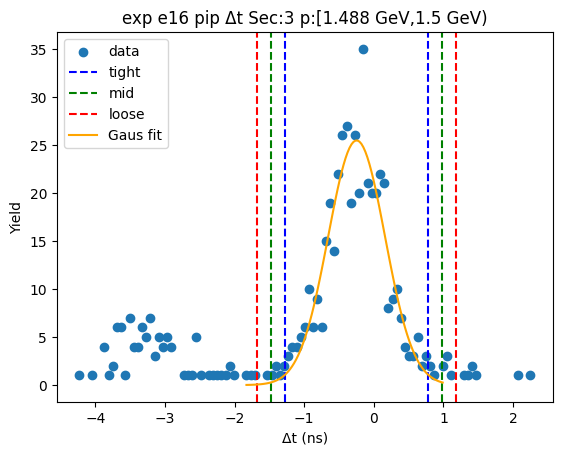

-1.3790180167282948 0.9130356123444983
-1.6082233796355743 1.1422409752517777
-1.8374287425428537 1.3714463381590571
[24.02048824 -0.2329912   0.45841073]


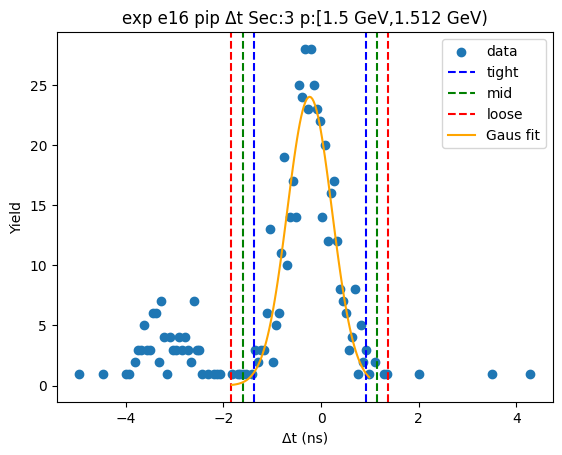

-1.3086187085197571 0.7645124758114319
-1.5159318269528759 0.9718255942445506
-1.7232449453859948 1.1791387126776696
[25.25006793 -0.27205312  0.41462624]


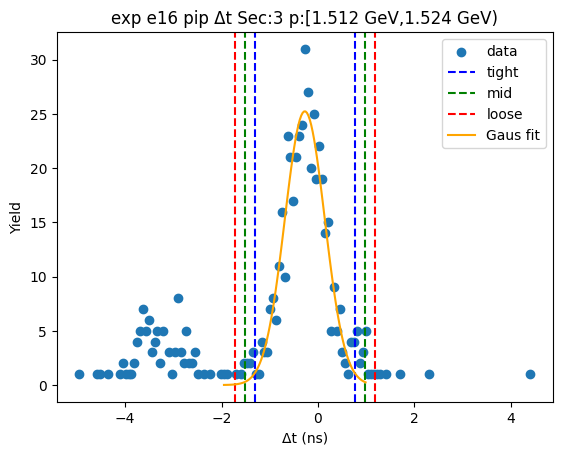

-1.2706654884499688 0.829961887153958
-1.4807282260103614 1.0400246247143505
-1.690790963570754 1.2500873622747433
[23.11197986 -0.2203518   0.42012548]


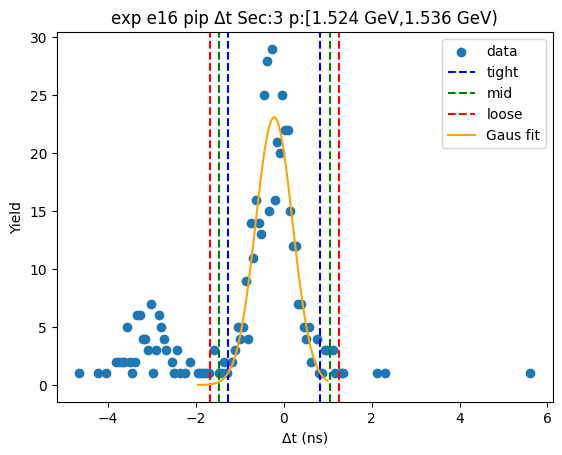

-1.3259222496121068 0.8785878857963074
-1.546373263152948 1.0990388993371487
-1.7668242766937894 1.31948991287799
[21.7858997  -0.22366718  0.44090203]


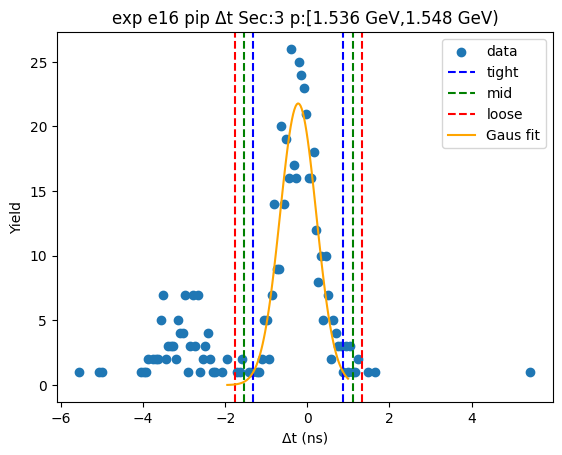

-1.3606791210964009 0.9428169016038933
-1.5910287233664304 1.1731665038739227
-1.82137832563646 1.4035161061439523
[21.3472956  -0.20893111  0.4606992 ]


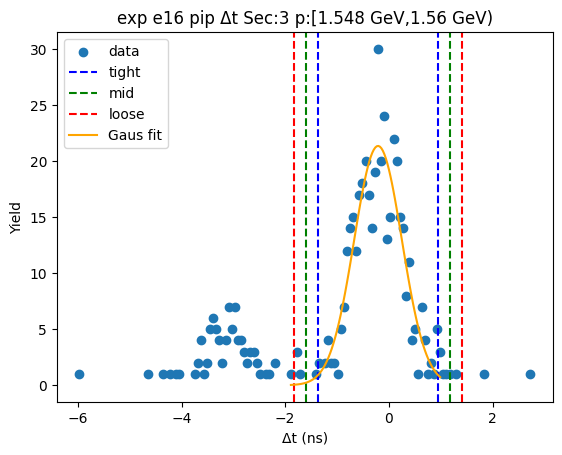

-1.207849171234757 0.825806867421757
-1.4112147751004085 1.0291724712874086
-1.6145803789660598 1.23253807515306
[25.19343162 -0.19102115  0.40673121]


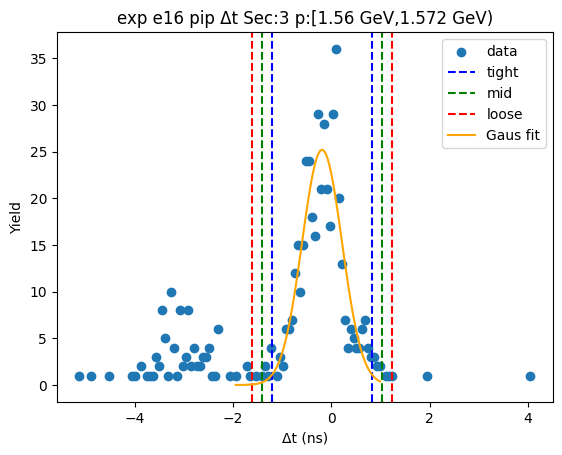

-1.344199227155846 0.9358835703178607
-1.5722075069032166 1.1638918500652313
-1.8002157866505875 1.3919001298126021
[21.8248914  -0.20415783  0.45601656]


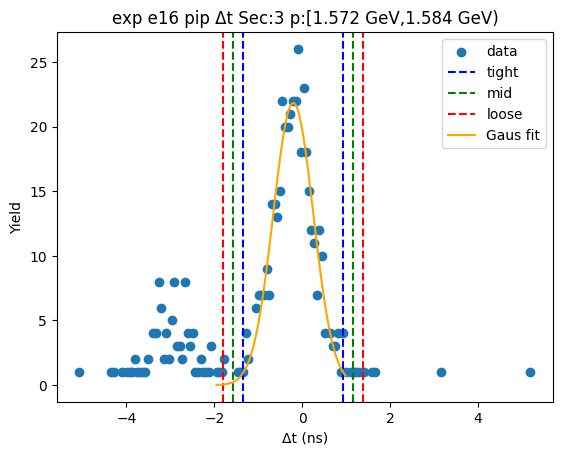

-1.3912610898149793 0.9721019636688845
-1.6275973951633658 1.2084382690172708
-1.863933700511752 1.444774574365657
[19.58982561 -0.20957956  0.47267261]


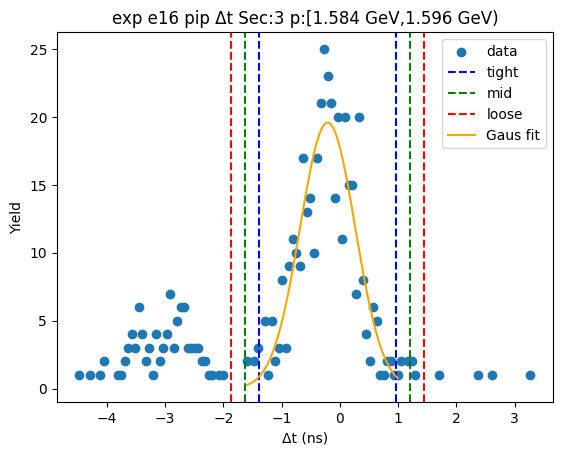

-1.454240681572939 1.0035790193188636
-1.7000226516621193 1.249360989408044
-1.9458046217512994 1.495142959497224
[17.3090662  -0.22533083  0.49156394]


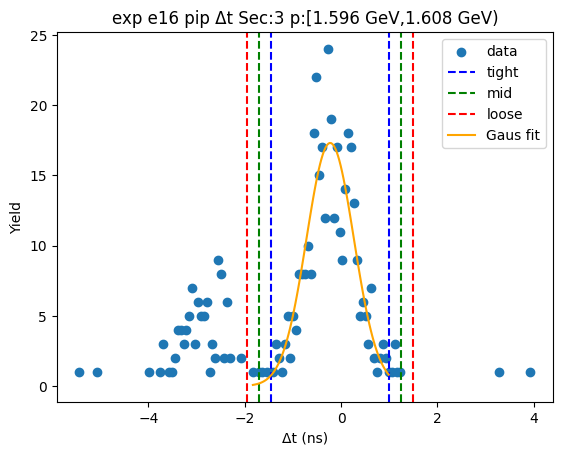

-1.4058614011754313 0.9218835394298556
-1.6386358952359603 1.1546580334903842
-1.8714103892964888 1.3874325275509132
[18.25107811 -0.24198893  0.46554899]


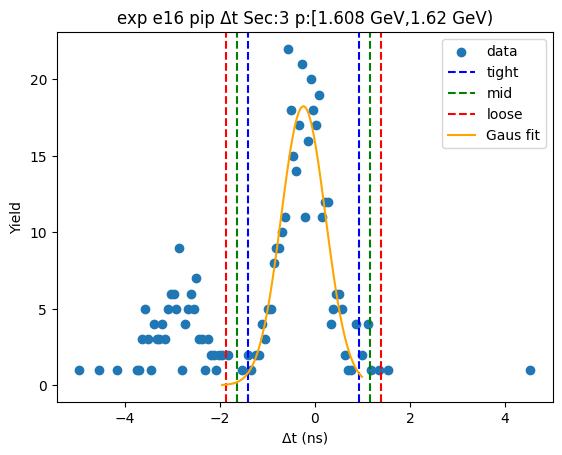

-1.3198745660847608 0.8571250117944054
-1.5375745238726775 1.074824969582322
-1.755274481660594 1.2925249273702386
[21.36435954 -0.23137478  0.43539992]


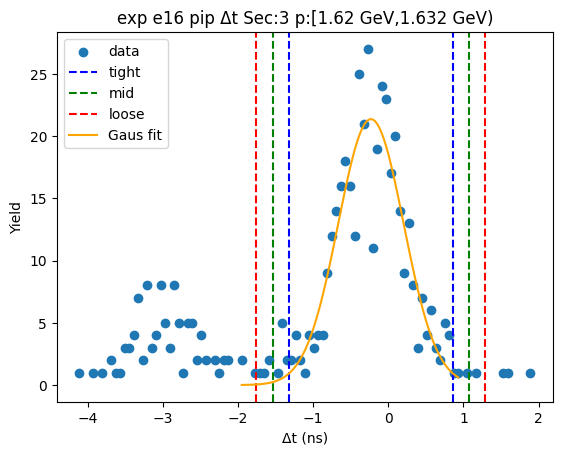

-1.3519007323893126 0.8783589856972399
-1.574926704197968 1.1013849575058954
-1.7979526760066231 1.3244109293145505
[21.65864617 -0.23677087  0.44605194]


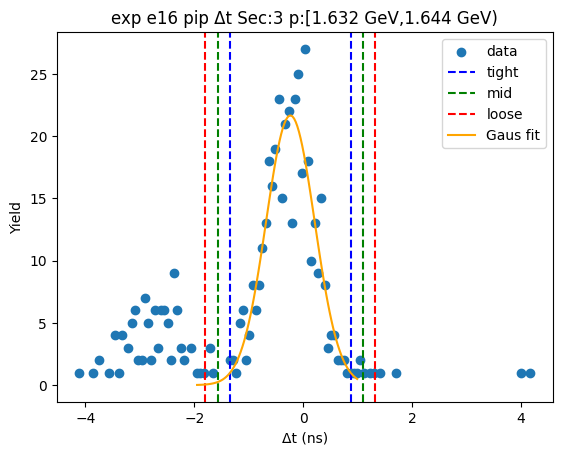

-1.3202588480994442 0.8326913207932864
-1.5355538649887173 1.0479863376825596
-1.7508488818779904 1.2632813545718327
[20.42143123 -0.24378376  0.43059003]


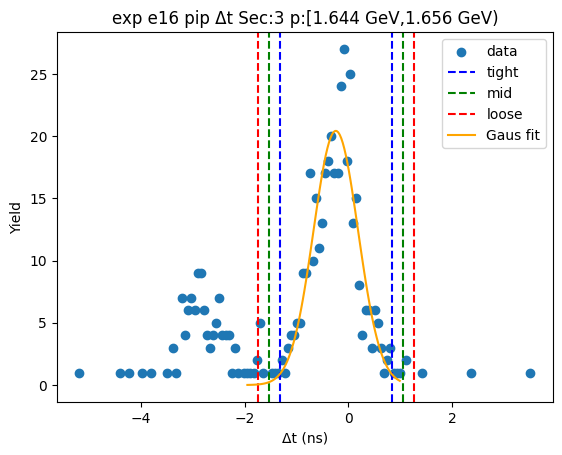

-1.2341691553840821 0.8148190793878363
-1.4390679788612741 1.0197179028650283
-1.643966802338466 1.22461672634222
[22.43386588 -0.20967504  0.40979765]


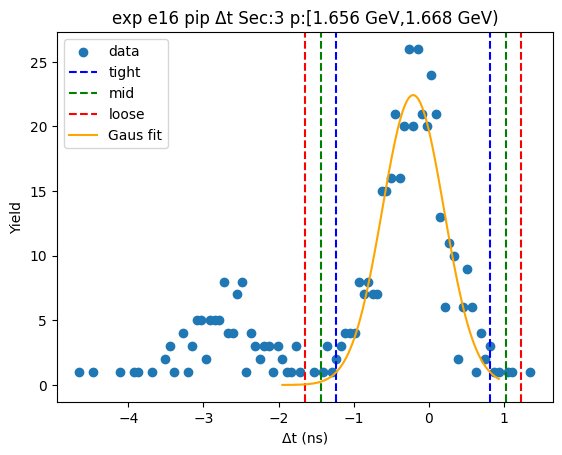

-1.3413816916865986 0.8558996302447037
-1.5611098238797287 1.0756277624378339
-1.780837956072859 1.2953558946309642
[18.54460573 -0.24274103  0.43945626]


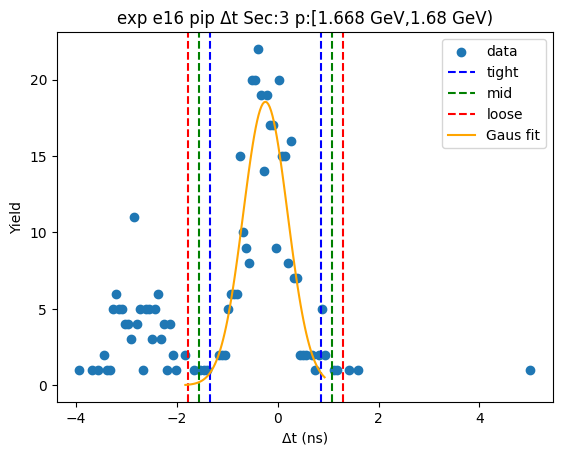

-1.3819214753840507 0.92650589152786
-1.6127642120752417 1.1573486282190508
-1.8436069487664326 1.3881913649102418
[18.04497312 -0.22770779  0.46168547]


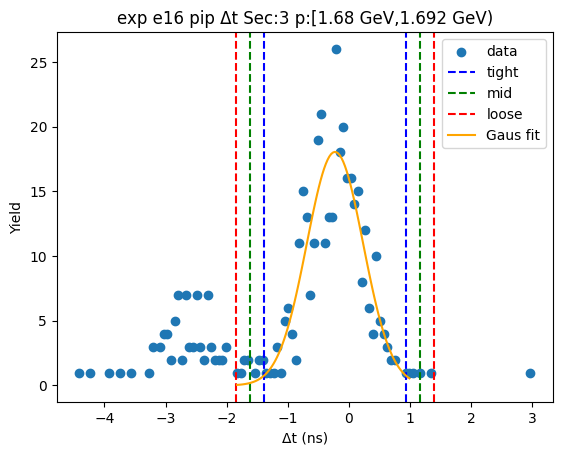

-1.2780156198830004 0.8898209522070052
-1.4947992770920009 1.106604609416006
-1.7115829343010014 1.3233882666250065
[18.66300809 -0.19409733  0.43356731]


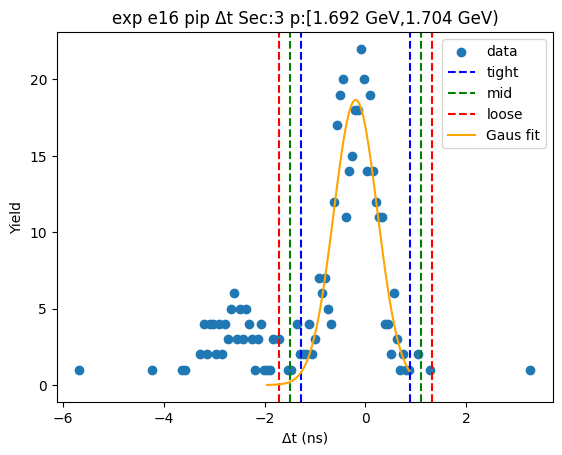

-1.3758212888691608 0.9838632778958768
-1.6117897455456645 1.2198317345723806
-1.8477582022221684 1.4558001912488845
[15.11561788 -0.19597901  0.47193691]


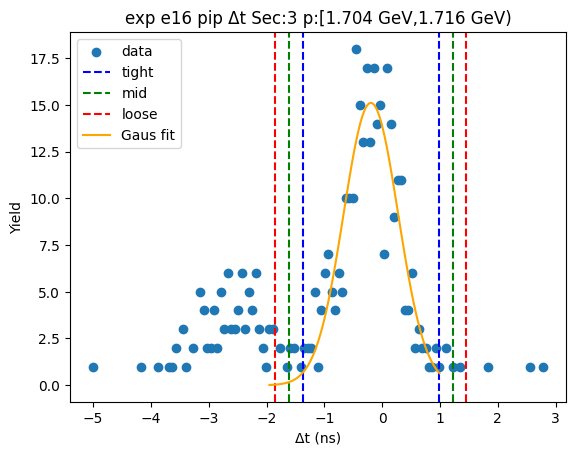

-1.3167545716886713 0.8871066323456882
-1.5371406920921071 1.107492752749124
-1.7575268124955432 1.3278788731525601
[18.30360651 -0.21482397  0.44077224]


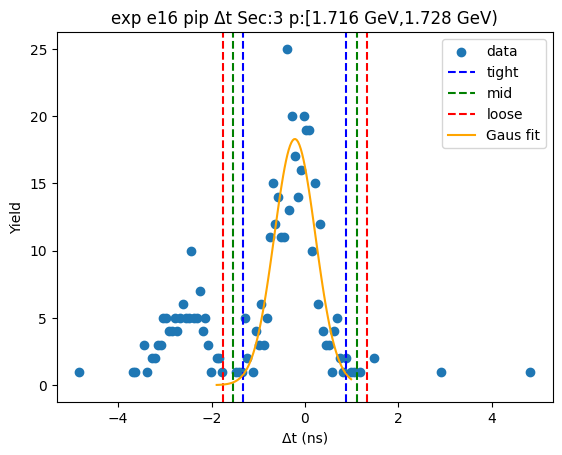

-1.3126191503270161 0.8331678738104655
-1.5271978527407641 1.0477465762242135
-1.7417765551545124 1.2623252786379617
[16.99205711 -0.23972564  0.4291574 ]


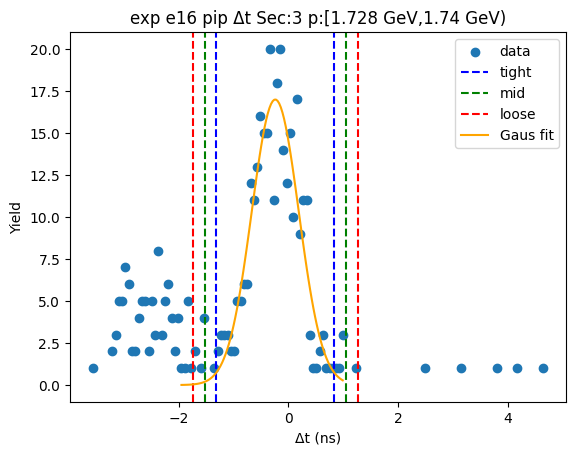

-1.3498586818365528 0.8401450891762985
-1.568859058937838 1.0591454662775837
-1.7878594360391231 1.2781458433788688
[16.18207492 -0.2548568   0.43800075]


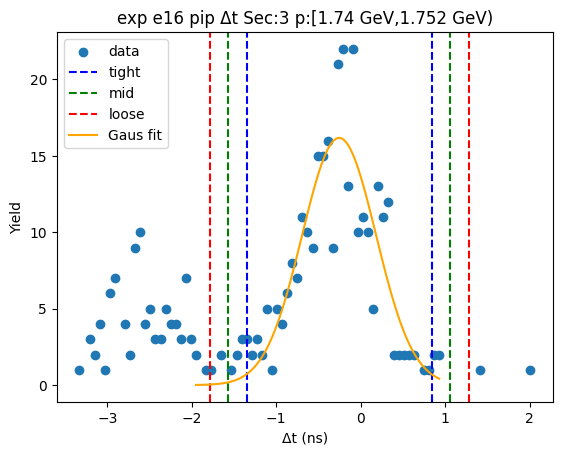

-1.1630077588552954 0.6832236242179694
-1.3476308971626219 0.8678467625252961
-1.5322540354699483 1.0524699008326226
[20.86147249 -0.23989207  0.36924628]


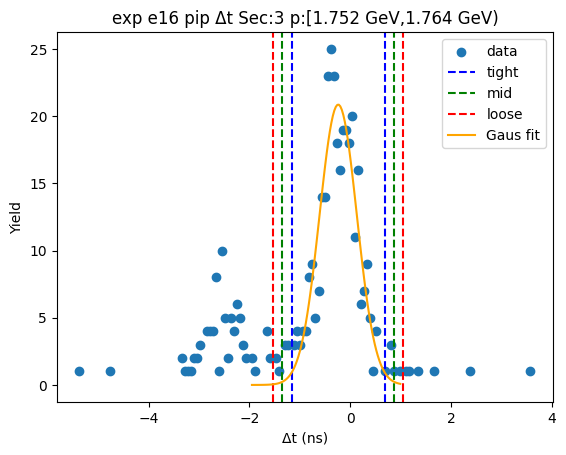

-1.3489595233673966 0.7519575277911936
-1.5590512284832556 0.9620492329070527
-1.7691429335991147 1.1721409380229117
[16.4173747  -0.298501    0.42018341]


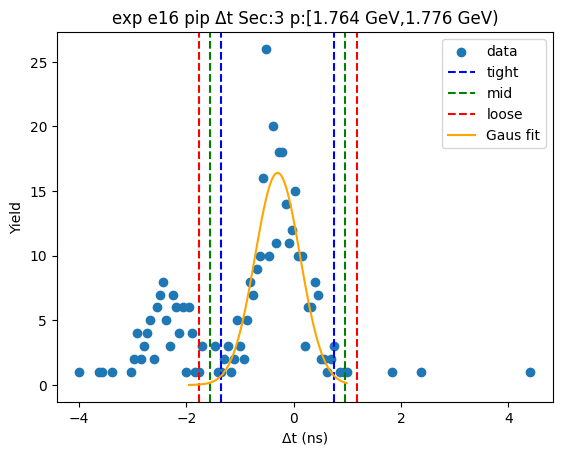

-1.2498168917402208 0.8656691671412546
-1.4613654976283683 1.0772177730294021
-1.6729141035165158 1.2887663789175496
[17.17500034 -0.19207386  0.42309721]


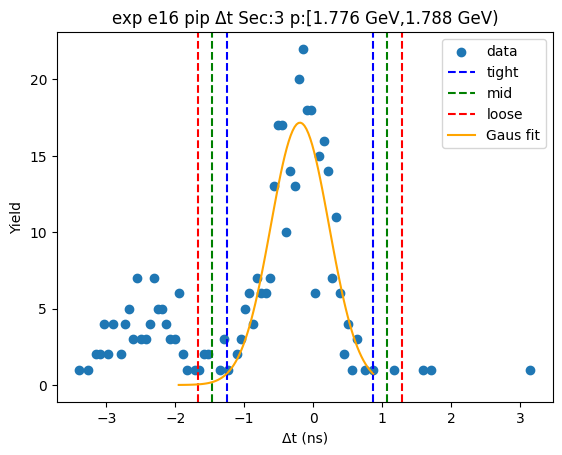

-1.381724509768893 0.858673394938828
-1.6057643002396649 1.0827131854096002
-1.8298040907104371 1.306752975880372
[16.02890094 -0.26152556  0.44807958]


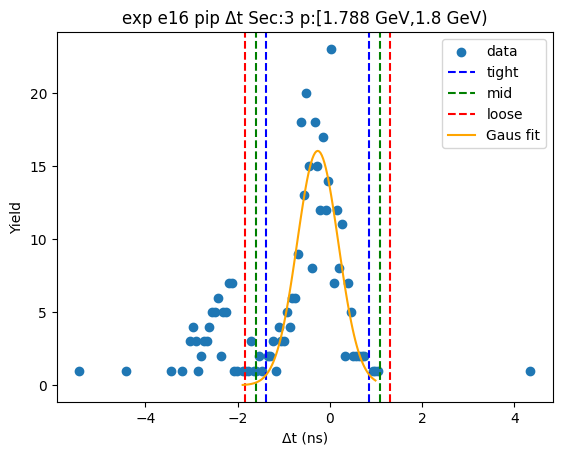

-1.2766857127169393 0.7847712957778047
-1.4828314135664138 0.9909169966272792
-1.688977114415888 1.1970626974767533
[17.482492   -0.24595721  0.4122914 ]


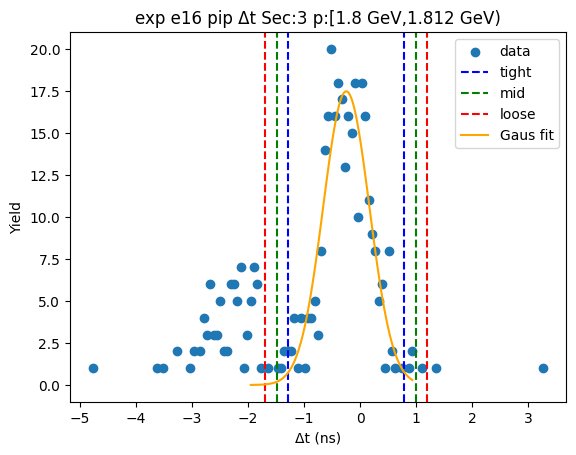

-1.2307281961700038 0.7889051673553
-1.4326915325225342 0.9908685037078304
-1.6346548688750646 1.1928318400603608
[17.06467755 -0.22091151  0.40392667]


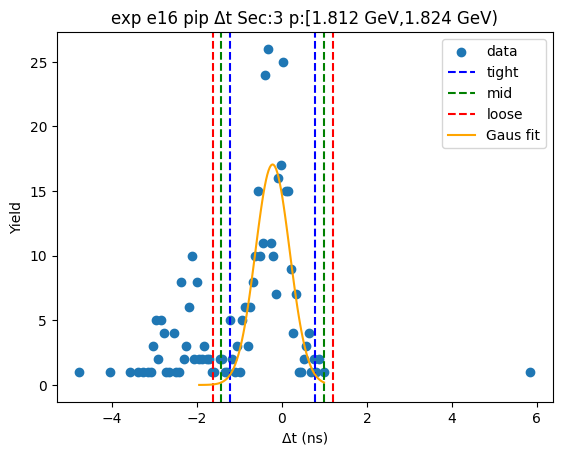

-1.1348812855660555 0.7653300821575508
-1.324902422338416 0.9553512189299114
-1.5149235591107768 1.1453723557022721
[15.55487023 -0.1847756   0.38004227]


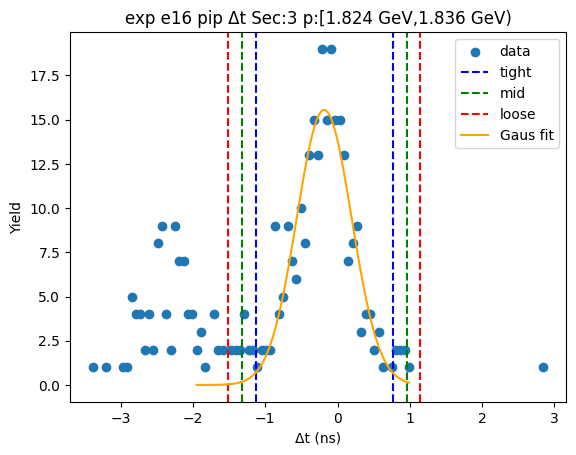

-1.5117813726222564 1.052706008045995
-1.7682301106890814 1.30915474611282
-2.0246788487559066 1.565603484179645
[12.98863603 -0.22953768  0.51289748]


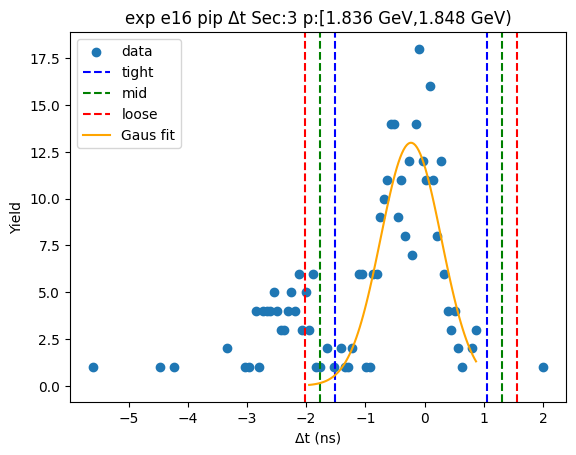

-1.3729527535643378 0.8493803438677126
-1.595186063307543 1.0716136536109178
-1.817419373050748 1.2938469633541227
[16.03342222 -0.2617862   0.44446662]


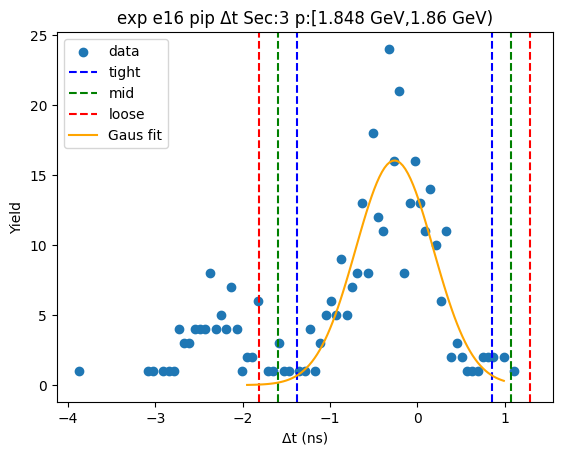

-1.3215983174554982 0.8360821089899718
-1.5373663601000453 1.0518501516345191
-1.7531344027445923 1.267618194279066
[16.66241511 -0.2427581   0.43153609]


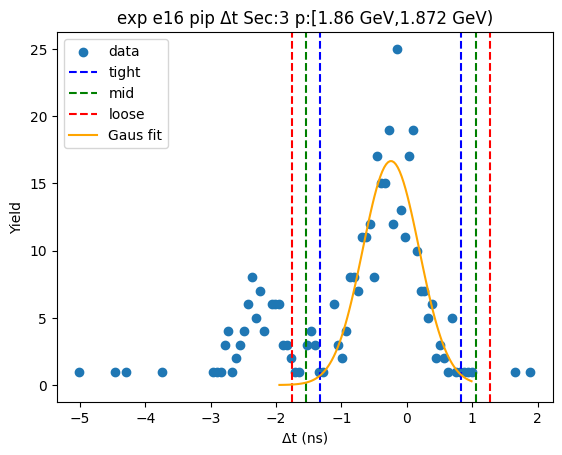

-1.264126339177513 0.8760453662809348
-1.4781435097233577 1.0900625368267793
-1.6921606802692026 1.3040797073726242
[13.32993305 -0.19404049  0.42803434]


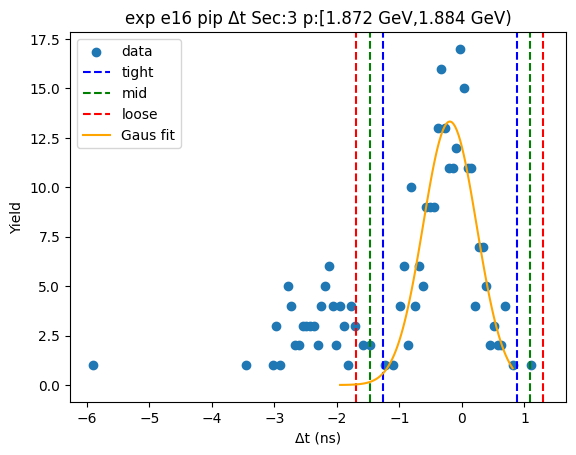

-1.334775773500791 0.8908252957534724
-1.5573358804262172 1.1133854026788985
-1.7798959873516436 1.335945509604325
[15.2464411  -0.22197524  0.44512021]


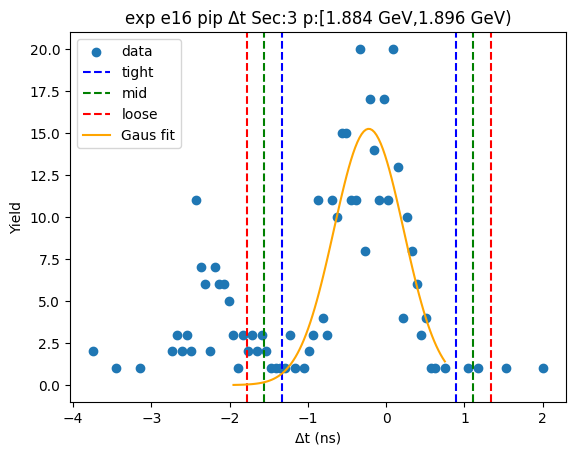

-1.3095794295447725 0.8029035535176403
-1.5208277278510136 1.0141518518238815
-1.7320760261572548 1.2254001501301226
[13.91356776 -0.25333794  0.4224966 ]


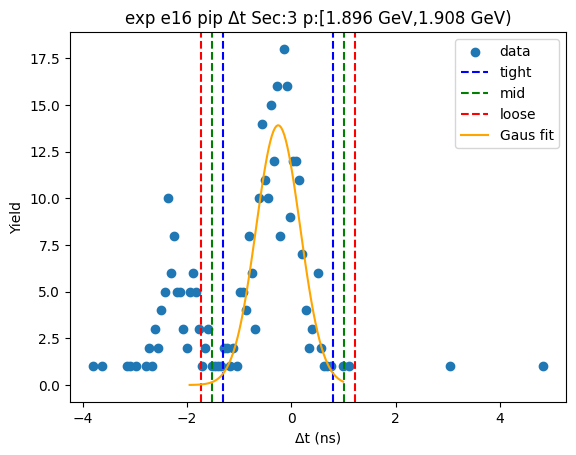

-1.429740303647244 0.8790119852905582
-1.6606155325410243 1.1098872141843386
-1.8914907614348044 1.3407624430781186
[12.81250109 -0.27536416  0.46175046]


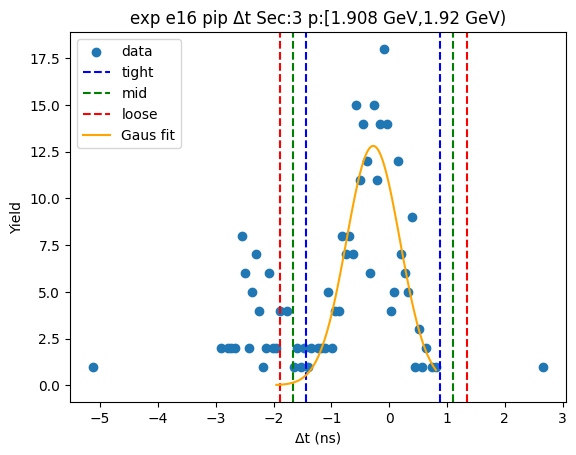

-1.5534325851537036 0.9582655969417903
-1.8046024033632526 1.2094354151513396
-2.055772221572802 1.460605233360889
[12.02472595 -0.29758349  0.50233964]


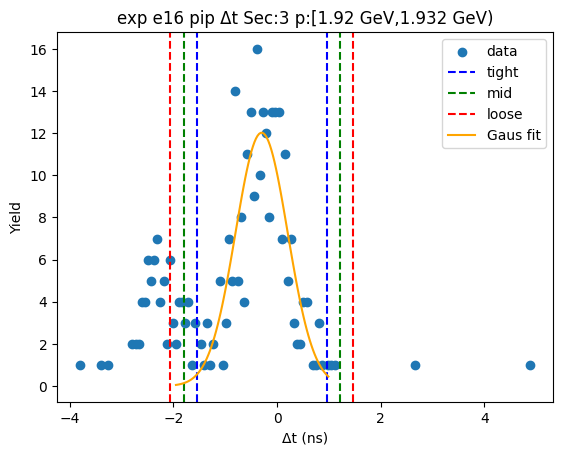

-1.4977883791933104 0.9690446101873534
-1.7444716781313767 1.2157279091254196
-1.991154977069443 1.4624112080634863
[12.04603263 -0.26437188  0.4933666 ]


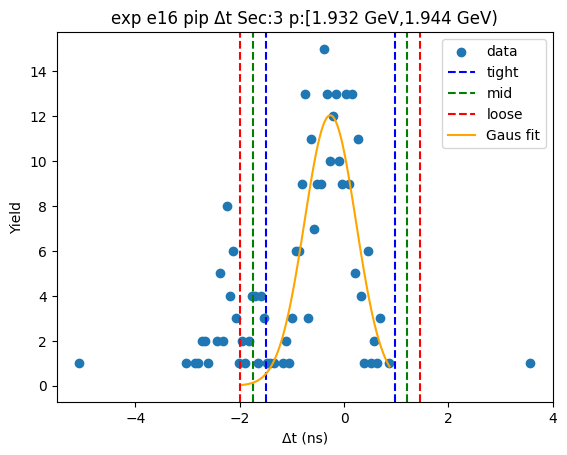

-1.2200248744295117 0.6582700744538661
-1.4078543693178494 0.846099569342204
-1.5956838642061872 1.0339290642305419
[15.29562558 -0.2808774   0.37565899]


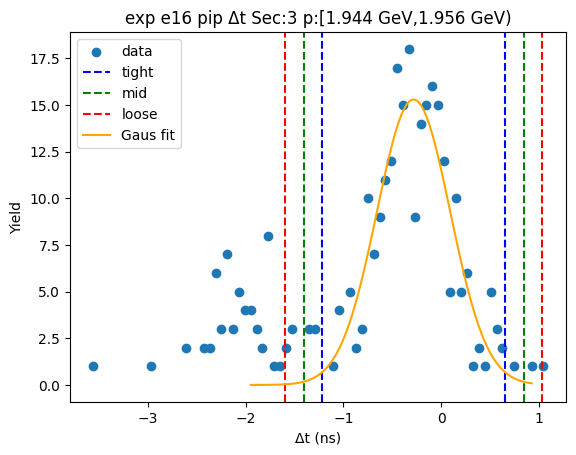

-1.4238217927350658 0.901641019780437
-1.6563680739866162 1.1341873010319874
-1.8889143552381666 1.3667335822835378
[12.49503266 -0.26109039  0.46509256]


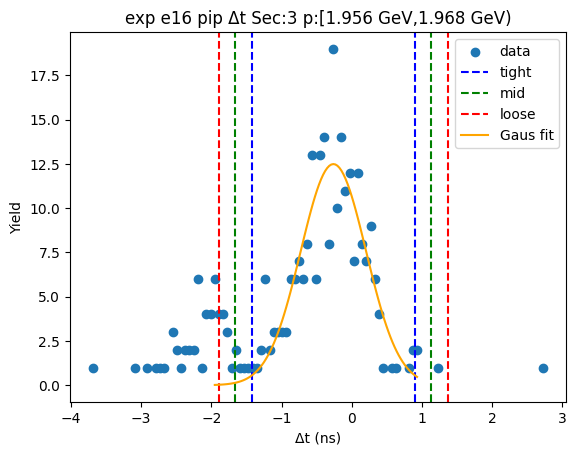

-1.4832102929955346 0.865345279262972
-1.718065850221385 1.1002008364888227
-1.9529214074472359 1.335056393714673
[11.92691904 -0.30893251  0.46971111]


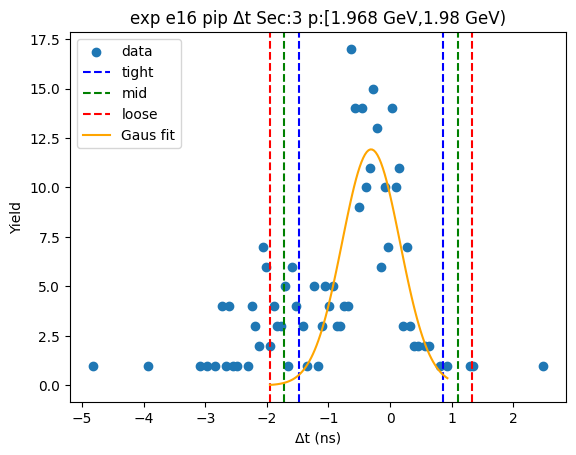

-1.414983380702336 0.8453927915360795
-1.6410209979261774 1.071430408759921
-1.8670586151500188 1.2974680259837623
[12.90054251 -0.28479529  0.45207523]


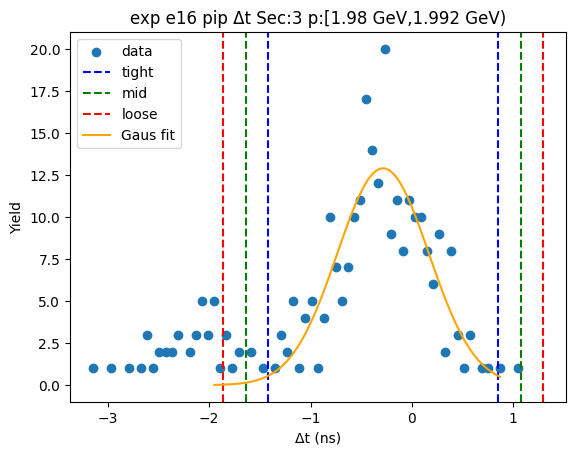

-1.2492212045812205 0.8158711637451678
-1.4557304414138594 1.0223804005778068
-1.6622396782464983 1.2288896374104457
[13.19143755 -0.21667502  0.41301847]


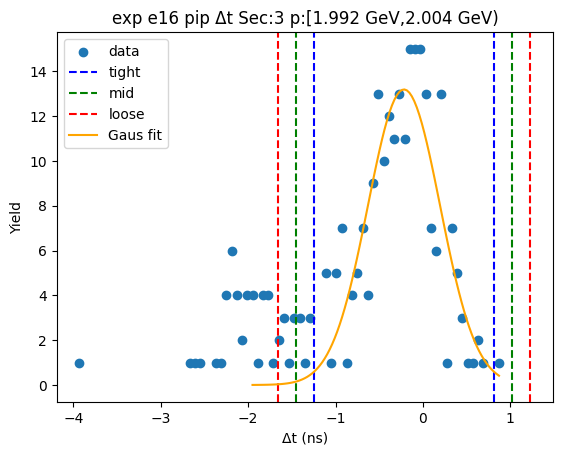

-1.4969463776237575 0.9488196598231866
-1.741522981368452 1.1933962635678812
-1.9860995851131464 1.4379728673125756
[11.38634025 -0.27406336  0.48915321]


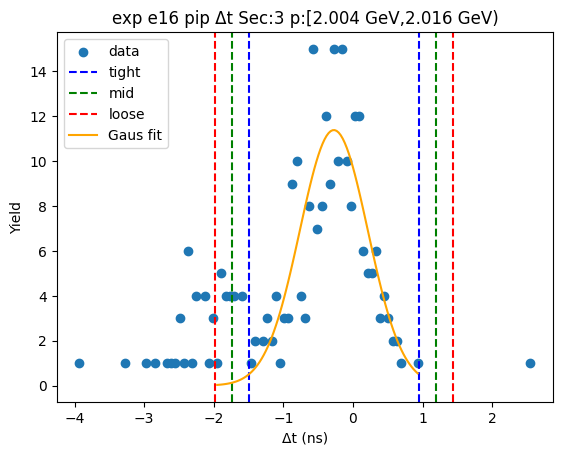

-1.4649362240319566 0.9697921637769238
-1.7084090628128448 1.213265002557812
-1.9518819015937328 1.4567378413387
[12.4235869  -0.24757203  0.48694568]


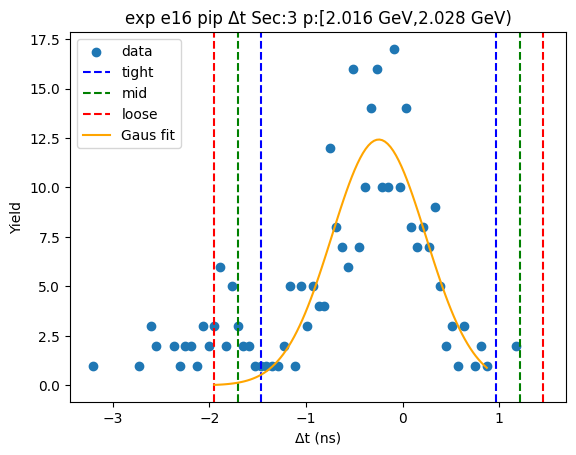

-1.202769410157905 0.7419267214223013
-1.3972390233159258 0.9363963345803221
-1.5917086364739463 1.1308659477383427
[13.86258503 -0.23042134  0.38893923]


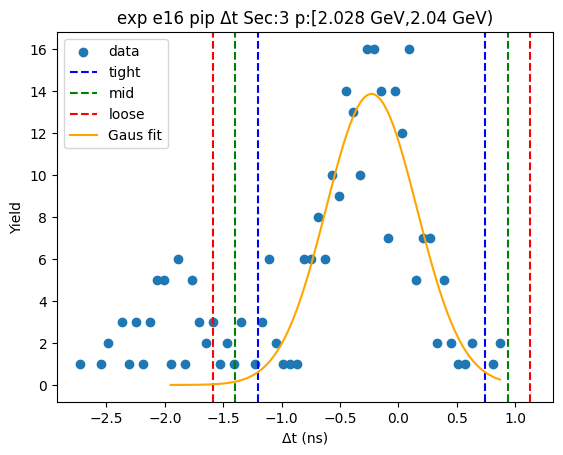

-2.276052025495592 1.4166956469771348
-2.645326792742864 1.7859704142244073
-3.014601559990137 2.15524518147168
[ 7.32783376 -0.42967819  0.73854953]


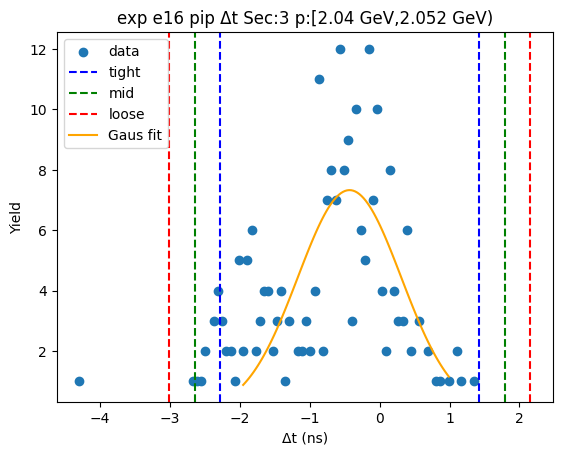

-1.382892677066518 0.7825002513803415
-1.5994319699112038 0.9990395442250274
-1.8159712627558902 1.2155788370697134
[11.09360094 -0.30019621  0.43307859]


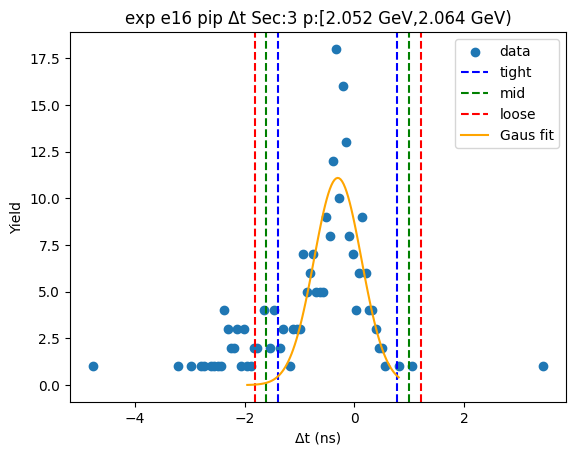

-1.2925828611546735 0.8109003162189021
-1.5029311788920312 1.0212486339562599
-1.7132794966293887 1.2315969516936174
[12.22672535 -0.24084127  0.42069664]


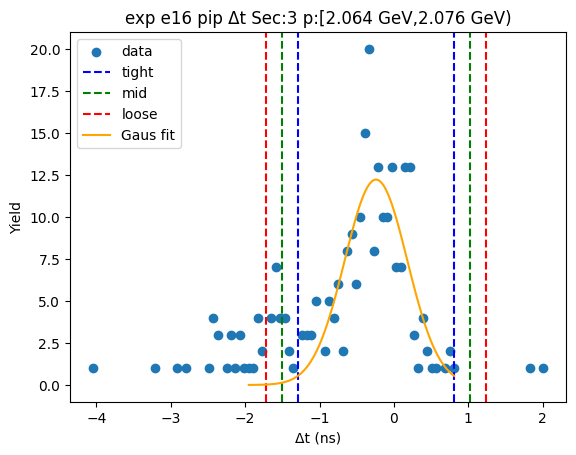

-1.5856182267995265 0.9709587904976361
-1.8412759285292428 1.2266164922273521
-2.0969336302589587 1.4822741939570685
[ 9.56648891 -0.30732972  0.5113154 ]


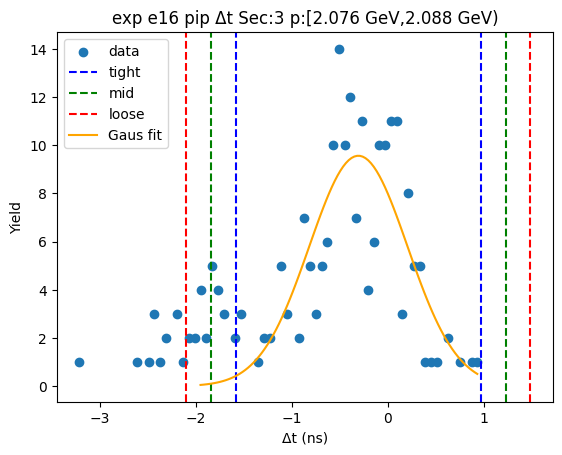

-1.327013466317764 0.8035044966634444
-1.5400652626158848 1.0165562929615652
-1.7531170589140057 1.2296080892596861
[13.0521266  -0.26175448  0.42610359]


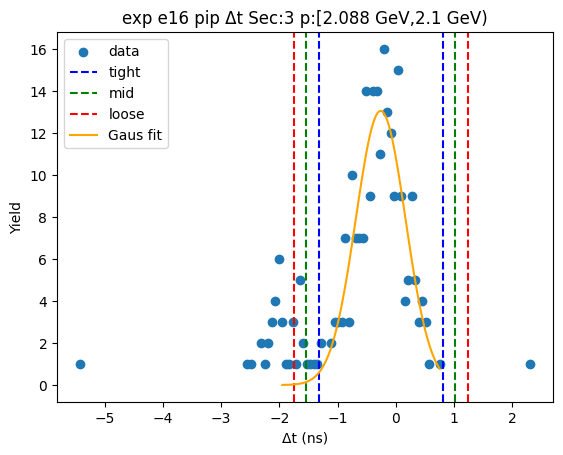

-1.4637980020106398 0.8442945369568265
-1.6946072559073864 1.0751037908535732
-1.9254165098041334 1.3059130447503198
[10.97073566 -0.30975173  0.46161851]


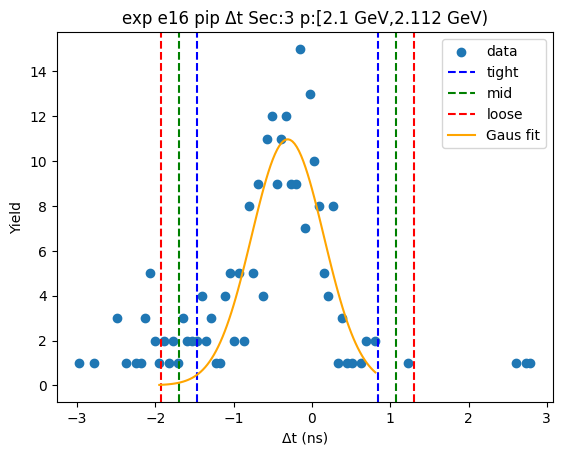

-1.302233221020116 0.8124688684312135
-1.5137034299652488 1.0239390773763462
-1.7251736389103816 1.235409286321479
[10.2353833  -0.24488218  0.42294042]


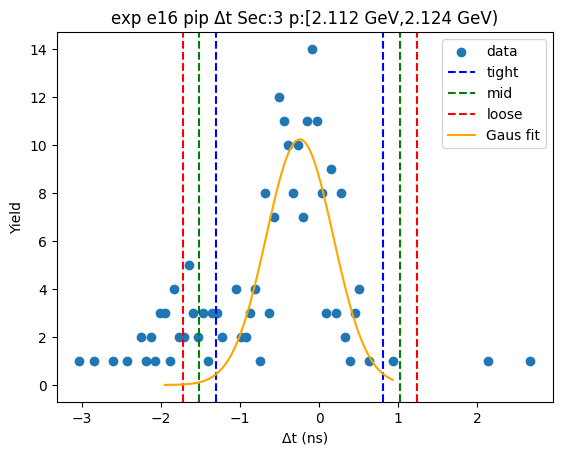

-2.121347262309244 1.5321287063518698
-2.4866948591753553 1.8974763032179809
-2.852042456041467 2.2628239000840926
[ 6.9440874  -0.29460928  0.73069519]


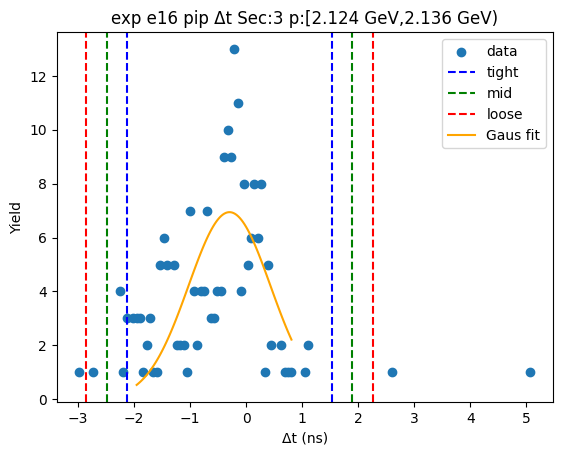

-1.5677944102750363 1.1916822628352897
-1.843742077586069 1.4676299301463223
-2.1196897448971015 1.7435775974573549
[ 9.44769137 -0.18805607  0.55189533]


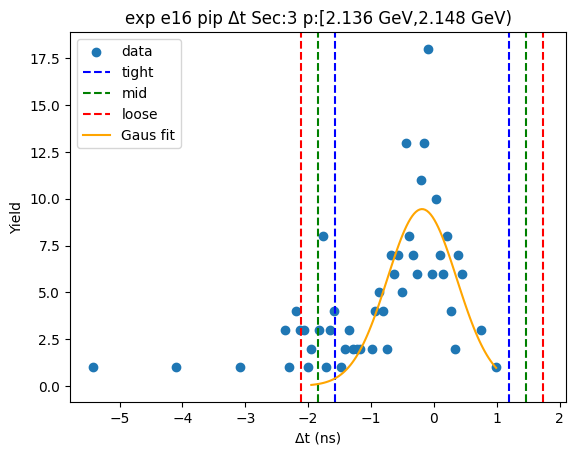

-1.318786943920208 0.6661861649096196
-1.5172842548031906 0.8646834757926024
-1.7157815656861732 1.0631807866755851
[11.39868186 -0.32630039  0.39699462]


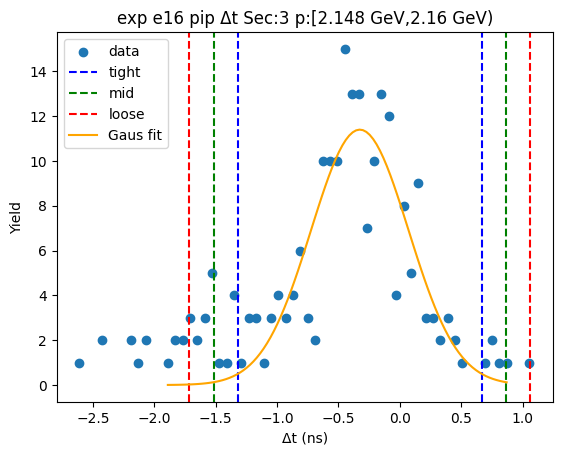

-1.4003734959922558 0.7707234671137341
-1.617483192302855 0.987833163424333
-1.8345928886134537 1.204942859734932
[ 9.27157544 -0.31482501  0.43421939]


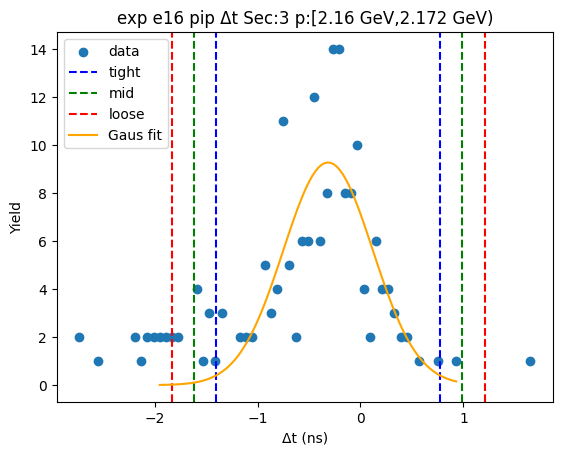

-1.9437568807628285 1.2104305353741558
-2.259175622376527 1.5258492769878542
-2.574594363990225 1.8412680186015524
[ 6.96447994 -0.36666317  0.63083748]


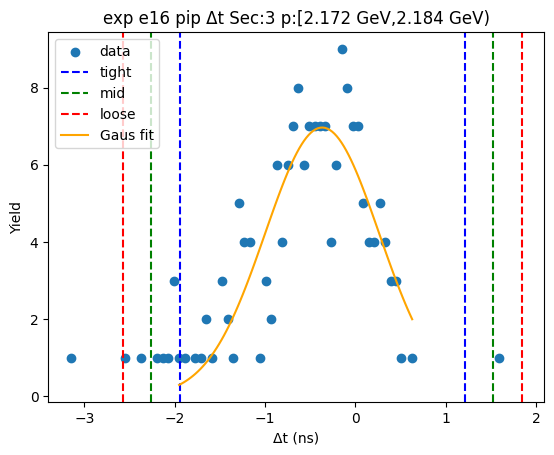

-1.613746282515209 0.9773629289871599
-1.8728572036654456 1.2364738501373966
-2.1319681248156823 1.4955847712876336
[ 8.87038791 -0.31819168  0.51822184]


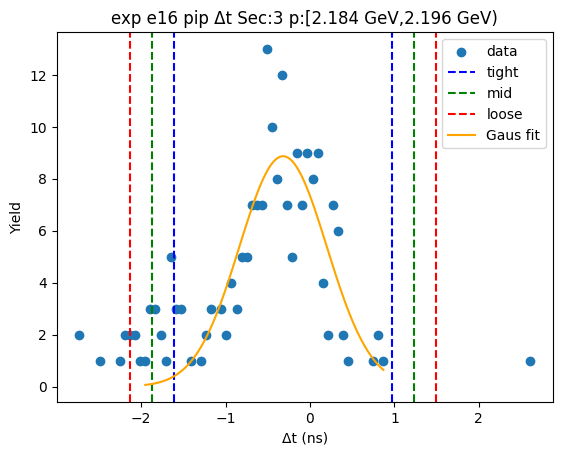

-1.9639807666467923 1.8957892000337122
-2.349957763314843 2.2817661967017626
-2.7359347599828934 2.667743193369813
[22.72410305 -0.03409578  0.77195399]


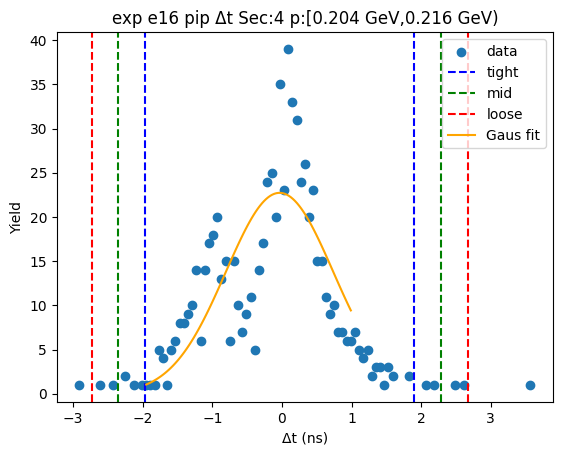

-1.9190814608678433 1.6305054496888132
-2.2740401519235087 1.9854641407444786
-2.6289988429791746 2.3404228318001445
[34.01733431 -0.14428801  0.70991738]


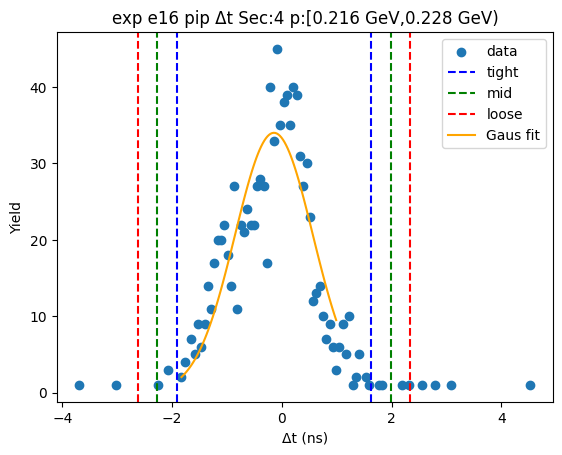

-1.9570950802659204 1.4855816237568686
-2.3013627506681993 1.8298492941591475
-2.645630421070478 2.1741169645614264
[45.06810271 -0.23575673  0.68853534]


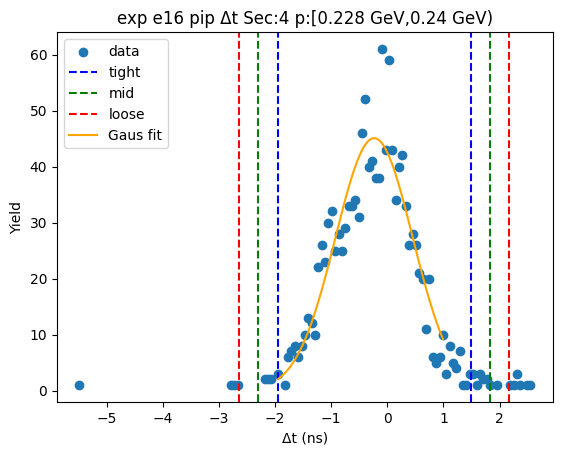

-1.7421039471241122 1.2484219787061783
-2.0411565397071416 1.5474745712892073
-2.3402091322901706 1.8465271638722367
[63.68866972 -0.24684098  0.59810519]


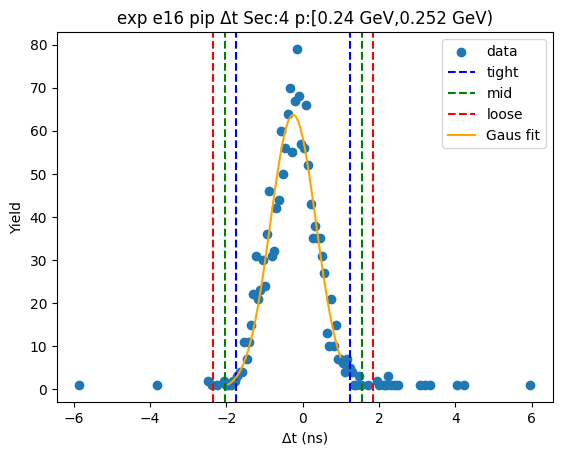

-1.5168254751174957 0.993798987772385
-1.7678879214064835 1.2448614340613728
-2.0189503676954716 1.495923880350361
[86.7703353  -0.26151324  0.50212489]


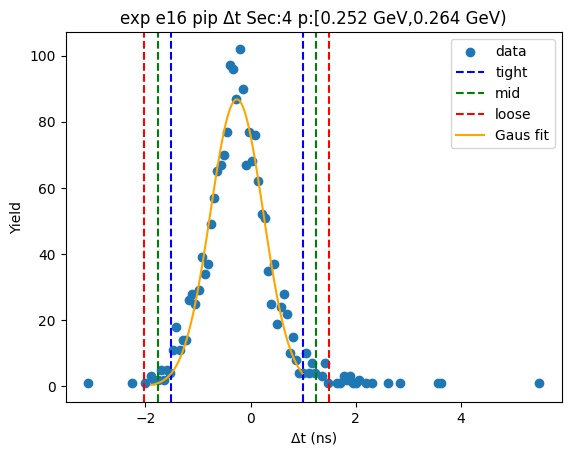

-1.5904241906034253 1.0727459933227068
-1.8567412089960387 1.3390630117153202
-2.1230582273886522 1.6053800301079335
[81.06672194 -0.2588391   0.53263404]


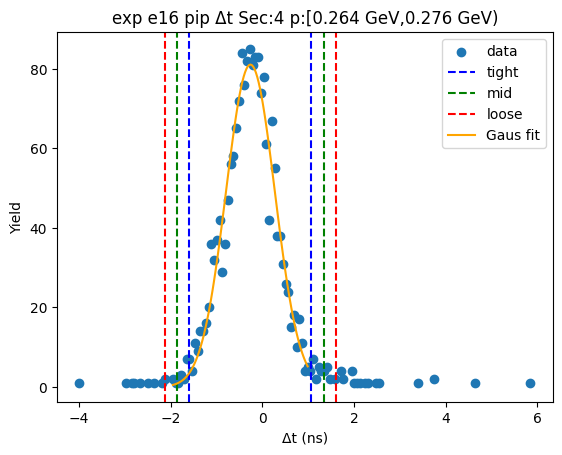

-1.4489001589942785 0.9116383222210513
-1.6849540071158113 1.1476921703425842
-1.9210078552373442 1.383746018464117
[89.57318569 -0.26863092  0.4721077 ]


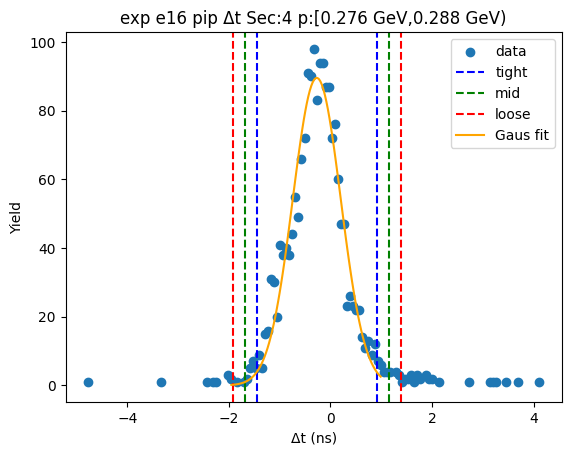

-1.4123791982462273 0.8870358486207748
-1.6423207029329274 1.116977353307475
-1.8722622076196276 1.346918857994175
[93.56809038 -0.26267167  0.45988301]


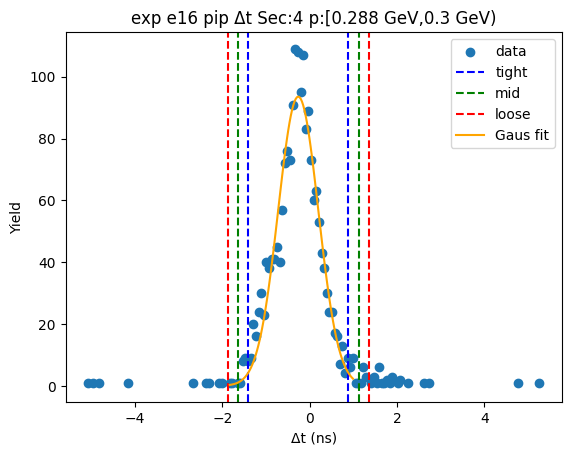

-1.4737747669591041 0.840342953457694
-1.7051865390007839 1.0717547254993738
-1.9365983110424638 1.3031664975410537
[102.98839105  -0.31671591   0.46282354]


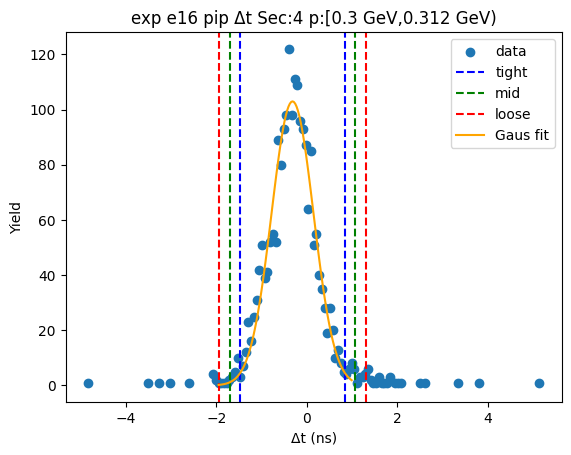

-1.6532824681418565 0.9063379037326855
-1.9092445053293106 1.1622999409201396
-2.165206542516765 1.4182619781075938
[104.34554143  -0.37347228   0.51192407]


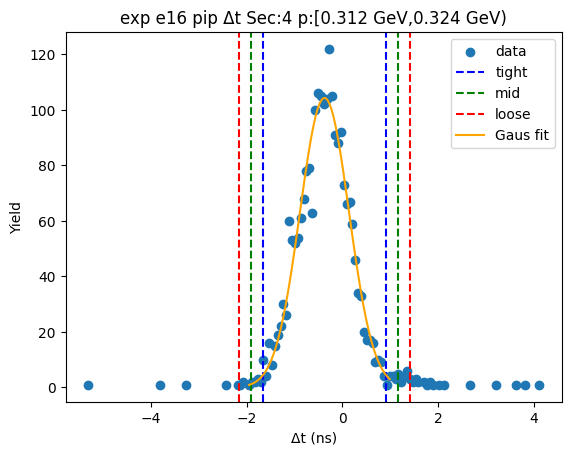

-1.6616681778452285 0.8590552726472773
-1.913740522894479 1.111127617696528
-2.1658128679437296 1.3631999627457785
[108.63559352  -0.40130645   0.50414469]


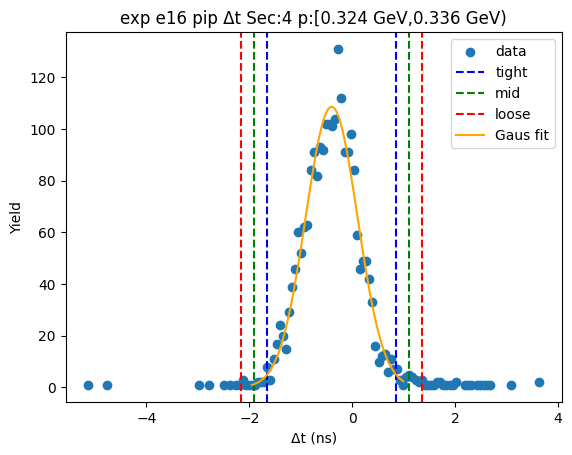

-1.7663421222186964 0.9226903977443875
-2.0352453742150045 1.191593649740696
-2.304148626211313 1.4604969017370042
[104.34023982  -0.42182586   0.5378065 ]


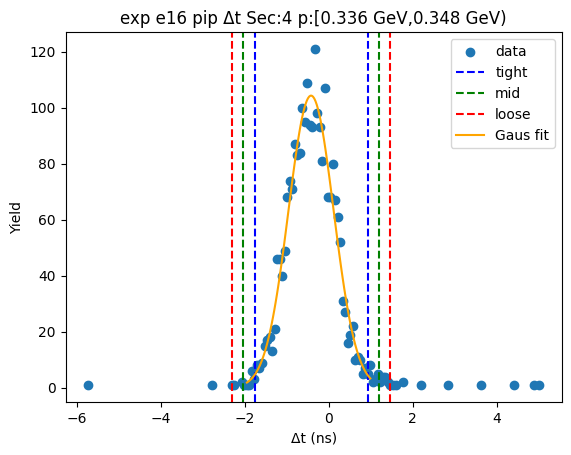

-1.7780858964091042 0.8918424711925065
-2.045078733169265 1.1588353079526676
-2.3120715699294263 1.4258281447128285
[109.9725715   -0.44312171   0.53398567]


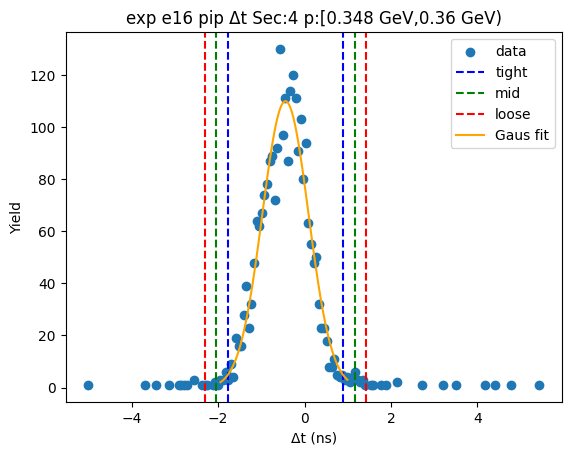

-1.98544012980786 0.9394022399446557
-2.2779243667831115 1.231886476919907
-2.5704086037583633 1.5243707138951588
[104.25351186  -0.52301894   0.58496847]


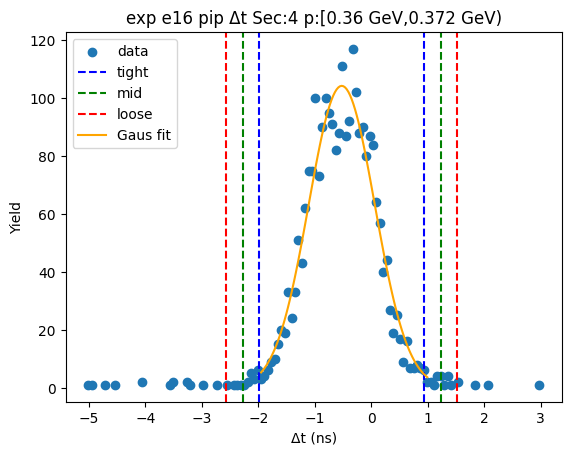

-1.989728807199021 0.80311304627846
-2.269012992546769 1.0823972316262078
-2.5482971778945167 1.3616814169739562
[107.64677541  -0.59330788   0.55856837]


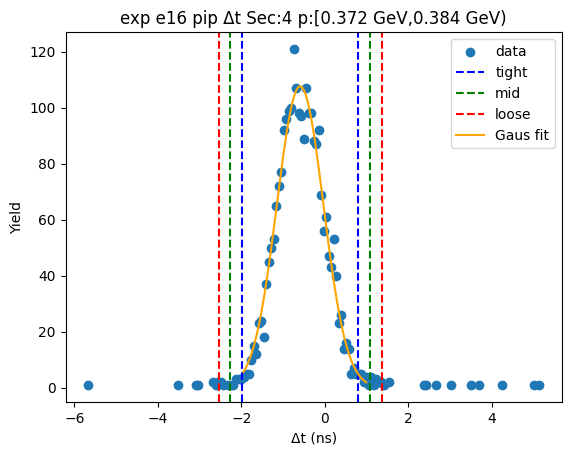

-1.9624205934009504 0.7320799395496742
-2.231870646696013 1.0015299928447365
-2.501320699991075 1.2709800461397989
[114.77348311  -0.61517033   0.53890011]


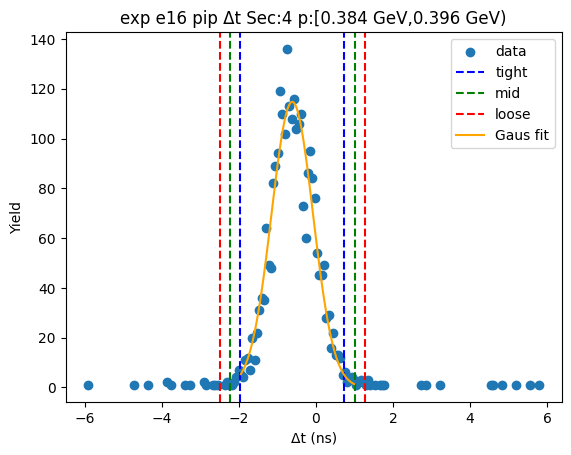

-1.9367586348672248 0.6986914642296105
-2.200303644776908 0.9622364741392941
-2.463848654686592 1.2257814840489778
[120.31029518  -0.61903359   0.52709002]


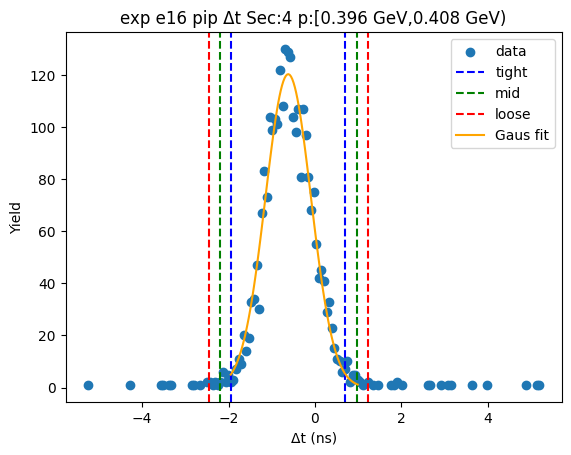

-1.9408645995246365 0.7320264803465734
-2.208153707511758 0.9993155883336945
-2.475442815498879 1.2666046963208157
[113.07313179  -0.60441906   0.53457822]


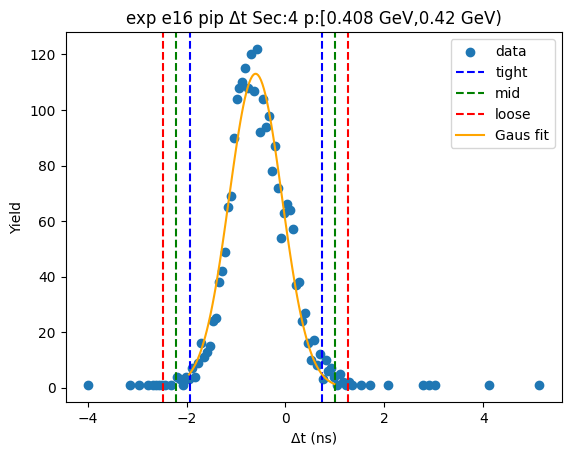

-2.0216439911101127 1.0243836640226562
-2.32624675662339 1.328986429535933
-2.630849522136667 1.6335891950492103
[106.9569677   -0.49863016   0.60920553]


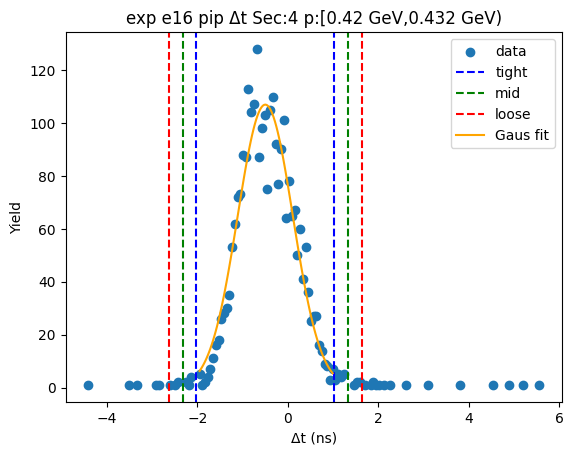

-2.011281019294916 1.2449993786761058
-2.3369090590920183 1.570627418473208
-2.662537098889121 1.8962554582703104
[98.66554642 -0.38314082  0.65125608]


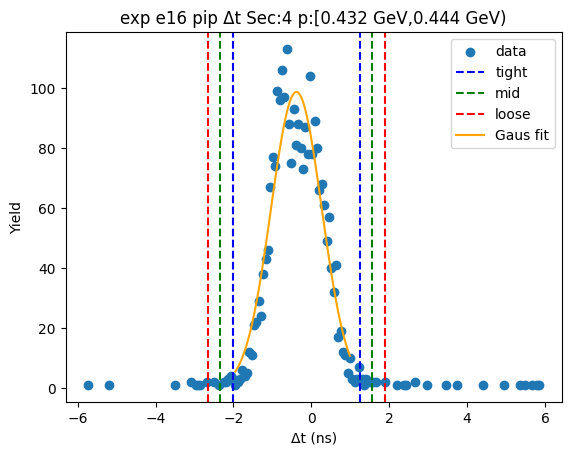

-2.0096214164039536 1.39923261219778
-2.3505068192641274 1.7401180150579536
-2.6913922221243007 2.0810034179181267
[99.00717792 -0.3051944   0.68177081]


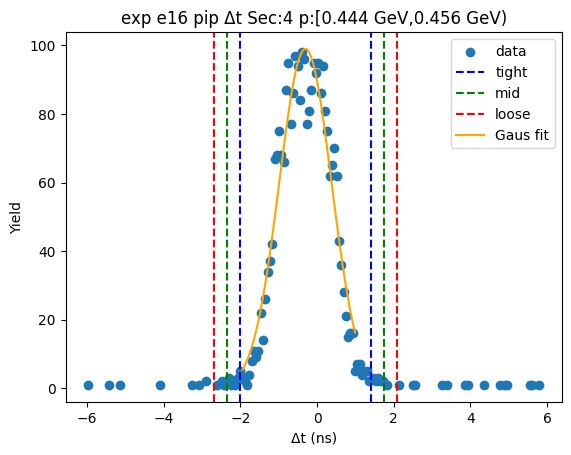

-1.9297373484232487 1.4381928816004637
-2.26653037142562 1.774985904602835
-2.603323394427991 2.111778927605206
[99.36606907 -0.24577223  0.67358605]


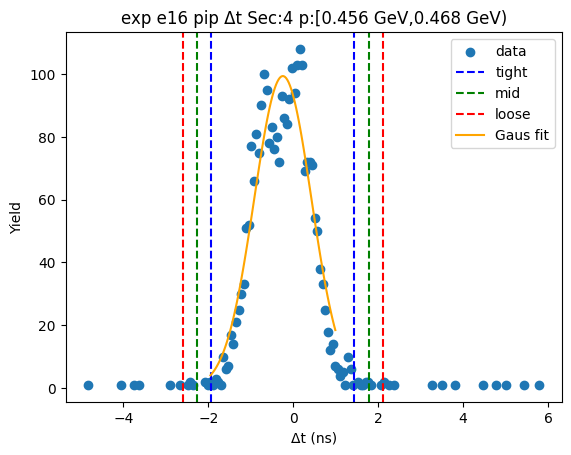

-1.7938287549397256 1.4773384982632771
-2.1209454802600263 1.8044552235835776
-2.4480622055803263 2.1315719489038774
[104.48651869  -0.15824513   0.65423345]


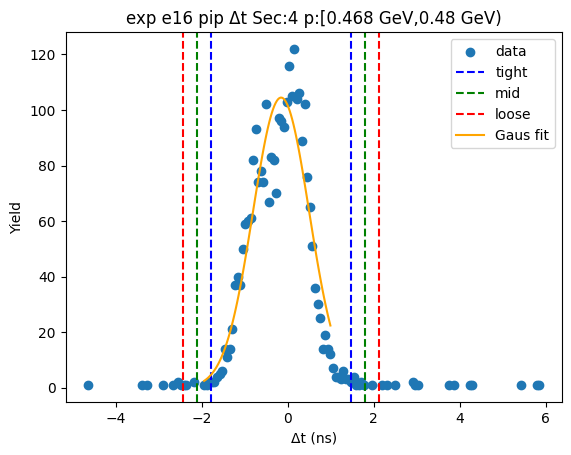

-1.8342396621288837 1.5231804800121351
-2.1699816763429856 1.858922494226237
-2.5057236905570877 2.194664508440339
[103.34215035  -0.15552959   0.67148403]


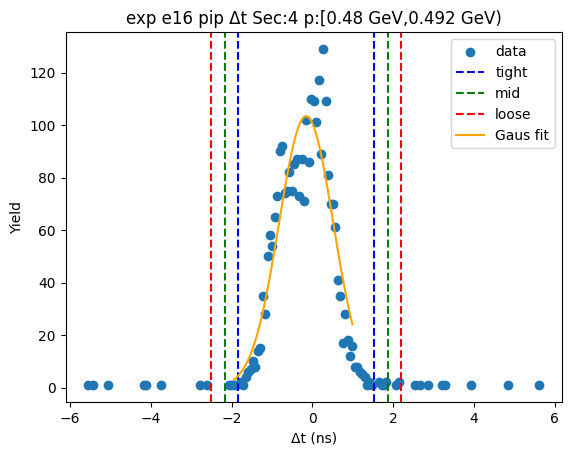

-1.7796854325023477 1.493649557040342
-2.107018931456617 1.8209830559946112
-2.4343524304108857 2.1483165549488805
[102.40136536  -0.14301794   0.654667  ]


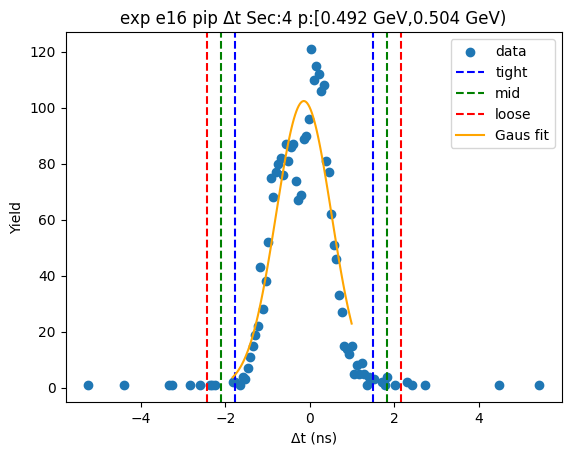

-1.7096908299570972 1.5056675837849733
-2.031226671331304 1.8272034251591802
-2.352762512705511 2.1487392665333873
[ 1.05801459e+02 -1.02011623e-01  6.43071683e-01]


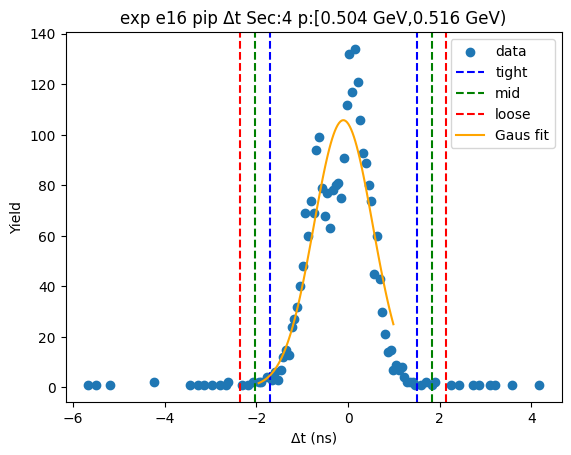

-1.5917293553615453 1.424267748866116
-1.8933290657843114 1.725867459288882
-2.1949287762070773 2.027467169711648
[ 1.07686388e+02 -8.37308032e-02  6.03199421e-01]


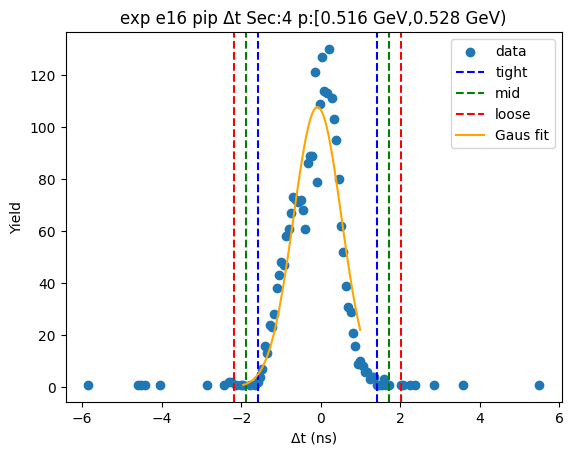

-1.5107583947440506 1.3827763148863055
-1.800111865707086 1.672129785849341
-2.0894653366701217 1.9614832568123768
[ 1.16871856e+02 -6.39910399e-02  5.78706942e-01]


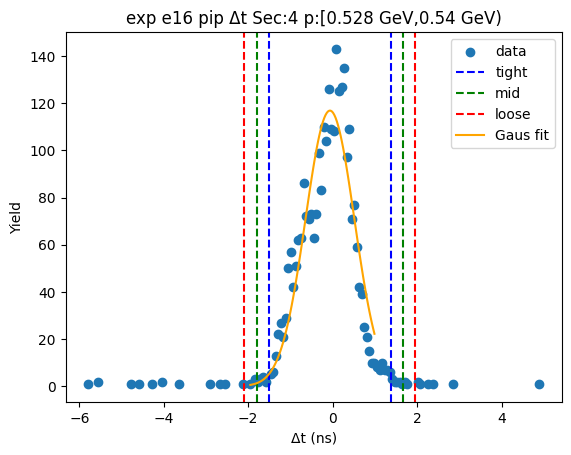

-1.5509708007396452 1.4755381036598734
-1.853621691179597 1.7781889940998252
-2.156272581619549 2.080839884539777
[ 1.09016637e+02 -3.77163485e-02  6.05301781e-01]


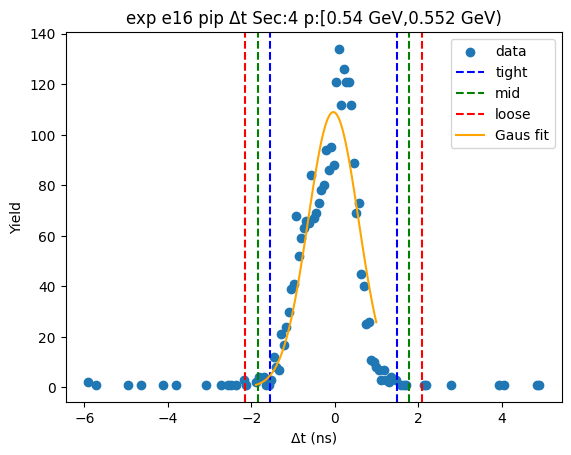

-1.3487619844013865 1.3670238343858772
-1.6203405662801127 1.6386024162646033
-1.891919148158839 1.9101809981433298
[1.15906793e+02 9.13092499e-03 5.43157164e-01]


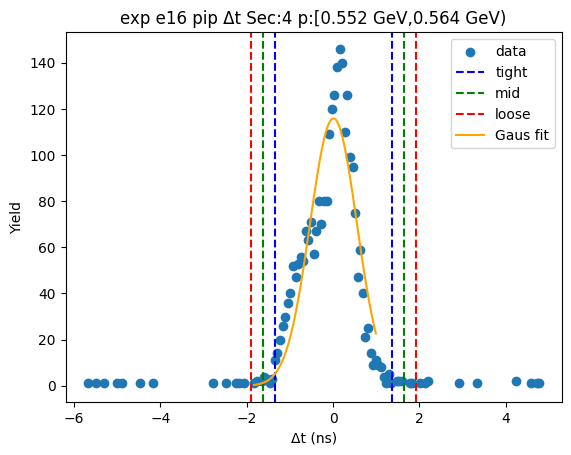

-1.1704339216267403 1.2517766800458787
-1.4126549817940024 1.4939977402131408
-1.6548760419612643 1.7362188003804027
[1.27520712e+02 4.06713792e-02 4.84442120e-01]


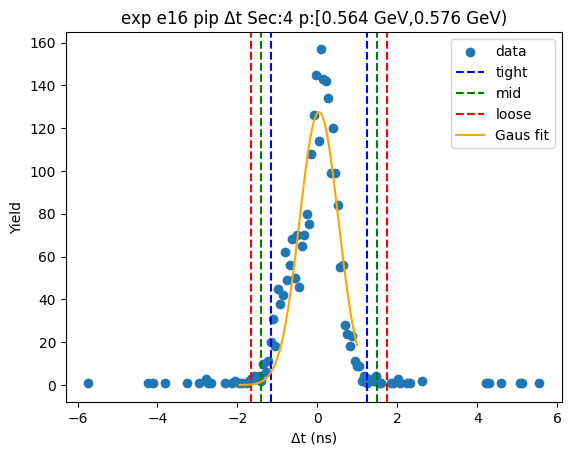

-1.355057091053678 1.3749838901416556
-1.6280611891732113 1.6479879882611888
-1.9010652872927447 1.9209920863807222
[1.10511669e+02 9.96339954e-03 5.46008196e-01]


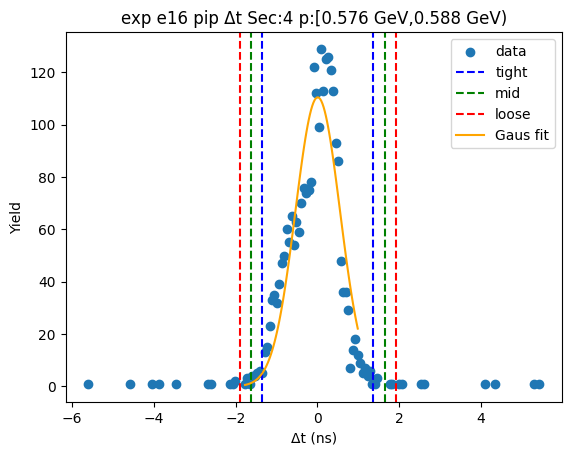

-1.4912427451746746 1.3867291101138264
-1.7790399307035245 1.6745262956426763
-2.066837116232375 1.9623234811715267
[ 1.09549303e+02 -5.22568175e-02  5.75594371e-01]


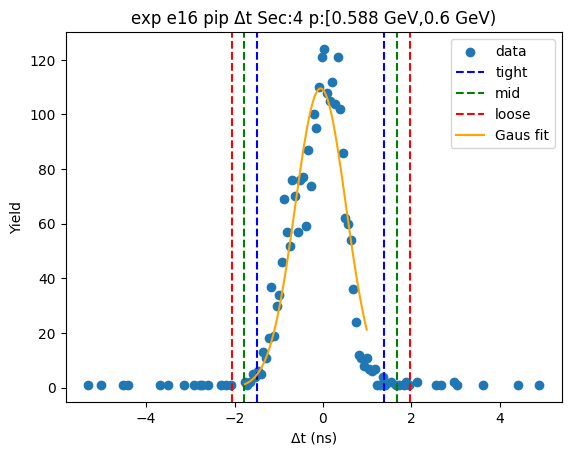

-1.5173596207245783 1.3079540165207275
-1.7998909844491089 1.590485380245258
-2.0824223481736395 1.8730167439697887
[ 1.07172122e+02 -1.04702802e-01  5.65062727e-01]


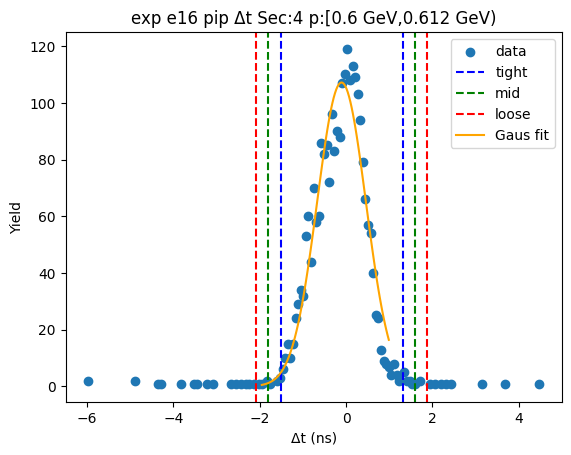

-1.5748892193045043 1.3037388943388895
-1.8627520306688439 1.591601705703229
-2.150614842033183 1.8794645170675683
[103.7210874   -0.13557516   0.57572562]


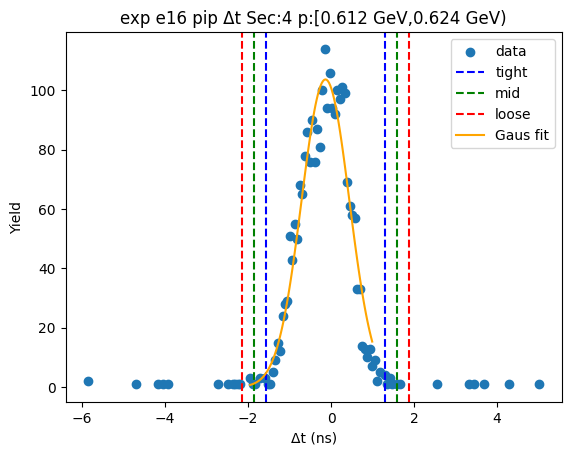

-1.5519688639209352 1.2893771167027
-1.8361034619832988 1.5735117147650635
-2.1202380600456623 1.857646312827427
[103.85799977  -0.13129587   0.5682692 ]


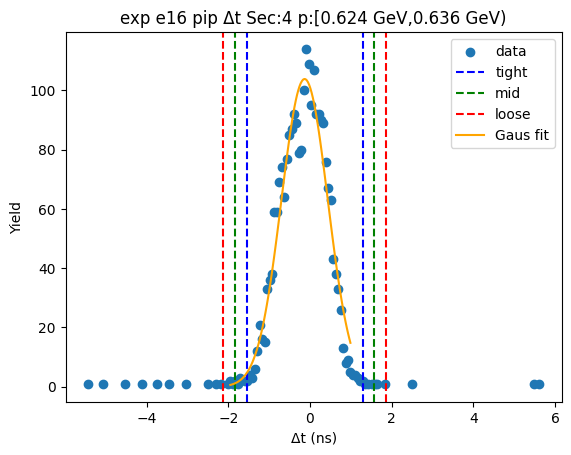

-1.6268435411152695 1.3344433804570923
-1.9229722332725059 1.6305720726143287
-2.219100925429742 1.9267007647715646
[95.79798434 -0.14620008  0.59225738]


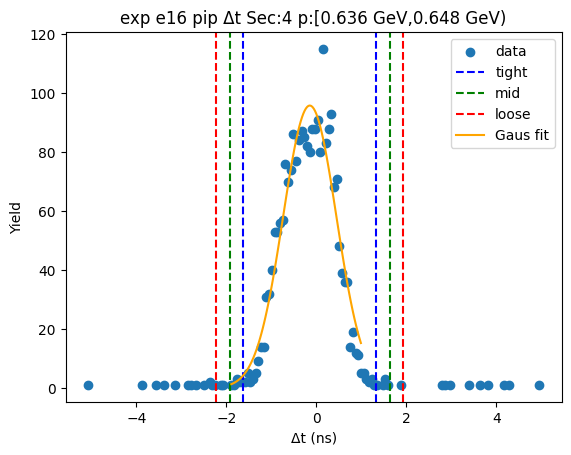

-1.5738004994444577 1.3416225470047127
-1.8653428040893747 1.6331648516496298
-2.1568851087342917 1.9247071562945468
[91.12623236 -0.11608898  0.58308461]


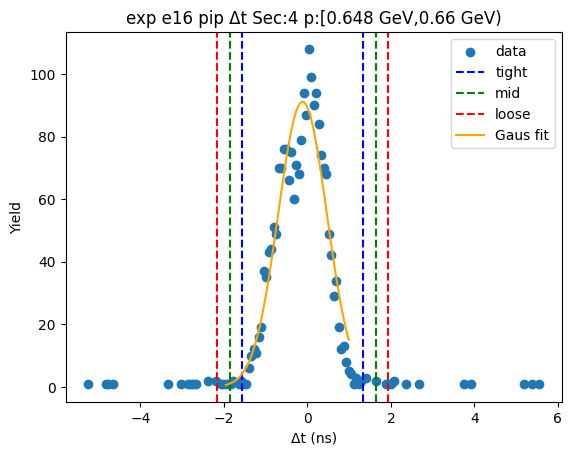

-1.5582331060177814 1.3195546872446002
-1.8460118853440197 1.6073334665708385
-2.1337906646702582 1.8951122458970768
[91.42181153 -0.11933921  0.57555756]


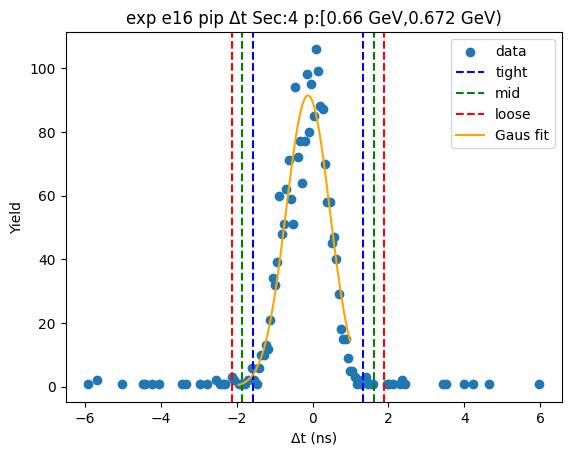

-1.504714784289136 1.3051455201740205
-1.7857008147354516 1.5861315506203362
-2.0666868451817675 1.8671175810666518
[92.15391292 -0.09978463  0.56197206]


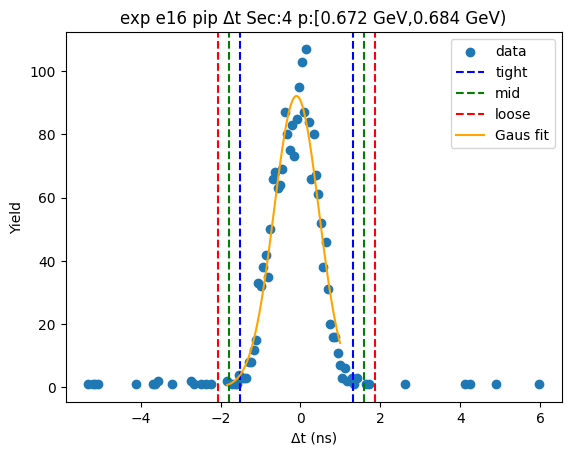

-1.3755416791310764 1.2055753420918305
-1.633653381253367 1.463687044214121
-1.8917650833756576 1.7217987463364117
[ 9.83491917e+01 -8.49831685e-02  5.16223404e-01]


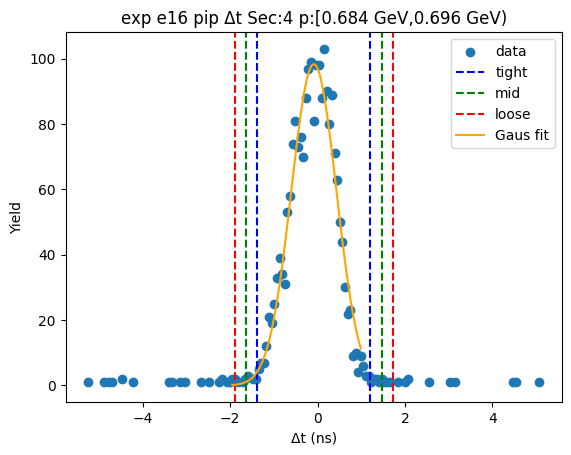

-1.2833969041392794 1.0994240534866841
-1.5216789999018758 1.3377061492492806
-1.7599610956644722 1.575988245011877
[ 1.05449676e+02 -9.19864253e-02  4.76564192e-01]


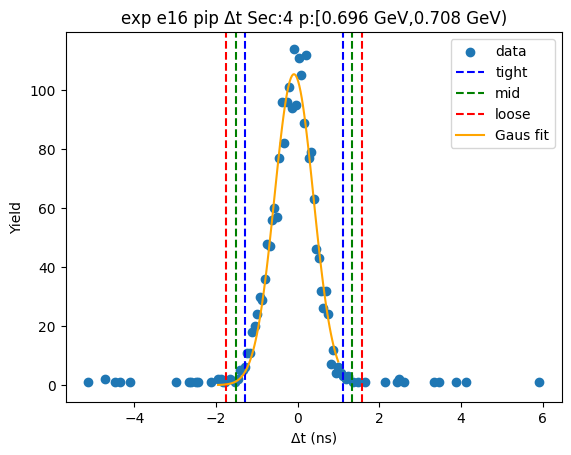

-1.337768413096135 1.1754746113403642
-1.5890927155397847 1.426798913784014
-1.8404170179834345 1.6781232162276638
[ 9.99452226e+01 -8.11469009e-02  5.02648605e-01]


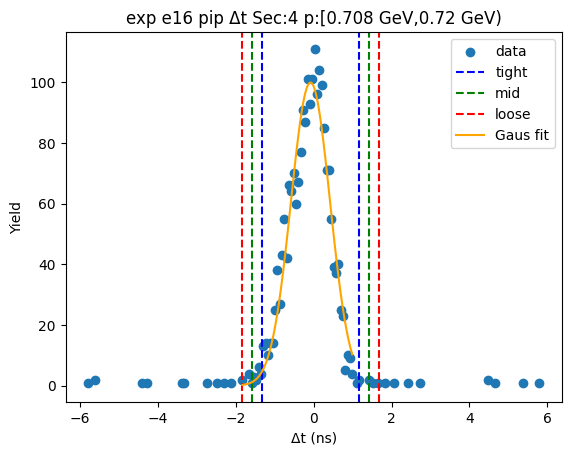

-1.3380678999338458 1.1411627210152955
-1.58599096202876 1.3890857831102092
-1.8339140241236738 1.6370088452051235
[ 1.00018094e+02 -9.84525895e-02  4.95846124e-01]


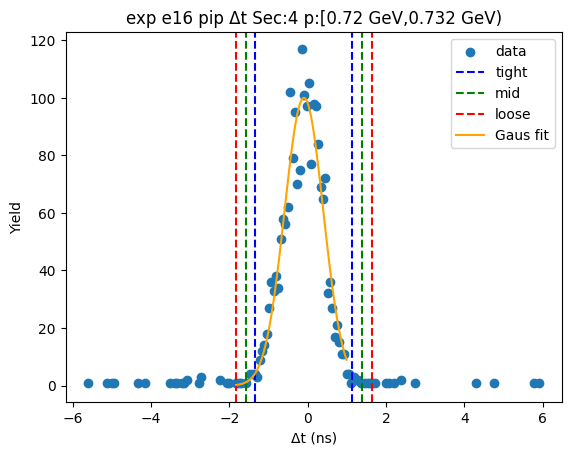

-1.2538254622534561 1.0762508358235146
-1.4868330920611532 1.3092584656312116
-1.7198407218688503 1.5422660954389087
[ 1.06255018e+02 -8.87873132e-02  4.66015260e-01]


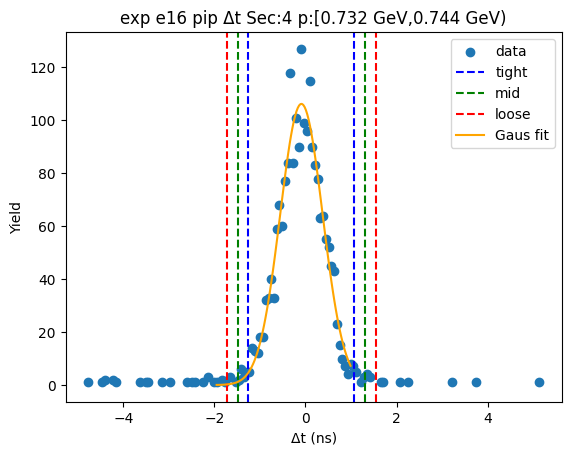

-1.2436639283625892 1.0784856809337193
-1.47587888929222 1.3107006418633502
-1.708093850221851 1.5429156027929811
[ 1.05577459e+02 -8.25891237e-02  4.64429922e-01]


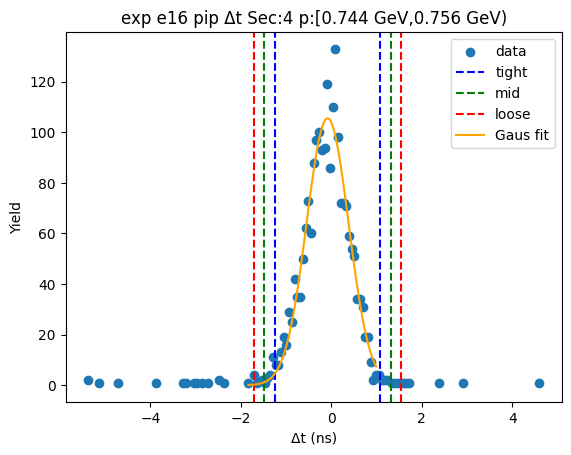

-1.2875378635656312 1.1230903648338046
-1.5286006864055748 1.3641531876737483
-1.7696635092455184 1.605216010513692
[ 9.63455141e+01 -8.22237494e-02  4.82125646e-01]


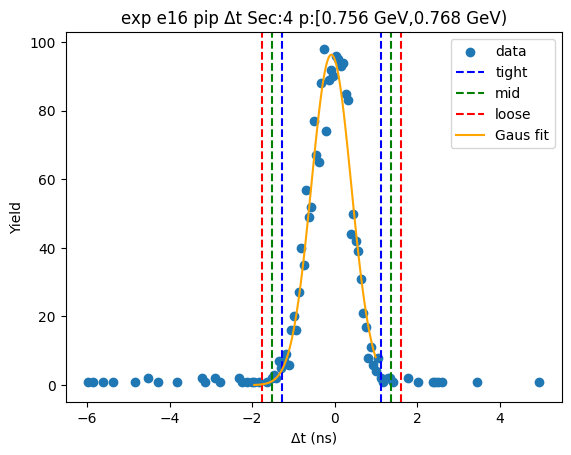

-1.2254809140974243 1.0846052106494473
-1.4564895265721116 1.3156138231241346
-1.687498139046799 1.5466224355988218
[ 1.01932409e+02 -7.04378517e-02  4.62017225e-01]


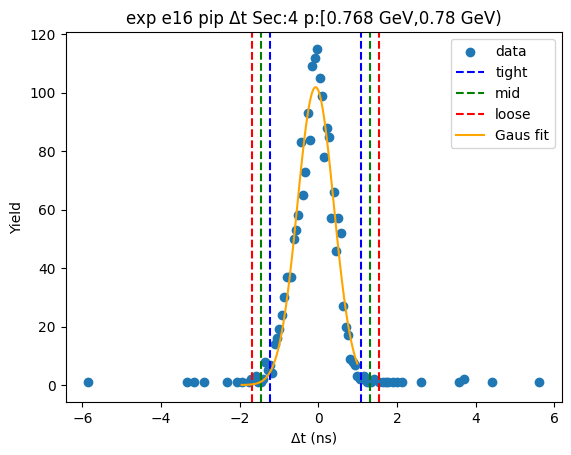

-1.1459493734410087 1.0666011895034782
-1.3672044297354573 1.2878562457979268
-1.588459486029906 1.5091113020923754
[ 1.00588216e+02 -3.96740920e-02  4.42510113e-01]


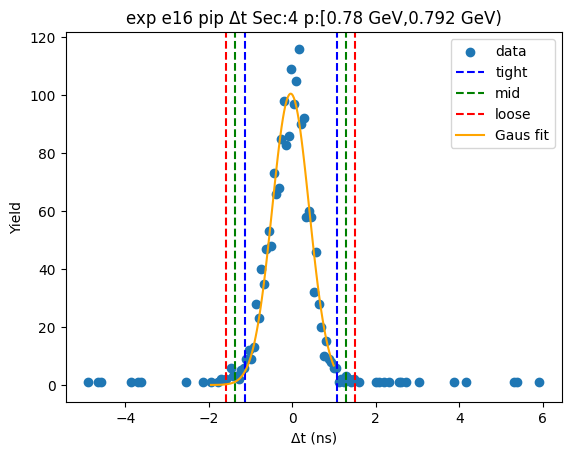

-1.1489235576531636 1.0547377417338213
-1.369289687591862 1.2751038716725198
-1.5896558175305606 1.4954700016112183
[ 9.82322907e+01 -4.70929080e-02  4.40732260e-01]


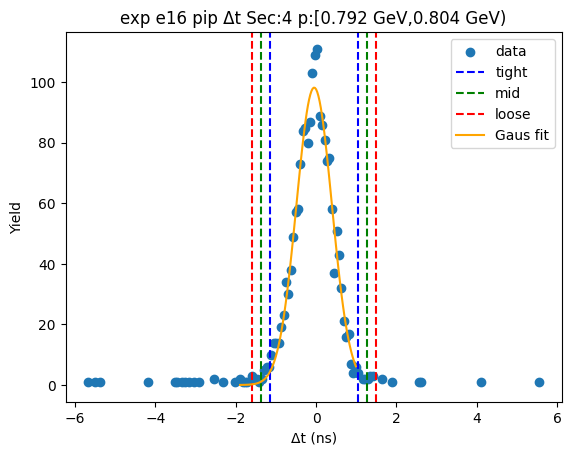

-1.0976496870347288 1.0456185218817833
-1.3119765079263799 1.2599453427734344
-1.5263033288180312 1.4742721636650857
[ 9.69079694e+01 -2.60155826e-02  4.28653642e-01]


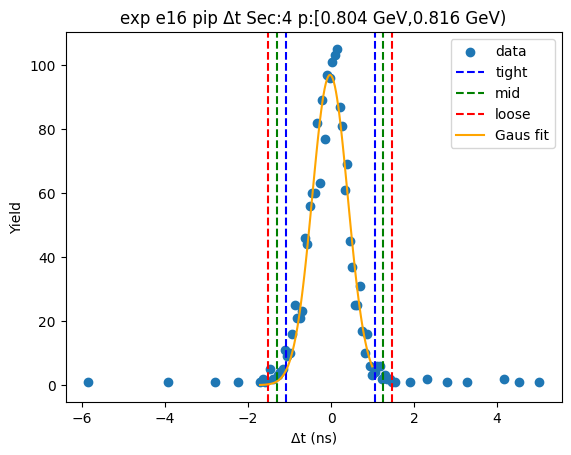

-1.1005966589061984 1.02934353363466
-1.3135906781602844 1.242337552888746
-1.5265846974143702 1.4553315721428317
[ 9.58706594e+01 -3.56265626e-02  4.25988039e-01]


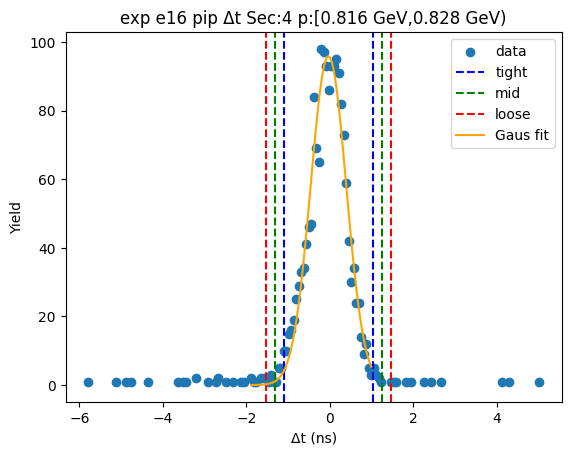

-1.093238888077272 1.0669534643757435
-1.3092581233225737 1.282972699621045
-1.5252773585678752 1.4989919348663465
[ 8.93337638e+01 -1.31427119e-02  4.32038470e-01]


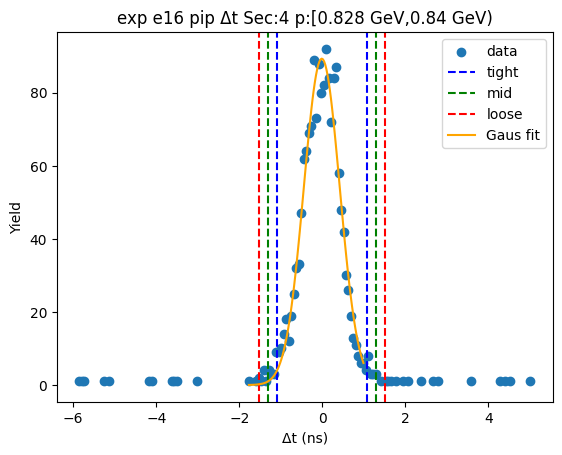

-1.1000240196459818 1.1065623910520352
-1.3206826607157836 1.327221032121837
-1.5413413017855853 1.5478796731916387
[9.04898960e+01 3.26918570e-03 4.41317282e-01]


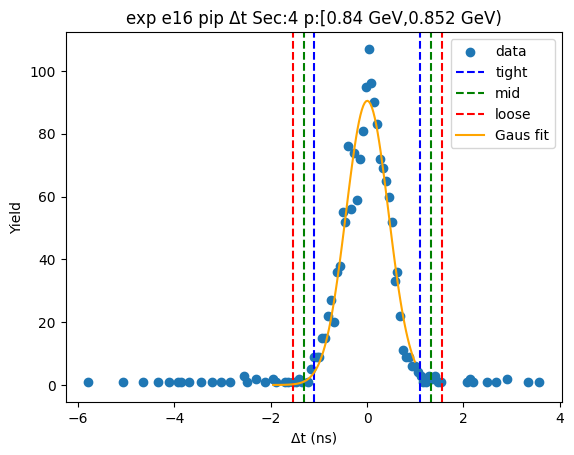

-1.0766334906113926 1.093609573210634
-1.2936577969935952 1.3106338795928365
-1.5106821033757978 1.527658185975039
[8.83513367e+01 8.48804130e-03 4.34048613e-01]


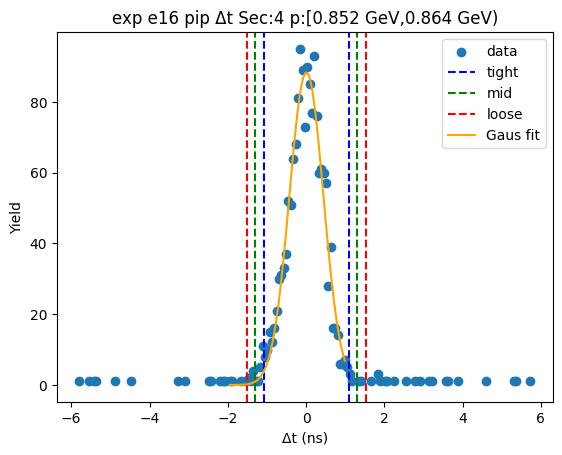

-1.08673830069391 1.0496967806308988
-1.3003818088263908 1.2633402887633796
-1.5140253169588718 1.4769837968958606
[ 8.76045433e+01 -1.85207600e-02  4.27287016e-01]


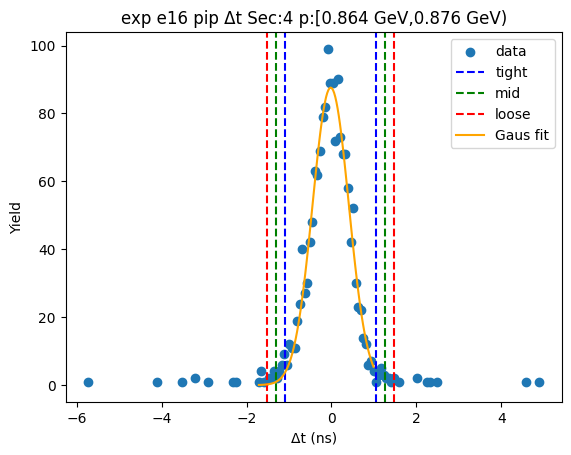

-1.0892905642357065 1.064911846732785
-1.3047108053325556 1.280332087829634
-1.5201310464294047 1.4957523289264831
[ 8.59545222e+01 -1.21893588e-02  4.30840482e-01]


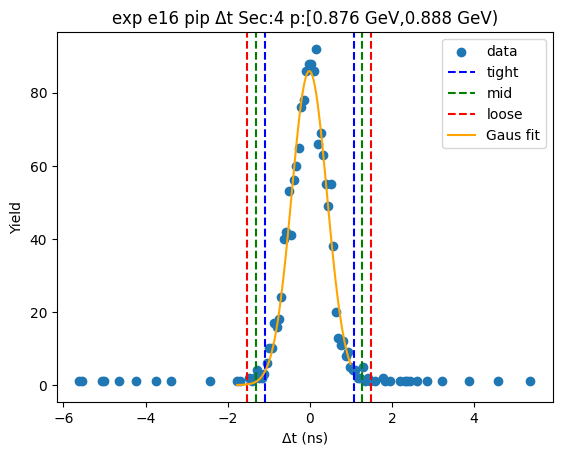

-1.037163666400531 1.0483450275465362
-1.2457145357952377 1.256895896941243
-1.4542654051899444 1.4654467663359496
[8.59452802e+01 5.59068057e-03 4.17101739e-01]


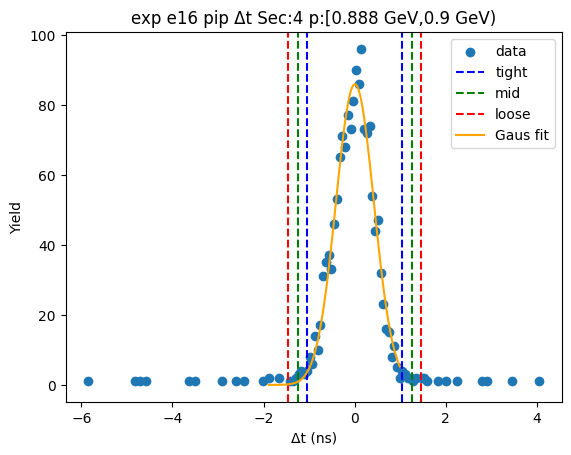

-1.1244206354874042 1.0779561975206682
-1.3446583187882113 1.2981938808214752
-1.5648960020890186 1.5184315641222825
[ 7.78527821e+01 -2.32322190e-02  4.40475367e-01]


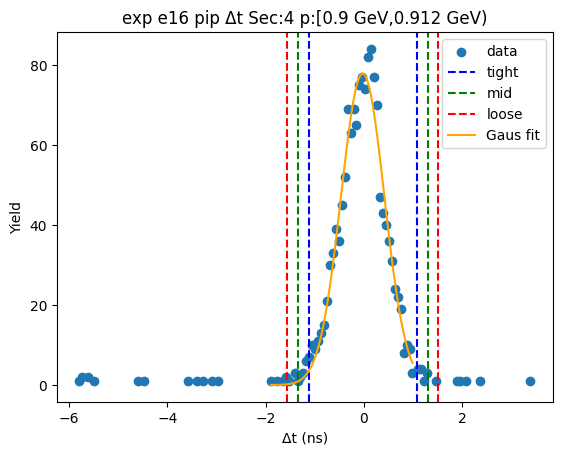

-1.0937212032891215 1.0402774423471817
-1.3071210678527518 1.253677306910812
-1.5205209324163822 1.4670771714744424
[ 7.84206083e+01 -2.67218805e-02  4.26799729e-01]


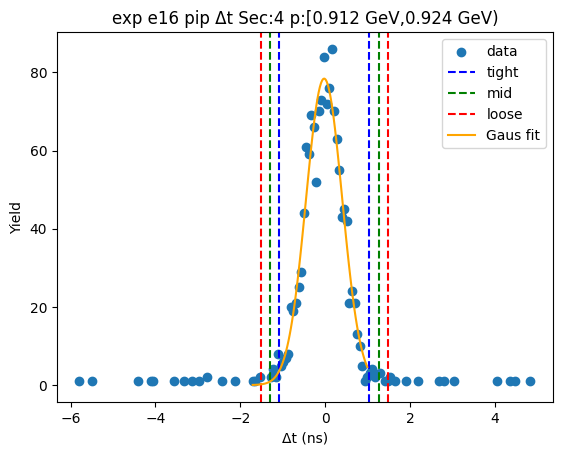

-1.058659678788367 0.987361026653981
-1.2632617493326017 1.1919630971982156
-1.4678638198768366 1.3965651677424504
[ 8.21792753e+01 -3.56493261e-02  4.09204141e-01]


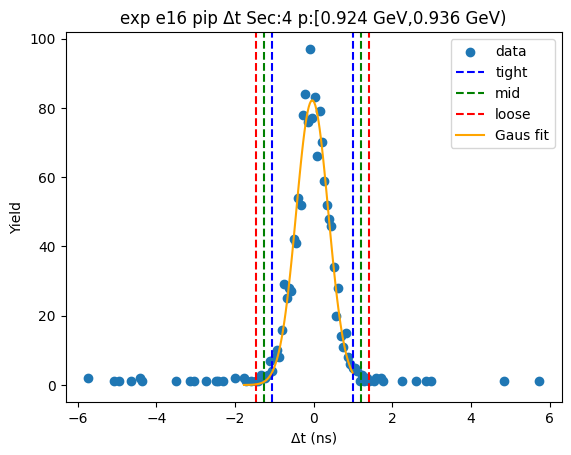

-1.0691021586977782 0.9838082852799512
-1.2743932030955512 1.1890993296777241
-1.479684247493324 1.394390374075497
[ 7.52123758e+01 -4.26469367e-02  4.10582089e-01]


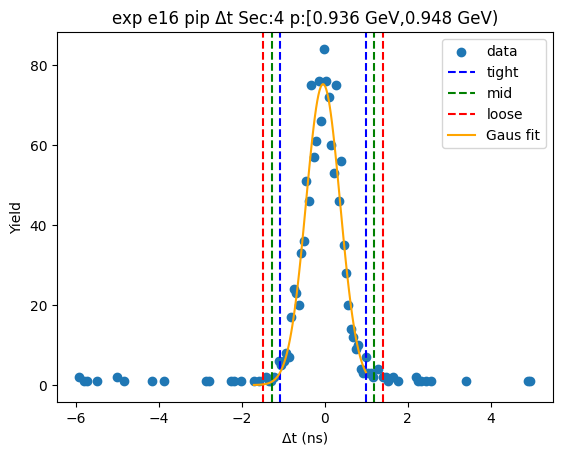

-1.1174325866307069 1.0539488953296254
-1.33457073482674 1.2710870435256585
-1.5517088830227732 1.4882251917216918
[ 7.46108630e+01 -3.17418457e-02  4.34276296e-01]


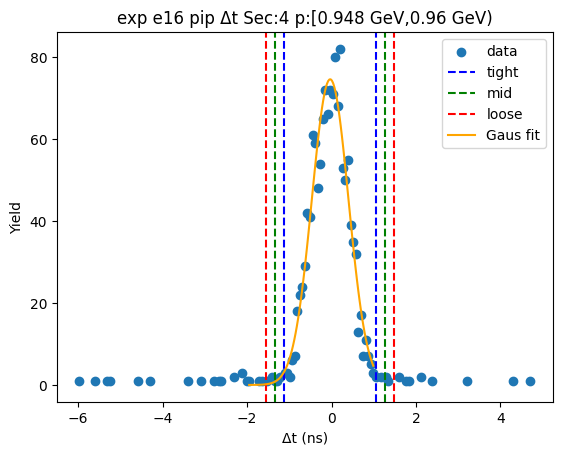

-1.0172655724086486 0.9272763350329982
-1.2117197631528132 1.1217305257771628
-1.406173953896978 1.3161847165213276
[ 8.12217827e+01 -4.49946187e-02  3.88908381e-01]


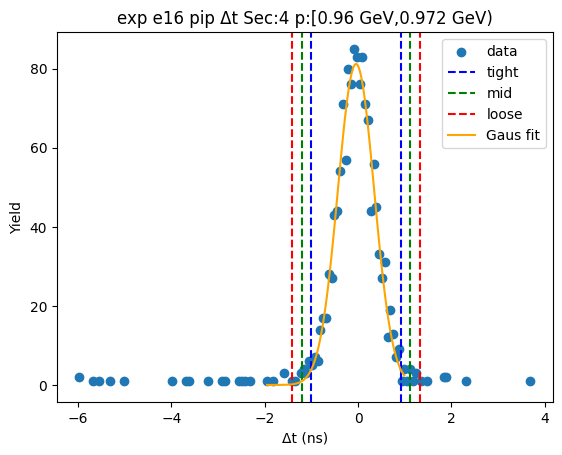

-1.060705658624833 0.9936833612028364
-1.2661445606075998 1.1991222631856033
-1.4715834625903668 1.4045611651683703
[ 7.45515998e+01 -3.35111487e-02  4.10877804e-01]


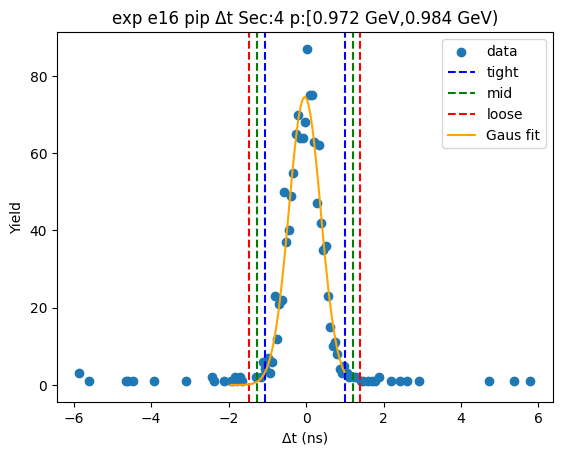

-1.0460571711813254 0.9986021975560586
-1.2505231080550638 1.203068134429797
-1.454989044928802 1.4075340713035354
[ 7.29713582e+01 -2.37274868e-02  4.08931874e-01]


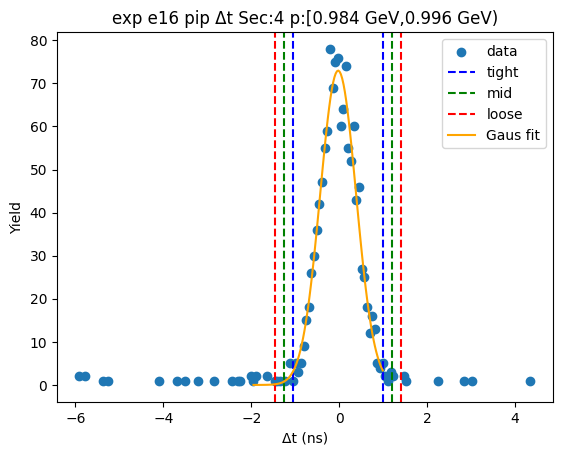

-0.993986820908534 0.9280584079047568
-1.1861913437898632 1.1202629307860859
-1.3783958666711922 1.3124674536674148
[ 7.50160161e+01 -3.29642065e-02  3.84409046e-01]


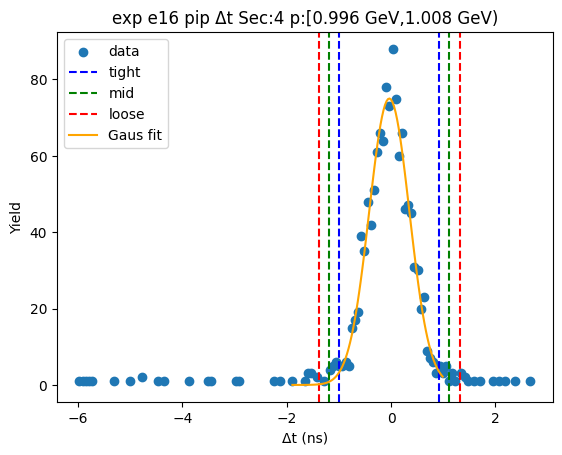

-1.0516164279839675 0.9815073035306989
-1.254928801135434 1.1848196766821655
-1.4582411742869008 1.3881320498336323
[ 7.13511041e+01 -3.50545622e-02  4.06624746e-01]


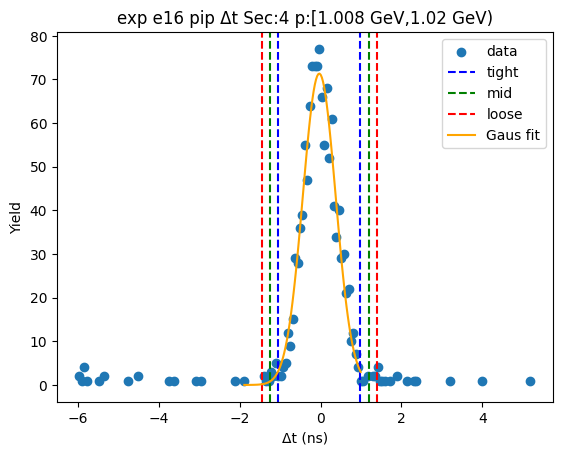

-0.9485068288385538 0.9235875489788131
-1.1357162666202902 1.1107969867605498
-1.322925704402027 1.2980064245422867
[ 7.12555597e+01 -1.24596399e-02  3.74418876e-01]


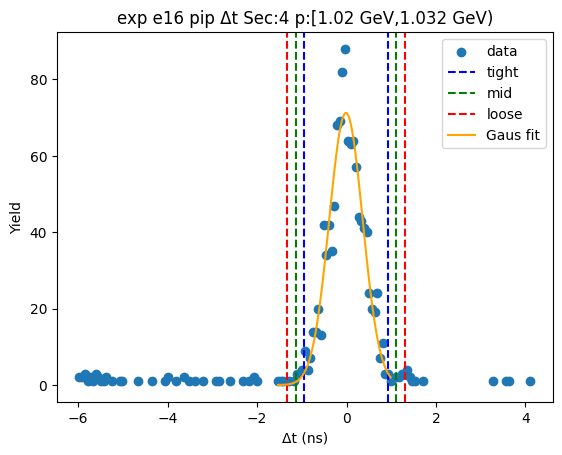

-1.0056909814789328 0.9351662019900053
-1.1997766998258266 1.1292519203368991
-1.3938624181727204 1.323337638683793
[ 6.49783796e+01 -3.52623897e-02  3.88171437e-01]


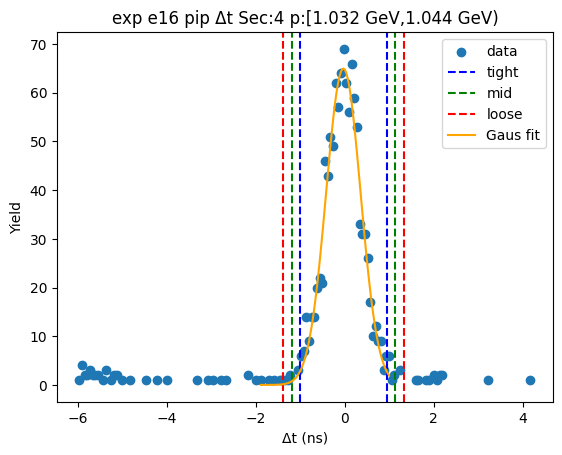

-1.0090003150085327 0.9938415589976397
-1.20928450240915 1.194125746398257
-1.4095686898097675 1.3944099337988745
[ 6.36790356e+01 -7.57937801e-03  4.00568375e-01]


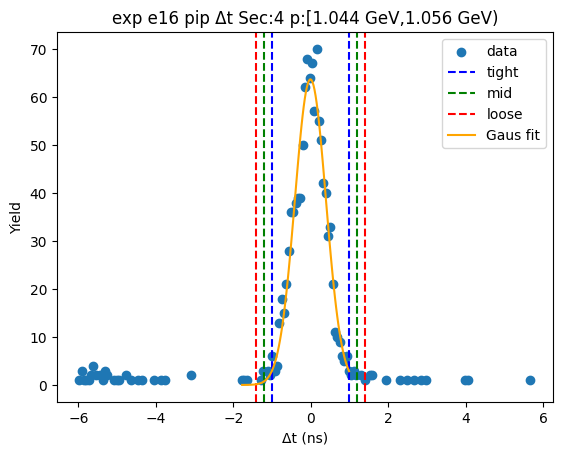

-1.0542893102489155 1.0299327574950181
-1.2627115170233087 1.2383549642694114
-1.4711337237977022 1.4467771710438049
[ 6.23242503e+01 -1.21782764e-02  4.16844414e-01]


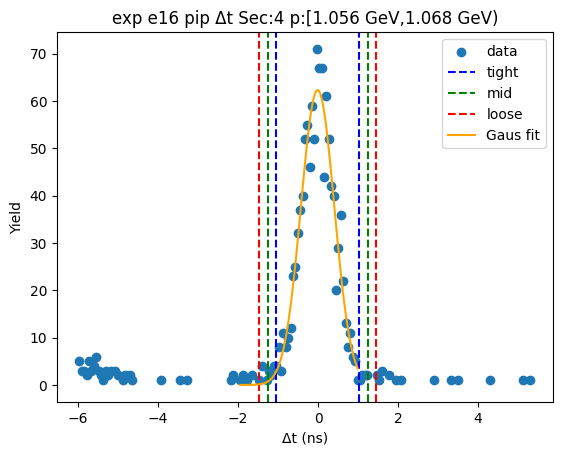

-1.0284406738173062 1.0430660059361436
-1.2355913417926512 1.2502166739114886
-1.4427420097679962 1.4573673418868336
[5.95596359e+01 7.31266606e-03 4.14301336e-01]


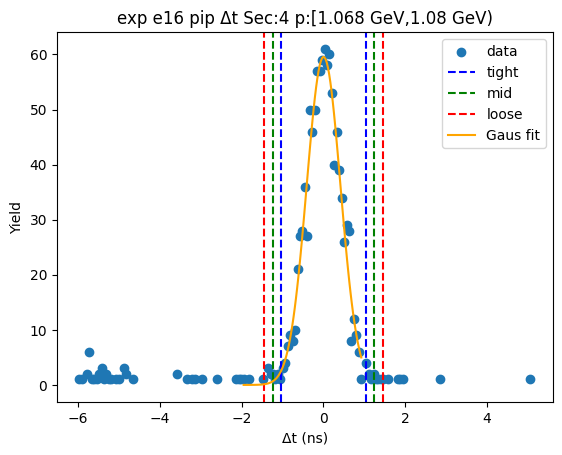

-0.9550119408079947 0.9605218265501727
-1.1465653175438115 1.1520752032859893
-1.3381186942796284 1.3436285800218062
[6.57898682e+01 2.75494287e-03 3.83106753e-01]


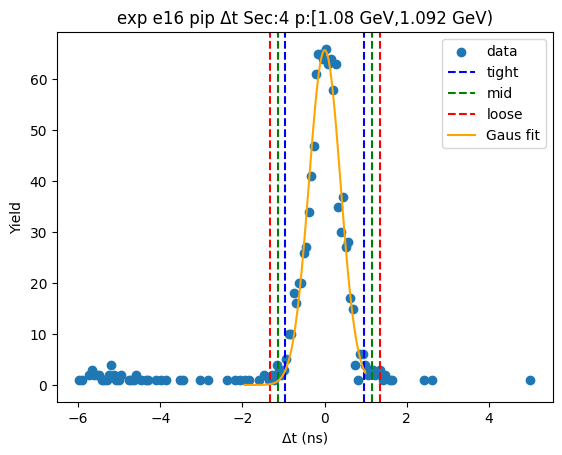

-0.9880978663890472 0.9676697921239306
-1.1836746322403449 1.1632465579752282
-1.3792513980916428 1.3588233238265262
[ 5.75956984e+01 -1.02140371e-02  3.91153532e-01]


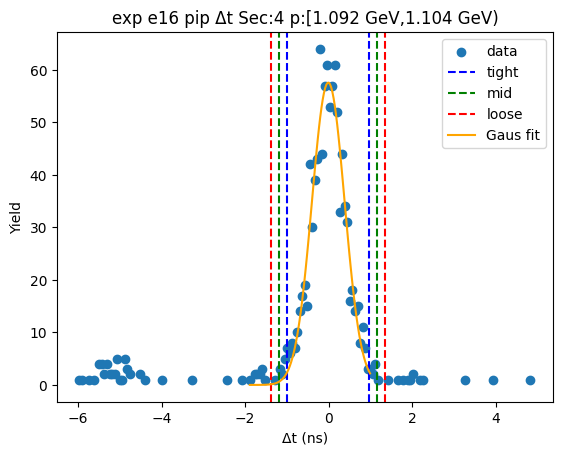

-0.9388374301204169 1.0017935892855927
-1.132900532061018 1.1958566912261939
-1.3269636340016189 1.3899197931667948
[5.32666993e+01 3.14780796e-02 3.88126204e-01]


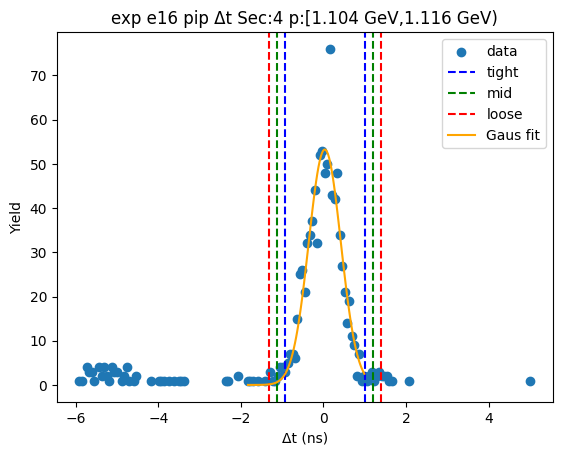

-0.9859134813794543 0.9796770557225654
-1.1824725350896563 1.1762361094327671
-1.3790315887998583 1.3727951631429691
[ 5.71082277e+01 -3.11821283e-03  3.93118107e-01]


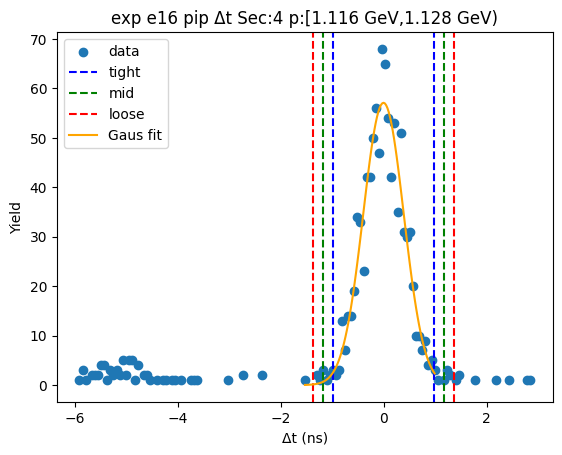

-0.9252307956433026 1.00934194619678
-1.118688069827311 1.2027992203807882
-1.312145344011319 1.3962564945647964
[5.19475465e+01 4.20555753e-02 3.86914548e-01]


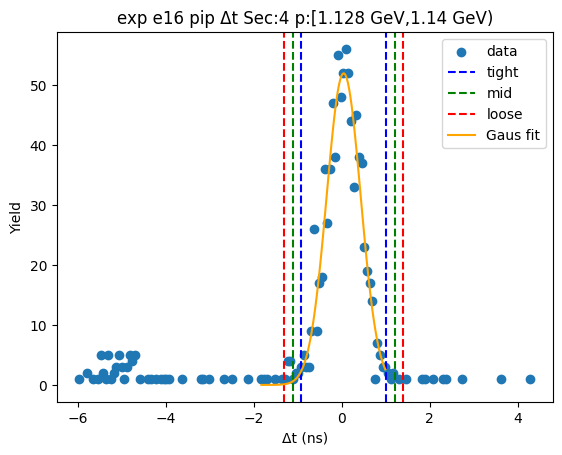

-0.8974057895474041 0.9023908276665094
-1.0773854512687955 1.0823704893879007
-1.2573651129901868 1.262350151109292
[5.55766447e+01 2.49251906e-03 3.59959323e-01]


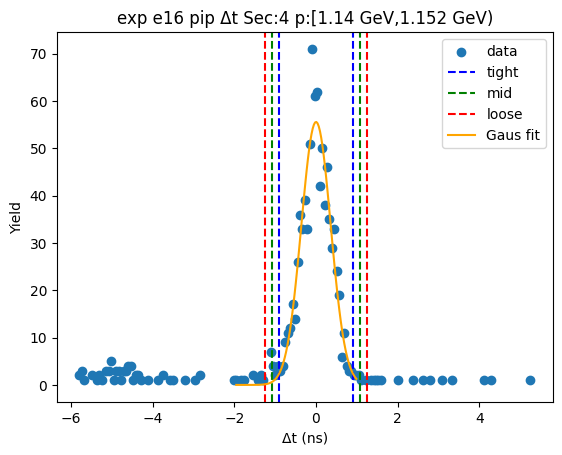

-0.9567547503313559 0.9601363345739041
-1.148443858821882 1.1518254430644301
-1.3401329673124078 1.343514551554956
[5.21658722e+01 1.69079212e-03 3.83378217e-01]


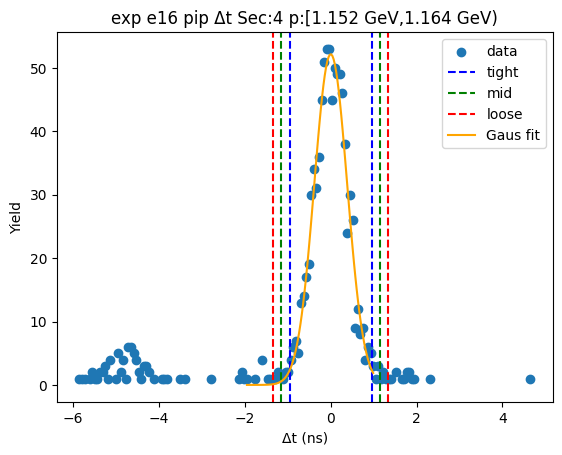

-1.0249692816795724 1.0241274343723854
-1.2298789532847683 1.2290371059775813
-1.4347886248899642 1.4339467775827772
[ 5.08164727e+01 -4.20923654e-04  4.09819343e-01]


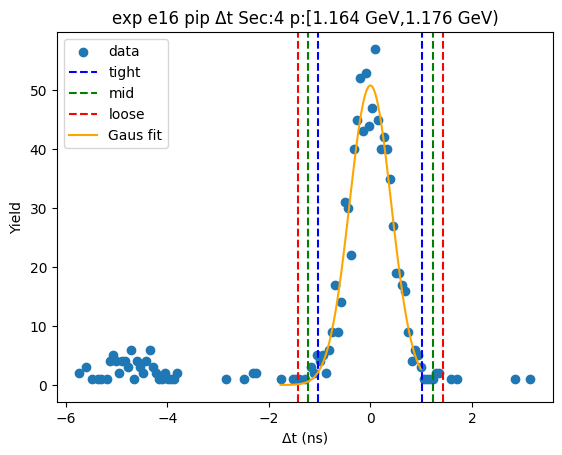

-0.9152712947985286 0.9369727654726798
-1.1004957008256493 1.1221971714998007
-1.2857201068527702 1.3074215775269216
[5.23069488e+01 1.08507353e-02 3.70448812e-01]


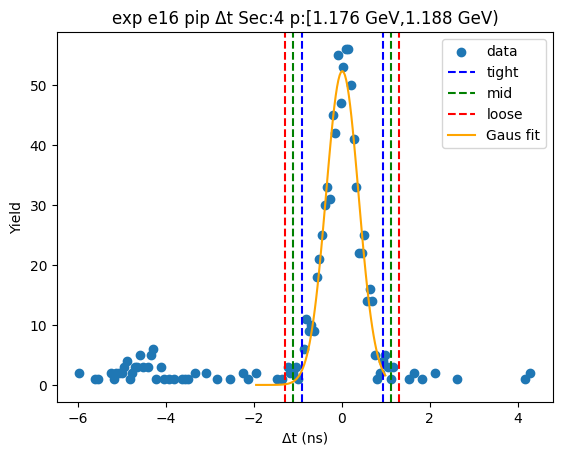

-0.9586129690121278 0.8980439902523557
-1.1442786649385763 1.083709686178804
-1.3299443608650245 1.2693753821052522
[ 5.25012290e+01 -3.02844894e-02  3.71331392e-01]


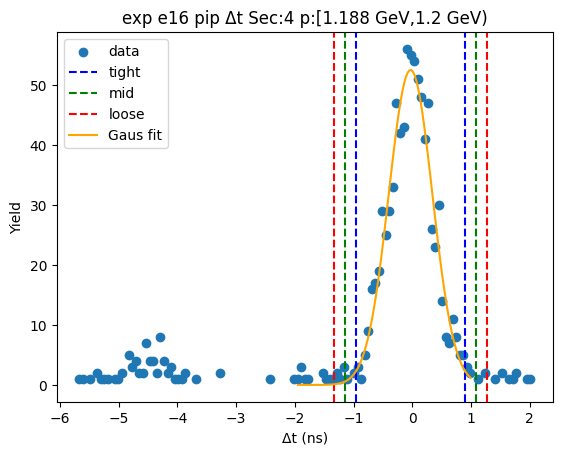

-1.0141431960062526 0.9708073462017625
-1.2126382502270543 1.169302400422564
-1.4111333044478558 1.3677974546433656
[ 4.38306108e+01 -2.16679249e-02  3.96990108e-01]


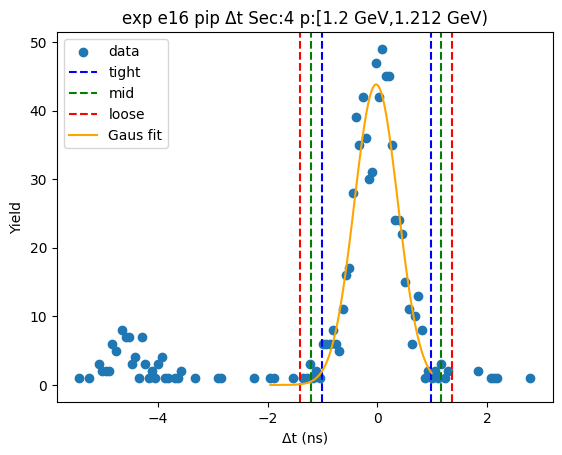

-1.0690455402959165 1.0298884882475052
-1.2789389431502585 1.2397818911018472
-1.488832346004601 1.4496752939561892
[ 4.42548045e+01 -1.95785260e-02  4.19786806e-01]


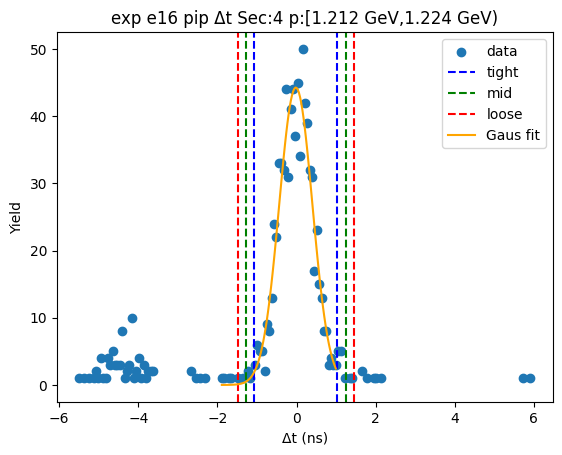

-1.0764153617498151 1.0133603330339855
-1.2853929312281953 1.2223379025123657
-1.4943705007065755 1.431315471990746
[ 4.26880901e+01 -3.15275144e-02  4.17955139e-01]


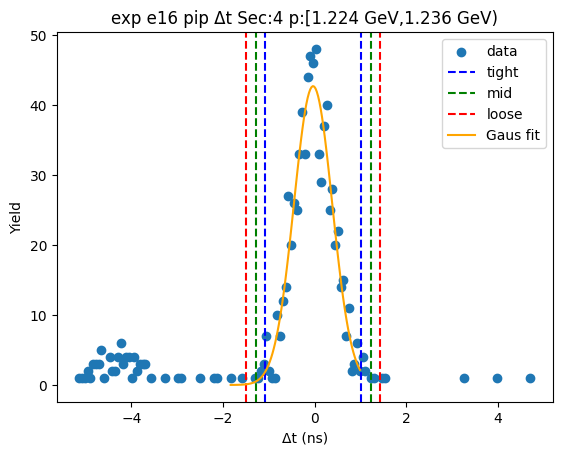

-0.9467516445778162 1.0097181529057149
-1.1423986243261695 1.2053651326540682
-1.3380456040745226 1.4010121124024213
[4.49883150e+01 3.14832542e-02 3.91293959e-01]


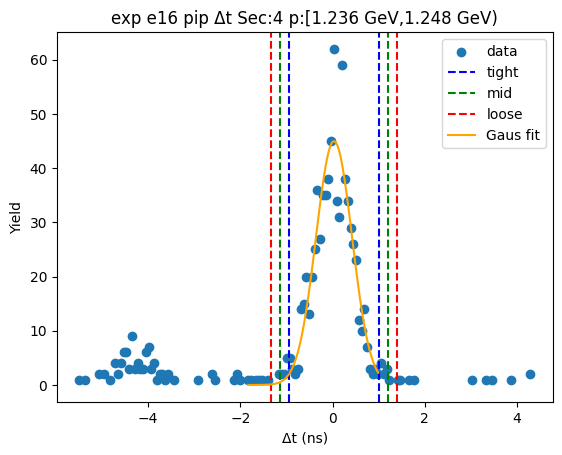

-0.9787911450853741 1.037026776959658
-1.1803729372898772 1.238608569164161
-1.3819547294943806 1.4401903613686644
[4.25972287e+01 2.91178159e-02 4.03163584e-01]


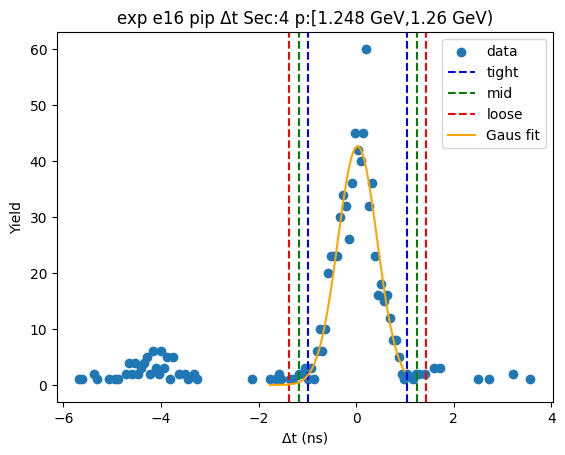

-0.9845915594612252 0.9747854532010086
-1.180529260727449 1.170723154467232
-1.3764669619936722 1.3666608557334554
[ 4.22659133e+01 -4.90305313e-03  3.91875403e-01]


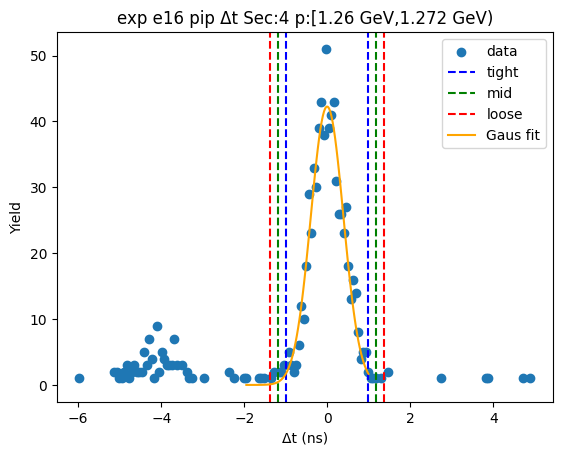

-0.9442324354836997 0.9699541613071974
-1.1356510951627896 1.1613728209862872
-1.3270697548418793 1.352791480665377
[3.94275807e+01 1.28608629e-02 3.82837319e-01]


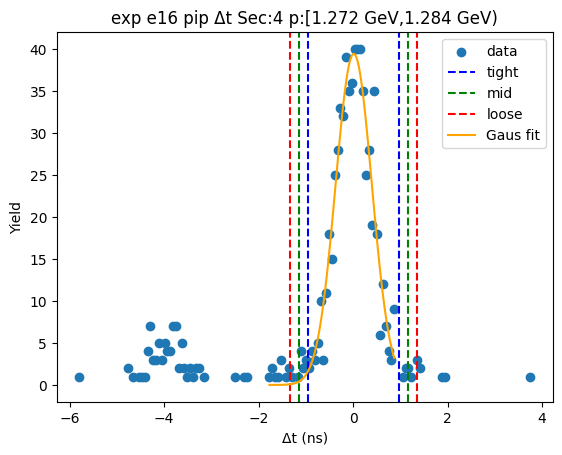

-0.9665215815535465 0.9571142448178328
-1.1588851641906843 1.1494778274549708
-1.3512487468278223 1.3418414100921088
[ 4.30130296e+01 -4.70366837e-03  3.84727165e-01]


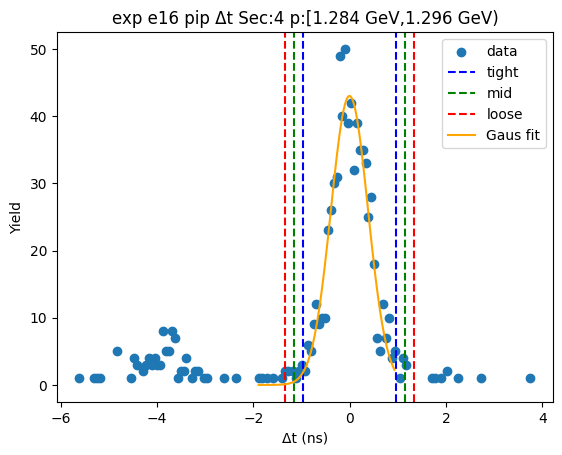

-1.0035877280539791 0.9567191421572642
-1.1996184150751035 1.1527498291783884
-1.3956491020962278 1.3487805161995128
[ 3.83213963e+01 -2.34342929e-02  3.92061374e-01]


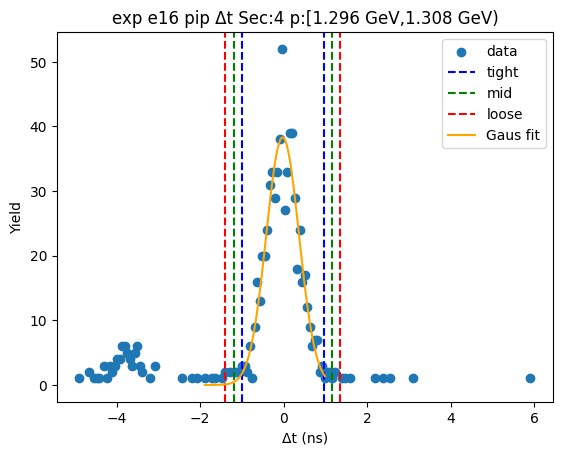

-1.0175903700337239 1.0625872052272451
-1.2256081275598207 1.270604962753342
-1.4336258850859176 1.4786227202794389
[4.05027329e+01 2.24984176e-02 4.16035515e-01]


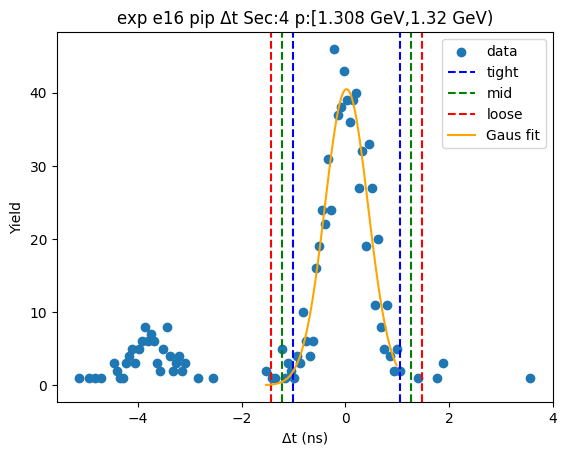

-1.0451543618118901 1.020206273864151
-1.2516904253794943 1.2267423374317552
-1.4582264889470984 1.4332784009993593
[ 3.78783840e+01 -1.24740440e-02  4.13072127e-01]


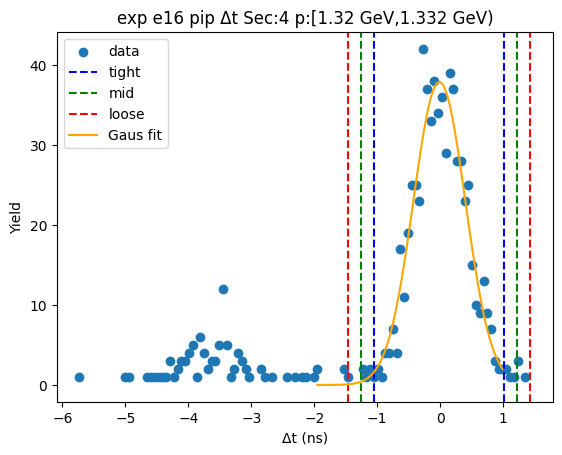

-0.998775921376806 0.9932087011564202
-1.1979743836301286 1.192407163409743
-1.3971728458834511 1.3916056256630656
[ 3.50533425e+01 -2.78361011e-03  3.98396925e-01]


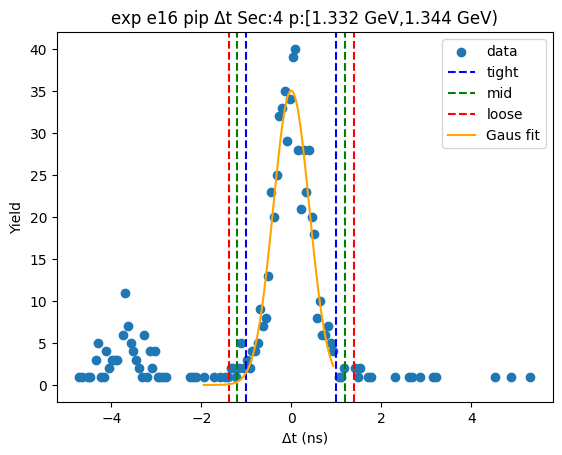

-0.9496040950525555 1.030141493663611
-1.1475786539241724 1.2281160525352277
-1.3455532127957888 1.4260906114068446
[35.62079381  0.0402687   0.39594912]


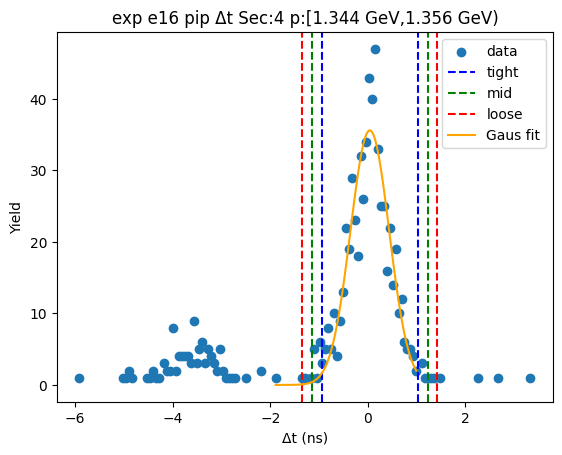

-1.0375102822156776 1.0326719360465182
-1.2445285040418972 1.2396901578727377
-1.4515467258681167 1.4467083796989573
[ 3.39021918e+01 -2.41917308e-03  4.14036444e-01]


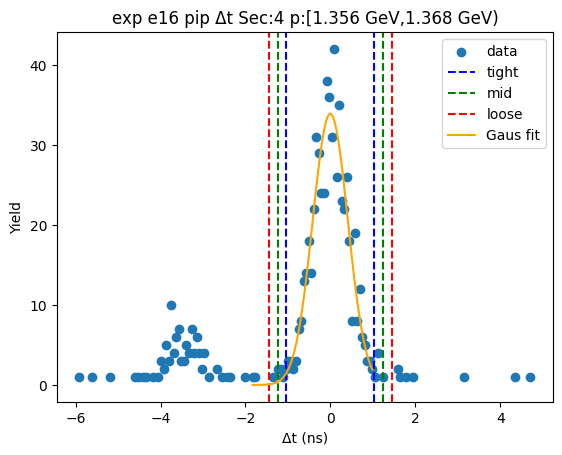

-0.9825996867279758 0.9839246818274185
-1.1792521235835152 1.180577118682958
-1.3759045604390547 1.3772295555384975
[3.49292192e+01 6.62497550e-04 3.93304874e-01]


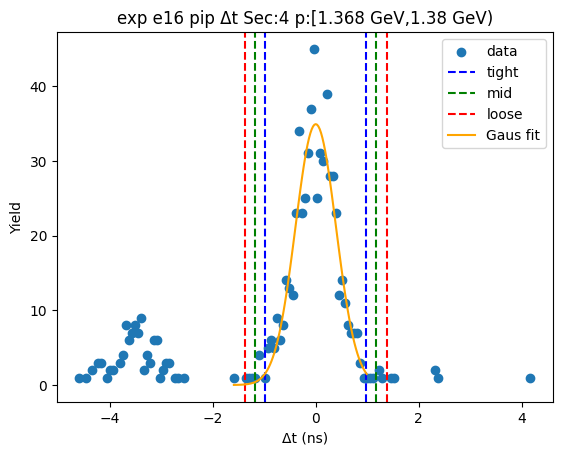

-0.985655745447486 1.1060990900261467
-1.1948312289948495 1.31527457357351
-1.4040067125422127 1.5244500571208732
[31.20869421  0.06022167  0.41835097]


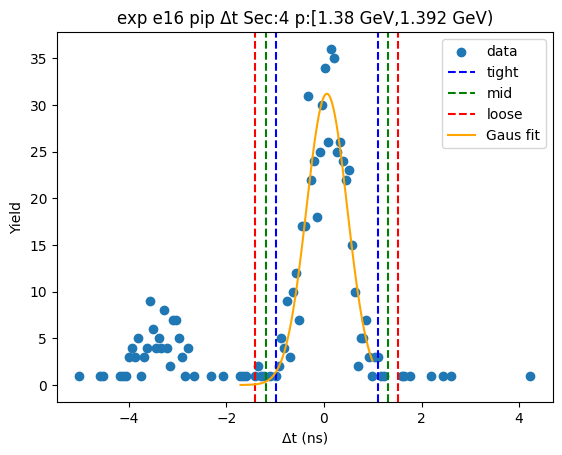

-1.098949484289752 1.1065135963720283
-1.31949579235593 1.3270599044382063
-1.540042100422108 1.5476062125043843
[3.04111664e+01 3.78205604e-03 4.41092616e-01]


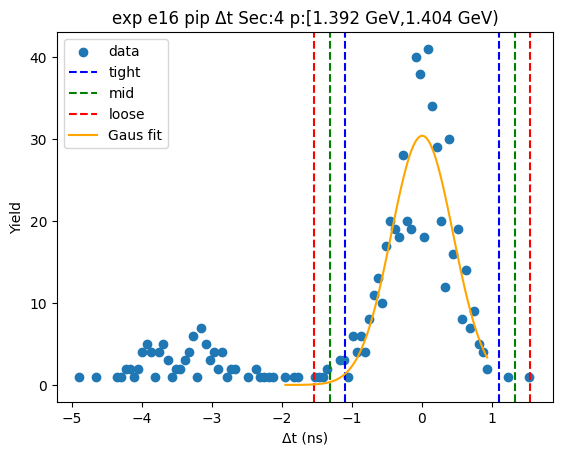

-0.9168499096471826 1.0128200857127847
-1.1098169091831793 1.2057870852487813
-1.302783908719176 1.398754084784778
[31.83012602  0.04798509  0.385934  ]


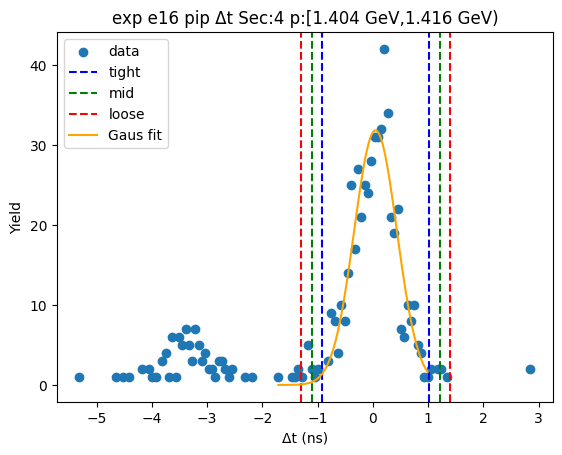

-1.0562629683215594 1.0813742394696313
-1.2700266891006784 1.2951379602487503
-1.4837904098797976 1.5089016810278695
[2.87953126e+01 1.25556356e-02 4.27527442e-01]


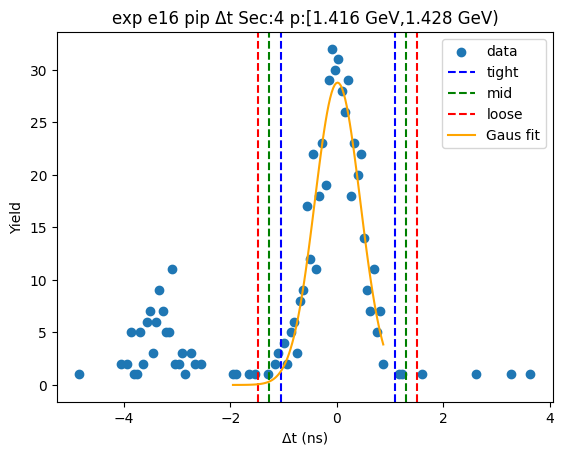

-1.0895470122076878 1.1465521842575193
-1.3131569318542085 1.37016210390404
-1.5367668515007291 1.5937720235505606
[26.8672513   0.02850259  0.44721984]


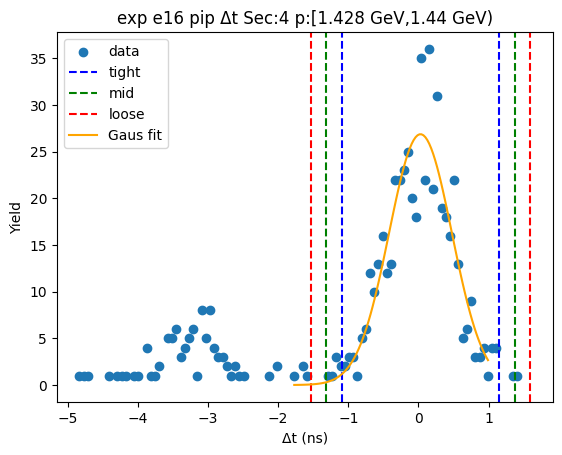

-0.9624638868333937 1.0110189580463895
-1.1598121713213718 1.2083672425343677
-1.3571604558093502 1.405715527022346
[3.01672029e+01 2.42775356e-02 3.94696569e-01]


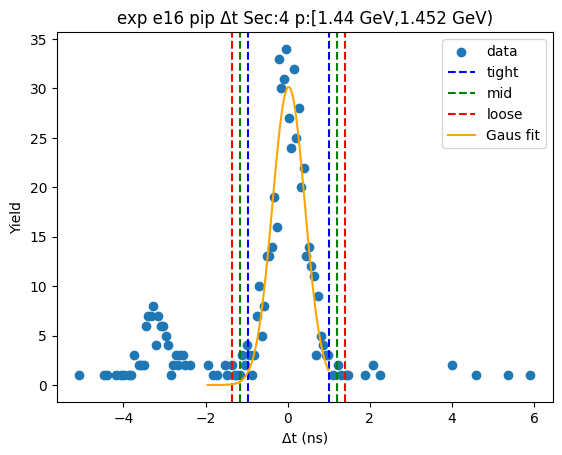

-1.085271185722065 1.1140521151418716
-1.3052035158084585 1.3339844452282652
-1.5251358458948523 1.553916775314659
[2.73556703e+01 1.43904647e-02 4.39864660e-01]


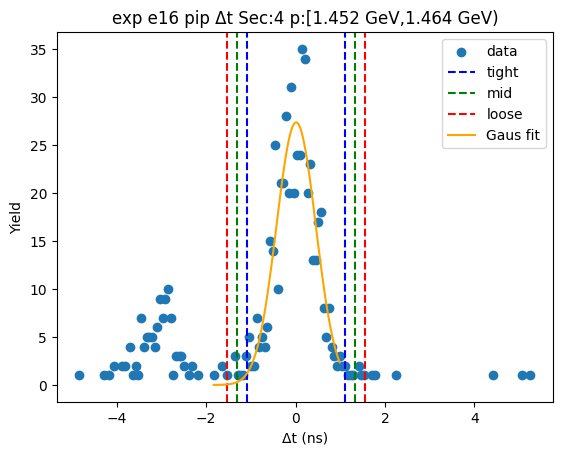

-0.9942303077682868 1.073019747158551
-1.2009553132609705 1.2797447526512347
-1.4076803187536544 1.4864697581439186
[29.50327567  0.03939472  0.41345001]


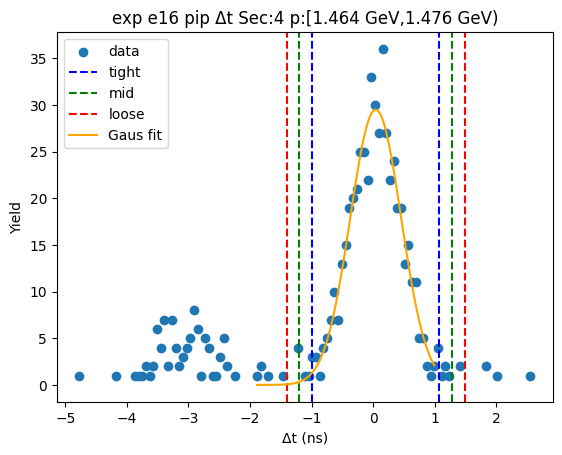

-1.0122692525507313 1.0724444134427111
-1.2207406191500756 1.2809157800420554
-1.4292119857494199 1.4893871466413997
[27.03571335  0.03008758  0.41694273]


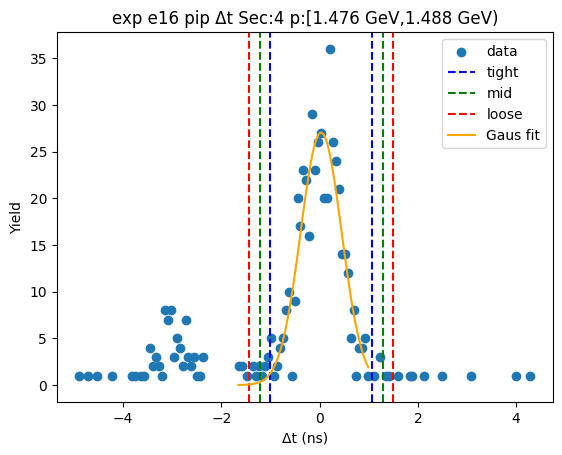

-1.0449965389871017 1.121684272463461
-1.261664620132158 1.3383523536085173
-1.4783327012772143 1.5550204347535737
[25.75401194  0.03834387  0.43333616]


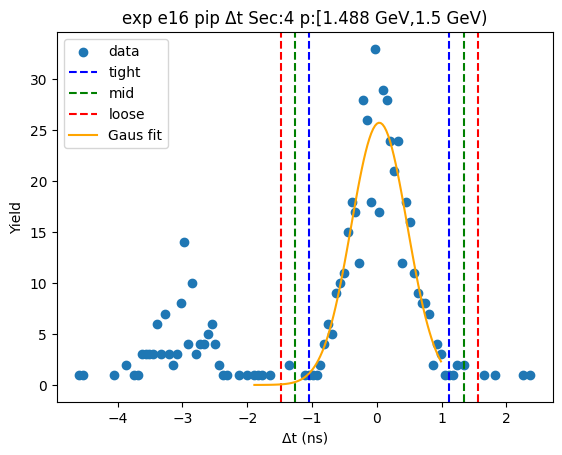

-1.049795327158928 1.0357141708233564
-1.2583462769571565 1.244265120621585
-1.4668972267553848 1.4528160704198132
[ 2.47601446e+01 -7.04057817e-03  4.17101900e-01]


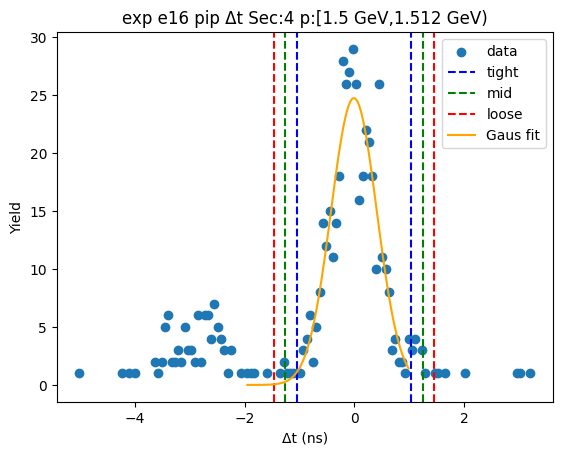

-1.0939509966578704 1.1993537476642544
-1.3232814710900829 1.4286842220964668
-1.5526119455222953 1.6580146965286793
[24.90287037  0.05270138  0.45866095]


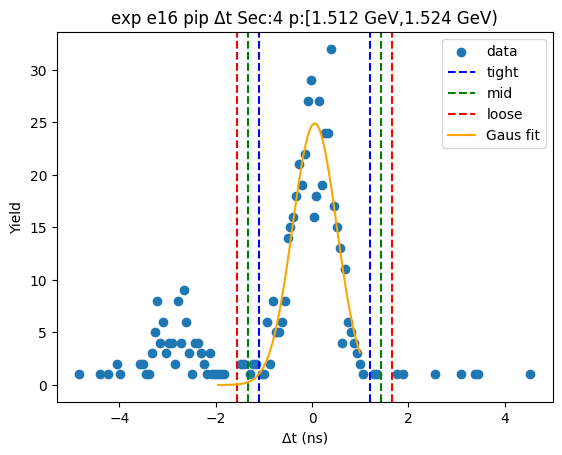

-1.0845887095651672 1.1773121101518682
-1.3107787915368707 1.4035021921235717
-1.5369688735085743 1.6296922740952753
[23.54129486  0.0463617   0.45238016]


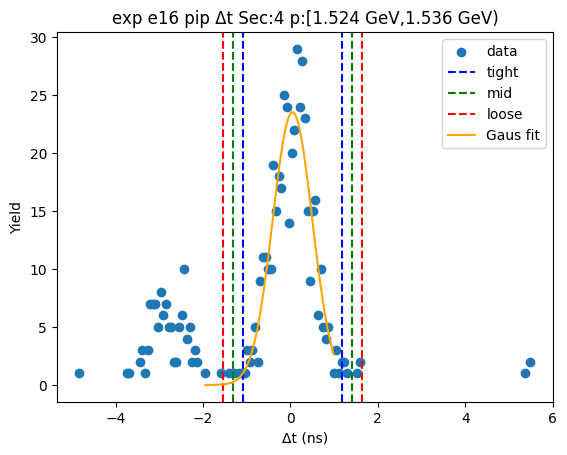

-1.1107402151738173 1.1037248625529443
-1.3321867229464934 1.3251713703256205
-1.5536332307191696 1.5466178780982967
[ 2.50326234e+01 -3.50767631e-03  4.42893016e-01]


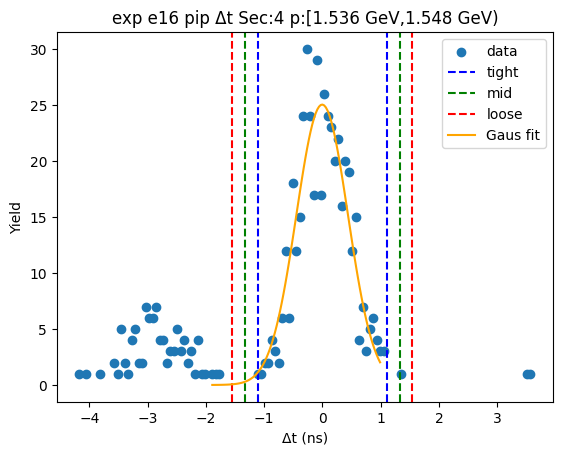

-1.0714896645243952 0.9766408424016033
-1.2763027152169952 1.1814538930942033
-1.481115765909595 1.3862669437868032
[23.62603573 -0.04742441  0.4096261 ]


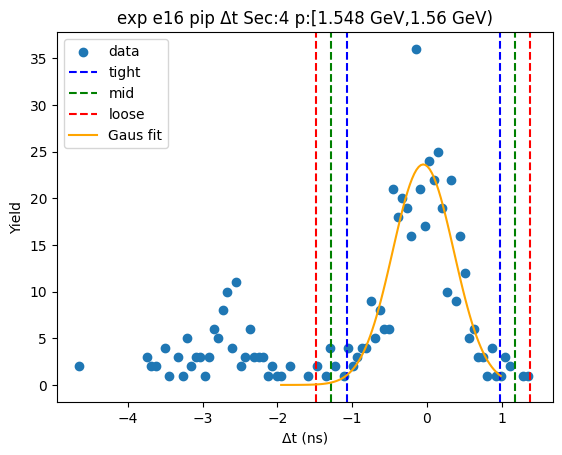

-1.0078514466999036 0.952941998870755
-1.2039307912569694 1.1490213434278207
-1.4000101358140353 1.3451006879848866
[23.95787561 -0.02745472  0.39215869]


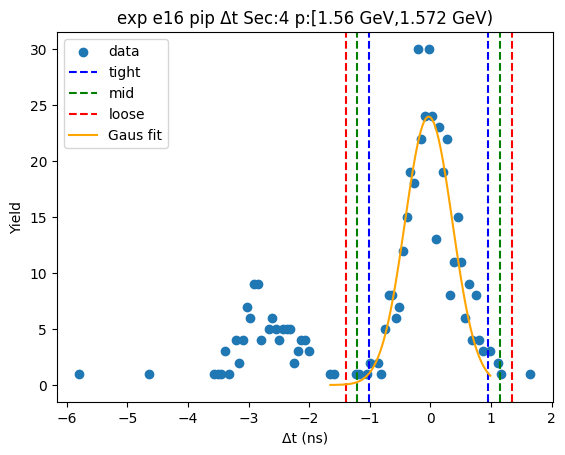

-1.1442179733645998 1.2025566621594663
-1.3788954369170066 1.437234125711873
-1.613572900469413 1.6719115892642795
[20.46036298  0.02916934  0.46935493]


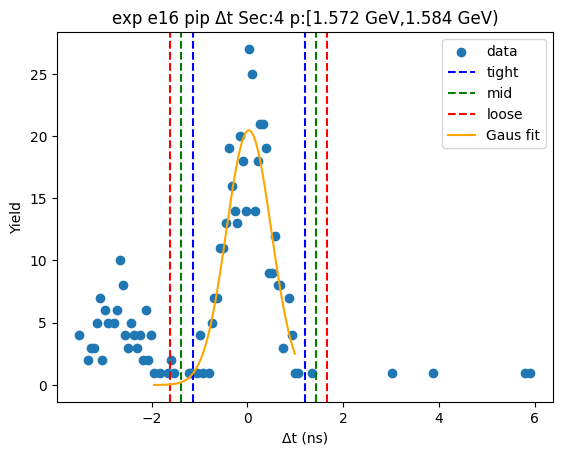

-1.2327066314481654 1.1494332674622643
-1.4709206213392085 1.3876472573533074
-1.7091346112302515 1.6258612472443503
[20.088222   -0.04163668  0.47642798]


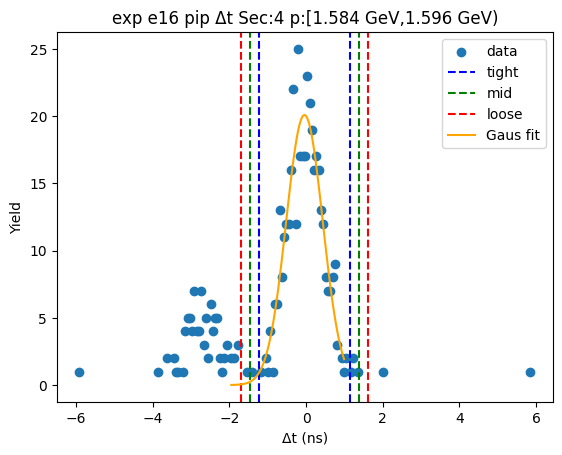

-1.0597281186072822 1.0572627996324824
-1.2714272104312585 1.2689618914564587
-1.483126302255235 1.4806609832804352
[ 2.33341546e+01 -1.23265949e-03  4.23398184e-01]


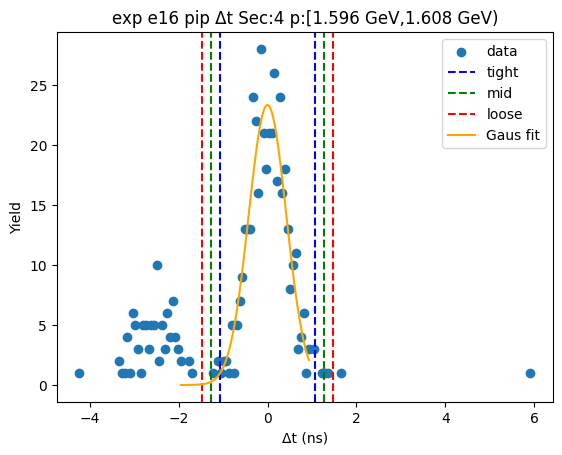

-1.1135793922578578 1.0698404063903864
-1.3319213721226824 1.2881823862552109
-1.5502633519875066 1.5065243661200352
[ 2.19575914e+01 -2.18694929e-02  4.36683960e-01]


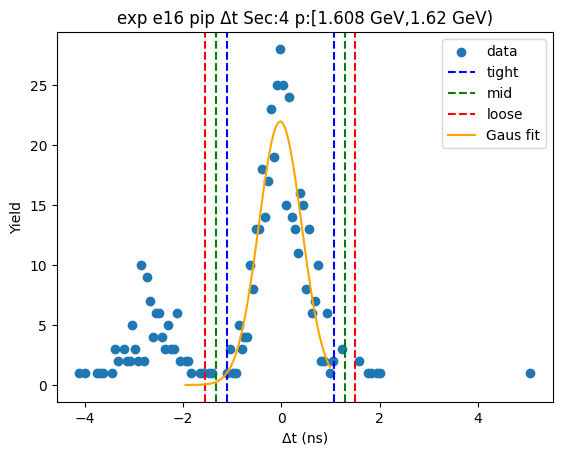

-1.1037239291970051 1.2048947157841354
-1.334585793695119 1.4357565802822494
-1.5654476581932333 1.6666184447803636
[21.38613024  0.05058539  0.46172373]


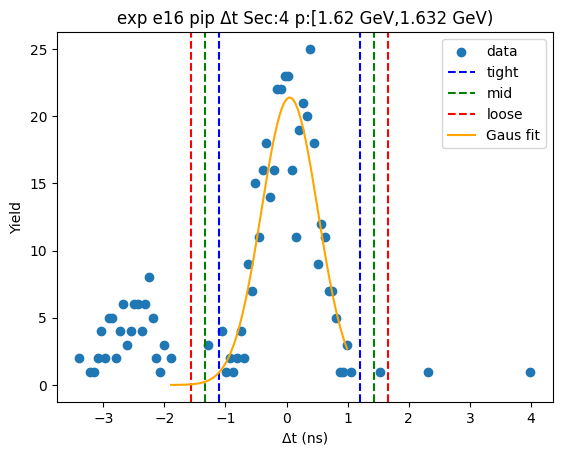

-1.0432034641773025 1.0341469812705149
-1.2509385087220843 1.2418820258152967
-1.4586735532668662 1.4496170703600786
[ 2.41389402e+01 -4.52824145e-03  4.15470089e-01]


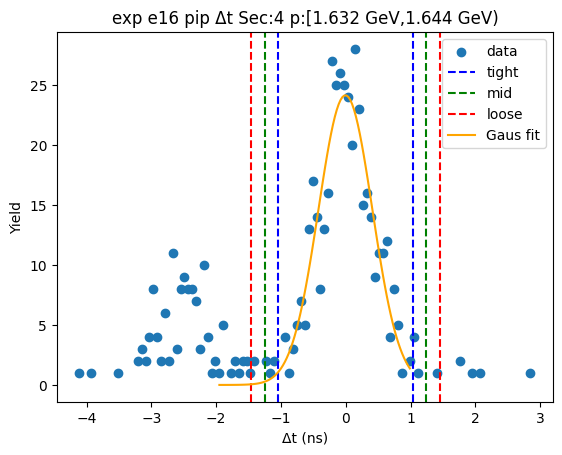

-1.1365221586871554 1.1304863910236176
-1.3632230136582328 1.357187245994695
-1.58992386862931 1.5838881009657721
[ 2.08534921e+01 -3.01788383e-03  4.53401710e-01]


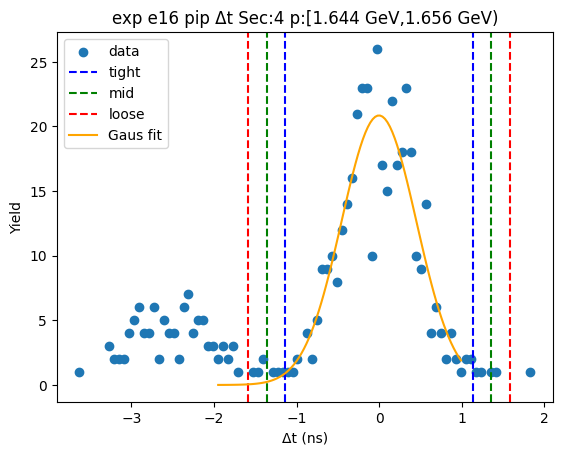

-1.1755130951643542 1.0875961696680654
-1.4018240216475963 1.3139070961513075
-1.6281349481308383 1.5402180226345494
[20.57238689 -0.04395846  0.45262185]


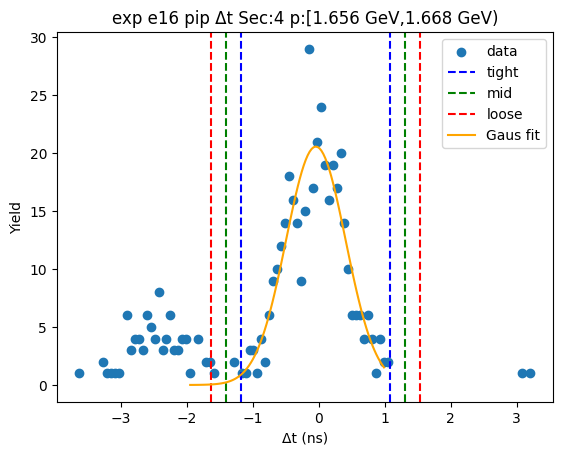

-1.2544171994890456 1.1748518539712263
-1.4973441048350726 1.4177787593172533
-1.7402710101810999 1.6607056646632805
[17.26475324 -0.03978267  0.48585381]


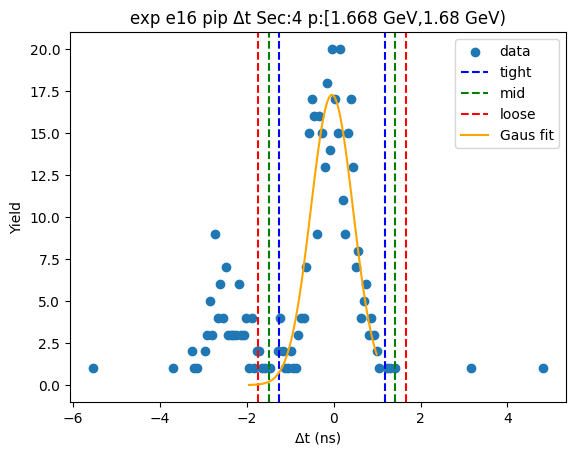

-1.201831558959493 1.0869783300096316
-1.4307125478564056 1.3158593189065442
-1.6595935367533179 1.5447403078034565
[20.65052373 -0.05742661  0.45776198]


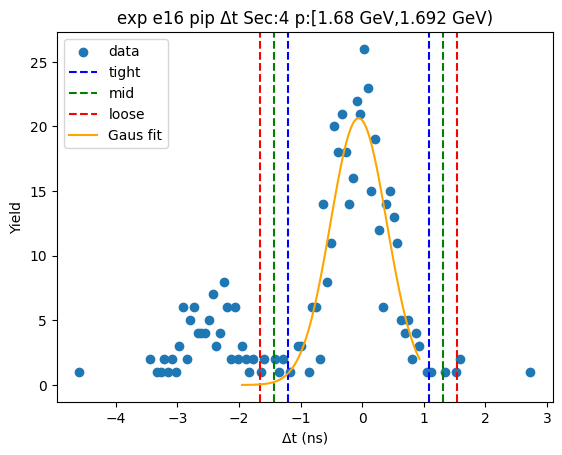

-1.0956670211620063 0.9421155255286269
-1.2994452758310695 1.14589378019769
-1.5032235305001327 1.3496720348667532
[20.08415531 -0.07677575  0.40755651]


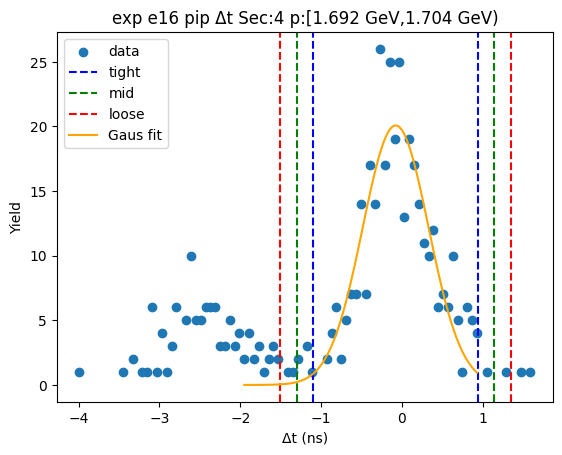

-1.12855251656475 1.0074532258217919
-1.3421530908034043 1.221053800060446
-1.5557536650420585 1.4346543742991003
[18.56064799 -0.06054965  0.42720115]


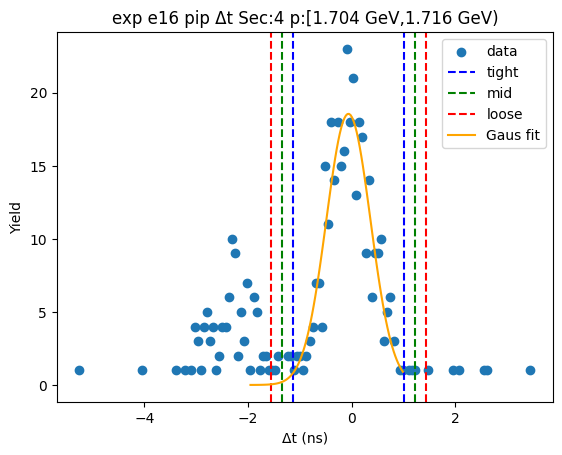

-1.126243171976254 1.092829367760474
-1.3481504259499268 1.3147366217341467
-1.5700576799235997 1.5366438757078196
[ 2.07459395e+01 -1.67069021e-02  4.43814508e-01]


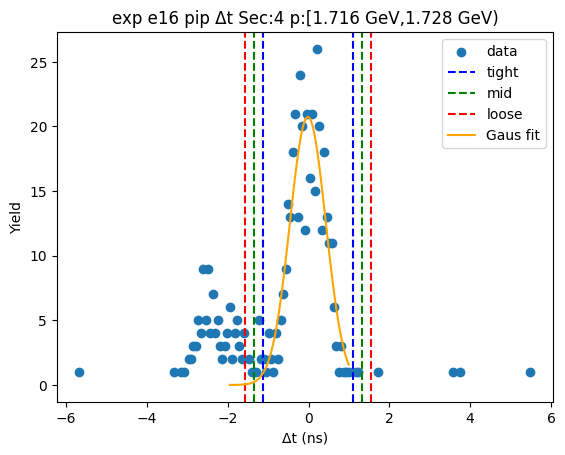

-1.2364816792129538 1.232904669297123
-1.4834203140639617 1.479843304148131
-1.7303589489149693 1.7267819389991386
[ 1.79807563e+01 -1.78850496e-03  4.93877270e-01]


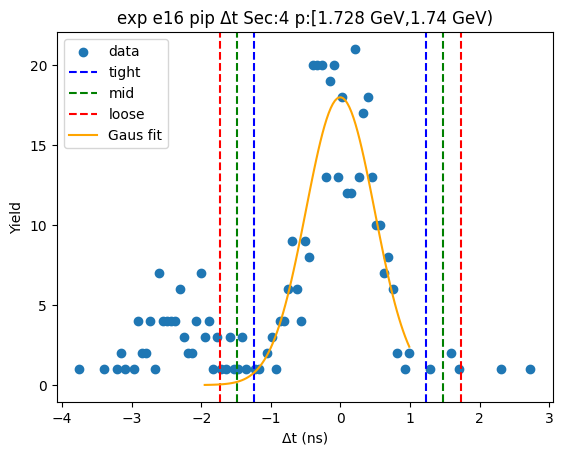

-1.2201506851013746 1.1446186929993014
-1.456627622911442 1.381095630809369
-1.69310456072151 1.6175725686194364
[16.65297838 -0.037766    0.47295388]


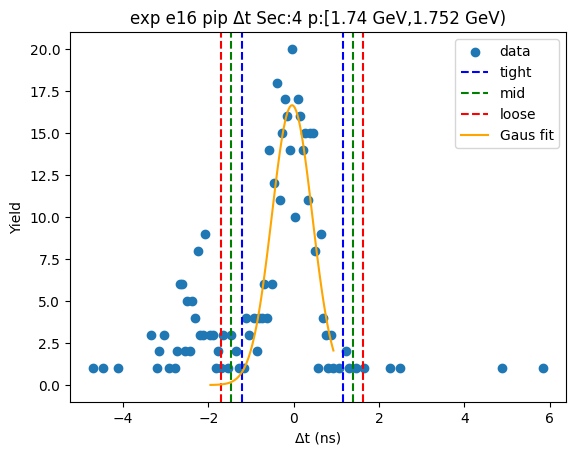

-1.0819603804488358 1.0698026498562492
-1.2971366834793443 1.2849789528867577
-1.5123129865098528 1.5001552559172662
[ 1.92018071e+01 -6.07886530e-03  4.30352606e-01]


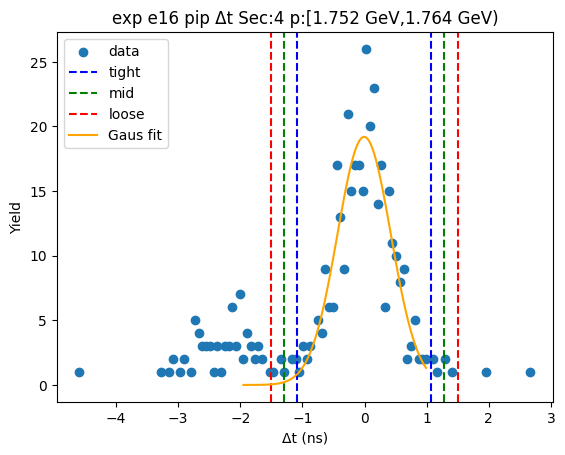

-1.2519534645276669 1.1626412760908926
-1.4934129385895227 1.4041007501527485
-1.7348724126513788 1.6455602242146046
[13.58809512 -0.04465609  0.48291895]


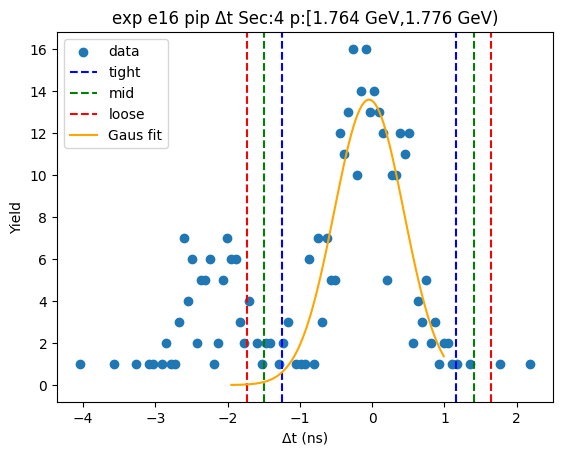

-1.2835597037867372 1.2156001249241712
-1.533475686657828 1.465516107795262
-1.783391669528919 1.715432090666353
[15.28334834 -0.03397979  0.49983197]


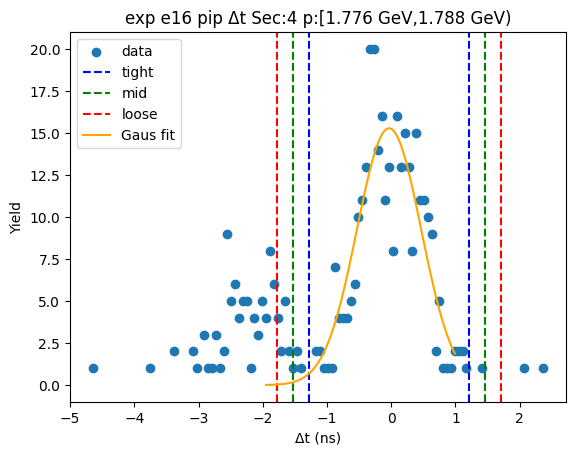

-1.1977114547148082 1.0994226669737144
-1.4274248668836607 1.3291360791425668
-1.6571382790525129 1.558849491311419
[15.64081917 -0.04914439  0.45942682]


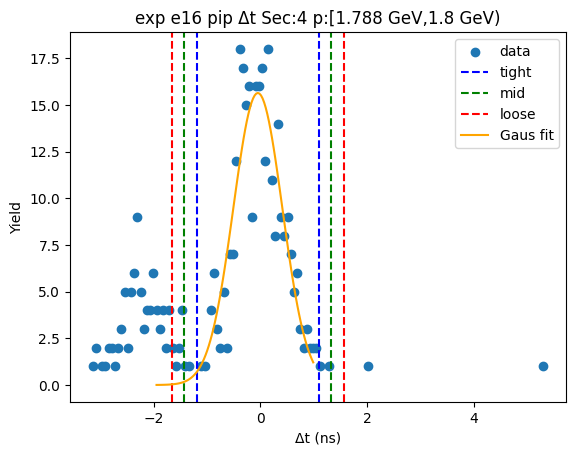

-1.1461455198815724 1.0100022403122872
-1.3617602959009585 1.2256170163316733
-1.5773750719203443 1.4412317923510591
[14.86122404 -0.06807164  0.43122955]


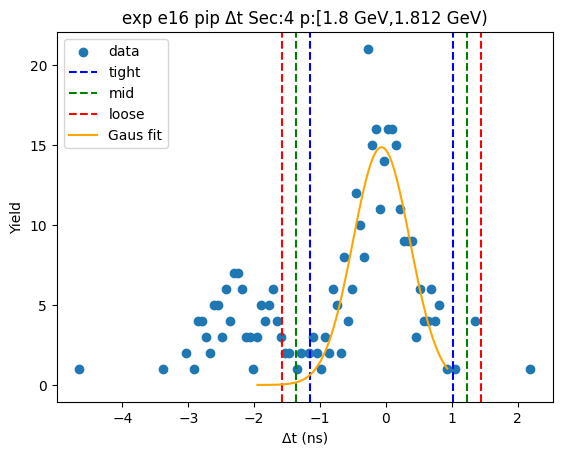

-1.2647694056124943 1.130563032360291
-1.5043026494097729 1.3700962761575697
-1.7438358932070515 1.6096295199548483
[13.97630623 -0.06710319  0.47906649]


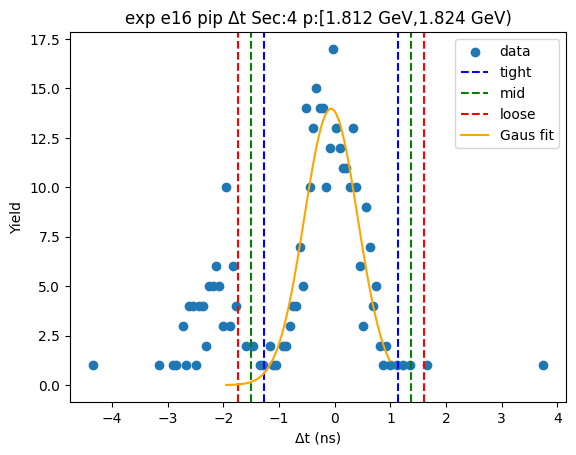

-1.1855899563246766 1.1050149836464587
-1.41465045032179 1.3340754776435721
-1.6437109443189035 1.5631359716406856
[15.59606057 -0.04028749  0.45812099]


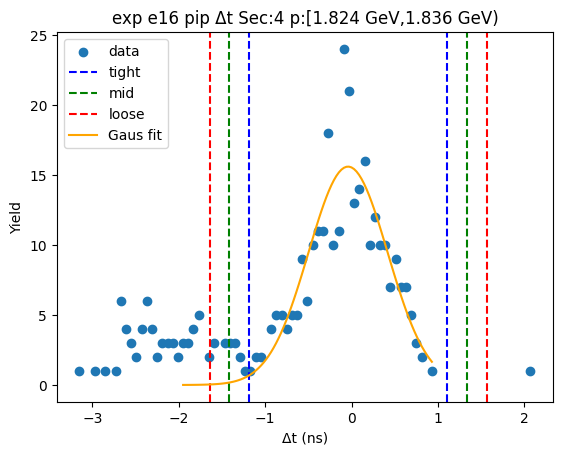

-1.258232780829927 1.0885622417150853
-1.4929122830844281 1.3232417439695865
-1.7275917853389293 1.5579212462240877
[15.51822782 -0.08483527  0.469359  ]


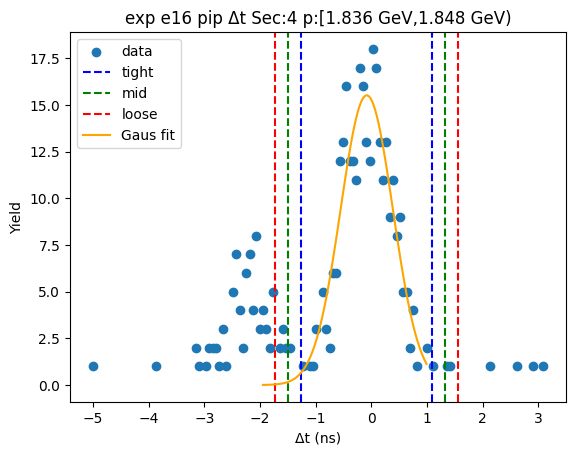

-1.1757492019412494 1.1179211274339684
-1.4051162348787711 1.3472881603714901
-1.634483267816293 1.576655193309012
[14.86592557 -0.02891404  0.45873407]


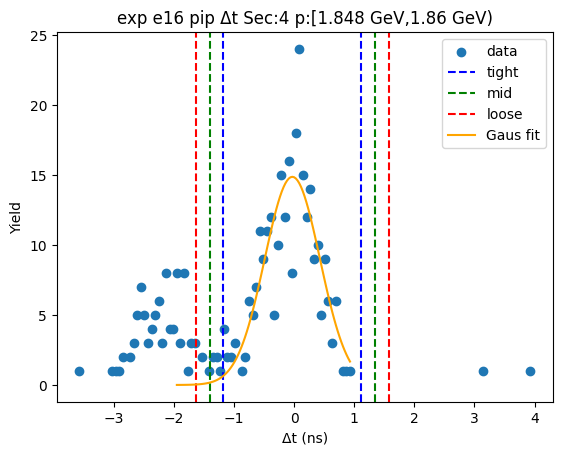

-1.4444651222549556 1.1557321444667945
-1.7044848489271307 1.4157518711389692
-1.9645045755993054 1.6757715978111443
[14.03818187 -0.14436649  0.52003945]


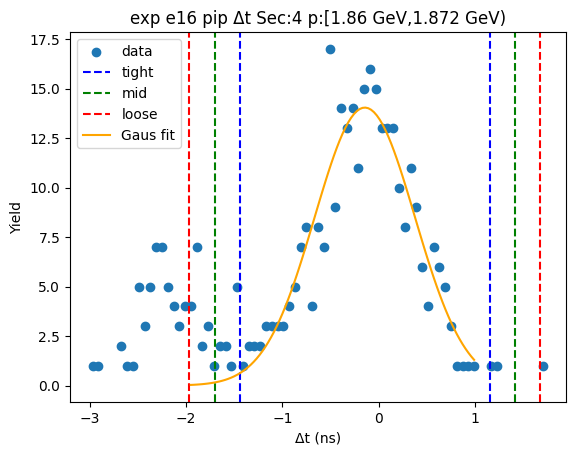

-1.1834950497155512 1.0668671511377281
-1.4085312698008792 1.291903371223056
-1.6335674898862071 1.516939591308384
[14.79804519 -0.05831395  0.45007244]


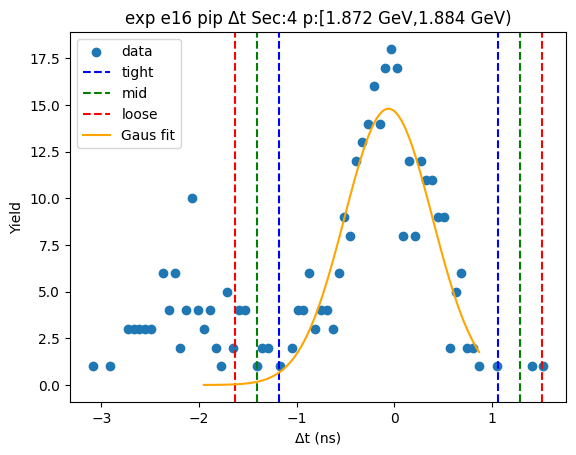

-1.4674552937556946 1.193563586083966
-1.7335571817396607 1.459665474067932
-1.9996590697236267 1.725767362051898
[13.26272716 -0.13694585  0.53220378]


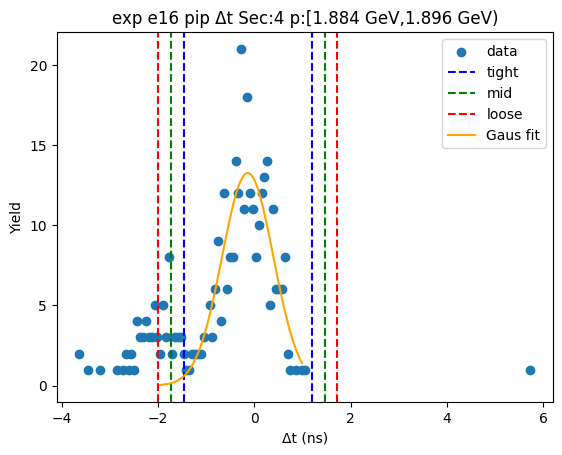

-1.5443216061970684 1.3152563380586446
-1.8302794006226395 1.6012141324842157
-2.116237195048211 1.887171926909787
[12.22120244 -0.11453263  0.57191559]


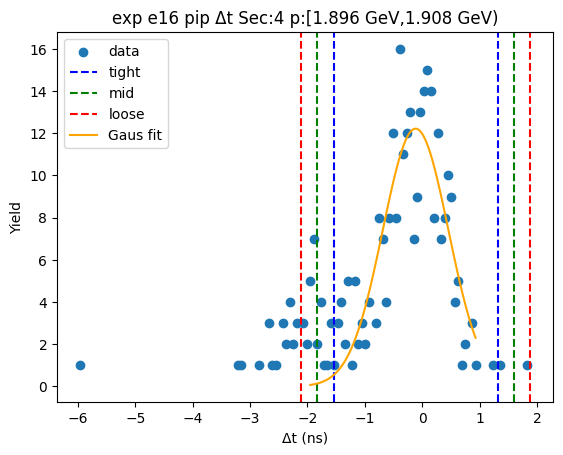

-1.1662790790408932 0.9862749851040467
-1.381534485455387 1.2015303915185405
-1.596789891869881 1.4167857979330345
[14.44459608 -0.09000205  0.43051081]


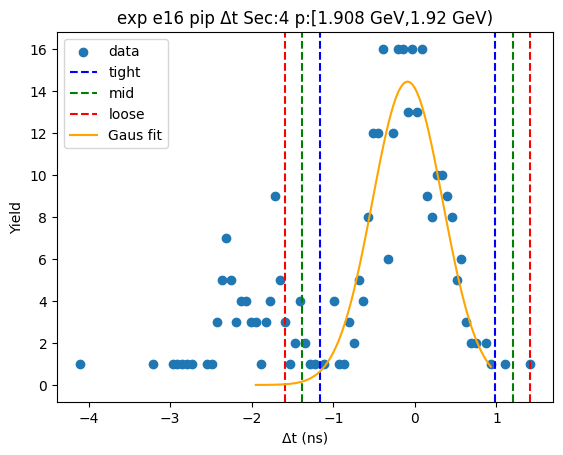

-1.480466868112551 1.1756372251372222
-1.7460772774375282 1.4412476344621994
-2.0116876867625058 1.7068580437871768
[12.98195266 -0.15241482  0.53122082]


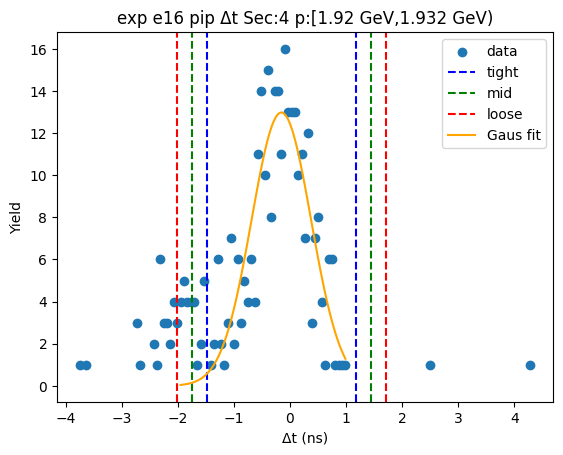

-1.4426214069305952 1.168099422037337
-1.7036934898273886 1.4291715049341305
-1.9647655727241817 1.6902435878309237
[12.28723553 -0.13726099  0.52214417]


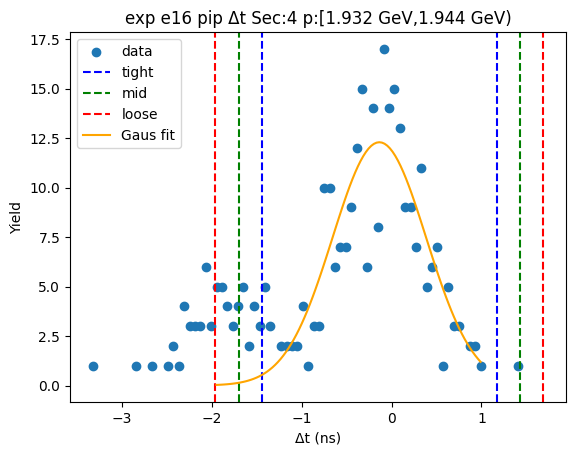

-1.6724577164471337 1.3235469031607425
-1.9720581784079212 1.62314736512153
-2.2716586403687087 1.9227478270823175
[10.29106355 -0.17445541  0.59920092]


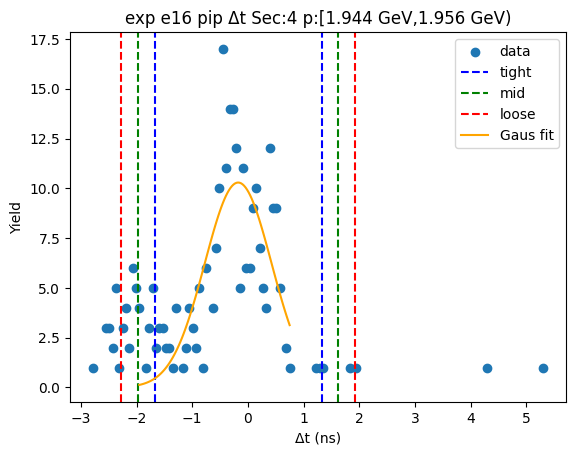

-1.3387097672106625 1.0669042429967919
-1.5792711682314078 1.3074656440175372
-1.819832569252153 1.5480270450382825
[13.46706199 -0.13590276  0.4811228 ]


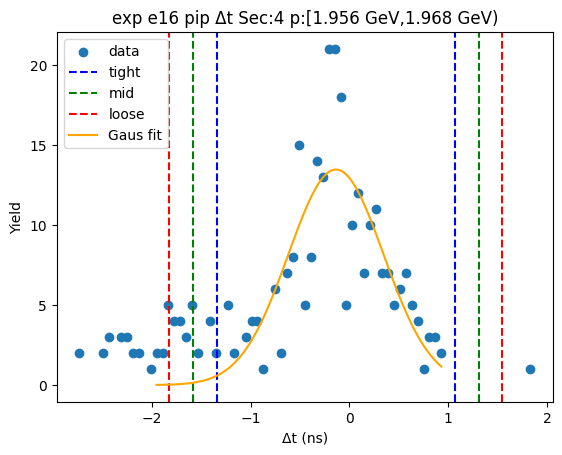

-1.39470061851838 1.1625179466342042
-1.6504224750336385 1.4182398031494627
-1.906144331548897 1.6739616596647209
[11.27739943 -0.11609134  0.51144371]


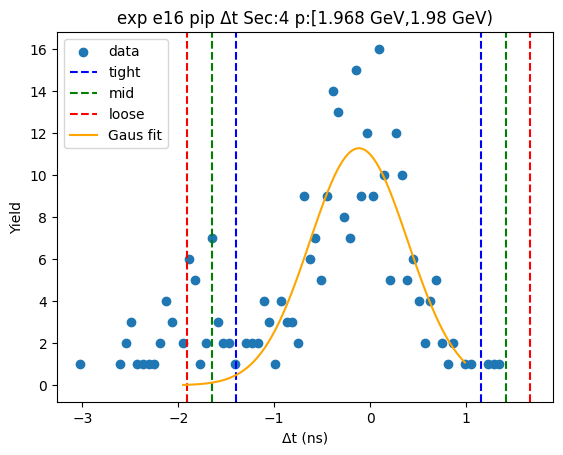

-1.3179547225717407 1.0859319319009881
-1.5583433880190136 1.326320597348261
-1.7987320534662865 1.566709262795534
[11.56146745 -0.1160114   0.48077733]


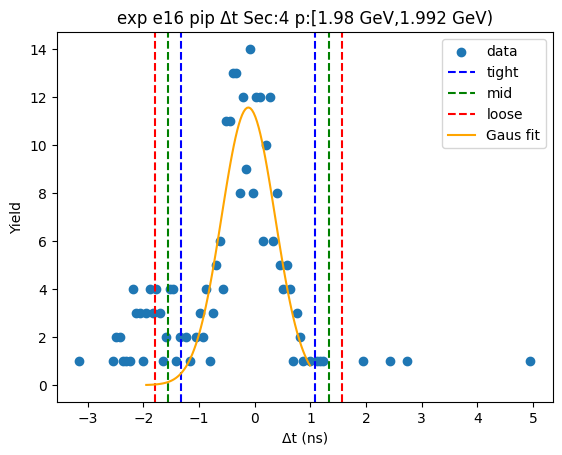

-1.1686035274720779 0.9726860404457788
-1.3827324842638635 1.1868149972375646
-1.5968614410556492 1.4009439540293502
[12.59836973 -0.09795874  0.42825791]


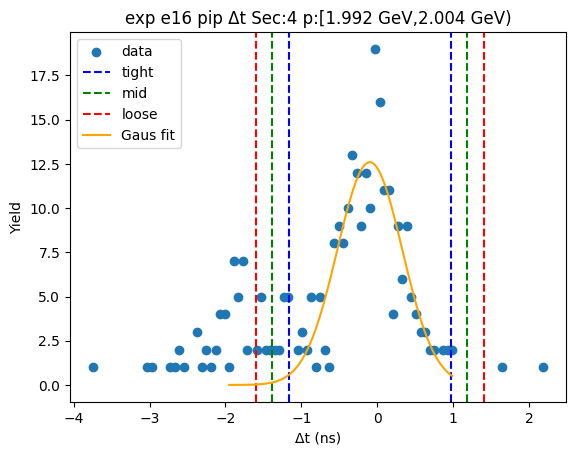

-1.5818682877324743 1.2091545688941654
-1.8609705733951385 1.4882568545568295
-2.1400728590578026 1.7673591402194935
[ 9.24525049 -0.18635686  0.55820457]


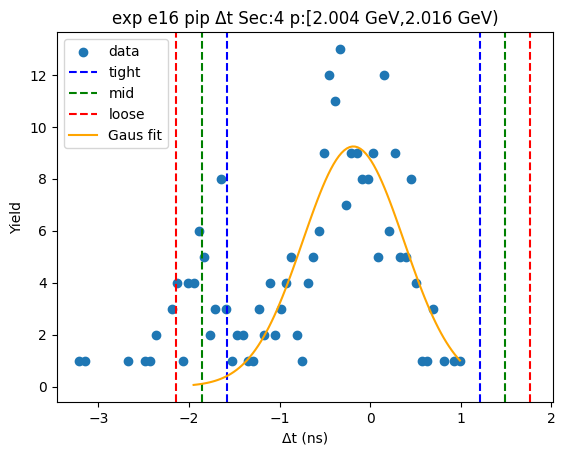

-1.3376621609036141 1.115326756025807
-1.5829610525965563 1.3606256477187493
-1.8282599442894985 1.6059245394116914
[12.47289818 -0.1111677   0.49059778]


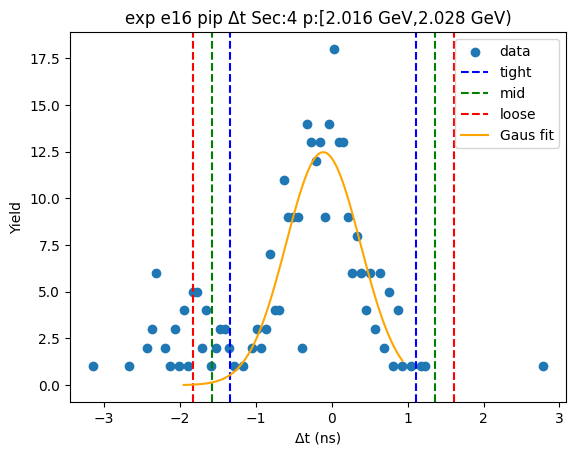

-1.873436788875754 1.569180556315136
-2.2176985233948425 1.9134422908342248
-2.561960257913932 2.2577040253533136
[ 8.28212855 -0.15212812  0.68852347]


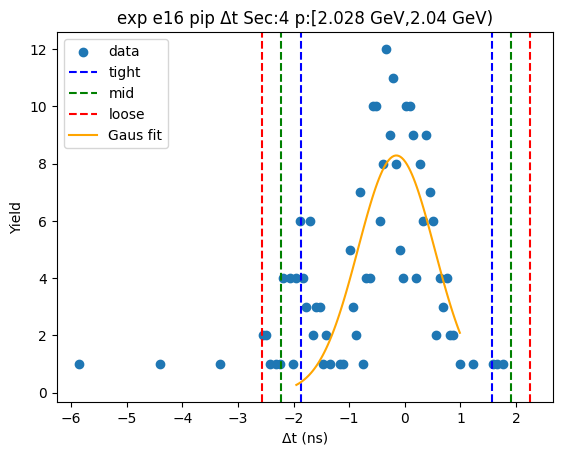

-2.0746234043647105 1.4432549508391395
-2.4264112398850957 1.7950427863595246
-2.7781990754054804 2.1468306218799094
[ 8.48861582 -0.31568423  0.70357567]


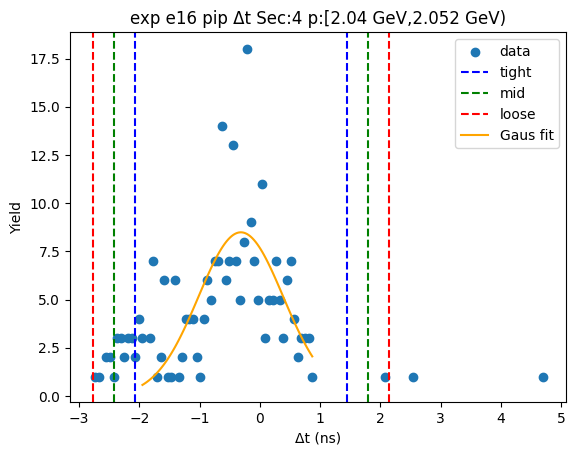

-1.2308273047146545 0.8634409109937456
-1.4402541262854944 1.0728677325645855
-1.6496809478563346 1.2822945541354256
[11.98985946 -0.1836932   0.41885364]


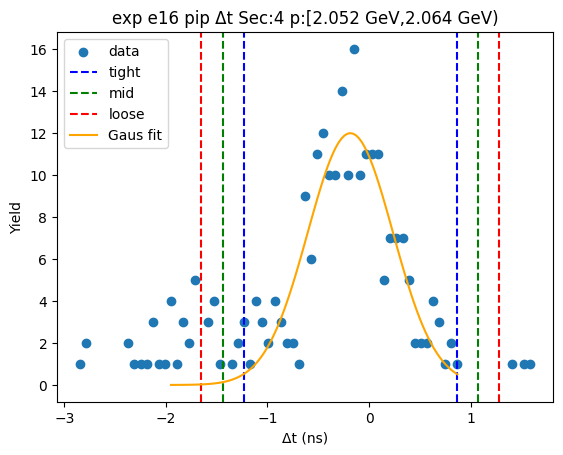

-1.7860793711906047 1.517400529200916
-2.1164273612297566 1.847748519240068
-2.4467753512689088 2.1780965092792197
[ 7.91987816 -0.13433942  0.66069598]


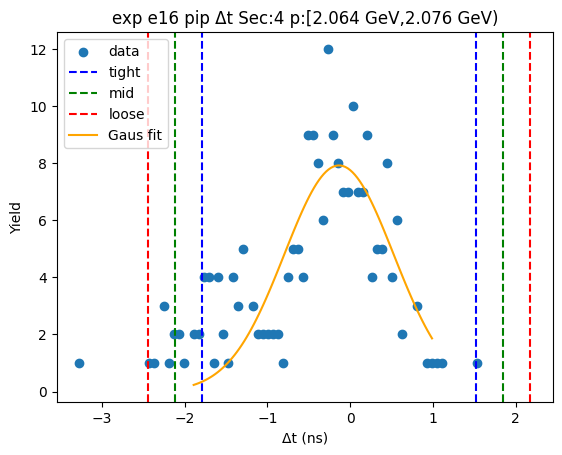

-1.460968857751351 1.158864586408722
-1.7229522021673582 1.420847930824729
-1.9849355465833656 1.6828312752407364
[10.55057761 -0.15105214  0.52396669]


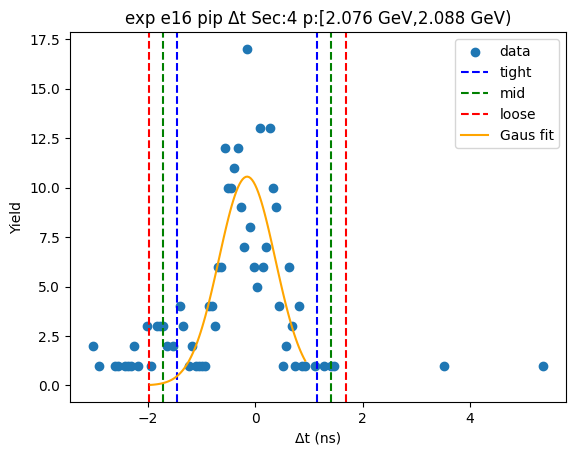

-1.534074393643575 1.1063785244125208
-1.7981196854491848 1.3704238162181306
-2.0621649772547945 1.6344691080237401
[ 8.98109273 -0.21384793  0.52809058]


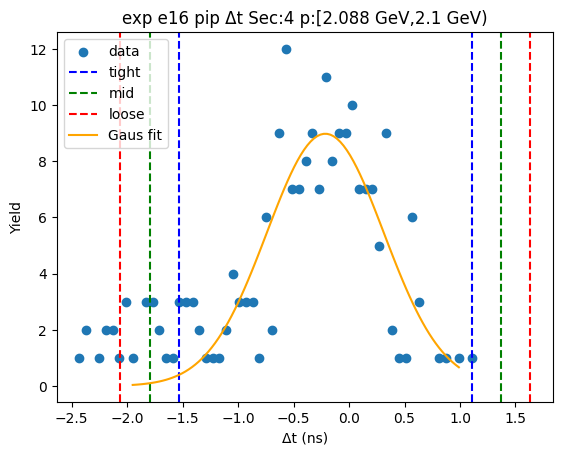

-1.2833924377108585 1.0438492302307092
-1.5161166045050152 1.2765733970248658
-1.7488407712991718 1.5092975638190225
[ 9.44935162 -0.1197716   0.46544833]


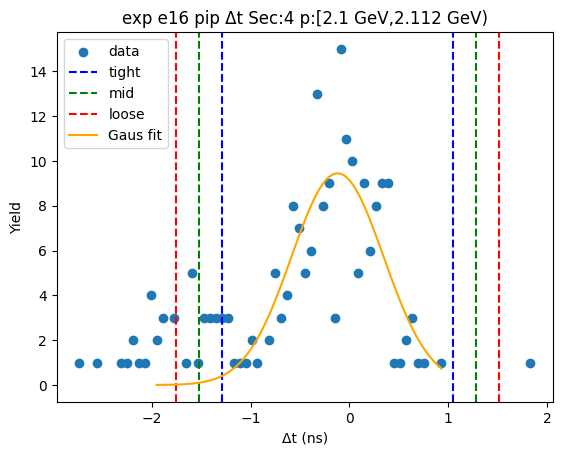

-1.476293758770621 0.9735189300859578
-1.7212750276562794 1.2185001989716158
-1.9662562965419372 1.4634814678572736
[ 9.67378704 -0.25138741  0.48996254]


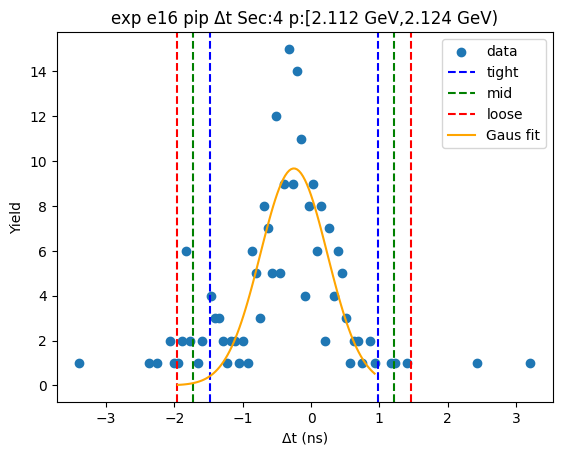

-1.3651166014558547 1.043836479922075
-1.6060119095936476 1.2847317880598679
-1.8469072177314405 1.5256270961976608
[ 9.12880646 -0.16064006  0.48179062]


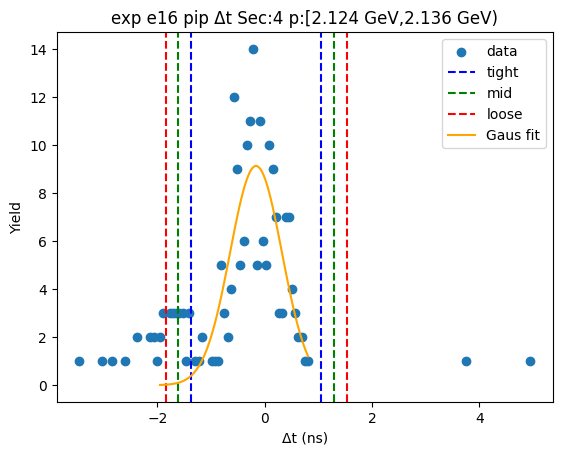

-1.6535262036087202 1.3671629683685966
-1.9555951208064517 1.6692318855663282
-2.257664038004183 1.9713008027640597
[ 9.36621142 -0.14318162  0.60413783]


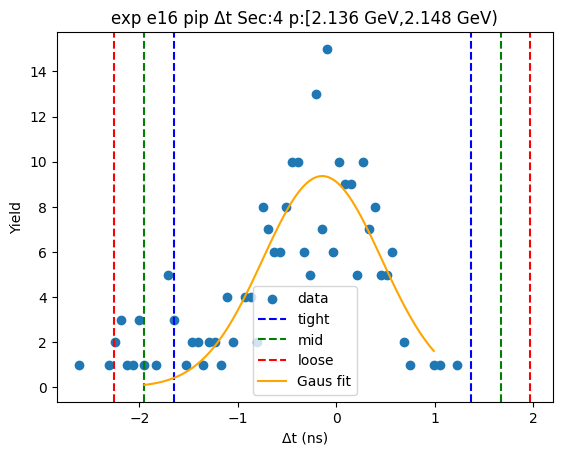

-1.5847983101654157 1.0532971971714482
-1.8486078608991021 1.3171067479051346
-2.1124174116327885 1.580916298638821
[ 9.56719061 -0.26575056  0.5276191 ]


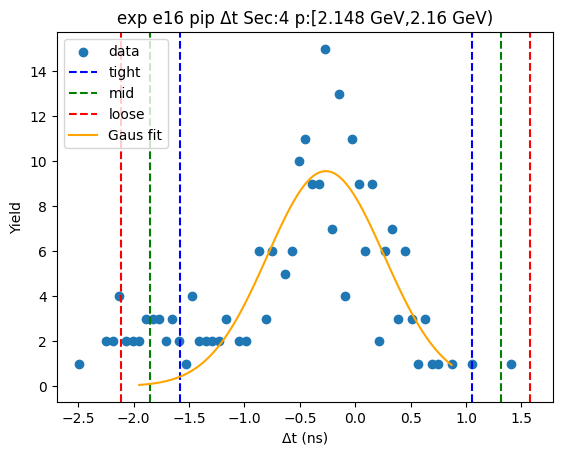

-1.6445441696246308 1.1600160638387107
-1.9250001929709648 1.4404720871850447
-2.2054562163172986 1.7209281105313787
[ 9.40231379 -0.24226405  0.56091205]


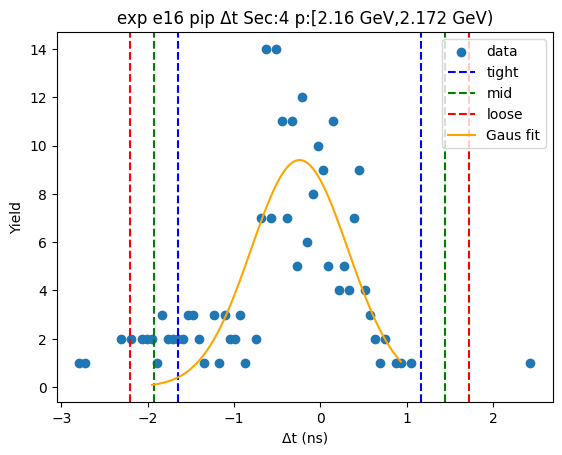

-1.789821397842001 1.4000632240297604
-2.108809860029177 1.7190516862169365
-2.4277983222163533 2.0380401484041126
[ 7.1967818  -0.19487909  0.63797692]


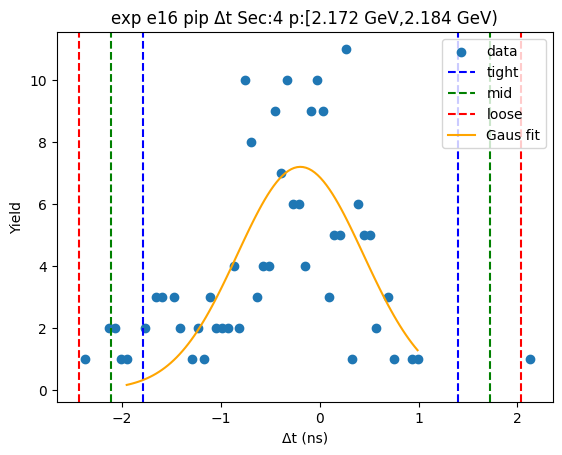

-1.6472949091171345 1.3158143781332474
-1.9436058378421726 1.6121253068582855
-2.2399167665672106 1.9084362355833235
[ 6.76201491 -0.16574027  0.59262186]


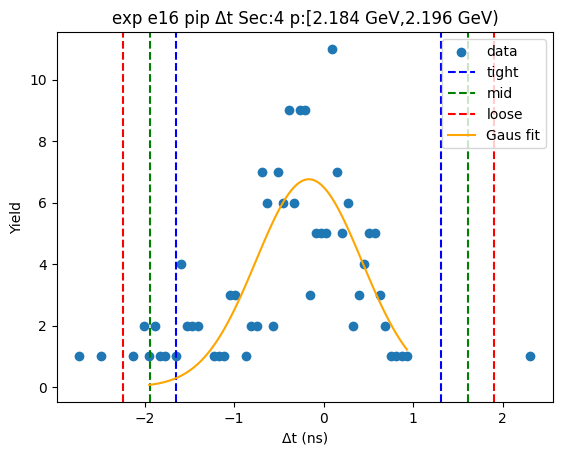

-1.1526126405841939 1.3773283881876484
-1.405606743461378 1.6303224910648324
-1.6586008463385622 1.8833165939420167
[26.70872662  0.11235787  0.50598821]


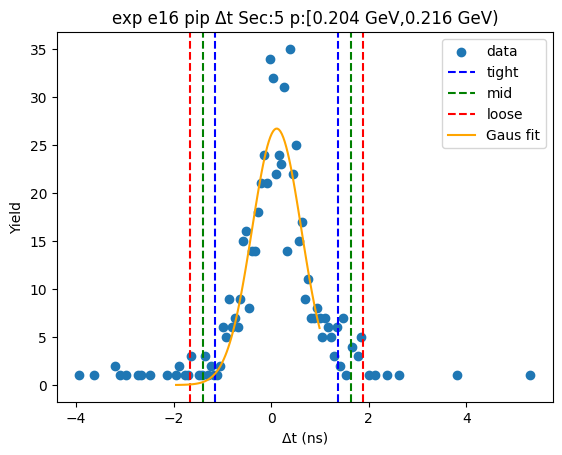

-1.1534481267622751 1.266290490704302
-1.3954219885089327 1.5082643524509596
-1.6373958502555903 1.7502382141976172
[39.04977114  0.05642118  0.48394772]


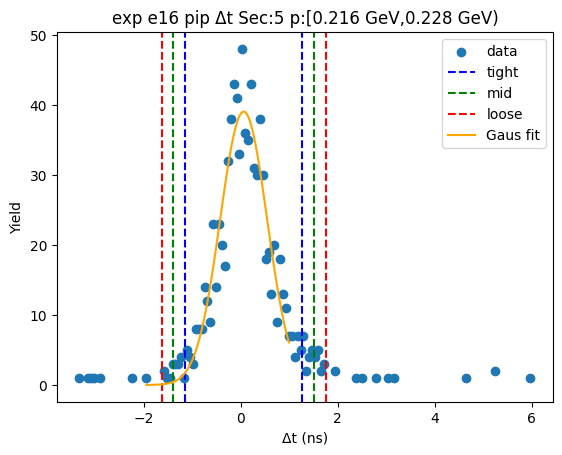

-1.14166788046541 1.064193858536807
-1.3622540543656316 1.2847800324370287
-1.5828402282658534 1.5053662063372504
[ 5.40701311e+01 -3.87370110e-02  4.41172348e-01]


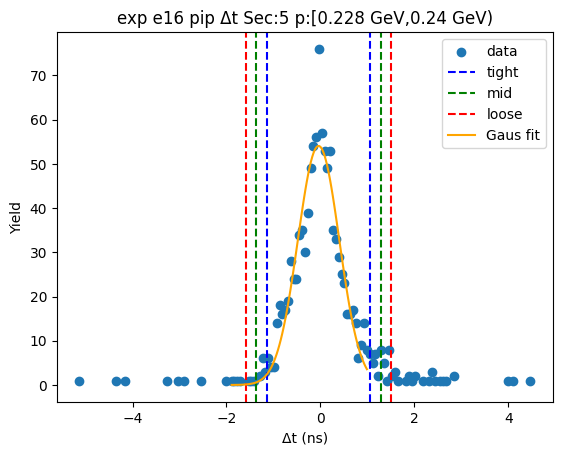

-1.1542981329941506 1.027427536131397
-1.3724706999067056 1.2456001030439519
-1.5906432668192603 1.4637726699565066
[ 7.03010970e+01 -6.34352984e-02  4.36345134e-01]


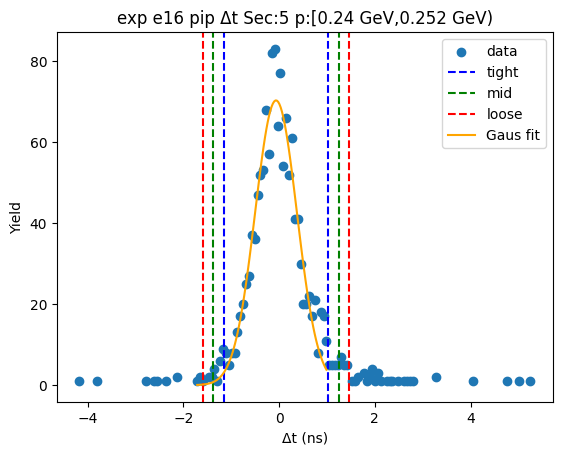

-1.1744519366711692 0.9868857058576876
-1.390585700924055 1.2030194701105734
-1.6067194651769405 1.419153234363459
[91.38973714 -0.09378312  0.43226753]


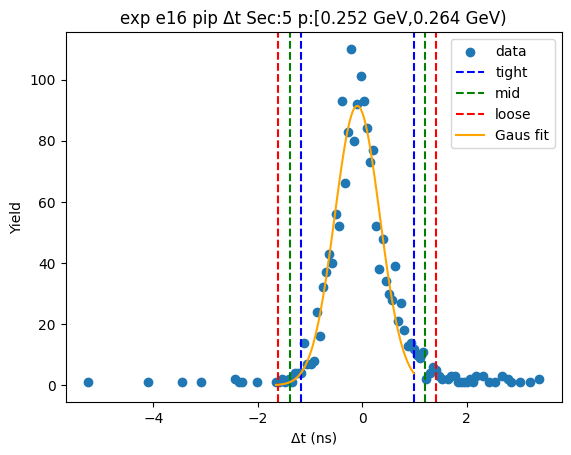

-1.11144965904574 0.9485534846877198
-1.3174499734190859 1.154553799061066
-1.5234502877924319 1.360554113434412
[ 1.08277397e+02 -8.14480872e-02  4.12000629e-01]


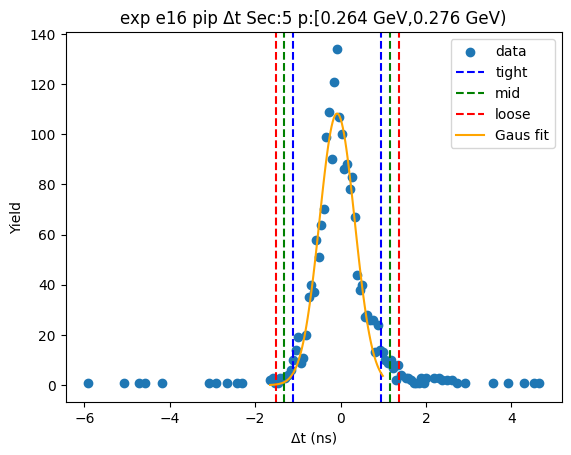

-1.1207365443464326 0.9562827581991209
-1.3284384746009879 1.1639846884536762
-1.5361404048555432 1.3716866187082315
[ 1.14637350e+02 -8.22268931e-02  4.15403861e-01]


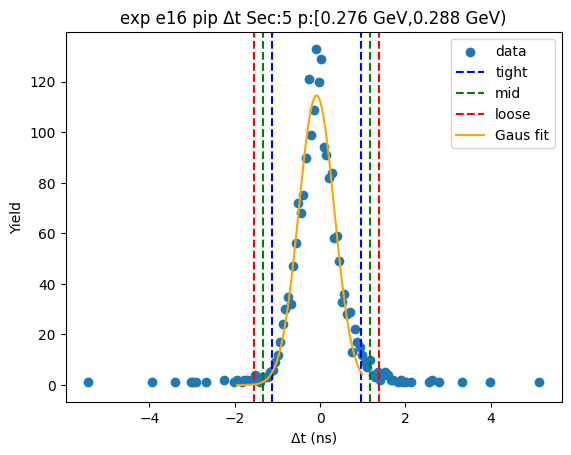

-1.0987749423971798 0.9602634526832902
-1.3046787819052266 1.1661672921913369
-1.5105826214132736 1.3720711316993839
[ 1.25028142e+02 -6.92557449e-02  4.11807679e-01]


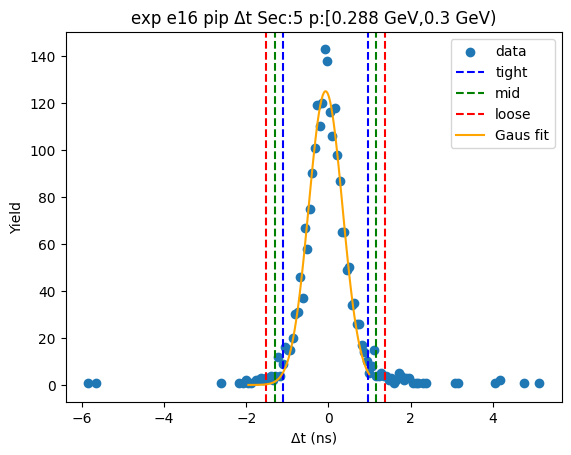

-1.1173356041079396 1.0239127818747502
-1.3314604427062084 1.238037620473019
-1.5455852813044775 1.452162459071288
[ 1.21344114e+02 -4.67114111e-02  4.28249677e-01]


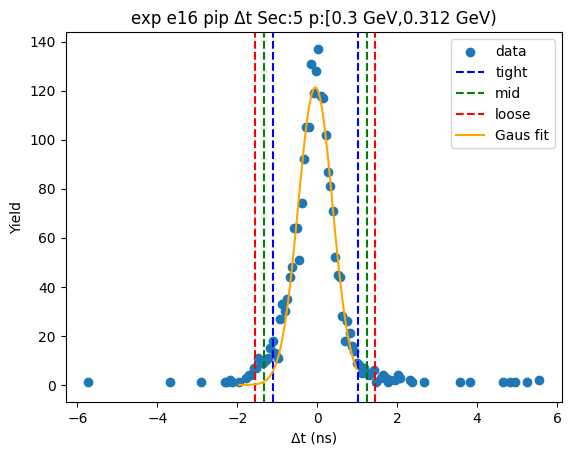

-1.2140337100253245 1.0344973604914873
-1.4388868170770057 1.2593504675431686
-1.663739924128687 1.4842035745948494
[ 1.16712004e+02 -8.97681748e-02  4.49706214e-01]


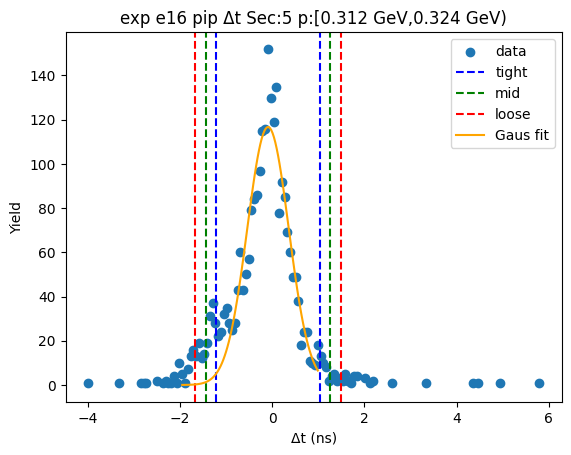

-1.2430770910065523 1.1019249746792024
-1.4775772975751276 1.3364251812477776
-1.712077504143703 1.5709253878163532
[ 1.14705828e+02 -7.05760582e-02  4.69000413e-01]


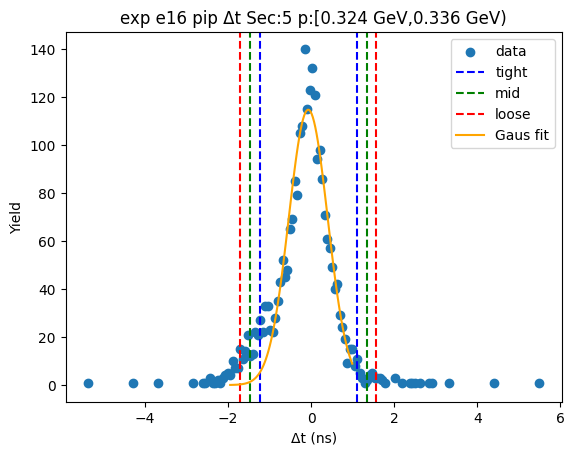

-1.169635875695979 1.0098756225891494
-1.3875870255244918 1.2278267724176621
-1.6055381753530045 1.4457779222461749
[ 1.22941735e+02 -7.98801266e-02  4.35902300e-01]


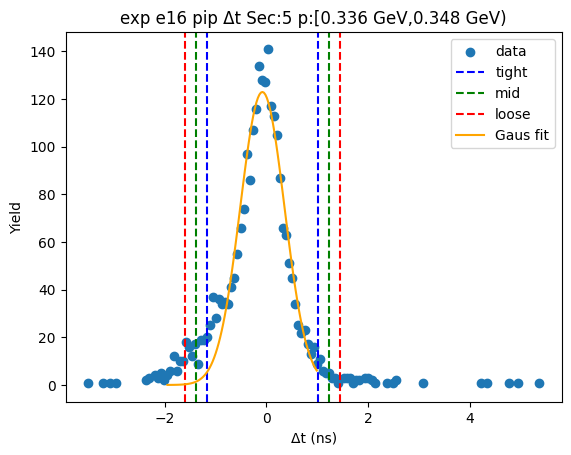

-1.2158973440890897 0.9957407015146242
-1.437061148649461 1.2169045060749957
-1.6582249532098325 1.438068310635367
[ 1.33160360e+02 -1.10078321e-01  4.42327609e-01]


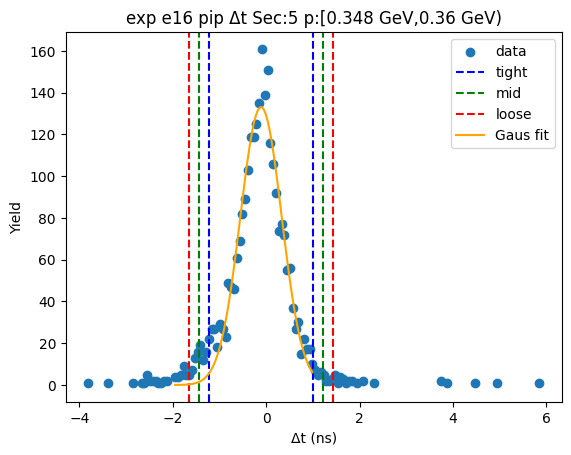

-1.1125976101193535 0.9216006007849116
-1.3160174312097799 1.125020421875338
-1.5194372523002064 1.3284402429657645
[ 1.38789835e+02 -9.54985047e-02  4.06839642e-01]


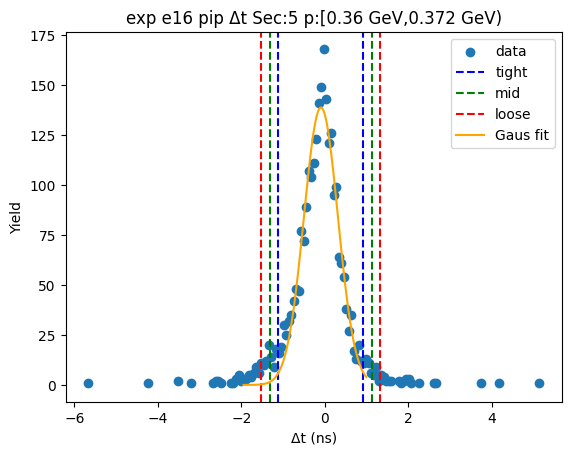

-1.056584619030948 0.9032782745288881
-1.2525709083869316 1.0992645638848717
-1.4485571977429152 1.2952508532408553
[ 1.43121572e+02 -7.66531723e-02  3.91972579e-01]


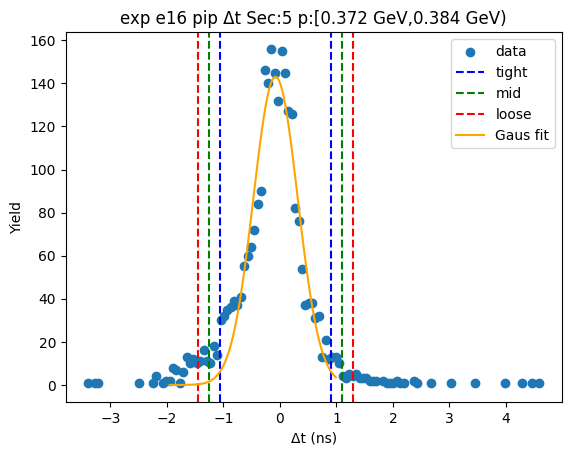

-1.1146487620016599 0.8887893839307965
-1.3149925765949053 1.089133198524042
-1.515336391188151 1.2894770131172877
[ 1.46865259e+02 -1.12929689e-01  4.00687629e-01]


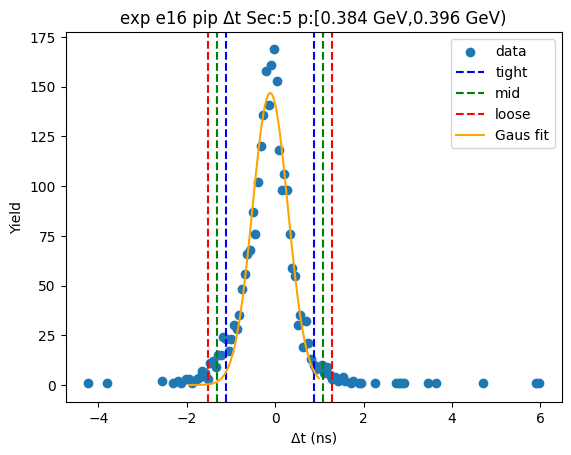

-1.104715396844123 0.856922387466473
-1.3008791752751827 1.0530861658975328
-1.4970429537062422 1.2492499443285923
[ 1.49192807e+02 -1.23896505e-01  3.92327557e-01]


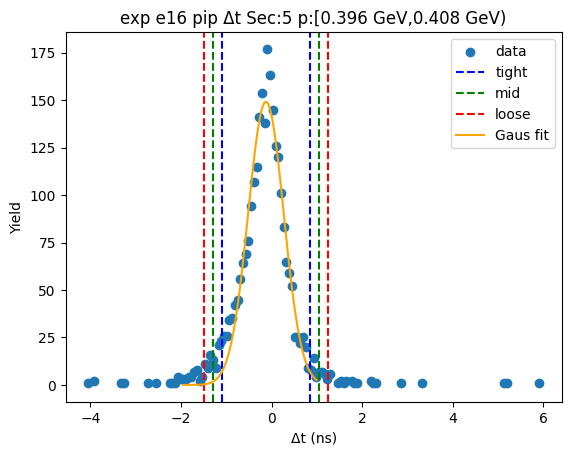

-1.1532904150433514 0.8745325459926772
-1.3560727111469542 1.07731484209628
-1.5588550072505571 1.280097138199883
[ 1.45058451e+02 -1.39378935e-01  4.05564592e-01]


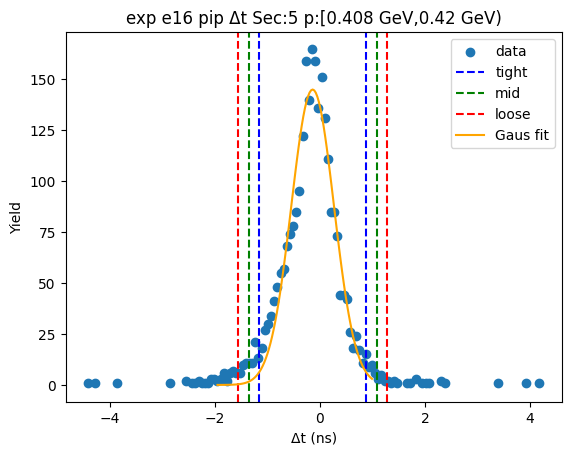

-1.169747180692215 0.8559215231177609
-1.372314051073213 1.0584883934987586
-1.5748809214542105 1.2610552638797565
[153.62539698  -0.15691283   0.40513374]


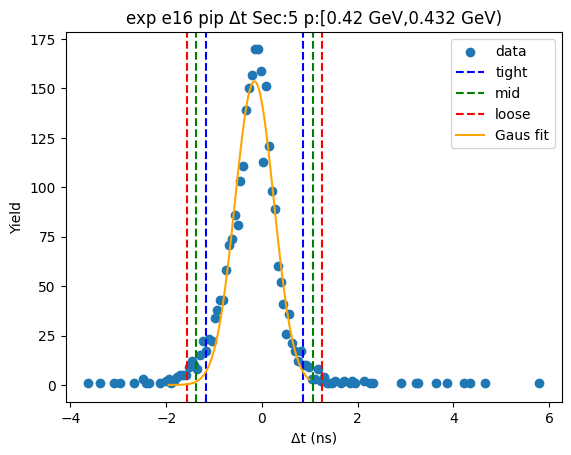

-1.1667959403508181 0.8338292965978331
-1.3668584640456831 1.033891820292698
-1.566920987740548 1.233954343987563
[154.44674976  -0.16648332   0.40012505]


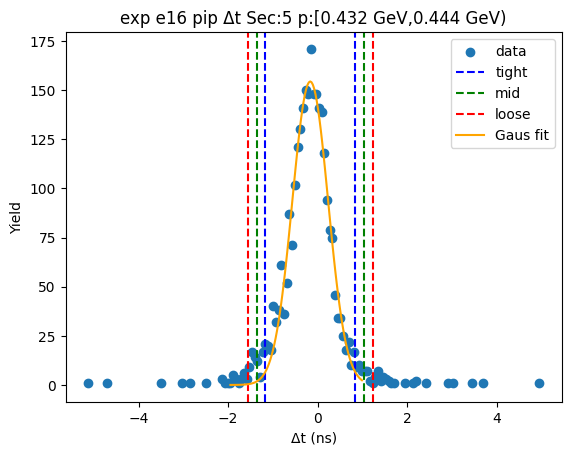

-1.1553946972922366 0.8400619744740215
-1.3549403644688625 1.0396076416506472
-1.5544860316454883 1.239153308827273
[153.18317866  -0.15766636   0.39909133]


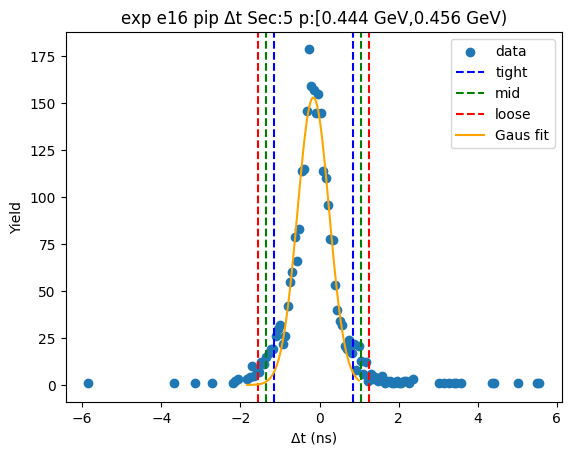

-1.20516902699656 0.970580018021829
-1.422743931498399 1.188154922523668
-1.6403188360002379 1.405729827025507
[ 1.33964320e+02 -1.17294504e-01  4.35149809e-01]


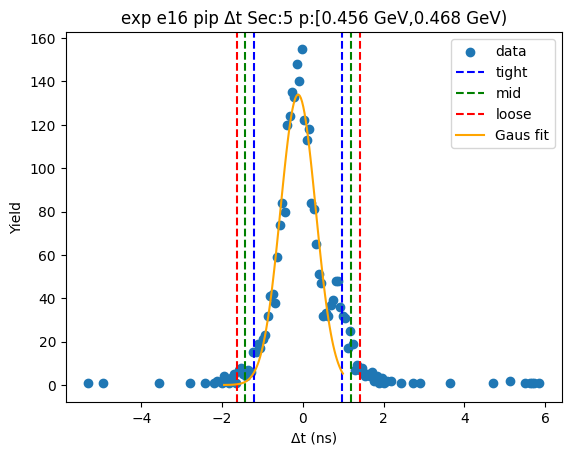

-1.3875428238100866 1.3579741390640199
-1.6620945200974975 1.6325258353514307
-1.936646216384908 1.9070775316388413
[ 1.11408122e+02 -1.47843424e-02  5.49103393e-01]


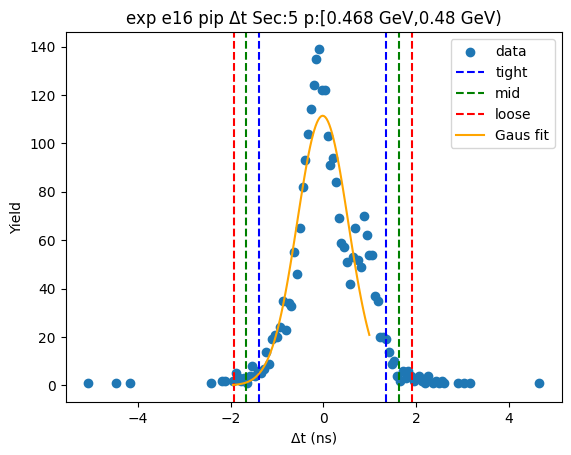

-1.4947280623764134 1.771425171491536
-1.8213433857632082 2.098040494878331
-2.147958709150003 2.424655818265126
[95.44102722  0.13834855  0.65323065]


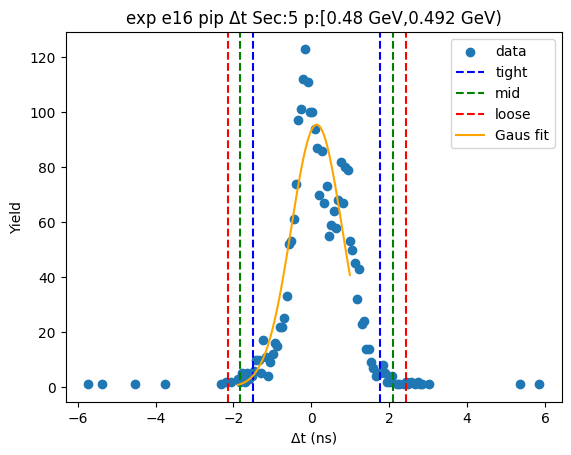

-1.5475109126465656 1.9786879026029045
-1.9001307941715124 2.3313077841278513
-2.2527506756964595 2.6839276656527984
[92.25776983  0.21558849  0.70523976]


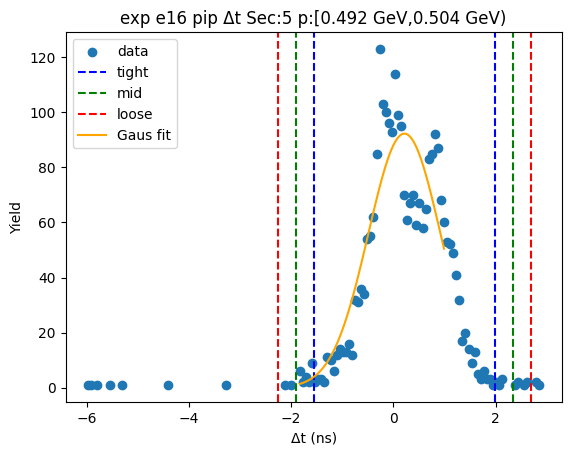

-1.427792313332971 1.9349591954244867
-1.7640674642087169 2.2712343463002327
-2.1003426150844624 2.6075094971759785
[93.84826517  0.25358344  0.6725503 ]


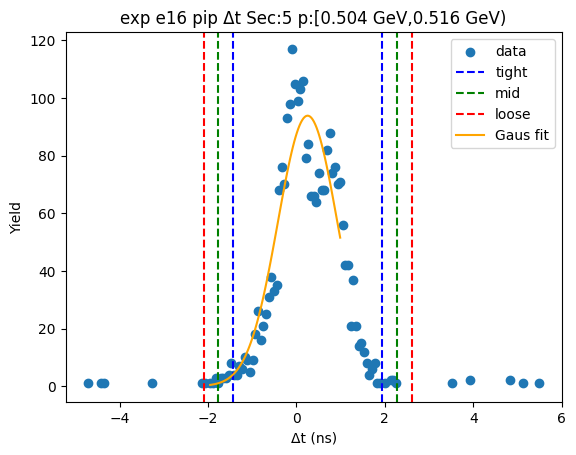

-1.3977116429753882 2.0408413242442873
-1.741566939697356 2.3846966209662552
-2.0854222364193236 2.7285519176882227
[94.49807863  0.32156484  0.68771059]


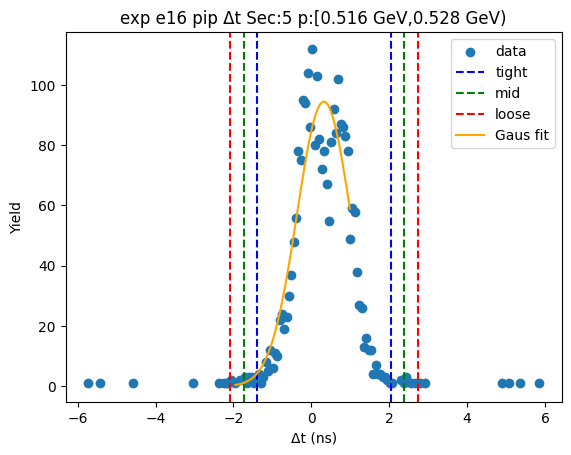

-1.514605703806812 2.3100656340037395
-1.8970728375878667 2.6925327677847943
-2.279539971368922 3.0749999015658496
[91.47560377  0.39772997  0.76493427]


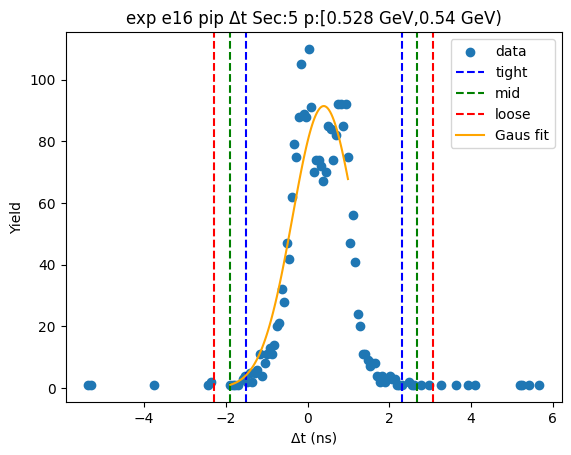

-1.4259552086379703 1.9526774778023304
-1.763818477282 2.29054074644636
-2.1016817459260304 2.62840401509039
[91.36950318  0.26336113  0.67572654]


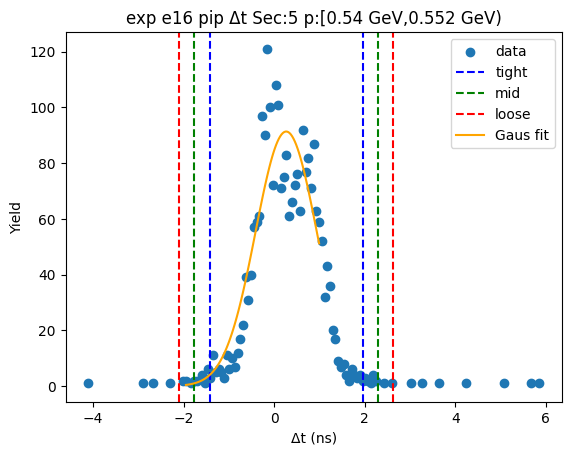

-1.2501764753892783 1.4688313416795613
-1.5220772570961625 1.7407321233864455
-1.7939780388030464 2.012632905093329
[104.26491166   0.10932743   0.54380156]


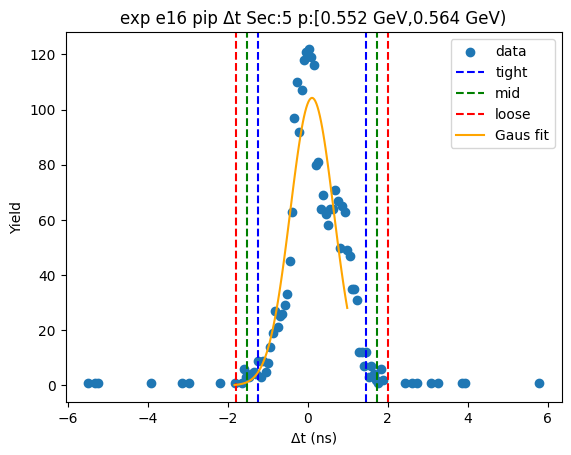

-1.1612491348668454 1.2894796119264074
-1.4063220095461708 1.5345524866057327
-1.651394884225496 1.7796253612850579
[1.08277271e+02 6.41152385e-02 4.90145749e-01]


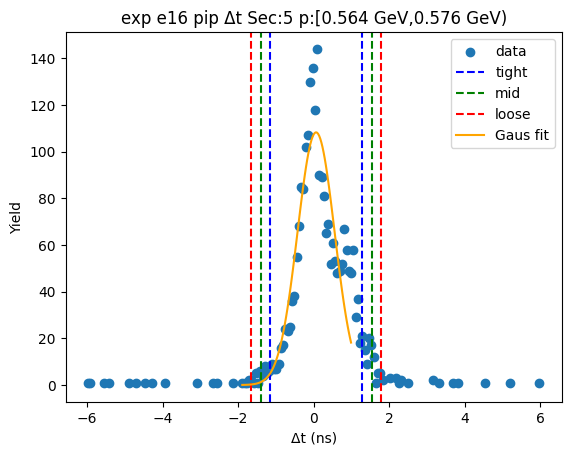

-1.1622734202629288 1.3082385090221056
-1.4093246131914323 1.5552897019506091
-1.6563758061199356 1.8023408948791124
[1.08003079e+02 7.29825444e-02 4.94102386e-01]


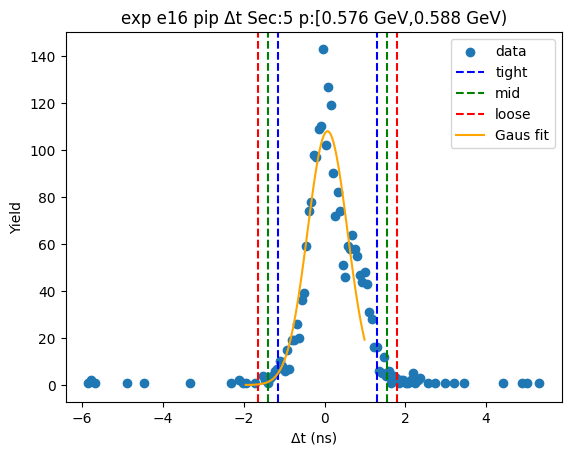

-1.1710940933395446 1.3426368524676788
-1.4224671879202668 1.594009947048401
-1.673840282500989 1.8453830416291233
[1.00684222e+02 8.57713796e-02 5.02746189e-01]


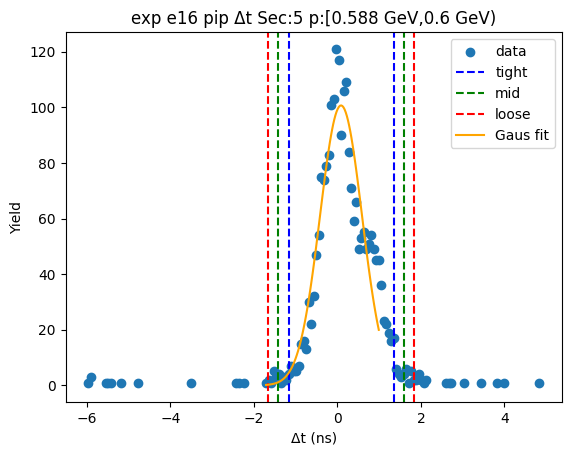

-1.0723869470504366 1.2002177122980693
-1.2996474129852873 1.42747817823292
-1.526907878920138 1.6547386441677707
[1.10438204e+02 6.39153826e-02 4.54520932e-01]


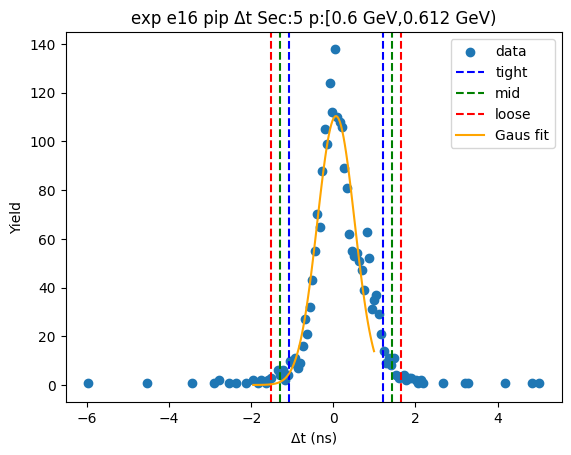

-1.048631383370933 1.207063394030775
-1.274200861111104 1.4326328717709458
-1.4997703388512746 1.6582023495111164
[1.06528540e+02 7.92160053e-02 4.51138955e-01]


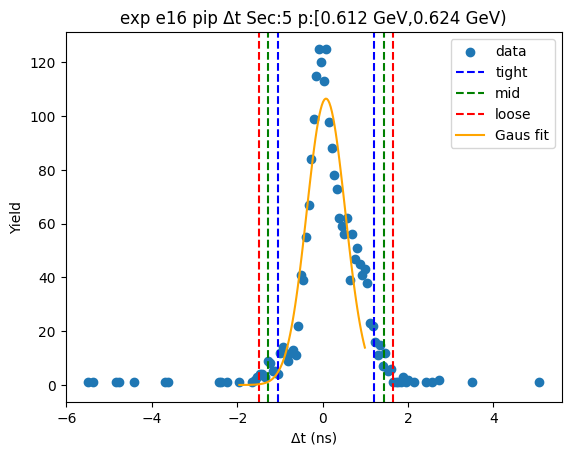

-0.9575008296310387 1.1341607988124125
-1.166666992475384 1.3433269616567578
-1.3758331553197292 1.5524931245011029
[1.11748499e+02 8.83299846e-02 4.18332326e-01]


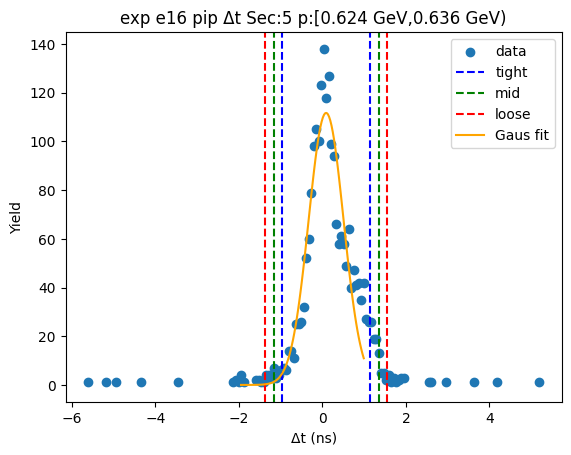

-1.0040241139620902 1.2033620366261712
-1.2247627290209164 1.4241006516849974
-1.4455013440797426 1.6448392667438236
[1.07107773e+02 9.96689613e-02 4.41477230e-01]


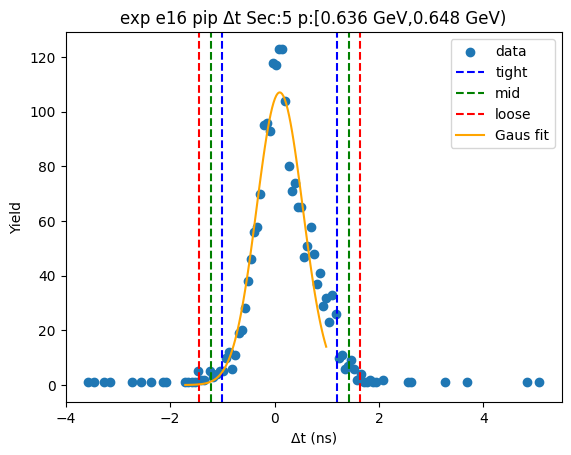

-1.0676394022191382 1.2345068991518682
-1.2978540323562386 1.464721529288969
-1.5280686624933395 1.6949361594260695
[9.55144994e+01 8.34337485e-02 4.60429260e-01]


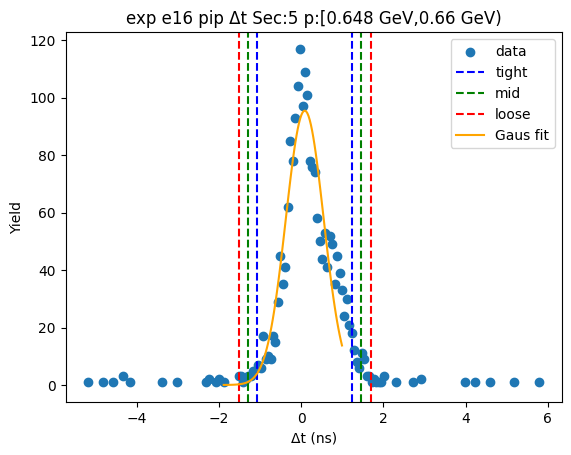

-1.1206542052305175 1.1940518266167919
-1.3521248084152486 1.425522429801523
-1.5835954115999795 1.6569930329862539
[9.60200005e+01 3.66988107e-02 4.62941206e-01]


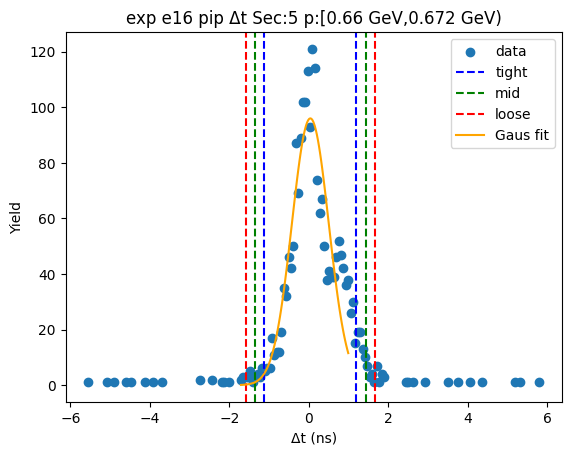

-1.1607138070483876 1.175429325979139
-1.3943281203511402 1.4090436392818917
-1.6279424336538928 1.6426579525846443
[9.62282912e+01 7.35775947e-03 4.67228627e-01]


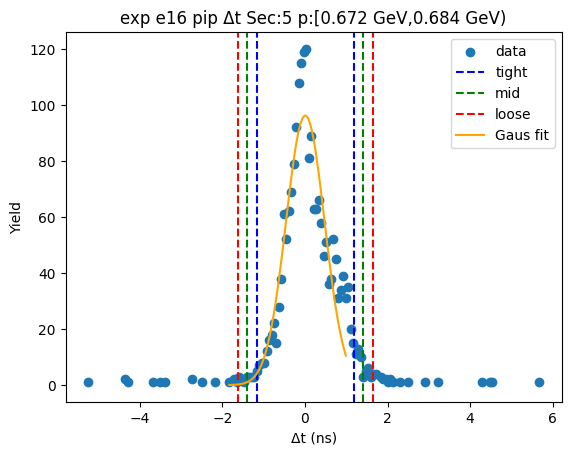

-1.1686722912851835 1.1611271658869966
-1.4016522370024014 1.3941071116042145
-1.6346321827196195 1.6270870573214327
[ 8.91776330e+01 -3.77256270e-03  4.65959891e-01]


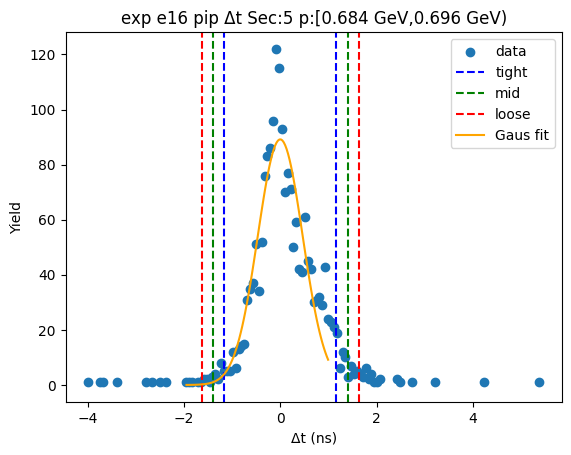

-1.2465388634648378 1.218929649494563
-1.4930857147607777 1.4654765007905028
-1.7396325660567178 1.712023352086443
[ 8.65362371e+01 -1.38046070e-02  4.93093703e-01]


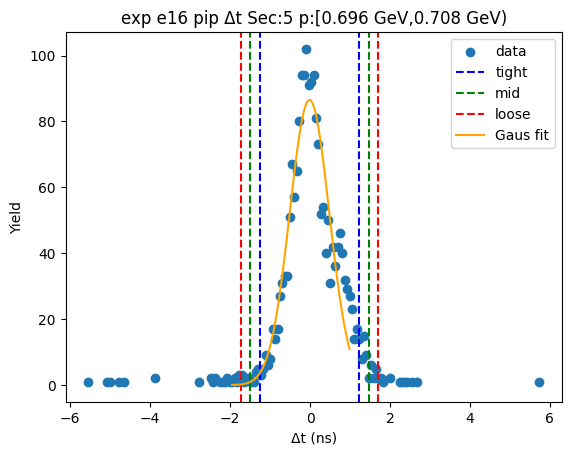

-1.293788260120982 1.2646058710644723
-1.5496276732395273 1.5204452841830176
-1.8054670863580726 1.776284697301563
[ 8.07453367e+01 -1.45911945e-02  5.11678826e-01]


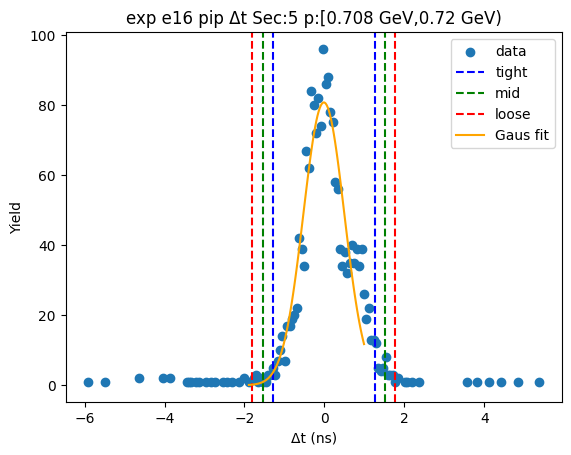

-1.2649963528822517 1.201439836895897
-1.5116399718600664 1.4480834558737117
-1.758283590837881 1.6947270748515264
[ 8.04859759e+01 -3.17782580e-02  4.93287238e-01]


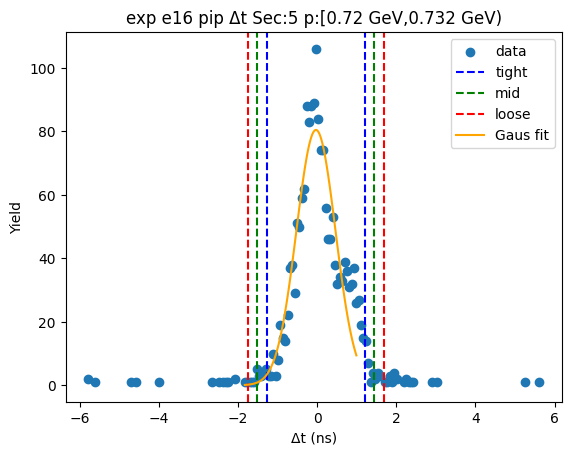

-1.1777925755593015 1.171724350803338
-1.4127442681955653 1.4066760434396017
-1.6476959608318291 1.6416277360758655
[ 8.46348443e+01 -3.03411238e-03  4.69903385e-01]


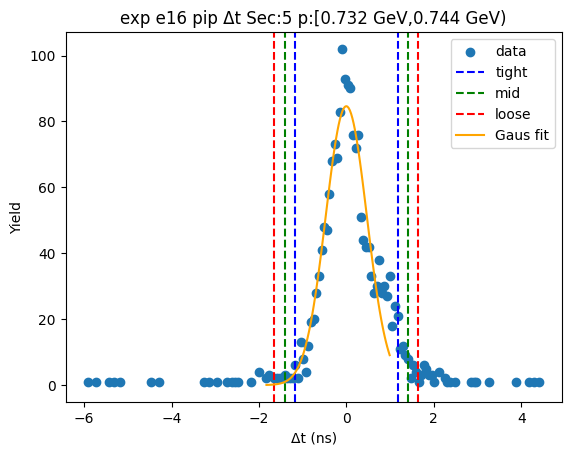

-1.2107315109175452 1.2924599566574786
-1.4610506576750477 1.5427791034149811
-1.71136980443255 1.7930982501724835
[7.69126975e+01 4.08642229e-02 5.00638294e-01]


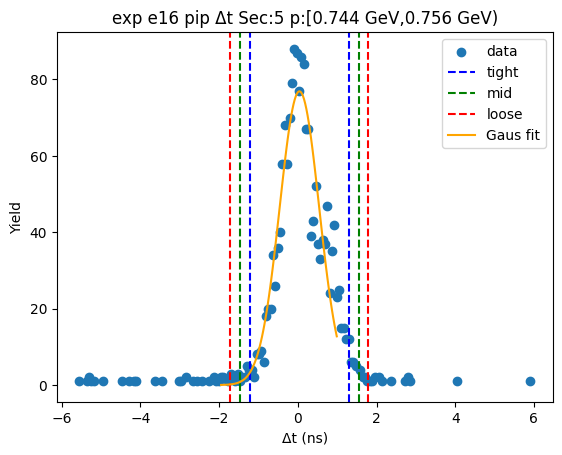

-1.0875157046824773 1.1553722479042816
-1.3118044999411531 1.3796610431629575
-1.536093295199829 1.6039498384216333
[8.50320129e+01 3.39282716e-02 4.48577591e-01]


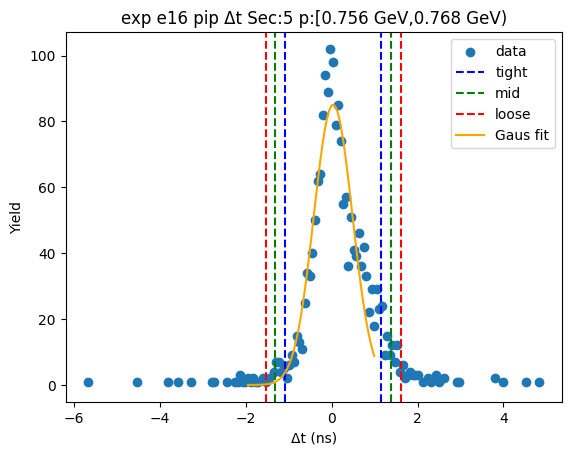

-1.1396448542441966 1.2108044912961324
-1.3746897887982295 1.4458494258501653
-1.6097347233522623 1.6808943604041982
[7.54064802e+01 3.55798185e-02 4.70089869e-01]


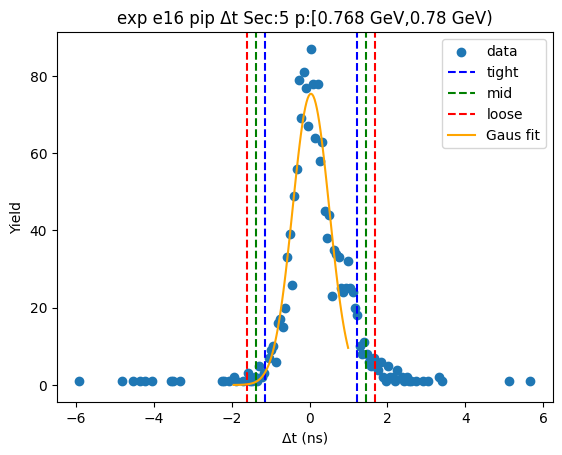

-1.2323952995925334 1.3783332747345298
-1.4934681570252395 1.639406132167236
-1.754541014457946 1.900478989599942
[66.6653413   0.07296899  0.52214571]


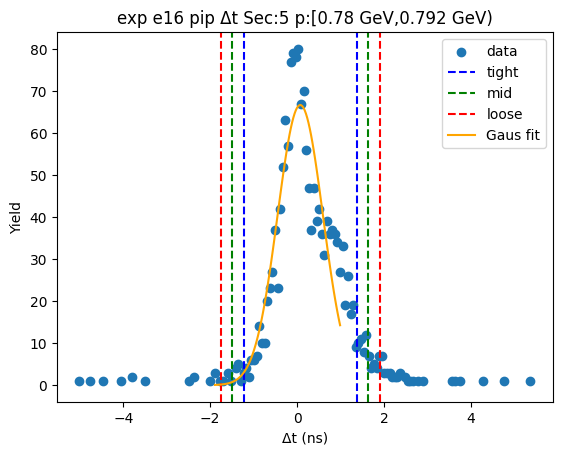

-1.1921969423662837 1.3965210837146582
-1.4510687449743778 1.6553928863227523
-1.7099405475824718 1.9142646889308463
[63.5758173   0.10216207  0.51774361]


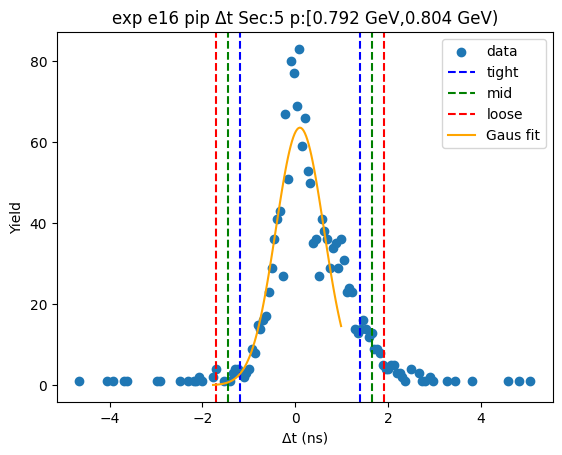

-1.2938505514915146 1.5327855871765124
-1.5765141653583175 1.8154492010433152
-1.8591777792251203 2.098112814910118
[60.35998413  0.11946752  0.56532723]


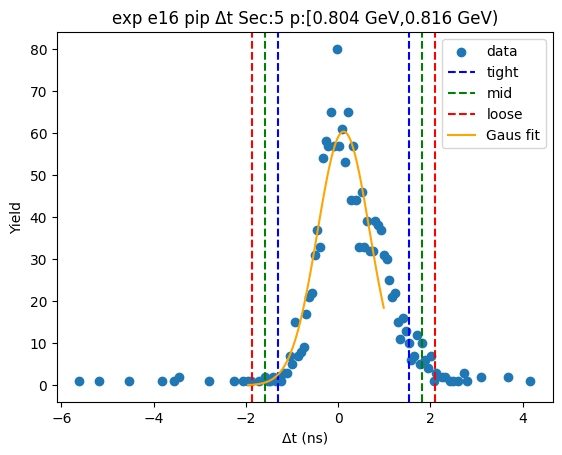

-1.301849027888926 1.4716305606299933
-1.5791969867408182 1.7489785194818854
-1.85654494559271 2.026326478333777
[55.10141776  0.08489077  0.55469592]


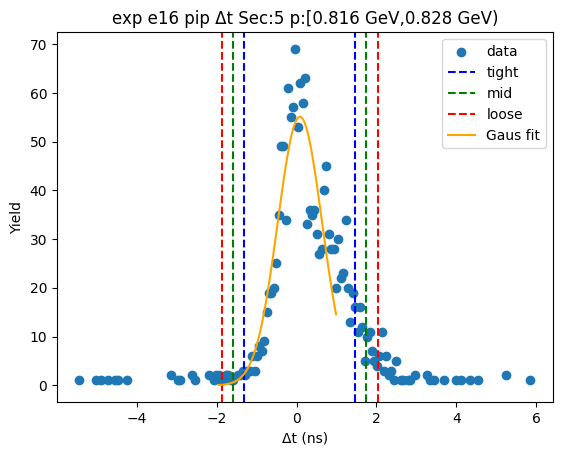

-1.4216107185634115 1.5512481344660982
-1.7188966038663624 1.8485340197690492
-2.016182489169313 2.1458199050720004
[52.9397648   0.06481871  0.59457177]


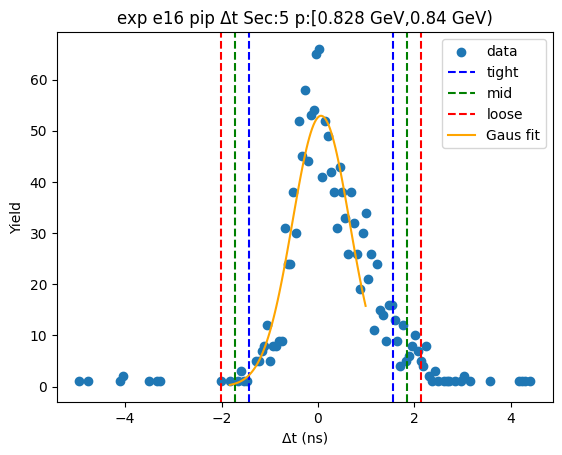

-1.3432921219108502 1.4191524476454065
-1.6195365788664757 1.695396904601032
-1.8957810358221014 1.9716413615566577
[5.40891307e+01 3.79301629e-02 5.52488914e-01]


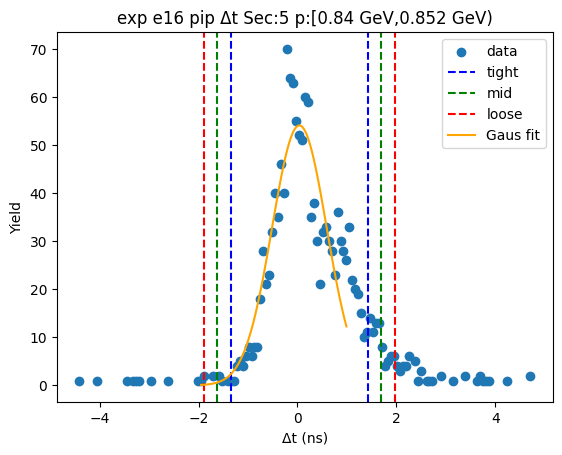

-1.3731875841514427 1.5179440782753437
-1.6623007503941212 1.8070572445180222
-1.9514139166367999 2.096170410760701
[51.08588369  0.07237825  0.57822633]


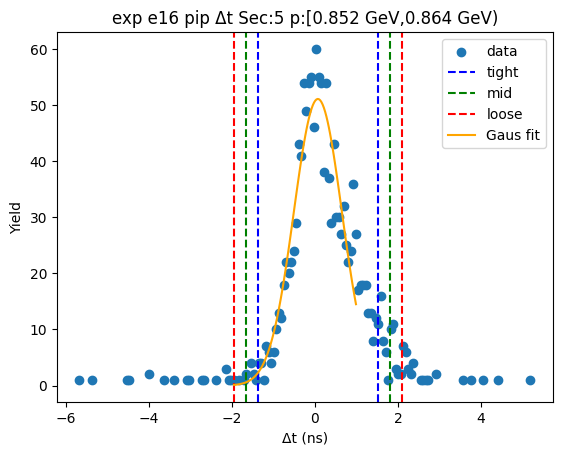

-1.5295731593573811 1.480841394219341
-1.8306146147150535 1.7818828495770134
-2.131656070072726 2.0829243049346857
[ 4.77619271e+01 -2.43658826e-02  6.02082911e-01]


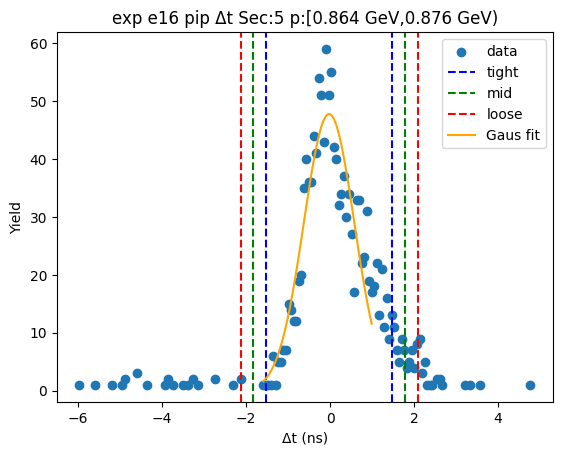

-1.5244742614430846 1.5150539136610868
-1.8284270789535018 1.819006731171504
-2.132379896463919 2.1229595486819206
[ 4.68667396e+01 -4.71017389e-03  6.07905635e-01]


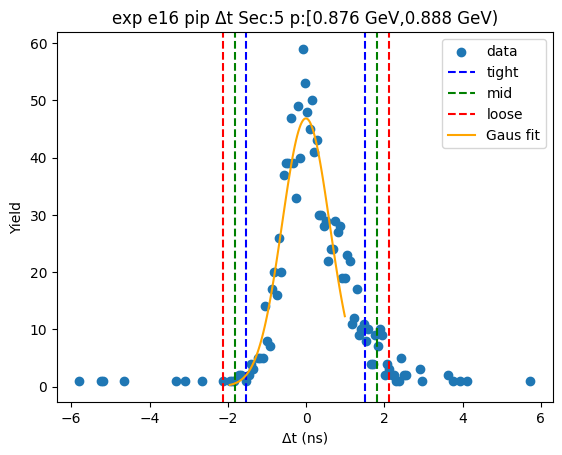

-1.4226174416076245 1.3047826068196202
-1.6953574464503491 1.5775226116623449
-1.9680974512930736 1.8502626165050693
[47.65120644 -0.05891742  0.54548001]


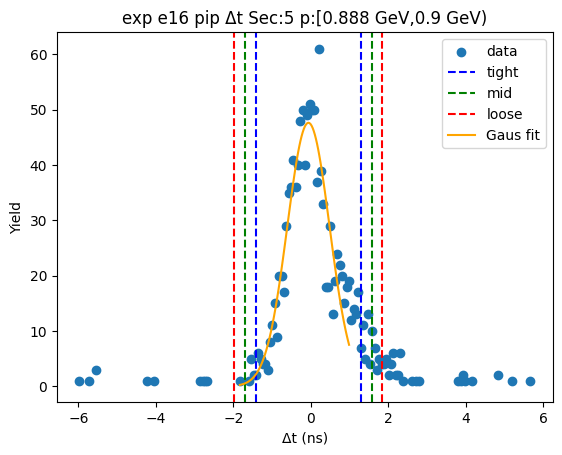

-1.4458000875706731 1.4001851227364766
-1.7303986086013883 1.6847836437671917
-2.0149971296321034 1.9693821647979066
[ 4.71120023e+01 -2.28074824e-02  5.69197042e-01]


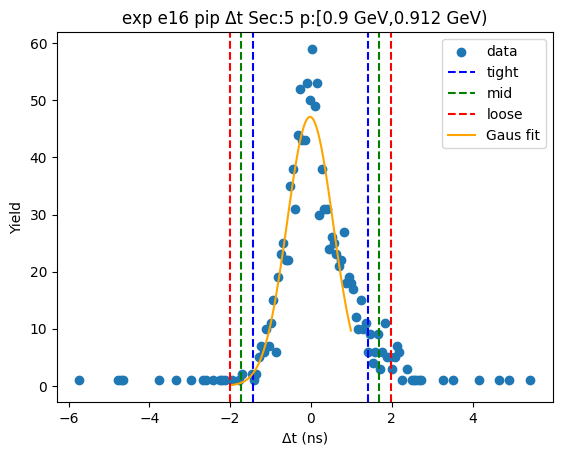

-1.5776541211472603 1.3197751680812784
-1.867397050070114 1.609518097004132
-2.1571399789929684 1.8992610259269862
[45.81578204 -0.12893948  0.57948586]


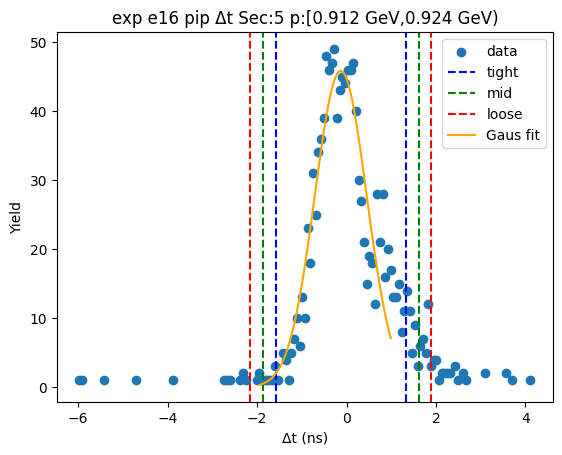

-1.5874058873365289 1.3444124790581926
-1.8805877239760012 1.637594315697665
-2.1737695606154737 1.9307761523371372
[44.02095841 -0.1214967   0.58636367]


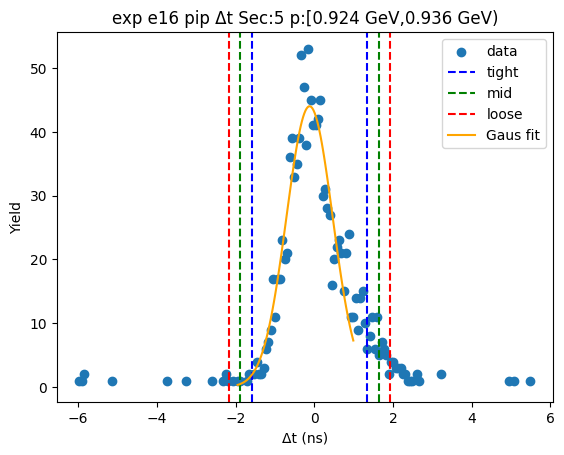

-1.6491274698062015 1.4130488038717277
-1.9553450971739943 1.7192664312395205
-2.261562724541787 2.0254840586073133
[39.79730602 -0.11803933  0.61243525]


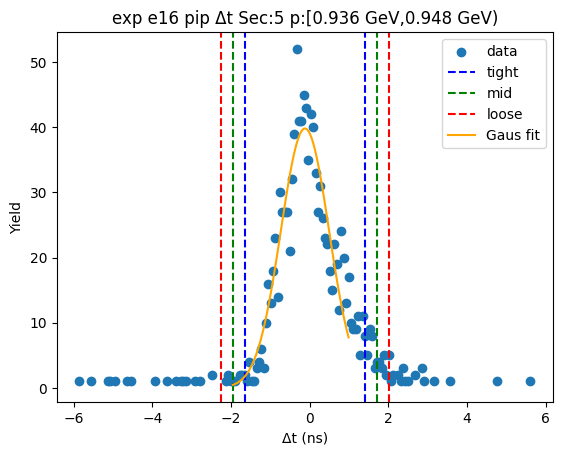

-1.6551494195963867 1.250641213978481
-1.9457284829538737 1.541220277335968
-2.23630754631136 1.8317993406934545
[41.12612887 -0.2022541   0.58115813]


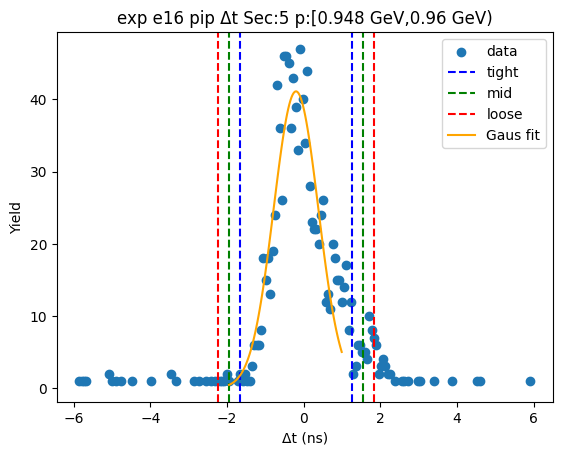

-1.6169892772551915 1.2542263468693582
-1.9041108396676463 1.541347909281813
-2.1912324020801015 1.8284694716942682
[41.92195195 -0.18138147  0.57424312]


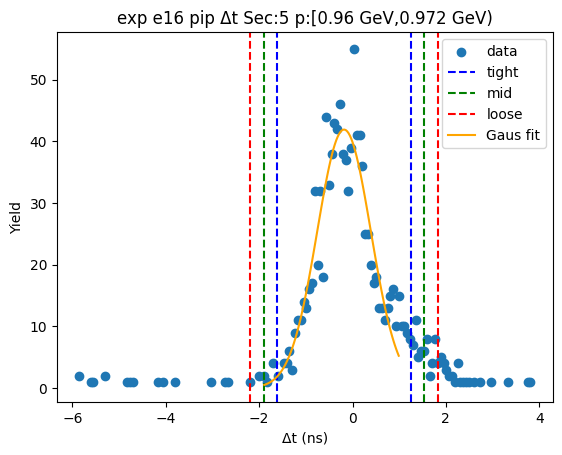

-1.6574968471660387 1.359996845299202
-1.9592462164125628 1.661746214545726
-2.260995585659087 1.96349558379225
[40.66391126 -0.14875     0.60349874]


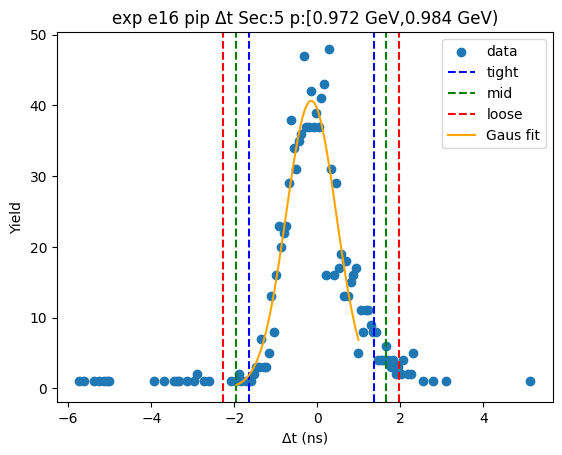

-1.6459861930359592 1.2443224550431766
-1.9350170578438726 1.53335331985109
-2.224047922651786 1.8223841846590036
[38.16256834 -0.20083187  0.57806173]


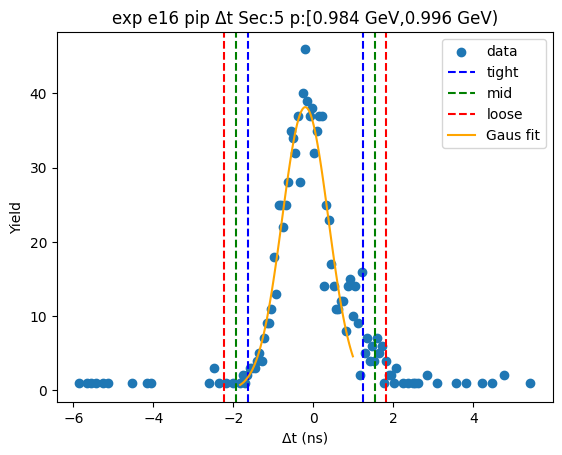

-1.5544117736337744 1.2469441033939694
-1.8345473613365486 1.5270796910967437
-2.114682949039323 1.807215278799518
[39.6255893  -0.15373384  0.56027118]


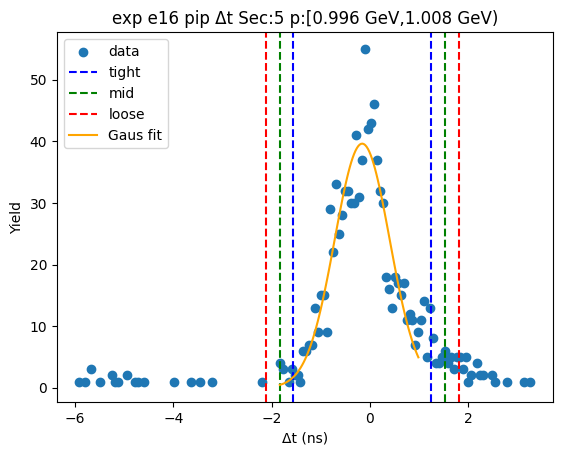

-1.6224707153292854 1.179455398277811
-1.9026633266899953 1.459648009638521
-2.182855938050705 1.7398406209992305
[35.18612977 -0.22150766  0.56038522]


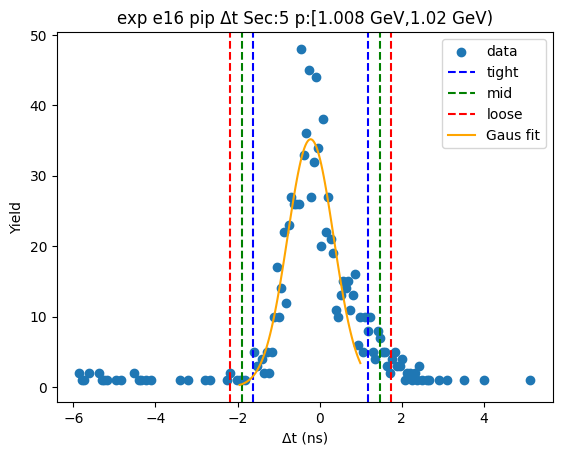

-1.6338221722757202 1.2698583046238197
-1.9241902199656744 1.5602263523137738
-2.214558267655628 1.8505944000037275
[37.28249625 -0.18198193  0.5807361 ]


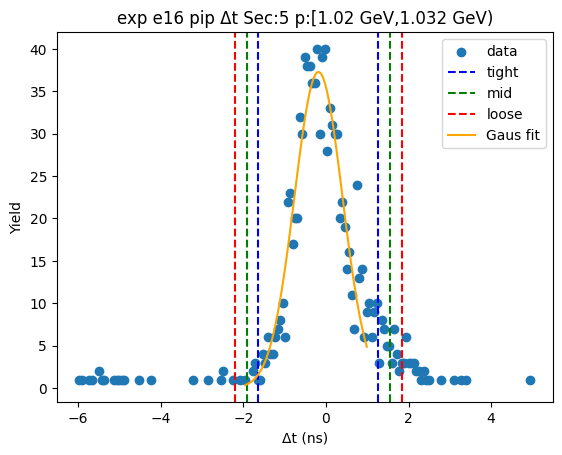

-1.5833871785178775 1.2938748325731781
-1.8711133796269832 1.5816010336822839
-2.158839580736089 1.8693272347913894
[38.92583842 -0.14475617  0.5754524 ]


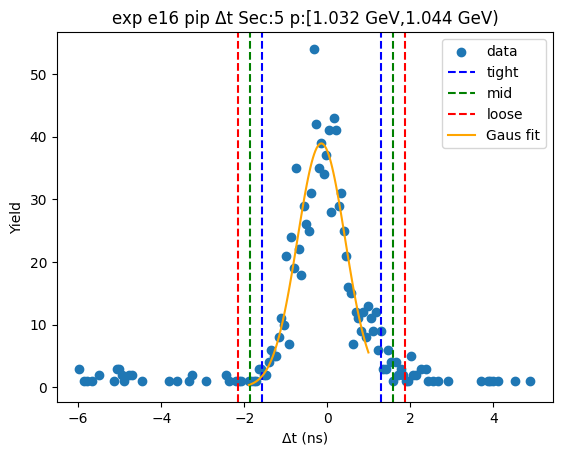

-1.6572259530164661 1.290449186655981
-1.9519934669837107 1.5852167006232256
-2.2467609809509557 1.8799842145904706
[31.95262506 -0.18338838  0.58953503]


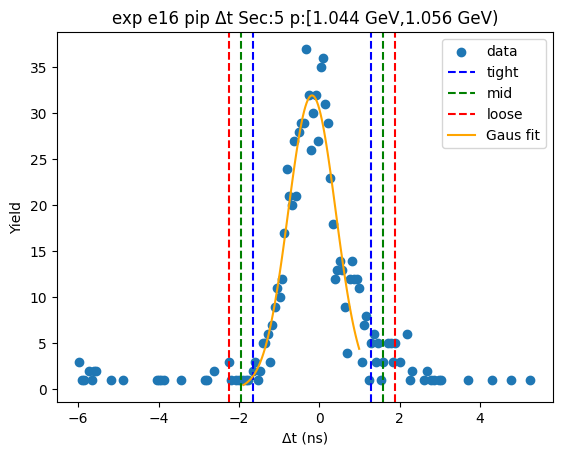

-1.5518696803525922 1.2283519396922549
-1.829891842357077 1.5063741016967396
-2.107914004361562 1.7843962637012243
[35.39537047 -0.16175887  0.55604432]


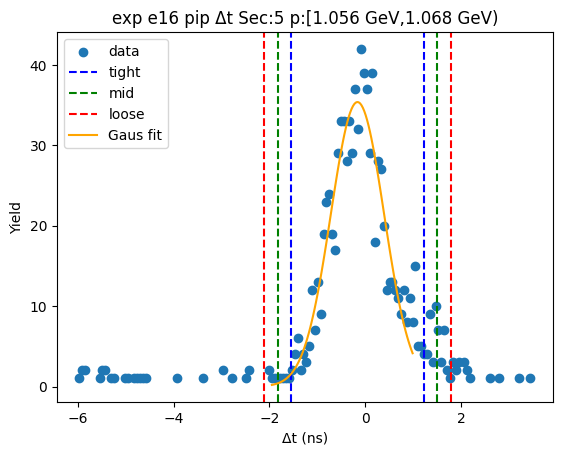

-1.6304433257842421 1.2545908720999377
-1.91894674557266 1.5430942918883557
-2.2074501653610783 1.8315977116767739
[32.74839867 -0.18792623  0.57700684]


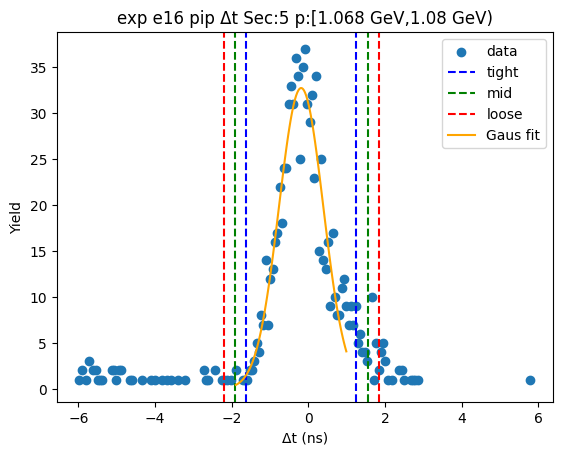

-1.617676004411197 1.2037997979691664
-1.8998235846492333 1.4859473782072026
-2.1819711648872695 1.7680949584452388
[33.76311904 -0.2069381   0.56429516]


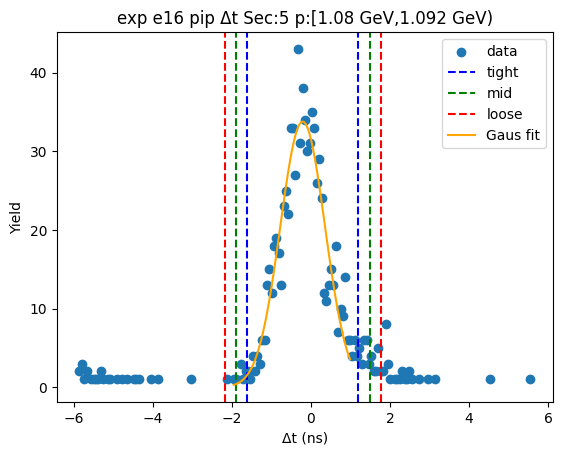

-1.6778813972468982 1.3045132015448702
-1.9761208571260749 1.6027526614240468
-2.274360317005252 1.900992121303224
[31.67288714 -0.1866841   0.59647892]


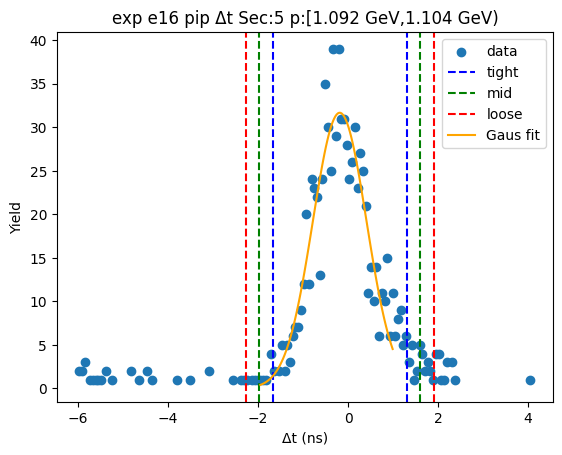

-1.580703910291651 1.2791362699121753
-1.8666879283120337 1.565120287932558
-2.1526719463324167 1.8511043059529408
[30.73375022 -0.15078382  0.57196804]


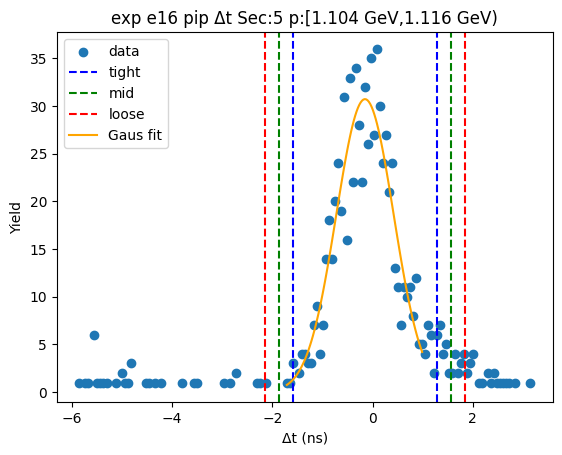

-1.6047899795675735 1.2815718440275088
-1.8934261619270818 1.5702080263870166
-2.18206234428659 1.858844208746525
[32.27948952 -0.16160907  0.57727236]


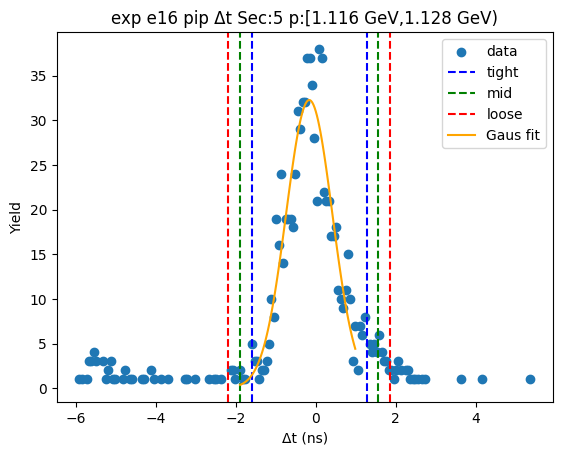

-1.6172380609333048 1.1869775005570842
-1.8976596170823439 1.4673990567061233
-2.1780811732313827 1.747820612855162
[30.17942596 -0.21513028  0.56084311]


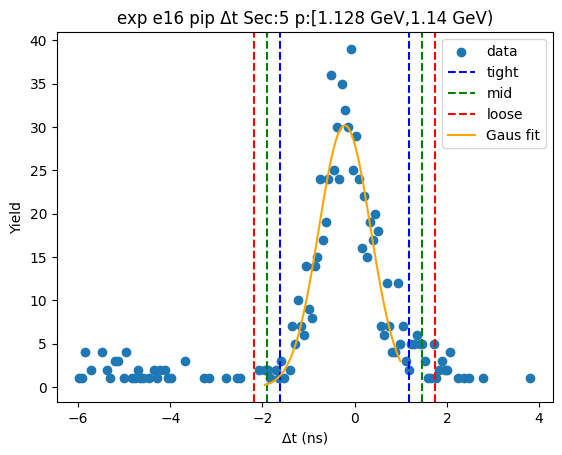

-1.7060236069008998 1.348963470904509
-2.0115223146814407 1.65446217868505
-2.3170210224619816 1.9599608864655909
[27.8424368  -0.17853007  0.61099742]


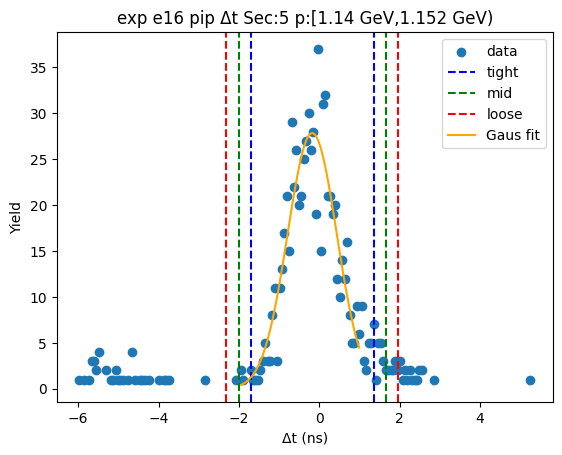

-1.6647550416863577 1.3235311761469386
-1.9635836634696875 1.6223597979302684
-2.262412285253017 1.921188419713598
[27.63776106 -0.17061193  0.59765724]


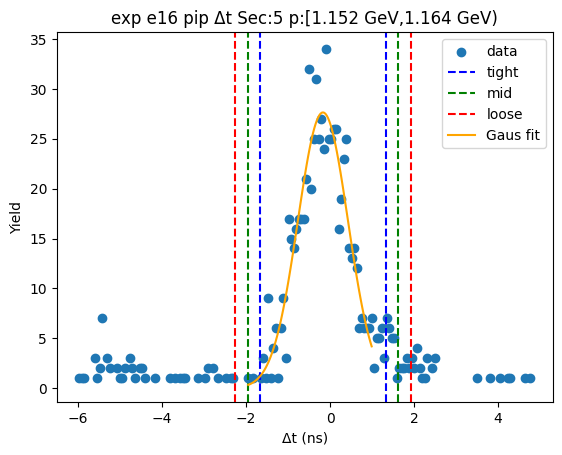

-1.6710865170710354 1.3098838420803418
-1.969183552986173 1.6079808779954794
-2.2672805889013103 1.906077913910617
[26.37074627 -0.18060134  0.59619407]


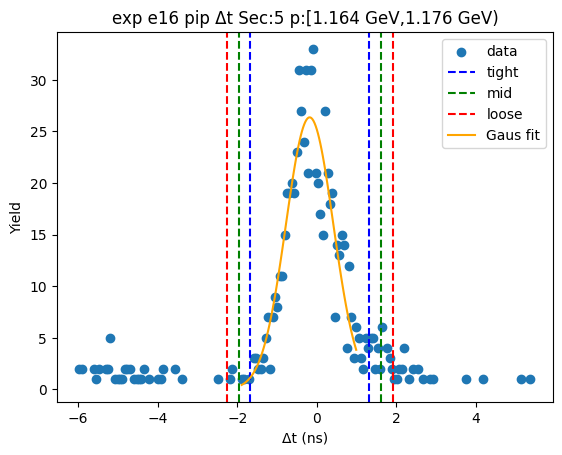

-1.7939669380945074 1.4825754910903421
-2.1216211810129924 1.810229734008827
-2.4492754239314776 2.137883976927312
[23.75223532 -0.15569572  0.65530849]


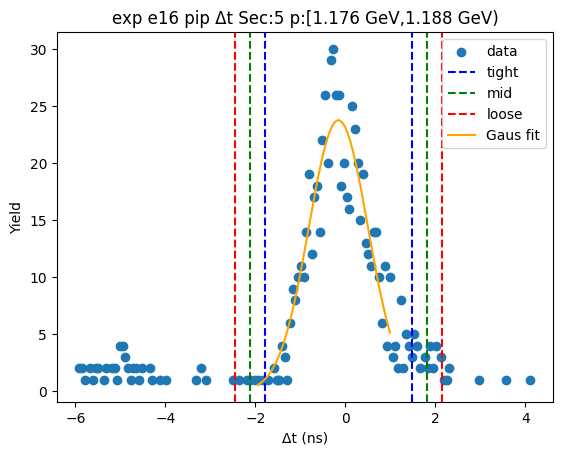

-1.734727604541501 1.3310694193546853
-2.04130730693112 1.6376491217443039
-2.3478870093207385 1.9442288241339225
[25.26807721 -0.20182909  0.6131594 ]


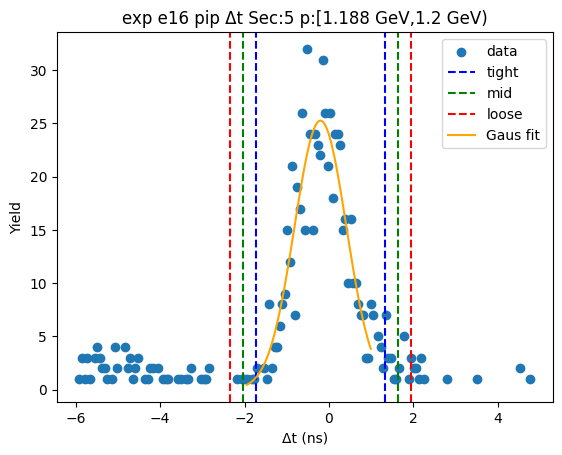

-1.6161007113685268 1.3170287664020617
-1.9094136591455857 1.6103417141791205
-2.2027266069226443 1.9036546619561794
[25.79979052 -0.14953597  0.5866259 ]


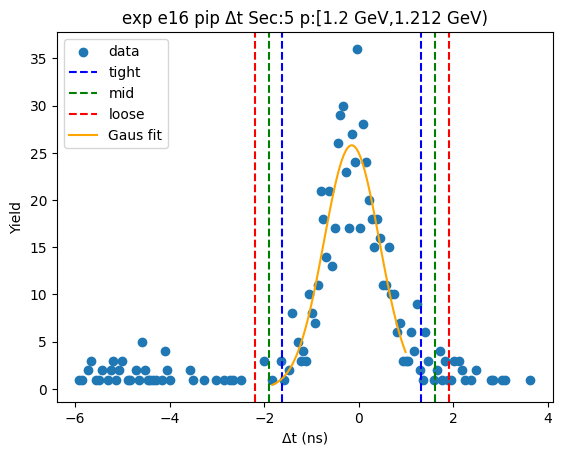

-1.72834040095458 1.3397423678894524
-2.0351486778389836 1.6465506447738558
-2.3419569547233867 1.9533589216582592
[23.64419399 -0.19429902  0.61361655]


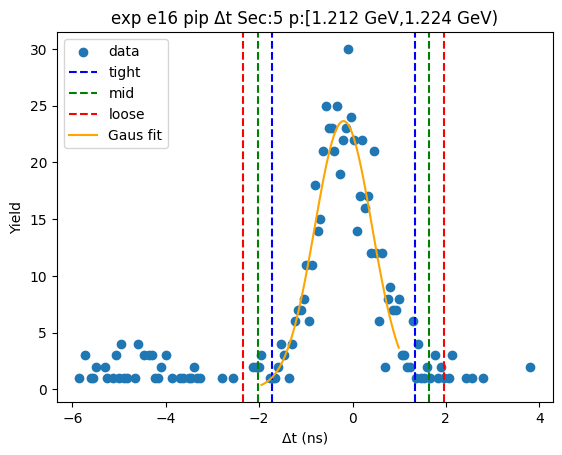

-1.6593630918078532 1.2876288101007565
-1.9540622819987143 1.5823280002916176
-2.2487614721895754 1.8770271904824787
[24.13107548 -0.18586714  0.58939838]


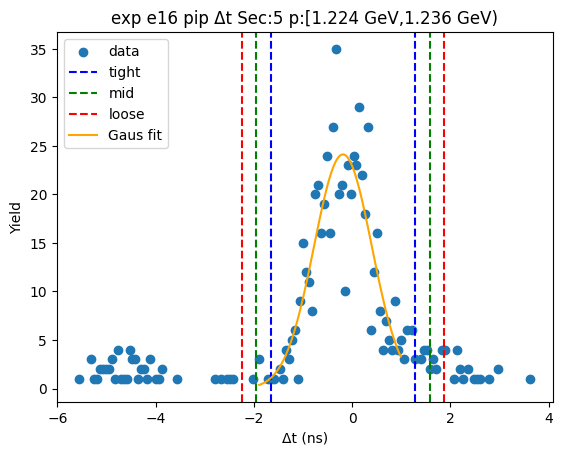

-1.5855050981901369 1.286649094673142
-1.8727205174764647 1.5738645139594698
-2.1599359367627926 1.8610799332457975
[25.31131612 -0.149428    0.57443084]


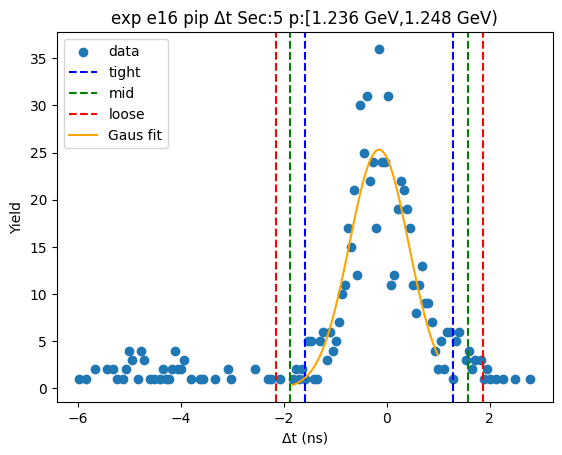

-1.5275167104599545 1.3065851043464283
-1.810926891940593 1.5899952858270667
-2.094337073421231 1.873405467307705
[24.51574074 -0.1104658   0.56682036]


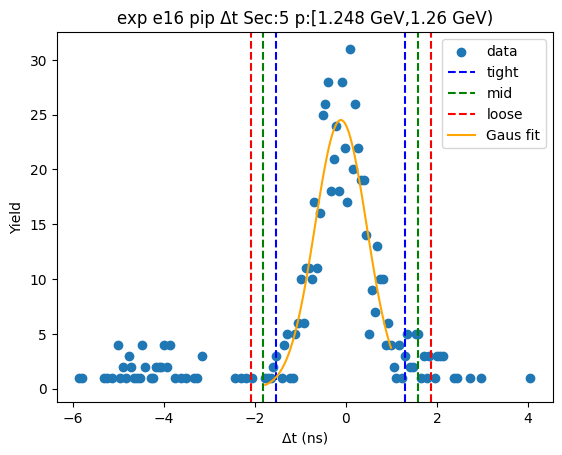

-1.8518349109070396 1.4671319728066219
-2.183731599278406 1.7990286611779882
-2.515628287649772 2.1309253495493543
[20.36087416 -0.19235147  0.66379338]


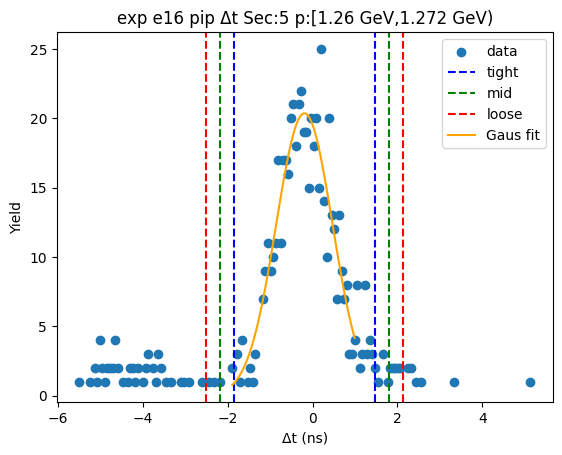

-1.7239413404366335 1.412947354609014
-2.0376302099411983 1.7266362241135789
-2.351319079445763 2.0403250936181436
[19.82951719 -0.15549699  0.62737774]


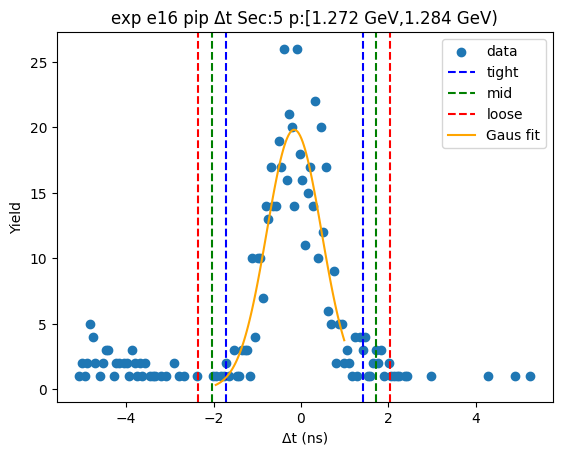

-1.6946988602045732 1.3547883486109873
-1.9996475810861294 1.6597370694925435
-2.304596301967685 1.9646857903740993
[21.61566929 -0.16995526  0.60989744]


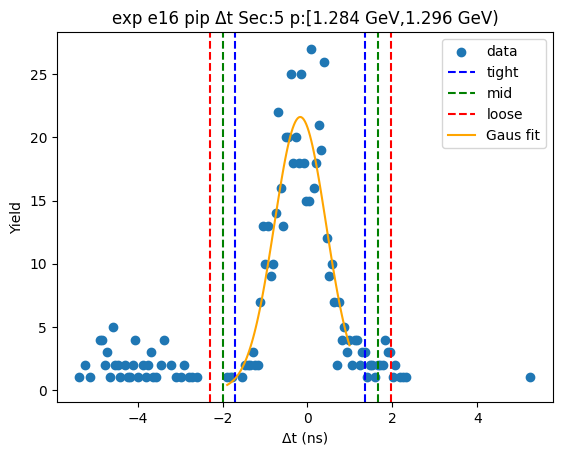

-1.6601312211040378 1.1863118666481045
-1.9447755298792522 1.470956175423319
-2.2294198386544664 1.755600484198533
[21.095439   -0.23690968  0.56928862]


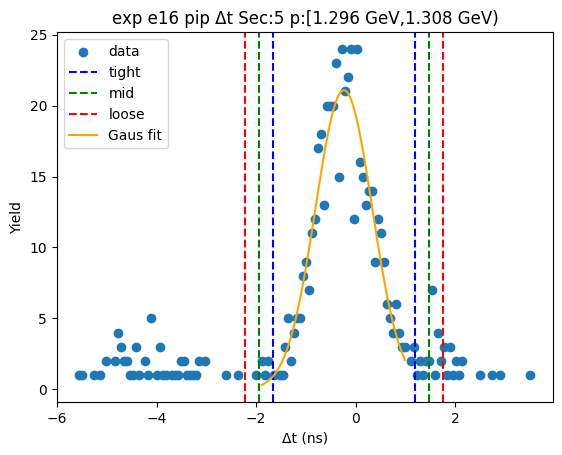

-1.8852515965346184 1.3620053823528169
-2.2099772944233615 1.6867310802415603
-2.534702992312105 2.0114567781303037
[17.7480479  -0.26162311  0.6494514 ]


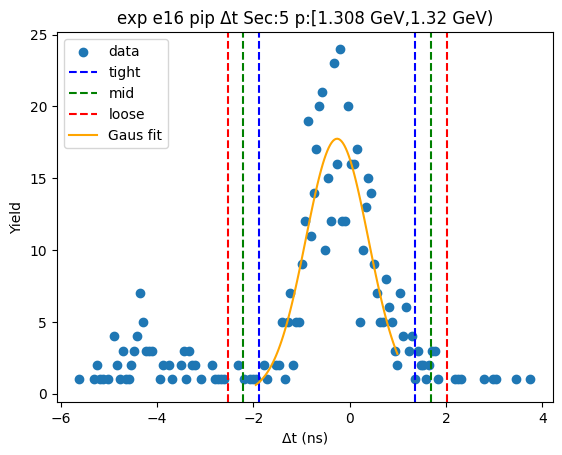

-1.7259242026656785 1.1004487005209036
-2.0085614929843367 1.3830859908395614
-2.291198783302995 1.6657232811582197
[19.47486518 -0.31273775  0.56527458]


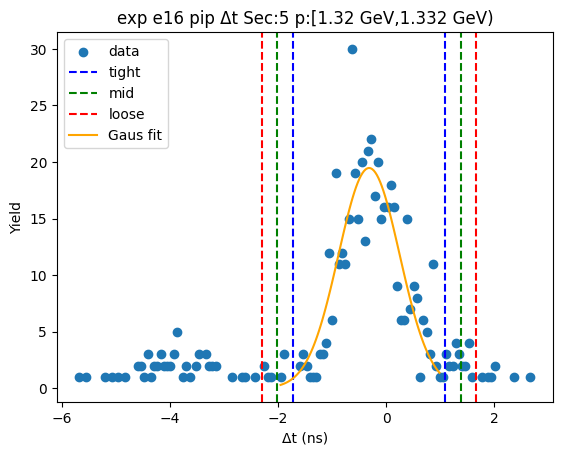

-1.8386607478504606 1.2524999283528802
-2.147776815470795 1.561615995973214
-2.4568928830911285 1.870732063593548
[18.88334222 -0.29308041  0.61823214]


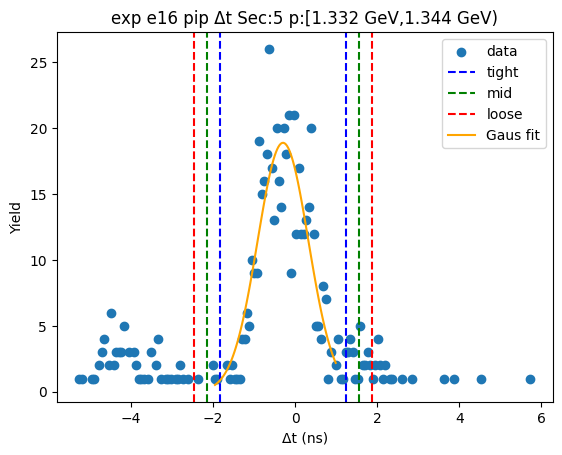

-1.8905303185968045 1.4550632723105301
-2.225089677687538 1.7896226314012638
-2.5596490367782714 2.124181990491997
[17.96264954 -0.21773352  0.66911872]


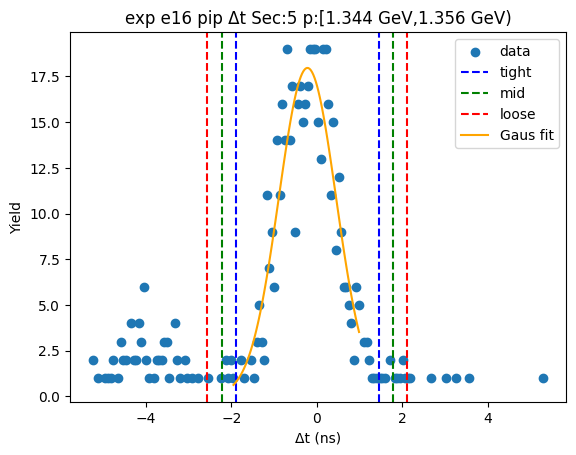

-1.88580896549937 1.2621888160276085
-2.200608743652068 1.5769885941803061
-2.5154085218047655 1.8917883723330042
[17.04537767 -0.31181007  0.62959956]


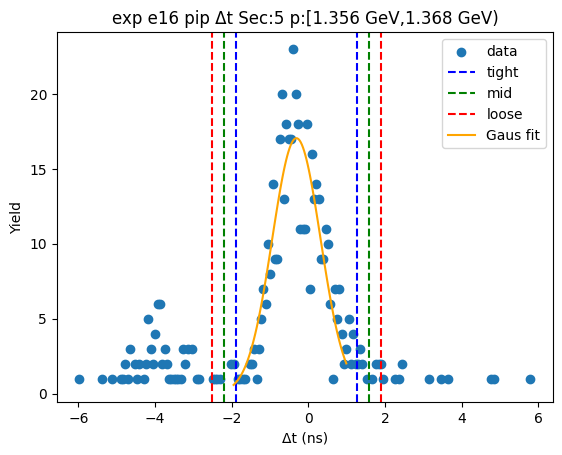

-1.8562094522676253 1.2872367685185155
-2.1705540743462395 1.6015813905971292
-2.4848986964248536 1.9159260126757434
[17.77972884 -0.28448634  0.62868924]


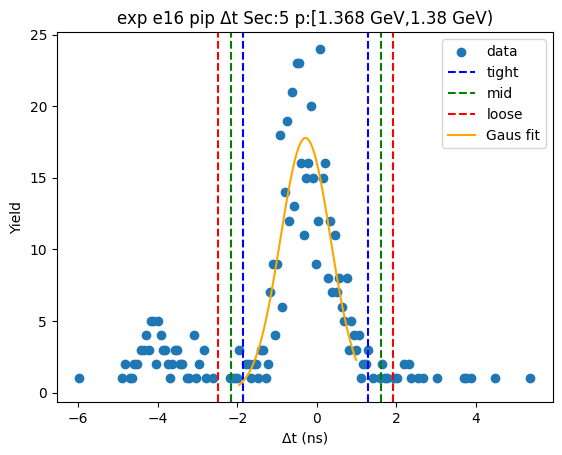

-1.9268248280580722 1.363453971621254
-2.2558527080260045 1.6924818515891866
-2.584880587993937 2.021509731557119
[17.09562279 -0.28168543  0.65805576]


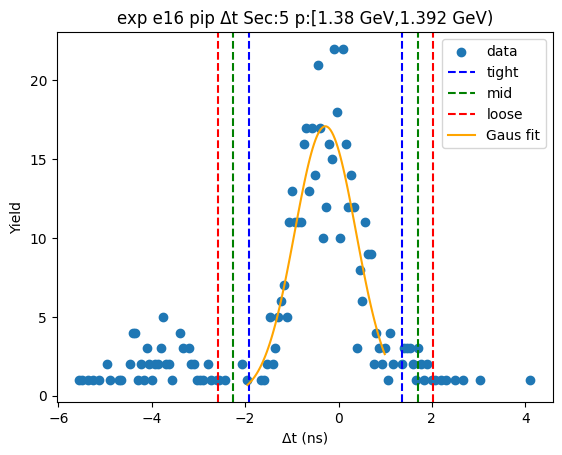

-1.8781545176035157 1.2118527566201716
-2.1871552450258847 1.5208534840425403
-2.4961559724482534 1.829854211464909
[16.76292347 -0.33315088  0.61800145]


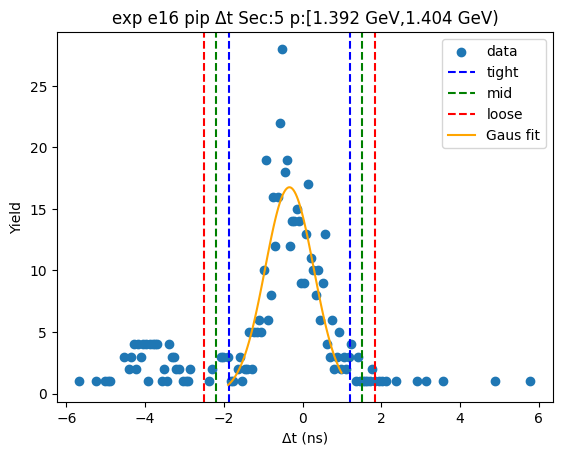

-1.9255800321586527 1.2007102004603856
-2.238209055420557 1.5133392237222894
-2.5508380786824607 1.8259682469841931
[15.68973606 -0.36243492  0.62525805]


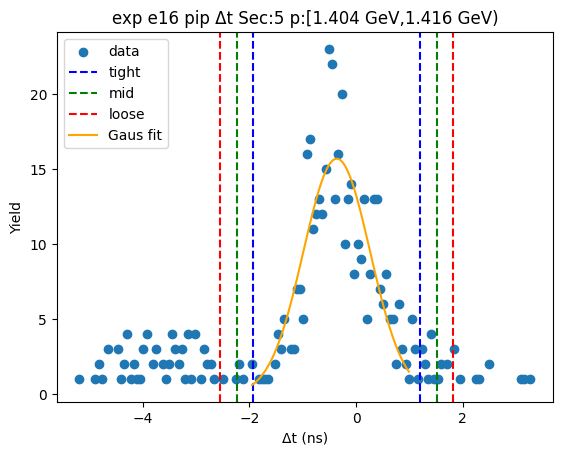

-1.8462723242478924 1.3483854189680242
-2.1657380985694843 1.667851193289616
-2.4852038728910757 1.9873169676112075
[15.30121373 -0.24894345  0.63893155]


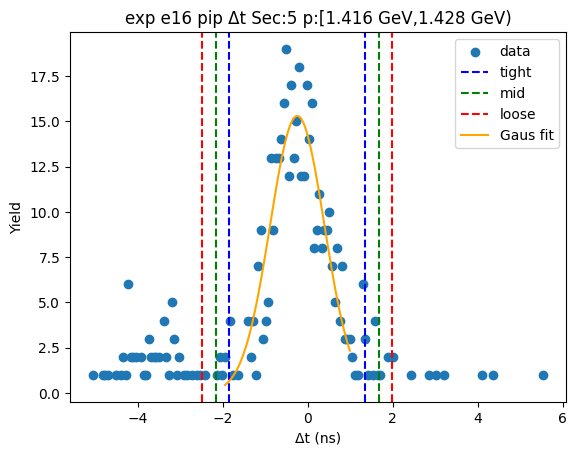

-1.8833409070623066 1.2892726255092972
-2.200602260319467 1.6065339787664574
-2.5178636135766275 1.923795332023618
[14.34341934 -0.29703414  0.63452271]


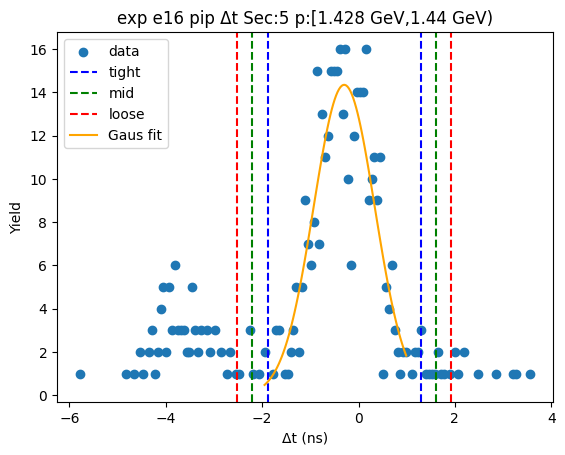

-2.1208249717800833 1.3633265575695088
-2.4692401247150424 1.7117417105044679
-2.817655277650002 2.0601568634394276
[13.26912772 -0.37874921  0.69683031]


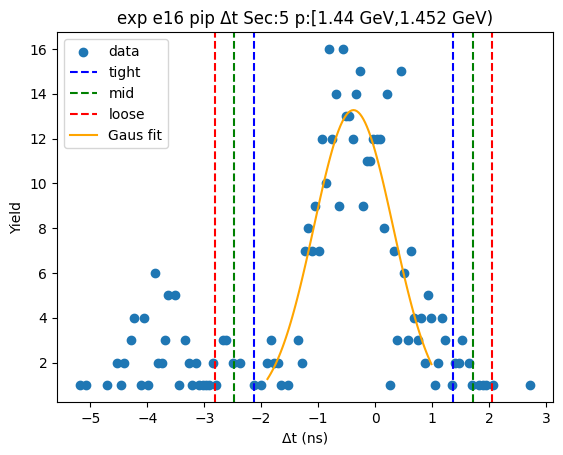

-1.9073118291377522 1.2635485621742175
-2.2243978682689494 1.5806346013054147
-2.541483907400146 1.8977206404366114
[12.76298271 -0.32188163  0.63417208]


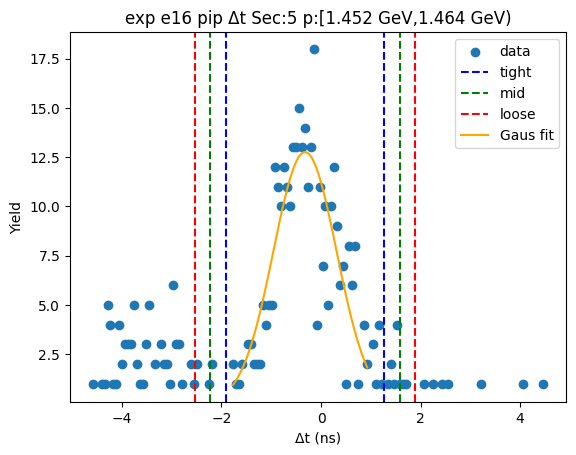

-1.8370277593397528 1.1456691991782741
-2.135297455191555 1.4439388950300769
-2.433567151043358 1.7422085908818796
[14.54538533 -0.34567928  0.59653939]


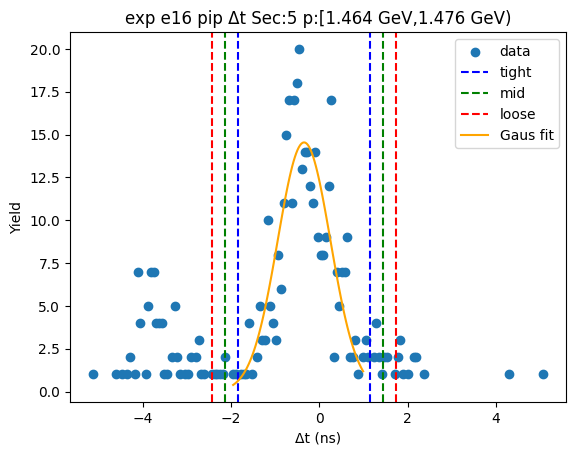

-2.0260306427916293 1.2923427232438396
-2.357867979395176 1.6241800598473866
-2.6897053159987228 1.956017396450933
[15.26801597 -0.36684396  0.66367467]


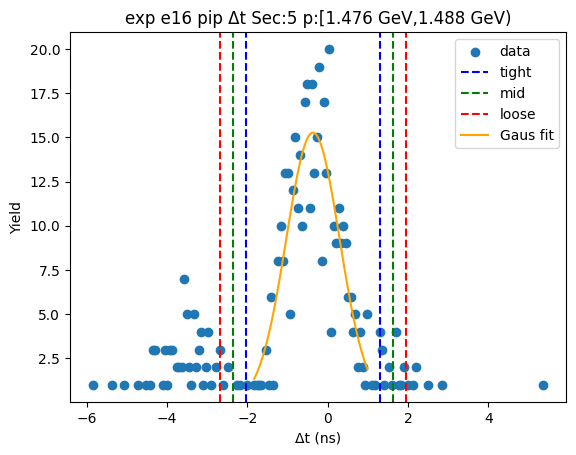

-2.119096443196924 1.3474306091377843
-2.4657491484303944 1.6940833143712548
-2.8124018536638653 2.0407360196047257
[12.31535304 -0.38583292  0.69330541]


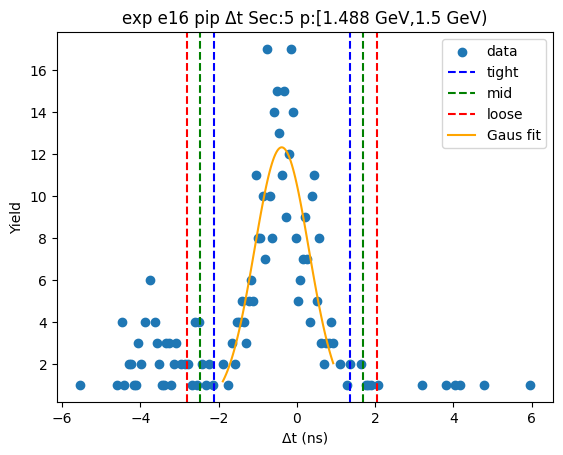

-2.062591834190228 1.3745055701105655
-2.4063015746203074 1.718215310540645
-2.7500113150503864 2.061925050970724
[12.8868631  -0.34404313  0.68741948]


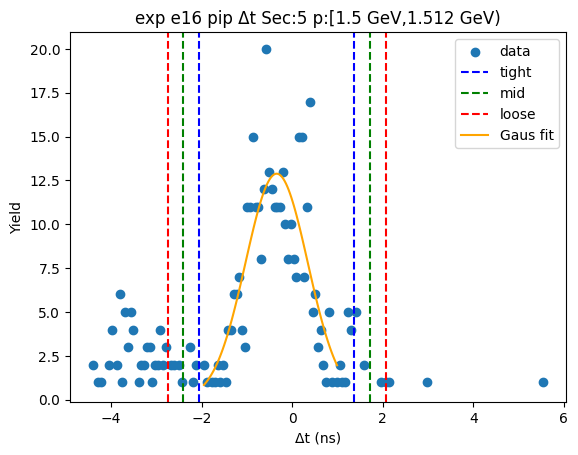

-2.001271300860603 1.332710946477609
-2.3346695255944248 1.6661091712114304
-2.668067750328246 1.9995073959452516
[13.03671249 -0.33428018  0.66679645]


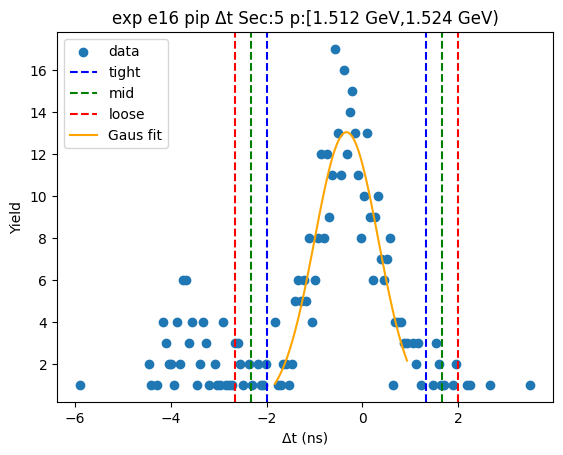

-2.0524081783924366 1.5108963803363158
-2.408738634265312 1.867226836209191
-2.765069090138187 2.2235572920820665
[11.97270332 -0.2707559   0.71266091]


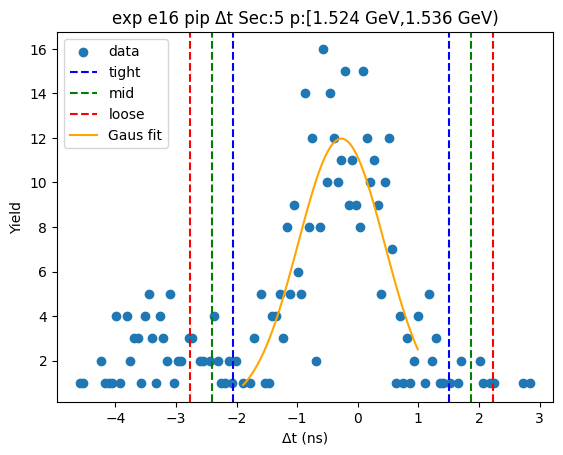

-2.166120447114273 1.271967739248387
-2.509929265750539 1.615776557884653
-2.853738084386805 1.959585376520919
[12.43358976 -0.44707635  0.68761764]


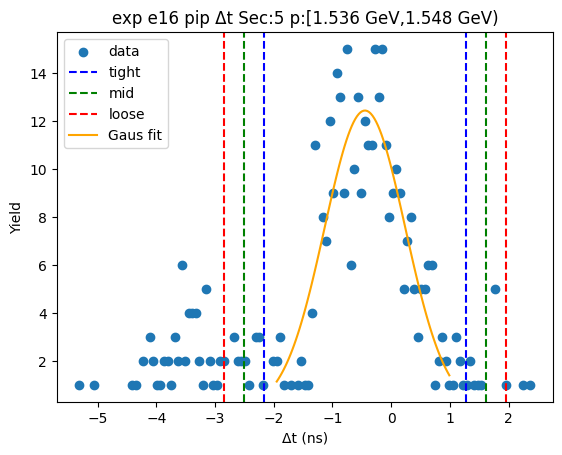

-2.254135597572678 1.3666778836826168
-2.6162169456982074 1.7287592318081464
-2.9782982938237366 2.0908405799336753
[11.39160044 -0.44372886  0.7241627 ]


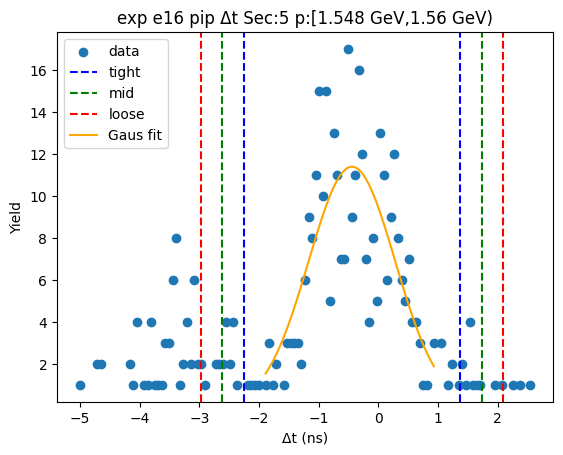

-2.2497937544038593 1.5099819162907189
-2.6257713214733167 1.8859594833601765
-3.0017488885427746 2.2619370504296343
[11.28328057 -0.36990592  0.75195513]


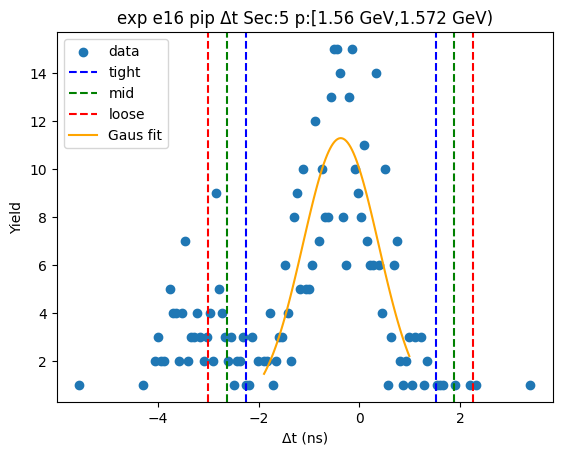

-1.988619301287359 1.1850080839919745
-2.305982039815292 1.5023708225199077
-2.6233447783432258 1.8197335610478413
[11.86481672 -0.40180561  0.63472548]


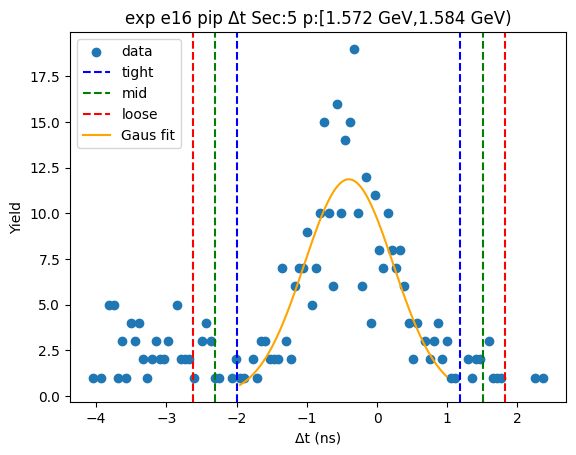

-1.8464074154370547 1.2991329602066277
-2.1609614530014225 1.613686997770996
-2.475515490565791 1.9282410353353643
[12.99323238 -0.27363723  0.62910808]


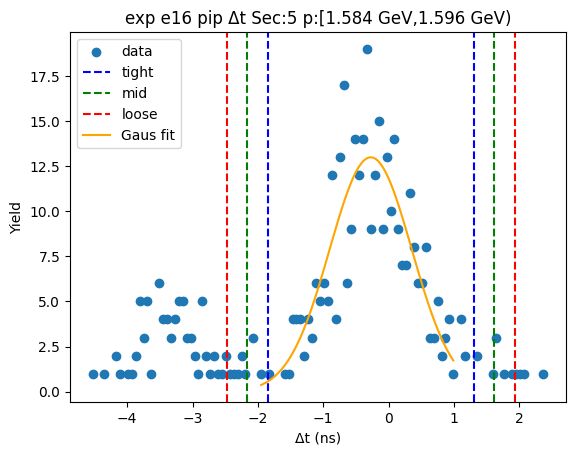

-2.3043071799207153 1.6430917810002699
-2.699047076012814 2.0378316770923686
-3.0937869721049123 2.432571573184467
[ 9.66034844 -0.3306077   0.78947979]


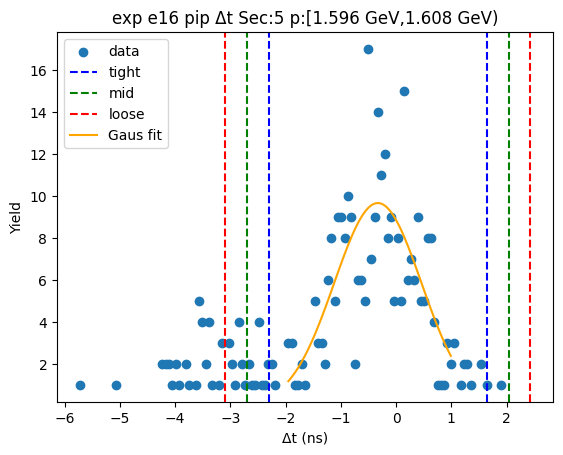

-2.2526451447374822 1.3815821321799229
-2.6160678724292223 1.7450048598716634
-2.979490600120963 2.108427587563404
[ 9.76041855 -0.43553151  0.72684546]


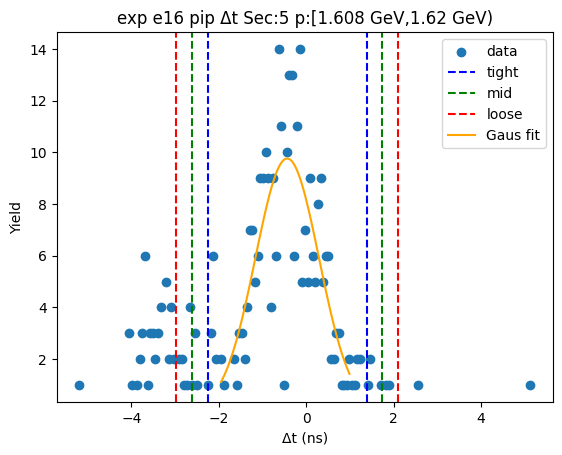

-2.1081021159964193 1.4646463109615437
-2.4653769586922154 1.8219211536573399
-2.822651801388012 2.1791959963531364
[10.90212821 -0.3217279   0.71454969]


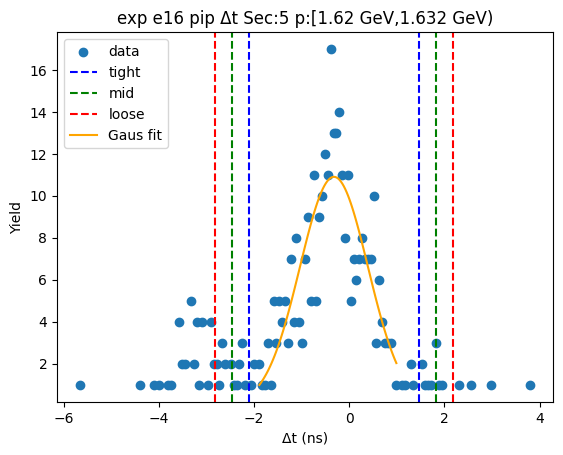

-2.220855673380285 1.4721104281783273
-2.5901522835361463 1.8414070383341885
-2.9594488936920076 2.2107036484900497
[10.14989029 -0.37437262  0.73859322]


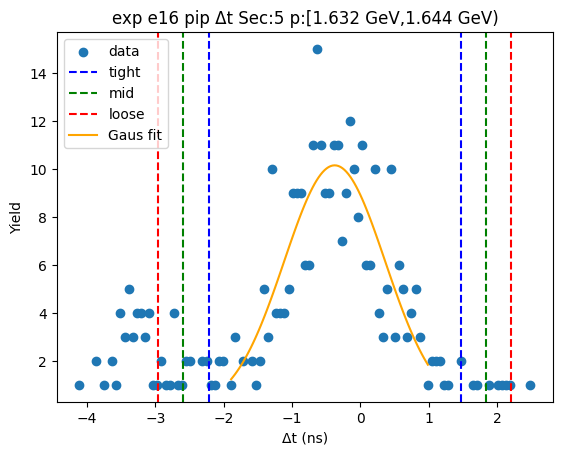

-2.356933677129437 1.4599383176976388
-2.738620876612145 1.8416255171803466
-3.1203080760948527 2.223312716663054
[ 9.98012556 -0.44849768  0.7633744 ]


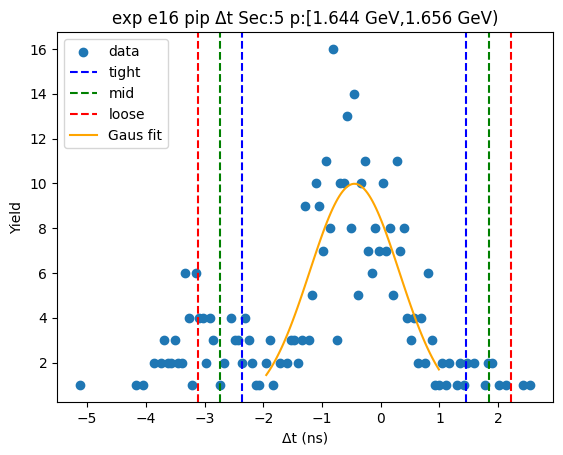

-2.1839666458537166 1.377984764418691
-2.540161786880957 1.7341799054459317
-2.896356927908198 2.0903750464731727
[10.38201875 -0.40299094  0.71239028]


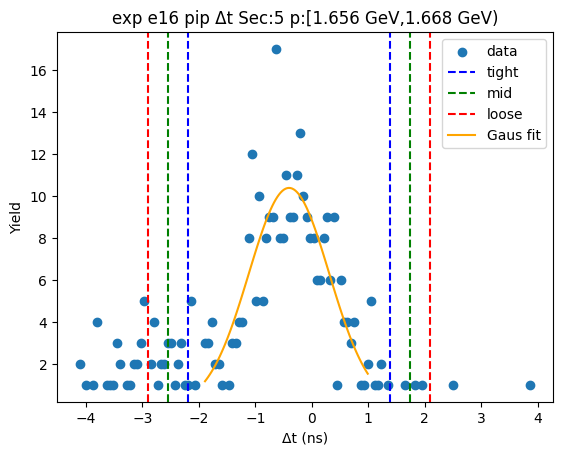

-2.297899064805146 1.5849196149130194
-2.6861809327769626 1.9732014828848357
-3.0744628007487793 2.3614833508566524
[ 8.65705392 -0.35648972  0.77656374]


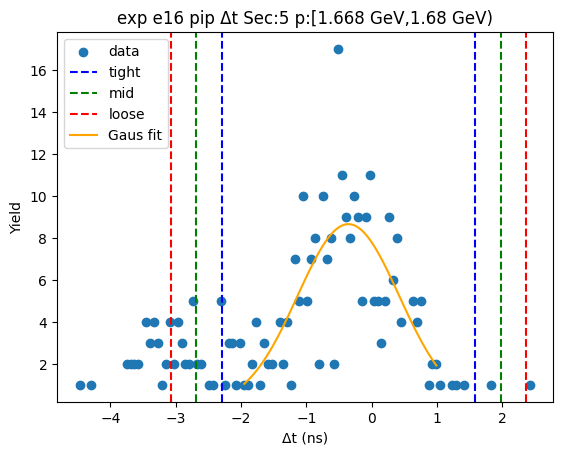

-2.0685055324388646 1.5112381897026763
-2.4264799046530183 1.86921256191683
-2.7844542768671725 2.2271869341309842
[ 9.29538326 -0.27863367  0.71594874]


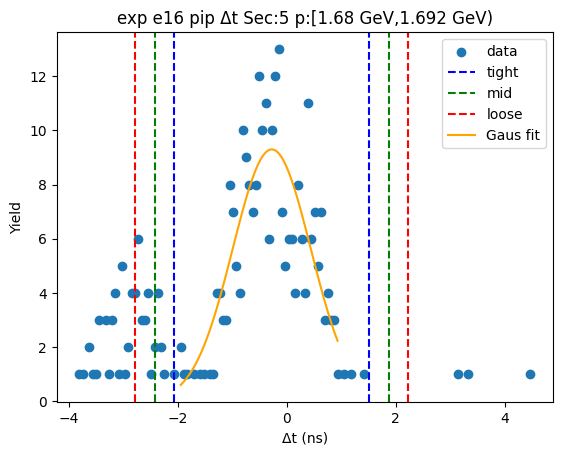

-2.2393628097098413 1.478192984514311
-2.6111183891322565 1.8499485639367261
-2.9828739685546717 2.2217041433591413
[ 8.44227802 -0.38058491  0.74351116]


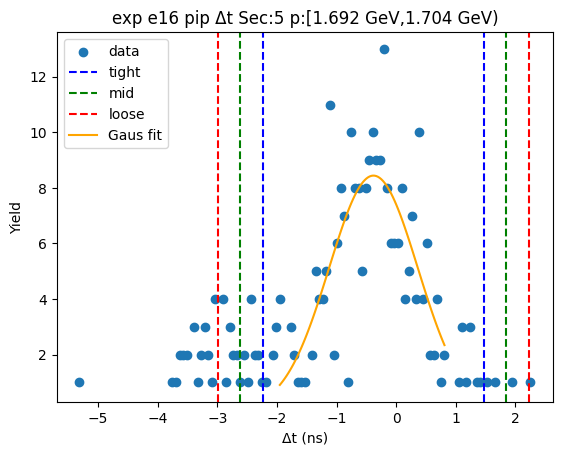

-2.235905862998815 1.356008888006811
-2.595097338099378 1.715200363107374
-2.9542888131999403 2.0743918382079363
[ 9.06373912 -0.43994849  0.71838295]


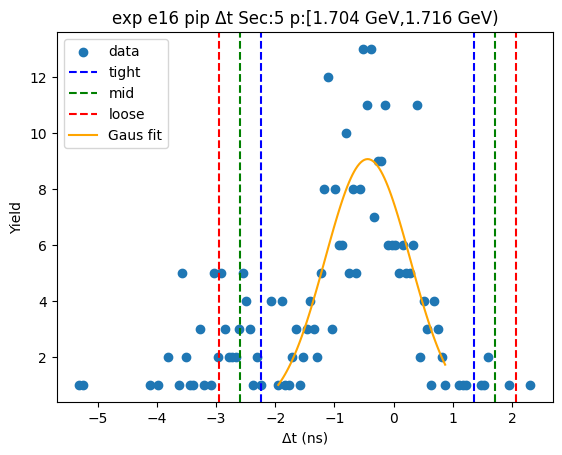

-2.158861756725803 1.390966304824131
-2.5138445628807964 1.7459491109791245
-2.8688273690357895 2.1009319171341176
[ 9.65648475 -0.38394773  0.70996561]


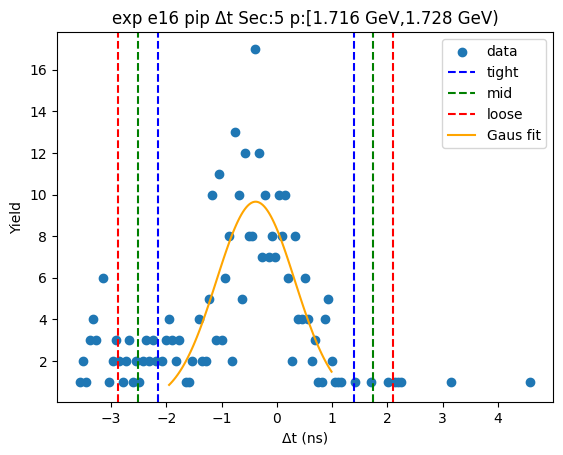

-2.4105058190690607 1.5360716733323545
-2.805163568309202 1.930729422572496
-3.1998213175493437 2.3253871718126375
[ 8.36410823 -0.43721707  0.7893155 ]


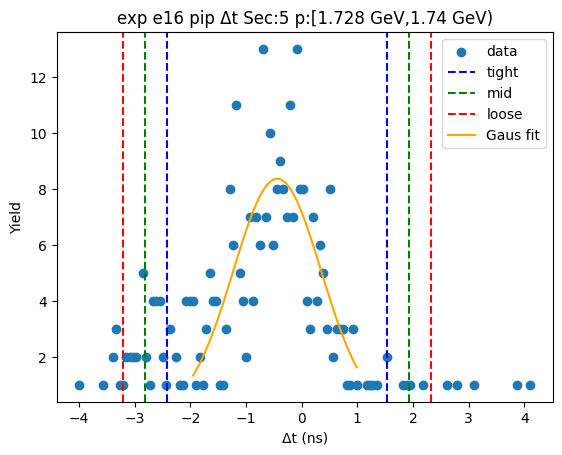

-2.1836307263923795 1.4783732915397814
-2.549831128185595 1.8445736933329973
-2.9160315299788113 2.2107740951262134
[ 8.36685169 -0.35262872  0.7324008 ]


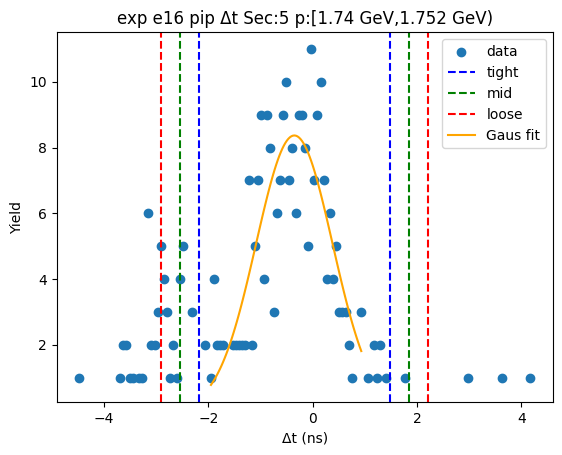

-2.19429458871588 1.4057262797067895
-2.554296675558147 1.7657283665490568
-2.9142987624004144 2.1257304533913235
[ 8.26592144 -0.39428415  0.72000417]


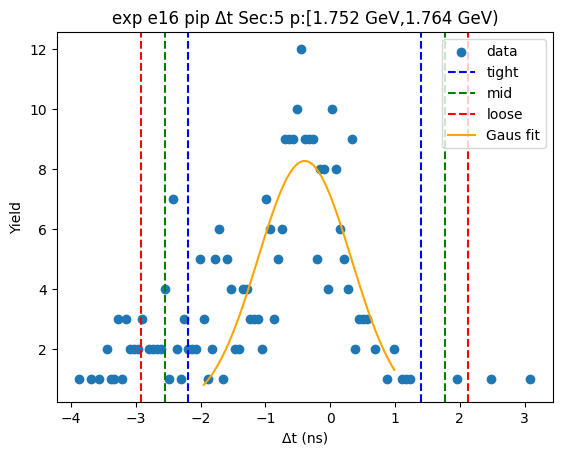

-2.5338869699757764 1.7703244845820776
-2.964308115431562 2.200745630037863
-3.394729260887347 2.6311667754936483
[ 7.49903333 -0.38178124  0.86084229]


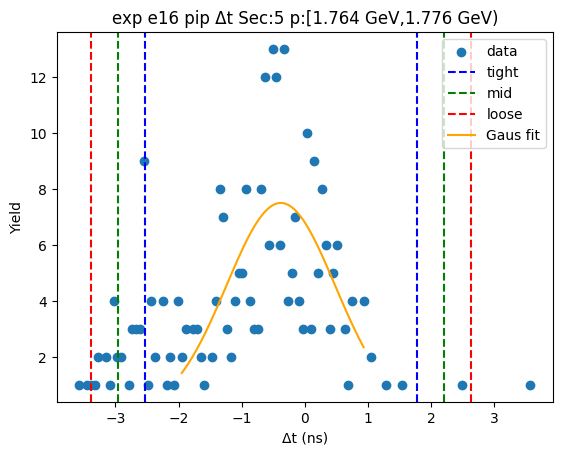

-2.689862520204785 1.696390381969711
-3.1284878104222344 2.1350156721871607
-3.567113100639684 2.5736409624046104
[ 6.81689544 -0.49673607  0.87725058]


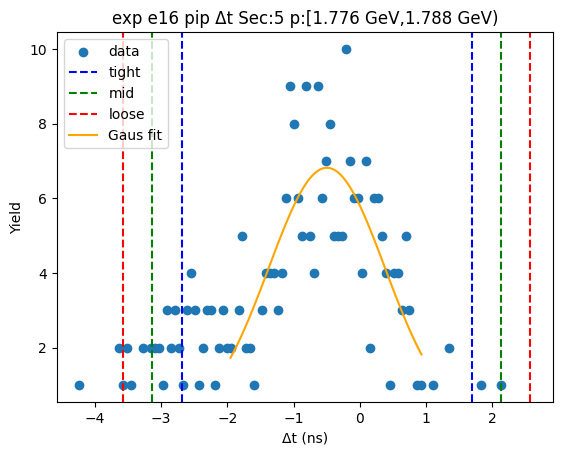

-1.9683887041071046 1.2614636417343421
-2.2913739386912493 1.584448876318487
-2.614359173275394 1.9074341109026316
[ 8.71891639 -0.35346253  0.64597047]


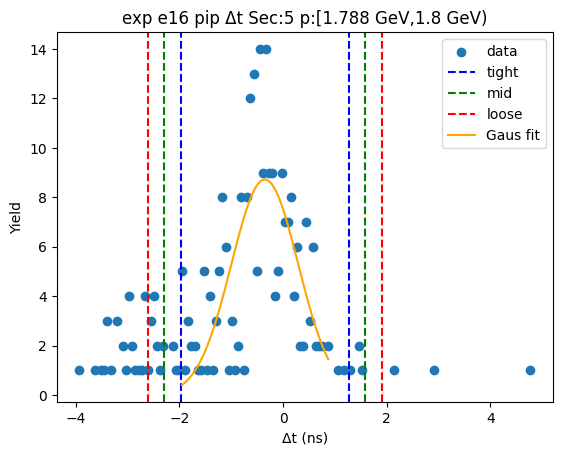

-2.384334575133869 1.4536297749663876
-2.768131010143895 1.8374262099764136
-3.1519274451539205 2.2212226449864394
[ 8.233041   -0.4653524   0.76759287]


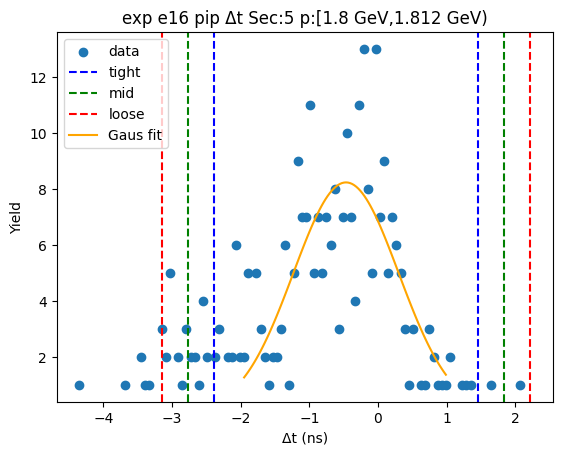

-2.857075638246079 1.7306135005832022
-3.3158445521290076 2.189382414466131
-3.774613466011936 2.6481513283490585
[ 6.27519502 -0.56323107  0.91753783]


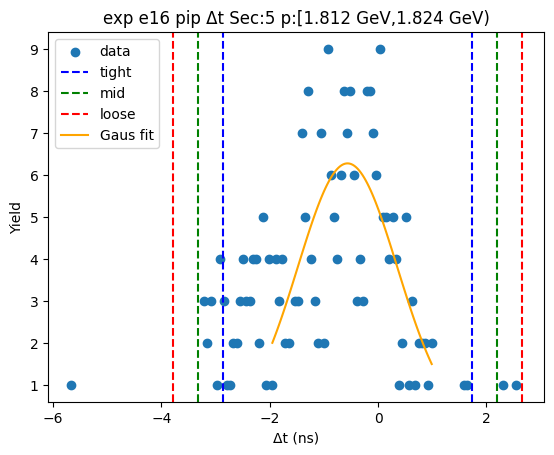

-2.522830293285367 1.3977806174266045
-2.914891384356564 1.7898417084978013
-3.306952475427761 2.1819027995689986
[ 7.05664246 -0.56252484  0.78412218]


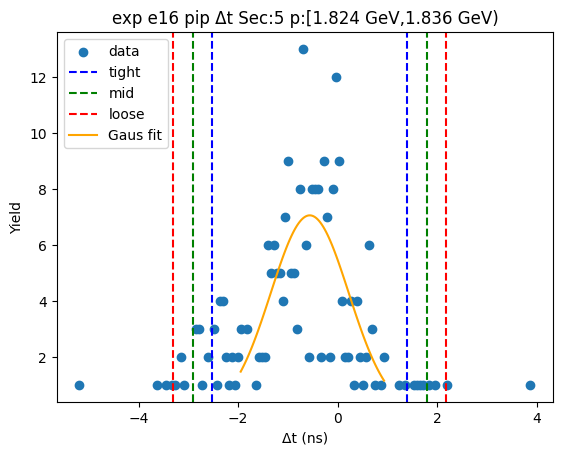

-2.7207268246975826 1.884906151280909
-3.181290122295432 2.3454694488787586
-3.6418534198932813 2.8060327464766077
[ 5.90297996 -0.41791034  0.9211266 ]


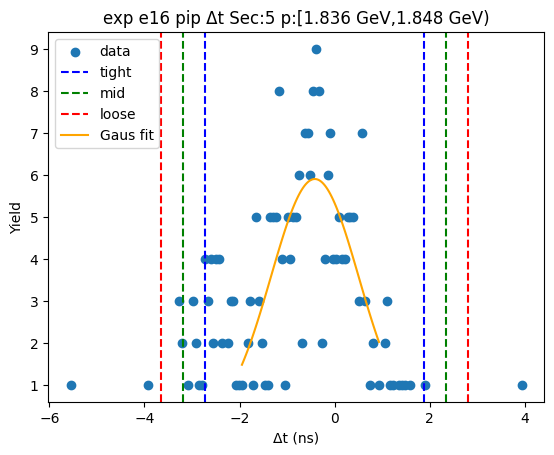

-2.573998678223636 1.86955277730853
-3.0183538237768524 2.3139079228617465
-3.462708969330069 2.7582630684149634
[ 6.87820288 -0.35222295  0.88871029]


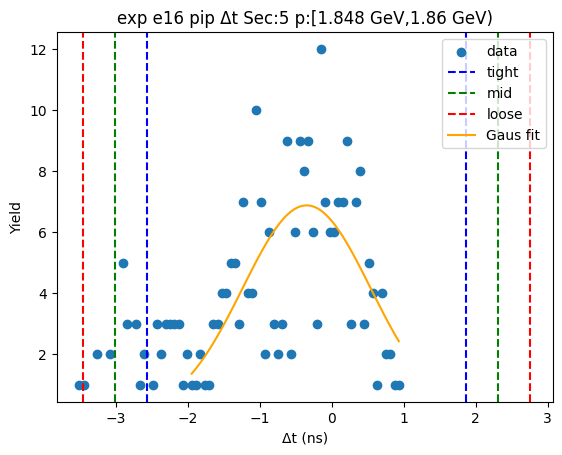

-2.390471579323632 1.5586940602730763
-2.7853881432833028 1.9536106242327476
-3.1803047072429735 2.3485271881924183
[ 6.88465872 -0.41588876  0.78983313]


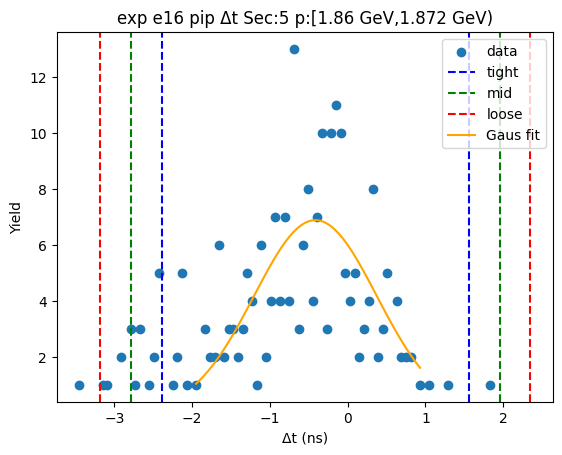

-2.070156955671498 1.2044779608654053
-2.3976204473251883 1.5319414525190957
-2.7250839389788784 1.8594049441727858
[ 7.26944433 -0.4328395   0.65492698]


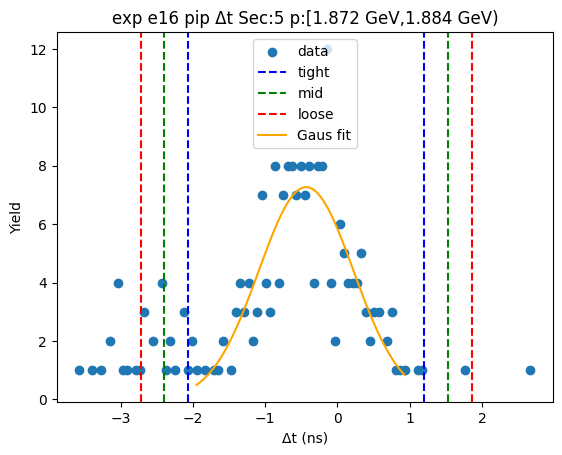

-2.242322893326306 1.3671487710209138
-2.6032700597610283 1.7280959374556362
-2.9642172261957502 2.0890431038903583
[ 6.71087345 -0.43758706  0.72189433]


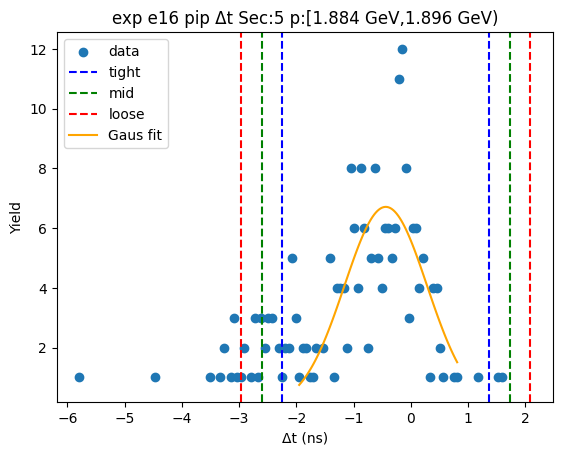

-2.6833392470379023 1.660059909756096
-3.1176791627173017 2.094399825435496
-3.552019078396702 2.5287397411148955
[ 6.06314909 -0.51163967  0.86867983]


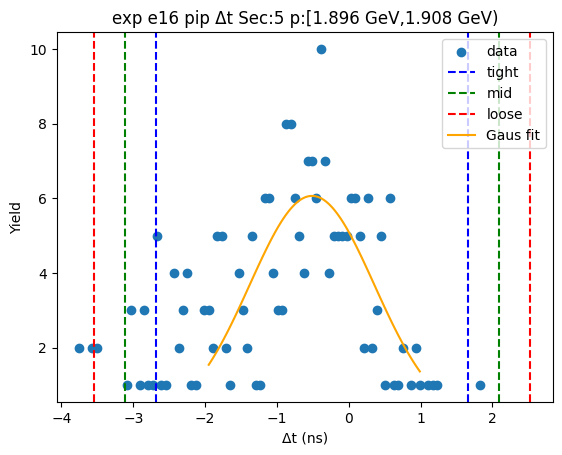

-2.7128836236184912 1.6494198776693456
-3.149113973747275 2.0856502277981295
-3.5853443238760585 2.521880577926913
[ 5.66883824 -0.53173187  0.8724607 ]


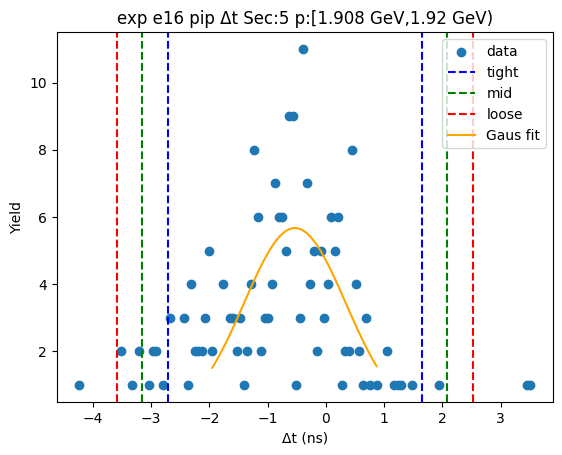

-2.2732688289026126 1.456296058757782
-2.6462253176686517 1.8292525475238213
-3.019181806434691 2.2022090362898608
[ 6.4483011  -0.40848639  0.74591298]


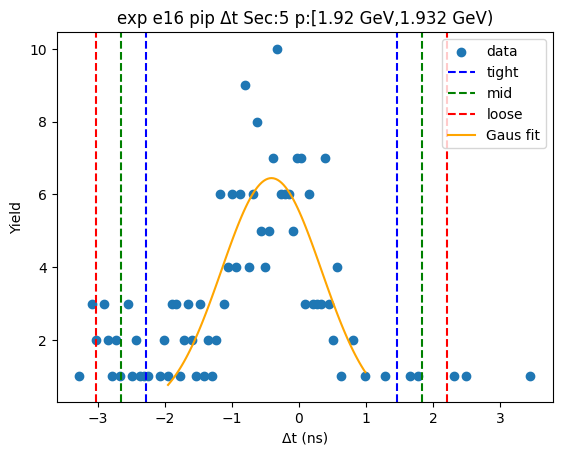

-2.4088038829970726 1.2715245455272912
-2.776836725849509 1.6395573883797274
-3.1448695687019455 2.007590231232164
[ 7.1556522  -0.56863967  0.73606569]


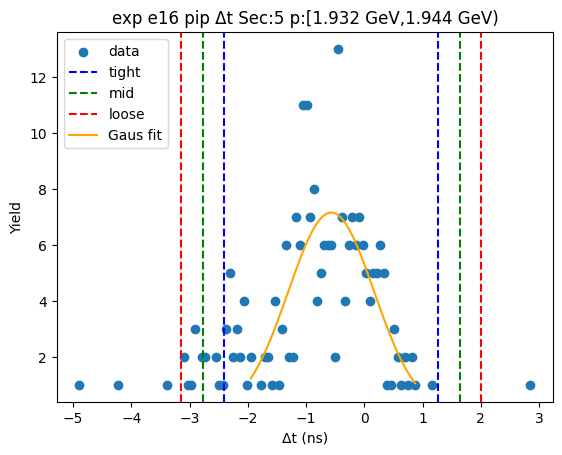

-2.894520377129146 1.9678257714139122
-3.380754991983452 2.454060386268218
-3.8669896068377576 2.9402950011225237
[ 4.92076412 -0.4633473   0.97246923]


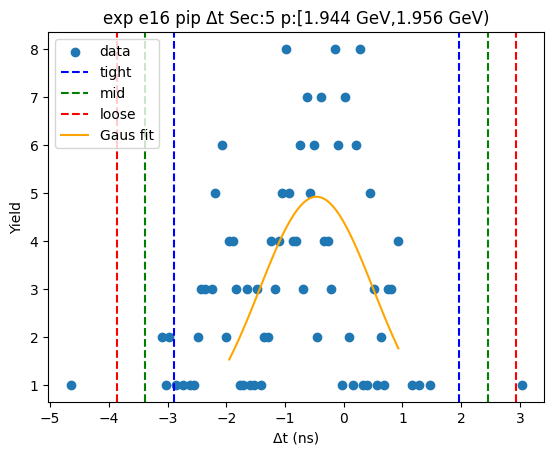

-2.483610013641132 1.3406750611291858
-2.866038521118164 1.7231035686062177
-3.2484670285951953 2.105532076083249
[ 6.48555928 -0.57146748  0.76485701]


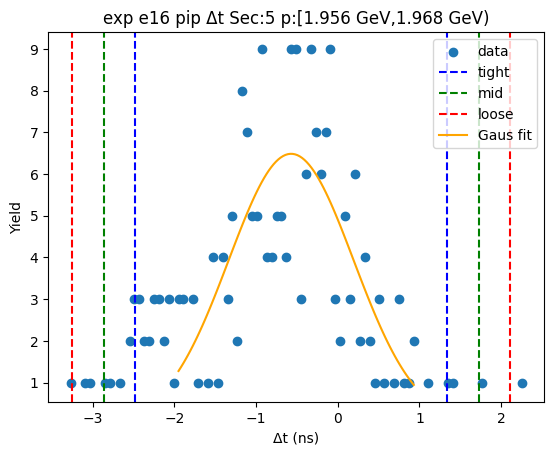

-2.2369171825494614 1.2550410201094415
-2.5861130028153516 1.604236840375332
-2.9353088230812423 1.9534326606412222
[ 6.51395742 -0.49093808  0.69839164]


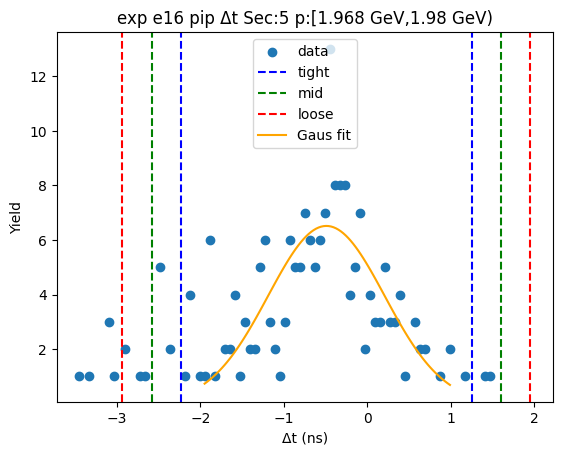

-2.183999917422358 1.506305863354703
-2.5530304955000642 1.8753364414324092
-2.9220610735777703 2.2443670195101153
[ 6.26529247 -0.33884703  0.73806116]


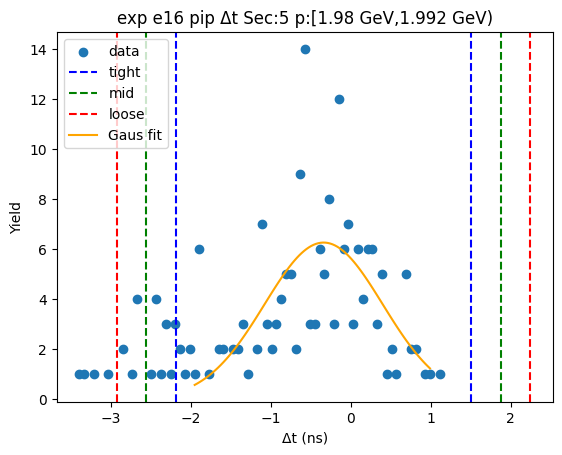

-2.729426711437443 2.030098952778331
-3.20537927785902 2.506051519199908
-3.681331844280597 2.9820040856214853
[ 5.92078127 -0.34966388  0.95190513]


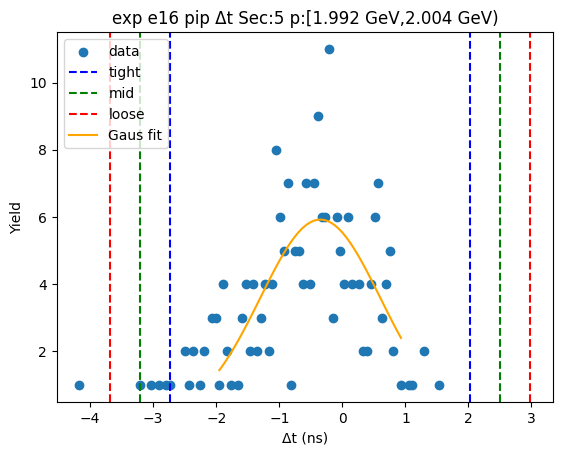

-2.799836617278273 1.862469986094336
-3.266067277615534 2.328700646431597
-3.732297937952795 2.794931306768858
[ 4.83222219 -0.46868332  0.93246132]


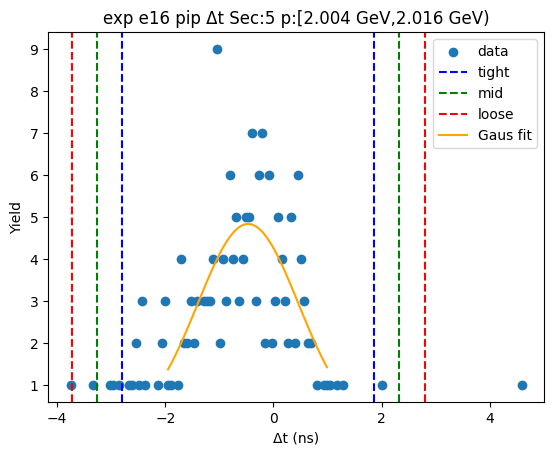

-2.800086716198723 2.249747480651428
-3.3050701358837378 2.754730900336444
-3.8100535555687536 3.259714320021459
[ 4.90258261 -0.27516962  1.00996684]


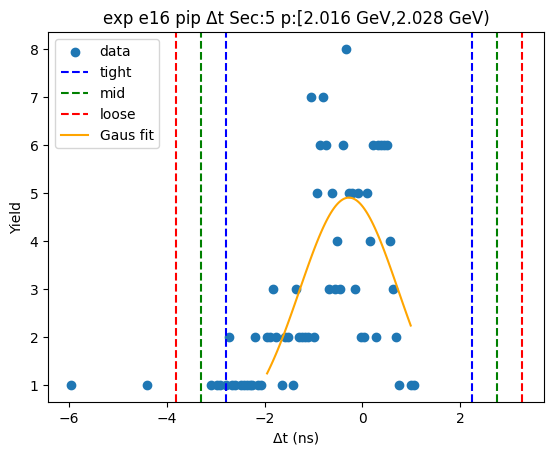

-2.772955705589527 2.070056762944117
-3.2572569524428916 2.5543580097974816
-3.7415581992962554 3.0386592566508464
[ 5.01198495 -0.35144947  0.96860249]


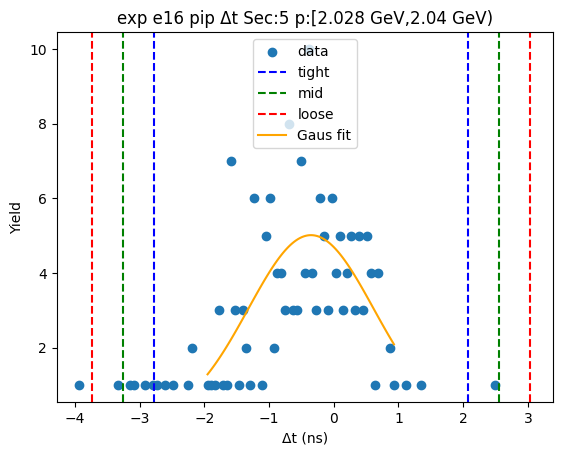

-2.2348416282043537 1.4753133906248859
-2.605857130087278 1.8463288925078098
-2.9768726319702017 2.217344394390734
[ 6.29108209 -0.37976412  0.742031  ]


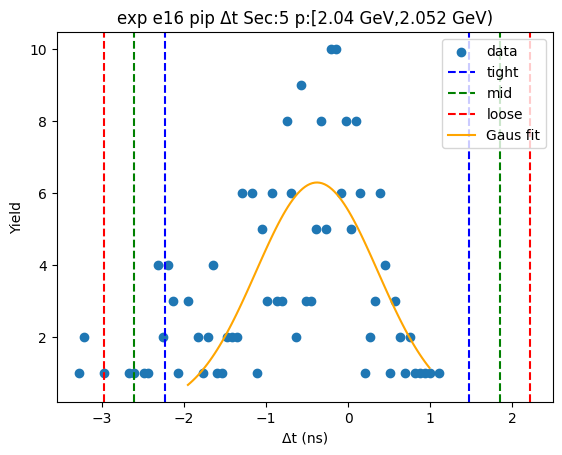

-2.538159512122483 2.1897019174395456
-3.010945655078686 2.6624880603957486
-3.4837317980348885 3.135274203351951
[ 4.96451543 -0.1742288   0.94557229]


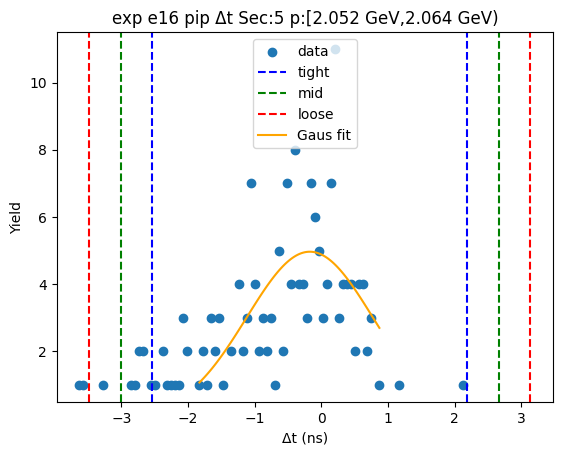

-2.5106458364824964 1.7135398577457275
-2.9330644059053186 2.1359584271685494
-3.355482975328141 2.558376996591372
[ 5.32680928 -0.39855299  0.84483714]


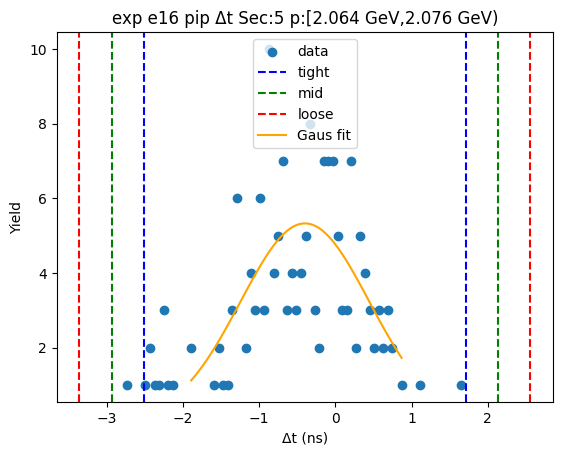

-2.3197572903191896 1.8686715590410938
-2.7386001752552183 2.2875144439771224
-3.157443060191247 2.706357328913151
[ 5.00382986 -0.22554287  0.83768577]


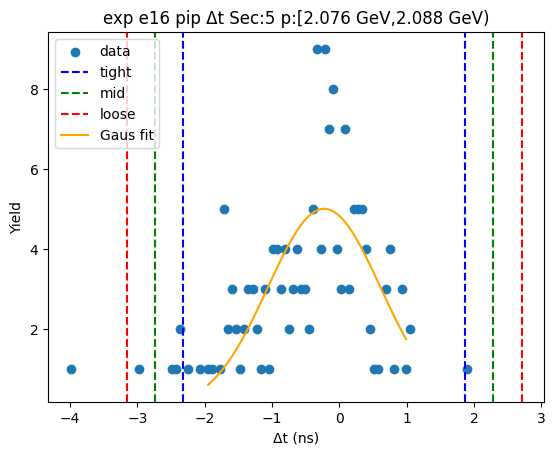

-2.730319280051483 1.9763275123302488
-3.200983959289656 2.446992191568422
-3.6716486385278295 2.9176568708065953
[ 4.80976248 -0.37699588  0.94132936]


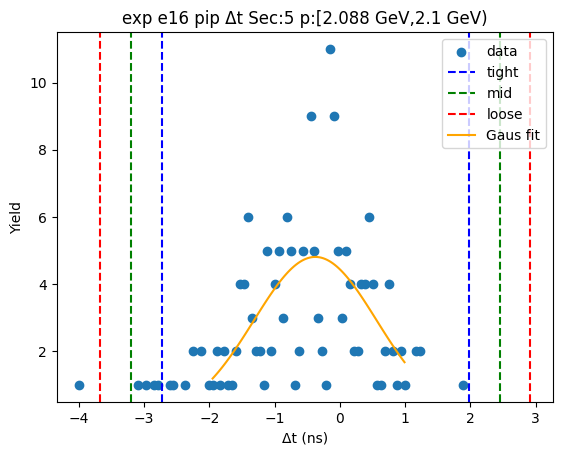

-2.5669657755390607 1.7127558865110457
-2.9949379417440714 2.1407280527160566
-3.422910107949082 2.5687002189210673
[ 4.28821108 -0.42710494  0.85594433]


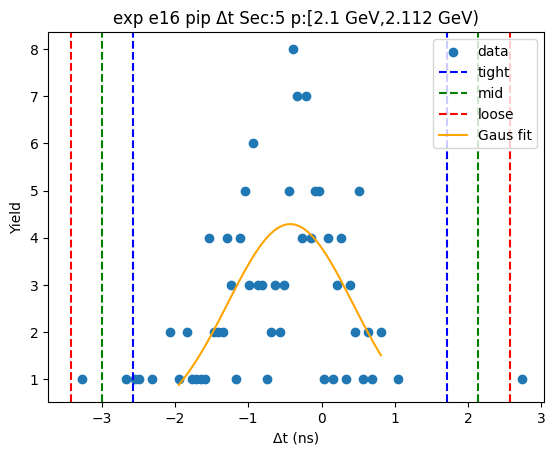

-2.73281598428831 1.673142469527133
-3.173411829669854 2.113738314908677
-3.6140076750513983 2.5543341602902214
[ 5.02941416 -0.52983676  0.88119169]


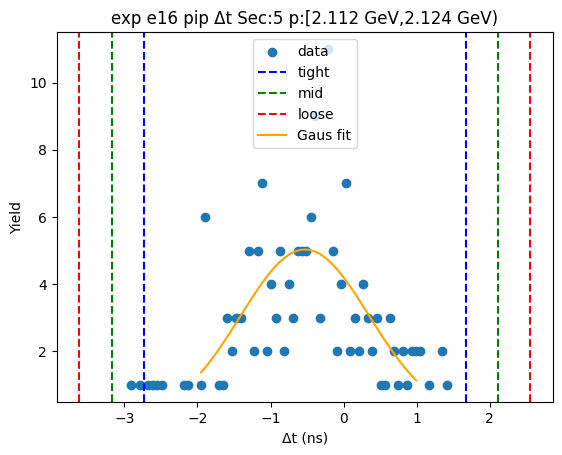

-2.6318239438838233 1.5803242045770567
-3.0530387587299117 2.001539019423145
-3.4742535735759996 2.422753834269233
[ 4.97900552 -0.52574987  0.84242963]


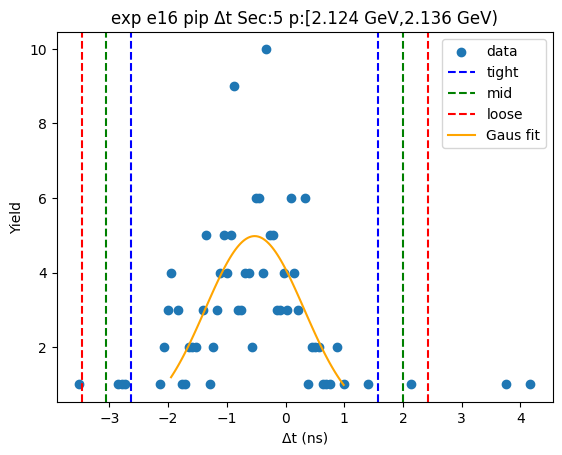

-3.354364692528932 2.631902025505004
-3.952991364332325 3.2305286973083973
-4.551618036135719 3.829155369111791
[ 3.64245905 -0.36123133  1.19725334]


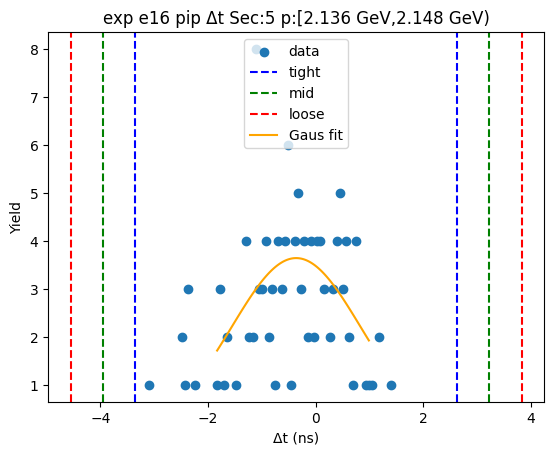

-2.7300438966640055 2.0661867387937543
-3.209666960209782 2.5458098023395306
-3.6892900237555577 3.0254328658853065
[ 3.97417974 -0.33192858  0.95924613]


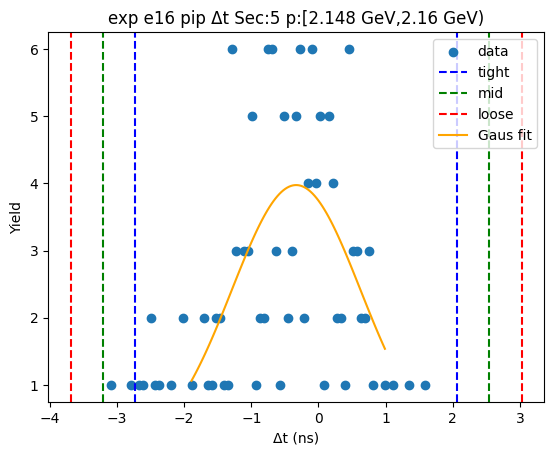

-2.492440954308628 1.770424896942
-2.9187275394336907 2.196711482067063
-3.3450141245587535 2.6229980671921256
[ 4.14883052 -0.36100803  0.85257317]


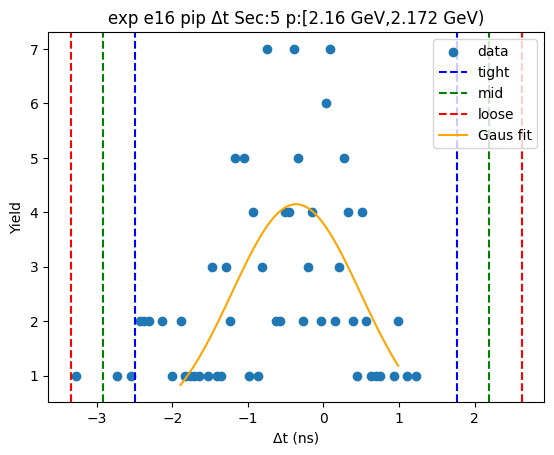

-2.321729906643759 1.5661787578293067
-2.7105207730910656 1.9549696242766135
-3.0993116395383726 2.34376049072392
[ 4.24916043 -0.37777557  0.77758173]


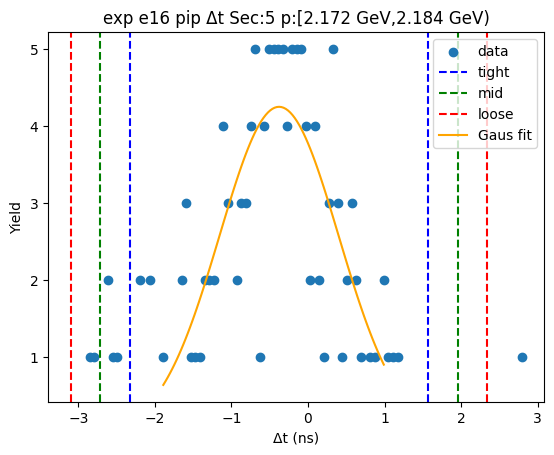

-2.486969058564976 1.9592582761467658
-2.93159179203615 2.40388100961794
-3.3762145255073244 2.8485037430891142
[ 3.83106959 -0.26385539  0.88924547]


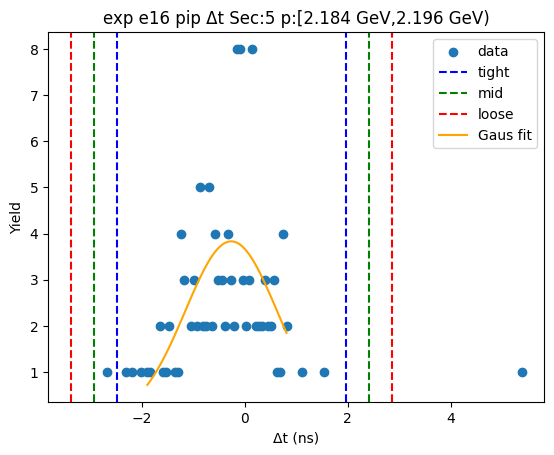

-1.5326728080030199 1.516411214481225
-1.8375812102514442 1.8213196167296493
-2.1424896124998685 2.126228018978074
[ 2.39183956e+01 -8.13079676e-03  6.09816804e-01]


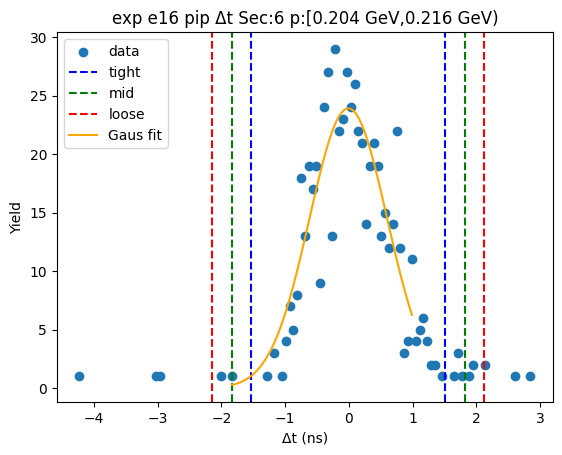

-1.4013460172494028 1.172450384290759
-1.6587256574034188 1.429830024444775
-1.9161052975574349 1.687209664598791
[31.80698226 -0.11444782  0.51475928]


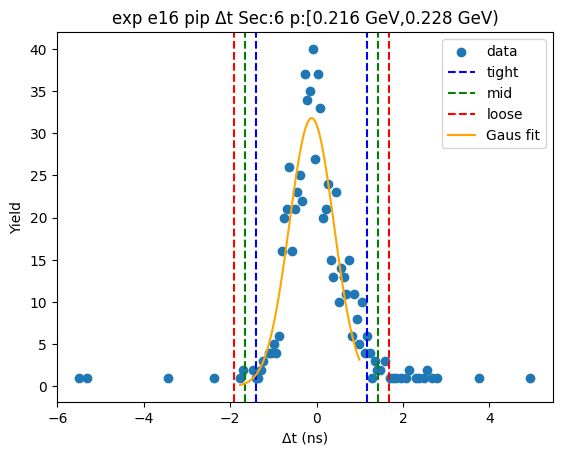

-1.418505233067484 1.2511112154262989
-1.6854668779168622 1.518072860275677
-1.9524285227662406 1.7850345051250553
[35.82220948 -0.08369701  0.53392329]


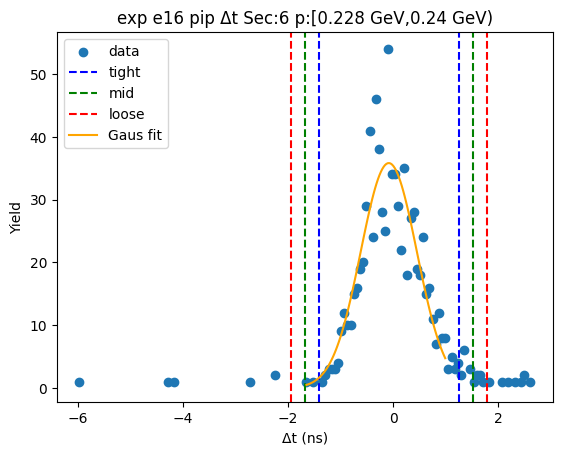

-1.3013563286485277 1.0950832277443538
-1.5410002842878159 1.334727183383642
-1.780644239927104 1.5743711390229302
[43.34847005 -0.10313655  0.47928791]


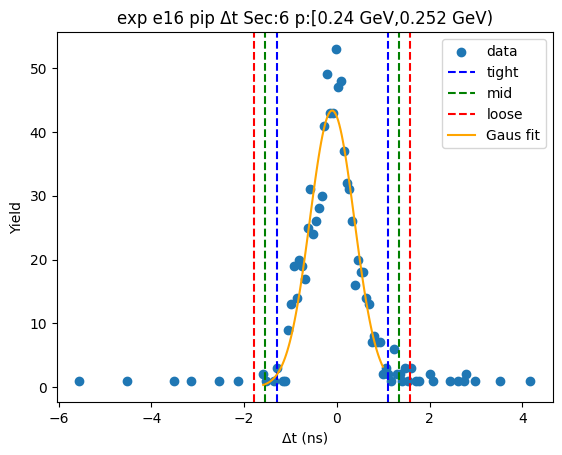

-1.3391029020110878 1.0961235340573519
-1.582625545617932 1.339646177664196
-1.8261481892247757 1.5831688212710398
[50.15887814 -0.12148968  0.48704529]


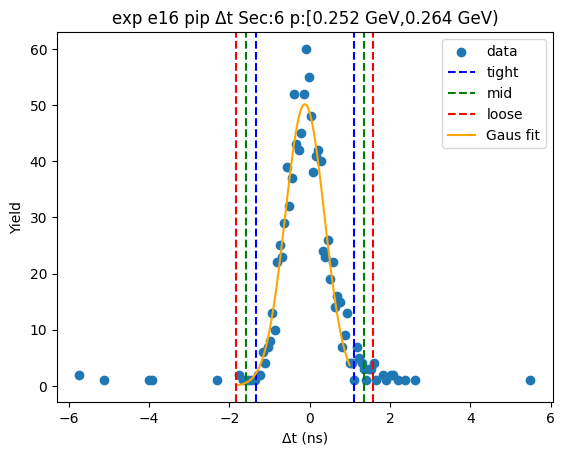

-1.2052959566729162 0.9839436858280676
-1.4242199209230146 1.2028676500781659
-1.643143885173113 1.4217916143282643
[69.76724652 -0.11067614  0.43784793]


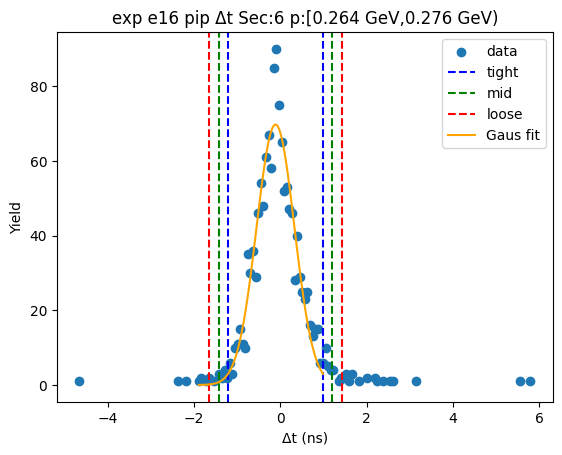

-1.3589165079030854 1.0218099416683437
-1.5969891528602282 1.2598825866254866
-1.835061797817371 1.4979552315826294
[74.11809293 -0.16855328  0.47614529]


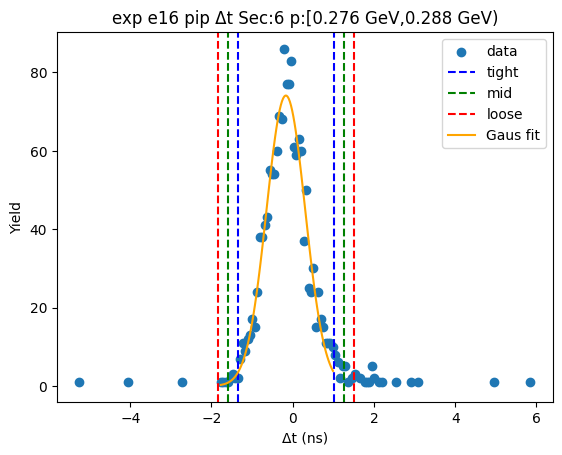

-1.3232819371387126 0.941064110085502
-1.549716541861134 1.1674987148079234
-1.7761511465835556 1.393933319530345
[80.92209302 -0.19110891  0.45286921]


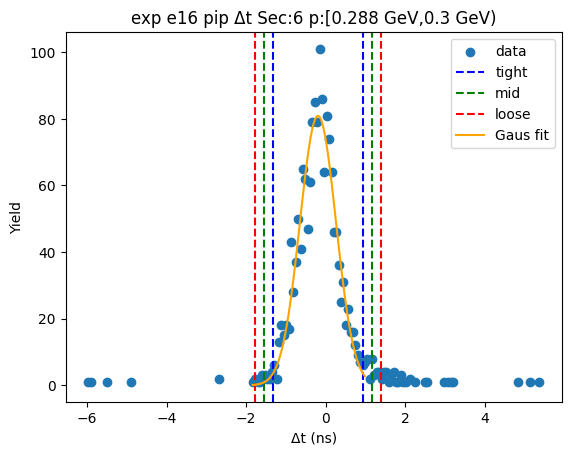

-1.3594980254649736 0.9369539656227975
-1.5891432245737507 1.1665991647315748
-1.8187884236825278 1.3962443638403519
[84.75999595 -0.21127203  0.4592904 ]


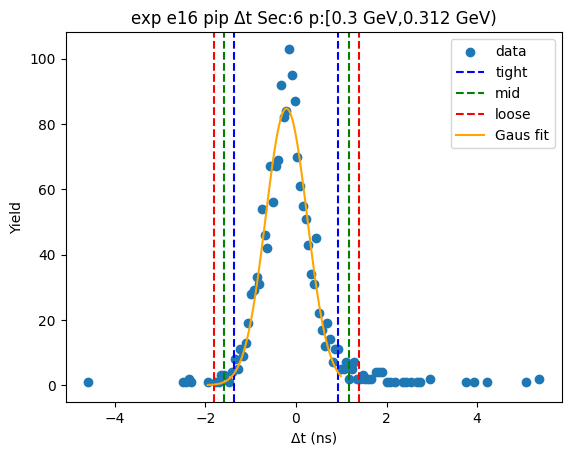

-1.4041648499009012 0.9533698530341652
-1.6399183201944076 1.1891233233276717
-1.8756717904879143 1.4248767936211784
[86.45401669 -0.2253975   0.47150694]


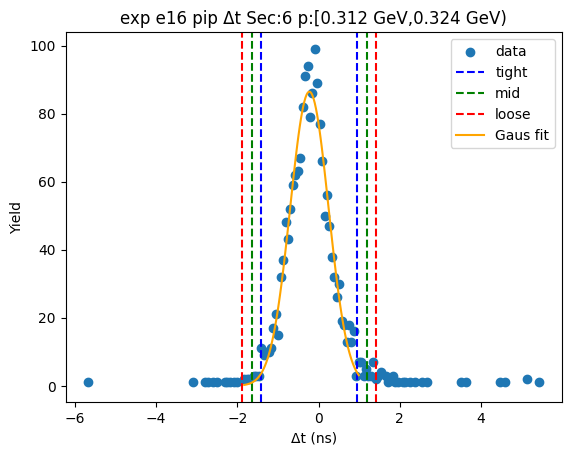

-1.401601918333917 0.9099371417403429
-1.632755824341343 1.141091047747769
-1.863909730348769 1.372244953755195
[91.35869182 -0.24583239  0.46230781]


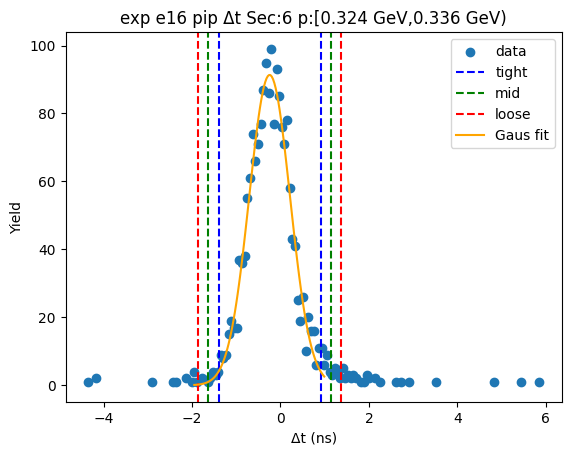

-1.4157295590370833 0.8810556864532282
-1.6454080835861145 1.1107342110022593
-1.8750866081351456 1.3404127355512905
[97.22401983 -0.26733694  0.45935705]


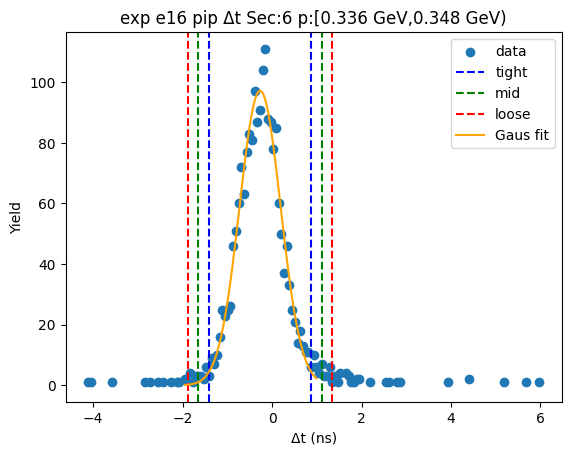

-1.3919823512708216 0.887603228683868
-1.6199409092662904 1.1155617866793368
-1.8478994672617592 1.3435203446748056
[94.97177484 -0.25218956  0.45591712]


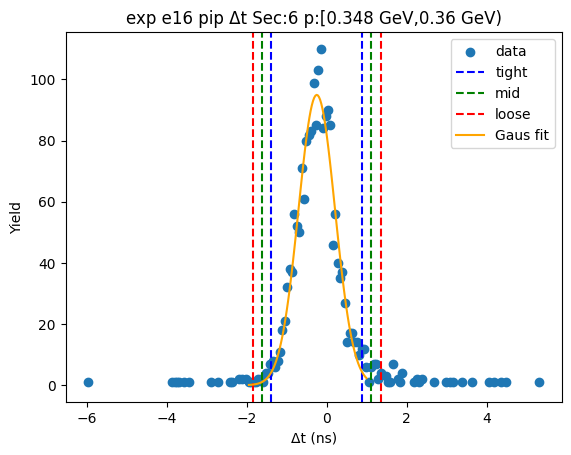

-1.4434666400556848 0.9207238680600467
-1.6798856908672581 1.15714291887162
-1.9163047416788312 1.3935619696831931
[97.30292974 -0.26137139  0.4728381 ]


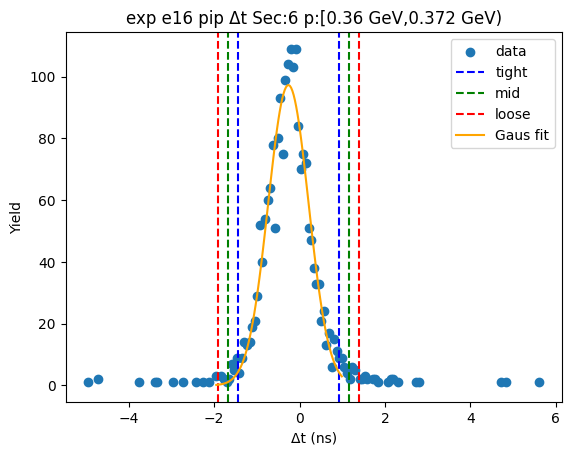

-1.3888749934854443 0.8893299728634577
-1.6166954901203343 1.1171504694983476
-1.8445159867552245 1.3449709661332379
[101.97260789  -0.24977251   0.45564099]


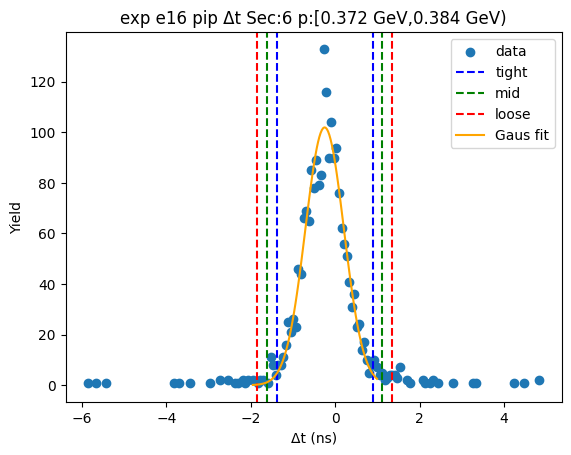

-1.4433660969659425 0.861269454909606
-1.6738296521534972 1.0917330100971607
-1.9042932073410521 1.3221965652847156
[108.99247705  -0.29104832   0.46092711]


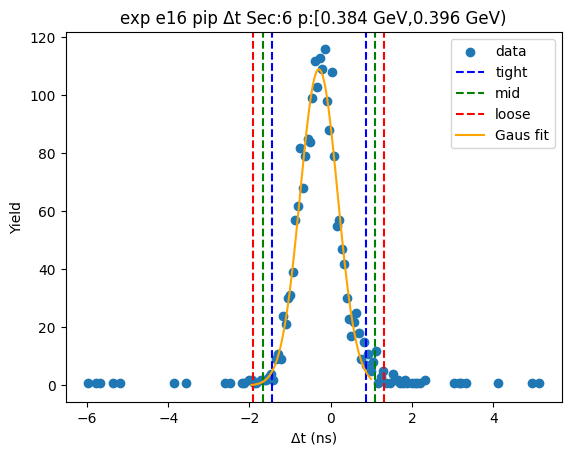

-1.451132376761097 0.8327208680684997
-1.6795177012440567 1.0611061925514593
-1.9079030257270164 1.289491517034419
[109.08813178  -0.30920575   0.45677065]


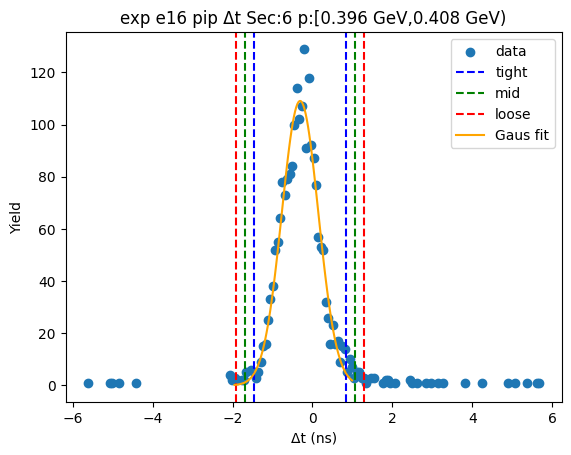

-1.431200836251156 0.8450042646582179
-1.658821346342093 1.072624774749155
-1.8864418564330305 1.3002452848400925
[114.26884797  -0.29309829   0.45524102]


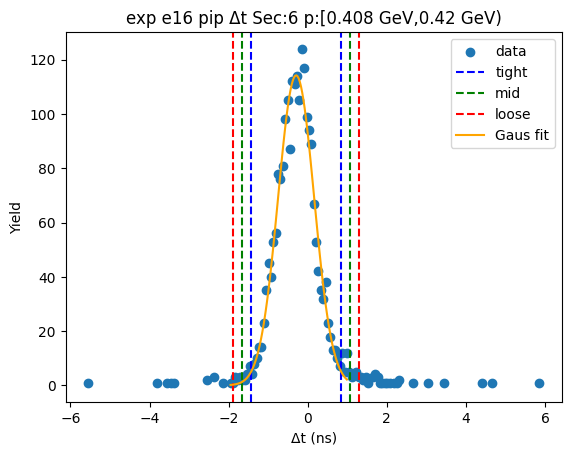

-1.4100927919648236 0.9074883742220541
-1.6418509085835113 1.1392464908407418
-1.873609025202199 1.3710046074594295
[111.492829    -0.25130221   0.46351623]


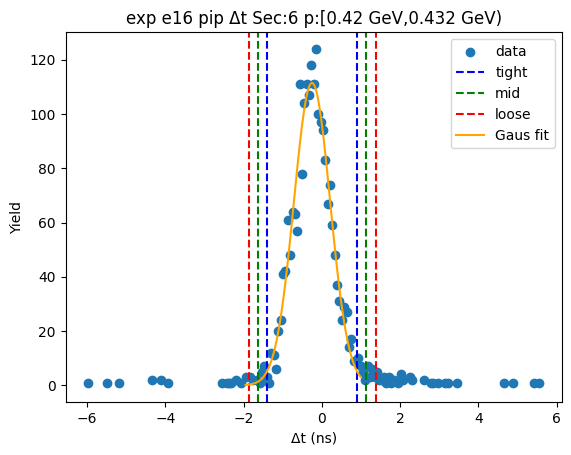

-1.3646771093571308 0.9291390483989366
-1.5940587251327374 1.1585206641745431
-1.8234403409083442 1.38790227995015
[112.83955967  -0.21776903   0.45876323]


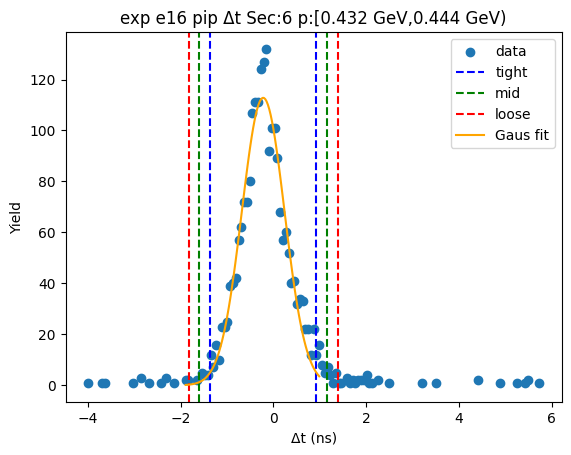

-1.4120093236028999 1.0230624368975536
-1.6555164996529452 1.266569612947599
-1.8990236757029906 1.5100767889976443
[104.59170303  -0.19447344   0.48701435]


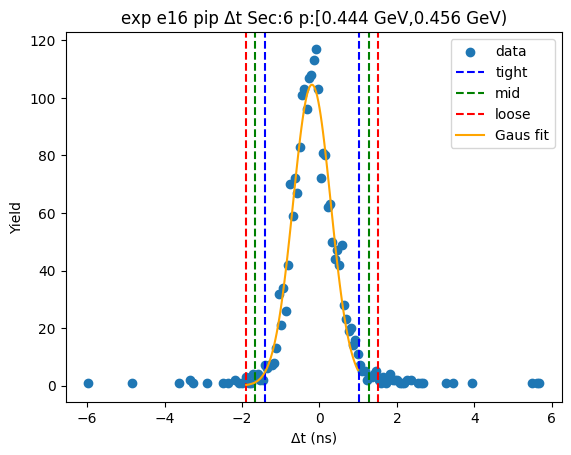

-1.3959664906965064 1.2137252717194966
-1.6569356669381068 1.474694447961097
-1.9179048431797072 1.7356636242026975
[ 1.02664738e+02 -9.11206095e-02  5.21938352e-01]


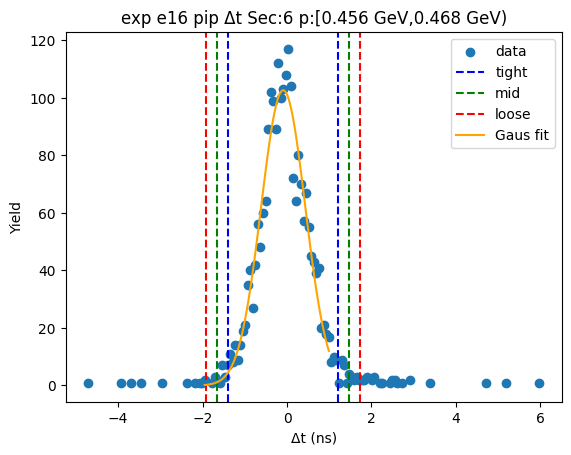

-1.381896414382808 1.2892745873930134
-1.6490135145603904 1.5563916875705956
-1.9161306147379726 1.823508787748178
[ 1.01776597e+02 -4.63109135e-02  5.34234200e-01]


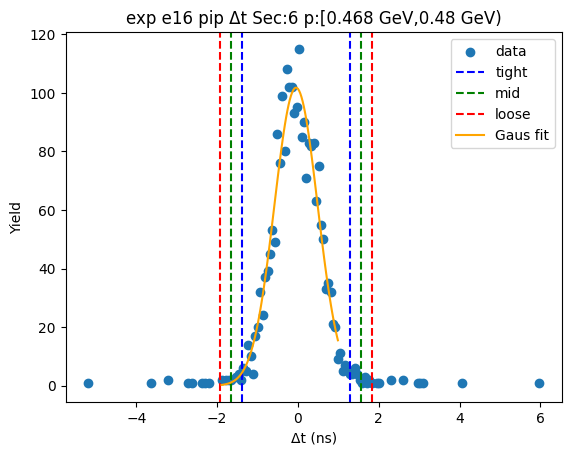

-1.475294902947242 1.317009530257551
-1.7545253462677213 1.5962399735780304
-2.0337557895882004 1.8754704168985097
[ 9.90560993e+01 -7.91426863e-02  5.58460887e-01]


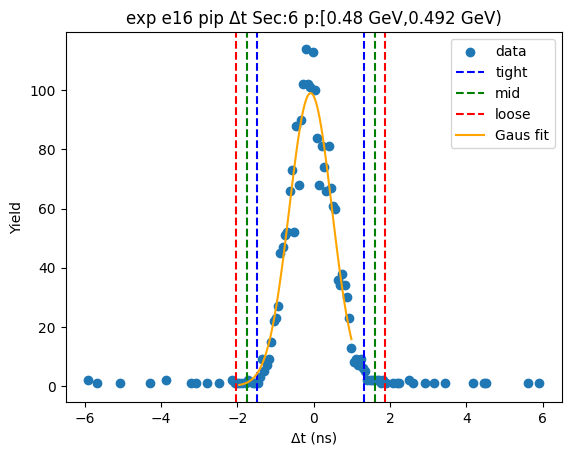

-1.4648600552130664 1.1249453824961253
-1.7238405989839856 1.3839259262670445
-1.9828211427549047 1.6429064700379636
[105.15862889  -0.16995734   0.51796109]


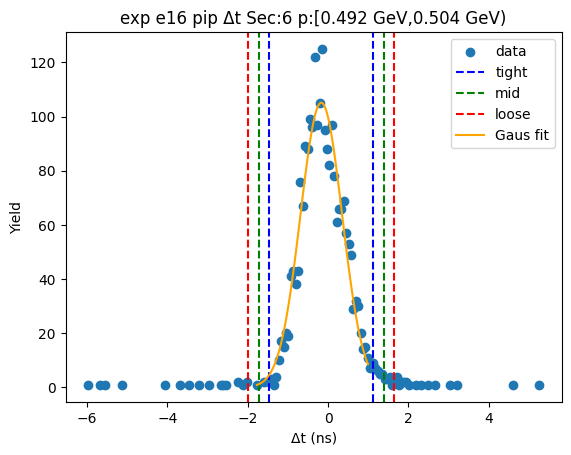

-1.5506944150181856 1.0545127677007575
-1.81121513329008 1.315033485972652
-2.0717358515619746 1.5755542042445463
[101.02827041  -0.24809082   0.52104144]


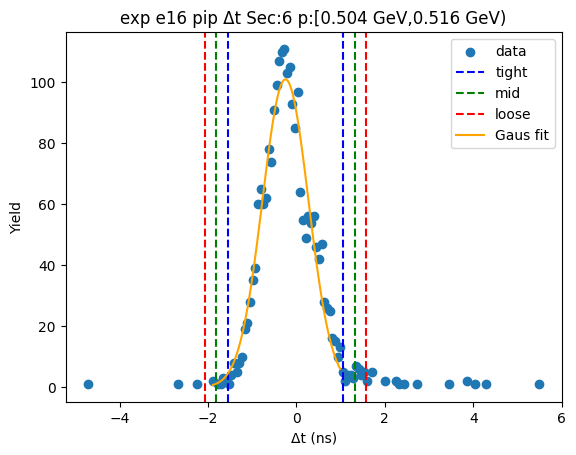

-1.48080527292334 0.9014205240475897
-1.7190278526204332 1.1396431037446828
-1.9572504323175262 1.3778656834417757
[107.68968255  -0.28969237   0.47644516]


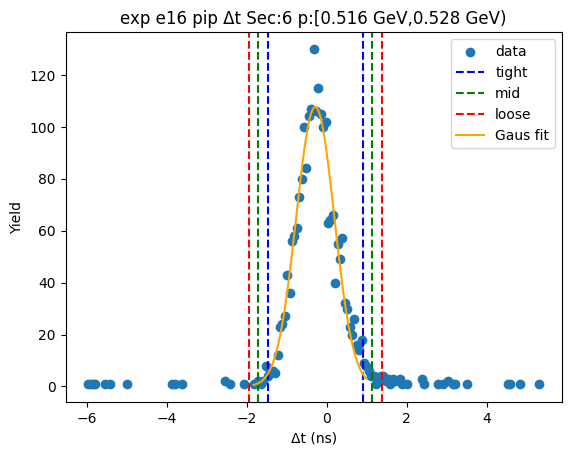

-1.4903548081973674 1.0016578758393353
-1.7395560766010376 1.2508591442430055
-1.988757345004708 1.500060412646676
[108.86541396  -0.24434847   0.49840254]


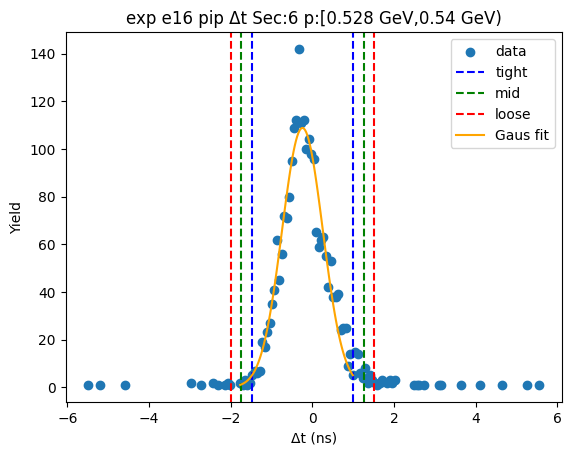

-1.5778594606330005 1.3166815907024059
-1.8673135657665412 1.6061356958359465
-2.1567676709000816 1.8955898009694871
[91.42556105 -0.13058893  0.57890821]


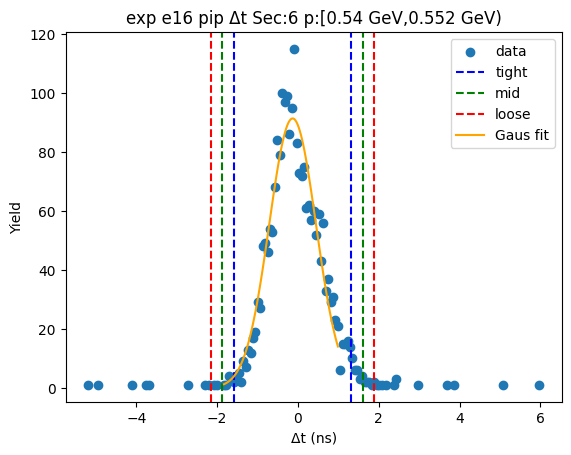

-1.5957058916953382 1.5199809778063367
-1.9072745786455056 1.8315496647565042
-2.218843265595673 2.143118351706672
[ 8.27360753e+01 -3.78624569e-02  6.23137374e-01]


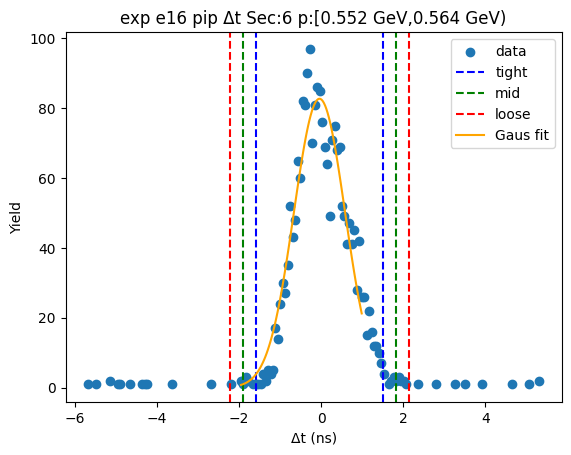

-1.6104425820567458 1.4623217492877085
-1.9177190151911911 1.7695981824221538
-2.2249954483256364 2.076874615556599
[ 8.23882281e+01 -7.40604164e-02  6.14552866e-01]


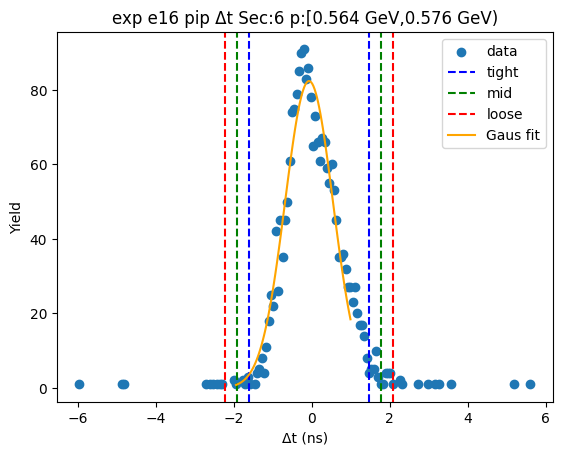

-1.541104383835623 1.5705611076553598
-1.8522709329847216 1.8817276568044583
-2.16343748213382 2.1928942059535563
[8.24369565e+01 1.47283619e-02 6.22333098e-01]


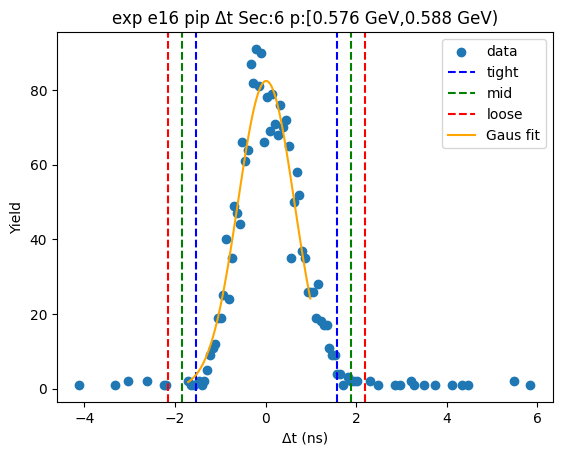

-1.6064838486564836 1.2737733704151815
-1.8945095705636503 1.5617990923223481
-2.1825352924708166 1.8498248142295144
[86.45862336 -0.16635524  0.57605144]


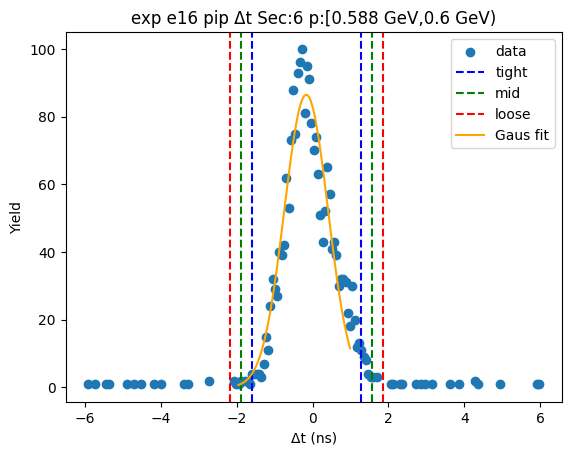

-1.6406802489362633 1.2077382028998374
-1.9255220941198732 1.4925800480834472
-2.210363939303483 1.7774218932670574
[86.77693871 -0.21647102  0.56968369]


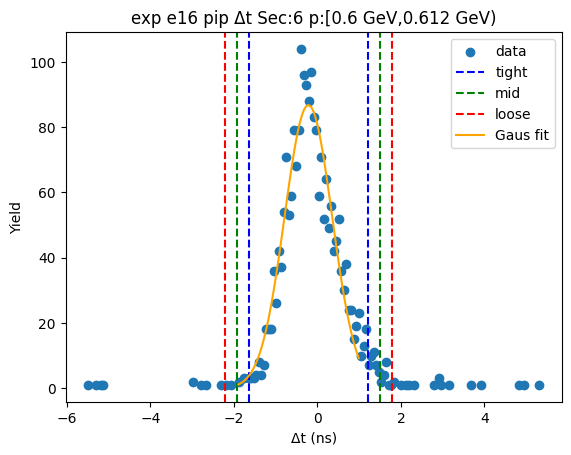

-1.643713126857719 1.0557462121888683
-1.9136590607623776 1.325692146093527
-2.183604994667036 1.5956380799981855
[92.33743672 -0.29398346  0.53989187]


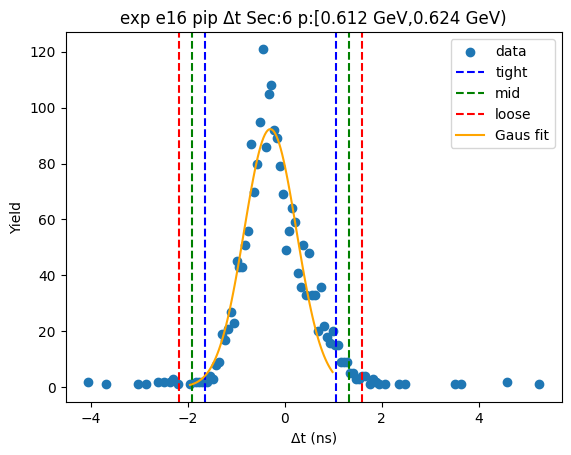

-1.6929325840347238 1.115454826178374
-1.9737713250560336 1.396293567199684
-2.2546100660773436 1.6771323082209937
[85.59927541 -0.28873888  0.56167748]


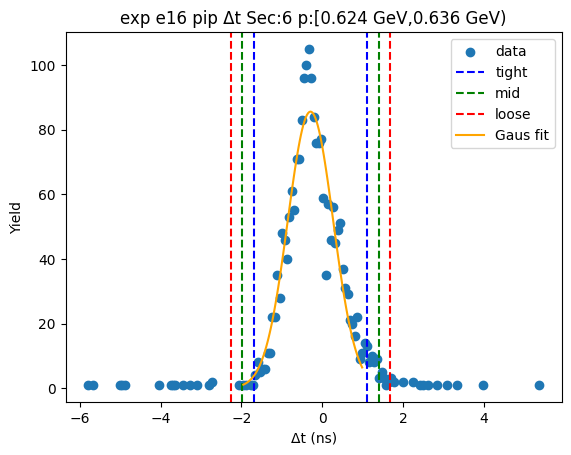

-1.6207332571048187 1.0798059934791495
-1.8907871821632152 1.3498599185375464
-2.160841107221612 1.6199138435959433
[80.65270303 -0.27046363  0.54010785]


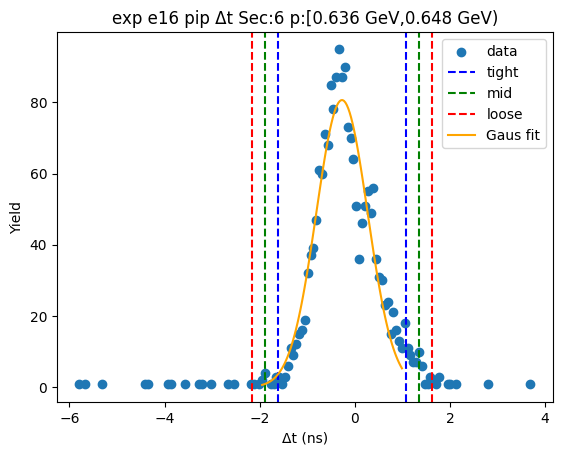

-1.7111026961371656 1.1884496350948957
-2.001057929260372 1.478404868218102
-2.291013162383578 1.7683601013413082
[74.50224841 -0.26132653  0.57991047]


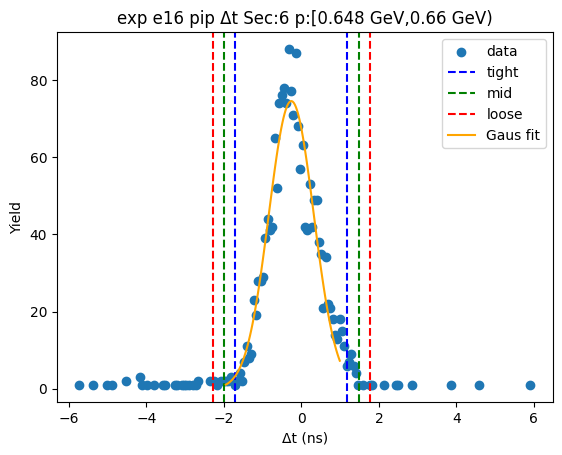

-1.6230671763007753 1.1333998255230637
-1.8987138764831593 1.4090465257054476
-2.174360576665543 1.6846932258878315
[72.83566777 -0.24483368  0.5512934 ]


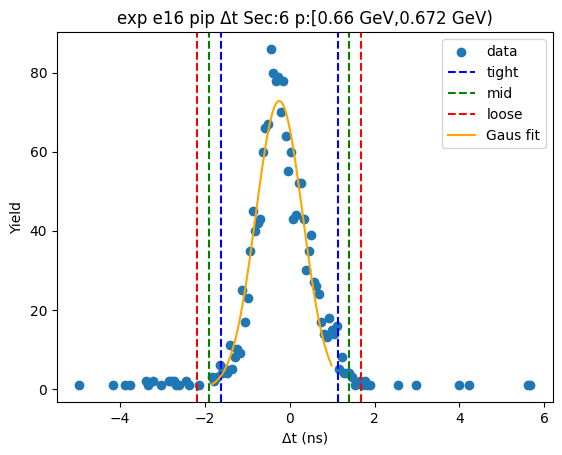

-1.5348231593401118 1.0943171261172073
-1.797737187885844 1.3572311546629394
-2.060651216431576 1.6201451832086713
[85.23577013 -0.22025302  0.52582806]


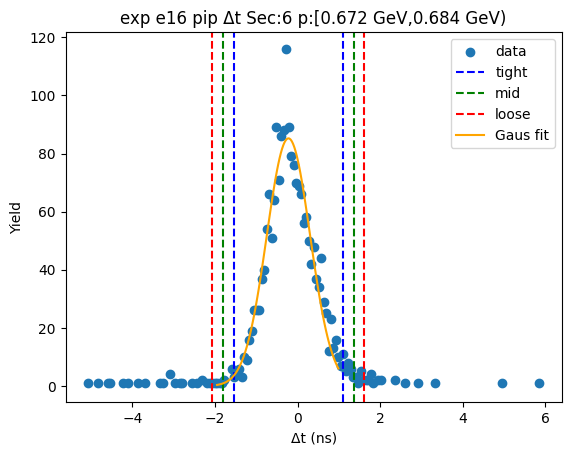

-1.5455674293120993 1.1277852562999318
-1.8129026978733023 1.3951205248611347
-2.080237966434505 1.6624557934223378
[83.15927281 -0.20889109  0.53467054]


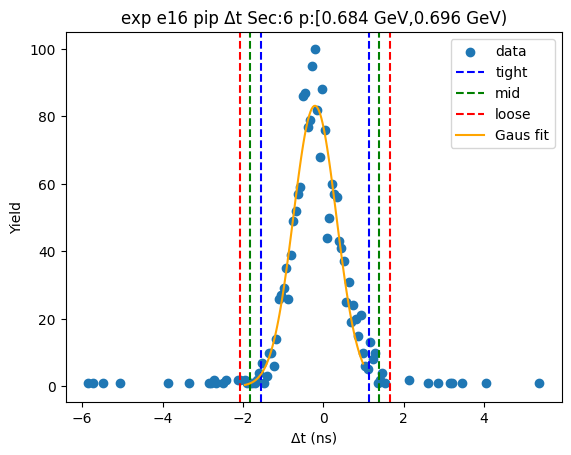

-1.5818464162353896 1.1233657382777464
-1.852367631686703 1.39388695372906
-2.1228888471380167 1.6644081691803734
[79.68030625 -0.22924034  0.54104243]


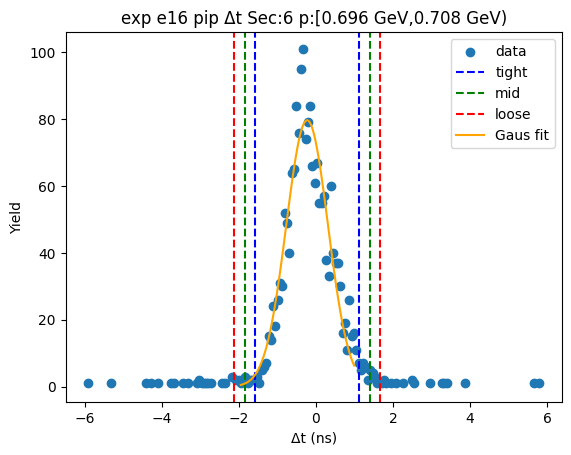

-1.5046720451396014 1.0294101531228768
-1.7580802649658493 1.2828183729491247
-2.0114884847920975 1.5362265927753727
[81.5349494  -0.23763095  0.50681644]


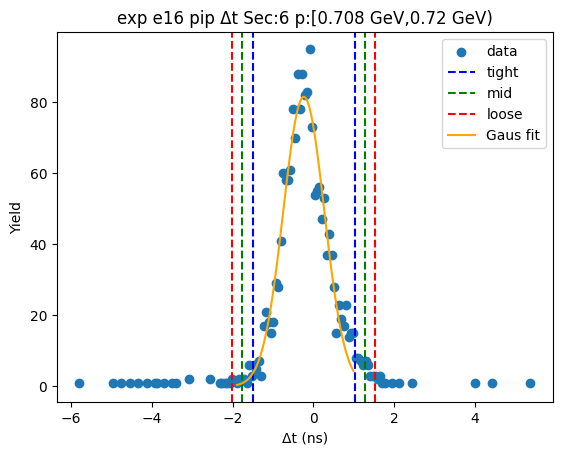

-1.5184315697903477 1.0441567995104972
-1.7746904067204323 1.300415636440582
-2.0309492436505168 1.5566744733706663
[82.71631415 -0.23713739  0.51251767]


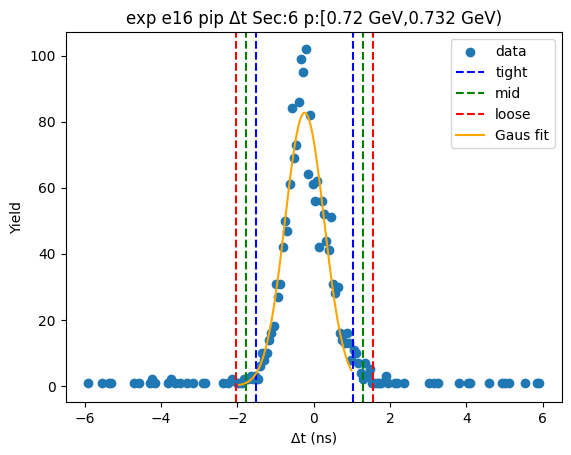

-1.5377741486541248 1.013924856010084
-1.7929440491205455 1.2690947564765047
-2.0481139495869662 1.5242646569429255
[76.40145421 -0.26192465  0.5103398 ]


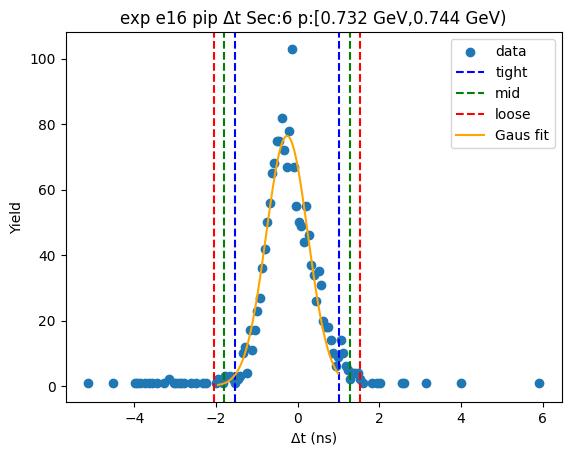

-1.5429285010058706 1.0047971792393018
-1.797701069030388 1.2595697472638192
-2.0524736370549053 1.5143423152883364
[80.42347805 -0.26906566  0.50954514]


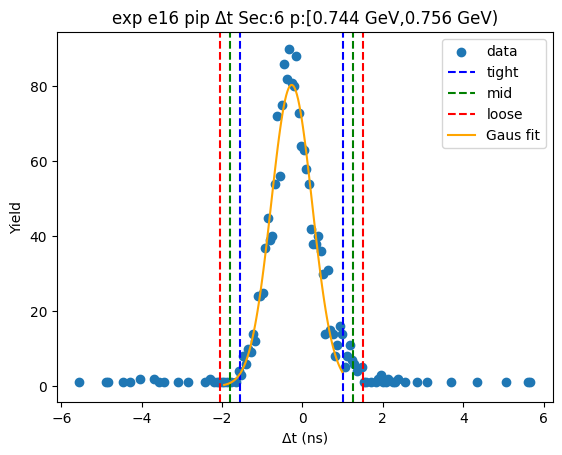

-1.594130892928626 1.0189098068987144
-1.8554349629113598 1.2802138768814486
-2.116739032894094 1.5415179468641824
[71.71550857 -0.28761054  0.52260814]


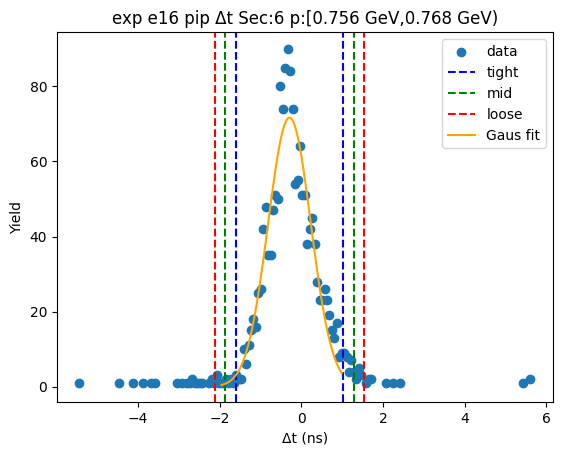

-1.6063394891214295 0.9697394914547133
-1.863947387179044 1.2273473895123277
-2.121555285236658 1.484955287569942
[71.7585932 -0.3183     0.5152158]


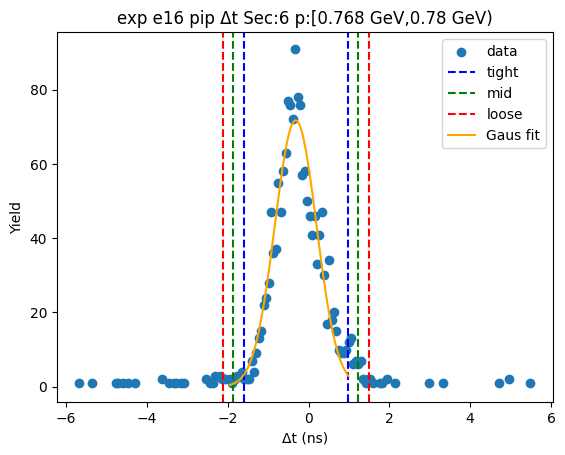

-1.622606216070707 1.0323709644395704
-1.8881039341217347 1.297868682490598
-2.153601652172762 1.5633664005416257
[71.32190767 -0.29511763  0.53099544]


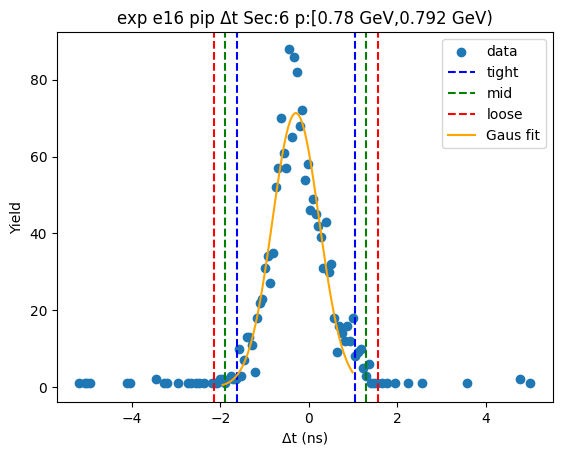

-1.6134799030872489 0.8523147431181286
-1.8600593677077866 1.0988942077386663
-2.1066388323283243 1.345473672359204
[75.06443342 -0.38058258  0.49315893]


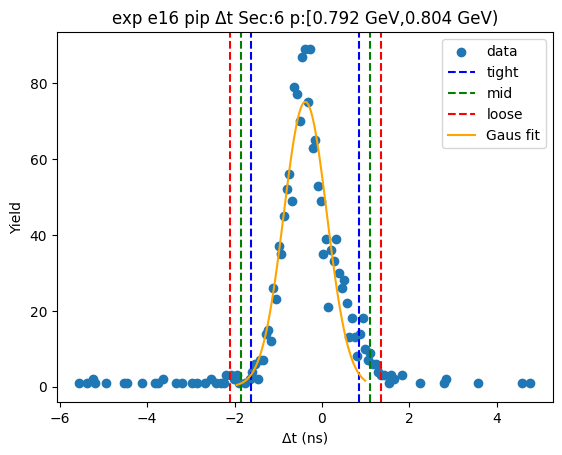

-1.6801297516442397 0.9610531219739445
-1.944248039006058 1.225171409335763
-2.2083663263678766 1.4892896966975813
[65.9271498  -0.35953831  0.52823657]


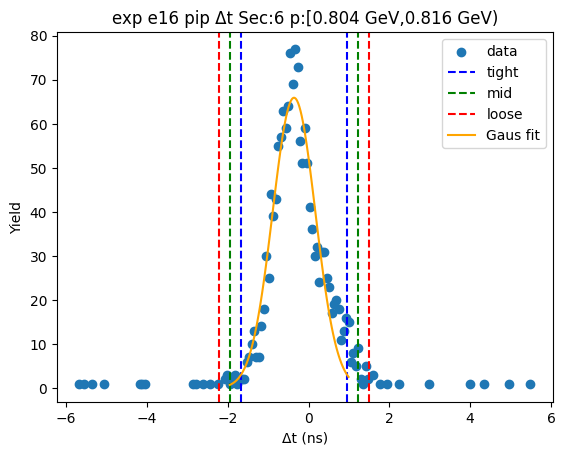

-1.7475520028619587 1.0740767365267925
-2.029714876800834 1.3562396104656678
-2.311877750739709 1.6384024844045428
[63.72079588 -0.33673763  0.56432575]


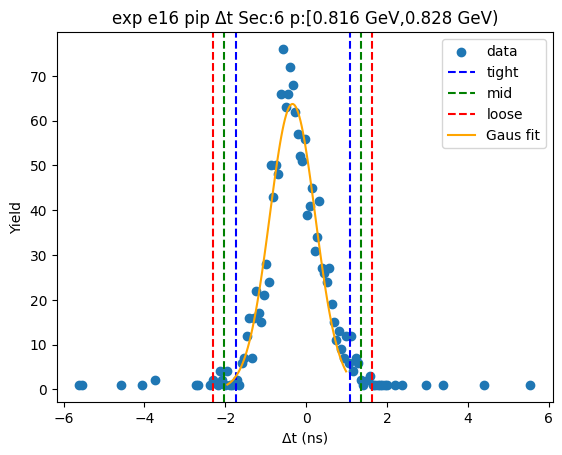

-1.6711378830878179 1.0018815767936027
-1.93843982907596 1.2691835227817447
-2.205741775064102 1.5364854687698868
[62.52510261 -0.33462815  0.53460389]


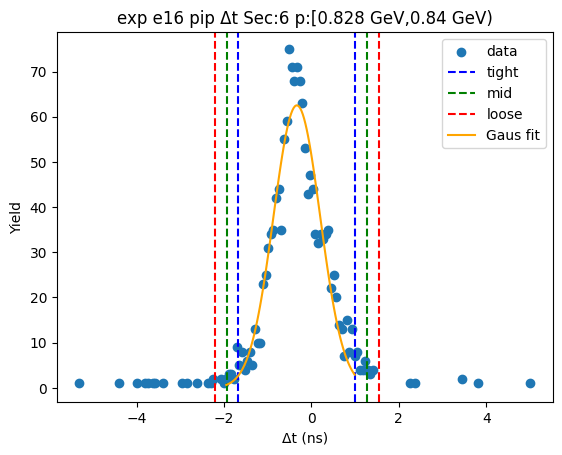

-1.6886706831722673 1.1175315601878784
-1.9692909075082818 1.3981517845238933
-2.2499111318442964 1.6787720088599078
[61.48929398 -0.28556956  0.56124045]


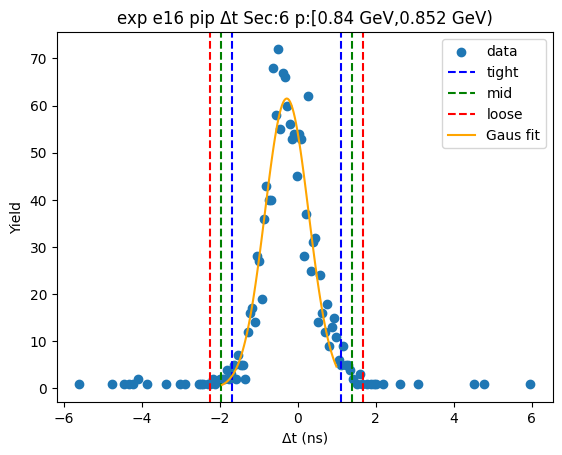

-1.7342538497600317 1.1383906260469085
-2.0215182973407257 1.4256550736276026
-2.30878274492142 1.7129195212082968
[57.52893288 -0.29793161  0.5745289 ]


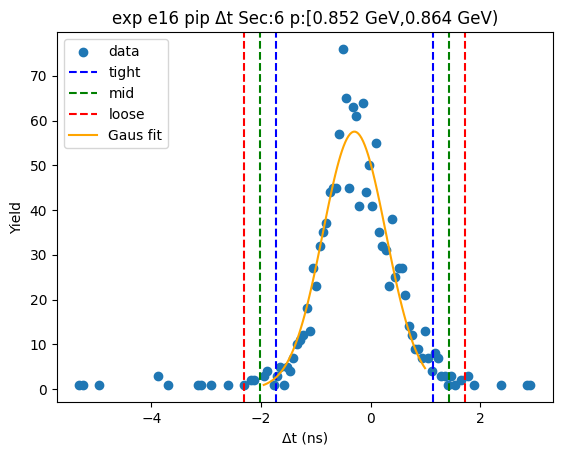

-1.6480434163819377 1.166650283019691
-1.9295127863221004 1.4481196529598537
-2.210982156262263 1.7295890229000166
[56.53899151 -0.24069657  0.56293874]


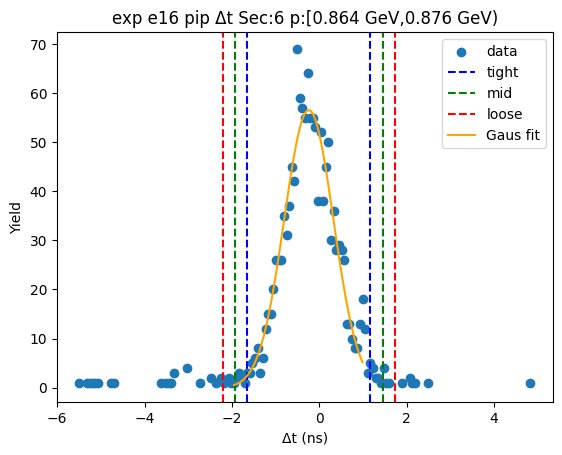

-1.648508916247025 1.1178098632583375
-1.9251407941975611 1.3944417412088737
-2.2017726721480972 1.6710736191594098
[58.10956032 -0.26534953  0.55326376]


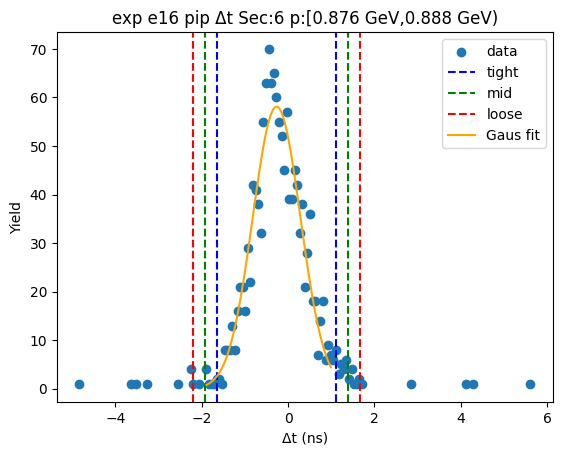

-1.6638746137654707 1.1556370007230417
-1.945825775214322 1.437588162171893
-2.2277769366631732 1.7195393236207441
[56.09892384 -0.25411881  0.56390232]


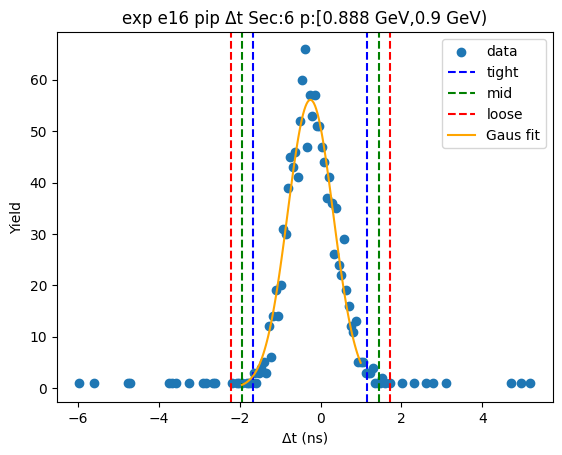

-1.5523116161891353 1.1160949984367483
-1.8191522776517235 1.3829356598993365
-2.0859929391143117 1.6497763213619248
[59.15533877 -0.21810831  0.53368132]


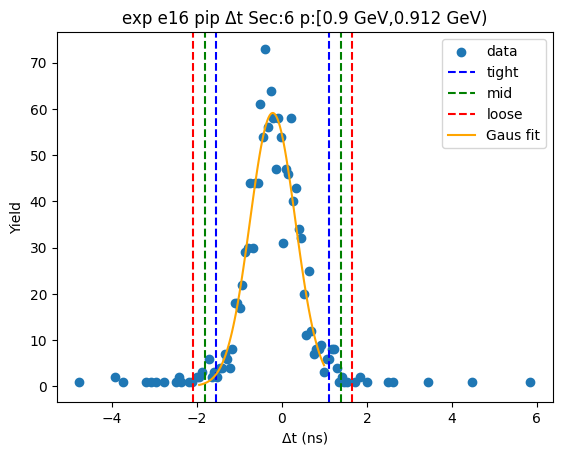

-1.6233654671345796 1.2108070354276355
-1.9067827173908007 1.494224285683857
-2.1901999676470223 1.7776415359400786
[51.27465522 -0.20627922  0.5668345 ]


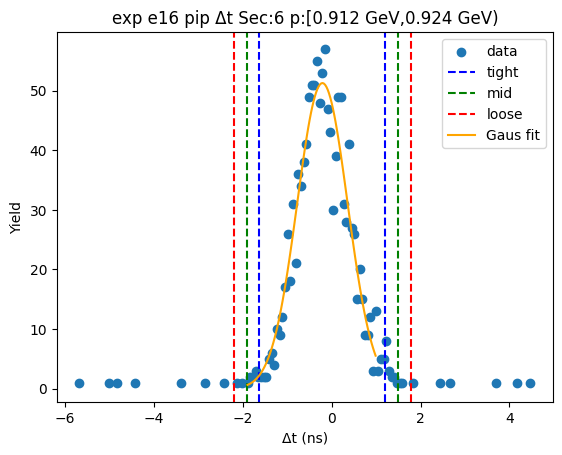

-1.627594535852132 1.2861303309907555
-1.9189670225364206 1.577502817675044
-2.2103395092207094 1.8688753043593327
[51.33884145 -0.1707321   0.58274497]


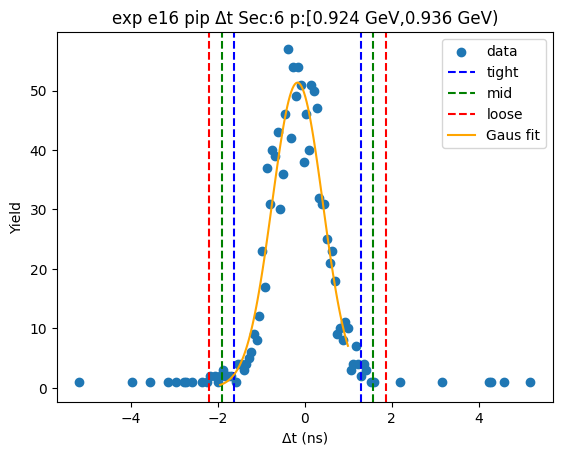

-1.53982970649337 1.1126006532186554
-1.8050727424645723 1.3778436891898578
-2.070315778435775 1.6430867251610604
[53.82785303 -0.21361453  0.53048607]


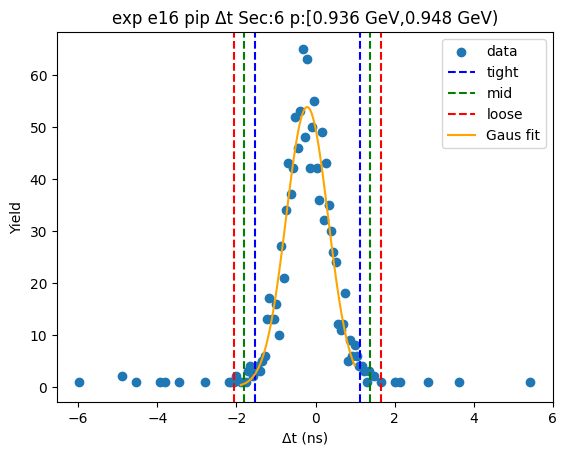

-1.5404125696127318 1.1201504457926934
-1.8064688711532741 1.3862067473332358
-2.0725251726938168 1.6522630488737782
[51.00663469 -0.21013106  0.5321126 ]


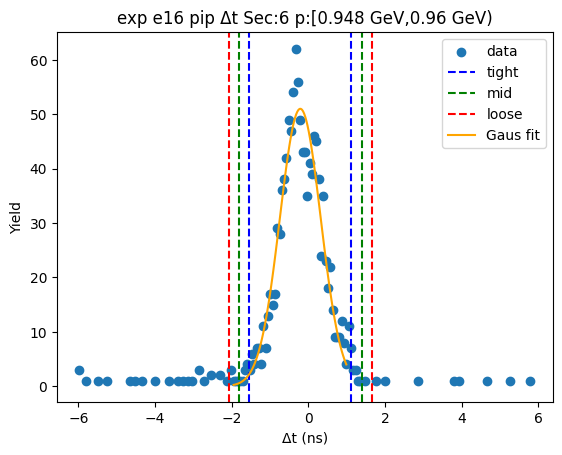

-1.5118488680576543 1.1244984402898281
-1.7754835988924027 1.3881331711245766
-2.0391183297271507 1.651767901959325
[51.68650246 -0.19367521  0.52726946]


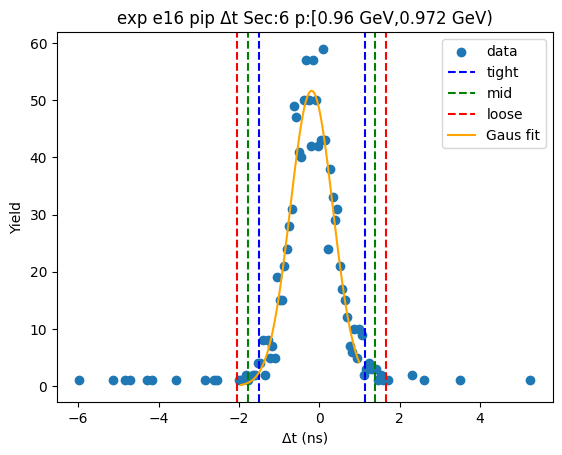

-1.5154468106989338 1.1907391035289103
-1.7860654021217184 1.4613576949516949
-2.056683993544503 1.7319762863744794
[51.2062224  -0.16235385  0.54123718]


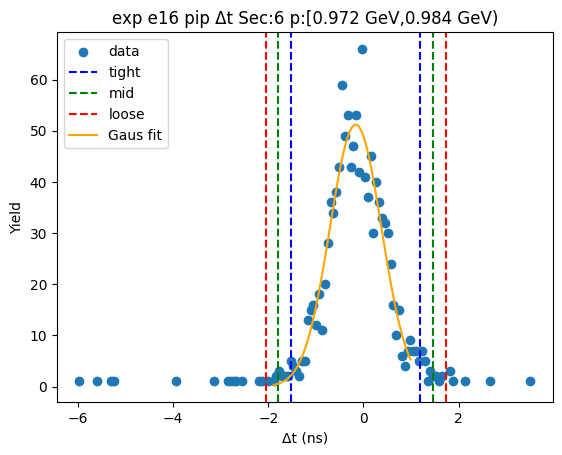

-1.5210391742881413 1.113459937598165
-1.784489085476772 1.376909848786796
-2.047938996665403 1.6403597599754265
[48.30282898 -0.20378962  0.52689982]


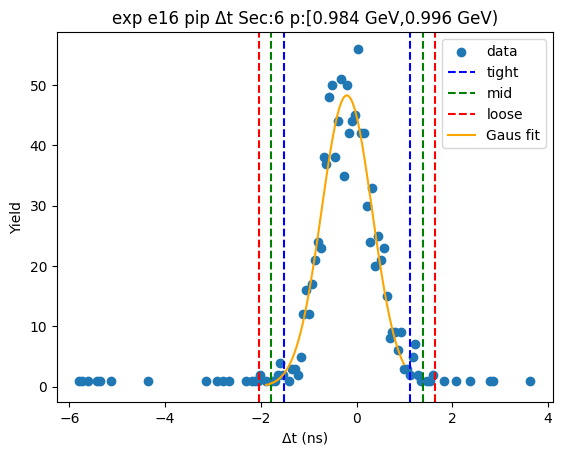

-1.5421986080016767 1.2363685024195863
-1.820055319043803 1.5142252134617125
-2.097912030085929 1.7920819245038386
[44.81783072 -0.15291505  0.55571342]


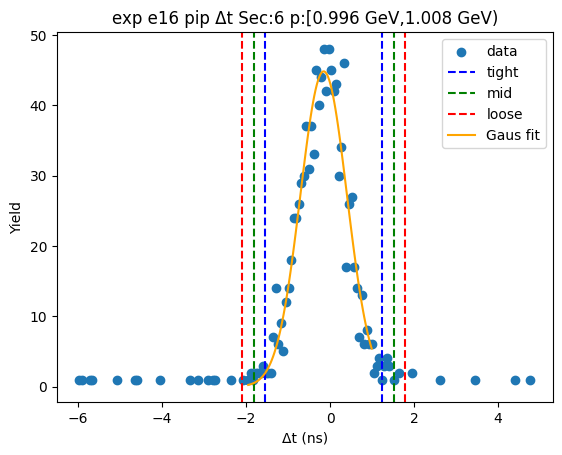

-1.6137869447760218 1.1977669775827737
-1.8949423370119012 1.478922369818653
-2.1760977292477808 1.7600777620545327
[44.67896321 -0.20800998  0.56231078]


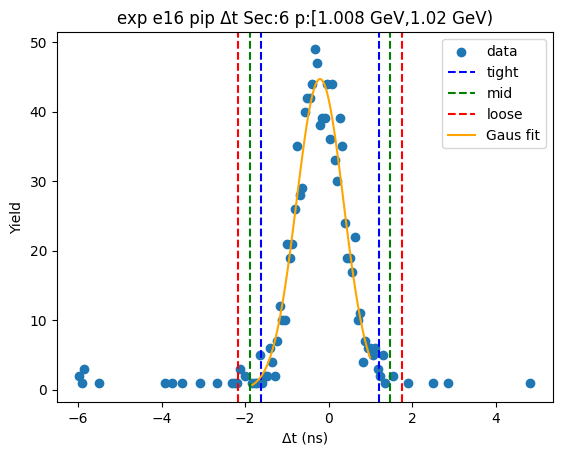

-1.4143442008207305 1.0260106334544616
-1.6583796842482497 1.2700461168819808
-1.9024151676757692 1.5140816003095
[48.22796237 -0.19416678  0.48807097]


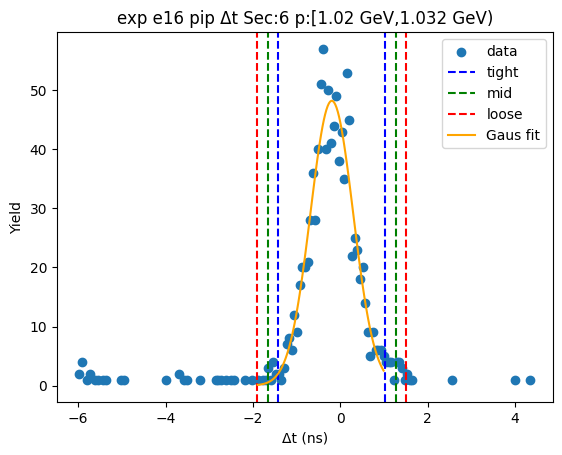

-1.526266951013017 1.1393196212461674
-1.7928256082389353 1.4058782784720858
-2.0593842654648538 1.6724369356980042
[42.54327265 -0.19347366  0.53311731]


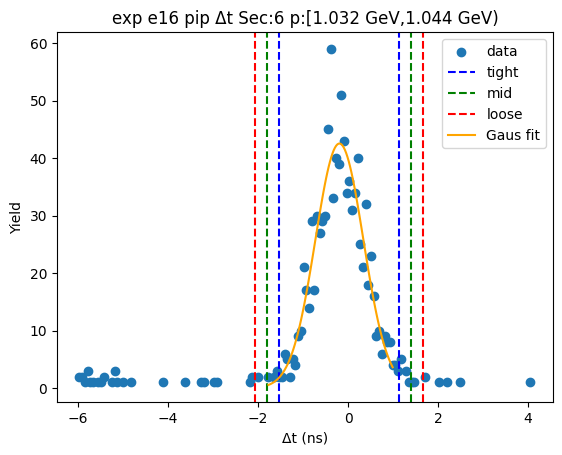

-1.4079591313644533 1.1124334980246824
-1.6599983943033667 1.3644727609635958
-1.9120376572422801 1.6165120239025093
[42.05111422 -0.14776282  0.50407853]


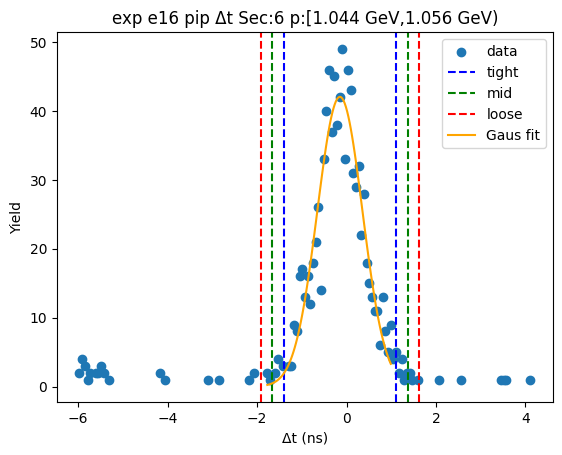

-1.5471811726333022 1.1389476329065744
-1.81579405318729 1.4075605134605622
-2.0844069337412776 1.67617339401455
[42.22458086 -0.20411677  0.53722576]


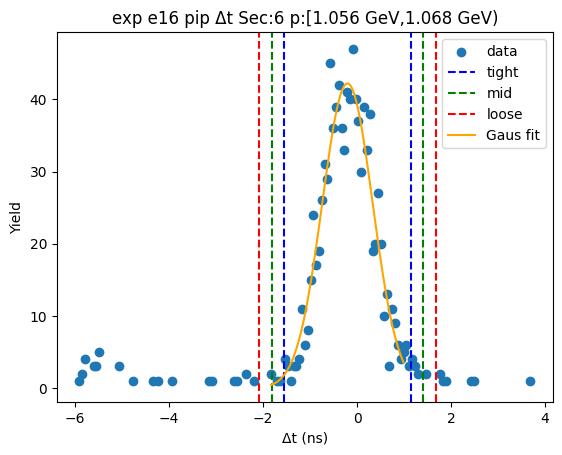

-1.4533686666179517 1.0079989514389611
-1.699505428423643 1.2541357132446525
-1.9456421902293344 1.5002724750503438
[42.59610245 -0.22268486  0.49227352]


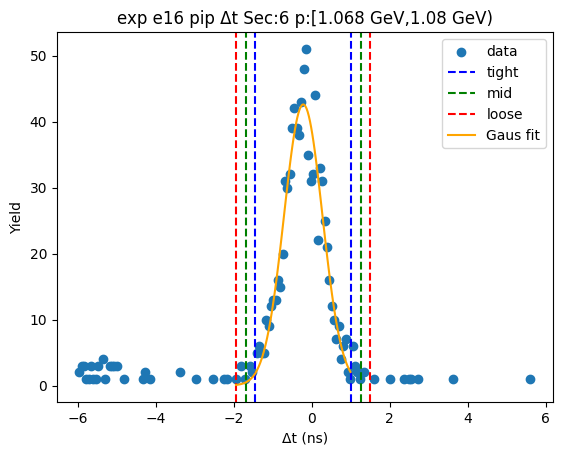

-1.3569557571943403 0.9687901040405663
-1.589530343317831 1.201364690164057
-1.8221049294413216 1.4339392762875476
[44.93591987 -0.19408283  0.46514917]


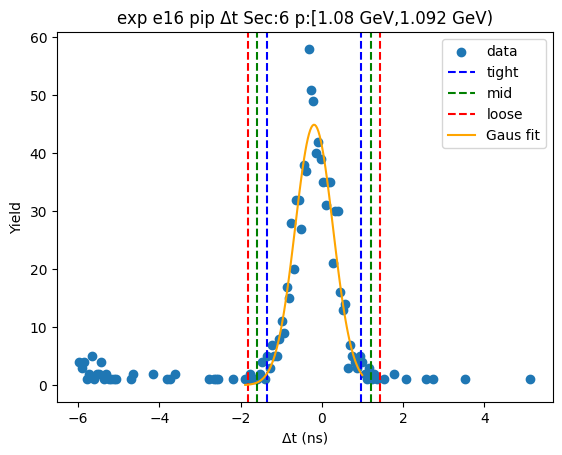

-1.591315473281068 1.1445269345597966
-1.8648997140651542 1.4181111753438829
-2.138483954849241 1.6916954161279694
[37.31633584 -0.22339427  0.54716848]


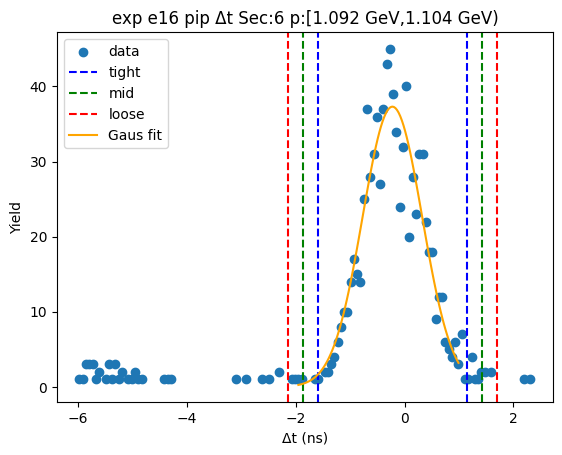

-1.4650340419532837 1.0509366974768608
-1.7166311158962981 1.3025337714198753
-1.9682281898393126 1.5541308453628897
[40.38456767 -0.20704867  0.50319415]


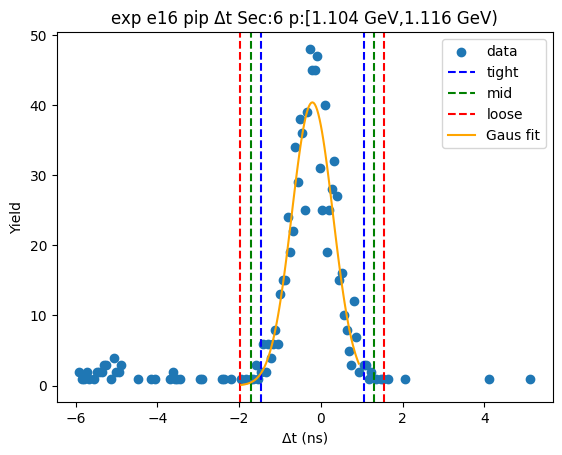

-1.3797325017161555 1.021562754731291
-1.6198620273609001 1.2616922803760358
-1.8599915530056448 1.5018218060207804
[40.94413573 -0.17908487  0.48025905]


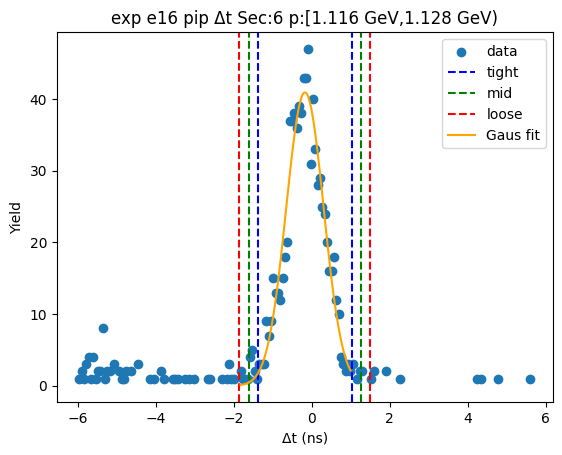

-1.4387565007576804 1.036098367240808
-1.6862419875575292 1.2835838540406568
-1.933727474357378 1.5310693408405056
[38.48786082 -0.20132907  0.49497097]


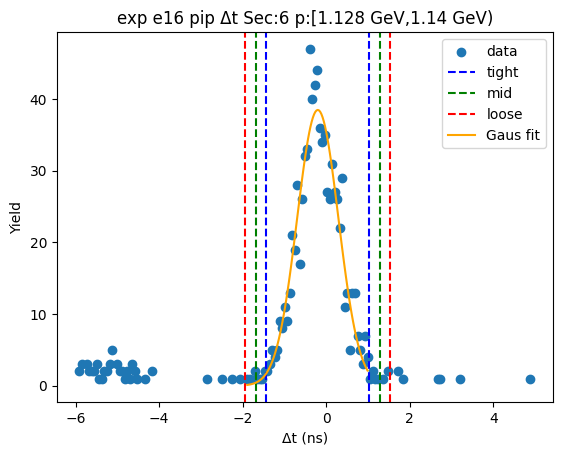

-1.5288379049418042 1.1484267287130747
-1.796564368307292 1.4161531920785626
-2.0642908316727797 1.6838796554440505
[32.93043867 -0.19020559  0.53545293]


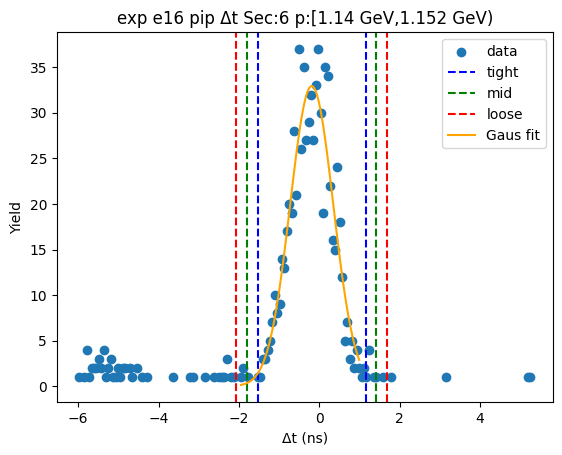

-1.5215221669870573 1.0738671442612981
-1.781061098111893 1.3334060753861339
-2.0406000292367286 1.5929450065109694
[34.85239227 -0.22382751  0.51907786]


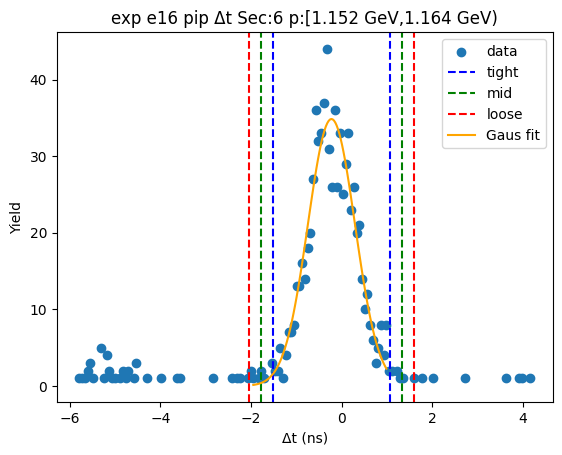

-1.4359452027539439 0.9504579992191824
-1.6745855229512565 1.189098319416495
-1.9132258431485691 1.4277386396138076
[34.84787003 -0.2427436   0.47728064]


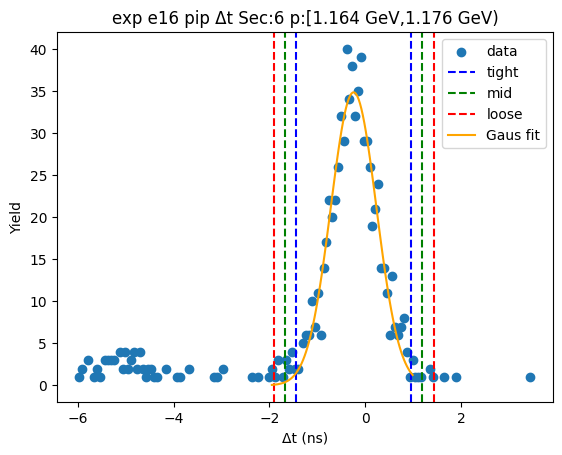

-1.4319842374648395 0.992621870974916
-1.674444848308815 1.2350824818188917
-1.9169054591527905 1.4775430926628672
[36.40526586 -0.21968118  0.48492122]


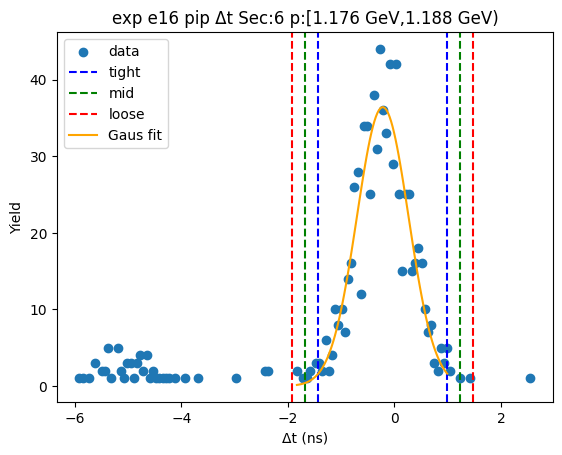

-1.5832223366124065 1.1539054700989197
-1.8569351172835393 1.4276182507700526
-2.130647897954672 1.7013310314411851
[30.99162531 -0.21465843  0.54742556]


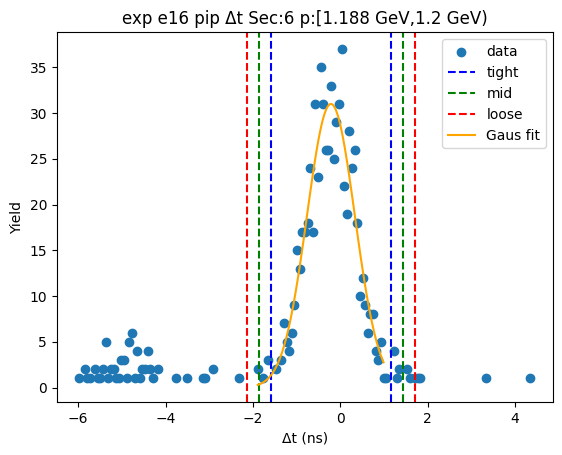

-1.463200553347069 0.9960575261526631
-1.7091263612970424 1.2419833341026365
-1.9550521692470155 1.4879091420526096
[34.12111201 -0.23357151  0.49185162]


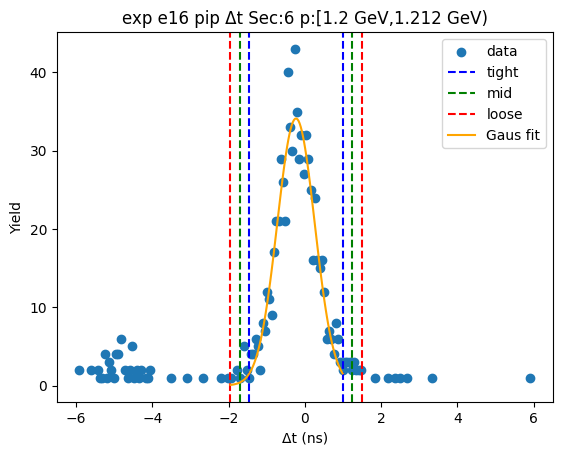

-1.4037874456649504 1.0218714839908583
-1.6463533386305313 1.2644373769564392
-1.888919231596112 1.50700326992202
[31.3992376  -0.19095798  0.48513179]


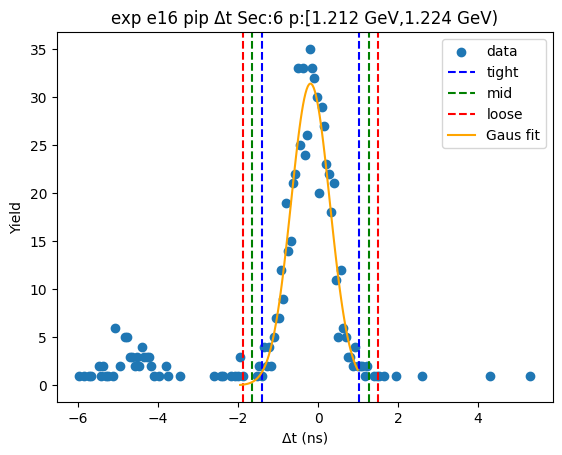

-1.4525178463255406 0.9718397891277949
-1.6949536098708742 1.2142755526731284
-1.9373893734162078 1.456711316218462
[32.49273281 -0.24033903  0.48487153]


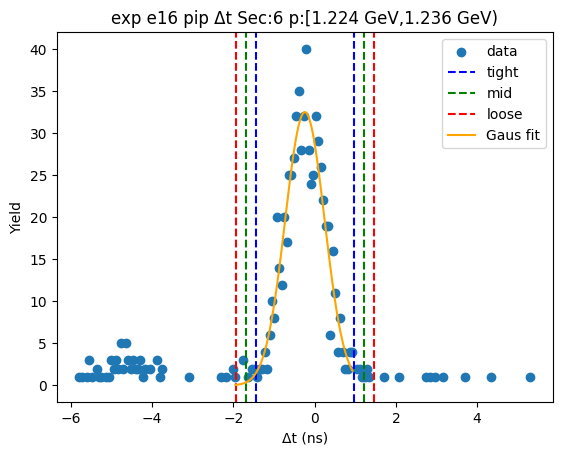

-1.3476749607178844 0.8885188210234984
-1.5712943388920229 1.112138199197637
-1.794913717066161 1.3357575773717751
[33.65566959 -0.22957807  0.44723876]


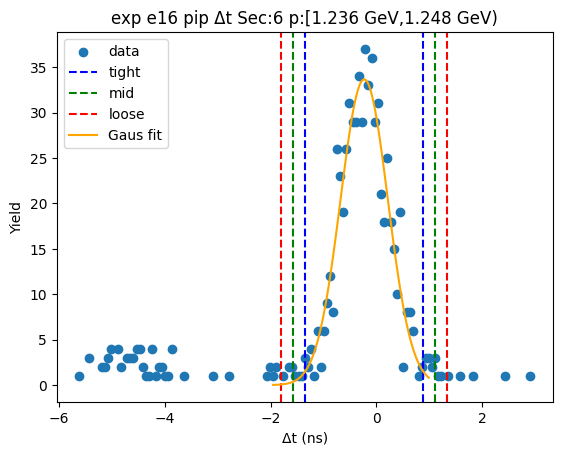

-1.3753369009243304 0.9661821651916365
-1.609488807535927 1.2003340718032331
-1.8436407141475237 1.4344859784148298
[30.39746582 -0.20457737  0.46830381]


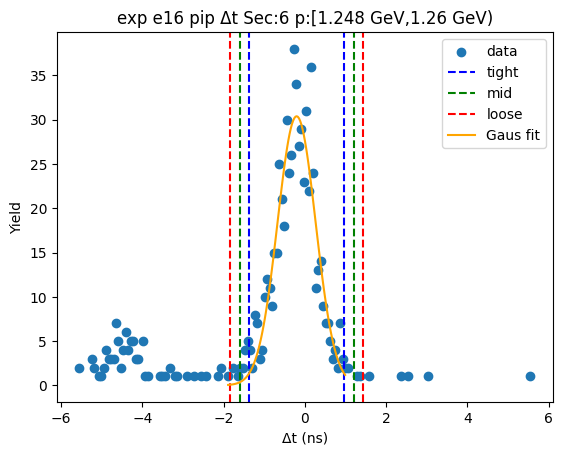

-1.4338888323890513 1.021988437366461
-1.6794765593646024 1.267576164342012
-1.9250642863401535 1.5131638913175631
[30.82538416 -0.2059502   0.49117545]


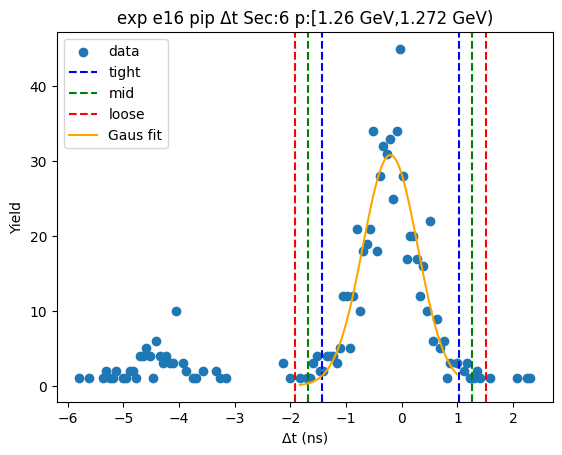

-1.2746409820118803 0.8870125450787383
-1.4908063347209422 1.1031778977878002
-1.706971687430004 1.319343250496862
[31.40610583 -0.19381422  0.43233071]


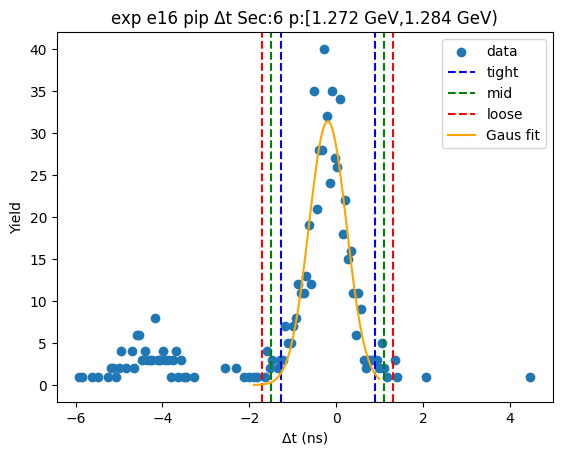

-1.5060337519160996 1.1044201316088547
-1.7670791402685948 1.36546551996135
-2.02812452862109 1.6265109083138456
[26.84815781 -0.20080681  0.52209078]


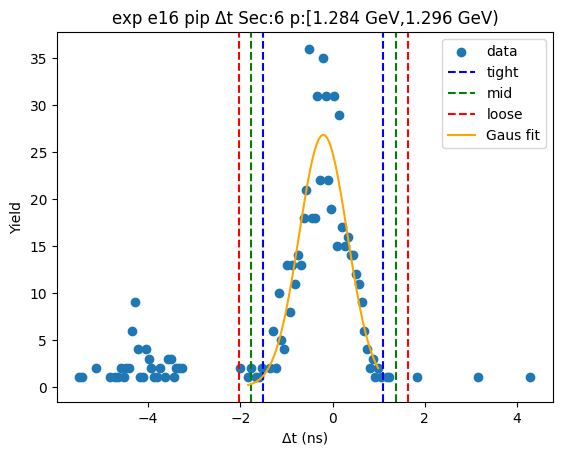

-1.4132346677123513 0.9745440107207006
-1.6520125355556565 1.2133218785640059
-1.8907904033989618 1.452099746407311
[29.84643672 -0.21934533  0.47755574]


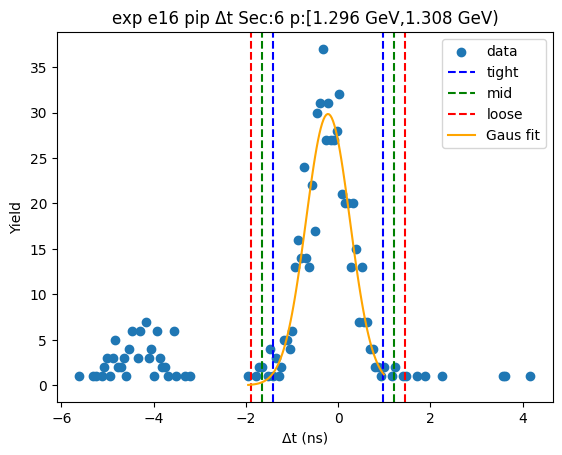

-1.4973144303057806 1.1419779967219728
-1.761243673008556 1.4059072394247483
-2.025172915711331 1.6698364821275236
[27.00396284 -0.17766822  0.52785849]


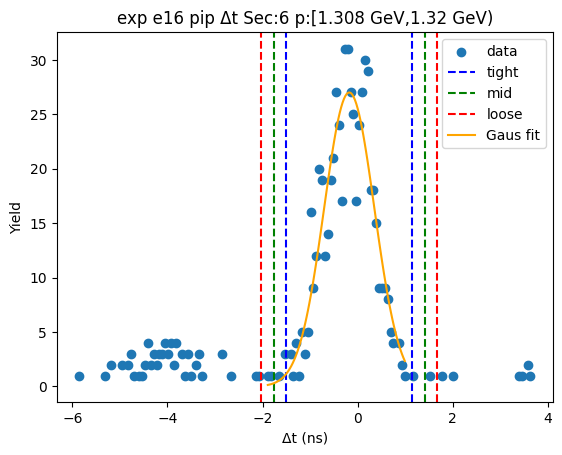

-1.2563650286869954 0.9602291995935542
-1.4780244515150505 1.1818886224216094
-1.6996838743431053 1.4035480452496643
[31.29417759 -0.14806791  0.44331885]


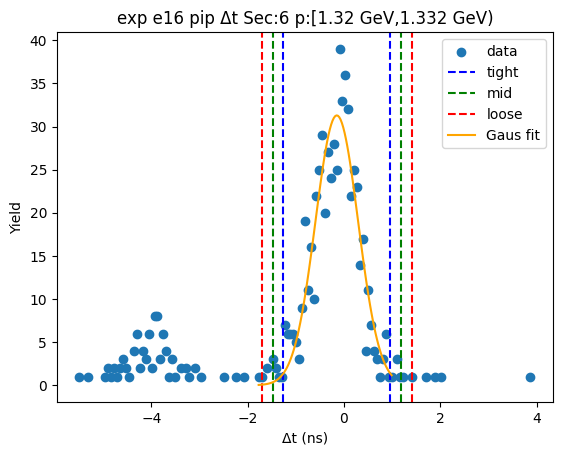

-1.3347887793552573 0.9650483983733239
-1.5647724971281156 1.1950321161461819
-1.7947562149009735 1.4250158339190402
[29.20142145 -0.18487019  0.45996744]


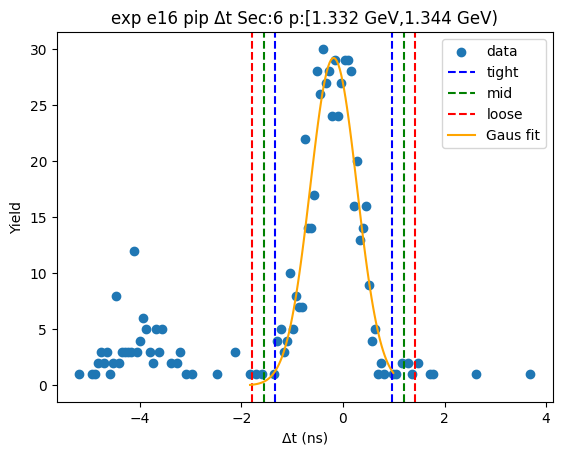

-1.4519074613462475 1.104464103270739
-1.7075446178079463 1.3601012597324378
-1.963181774269645 1.6157384161941364
[23.61890019 -0.17372168  0.51127431]


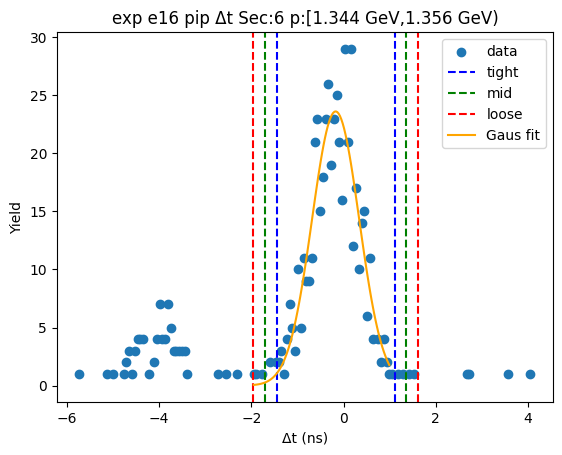

-1.4240091187662176 0.9872002673133619
-1.6651300573741754 1.2283212059213195
-1.9062509959821332 1.4694421445292773
[26.49739206 -0.21840443  0.48224188]


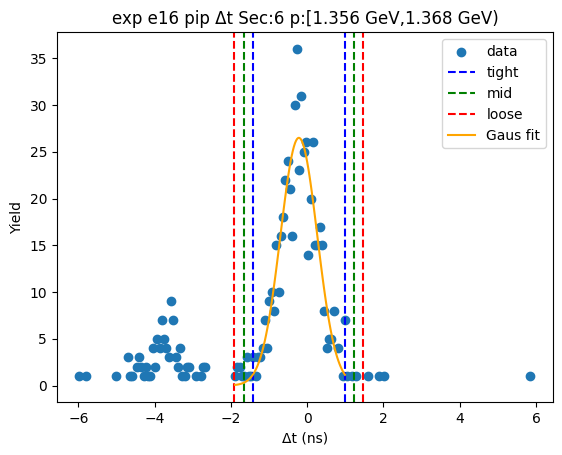

-1.2708525899956096 1.013016944972822
-1.4992395434924526 1.241403898469665
-1.7276264969892956 1.469790851966508
[27.57255213 -0.12891782  0.45677391]


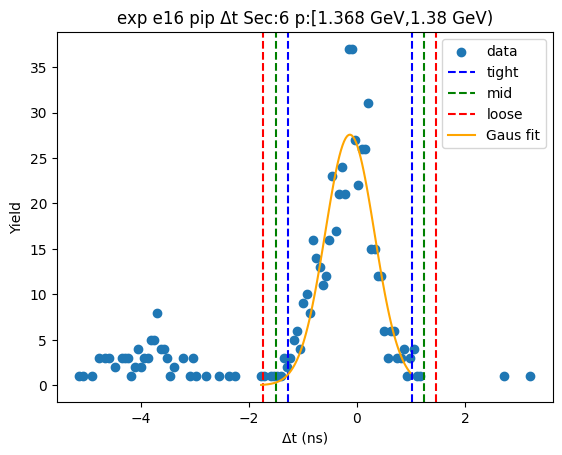

-1.3878970706593332 1.0299685852732225
-1.6296836362525888 1.2717551508664782
-1.8714702018458444 1.5135417164597338
[26.26663321 -0.17896424  0.48357313]


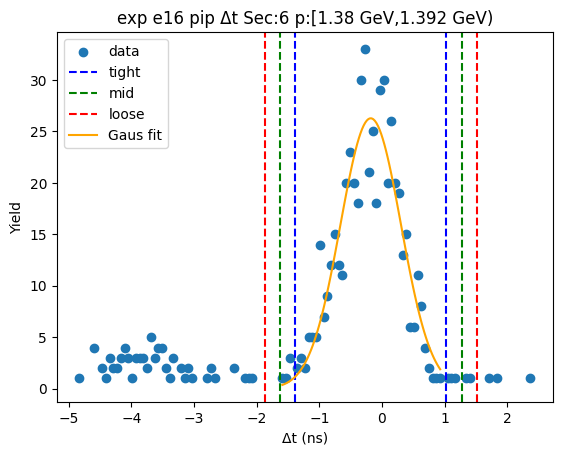

-1.3459738675905097 0.8990171184384322
-1.570472966193404 1.1235162170413266
-1.7949720647962981 1.3480153156442207
[24.97981806 -0.22347837  0.4489982 ]


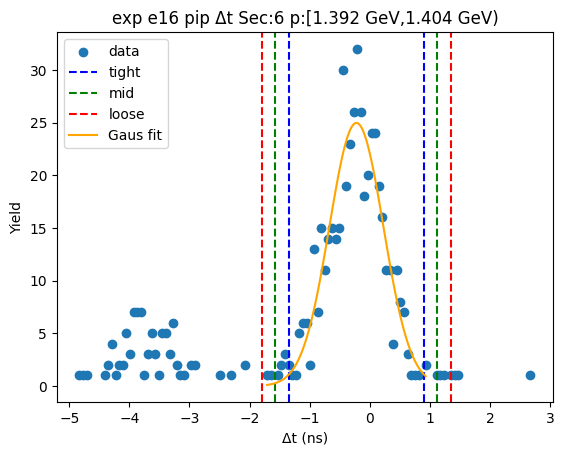

-1.3300445535844072 0.9266931584426916
-1.555718324787117 1.1523669296454013
-1.7813920959898268 1.3780407008481113
[25.03031979 -0.2016757   0.45134754]


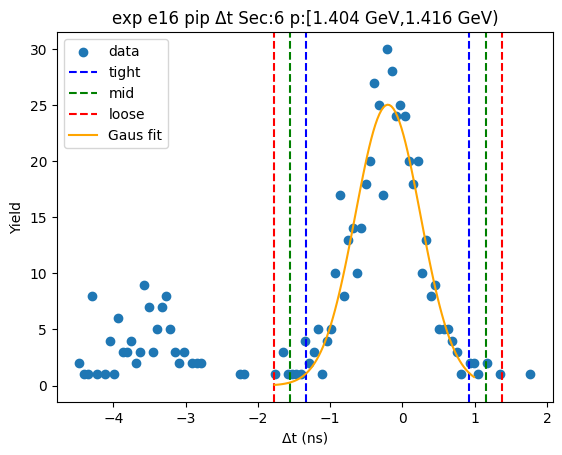

-1.3045260108251768 0.9112550122021341
-1.5261041131279078 1.1328331145048651
-1.747682215430639 1.3544112168075964
[26.68299506 -0.1966355   0.4431562 ]


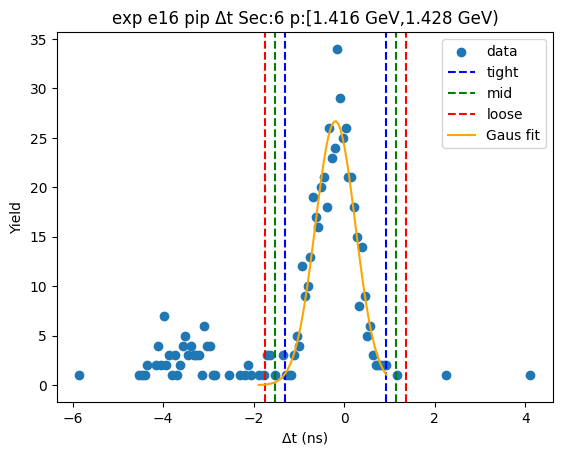

-1.2269496394223909 0.872875808209431
-1.436932184185573 1.082858352972613
-1.6469147289487551 1.2928408977357952
[24.60526687 -0.17703692  0.41996509]


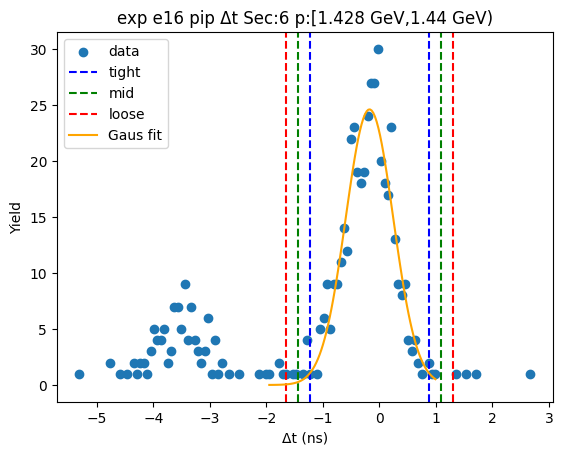

-1.3216404086288989 1.0113083988549498
-1.5549352893772836 1.2446032796033346
-1.7882301701256686 1.4778981603517196
[23.57147651 -0.155166    0.46658976]


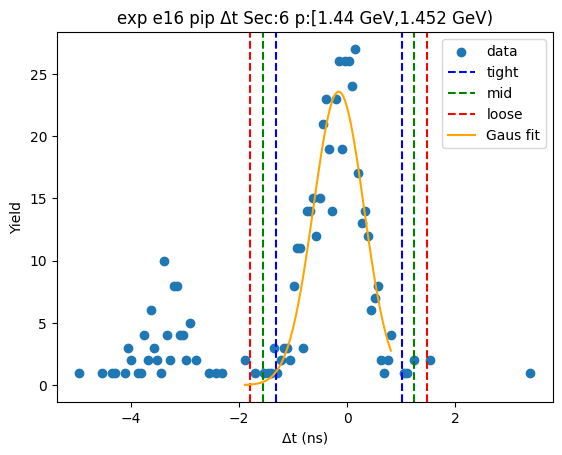

-1.45318955680061 1.1294952164879801
-1.7114580341294687 1.387763693816839
-1.9697265114583278 1.646032171145698
[22.29507896 -0.16184717  0.51653695]


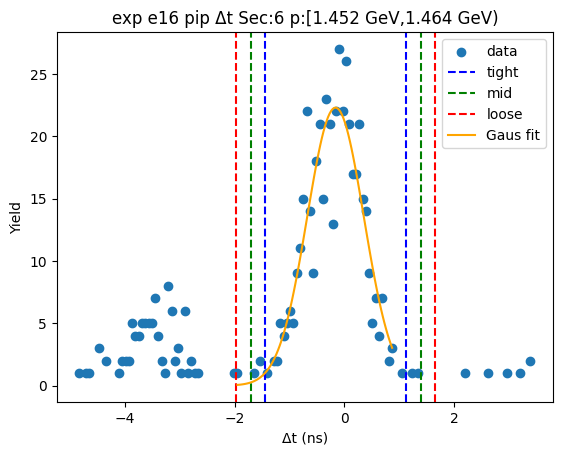

-1.1509667384687803 0.7755397428317845
-1.3436173865988368 0.9681903909618408
-1.5362680347288933 1.1608410390918973
[25.77036881 -0.1877135   0.3853013 ]


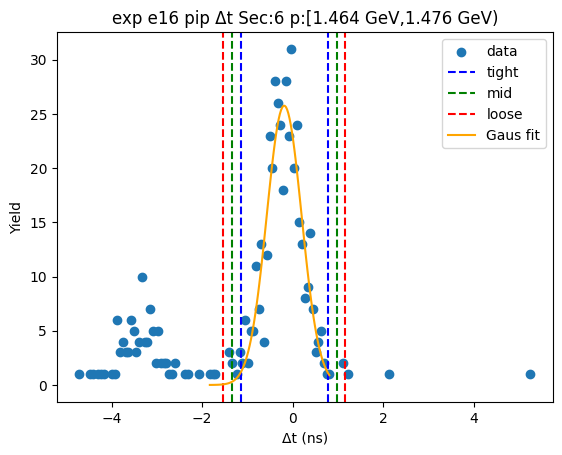

-1.2034907337998086 0.8781068382618902
-1.4116504910059786 1.0862665954680601
-1.6198102482121484 1.29442635267423
[23.6512563  -0.16269195  0.41631951]


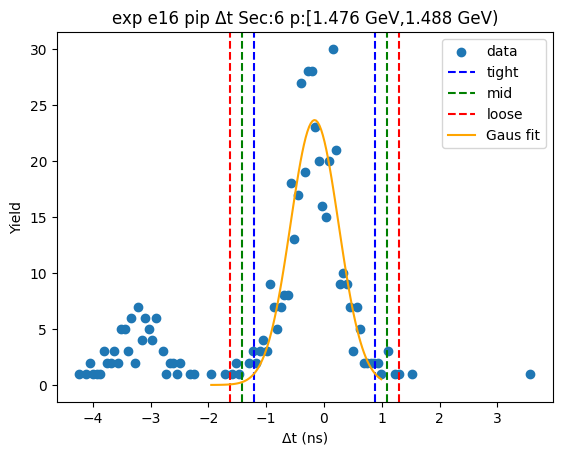

-1.3069917910536772 0.9382413196436988
-1.5315151021234148 1.1627646307134367
-1.7560384131931523 1.3872879417831743
[23.43234118 -0.18437524  0.44904662]


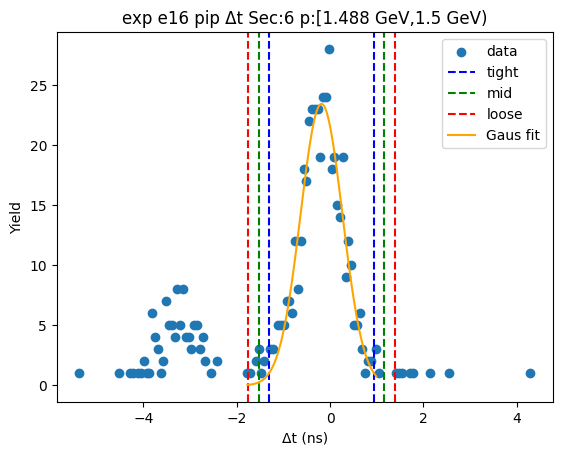

-1.285764719106429 0.9474677959140322
-1.5090879706084752 1.1707910474160783
-1.7324112221105215 1.3941142989181246
[23.3464976  -0.16914846  0.4466465 ]


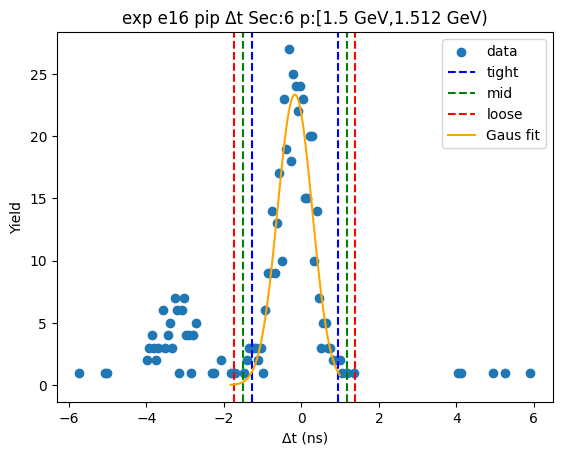

-1.201650135176355 0.82687592295552
-1.4045027409895425 1.0297285287687075
-1.6073553468027302 1.232581134581895
[24.64525281 -0.18738711  0.40570521]


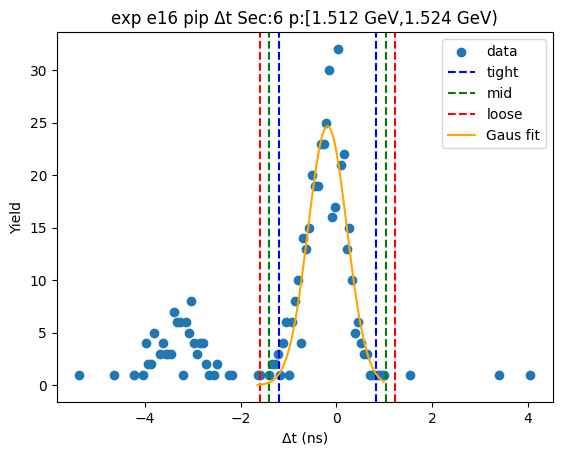

-1.3418202668057604 1.0428722021101091
-1.5802895136973472 1.2813414490016959
-1.8187587605889342 1.5198106958932829
[20.55633381 -0.14947403  0.47693849]


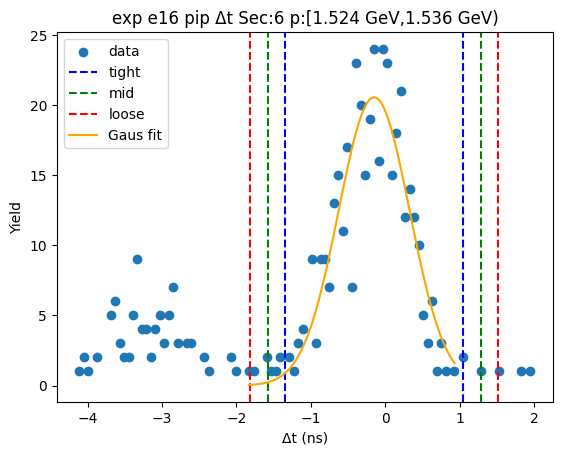

-1.2088841579543685 0.9146444839954166
-1.421237022149347 1.1269973481903952
-1.6335898863443257 1.3393502123853738
[19.92951491 -0.14711984  0.42470573]


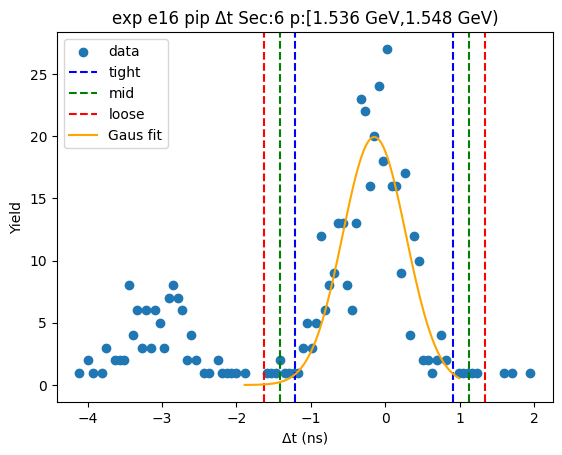

-1.2021865984621372 0.8513092266472159
-1.4075361809730726 1.0566588091581515
-1.612885763484008 1.2620083916690867
[20.5581071  -0.17543869  0.41069917]


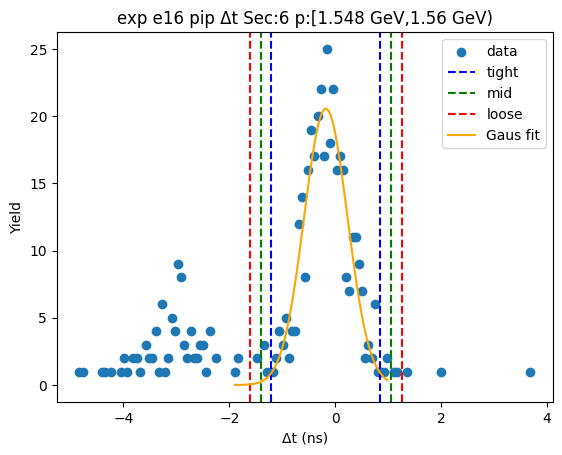

-1.129585177007765 0.8458450650286616
-1.3271282012114074 1.0433880892323042
-1.52467122541505 1.2409311134359469
[23.27697003 -0.14187006  0.39508605]


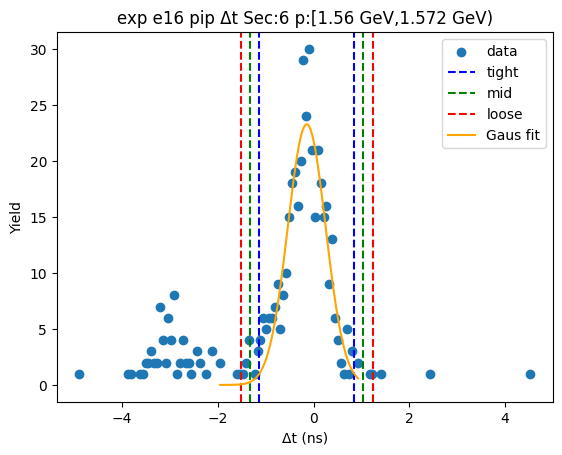

-1.2307943129268595 0.8876143172889264
-1.4426351759484382 1.099455180310505
-1.6544760389700166 1.3112960433320835
[19.5209469  -0.17159     0.42368173]


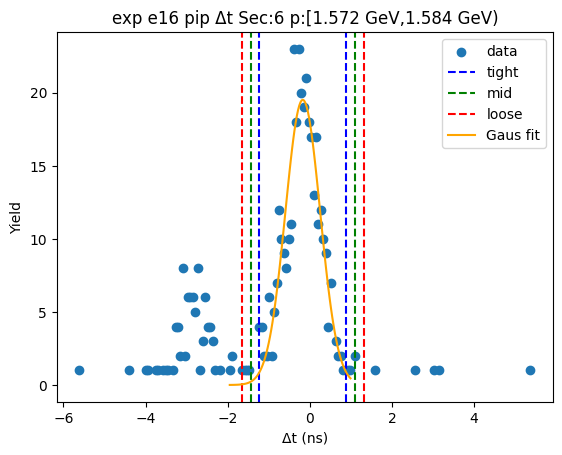

-1.197888173277249 0.9564243501617973
-1.4133194256211536 1.1718556025057019
-1.6287506779650582 1.3872868548496065
[21.23484157 -0.12073191  0.4308625 ]


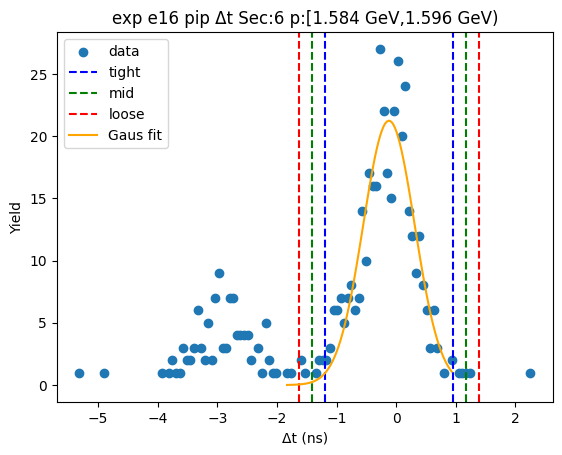

-1.0767024462059065 0.8576895076510453
-1.2701416415916016 1.0511287030367404
-1.463580836977297 1.2445678984224358
[19.89043369 -0.10950647  0.38687839]


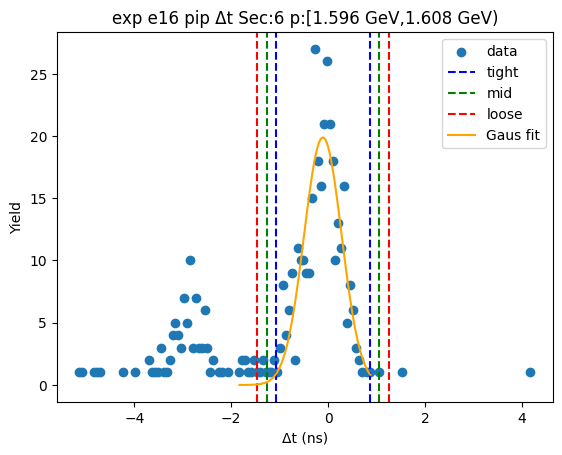

-1.1445501720086773 0.8140543953428188
-1.3404106287438267 1.0099148520779684
-1.5362710854789763 1.205775308813118
[20.2223441  -0.16524789  0.39172091]


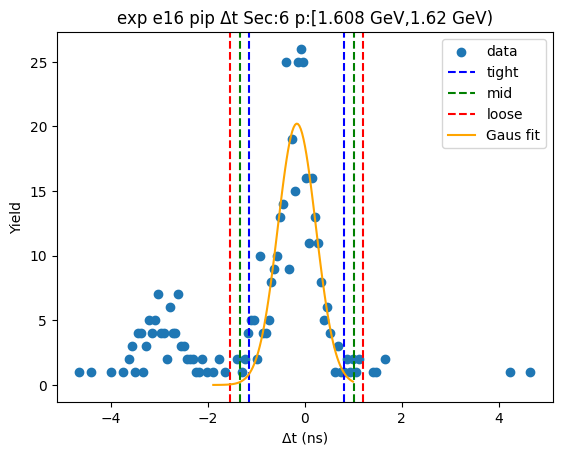

-1.071988309924021 0.7746041717951402
-1.256647558095937 0.9592634199670562
-1.4413068062678533 1.1439226681389725
[21.14067082 -0.14869207  0.3693185 ]


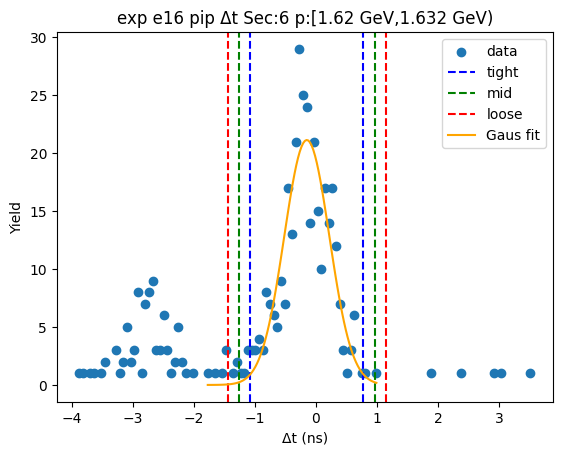

-1.252668838508203 0.9716498654166765
-1.475100708900691 1.1940817358091644
-1.6975325792931788 1.4165136062016523
[17.92759821 -0.14050949  0.44486374]


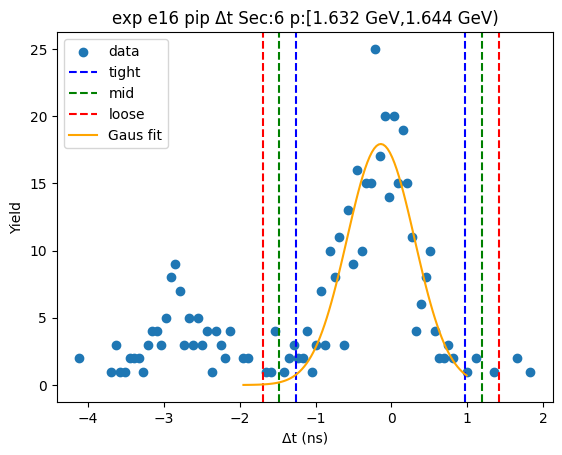

-1.4969858244955974 1.0503809465825908
-1.7517225016034164 1.3051176236904098
-2.006459178711235 1.5598543007982286
[16.23286205 -0.22330244  0.50947335]


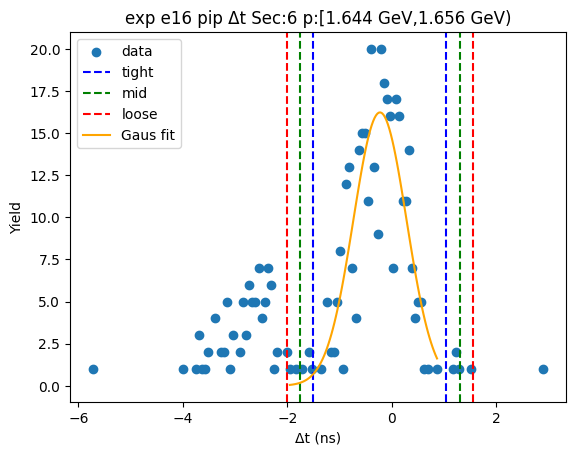

-1.3718640326323923 1.0176072466660018
-1.6108111605622317 1.2565543745958412
-1.8497582884920711 1.4955015025256806
[15.05249448 -0.17712839  0.47789426]


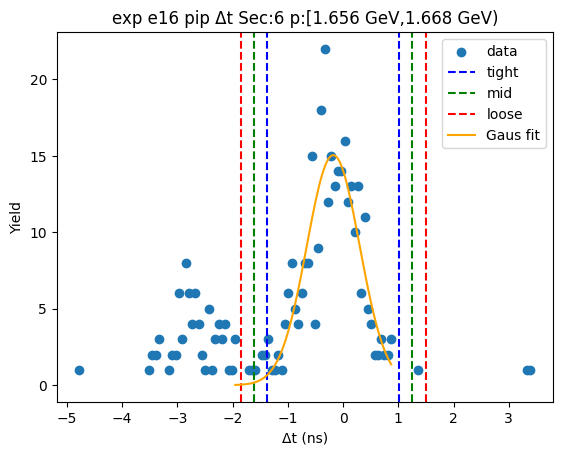

-1.2343052319411585 0.9183353314079563
-1.44956928827607 1.1335993877428678
-1.6648333446109815 1.3488634440777794
[17.86442854 -0.15798495  0.43052811]


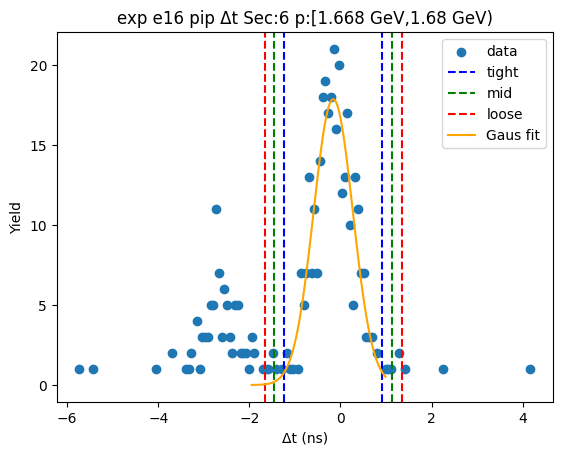

-1.048725531436006 0.7661228464078036
-1.230210369220387 0.9476076841921846
-1.411695207004768 1.1290925219765655
[19.74970992 -0.14130134  0.36296968]


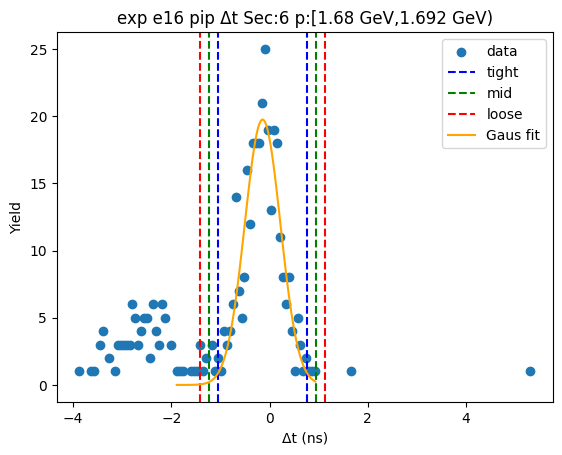

-1.1561369098369045 0.8567570770029859
-1.3574263085208937 1.058046475686975
-1.5587157072048827 1.259335874370964
[17.48437394 -0.14968992  0.4025788 ]


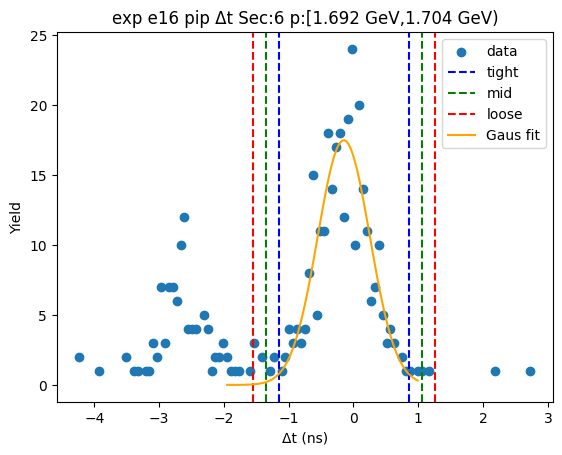

-1.247172426841498 0.9034257254912768
-1.4622322420747758 1.1184855407245544
-1.6772920573080532 1.3335453559578319
[15.43476299 -0.17187335  0.43011963]


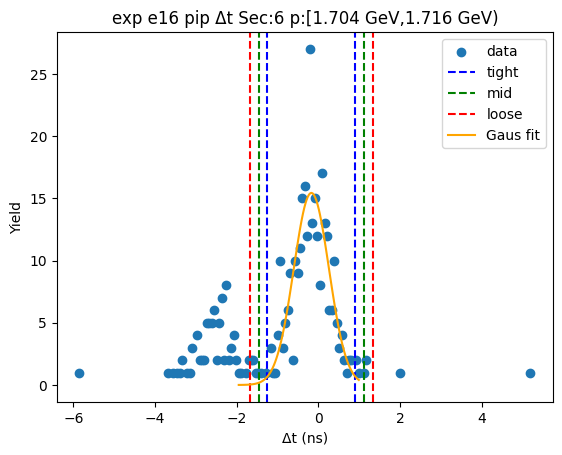

-1.1773408831869108 0.8822727168237376
-1.3833022431879758 1.0882340768248027
-1.5892636031890406 1.2941954368258675
[17.78303987 -0.14753408  0.41192272]


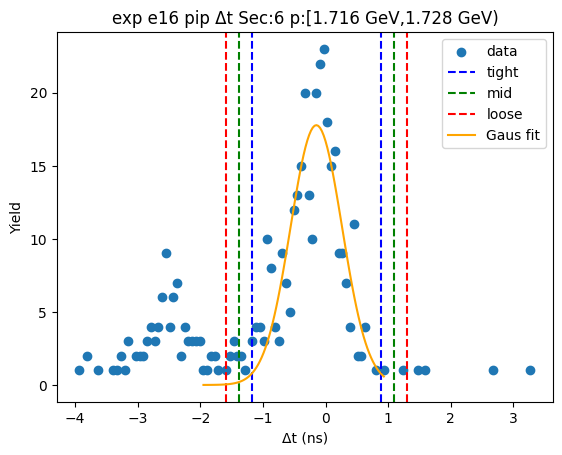

-1.2633246327066987 1.033080823105314
-1.4929651782878999 1.262721368686515
-1.7226057238691013 1.4923619142677165
[15.68809299 -0.1151219   0.45928109]


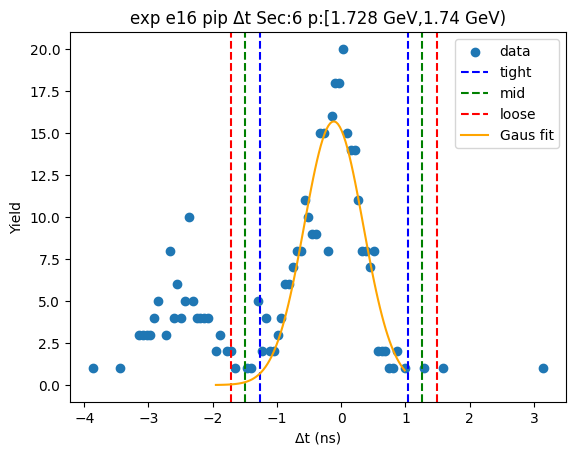

-1.175644924966213 0.8950802972160967
-1.3827174471844441 1.1021528194343277
-1.5897899694026751 1.3092253416525588
[17.27598362 -0.14028231  0.41414504]


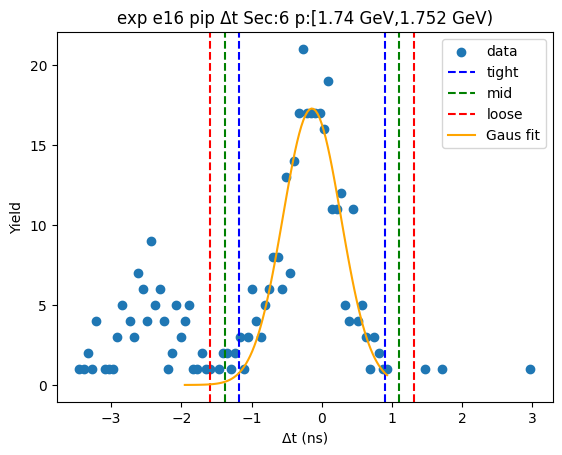

-1.154478185496619 0.8552216361524563
-1.3554481676615266 1.0561916183173639
-1.5564181498264342 1.2571616004822714
[17.54600907 -0.14962827  0.40193996]


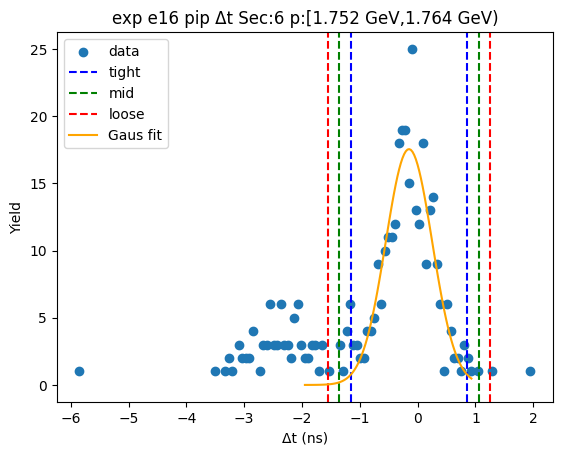

-1.0494977350930015 0.8056288641999966
-1.2350103950223013 0.9911415241292965
-1.420523054951601 1.1766541840585962
[15.36592096 -0.12193444  0.37102532]


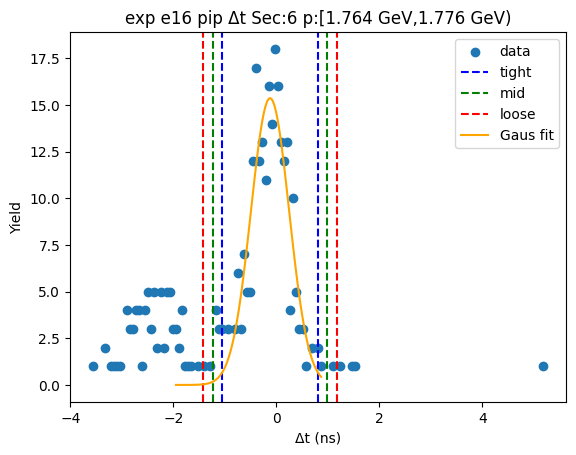

-1.3142998877617111 0.9907394377451892
-1.5448038203124013 1.2212433702958794
-1.7753077528630912 1.4517473028465693
[14.67035182 -0.16178023  0.46100787]


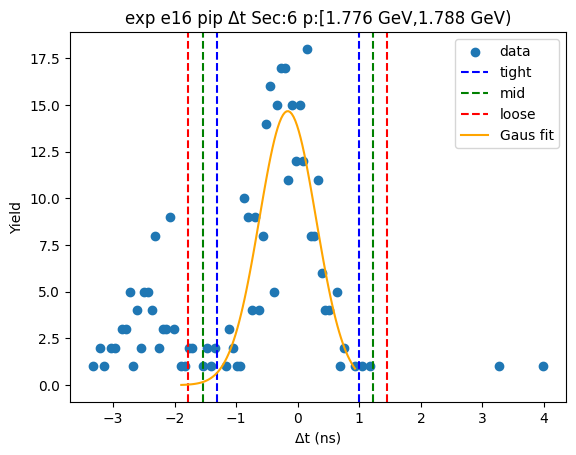

-1.2189768153880016 0.9039779154189688
-1.431272288468699 1.1162733884996658
-1.643567761549396 1.3285688615803632
[15.63019859 -0.15749945  0.42459095]


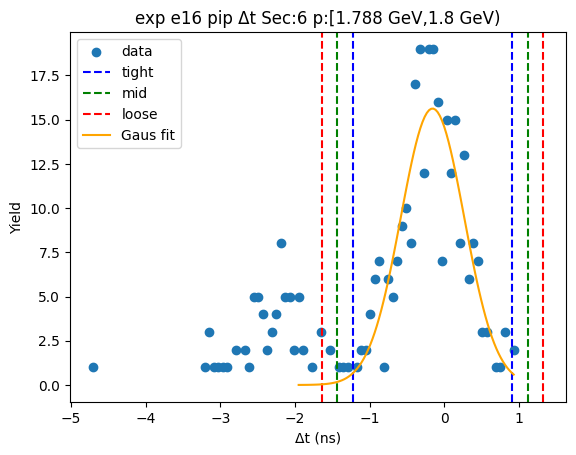

-1.1545622437173173 0.8227761451854011
-1.352296082607589 1.0205099840756728
-1.5500299214978608 1.2182438229659447
[17.09232583 -0.16589305  0.39546768]


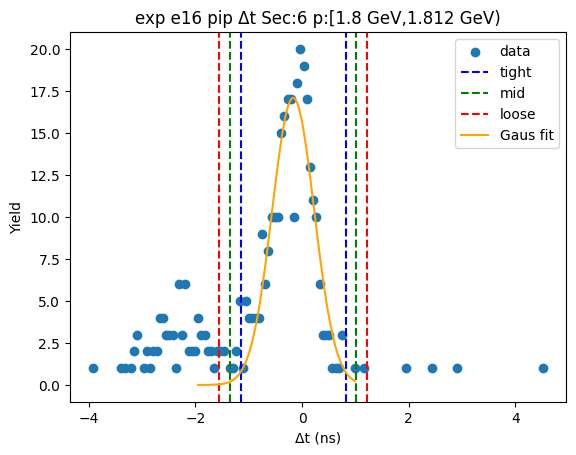

-1.2131976064082766 0.8656851929545138
-1.4210858863445557 1.0735734728907929
-1.6289741662808346 1.2814617528270718
[14.16988706 -0.17375621  0.41577656]


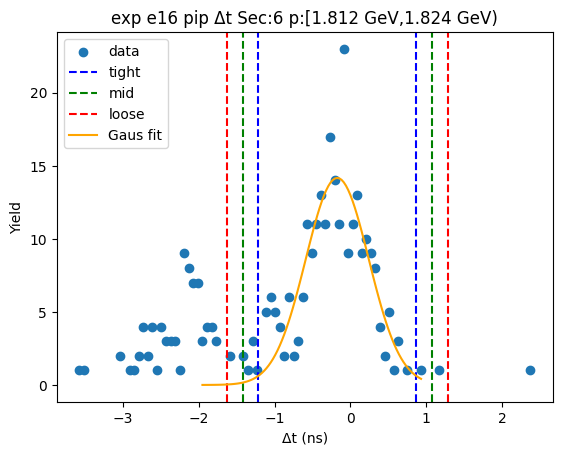

-1.3535684910714831 0.9421608115084129
-1.5831414213294726 1.1717337417664027
-1.8127143515874624 1.401306672024392
[12.49456605 -0.20570384  0.45914586]


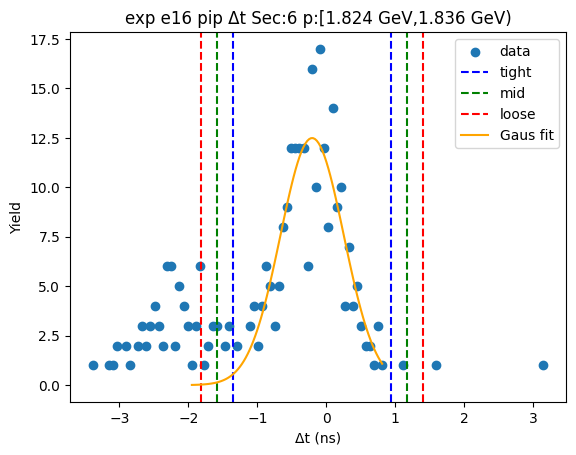

-1.3265168927731854 1.025373348180723
-1.561705916868576 1.2605623722761137
-1.796894940963967 1.4957513963715046
[16.28276778 -0.15057177  0.47037805]


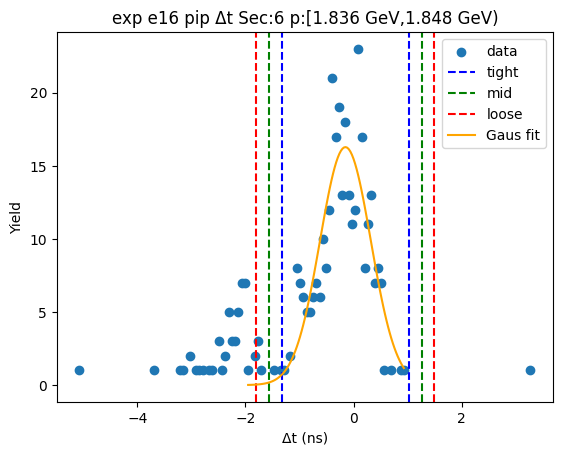

-1.1661984033782746 0.7861079197938906
-1.3614290356954912 0.9813385521111072
-1.5566596680127076 1.1765691844283235
[14.9795273  -0.19004524  0.39046126]


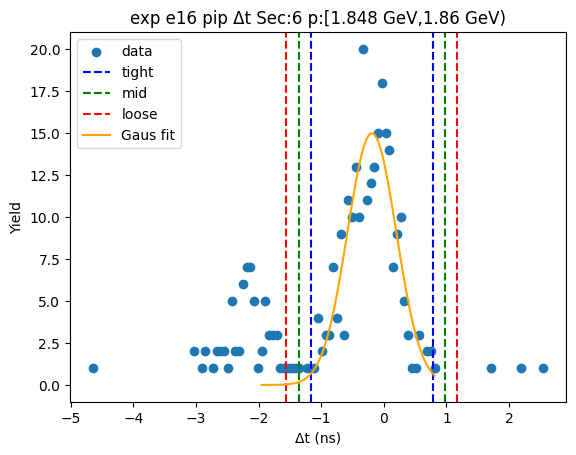

-1.0715370552560006 0.8312674557317286
-1.2618175063547736 1.0215479068305016
-1.4520979574535464 1.2118283579292743
[14.99468373 -0.1201348   0.3805609 ]


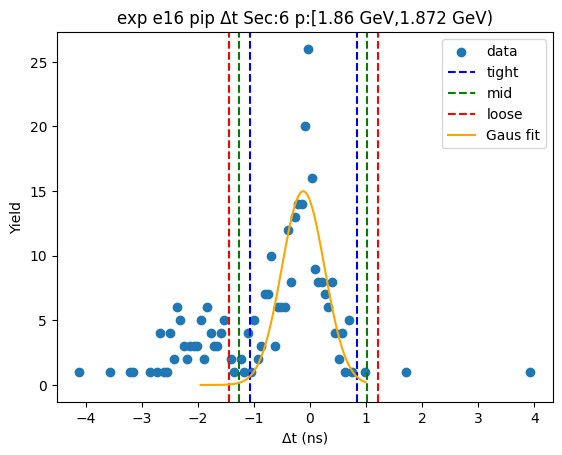

-1.3199968957880708 0.859692591399306
-1.5379658445068083 1.0776615401180436
-1.755934793225546 1.2956304888367813
[14.5129142  -0.23015215  0.4359379 ]


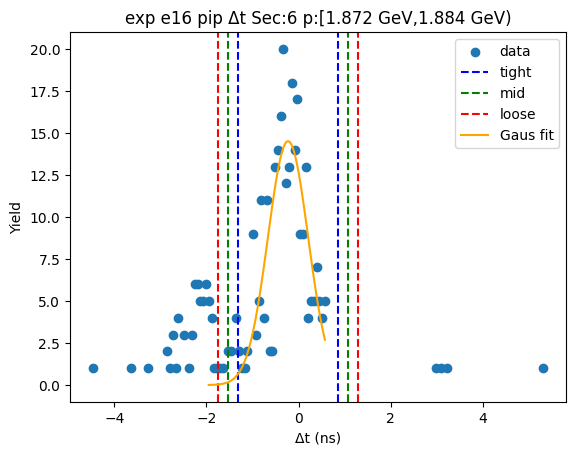

-1.286745782332007 0.9844640916883737
-1.5138667697340449 1.2115850790904117
-1.740987757136083 1.4387060664924498
[11.83348203 -0.15114085  0.45424197]


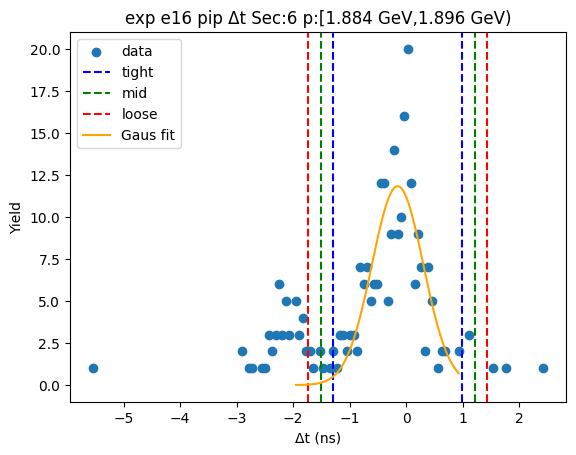

-1.2800655576959956 0.9633252360745806
-1.5044046370730533 1.1876643154516382
-1.728743716450111 1.4120033948286959
[14.1996425  -0.15837016  0.44867816]


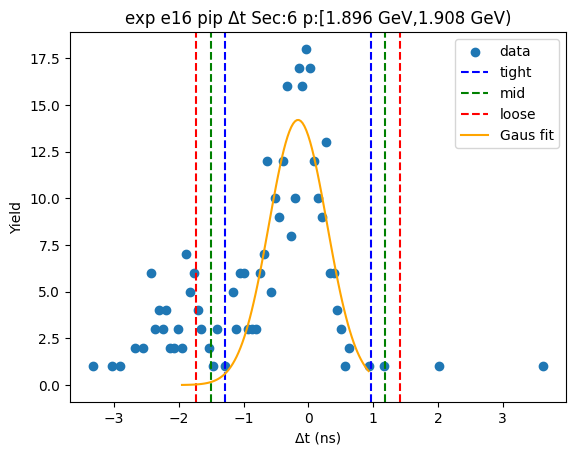

-1.3372910727551286 0.9087527011621092
-1.561895450146852 1.133357078553833
-1.786499827538576 1.3579614559455568
[12.91702735 -0.21426919  0.44920875]


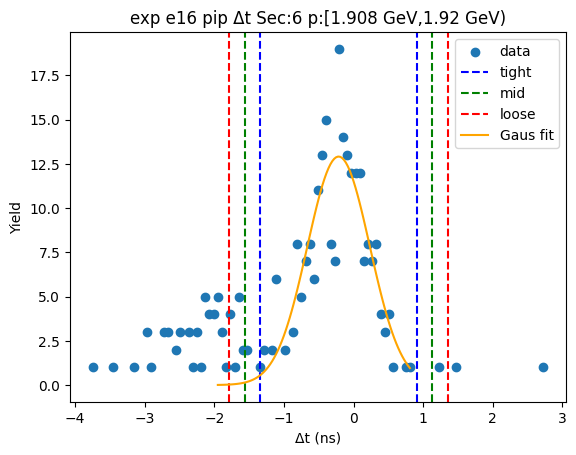

-1.2081272080513878 0.7830502848066081
-1.4072449573371875 0.9821680340924076
-1.606362706622987 1.181285783378207
[13.51037271 -0.21253846  0.3982355 ]


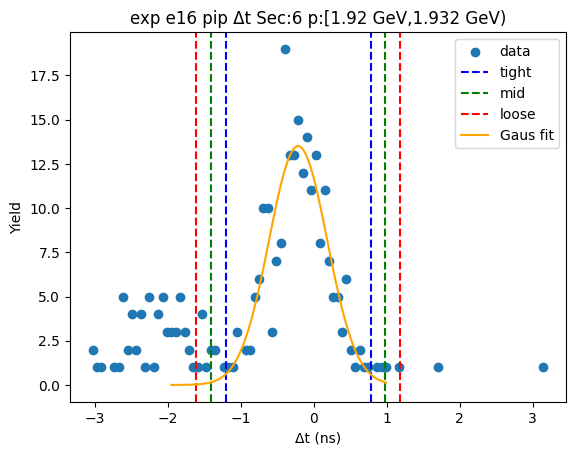

-1.2834744802683455 0.8606032447533418
-1.4978822527705142 1.0750110172555105
-1.712290025272683 1.2894187897576792
[12.75167475 -0.21143562  0.42881555]


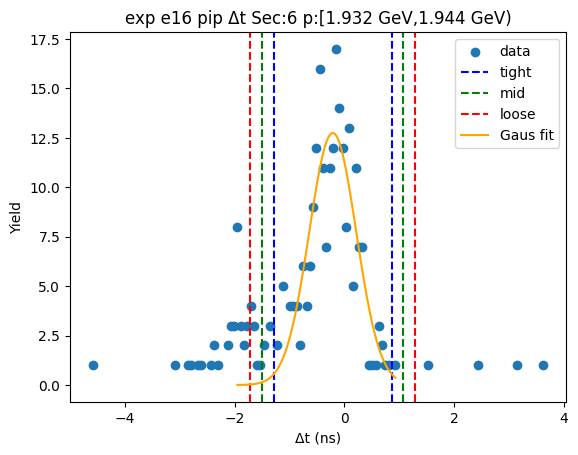

-1.0600848042639626 0.7495363359425905
-1.241046918284618 0.9304984499632458
-1.4220090323052734 1.1114605639839013
[14.08174459 -0.15527423  0.36192423]


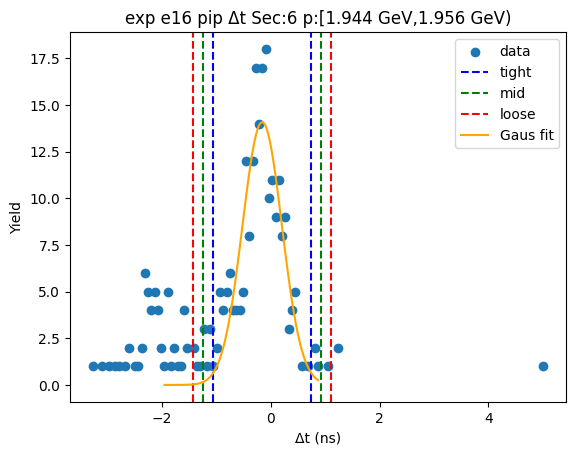

-1.0339949429742432 0.7543660018109899
-1.2128310374527664 0.9332020962895131
-1.3916671319312899 1.1120381907680366
[13.22489238 -0.13981447  0.35767219]


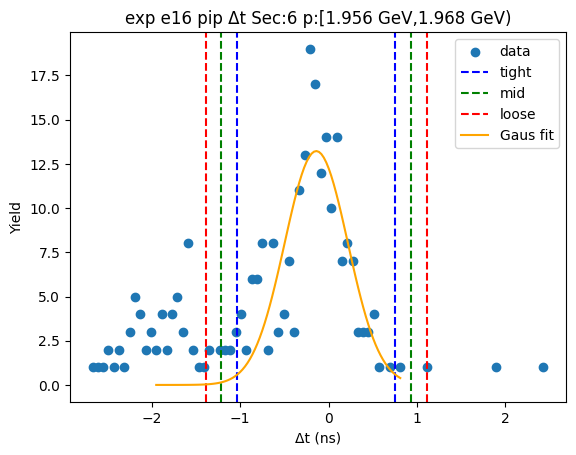

-0.9939592144782166 0.576289469819423
-1.1509840829079805 0.7333143382491871
-1.3080089513377444 0.8903392066789511
[14.87070504 -0.20883487  0.31404974]


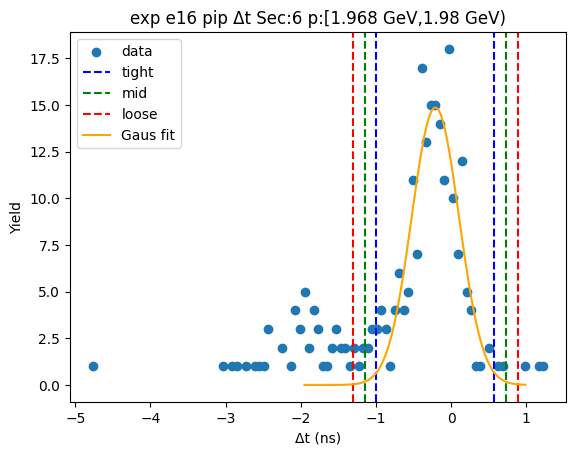

-1.3460269316058255 0.9336400386915561
-1.5739936286355638 1.1616067357212945
-1.801960325665302 1.3895734327510323
[12.49061218 -0.20619345  0.45593339]


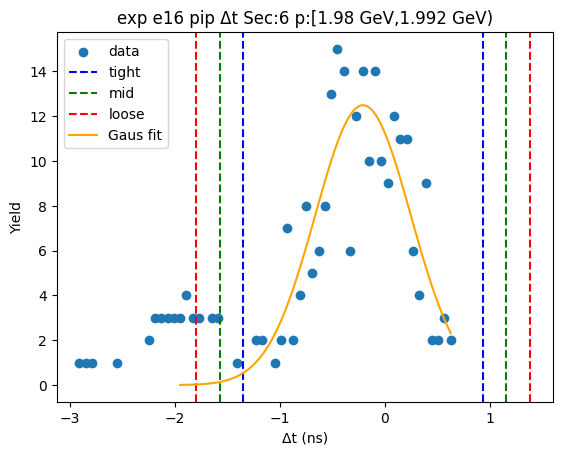

-1.0578114470940156 0.6703655278856688
-1.230629144591984 0.8431832253836371
-1.4034468420899524 1.0160009228816056
[13.55951033 -0.19372296  0.34563539]


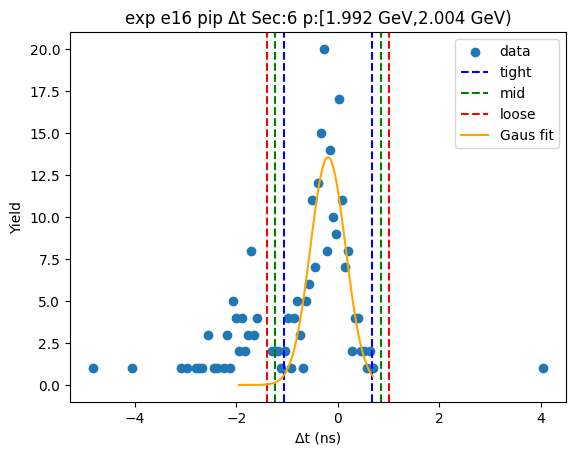

-1.1451653828192707 0.876803825150789
-1.3473623036162765 1.0790007459477948
-1.5495592244132825 1.2811976667448008
[11.62173478 -0.13418078  0.40439384]


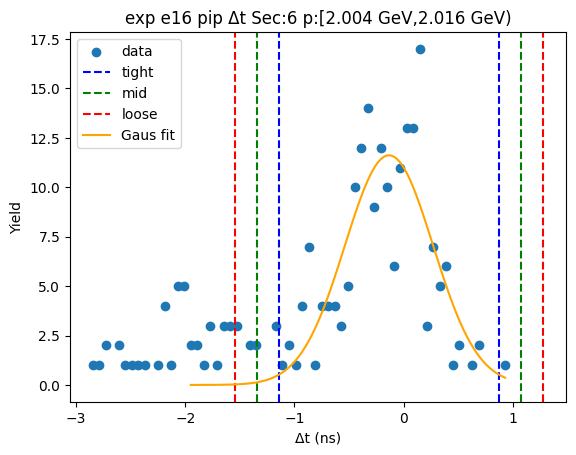

-1.2316482379703249 0.7078673182874942
-1.4255997935961067 0.901818873913276
-1.6195513492218887 1.095770429539058
[11.66238312 -0.26189046  0.38790311]


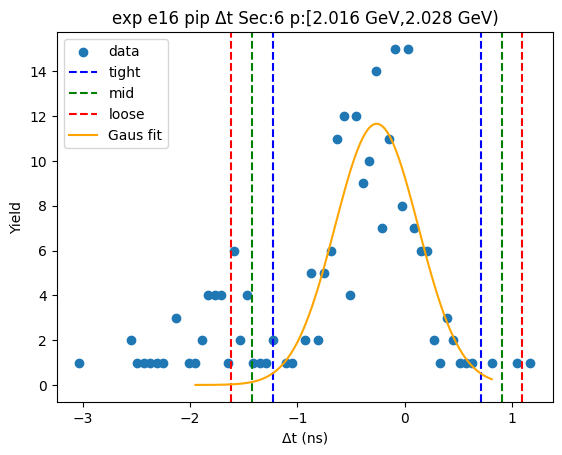

-1.311373064098285 0.8342286815072022
-1.5259332386588338 1.048788856067751
-1.7404934132193826 1.2633490306282997
[ 9.63419606 -0.23857219  0.42912035]


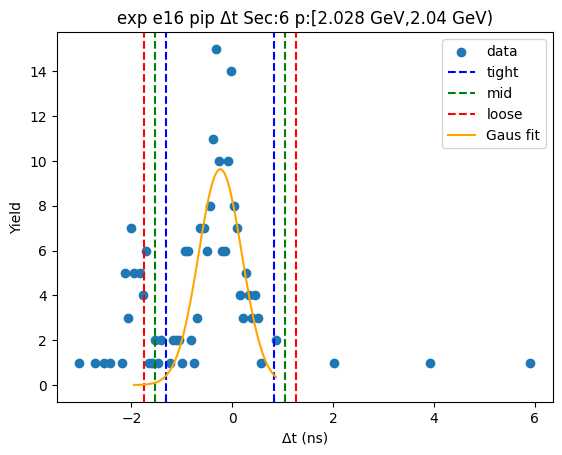

-1.2774567572451114 0.8684479693984528
-1.4920472299094678 1.0830384420628092
-1.7066377025738242 1.2976289147271656
[10.58076135 -0.20450439  0.42918095]


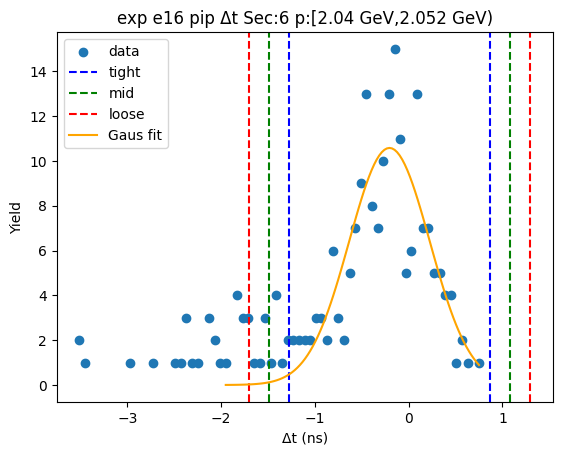

-1.6856352227417464 1.0686208354771778
-1.9610608285636388 1.3440464412990698
-2.2364864343855313 1.6194720471209623
[ 9.33086536 -0.30850719  0.55085121]


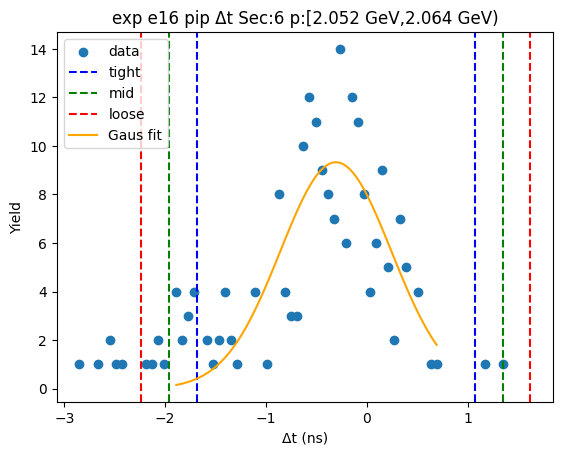

-1.2358958132999205 0.7431824385139576
-1.4338036384813082 0.9410902636953453
-1.6317114636626961 1.1389980888767333
[11.0285149  -0.24635669  0.39581565]


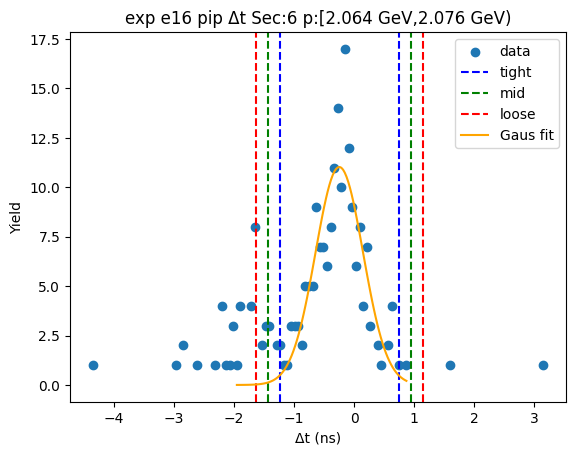

-1.0924123375212011 0.7127164727106672
-1.272925218544388 0.8932293537338538
-1.4534380995675749 1.0737422347570407
[11.47414443 -0.18984793  0.36102576]


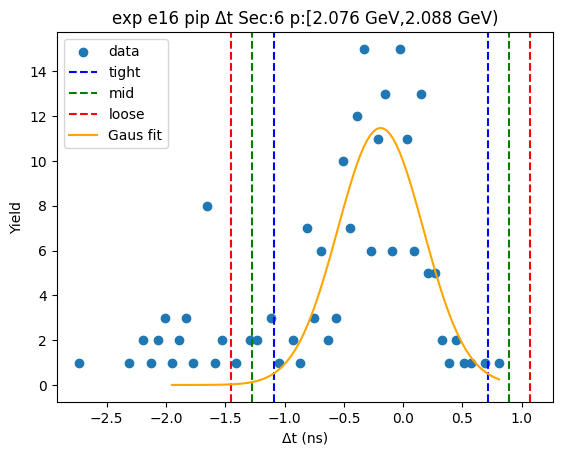

-1.172343463907219 0.6723466042747431
-1.3568124707254152 0.8568156110929394
-1.5412814775436114 1.0412846179111357
[10.52544892 -0.24999843  0.36893801]


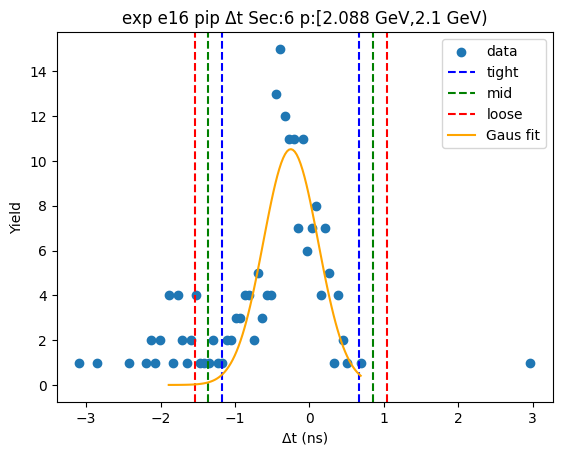

-1.067074680151135 0.6872782503319711
-1.2425099731994456 0.8627135433802816
-1.4179452662477563 1.0381488364285922
[11.30748702 -0.18989821  0.35087059]


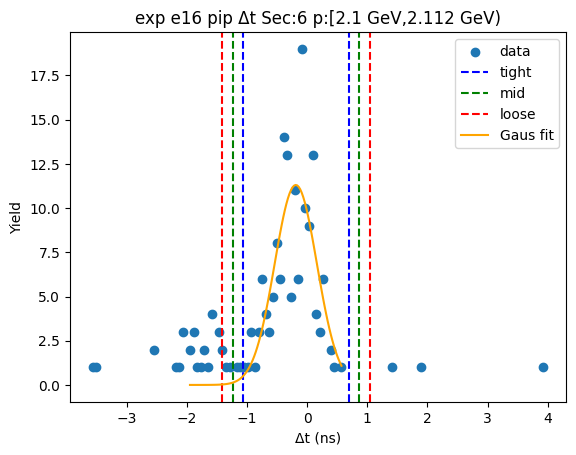

-1.2682261262154944 0.849876285203864
-1.4800363673574304 1.0616865263457997
-1.691846608499366 1.2734967674877358
[ 8.67159607 -0.20917492  0.42362048]


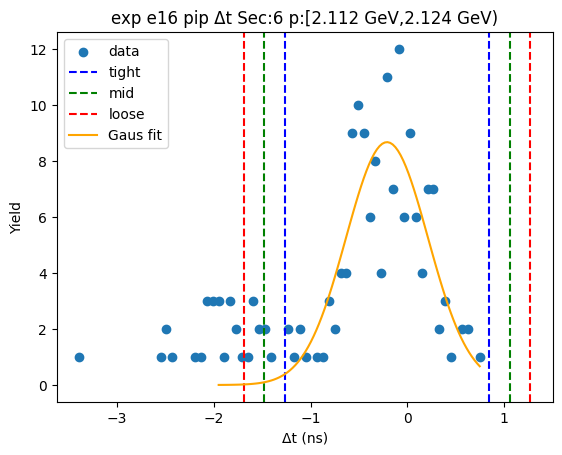

-1.2572211778836193 0.9102853476928806
-1.4739718304412692 1.1270360002505306
-1.6907224829989196 1.3437866528081805
[ 9.42800376 -0.17346792  0.43350131]


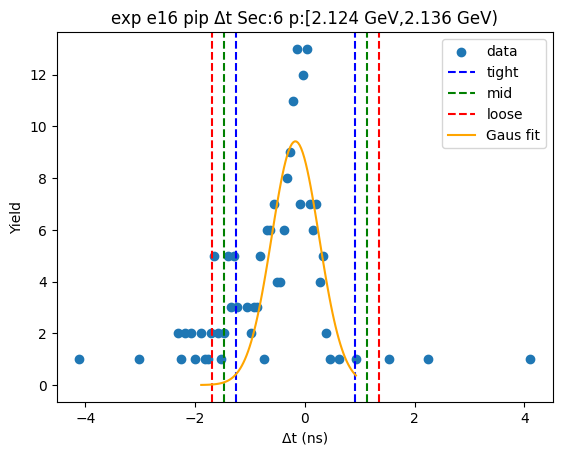

-1.3698289270457134 0.9009116935864838
-1.5969029891089332 1.1279857556497037
-1.823977051172153 1.3550598177129234
[ 7.9291315  -0.23445862  0.45414812]


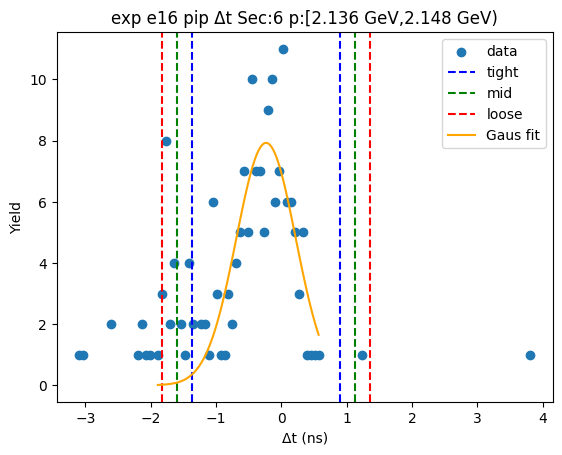

-1.505261498700839 0.8713995963581167
-1.7429276082067346 1.1090657058640123
-1.9805937177126303 1.346731815369908
[ 8.58500223 -0.31693095  0.47533222]


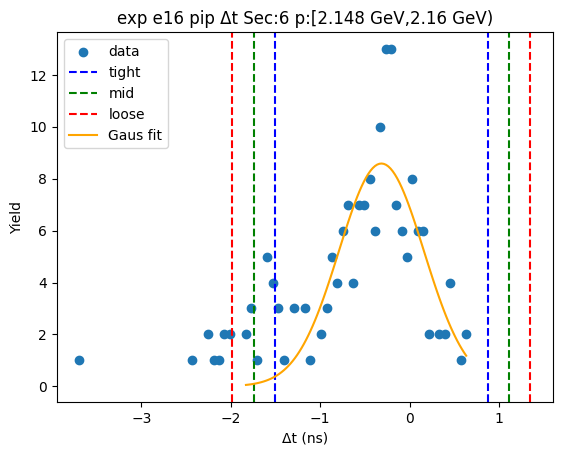

-1.3269025205470444 0.7464583940624736
-1.534238612007996 0.9537944855234253
-1.7415747034689477 1.161130576984377
[ 8.87215906 -0.29022206  0.41467218]


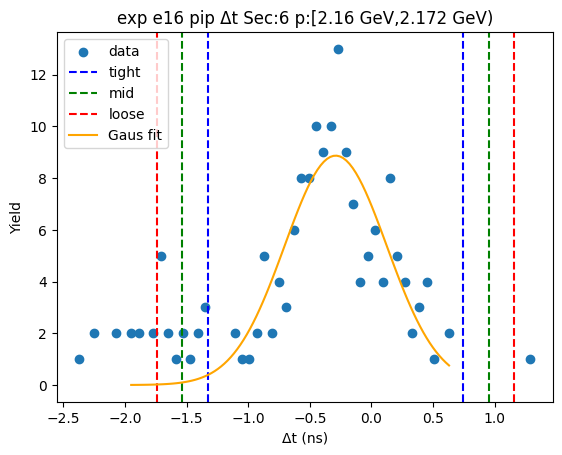

-0.9387960148887925 0.5302313207552106
-1.0856987484531928 0.6771340543196109
-1.2326014820175932 0.8240367878840114
[11.50665784 -0.20428235  0.29380547]


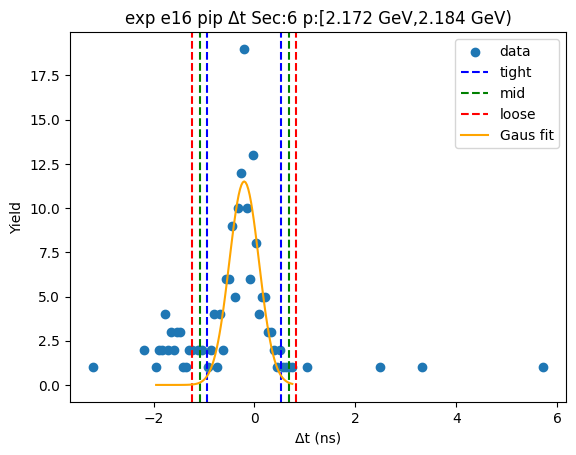

-1.1043772737546451 0.5575197215697275
-1.2705669732870826 0.7237094211021649
-1.43675667281952 0.8898991206346022
[11.66045454 -0.27342878  0.3323794 ]


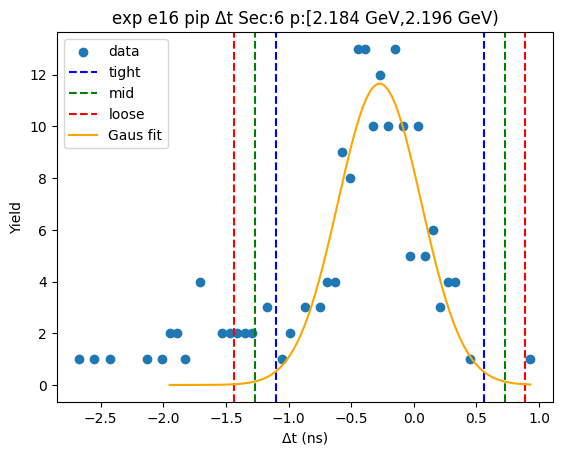

In [14]:
#Initial Guesses for Gaussian Fit
a1=30
m1=0.01
s1=1.5
initial_pars1=[27856.22, 0.01855, 0.8616]

initial_pars2 = [30000,6.0,1.0]

inital_pars3 = []

tmp_par1 = np.zeros(3)
tmp_par2 = np.zeros(6)

#par_bound_low = [0.0,0.0,0.0]
#par_bound_top = [inf,inf,inf]

fit_pars1 = np.zeros((6,len(x),6))
err1 = np.zeros((6,len(x),3))
bound_mod=[0.6,]
low_mod = 1.2
norm_mod=1.2
min_p = [0.2,0.2,0.2,0.2,0.2,0.2]
mid_p = 3.5
p_cutoff = 2.2

num_sigma1 = [2.5,3,3.5]
bounds1 = np.zeros((6,2,3,len(x)))
sigma1= np.zeros((6,2,3,len(x)))

g1_pars = np.zeros((6,len(x),3))
g2_pars = np.zeros((6,len(x),3))

for sec in range(6):
    for i in range(3):
        tmp_par1[i] = initial_pars1[i]
        for j in range(2):
            if j ==0:
                tmp_par2[i+j*3]= initial_pars1[i]
            elif j ==1:
                tmp_par2[i+j*3]= initial_pars2[i]
    for xbin in range(len(x)):
        if fit_y[sec][xbin].sum()>20 and x[xbin]>min_p[sec] and x[xbin]<p_cutoff:
            #Set the amplitude guess to the maximum yield value
            initial_pars1[0] = np.amax(fit_y[sec][xbin])
            plt.scatter(fit_x[sec][xbin],fit_y[sec][xbin],label="data")
            #Initial Fitting
            #Set Fit Range
            if x[xbin]<mid_p:  
                #fit_x1 = Bounds_on_Y(fit_x[sec][xbin],initial_pars1[1]-norm_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                #fit_y1 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x[sec][xbin],initial_pars1[1]-norm_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                fit_x1 = Bounds_on_Y(fit_x[sec][xbin],-2.0,1.0)
                fit_y1 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x[sec][xbin],-2.0,1.0)
                cont_x1 = np.linspace(fit_x1[0],fit_x1[len(fit_x1)-1],100)
                try:
                    pars1 = op.curve_fit(Gaus,fit_x1,fit_y1,p0=tmp_par1,maxfev=5000)
                    for i in range(3):
                        fit_pars1[sec][xbin][i]=pars1[0][i]
                        tmp_par1[i]=pars1[0][i]
                        tmp_par2[i]=pars1[0][i]
                        err1[sec][xbin][i]=np.sqrt(pars1[1][i][i])
                        bounds1[sec][0][i][xbin] = pars1[0][1] - num_sigma1[i]*pars1[0][2]
                        bounds1[sec][1][i][xbin] = pars1[0][1] + num_sigma1[i]*pars1[0][2]
                        sigma1[sec][0][i][xbin] = pars1[1][1][1] - num_sigma1[i]*pars1[1][2][2]
                        sigma1[sec][1][i][xbin] = pars1[1][1][1] + num_sigma1[i]*pars1[1][2][2]
                        plt.axvline(x=bounds1[sec][0][i][xbin],label=cut_name[i],color=cut_cols[i],linestyle='dashed')
                        plt.axvline(x=bounds1[sec][1][i][xbin],color=cut_cols[i],linestyle='dashed')
                        print(bounds1[sec][0][i][xbin],bounds1[sec][1][i][xbin])
                    plt.plot(cont_x1,Gaus(cont_x1,*pars1[0]),color='orange',label='Gaus fit')
                except RuntimeError:
                    print("Runtime Error")
                except ValueError:
                    print("Value Error")
            else:
                #fit_x1 = Bounds_on_Y(fit_x[sec][xbin],initial_pars1[1]-low_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                #fit_y1 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x[sec][xbin],initial_pars1[1]-low_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                fit_x2 = Bounds_on_Y(fit_x[sec][xbin],-2.0,6.0)
                fit_y2 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x[sec][xbin],-2.0,6.0)
                cont_x2 = np.linspace(fit_x2[0],fit_x2[len(fit_x2)-1],100)
                plt.plot(cont_x2,Gaus2(cont_x2,*tmp_par2),color='r',label='Inital 2Gaus fit')
                try:
                    pars2 = op.curve_fit(Gaus2,fit_x2,fit_y2,p0=tmp_par2,maxfev=5000)
                    for i in range(3):
                        fit_pars1[sec][xbin][i]=pars2[0][i]
                        g1_pars[sec][xbin][i] = pars2[0][i]
                        g2_pars[sec][xbin][i] = pars2[0][i+3]
                        err1[sec][xbin][i]=np.sqrt(pars2[1][i][i])
                        bounds1[sec][0][i][xbin] = pars2[0][1] - num_sigma1[i]*pars2[0][2]
                        bounds1[sec][1][i][xbin] = pars2[0][1] + num_sigma1[i]*pars2[0][2]
                        sigma1[sec][0][i][xbin] = pars2[1][1][1] - num_sigma1[i]*pars2[1][2][2]
                        sigma1[sec][1][i][xbin] = pars2[1][1][1] + num_sigma1[i]*pars2[1][2][2]
                        plt.axvline(x=bounds1[sec][0][i][xbin],label=cut_name[i],color=cut_cols[i],linestyle='dashed')
                        plt.axvline(x=bounds1[sec][1][i][xbin],color=cut_cols[i],linestyle='dashed')
                        print(bounds1[sec][0][i][xbin],bounds1[sec][1][i][xbin])
                        for j in range(2):
                            tmp_par2[i+j*3]= pars2[0][i+j*3]
                    plt.plot(cont_x2,Gaus2(cont_x2,*pars2[0]),color='orange',label='2Gaus fit')
                    plt.plot(cont_x2,Gaus(cont_x2,*g1_pars[0][xbin]),color='c',label='Proton fit')
                    plt.plot(cont_x2,Gaus(cont_x2,*g2_pars[0][xbin]),color='m',label='\u03C0+ fit')
                except RuntimeError:
                    print("Runtime Error")
                except ValueError:
                    print("Value Error")
            
            
            #if np.sqrt(pars1[1][1][1])/pars1[0][1] < 0.1:
            
            cont_x1 = np.linspace(fit_x1[0],fit_x1[len(fit_x1)-1],100)
            print(pars1[0])
           
            plot_title="{} {} {} \u0394t Sec:{} p:[{} GeV,{} GeV)".format(sim,run,species,sec+1,Pbin_low(xbin),Pbin_top(xbin))
            plt.title(plot_title)
            plt.xlabel(yname)
            plt.ylabel("Yield")
            plt.legend()
            plt.show()

In [15]:

for sec in range(6):
    for cut in range(3):
        for xbin in range(len(x)):
            bounds1[sec][0][cut][xbin] = fit_pars1[sec][xbin][1]-num_sigma1[cut]*fit_pars1[sec][xbin][2]
            sigma1[sec][0][cut][xbin] = err1[sec][xbin][1]+num_sigma1[cut]*err1[sec][xbin][2]
            bounds1[sec][1][cut][xbin] = fit_pars1[sec][xbin][1]+num_sigma1[cut]*fit_pars1[sec][xbin][2]
            sigma1[sec][1][cut][xbin] = err1[sec][xbin][1]+num_sigma1[cut]*err1[sec][xbin][2]

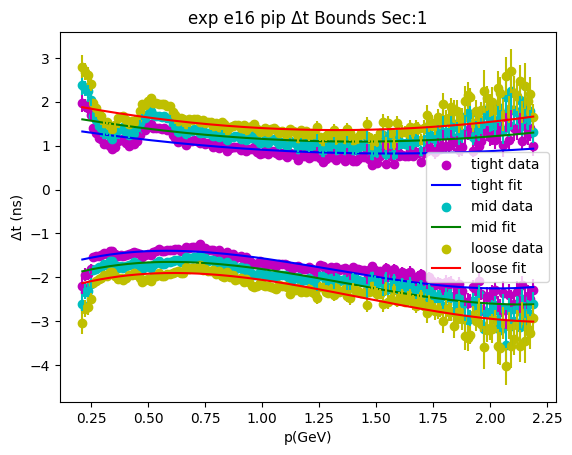

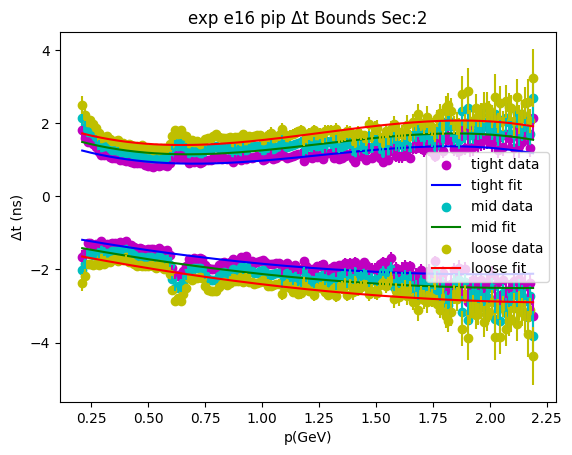

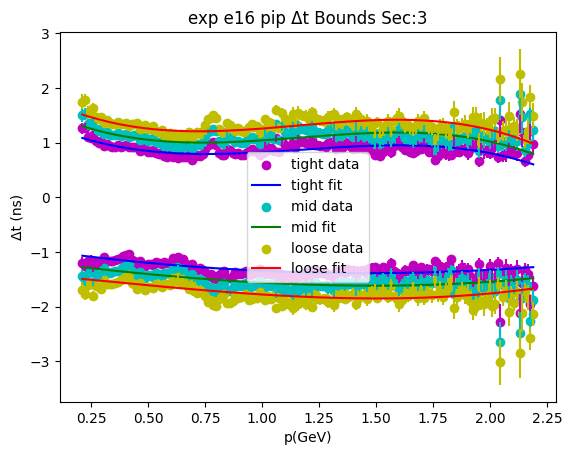

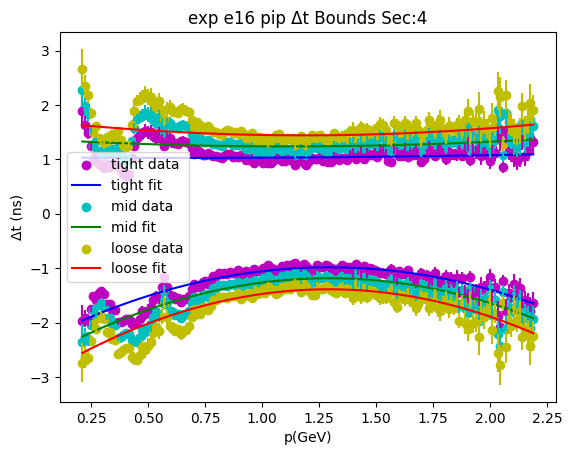

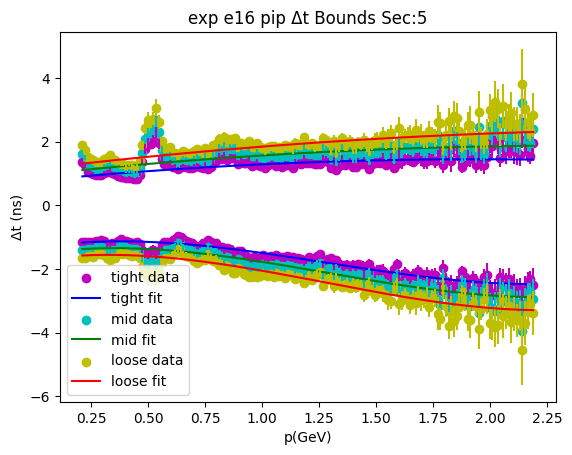

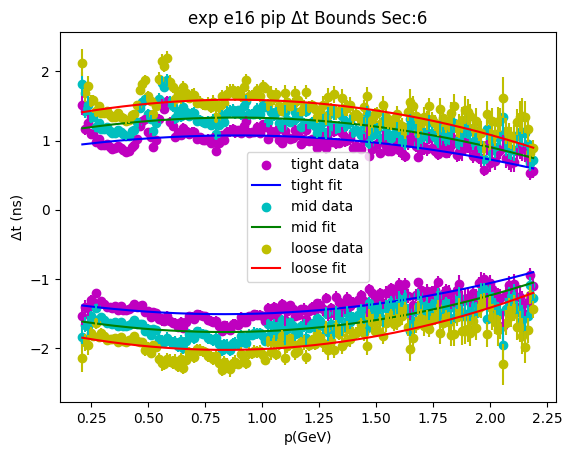

In [16]:
l0=0.0
l1=0.5
l2=-0.2
l3=0.2
initial_low_par2=[l0,l1,l2,l3]
t0=0.0
t1=0.5
t2=-0.2
t3=-0.2
initial_top_par2=[t0,t1,t2,t3]

low_par_fit= np.zeros((6,3,4))
top_par_fit = np.zeros((6,3,4))

cut_cols = ['b','g','r']
cut_name= ["tight","mid","loose"]
data_cols = ['m',"c",'y']

par_bou = [[[-np.inf,-np.inf,-np.inf,0.0],[np.inf,np.inf,np.inf,np.inf]],
           [[-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,0.0]]]

for sec in range(6):
    for cut in range(3):
        plt.scatter(Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),label="{} data".format(cut_name[cut]),color=data_cols[cut])
        plt.scatter(Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),color=data_cols[cut])
        plt.errorbar(Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),yerr=Remove_Zeros_X(sigma1[sec][0][cut],bounds1[sec][0][cut]),fmt='',linestyle='',color=data_cols[cut])
        plt.errorbar(Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),yerr=Remove_Zeros_X(sigma1[sec][1][cut],bounds1[sec][1][cut]),fmt='',linestyle='',color=data_cols[cut])
        #Fit with 3rd order Polynomial 
        par_low1=op.curve_fit(Poly3,Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),p0=initial_low_par2,sigma=Remove_Zeros_X(sigma1[sec][0][cut],bounds1[sec][0][cut]),bounds=par_bou[0],maxfev=5000)
        par_top1=op.curve_fit(Poly3,Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),p0=initial_top_par2,sigma=Remove_Zeros_X(sigma1[sec][1][cut],bounds1[sec][1][cut]),bounds=par_bou[1],maxfev=5000)
        for i in range(4):
            low_par_fit[sec][cut][i] = par_low1[0][i]
            top_par_fit[sec][cut][i] = par_top1[0][i]
        cont_x_low = np.linspace(Remove_Zeros_X(x,bounds1[sec][0][cut])[0],Remove_Zeros_X(x,bounds1[sec][0][cut])[len(Remove_Zeros_X(x,bounds1[sec][0][cut]))-1],200)
        cont_x_top = np.linspace(Remove_Zeros_X(x,bounds1[sec][1][cut])[0],Remove_Zeros_X(x,bounds1[sec][1][cut])[len(Remove_Zeros_X(x,bounds1[sec][1][cut]))-1],200)
        plt.plot(cont_x_low,Poly3(cont_x_low,*low_par_fit[sec][cut]),color=cut_cols[cut],label="{} fit".format(cut_name[cut]))
        plt.plot(cont_x_top,Poly3(cont_x_top,*top_par_fit[sec][cut]),color=cut_cols[cut])
    plot_title="{} {} {} \u0394t Bounds Sec:{}".format(sim,run,species,sec+1)
    plt.title(plot_title)
    plt.xlabel(xname)
    plt.ylabel(yname)
    plt.legend()
    plt.show()

In [17]:
#Stuff to make it so I can plot a 2d Histogram with data in the format I have
#Would be a lot easier if I had uproot 4 working 
dumb_x= np.zeros((6,len(xbins)*len(ybins)))
dumb_y= np.zeros((6,len(xbins)*len(ybins)))
dense2 = np.zeros((6,len(xbins)*len(ybins)))
for sec in range(6):
    for i in range(len(xbins)):
        for j in range(len(ybins)):
            dumb_x[sec][i+j*len(xbins)]+=xbins[i]
            dumb_y[sec][i+j*len(xbins)]+=ybins[j]
            dense2[sec][i+j*len(xbins)]+=zvals_xy[sec][i][j]

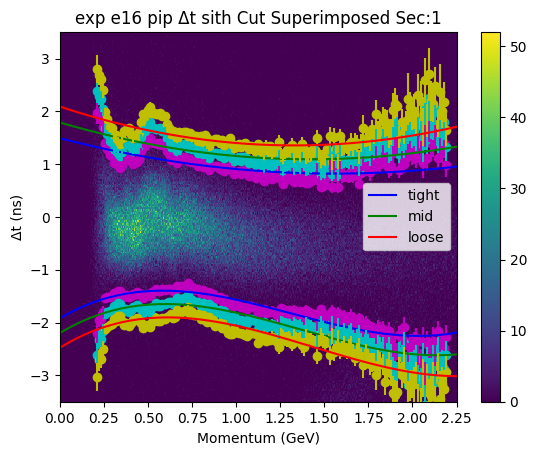

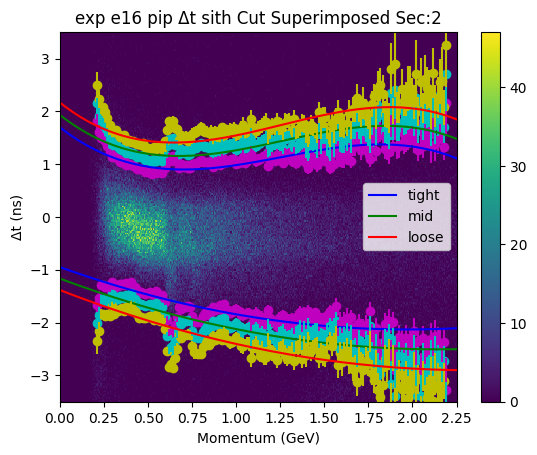

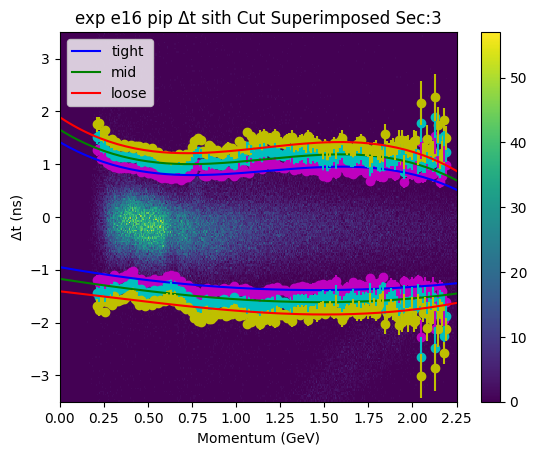

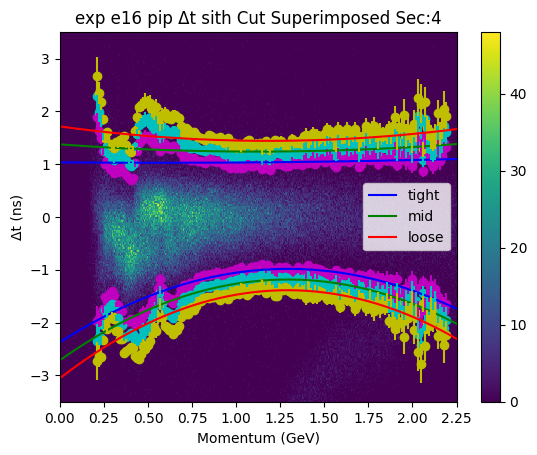

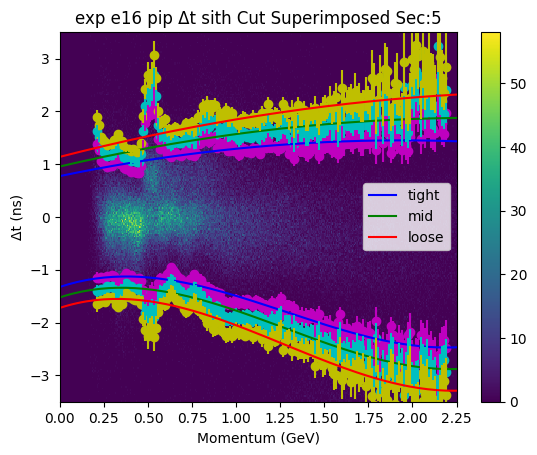

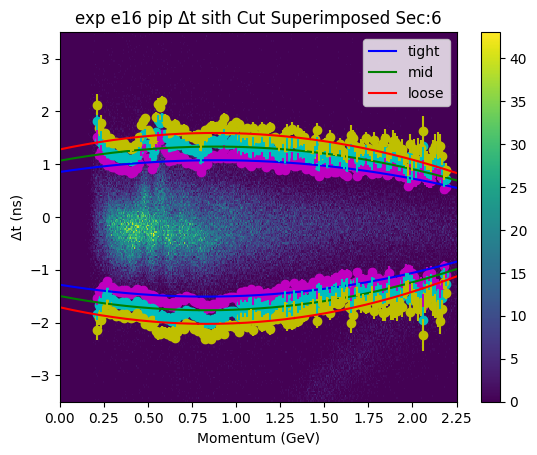

In [18]:
for sec in range(6):
    plt.hist2d(dumb_x[sec], dumb_y[sec], bins=(len(xbins), len(ybins)), weights=dense2[sec])
    plt.colorbar()
    for cut in range(3):
        plt.scatter(Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),color=data_cols[cut])
        plt.scatter(Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),color=data_cols[cut])
        plt.errorbar(Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),yerr=Remove_Zeros_X(sigma1[sec][0][cut],bounds1[sec][0][cut]),fmt='',linestyle='',color=data_cols[cut])
        plt.errorbar(Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),yerr=Remove_Zeros_X(sigma1[sec][1][cut],bounds1[sec][1][cut]),fmt='',linestyle='',color=data_cols[cut])
        cont_x_low2 = np.linspace(0.0,5.0,200)
        cont_x_top2 = np.linspace(0.0,5.0,200)
        plt.plot(cont_x_low2,Poly3(cont_x_low2,*low_par_fit[sec][cut]),color=cut_cols[cut],label=cut_name[cut])
        plt.plot(cont_x_top2,Poly3(cont_x_top2,*top_par_fit[sec][cut]),color=cut_cols[cut])
        #cont_x_low = np.linspace(Remove_Zeros_X(sf_x,sf_bounds1[sec][0][cut])[0],Remove_Zeros_X(sf_x,sf_bounds1[sec][0][cut])[len(Remove_Zeros_X(sf_x,sf_bounds1[sec][0][cut]))-1],200)
        #cont_x_top = np.linspace(Remove_Zeros_X(sf_x,sf_bounds1[sec][1][cut])[0],Remove_Zeros_X(sf_x,sf_bounds1[sec][1][cut])[len(Remove_Zeros_X(sf_x,sf_bounds1[sec][1][cut]))-1],200)
        #plt.plot(cont_x_low,Poly3(cont_x_low,*low_par_fit[sec][cut]),color='y')
        #plt.plot(cont_x_top,Poly3(cont_x_top,*top_par_fit[sec][cut]),color='y')
    plt.ylim([-3.5,3.5])
    plt.xlim([0.0,2.25])
    plt.title("{} {} {} \u0394t sith Cut Superimposed Sec:{}".format(sim,run,species,sec+1))
    plt.xlabel("Momentum (GeV)")
    plt.ylabel("\u0394t (ns)")
    plt.legend()
    
    plt.show()
    
    

In [20]:
print(cut_perf+" "+species+" Cut Parameters for ",num_sigma1," sigma cut using 3rd order Polynomial")
print("Lower Bound in order of increasing exponent")
for sec in range(6):
    for cut in range(3):
        for par in range(4):
            if par==0:
                if cut==0:
                    if sec==0:
                        print("{\t{\t{",low_par_fit[sec][cut][par],end=",")
                    else:
                        print("\t{\t{",low_par_fit[sec][cut][par],end=",")
                else:
                    print("\t\t{",low_par_fit[sec][cut][par],end=",")
            else:
                if par==3:
                    if cut == 2:
                        if sec == 5:
                            print(low_par_fit[sec][cut][par],"}}}")
                        else:
                            print(low_par_fit[sec][cut][par],"}},")
                    else:
                        print(low_par_fit[sec][cut][par],"},")
                else:
                    print(low_par_fit[sec][cut][par],end=",")
print("Upper Bound in order of increasing exponent")
for sec in range(6):
    for cut in range(3):
        for par in range(4):
            if par==0:
                if cut==0:
                    if sec==0:
                        print("{\t{\t{",top_par_fit[sec][cut][par],end=",")
                    else:
                        print("\t{\t{",top_par_fit[sec][cut][par],end=",")
                else:
                    print("\t\t{",top_par_fit[sec][cut][par],end=",")
            else:
                if par==3:
                    if cut == 2:
                        if sec == 5:
                            print(top_par_fit[sec][cut][par],"}}}")
                        else:
                            print(top_par_fit[sec][cut][par],"}},")
                    else:
                        print(top_par_fit[sec][cut][par],"},")
                else:
                    print(top_par_fit[sec][cut][par],end=",")
#print(low_par_fit)
#print(top_par_fit)

delta pip Cut Parameters for  [2.5, 3, 3.5]  sigma cut using 3rd order Polynomial
Lower Bound in order of increasing exponent
{	{	{ -1.9225462175959116,1.9949215118618846,-2.200086629405442,0.5600698888358822 },
		{ -2.2010165660682506,2.034165190113027,-2.177547772965805,0.5305858789530027 },
		{ -2.479306532747654,2.0728644241420304,-2.154466344311342,0.5009332790969683 }},
	{	{ -0.949532608133599,-1.1983844977374647,0.3038114880572453,3.122053687051823e-18 },
		{ -1.1670883428474559,-1.2482716428405172,0.29053251620760606,1.8984105250821693e-20 },
		{ -1.384618180503514,-1.2981436244810114,0.27721260053083474,3.8948241849123146e-16 }},
	{	{ -0.9505703738995791,-0.5965559894654271,0.20453216496029356,1.1206270298237629e-12 },
		{ -1.1729546572236944,-0.5156206140040955,0.09356767393764588,0.035809928440264496 },
		{ -1.408628661654609,-0.3834708952734454,-0.07233064465772937,0.08851521154832896 }},
	{	{ -2.3759599852340405,2.149963554948683,-0.8299978767241896,4.0991152917566255e-22 

In [22]:
# #Looking at relative errors for the bounds 
# sig_label=['lower','upper']
# for sec in range(6):
#     for side in range(2):
#         plt.scatter(x,sigma1[sec][side]/bounds1[sec][side],label=sig_label[side])
#     plot_name="Relative Uncertainty in Cut Boundary Sec{}".format(sec+1)
#     plt.title(plot_name)
#     plt.xlabel("Momentum (GeV)")
#     plt.ylabel("Relative Error in Bound")
#     plt.legend()
#     plt.show()